# Dual data types (low and high moment seperately)


In [1]:
try:
    # Check if the code is running in an IPython kernel (which includes Jupyter notebooks)
    get_ipython()
    # If the above line doesn't raise an error, it means we are in a Jupyter environment
    # Execute the magic commands using IPython's run_line_magic function
    get_ipython().run_line_magic('load_ext', 'autoreload')
    get_ipython().run_line_magic('autoreload', '2')
except:
    # If get_ipython() raises an error, we are not in a Jupyter environment
    # # #%load_ext autoreload
    # # #%autoreload 2
    pass

In [2]:
import integrate as ig
# check if parallel computations can be performed
parallel = ig.use_parallel(showInfo=1)

import h5py
import numpy as np
import matplotlib.pyplot as plt
hardcopy=True

Notebook detected. Parallel processing is OK


In [3]:
case = 'DAUGAARD'
files = ig.get_case_data(case=case)
f_data_h5 = files[0]
f_data_h5 = 'DAUGAARD_AVG.h5'
file_gex= ig.get_gex_file_from_data(f_data_h5)

print("Using data file: %s" % f_data_h5)
print("Using GEX file: %s" % file_gex)

Getting data for case: DAUGAARD
--> Got data for case: DAUGAARD
Using data file: DAUGAARD_AVG.h5
Using GEX file: TX07_20231016_2x4_RC20-33.gex


## 1. Setup the prior model ($\rho(\mathbf{m},\mathbf{d})$

In this example a simple layered prior model will be considered

### 1a. first, a sample of the prior model parameters, $\rho(\mathbf{m})$, will be generated

In [4]:
N=100000
# Layered model
f_prior_h5 = ig.prior_model_layered(N=N,lay_dist='chi2', NLAY_deg=3, RHO_min=1, RHO_max=3000)
f_prior_data_h5 = ig.prior_data_gaaem(f_prior_h5, file_gex, parallel=parallel, showInfo=0)
ig.integrate_update_prior_attributes(f_prior_data_h5)

prior_data_gaaem: Using 128 parallel threads.


prior_data_gaaem: Time= 98.0s/100000 soundings.  1.0ms/sounding, 1020.1it/s


prior_layered:  50%|█████████████████████████████████████████████████████████████████████████████▏                                                                           | 504832/1000000 [00:04<00:03, 126039.08it/s]

prior_layered:  63%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 631179/1000000 [00:05<00:02, 126149.81it/s]

prior_layered:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 758022/1000000 [00:06<00:01, 126385.04it/s]

prior_layered:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 884408/1000000 [00:07<00:00, 126313.48it/s]

Creating a copy of PRIOR_CHI2_NF_3_log-uniform_N1000000.h5
                as PRIOR_CHI2_NF_3_log-uniform_N1000000_TX07_20231016_2x4_RC20-33_Nh280_Nf12.h5


prior_data_gaaem: Using 32 parallel threads.


gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|                                                                                                                                                                                | 0/31250 [00:00<?, ?it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 52/31250 [00:01<10:01, 51.84it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 41/31250 [00:01<12:52, 40.39it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 53/31250 [00:01<09:55, 52.36it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 36/31250 [00:01<14:32, 35.79it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 50/31250 [00:01<10:26, 49.79it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 39/31250 [00:01<13:33, 38.37it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 34/31250 [00:01<15:20, 33.89it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 35/31250 [00:01<15:22, 33.84it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 49/31250 [00:01<10:41, 48.66it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 50/31250 [00:01<10:28, 49.67it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 37/31250 [00:01<14:17, 36.38it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 48/31250 [00:01<11:05, 46.86it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 36/31250 [00:01<14:52, 34.99it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 36/31250 [00:01<14:31, 35.82it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 35/31250 [00:01<15:07, 34.40it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 45/31250 [00:01<11:34, 44.95it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 37/31250 [00:01<14:15, 36.50it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 44/31250 [00:01<12:05, 42.98it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 35/31250 [00:01<15:12, 34.21it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 35/31250 [00:01<15:14, 34.14it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 34/31250 [00:01<15:30, 33.53it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 34/31250 [00:01<15:29, 33.60it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 35/31250 [00:01<15:01, 34.64it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 43/31250 [00:01<12:07, 42.91it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 45/31250 [00:01<11:36, 44.78it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 44/31250 [00:01<12:02, 43.18it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 39/31250 [00:01<13:38, 38.13it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 43/31250 [00:01<12:12, 42.62it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 41/31250 [00:01<12:42, 40.95it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 32/31250 [00:01<16:36, 31.32it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 43/31250 [00:01<12:07, 42.91it/s]

gatdaem1d:   0%|▏                                                                                                                                                                      | 41/31250 [00:01<13:04, 39.78it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 70/31250 [00:02<14:51, 34.96it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 104/31250 [00:02<10:49, 47.96it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 72/31250 [00:02<15:12, 34.16it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 69/31250 [00:02<15:28, 33.58it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 82/31250 [00:02<14:06, 36.81it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 100/31250 [00:02<11:33, 44.94it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 78/31250 [00:02<14:41, 35.35it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 82/31250 [00:02<12:38, 41.09it/s]

gatdaem1d:   0%|▌                                                                                                                                                                      | 98/31250 [00:02<11:08, 46.63it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 106/31250 [00:02<11:18, 45.91it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 100/31250 [00:02<11:12, 46.32it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 71/31250 [00:02<14:57, 34.74it/s]

gatdaem1d:   0%|▌                                                                                                                                                                      | 95/31250 [00:02<11:30, 45.14it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 72/31250 [00:02<14:46, 35.18it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 70/31250 [00:02<15:17, 33.98it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 90/31250 [00:02<11:48, 43.97it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 74/31250 [00:02<14:29, 35.85it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 88/31250 [00:02<11:59, 43.34it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 71/31250 [00:02<14:44, 35.23it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 70/31250 [00:02<15:02, 34.56it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 68/31250 [00:02<15:32, 33.43it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 68/31250 [00:02<15:29, 33.55it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 80/31250 [00:02<12:55, 40.18it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 90/31250 [00:02<11:37, 44.68it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 88/31250 [00:02<12:01, 43.19it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 80/31250 [00:02<13:13, 39.27it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 86/31250 [00:02<12:16, 42.29it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 85/31250 [00:02<12:16, 42.34it/s]

gatdaem1d:   0%|▎                                                                                                                                                                      | 67/31250 [00:02<15:39, 33.19it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 87/31250 [00:02<11:56, 43.50it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 86/31250 [00:02<14:36, 35.56it/s]

gatdaem1d:   0%|▍                                                                                                                                                                      | 81/31250 [00:02<14:18, 36.32it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 107/31250 [00:03<15:07, 34.30it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 105/31250 [00:03<15:10, 34.22it/s]

gatdaem1d:   0%|▊                                                                                                                                                                     | 153/31250 [00:03<11:15, 46.01it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 103/31250 [00:03<15:44, 32.99it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 127/31250 [00:03<12:07, 42.79it/s]

gatdaem1d:   0%|▊                                                                                                                                                                     | 146/31250 [00:03<11:39, 44.45it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 114/31250 [00:03<14:50, 34.98it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 120/31250 [00:03<14:32, 35.66it/s]

gatdaem1d:   0%|▊                                                                                                                                                                     | 153/31250 [00:03<11:28, 45.16it/s]

gatdaem1d:   0%|▊                                                                                                                                                                     | 145/31250 [00:03<11:26, 45.28it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 106/31250 [00:03<15:11, 34.18it/s]

gatdaem1d:   0%|▊                                                                                                                                                                     | 147/31250 [00:03<11:28, 45.20it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 104/31250 [00:03<15:21, 33.82it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 108/31250 [00:03<15:02, 34.49it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 135/31250 [00:03<11:45, 44.07it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 110/31250 [00:03<14:49, 35.02it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 132/31250 [00:03<12:06, 42.81it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 107/31250 [00:03<14:54, 34.83it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 141/31250 [00:03<12:31, 41.41it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 105/31250 [00:03<15:13, 34.11it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 102/31250 [00:03<15:27, 33.58it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 107/31250 [00:03<14:27, 35.92it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 121/31250 [00:03<13:05, 39.64it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 133/31250 [00:03<11:48, 43.90it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 130/31250 [00:03<12:04, 42.97it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 135/31250 [00:03<12:11, 42.56it/s]

gatdaem1d:   0%|▌                                                                                                                                                                     | 112/31250 [00:03<13:30, 38.42it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 129/31250 [00:03<12:06, 42.82it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 132/31250 [00:03<11:48, 43.89it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 120/31250 [00:03<13:49, 37.51it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 123/31250 [00:03<14:55, 34.77it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 126/31250 [00:03<13:01, 39.81it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 141/31250 [00:04<14:59, 34.57it/s]

gatdaem1d:   0%|▊                                                                                                                                                                     | 142/31250 [00:04<15:32, 33.36it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 139/31250 [00:04<15:18, 33.87it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 170/31250 [00:04<12:06, 42.81it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 165/31250 [00:04<13:15, 39.08it/s]

gatdaem1d:   0%|▊                                                                                                                                                                     | 151/31250 [00:04<14:37, 35.45it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 200/31250 [00:04<11:33, 44.76it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 191/31250 [00:04<11:48, 43.82it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 199/31250 [00:04<11:27, 45.16it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 141/31250 [00:04<15:07, 34.28it/s]

gatdaem1d:   0%|▊                                                                                                                                                                     | 143/31250 [00:04<14:56, 34.68it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 193/31250 [00:04<11:33, 44.75it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 191/31250 [00:04<11:51, 43.65it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 140/31250 [00:04<15:04, 34.38it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 180/31250 [00:04<11:46, 43.95it/s]

gatdaem1d:   0%|▊                                                                                                                                                                     | 146/31250 [00:04<14:52, 34.86it/s]

gatdaem1d:   0%|▊                                                                                                                                                                     | 149/31250 [00:04<13:49, 37.47it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 137/31250 [00:04<15:19, 33.83it/s]

gatdaem1d:   0%|▋                                                                                                                                                                     | 140/31250 [00:04<15:23, 33.68it/s]

gatdaem1d:   0%|▊                                                                                                                                                                     | 143/31250 [00:04<14:51, 34.91it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 167/31250 [00:04<12:24, 41.73it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 178/31250 [00:04<11:46, 43.98it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 175/31250 [00:04<11:53, 43.56it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 183/31250 [00:04<13:35, 38.09it/s]

gatdaem1d:   0%|▊                                                                                                                                                                     | 156/31250 [00:04<12:46, 40.59it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 175/31250 [00:04<13:35, 38.13it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 173/31250 [00:04<12:06, 42.80it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 177/31250 [00:04<11:46, 44.00it/s]

gatdaem1d:   1%|▊                                                                                                                                                                     | 158/31250 [00:04<14:42, 35.22it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 178/31250 [00:04<13:28, 38.42it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 168/31250 [00:04<12:50, 40.32it/s]

gatdaem1d:   1%|▊                                                                                                                                                                     | 159/31250 [00:04<15:10, 34.16it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 176/31250 [00:05<15:33, 33.27it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 207/31250 [00:05<12:59, 39.81it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 176/31250 [00:05<15:57, 32.46it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 213/31250 [00:05<12:22, 41.83it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 173/31250 [00:05<15:50, 32.71it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 179/31250 [00:05<14:40, 35.31it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 235/31250 [00:05<12:27, 41.51it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 245/31250 [00:05<12:19, 41.91it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 224/31250 [00:05<12:22, 41.78it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 187/31250 [00:05<16:13, 31.90it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 178/31250 [00:05<15:59, 32.39it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 179/31250 [00:05<14:43, 35.15it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 235/31250 [00:05<13:13, 39.11it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 175/31250 [00:05<16:49, 30.80it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 181/31250 [00:05<16:15, 31.83it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 245/31250 [00:05<13:14, 39.01it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 174/31250 [00:05<16:32, 31.30it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 171/31250 [00:05<16:42, 31.01it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 197/31250 [00:05<12:59, 39.86it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 209/31250 [00:05<13:10, 39.25it/s]

gatdaem1d:   1%|▉                                                                                                                                                                     | 187/31250 [00:05<15:27, 33.48it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 222/31250 [00:05<12:33, 41.15it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 219/31250 [00:05<12:38, 40.92it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 214/31250 [00:05<14:17, 36.19it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 238/31250 [00:05<14:10, 36.48it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 197/31250 [00:05<14:17, 36.23it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 222/31250 [00:05<14:43, 35.12it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 197/31250 [00:05<14:38, 35.34it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 209/31250 [00:05<13:11, 39.22it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 217/31250 [00:05<14:07, 36.61it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 249/31250 [00:06<12:48, 40.35it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 216/31250 [00:05<14:12, 36.41it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 221/31250 [00:06<13:47, 37.52it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 255/31250 [00:06<12:42, 40.63it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 209/31250 [00:06<16:26, 31.46it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 221/31250 [00:05<14:05, 36.70it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 210/31250 [00:06<16:14, 31.84it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 206/31250 [00:06<16:27, 31.45it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 277/31250 [00:06<12:25, 41.57it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 288/31250 [00:06<12:14, 42.13it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 267/31250 [00:06<12:20, 41.84it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 222/31250 [00:06<15:48, 32.72it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 222/31250 [00:06<13:41, 37.77it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 211/31250 [00:06<16:16, 31.79it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 277/31250 [00:06<12:56, 39.91it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 210/31250 [00:06<16:14, 31.85it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 214/31250 [00:06<16:13, 31.87it/s]

gatdaem1d:   1%|█                                                                                                                                                                     | 204/31250 [00:06<16:23, 31.56it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 216/31250 [00:06<14:58, 34.55it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 251/31250 [00:06<12:54, 40.05it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 241/31250 [00:06<12:38, 40.90it/s]

gatdaem1d:   1%|█▏                                                                                                                                                                    | 232/31250 [00:06<14:03, 36.79it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 265/31250 [00:06<12:28, 41.41it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 263/31250 [00:06<12:19, 41.92it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 286/31250 [00:07<14:00, 36.83it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 241/31250 [00:06<13:23, 38.60it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 239/31250 [00:06<13:47, 37.47it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 258/31250 [00:06<15:04, 34.26it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 277/31250 [00:07<14:22, 35.92it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 251/31250 [00:06<14:58, 34.49it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 254/31250 [00:06<14:25, 35.81it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 292/31250 [00:07<12:36, 40.91it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 249/31250 [00:06<14:00, 36.89it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 265/31250 [00:07<13:06, 39.41it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 243/31250 [00:07<16:08, 32.01it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 242/31250 [00:07<16:24, 31.51it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 239/31250 [00:07<16:16, 31.75it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 296/31250 [00:07<12:58, 39.76it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 320/31250 [00:07<12:17, 41.94it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 254/31250 [00:06<14:42, 35.14it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 331/31250 [00:07<12:14, 42.09it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 260/31250 [00:06<14:28, 35.68it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 256/31250 [00:07<15:36, 33.11it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 311/31250 [00:07<12:11, 42.30it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 264/31250 [00:07<13:13, 39.03it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 245/31250 [00:07<15:56, 32.41it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 318/31250 [00:07<12:53, 40.00it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 243/31250 [00:07<16:09, 31.98it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 252/31250 [00:07<14:46, 34.96it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 238/31250 [00:07<16:02, 32.21it/s]

gatdaem1d:   1%|█▎                                                                                                                                                                    | 248/31250 [00:07<16:05, 32.12it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 284/31250 [00:07<12:28, 41.34it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 308/31250 [00:07<12:20, 41.81it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 307/31250 [00:07<12:08, 42.46it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 292/31250 [00:07<13:06, 39.35it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 270/31250 [00:07<14:26, 35.74it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 284/31250 [00:07<12:57, 39.82it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 283/31250 [00:07<13:10, 39.19it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 293/31250 [00:07<14:05, 36.62it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 321/31250 [00:08<13:32, 38.07it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 294/31250 [00:07<14:55, 34.56it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 324/31250 [00:08<14:33, 35.39it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 336/31250 [00:08<12:19, 41.82it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 291/31250 [00:07<14:40, 35.16it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 307/31250 [00:08<12:49, 40.21it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 275/31250 [00:08<15:38, 32.99it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 276/31250 [00:08<16:13, 31.83it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 275/31250 [00:08<16:14, 31.79it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 287/31250 [00:07<14:12, 36.32it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 363/31250 [00:08<12:15, 42.00it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 336/31250 [00:08<13:10, 39.13it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 290/31250 [00:07<14:46, 34.94it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 374/31250 [00:08<12:13, 42.12it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 290/31250 [00:08<15:28, 33.33it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 355/31250 [00:08<12:04, 42.64it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 297/31250 [00:07<14:41, 35.12it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 307/31250 [00:08<12:48, 40.26it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 279/31250 [00:08<15:45, 32.74it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 361/31250 [00:08<12:37, 40.79it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 276/31250 [00:08<16:10, 31.91it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 280/31250 [00:08<14:41, 35.14it/s]

gatdaem1d:   1%|█▍                                                                                                                                                                    | 281/31250 [00:08<16:02, 32.19it/s]

gatdaem1d:   1%|█▌                                                                                                                                                                    | 291/31250 [00:08<14:21, 35.92it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 329/31250 [00:08<12:08, 42.44it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 351/31250 [00:08<12:12, 42.18it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 351/31250 [00:08<12:03, 42.71it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 327/31250 [00:08<12:43, 40.50it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 332/31250 [00:08<13:45, 37.47it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 307/31250 [00:08<14:47, 34.88it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 327/31250 [00:08<12:44, 40.42it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 365/31250 [00:09<12:58, 39.66it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 337/31250 [00:08<13:23, 38.49it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 329/31250 [00:09<15:01, 34.30it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 360/31250 [00:09<14:46, 34.86it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 379/31250 [00:09<12:16, 41.94it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 349/31250 [00:09<12:38, 40.75it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 309/31250 [00:09<15:32, 33.18it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 311/31250 [00:09<15:48, 32.63it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 307/31250 [00:09<16:17, 31.66it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 408/31250 [00:09<12:03, 42.61it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 324/31250 [00:08<14:24, 35.77it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 327/31250 [00:08<14:34, 35.38it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 417/31250 [00:09<12:11, 42.12it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 327/31250 [00:08<15:16, 33.73it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 398/31250 [00:09<12:03, 42.64it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 325/31250 [00:09<15:22, 33.54it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 350/31250 [00:09<12:32, 41.08it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 333/31250 [00:08<14:43, 34.99it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 313/31250 [00:09<15:36, 33.03it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 376/31250 [00:09<13:51, 37.13it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 404/31250 [00:09<12:24, 41.40it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 309/31250 [00:09<16:05, 32.04it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 323/31250 [00:09<13:46, 37.41it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 334/31250 [00:09<13:35, 37.93it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 372/31250 [00:09<12:05, 42.56it/s]

gatdaem1d:   1%|█▋                                                                                                                                                                    | 314/31250 [00:09<16:05, 32.05it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 394/31250 [00:09<12:06, 42.47it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 371/31250 [00:09<12:25, 41.43it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 343/31250 [00:09<14:46, 34.85it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 371/31250 [00:09<12:26, 41.38it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 380/31250 [00:09<12:56, 39.76it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 394/31250 [00:09<13:11, 38.98it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 371/31250 [00:10<14:06, 36.47it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 423/31250 [00:10<12:08, 42.31it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 392/31250 [00:10<12:25, 41.37it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 370/31250 [00:09<14:48, 34.76it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 406/31250 [00:10<13:47, 37.26it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 396/31250 [00:10<15:25, 33.33it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 355/31250 [00:10<14:19, 35.93it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 340/31250 [00:10<16:08, 31.93it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 343/31250 [00:10<15:38, 32.94it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 460/31250 [00:10<12:09, 42.20it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 361/31250 [00:09<15:24, 33.41it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 441/31250 [00:10<12:03, 42.60it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 363/31250 [00:09<14:55, 34.48it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 360/31250 [00:09<14:50, 34.70it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 392/31250 [00:10<12:26, 41.36it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 359/31250 [00:10<15:31, 33.15it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 353/31250 [00:10<14:46, 34.87it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 451/31250 [00:10<12:55, 39.72it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 448/31250 [00:10<12:15, 41.87it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 369/31250 [00:10<15:08, 33.98it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 414/31250 [00:10<14:18, 35.93it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 366/31250 [00:10<13:13, 38.94it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 376/31250 [00:10<13:08, 39.15it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 416/31250 [00:10<11:58, 42.93it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 342/31250 [00:10<16:16, 31.65it/s]

gatdaem1d:   1%|█▊                                                                                                                                                                    | 347/31250 [00:10<16:12, 31.77it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 438/31250 [00:10<11:58, 42.86it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 415/31250 [00:10<12:13, 42.02it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 423/31250 [00:10<12:40, 40.56it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 414/31250 [00:11<13:24, 38.34it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 379/31250 [00:10<15:02, 34.20it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 434/31250 [00:10<13:32, 37.94it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 467/31250 [00:11<12:03, 42.58it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 413/31250 [00:10<13:06, 39.21it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 436/31250 [00:11<12:15, 41.87it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 398/31250 [00:11<13:31, 38.01it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 440/31250 [00:11<14:13, 36.08it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 406/31250 [00:10<15:07, 33.98it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 372/31250 [00:11<16:17, 31.59it/s]

gatdaem1d:   1%|█▉                                                                                                                                                                    | 376/31250 [00:11<15:44, 32.70it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 505/31250 [00:11<11:59, 42.76it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 445/31250 [00:11<14:07, 36.33it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 396/31250 [00:11<15:19, 33.56it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 484/31250 [00:11<12:03, 42.50it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 434/31250 [00:11<12:24, 41.40it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 403/31250 [00:11<14:12, 36.17it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 398/31250 [00:10<15:06, 34.03it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 395/31250 [00:10<15:04, 34.12it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 388/31250 [00:11<14:53, 34.55it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 404/31250 [00:11<15:06, 34.02it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 408/31250 [00:11<13:00, 39.50it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 459/31250 [00:11<12:05, 42.42it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 386/31250 [00:11<14:39, 35.11it/s]

gatdaem1d:   1%|██                                                                                                                                                                    | 389/31250 [00:11<14:50, 34.67it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 492/31250 [00:12<13:39, 37.54it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 481/31250 [00:11<12:01, 42.66it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 451/31250 [00:11<14:50, 34.59it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 416/31250 [00:11<13:43, 37.43it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 491/31250 [00:11<13:11, 38.86it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 467/31250 [00:11<12:21, 41.54it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 458/31250 [00:11<12:35, 40.74it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 458/31250 [00:12<12:54, 39.75it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 414/31250 [00:11<15:17, 33.60it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 510/31250 [00:12<12:03, 42.47it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 478/31250 [00:12<12:18, 41.67it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 440/31250 [00:12<13:05, 39.20it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 482/31250 [00:12<13:35, 37.72it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 406/31250 [00:12<15:57, 32.23it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 410/31250 [00:12<15:34, 33.02it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 441/31250 [00:11<15:03, 34.10it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 453/31250 [00:11<13:38, 37.63it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 473/31250 [00:11<14:15, 35.99it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 484/31250 [00:12<13:51, 36.99it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 430/31250 [00:12<15:22, 33.41it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 477/31250 [00:12<12:17, 41.70it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 527/31250 [00:12<12:06, 42.27it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 446/31250 [00:12<13:28, 38.12it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 437/31250 [00:11<14:06, 36.39it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 438/31250 [00:11<14:23, 35.66it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 548/31250 [00:12<12:36, 40.57it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 439/31250 [00:12<15:06, 34.00it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 423/31250 [00:12<15:29, 33.17it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 502/31250 [00:12<12:04, 42.46it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 432/31250 [00:12<13:53, 36.97it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 535/31250 [00:13<13:08, 38.96it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 525/31250 [00:12<11:57, 42.84it/s]

gatdaem1d:   1%|██▏                                                                                                                                                                   | 422/31250 [00:12<15:00, 34.23it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 448/31250 [00:12<13:47, 37.22it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 486/31250 [00:12<15:15, 33.62it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 454/31250 [00:12<14:13, 36.09it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 510/31250 [00:12<12:13, 41.90it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 500/31250 [00:13<12:47, 40.07it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 531/31250 [00:13<14:02, 36.44it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 522/31250 [00:13<12:08, 42.19it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 448/31250 [00:13<15:39, 32.78it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 483/31250 [00:13<12:44, 40.26it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 524/31250 [00:13<13:09, 38.92it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 499/31250 [00:12<13:29, 37.98it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 495/31250 [00:12<13:11, 38.85it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 441/31250 [00:13<15:41, 32.73it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 476/31250 [00:13<15:05, 33.99it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 525/31250 [00:13<13:27, 38.07it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 553/31250 [00:13<12:50, 39.85it/s]

gatdaem1d:   1%|██▎                                                                                                                                                                   | 444/31250 [00:13<15:51, 32.37it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 510/31250 [00:13<14:28, 35.39it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 464/31250 [00:13<15:27, 33.18it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 519/31250 [00:13<12:19, 41.56it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 570/31250 [00:13<12:05, 42.31it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 481/31250 [00:12<13:34, 37.76it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 490/31250 [00:13<12:53, 39.75it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 479/31250 [00:12<13:31, 37.90it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 475/31250 [00:13<14:55, 34.37it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 460/31250 [00:13<14:59, 34.24it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 548/31250 [00:13<11:47, 43.41it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 589/31250 [00:14<13:24, 38.10it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 578/31250 [00:14<12:47, 39.96it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 471/31250 [00:13<13:46, 37.22it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 568/31250 [00:13<12:00, 42.59it/s]

gatdaem1d:   1%|██▍                                                                                                                                                                   | 457/31250 [00:13<15:10, 33.84it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 520/31250 [00:14<15:21, 33.36it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 496/31250 [00:13<13:34, 37.75it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 486/31250 [00:13<14:10, 36.18it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 554/31250 [00:13<12:05, 42.31it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 525/31250 [00:14<12:33, 40.76it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 481/31250 [00:14<15:49, 32.42it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 541/31250 [00:14<13:33, 37.76it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 566/31250 [00:14<12:56, 39.50it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 569/31250 [00:14<14:33, 35.11it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 539/31250 [00:13<12:45, 40.11it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 518/31250 [00:14<14:11, 36.08it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 597/31250 [00:14<12:29, 40.90it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 565/31250 [00:14<12:38, 40.46it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 474/31250 [00:14<15:58, 32.10it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 477/31250 [00:14<15:47, 32.49it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 538/31250 [00:14<14:02, 36.44it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 614/31250 [00:14<11:57, 42.68it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 562/31250 [00:14<12:13, 41.83it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 498/31250 [00:14<15:29, 33.07it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 524/31250 [00:13<13:04, 39.18it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 521/31250 [00:13<13:10, 38.85it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 546/31250 [00:14<14:51, 34.45it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 564/31250 [00:14<14:04, 36.32it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 517/31250 [00:14<14:01, 36.51it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 530/31250 [00:14<13:33, 37.77it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 504/31250 [00:14<13:53, 36.90it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 592/31250 [00:14<11:50, 43.15it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 611/31250 [00:14<12:06, 42.19it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 619/31250 [00:15<12:59, 39.30it/s]

gatdaem1d:   2%|██▌                                                                                                                                                                   | 491/31250 [00:14<15:18, 33.49it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 509/31250 [00:14<14:13, 36.00it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 555/31250 [00:15<15:12, 33.64it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 628/31250 [00:15<14:00, 36.41it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 540/31250 [00:14<12:58, 39.43it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 597/31250 [00:14<12:12, 41.87it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 523/31250 [00:14<14:28, 35.38it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 569/31250 [00:15<12:18, 41.56it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 515/31250 [00:15<15:40, 32.68it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 582/31250 [00:14<12:29, 40.91it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 561/31250 [00:15<13:29, 37.92it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 605/31250 [00:15<14:44, 34.65it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 607/31250 [00:15<12:30, 40.82it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 519/31250 [00:15<14:35, 35.08it/s]

gatdaem1d:   2%|██▋                                                                                                                                                                   | 507/31250 [00:15<16:01, 31.97it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 606/31250 [00:15<12:05, 42.23it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 568/31250 [00:14<12:37, 40.53it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 532/31250 [00:15<15:24, 33.24it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 580/31250 [00:15<14:14, 35.91it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 606/31250 [00:15<13:42, 37.25it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 657/31250 [00:15<12:02, 42.32it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 639/31250 [00:15<12:53, 39.58it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 566/31250 [00:14<12:38, 40.46it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 575/31250 [00:15<14:24, 35.49it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 581/31250 [00:15<15:02, 34.00it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 601/31250 [00:15<14:21, 35.56it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 561/31250 [00:15<13:17, 38.49it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 546/31250 [00:15<13:20, 38.38it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 636/31250 [00:15<11:50, 43.11it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 654/31250 [00:15<12:01, 42.41it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 569/31250 [00:16<14:11, 36.02it/s]

gatdaem1d:   2%|██▊                                                                                                                                                                   | 525/31250 [00:15<15:23, 33.25it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 585/31250 [00:15<12:28, 40.99it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 546/31250 [00:15<14:30, 35.29it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 659/31250 [00:16<13:41, 37.24it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 589/31250 [00:16<15:37, 32.69it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 641/31250 [00:15<12:04, 42.27it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 560/31250 [00:15<14:16, 35.82it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 665/31250 [00:16<14:36, 34.89it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 614/31250 [00:16<12:00, 42.51it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 550/31250 [00:16<15:24, 33.21it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 627/31250 [00:16<12:10, 41.94it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 605/31250 [00:16<12:53, 39.63it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 648/31250 [00:16<12:34, 40.58it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 640/31250 [00:16<14:48, 34.45it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 558/31250 [00:16<14:08, 36.17it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 542/31250 [00:16<15:40, 32.65it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 611/31250 [00:15<12:23, 41.21it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 650/31250 [00:16<11:58, 42.59it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 701/31250 [00:16<11:54, 42.73it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 626/31250 [00:16<13:16, 38.45it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 566/31250 [00:16<15:36, 32.78it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 644/31250 [00:16<14:09, 36.05it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 607/31250 [00:16<13:02, 39.15it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 611/31250 [00:16<14:42, 34.72it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 616/31250 [00:16<15:09, 33.68it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 605/31250 [00:16<12:45, 40.06it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 591/31250 [00:16<12:43, 40.13it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 679/31250 [00:17<13:42, 37.19it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 637/31250 [00:16<14:52, 34.29it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 680/31250 [00:16<11:49, 43.06it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 698/31250 [00:16<11:56, 42.65it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 628/31250 [00:16<12:16, 41.55it/s]

gatdaem1d:   2%|██▉                                                                                                                                                                   | 559/31250 [00:16<15:26, 33.14it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 606/31250 [00:17<14:33, 35.08it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 589/31250 [00:16<13:43, 37.22it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 703/31250 [00:17<13:05, 38.90it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 685/31250 [00:16<11:57, 42.60it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 631/31250 [00:17<14:34, 35.01it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 596/31250 [00:16<14:28, 35.28it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 701/31250 [00:17<14:41, 34.64it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 657/31250 [00:17<12:04, 42.23it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 584/31250 [00:17<15:19, 33.35it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 670/31250 [00:17<12:05, 42.12it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 650/31250 [00:17<12:23, 41.17it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 675/31250 [00:17<14:49, 34.39it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 601/31250 [00:17<13:25, 38.05it/s]

gatdaem1d:   2%|███                                                                                                                                                                   | 579/31250 [00:17<15:09, 33.72it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 694/31250 [00:17<11:54, 42.76it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 745/31250 [00:17<11:50, 42.91it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 669/31250 [00:17<12:53, 39.55it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 600/31250 [00:17<15:30, 32.94it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 689/31250 [00:17<13:19, 38.22it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 650/31250 [00:17<15:13, 33.51it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 648/31250 [00:17<12:32, 40.65it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 634/31250 [00:17<12:27, 40.97it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 646/31250 [00:17<14:54, 34.21it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 681/31250 [00:18<14:24, 35.35it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 653/31250 [00:17<13:18, 38.31it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 726/31250 [00:17<11:37, 43.74it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 672/31250 [00:17<14:55, 34.14it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 647/31250 [00:17<13:42, 37.20it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 742/31250 [00:17<11:50, 42.93it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 717/31250 [00:18<14:05, 36.10it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 672/31250 [00:17<12:07, 42.02it/s]

gatdaem1d:   2%|███▏                                                                                                                                                                  | 593/31250 [00:17<15:31, 32.92it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 632/31250 [00:17<13:07, 38.87it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 746/31250 [00:18<12:44, 39.92it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 729/31250 [00:17<11:53, 42.77it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 639/31250 [00:17<13:40, 37.29it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 667/31250 [00:18<14:59, 34.02it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 642/31250 [00:18<15:31, 32.87it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 736/31250 [00:18<15:04, 33.73it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 618/31250 [00:18<15:20, 33.27it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 713/31250 [00:18<12:06, 42.02it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 693/31250 [00:18<12:16, 41.50it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 643/31250 [00:18<13:04, 39.03it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 614/31250 [00:18<15:03, 33.92it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 700/31250 [00:18<12:43, 40.00it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 712/31250 [00:18<12:34, 40.46it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 710/31250 [00:18<15:11, 33.51it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 788/31250 [00:18<11:54, 42.65it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 737/31250 [00:18<12:01, 42.28it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 633/31250 [00:18<15:45, 32.40it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 684/31250 [00:18<15:17, 33.30it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 690/31250 [00:18<13:49, 36.86it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 677/31250 [00:18<12:18, 41.40it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 691/31250 [00:18<12:23, 41.08it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 770/31250 [00:18<11:40, 43.49it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 717/31250 [00:19<14:45, 34.47it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 728/31250 [00:18<14:06, 36.07it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 785/31250 [00:18<11:56, 42.50it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 707/31250 [00:19<15:10, 33.54it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 715/31250 [00:18<12:03, 42.18it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 692/31250 [00:18<14:05, 36.12it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 685/31250 [00:18<14:13, 35.81it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 754/31250 [00:19<14:31, 35.01it/s]

gatdaem1d:   2%|███▎                                                                                                                                                                  | 628/31250 [00:18<15:14, 33.47it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 672/31250 [00:18<13:11, 38.62it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 789/31250 [00:19<12:28, 40.67it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 772/31250 [00:19<12:05, 41.98it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 682/31250 [00:18<13:04, 38.95it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 775/31250 [00:19<14:30, 35.01it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 676/31250 [00:19<15:37, 32.62it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 702/31250 [00:19<15:16, 33.33it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 652/31250 [00:19<15:16, 33.40it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 736/31250 [00:19<12:08, 41.90it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 756/31250 [00:19<12:04, 42.07it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 686/31250 [00:19<12:41, 40.14it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 752/31250 [00:19<14:12, 35.78it/s]

gatdaem1d:   2%|███▍                                                                                                                                                                  | 648/31250 [00:19<15:19, 33.28it/s]

gatdaem1d:   2%|████▏                                                                                                                                                                 | 780/31250 [00:19<11:59, 42.34it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 666/31250 [00:19<15:40, 32.52it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 753/31250 [00:19<12:56, 39.29it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 741/31250 [00:19<13:22, 38.03it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 831/31250 [00:19<12:28, 40.65it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 733/31250 [00:19<13:11, 38.57it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 720/31250 [00:19<12:12, 41.70it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 735/31250 [00:19<12:13, 41.58it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 718/31250 [00:19<15:26, 32.94it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 753/31250 [00:20<14:42, 34.57it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 814/31250 [00:19<11:53, 42.67it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 828/31250 [00:19<11:55, 42.52it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 741/31250 [00:20<15:12, 33.42it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 765/31250 [00:19<14:20, 35.41it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 735/31250 [00:19<13:27, 37.80it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 724/31250 [00:19<13:55, 36.55it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 672/31250 [00:19<14:00, 36.36it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 758/31250 [00:19<12:11, 41.69it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 832/31250 [00:20<12:20, 41.10it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 790/31250 [00:20<14:54, 34.04it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 726/31250 [00:19<12:35, 40.38it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 711/31250 [00:20<13:48, 36.88it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 715/31250 [00:20<14:52, 34.23it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 736/31250 [00:20<15:19, 33.18it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 686/31250 [00:20<15:16, 33.35it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 811/31250 [00:20<14:48, 34.26it/s]

gatdaem1d:   2%|████▏                                                                                                                                                                 | 779/31250 [00:20<12:06, 41.94it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 799/31250 [00:20<12:03, 42.07it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 815/31250 [00:20<12:58, 39.08it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 792/31250 [00:20<13:44, 36.95it/s]

gatdaem1d:   2%|███▌                                                                                                                                                                  | 682/31250 [00:20<15:16, 33.34it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 825/31250 [00:20<11:50, 42.80it/s]

gatdaem1d:   2%|███▋                                                                                                                                                                  | 699/31250 [00:20<15:54, 32.01it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 772/31250 [00:20<13:08, 38.66it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 727/31250 [00:20<13:36, 37.38it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 762/31250 [00:20<12:13, 41.54it/s]

gatdaem1d:   2%|████▏                                                                                                                                                                 | 777/31250 [00:20<12:16, 41.36it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 751/31250 [00:20<15:27, 32.89it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 793/31250 [00:20<13:46, 36.83it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 857/31250 [00:20<11:52, 42.68it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 788/31250 [00:21<14:47, 34.34it/s]

gatdaem1d:   2%|████▏                                                                                                                                                                 | 780/31250 [00:21<14:03, 36.12it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 784/31250 [00:21<14:06, 36.00it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 871/31250 [00:20<12:01, 42.12it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 872/31250 [00:20<13:23, 37.81it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 768/31250 [00:20<13:12, 38.44it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 715/31250 [00:21<13:20, 38.14it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 774/31250 [00:20<13:37, 37.26it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 801/31250 [00:21<14:54, 34.04it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 875/31250 [00:21<12:10, 41.55it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 825/31250 [00:21<14:47, 34.28it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 769/31250 [00:20<12:21, 41.09it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 754/31250 [00:21<13:14, 38.37it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 756/31250 [00:21<14:04, 36.13it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 800/31250 [00:21<13:18, 38.12it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 720/31250 [00:21<15:18, 33.25it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 770/31250 [00:21<15:20, 33.10it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 848/31250 [00:21<14:28, 35.02it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 822/31250 [00:21<12:02, 42.14it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 842/31250 [00:21<12:03, 42.05it/s]

gatdaem1d:   2%|███▊                                                                                                                                                                  | 726/31250 [00:21<14:01, 36.28it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 868/31250 [00:21<11:54, 42.50it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 830/31250 [00:21<14:01, 36.17it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 855/31250 [00:21<13:37, 37.18it/s]

gatdaem1d:   2%|███▉                                                                                                                                                                  | 732/31250 [00:21<15:57, 31.88it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 805/31250 [00:21<12:09, 41.76it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 819/31250 [00:21<12:15, 41.39it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 784/31250 [00:21<15:36, 32.54it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 765/31250 [00:22<14:03, 36.14it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 900/31250 [00:21<11:56, 42.39it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 811/31250 [00:21<13:57, 36.33it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 914/31250 [00:21<11:56, 42.36it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 823/31250 [00:22<15:03, 33.68it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 817/31250 [00:22<14:14, 35.63it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 915/31250 [00:21<12:58, 38.96it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 821/31250 [00:22<14:20, 35.38it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 812/31250 [00:21<12:41, 39.99it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 831/31250 [00:22<14:25, 35.13it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 844/31250 [00:22<13:54, 36.44it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 918/31250 [00:22<12:03, 41.95it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 811/31250 [00:21<12:21, 41.05it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 860/31250 [00:22<14:59, 33.79it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 795/31250 [00:22<12:59, 39.07it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 754/31250 [00:22<14:14, 35.70it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 797/31250 [00:22<13:32, 37.49it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 812/31250 [00:21<14:25, 35.18it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 804/31250 [00:22<15:14, 33.28it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 866/31250 [00:22<11:51, 42.67it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 754/31250 [00:22<15:22, 33.04it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 885/31250 [00:22<12:02, 42.02it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 884/31250 [00:22<14:38, 34.57it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 839/31250 [00:22<13:52, 36.52it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 771/31250 [00:22<13:06, 38.74it/s]

gatdaem1d:   2%|████                                                                                                                                                                  | 774/31250 [00:22<14:35, 34.80it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 867/31250 [00:22<14:25, 35.12it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 861/31250 [00:22<12:11, 41.56it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 847/31250 [00:22<12:12, 41.51it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 818/31250 [00:22<15:27, 32.80it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 911/31250 [00:22<12:39, 39.95it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 893/31250 [00:22<14:19, 35.32it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 807/31250 [00:23<13:26, 37.74it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 854/31250 [00:22<13:16, 38.17it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 943/31250 [00:22<11:56, 42.32it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 957/31250 [00:22<12:03, 41.87it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 853/31250 [00:23<14:15, 35.55it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 857/31250 [00:23<15:12, 33.32it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 863/31250 [00:23<13:37, 37.19it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 854/31250 [00:22<12:31, 40.44it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 886/31250 [00:23<13:21, 37.89it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 867/31250 [00:23<14:38, 34.60it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 854/31250 [00:22<12:15, 41.31it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 955/31250 [00:23<13:44, 36.74it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 894/31250 [00:23<15:05, 33.51it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 856/31250 [00:22<13:32, 37.42it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 840/31250 [00:23<13:04, 38.74it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 961/31250 [00:23<12:54, 39.13it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 909/31250 [00:23<11:49, 42.75it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 789/31250 [00:23<15:09, 33.50it/s]

gatdaem1d:   3%|████▏                                                                                                                                                                 | 791/31250 [00:23<14:37, 34.69it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 838/31250 [00:23<15:31, 32.64it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 928/31250 [00:23<12:00, 42.06it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 835/31250 [00:23<13:46, 36.82it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 919/31250 [00:23<14:43, 34.32it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 813/31250 [00:23<12:48, 39.60it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 816/31250 [00:23<13:47, 36.79it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 877/31250 [00:23<14:31, 34.87it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 905/31250 [00:23<12:00, 42.14it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 891/31250 [00:23<12:02, 42.03it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 852/31250 [00:23<15:17, 33.12it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 903/31250 [00:23<14:37, 34.60it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 929/31250 [00:23<14:35, 34.63it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 986/31250 [00:23<11:53, 42.44it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 846/31250 [00:24<13:56, 36.35it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 896/31250 [00:23<12:24, 40.80it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 896/31250 [00:24<14:32, 34.78it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 906/31250 [00:24<13:05, 38.64it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 893/31250 [00:23<13:40, 37.01it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 889/31250 [00:24<14:27, 34.99it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 952/31250 [00:23<13:25, 37.60it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 928/31250 [00:24<13:03, 38.72it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 911/31250 [00:24<13:40, 37.00it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 999/31250 [00:23<12:51, 39.22it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 896/31250 [00:24<12:14, 41.34it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 937/31250 [00:24<14:00, 36.08it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 900/31250 [00:23<12:53, 39.22it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 884/31250 [00:24<12:37, 40.10it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 993/31250 [00:24<14:03, 35.89it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 952/31250 [00:24<11:51, 42.58it/s]

gatdaem1d:   3%|████▎                                                                                                                                                                 | 823/31250 [00:24<15:12, 33.33it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 871/31250 [00:24<15:29, 32.67it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 971/31250 [00:24<11:57, 42.21it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 878/31250 [00:24<13:11, 38.36it/s]

gatdaem1d:   3%|████▍                                                                                                                                                                 | 826/31250 [00:24<14:56, 33.96it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 955/31250 [00:24<14:36, 34.55it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1001/31250 [00:24<13:36, 37.05it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 856/31250 [00:24<12:30, 40.50it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 860/31250 [00:24<13:01, 38.91it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 949/31250 [00:24<11:51, 42.59it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 913/31250 [00:24<14:36, 34.63it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 935/31250 [00:24<11:57, 42.26it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 886/31250 [00:24<15:25, 32.80it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1031/31250 [00:24<11:40, 43.14it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 964/31250 [00:24<14:34, 34.62it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 938/31250 [00:25<15:03, 33.55it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 890/31250 [00:25<13:11, 38.34it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 949/31250 [00:25<12:41, 39.79it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 994/31250 [00:24<13:03, 38.60it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 925/31250 [00:25<14:32, 34.77it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 931/31250 [00:25<14:58, 33.75it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 955/31250 [00:25<13:02, 38.72it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 931/31250 [00:24<14:09, 35.70it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 939/31250 [00:25<12:08, 41.60it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 937/31250 [00:24<13:08, 38.43it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 974/31250 [00:25<14:05, 35.80it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 944/31250 [00:24<12:29, 40.44it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 967/31250 [00:25<13:48, 36.53it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 927/31250 [00:25<12:21, 40.89it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1039/31250 [00:25<13:33, 37.14it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 995/31250 [00:25<11:57, 42.14it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 904/31250 [00:25<15:28, 32.69it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 857/31250 [00:25<15:16, 33.16it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1014/31250 [00:25<11:56, 42.18it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1030/31250 [00:25<14:29, 34.76it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1042/31250 [00:25<13:12, 38.10it/s]

gatdaem1d:   3%|████▌                                                                                                                                                                 | 861/31250 [00:25<15:06, 33.52it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 898/31250 [00:25<12:23, 40.81it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 917/31250 [00:25<13:35, 37.22it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 990/31250 [00:26<15:00, 33.61it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 903/31250 [00:25<12:38, 40.00it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 992/31250 [00:25<11:49, 42.64it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 980/31250 [00:25<11:44, 42.94it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 919/31250 [00:25<15:30, 32.59it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 948/31250 [00:25<14:54, 33.89it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 980/31250 [00:26<14:03, 35.89it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1075/31250 [00:25<11:38, 43.22it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 930/31250 [00:26<13:02, 38.77it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 999/31250 [00:25<14:54, 33.81it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 990/31250 [00:26<12:35, 40.04it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1037/31250 [00:25<12:41, 39.68it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 960/31250 [00:26<14:44, 34.25it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 999/31250 [00:26<12:36, 40.01it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 965/31250 [00:26<15:17, 33.00it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 967/31250 [00:25<14:19, 35.23it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 985/31250 [00:25<12:28, 40.45it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 970/31250 [00:26<12:13, 41.27it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 976/31250 [00:25<13:43, 36.78it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1083/31250 [00:26<12:55, 38.89it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1010/31250 [00:26<14:42, 34.25it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 937/31250 [00:26<15:25, 32.75it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1004/31250 [00:26<14:21, 35.11it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 981/31250 [00:26<13:04, 38.61it/s]

gatdaem1d:   3%|████▋                                                                                                                                                                 | 891/31250 [00:26<15:16, 33.12it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1059/31250 [00:26<11:44, 42.84it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1065/31250 [00:26<14:41, 34.23it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1086/31250 [00:26<12:43, 39.53it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 942/31250 [00:26<12:10, 41.50it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 958/31250 [00:26<13:15, 38.07it/s]

gatdaem1d:   3%|████▊                                                                                                                                                                 | 895/31250 [00:26<15:16, 33.11it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1038/31250 [00:26<12:48, 39.30it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 948/31250 [00:26<12:10, 41.46it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1024/31250 [00:27<15:31, 32.46it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1035/31250 [00:26<11:52, 42.42it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1025/31250 [00:26<11:35, 43.46it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 991/31250 [00:26<13:54, 36.24it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 952/31250 [00:26<15:35, 32.38it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1024/31250 [00:27<13:14, 38.05it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 972/31250 [00:27<12:46, 39.49it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1032/31250 [00:27<12:24, 40.57it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1033/31250 [00:26<15:06, 33.35it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1082/31250 [00:26<12:13, 41.15it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1119/31250 [00:26<12:13, 41.11it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1003/31250 [00:27<13:47, 36.57it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 999/31250 [00:27<15:14, 33.07it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1003/31250 [00:26<14:33, 34.61it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1012/31250 [00:27<12:10, 41.38it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1127/31250 [00:27<12:27, 40.30it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1040/31250 [00:27<13:28, 37.35it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 970/31250 [00:27<15:29, 32.56it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1045/31250 [00:27<14:50, 33.94it/s]

gatdaem1d:   4%|█████▊                                                                                                                                                               | 1102/31250 [00:27<11:50, 42.42it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1026/31250 [00:27<13:08, 38.35it/s]

gatdaem1d:   4%|█████▊                                                                                                                                                               | 1108/31250 [00:27<13:45, 36.54it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 925/31250 [00:27<15:29, 32.62it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1014/31250 [00:27<14:13, 35.42it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1040/31250 [00:27<14:39, 34.35it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 984/31250 [00:27<12:09, 41.51it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1000/31250 [00:27<12:53, 39.10it/s]

gatdaem1d:   3%|████▉                                                                                                                                                                 | 930/31250 [00:27<15:08, 33.36it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1021/31250 [00:27<13:33, 37.16it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 994/31250 [00:27<11:50, 42.61it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1126/31250 [00:28<13:13, 37.96it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1057/31250 [00:28<15:38, 32.18it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1078/31250 [00:27<11:49, 42.52it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1069/31250 [00:27<11:41, 43.05it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1034/31250 [00:27<13:15, 38.00it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1078/31250 [00:27<13:33, 37.09it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1066/31250 [00:28<12:51, 39.13it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 985/31250 [00:27<15:49, 31.86it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1013/31250 [00:28<12:39, 39.84it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1125/31250 [00:27<12:03, 41.66it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1068/31250 [00:28<14:57, 33.62it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1073/31250 [00:28<12:34, 39.98it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1049/31250 [00:28<12:48, 39.28it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1034/31250 [00:28<15:06, 33.34it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1055/31250 [00:28<12:01, 41.83it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1038/31250 [00:28<14:42, 34.22it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1170/31250 [00:28<12:13, 41.03it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1161/31250 [00:28<13:16, 37.77it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1004/31250 [00:28<15:19, 32.89it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1080/31250 [00:28<14:50, 33.88it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1145/31250 [00:28<11:48, 42.50it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1152/31250 [00:28<13:00, 38.56it/s]

gatdaem1d:   3%|█████                                                                                                                                                                 | 959/31250 [00:28<15:21, 32.85it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1027/31250 [00:28<12:04, 41.71it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1042/31250 [00:28<12:37, 39.85it/s]

gatdaem1d:   3%|█████▏                                                                                                                                                                | 972/31250 [00:28<14:04, 35.83it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1078/31250 [00:28<14:06, 35.64it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1050/31250 [00:28<14:38, 34.38it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1075/31250 [00:28<15:03, 33.40it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1065/31250 [00:28<13:47, 36.47it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1038/31250 [00:28<11:44, 42.89it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1169/31250 [00:29<12:44, 39.33it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1059/31250 [00:28<14:01, 35.87it/s]

gatdaem1d:   3%|█████▊                                                                                                                                                               | 1092/31250 [00:29<15:21, 32.72it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1113/31250 [00:28<11:42, 42.87it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1077/31250 [00:28<12:45, 39.43it/s]

gatdaem1d:   4%|█████▊                                                                                                                                                               | 1109/31250 [00:29<12:29, 40.20it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1017/31250 [00:28<15:54, 31.69it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1056/31250 [00:29<12:23, 40.61it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1116/31250 [00:28<13:52, 36.20it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1121/31250 [00:28<12:40, 39.59it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1168/31250 [00:28<11:58, 41.85it/s]

gatdaem1d:   4%|█████▊                                                                                                                                                               | 1102/31250 [00:29<15:10, 33.12it/s]

gatdaem1d:   3%|█████▊                                                                                                                                                               | 1092/31250 [00:29<12:30, 40.20it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1077/31250 [00:29<13:59, 35.94it/s]

gatdaem1d:   4%|█████▊                                                                                                                                                               | 1097/31250 [00:29<12:01, 41.78it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1214/31250 [00:29<11:57, 41.89it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1073/31250 [00:29<14:50, 33.90it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1114/31250 [00:29<13:47, 36.43it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1037/31250 [00:29<15:17, 32.92it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1188/31250 [00:29<11:45, 42.59it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1114/31250 [00:29<14:53, 33.71it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1193/31250 [00:29<12:46, 39.24it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1200/31250 [00:29<13:47, 36.31it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1087/31250 [00:29<12:11, 41.22it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1069/31250 [00:29<12:06, 41.55it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                                | 992/31250 [00:29<15:47, 31.93it/s]

gatdaem1d:   4%|█████▊                                                                                                                                                               | 1109/31250 [00:29<14:58, 33.53it/s]

gatdaem1d:   4%|█████▊                                                                                                                                                               | 1110/31250 [00:29<12:58, 38.73it/s]

gatdaem1d:   3%|█████▎                                                                                                                                                               | 1008/31250 [00:29<14:24, 34.99it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1085/31250 [00:29<15:06, 33.29it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1127/31250 [00:30<15:09, 33.12it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1115/31250 [00:29<14:40, 34.21it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1209/31250 [00:30<13:14, 37.83it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1156/31250 [00:29<11:47, 42.55it/s]

gatdaem1d:   4%|█████▊                                                                                                                                                               | 1096/31250 [00:29<14:24, 34.88it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1081/31250 [00:29<12:24, 40.53it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1157/31250 [00:30<11:51, 42.32it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1061/31250 [00:29<14:20, 35.08it/s]

gatdaem1d:   4%|█████▊                                                                                                                                                               | 1098/31250 [00:30<12:15, 41.00it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1164/31250 [00:29<12:22, 40.50it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1211/31250 [00:29<11:55, 42.00it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1153/31250 [00:29<14:11, 35.34it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1117/31250 [00:30<13:39, 36.76it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1135/31250 [00:30<12:14, 40.97it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1120/31250 [00:30<13:13, 37.98it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1136/31250 [00:30<15:56, 31.50it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1141/31250 [00:30<11:52, 42.23it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1258/31250 [00:30<11:47, 42.39it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1071/31250 [00:30<15:09, 33.20it/s]

gatdaem1d:   4%|█████▊                                                                                                                                                               | 1107/31250 [00:30<15:09, 33.15it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1237/31250 [00:30<12:22, 40.43it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1152/31250 [00:30<14:16, 35.15it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1148/31250 [00:31<15:15, 32.89it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1113/31250 [00:30<11:56, 42.06it/s]

gatdaem1d:   3%|█████▍                                                                                                                                                               | 1026/31250 [00:30<15:31, 32.44it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1231/31250 [00:30<12:19, 40.58it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1148/31250 [00:30<14:23, 34.84it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1154/31250 [00:30<12:31, 40.05it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1129/31250 [00:30<12:35, 39.87it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1237/31250 [00:30<14:17, 35.01it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1119/31250 [00:30<15:08, 33.16it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1044/31250 [00:30<14:50, 33.92it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1161/31250 [00:31<15:13, 32.94it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1150/31250 [00:31<14:45, 33.98it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1199/31250 [00:30<11:48, 42.41it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1139/31250 [00:30<13:31, 37.11it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1124/31250 [00:30<12:13, 41.08it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1200/31250 [00:31<11:53, 42.13it/s]

gatdaem1d:   4%|█████▊                                                                                                                                                               | 1104/31250 [00:30<13:28, 37.26it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1248/31250 [00:31<13:35, 36.81it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1206/31250 [00:30<12:14, 40.92it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1141/31250 [00:31<12:09, 41.28it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1254/31250 [00:30<11:53, 42.01it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1180/31250 [00:31<11:53, 42.15it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1156/31250 [00:31<13:29, 37.18it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1189/31250 [00:31<14:39, 34.17it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1159/31250 [00:31<13:21, 37.55it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1170/31250 [00:31<15:38, 32.04it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1185/31250 [00:31<11:47, 42.49it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1301/31250 [00:31<11:48, 42.25it/s]

gatdaem1d:   4%|█████▊                                                                                                                                                               | 1105/31250 [00:31<15:13, 33.00it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1141/31250 [00:31<15:07, 33.19it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1279/31250 [00:31<12:14, 40.83it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1182/31250 [00:32<15:09, 33.08it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1156/31250 [00:31<11:53, 42.15it/s]

gatdaem1d:   3%|█████▌                                                                                                                                                               | 1060/31250 [00:31<15:23, 32.70it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1188/31250 [00:31<13:49, 36.26it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1188/31250 [00:31<14:39, 34.18it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1197/31250 [00:31<12:19, 40.66it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1273/31250 [00:31<14:18, 34.92it/s]

gatdaem1d:   3%|█████▋                                                                                                                                                               | 1079/31250 [00:31<14:45, 34.07it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1153/31250 [00:31<15:11, 33.02it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1194/31250 [00:32<15:17, 32.75it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1272/31250 [00:31<13:05, 38.18it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1242/31250 [00:31<11:48, 42.33it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1185/31250 [00:32<14:53, 33.66it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1166/31250 [00:31<12:08, 41.31it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1184/31250 [00:31<12:49, 39.06it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1170/31250 [00:31<13:13, 37.91it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1245/31250 [00:32<11:40, 42.82it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1145/31250 [00:31<13:07, 38.25it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1249/31250 [00:31<12:05, 41.37it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1183/31250 [00:32<12:05, 41.47it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1298/31250 [00:31<11:48, 42.28it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1198/31250 [00:32<13:03, 38.34it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1223/31250 [00:32<11:59, 41.74it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1286/31250 [00:32<14:13, 35.12it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1202/31250 [00:32<12:49, 39.06it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1224/31250 [00:32<14:45, 33.91it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1206/31250 [00:32<15:10, 32.99it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1229/31250 [00:32<11:43, 42.70it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1344/31250 [00:32<11:53, 41.92it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1139/31250 [00:32<15:12, 32.99it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1175/31250 [00:32<15:11, 32.99it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1323/31250 [00:32<11:58, 41.63it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1216/31250 [00:33<15:04, 33.19it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1199/31250 [00:32<11:54, 42.04it/s]

gatdaem1d:   3%|█████▊                                                                                                                                                               | 1093/31250 [00:32<15:34, 32.27it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1223/31250 [00:32<14:40, 34.11it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1315/31250 [00:32<13:31, 36.87it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1225/31250 [00:32<14:16, 35.07it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1114/31250 [00:32<14:50, 33.86it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1227/31250 [00:33<15:26, 32.41it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1187/31250 [00:32<15:18, 32.73it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1220/31250 [00:33<14:43, 33.99it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1226/31250 [00:32<12:33, 39.85it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1285/31250 [00:33<11:51, 42.09it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1208/31250 [00:32<12:09, 41.20it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1238/31250 [00:32<13:07, 38.12it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1288/31250 [00:33<11:47, 42.36it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1188/31250 [00:32<12:42, 39.42it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1227/31250 [00:33<11:55, 41.94it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1311/31250 [00:32<13:32, 36.83it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1341/31250 [00:32<11:51, 42.06it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1240/31250 [00:33<12:42, 39.36it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1209/31250 [00:33<13:54, 35.98it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1265/31250 [00:33<12:10, 41.03it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1291/31250 [00:32<12:57, 38.52it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1262/31250 [00:33<14:16, 35.00it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1245/31250 [00:33<12:31, 39.95it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1322/31250 [00:33<14:40, 33.99it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1240/31250 [00:33<15:07, 33.06it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1272/31250 [00:33<11:45, 42.47it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1387/31250 [00:33<11:55, 41.74it/s]

gatdaem1d:   4%|██████▏                                                                                                                                                              | 1173/31250 [00:33<15:04, 33.27it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1209/31250 [00:33<15:06, 33.14it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1368/31250 [00:33<11:47, 42.26it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1250/31250 [00:34<15:11, 32.90it/s]

gatdaem1d:   4%|█████▉                                                                                                                                                               | 1126/31250 [00:33<15:38, 32.08it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1357/31250 [00:33<13:00, 38.32it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1258/31250 [00:34<14:42, 33.99it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1242/31250 [00:34<12:21, 40.49it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1261/31250 [00:34<14:27, 34.56it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1230/31250 [00:33<14:05, 35.51it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1262/31250 [00:34<15:12, 32.87it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1328/31250 [00:34<11:46, 42.35it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1267/31250 [00:33<12:28, 40.04it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1282/31250 [00:33<12:35, 39.65it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1255/31250 [00:34<14:52, 33.62it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1148/31250 [00:34<15:10, 33.06it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1229/31250 [00:33<12:36, 39.67it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1331/31250 [00:34<11:54, 41.89it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1353/31250 [00:33<13:04, 38.10it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1250/31250 [00:33<12:41, 39.42it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1283/31250 [00:34<12:23, 40.31it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1384/31250 [00:34<11:51, 41.96it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1246/31250 [00:34<14:12, 35.19it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1269/31250 [00:34<12:56, 38.61it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1286/31250 [00:34<12:26, 40.13it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1304/31250 [00:34<13:35, 36.72it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1357/31250 [00:34<14:48, 33.64it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1315/31250 [00:34<11:45, 42.44it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1274/31250 [00:34<15:21, 32.53it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1429/31250 [00:34<11:53, 41.79it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1331/31250 [00:34<13:37, 36.62it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1208/31250 [00:34<14:54, 33.58it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1243/31250 [00:34<15:08, 33.02it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1411/31250 [00:34<11:47, 42.17it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1307/31250 [00:35<13:28, 37.04it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1284/31250 [00:35<15:07, 33.01it/s]

gatdaem1d:   4%|██████                                                                                                                                                               | 1160/31250 [00:34<15:23, 32.59it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1301/31250 [00:35<13:40, 36.48it/s]

gatdaem1d:   4%|███████▍                                                                                                                                                             | 1400/31250 [00:34<12:35, 39.52it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1297/31250 [00:35<14:19, 34.84it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1273/31250 [00:34<13:20, 37.45it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1310/31250 [00:34<12:15, 40.68it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1292/31250 [00:35<14:27, 34.53it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1295/31250 [00:35<15:27, 32.31it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1190/31250 [00:35<14:08, 35.44it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1283/31250 [00:35<13:02, 38.28it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1274/31250 [00:34<12:11, 41.01it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1373/31250 [00:35<11:53, 41.86it/s]

gatdaem1d:   4%|███████▍                                                                                                                                                             | 1398/31250 [00:34<12:25, 40.02it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1293/31250 [00:34<12:23, 40.29it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1323/31250 [00:34<13:08, 37.96it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1327/31250 [00:35<12:06, 41.20it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1428/31250 [00:35<11:44, 42.33it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1371/31250 [00:35<12:45, 39.04it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1330/31250 [00:35<12:05, 41.21it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1282/31250 [00:35<14:27, 34.54it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1341/31250 [00:35<13:44, 36.27it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1358/31250 [00:35<11:44, 42.44it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1391/31250 [00:35<14:51, 33.51it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1307/31250 [00:35<15:20, 32.51it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1472/31250 [00:35<11:50, 41.89it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1309/31250 [00:35<13:40, 36.49it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1455/31250 [00:35<11:40, 42.56it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1242/31250 [00:35<15:09, 32.98it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1287/31250 [00:35<13:53, 35.94it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1369/31250 [00:35<14:00, 35.56it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1319/31250 [00:36<14:54, 33.45it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1345/31250 [00:36<13:49, 36.03it/s]

gatdaem1d:   4%|██████▎                                                                                                                                                              | 1194/31250 [00:35<15:16, 32.79it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1344/31250 [00:36<13:04, 38.14it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1316/31250 [00:35<12:48, 38.95it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1354/31250 [00:35<12:01, 41.42it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1440/31250 [00:35<13:13, 37.57it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1329/31250 [00:36<15:13, 32.74it/s]

gatdaem1d:   4%|██████▌                                                                                                                                                              | 1235/31250 [00:36<13:07, 38.09it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1332/31250 [00:36<14:50, 33.60it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1441/31250 [00:35<12:12, 40.72it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1317/31250 [00:35<12:04, 41.33it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1417/31250 [00:36<11:46, 42.24it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1327/31250 [00:36<14:57, 33.35it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1336/31250 [00:35<12:09, 41.03it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1367/31250 [00:35<12:38, 39.38it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1369/31250 [00:36<12:01, 41.42it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1472/31250 [00:36<11:38, 42.63it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1322/31250 [00:36<13:38, 36.56it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1374/31250 [00:36<11:51, 41.99it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1317/31250 [00:36<14:27, 34.52it/s]

gatdaem1d:   4%|███████▍                                                                                                                                                             | 1401/31250 [00:36<11:42, 42.47it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1425/31250 [00:36<14:49, 33.52it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1411/31250 [00:36<13:26, 37.01it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1342/31250 [00:36<15:06, 32.99it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1515/31250 [00:36<11:46, 42.11it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1378/31250 [00:36<14:16, 34.89it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1498/31250 [00:36<11:37, 42.66it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1330/31250 [00:36<13:09, 37.91it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1277/31250 [00:36<14:58, 33.38it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1353/31250 [00:37<14:49, 33.59it/s]

gatdaem1d:   4%|███████▍                                                                                                                                                             | 1405/31250 [00:36<14:13, 34.95it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1347/31250 [00:37<14:13, 35.02it/s]

gatdaem1d:   4%|██████▍                                                                                                                                                              | 1229/31250 [00:36<15:03, 33.23it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1388/31250 [00:37<12:33, 39.64it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1382/31250 [00:37<14:07, 35.25it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1359/31250 [00:36<12:26, 40.06it/s]

gatdaem1d:   4%|███████▍                                                                                                                                                             | 1398/31250 [00:36<11:51, 41.98it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1277/31250 [00:37<12:44, 39.23it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1362/31250 [00:37<15:20, 32.48it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1483/31250 [00:36<12:04, 41.09it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1366/31250 [00:37<14:54, 33.41it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1461/31250 [00:37<11:39, 42.56it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1478/31250 [00:36<13:37, 36.41it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1379/31250 [00:36<11:58, 41.58it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1413/31250 [00:37<11:48, 42.09it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1411/31250 [00:36<12:17, 40.45it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1361/31250 [00:37<15:13, 32.71it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1516/31250 [00:37<11:35, 42.77it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1359/31250 [00:37<13:37, 36.55it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1417/31250 [00:37<12:00, 41.38it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1359/31250 [00:37<14:19, 34.77it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1444/31250 [00:37<11:42, 42.46it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1359/31250 [00:37<13:19, 37.37it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1376/31250 [00:37<14:57, 33.28it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1459/31250 [00:37<15:06, 32.87it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1558/31250 [00:37<11:41, 42.32it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1414/31250 [00:37<14:14, 34.93it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1542/31250 [00:37<11:33, 42.83it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1374/31250 [00:37<12:34, 39.60it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1449/31250 [00:37<13:56, 35.61it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1311/31250 [00:37<14:53, 33.51it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1388/31250 [00:38<14:39, 33.95it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1383/31250 [00:38<14:16, 34.87it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1441/31250 [00:37<14:33, 34.14it/s]

gatdaem1d:   4%|██████▋                                                                                                                                                              | 1263/31250 [00:37<15:12, 32.85it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1418/31250 [00:38<14:16, 34.83it/s]

gatdaem1d:   4%|███████▍                                                                                                                                                             | 1403/31250 [00:37<12:07, 41.00it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1428/31250 [00:38<13:05, 37.95it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1441/31250 [00:37<11:49, 41.99it/s]

gatdaem1d:   4%|██████▉                                                                                                                                                              | 1320/31250 [00:38<12:25, 40.13it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1410/31250 [00:38<13:41, 36.32it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1395/31250 [00:38<15:29, 32.12it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1527/31250 [00:37<11:53, 41.65it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1504/31250 [00:38<11:39, 42.54it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1422/31250 [00:37<11:51, 41.92it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1515/31250 [00:37<13:44, 36.06it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1455/31250 [00:37<12:03, 41.17it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1396/31250 [00:38<14:58, 33.22it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1456/31250 [00:38<11:51, 41.85it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1559/31250 [00:38<11:37, 42.58it/s]

gatdaem1d:   4%|███████▍                                                                                                                                                             | 1401/31250 [00:38<13:37, 36.49it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1487/31250 [00:38<11:42, 42.35it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1410/31250 [00:38<14:53, 33.39it/s]

gatdaem1d:   4%|███████▎                                                                                                                                                             | 1396/31250 [00:38<14:00, 35.50it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1502/31250 [00:38<13:53, 35.68it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1601/31250 [00:38<11:40, 42.31it/s]

gatdaem1d:   4%|███████▍                                                                                                                                                             | 1398/31250 [00:38<13:43, 36.23it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1459/31250 [00:39<12:38, 39.28it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1450/31250 [00:38<14:19, 34.67it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1353/31250 [00:38<13:55, 35.80it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1585/31250 [00:38<11:38, 42.44it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1485/31250 [00:38<14:14, 34.85it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1422/31250 [00:39<14:56, 33.26it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1414/31250 [00:38<13:25, 37.06it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1419/31250 [00:39<14:24, 34.52it/s]

gatdaem1d:   4%|██████▊                                                                                                                                                              | 1296/31250 [00:38<15:19, 32.58it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1476/31250 [00:38<14:39, 33.84it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1446/31250 [00:38<12:02, 41.25it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1454/31250 [00:39<14:24, 34.46it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1484/31250 [00:38<11:44, 42.24it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1454/31250 [00:39<12:54, 38.48it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1572/31250 [00:38<11:36, 42.60it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1429/31250 [00:39<15:15, 32.58it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1547/31250 [00:39<11:36, 42.66it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1465/31250 [00:38<11:49, 42.00it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1467/31250 [00:39<13:46, 36.02it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1498/31250 [00:38<11:54, 41.63it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1361/31250 [00:39<13:04, 38.11it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1500/31250 [00:39<11:41, 42.43it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1552/31250 [00:38<13:59, 35.36it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1602/31250 [00:39<11:35, 42.62it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1436/31250 [00:39<14:15, 34.84it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1530/31250 [00:39<11:43, 42.24it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1545/31250 [00:39<13:07, 37.72it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1438/31250 [00:39<14:00, 35.45it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1444/31250 [00:39<15:17, 32.50it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1441/31250 [00:39<13:08, 37.83it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1432/31250 [00:39<14:33, 34.15it/s]

gatdaem1d:   4%|███████▍                                                                                                                                                             | 1398/31250 [00:39<12:56, 38.42it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1485/31250 [00:39<14:27, 34.31it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1628/31250 [00:39<11:40, 42.28it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1644/31250 [00:39<12:07, 40.69it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1499/31250 [00:40<13:13, 37.49it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1521/31250 [00:39<14:28, 34.22it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1456/31250 [00:40<15:10, 32.73it/s]

gatdaem1d:   4%|███████                                                                                                                                                              | 1331/31250 [00:39<15:00, 33.21it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1517/31250 [00:39<13:51, 35.75it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1454/31250 [00:40<14:27, 34.34it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1489/31250 [00:39<11:56, 41.53it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1452/31250 [00:39<13:54, 35.71it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1527/31250 [00:39<11:44, 42.17it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1489/31250 [00:40<14:28, 34.25it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1496/31250 [00:40<12:34, 39.43it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1471/31250 [00:40<14:03, 35.31it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1616/31250 [00:39<11:33, 42.76it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1542/31250 [00:39<11:45, 42.13it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1508/31250 [00:40<12:04, 41.05it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1645/31250 [00:40<11:33, 42.68it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1595/31250 [00:39<13:13, 37.37it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1504/31250 [00:40<13:55, 35.59it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1474/31250 [00:40<13:55, 35.62it/s]

gatdaem1d:   4%|███████▍                                                                                                                                                             | 1400/31250 [00:40<13:28, 36.92it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1590/31250 [00:40<12:41, 38.97it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1543/31250 [00:40<12:28, 39.70it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1574/31250 [00:40<11:36, 42.63it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1588/31250 [00:40<12:41, 38.97it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1477/31250 [00:40<15:15, 32.51it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1483/31250 [00:40<12:44, 38.93it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1442/31250 [00:40<12:24, 40.04it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1474/31250 [00:41<14:31, 34.18it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1520/31250 [00:40<14:32, 34.08it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1671/31250 [00:40<11:42, 42.08it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1467/31250 [00:40<14:41, 33.79it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1542/31250 [00:41<12:44, 38.88it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1489/31250 [00:41<15:14, 32.54it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1685/31250 [00:40<12:50, 38.35it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1556/31250 [00:41<14:45, 33.54it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1561/31250 [00:40<13:03, 37.89it/s]

gatdaem1d:   4%|███████▏                                                                                                                                                             | 1365/31250 [00:40<15:01, 33.14it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1489/31250 [00:41<14:37, 33.92it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1533/31250 [00:40<11:44, 42.20it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1495/31250 [00:40<13:11, 37.59it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1570/31250 [00:40<11:41, 42.29it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1534/31250 [00:41<13:21, 37.06it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1538/31250 [00:41<12:24, 39.93it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1512/31250 [00:41<13:29, 36.76it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1659/31250 [00:40<11:47, 41.80it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1586/31250 [00:40<11:40, 42.36it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1688/31250 [00:41<11:36, 42.42it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1540/31250 [00:41<14:15, 34.73it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1633/31250 [00:41<13:47, 35.79it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1510/31250 [00:41<14:40, 33.77it/s]

gatdaem1d:   5%|███████▌                                                                                                                                                             | 1438/31250 [00:41<13:53, 35.76it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1550/31250 [00:41<12:53, 38.41it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1617/31250 [00:41<11:39, 42.37it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1631/31250 [00:41<12:17, 40.14it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1630/31250 [00:41<13:12, 37.36it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1525/31250 [00:41<12:31, 39.55it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1510/31250 [00:41<15:29, 31.98it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1715/31250 [00:41<11:32, 42.64it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1584/31250 [00:41<13:10, 37.53it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1509/31250 [00:42<14:40, 33.76it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1585/31250 [00:42<12:23, 39.92it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1501/31250 [00:41<15:16, 32.47it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1555/31250 [00:41<15:06, 32.77it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1523/31250 [00:42<15:05, 32.85it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1483/31250 [00:42<13:21, 37.14it/s]

gatdaem1d:   5%|███████▍                                                                                                                                                             | 1408/31250 [00:41<13:51, 35.87it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1602/31250 [00:41<12:49, 38.53it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1590/31250 [00:42<15:12, 32.49it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1577/31250 [00:41<11:38, 42.47it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1537/31250 [00:41<12:48, 38.69it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1613/31250 [00:41<11:39, 42.34it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1523/31250 [00:42<14:57, 33.14it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1578/31250 [00:42<12:44, 38.80it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1580/31250 [00:42<12:12, 40.50it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1555/31250 [00:42<12:50, 38.54it/s]

gatdaem1d:   6%|█████████                                                                                                                                                            | 1724/31250 [00:41<13:46, 35.73it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1701/31250 [00:41<11:48, 41.72it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1731/31250 [00:42<11:36, 42.38it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1575/31250 [00:42<14:21, 34.46it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1629/31250 [00:42<12:12, 40.43it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1545/31250 [00:42<14:35, 33.91it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1670/31250 [00:42<14:00, 35.19it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1660/31250 [00:42<11:41, 42.20it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1673/31250 [00:42<12:07, 40.63it/s]

gatdaem1d:   5%|███████▊                                                                                                                                                             | 1474/31250 [00:42<14:05, 35.23it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1589/31250 [00:42<13:27, 36.74it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1544/31250 [00:42<15:20, 32.28it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1758/31250 [00:42<11:34, 42.47it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1565/31250 [00:42<12:52, 38.43it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1668/31250 [00:43<13:43, 35.94it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1626/31250 [00:43<12:16, 40.20it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1543/31250 [00:43<14:55, 33.19it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1622/31250 [00:42<13:35, 36.35it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1535/31250 [00:42<15:07, 32.75it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1566/31250 [00:43<13:49, 35.78it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1589/31250 [00:42<15:02, 32.88it/s]

gatdaem1d:   5%|███████▋                                                                                                                                                             | 1450/31250 [00:42<13:16, 37.43it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1644/31250 [00:42<12:33, 39.30it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1580/31250 [00:42<12:24, 39.86it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1562/31250 [00:43<14:14, 34.76it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1624/31250 [00:43<15:06, 32.68it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1656/31250 [00:42<11:41, 42.20it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1620/31250 [00:42<11:44, 42.08it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1623/31250 [00:43<12:13, 40.39it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1623/31250 [00:43<12:00, 41.14it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1521/31250 [00:43<13:55, 35.56it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1597/31250 [00:43<12:33, 39.37it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1744/31250 [00:43<11:44, 41.89it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1761/31250 [00:42<13:57, 35.21it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1775/31250 [00:43<11:31, 42.61it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1610/31250 [00:43<14:22, 34.38it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1580/31250 [00:43<14:43, 33.57it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1715/31250 [00:43<12:02, 40.88it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1703/31250 [00:43<11:43, 42.00it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1706/31250 [00:43<14:08, 34.83it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1510/31250 [00:43<14:15, 34.77it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1670/31250 [00:43<13:02, 37.81it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1577/31250 [00:43<15:15, 32.41it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1801/31250 [00:43<11:33, 42.47it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1607/31250 [00:43<12:36, 39.19it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1577/31250 [00:44<14:51, 33.30it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1705/31250 [00:44<14:00, 35.17it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1627/31250 [00:43<13:59, 35.27it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1569/31250 [00:43<14:58, 33.02it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1608/31250 [00:44<13:12, 37.39it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1624/31250 [00:43<14:49, 33.30it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1659/31250 [00:43<14:01, 35.17it/s]

gatdaem1d:   5%|███████▉                                                                                                                                                             | 1492/31250 [00:43<12:50, 38.64it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1686/31250 [00:43<12:20, 39.93it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1657/31250 [00:44<15:06, 32.64it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1667/31250 [00:44<13:07, 37.57it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1625/31250 [00:43<12:01, 41.04it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1699/31250 [00:43<11:39, 42.24it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1666/31250 [00:44<11:59, 41.13it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1663/31250 [00:43<11:43, 42.07it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1597/31250 [00:44<14:30, 34.06it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1640/31250 [00:44<12:13, 40.35it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1666/31250 [00:44<11:54, 41.40it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1562/31250 [00:44<13:26, 36.80it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1786/31250 [00:44<11:58, 41.02it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1818/31250 [00:44<11:34, 42.38it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1797/31250 [00:44<14:11, 34.57it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1645/31250 [00:44<14:32, 33.91it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1616/31250 [00:44<14:25, 34.23it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1757/31250 [00:44<11:59, 40.99it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1746/31250 [00:44<11:47, 41.71it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1741/31250 [00:44<14:31, 33.86it/s]

gatdaem1d:   5%|████████▏                                                                                                                                                            | 1545/31250 [00:44<14:34, 33.98it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1612/31250 [00:44<15:00, 32.92it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1844/31250 [00:44<11:35, 42.29it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1650/31250 [00:44<12:15, 40.25it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1613/31250 [00:45<14:31, 33.99it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1709/31250 [00:44<13:36, 36.19it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1665/31250 [00:44<13:57, 35.33it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1603/31250 [00:44<15:06, 32.72it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1741/31250 [00:45<14:16, 34.47it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1646/31250 [00:45<13:24, 36.78it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1663/31250 [00:44<14:23, 34.27it/s]

gatdaem1d:   5%|████████                                                                                                                                                             | 1536/31250 [00:44<12:24, 39.91it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1708/31250 [00:45<12:47, 38.47it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1701/31250 [00:45<13:50, 35.59it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1708/31250 [00:45<11:55, 41.27it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1667/31250 [00:44<12:03, 40.89it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1706/31250 [00:44<11:40, 42.18it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1742/31250 [00:45<11:41, 42.08it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1695/31250 [00:45<14:30, 33.96it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1633/31250 [00:45<14:19, 34.48it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1709/31250 [00:45<11:47, 41.74it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1684/31250 [00:45<11:58, 41.14it/s]

gatdaem1d:   6%|█████████                                                                                                                                                            | 1727/31250 [00:44<13:00, 37.84it/s]

gatdaem1d:   5%|████████▍                                                                                                                                                            | 1600/31250 [00:45<13:42, 36.06it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1828/31250 [00:45<11:53, 41.24it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1861/31250 [00:45<11:34, 42.31it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1832/31250 [00:45<14:30, 33.81it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1679/31250 [00:45<14:50, 33.21it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1651/31250 [00:45<14:27, 34.12it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1801/31250 [00:45<11:45, 41.74it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1789/31250 [00:46<11:40, 42.07it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1776/31250 [00:45<14:27, 33.96it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1580/31250 [00:45<14:33, 33.96it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1646/31250 [00:45<14:53, 33.14it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1887/31250 [00:45<11:31, 42.44it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1708/31250 [00:45<13:06, 37.54it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1648/31250 [00:46<14:44, 33.48it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1691/31250 [00:45<12:48, 38.48it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1637/31250 [00:46<15:00, 32.89it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1785/31250 [00:46<13:17, 36.94it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1746/31250 [00:45<13:56, 35.27it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1706/31250 [00:45<13:29, 36.48it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1683/31250 [00:46<13:48, 35.68it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1750/31250 [00:46<12:32, 39.20it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1709/31250 [00:45<11:59, 41.07it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1743/31250 [00:46<13:13, 37.20it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1751/31250 [00:46<11:50, 41.49it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1785/31250 [00:46<11:38, 42.16it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1749/31250 [00:45<11:42, 41.98it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1730/31250 [00:46<14:31, 33.87it/s]

gatdaem1d:   6%|█████████                                                                                                                                                            | 1727/31250 [00:46<11:50, 41.55it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1668/31250 [00:46<14:20, 34.39it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1769/31250 [00:45<12:35, 39.00it/s]

gatdaem1d:   5%|████████▎                                                                                                                                                            | 1576/31250 [00:46<13:08, 37.63it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1870/31250 [00:46<11:49, 41.42it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1637/31250 [00:46<13:57, 35.36it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1904/31250 [00:46<11:46, 41.53it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1751/31250 [00:46<12:48, 38.38it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1866/31250 [00:46<14:38, 33.44it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1844/31250 [00:47<11:39, 42.02it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1713/31250 [00:46<14:58, 32.89it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1686/31250 [00:46<14:30, 33.95it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1811/31250 [00:46<14:32, 33.72it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1832/31250 [00:47<12:02, 40.69it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1614/31250 [00:46<14:39, 33.69it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1680/31250 [00:46<14:52, 33.13it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1930/31250 [00:46<11:34, 42.21it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1751/31250 [00:46<12:34, 39.07it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1684/31250 [00:47<14:30, 33.97it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1671/31250 [00:47<14:55, 33.03it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1827/31250 [00:47<12:49, 38.25it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1749/31250 [00:46<12:56, 38.02it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1794/31250 [00:47<12:06, 40.52it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1782/31250 [00:46<14:18, 34.31it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1787/31250 [00:47<12:33, 39.09it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1793/31250 [00:47<11:48, 41.60it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1752/31250 [00:46<11:51, 41.44it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1829/31250 [00:47<11:31, 42.54it/s]

gatdaem1d:   6%|█████████                                                                                                                                                            | 1719/31250 [00:47<13:58, 35.23it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1791/31250 [00:46<11:42, 41.96it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1730/31250 [00:46<13:34, 36.24it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1812/31250 [00:46<12:15, 40.01it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1764/31250 [00:47<14:40, 33.49it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1770/31250 [00:47<11:51, 41.42it/s]

gatdaem1d:   5%|████████▌                                                                                                                                                            | 1620/31250 [00:47<12:34, 39.28it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1703/31250 [00:47<14:39, 33.61it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1682/31250 [00:47<13:02, 37.80it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1946/31250 [00:47<11:45, 41.51it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1912/31250 [00:47<12:37, 38.72it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1900/31250 [00:47<14:49, 32.99it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1790/31250 [00:47<13:12, 37.20it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1888/31250 [00:48<11:31, 42.43it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1746/31250 [00:47<15:01, 32.71it/s]

gatdaem1d:   6%|█████████                                                                                                                                                            | 1720/31250 [00:47<14:36, 33.68it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1845/31250 [00:47<14:33, 33.66it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1716/31250 [00:47<14:35, 33.75it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1974/31250 [00:47<11:29, 42.49it/s]

gatdaem1d:   5%|████████▋                                                                                                                                                            | 1648/31250 [00:47<14:51, 33.22it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1794/31250 [00:47<12:14, 40.10it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1873/31250 [00:48<12:45, 38.39it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1870/31250 [00:48<12:25, 39.41it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1706/31250 [00:48<14:47, 33.30it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1791/31250 [00:47<12:32, 39.14it/s]

gatdaem1d:   6%|█████████                                                                                                                                                            | 1719/31250 [00:48<14:59, 32.85it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1836/31250 [00:48<12:01, 40.75it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1832/31250 [00:48<12:01, 40.78it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1795/31250 [00:47<11:45, 41.78it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1836/31250 [00:48<11:45, 41.69it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1872/31250 [00:48<11:33, 42.38it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1817/31250 [00:47<14:28, 33.89it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1755/31250 [00:48<14:04, 34.93it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1811/31250 [00:48<13:11, 37.22it/s]

gatdaem1d:   5%|████████▊                                                                                                                                                            | 1664/31250 [00:48<12:11, 40.44it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1853/31250 [00:47<12:20, 39.70it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1767/31250 [00:48<13:54, 35.32it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1737/31250 [00:48<15:03, 32.66it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1833/31250 [00:47<12:28, 39.28it/s]

gatdaem1d:   6%|█████████                                                                                                                                                            | 1726/31250 [00:48<12:29, 39.37it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 1989/31250 [00:48<11:39, 41.83it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1834/31250 [00:48<12:34, 39.01it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1812/31250 [00:49<13:06, 37.41it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1934/31250 [00:48<14:51, 32.88it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1933/31250 [00:49<11:20, 43.06it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1952/31250 [00:48<12:54, 37.82it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1756/31250 [00:48<14:24, 34.10it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1779/31250 [00:48<15:12, 32.29it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1879/31250 [00:48<14:32, 33.66it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1750/31250 [00:48<14:40, 33.50it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2018/31250 [00:48<11:25, 42.64it/s]

gatdaem1d:   5%|████████▉                                                                                                                                                            | 1683/31250 [00:48<14:41, 33.55it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1836/31250 [00:48<12:04, 40.60it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1912/31250 [00:49<12:15, 39.89it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1832/31250 [00:48<12:23, 39.56it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1762/31250 [00:49<13:46, 35.66it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1740/31250 [00:49<15:07, 32.52it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1912/31250 [00:49<13:11, 37.09it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1879/31250 [00:49<11:49, 41.39it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1875/31250 [00:49<11:54, 41.12it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1838/31250 [00:48<11:42, 41.89it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1915/31250 [00:49<11:29, 42.53it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1879/31250 [00:49<11:40, 41.95it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1851/31250 [00:48<14:28, 33.84it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1790/31250 [00:49<14:05, 34.82it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1853/31250 [00:49<12:44, 38.45it/s]

gatdaem1d:   5%|█████████                                                                                                                                                            | 1705/31250 [00:49<12:15, 40.18it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1771/31250 [00:49<14:55, 32.94it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1803/31250 [00:49<14:09, 34.65it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1770/31250 [00:49<12:08, 40.47it/s]

gatdaem1d:   7%|██████████▋                                                                                                                                                          | 2032/31250 [00:49<11:36, 41.97it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1893/31250 [00:49<13:08, 37.24it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1876/31250 [00:49<12:17, 39.81it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1873/31250 [00:49<13:15, 36.91it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1977/31250 [00:50<11:17, 43.18it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1967/31250 [00:49<15:02, 32.45it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1791/31250 [00:49<14:20, 34.23it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1813/31250 [00:49<15:04, 32.55it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1851/31250 [00:50<13:37, 35.98it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1913/31250 [00:49<14:30, 33.70it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 1991/31250 [00:49<13:28, 36.18it/s]

gatdaem1d:   6%|█████████                                                                                                                                                            | 1722/31250 [00:49<14:02, 35.05it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2061/31250 [00:49<11:28, 42.39it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1784/31250 [00:49<14:44, 33.32it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1877/31250 [00:49<12:01, 40.69it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1876/31250 [00:49<12:02, 40.65it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1807/31250 [00:50<12:50, 38.22it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1775/31250 [00:50<14:50, 33.09it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1923/31250 [00:50<11:38, 41.98it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1918/31250 [00:50<11:44, 41.64it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1882/31250 [00:49<11:31, 42.49it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1958/31250 [00:50<11:30, 42.40it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1950/31250 [00:50<13:25, 36.39it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1895/31250 [00:50<12:26, 39.30it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1885/31250 [00:49<14:39, 33.40it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1921/31250 [00:50<11:59, 40.78it/s]

gatdaem1d:   6%|█████████▏                                                                                                                                                           | 1748/31250 [00:50<12:00, 40.96it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1825/31250 [00:50<14:21, 34.16it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1953/31250 [00:50<13:02, 37.44it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1813/31250 [00:50<13:48, 35.54it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1812/31250 [00:50<12:02, 40.76it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1838/31250 [00:50<14:19, 34.24it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2074/31250 [00:50<11:35, 41.92it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2021/31250 [00:51<11:17, 43.12it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1931/31250 [00:50<13:40, 35.72it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2000/31250 [00:50<15:04, 32.34it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1826/31250 [00:50<14:24, 34.04it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1847/31250 [00:50<14:58, 32.72it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1895/31250 [00:51<12:50, 38.10it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1917/31250 [00:50<12:52, 37.95it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1948/31250 [00:50<14:19, 34.08it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1911/31250 [00:50<13:56, 35.09it/s]

gatdaem1d:   6%|█████████▎                                                                                                                                                           | 1764/31250 [00:50<13:16, 37.02it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2104/31250 [00:50<11:30, 42.19it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1818/31250 [00:50<14:46, 33.21it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2028/31250 [00:50<13:44, 35.44it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1922/31250 [00:50<11:43, 41.69it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1918/31250 [00:50<11:59, 40.78it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1809/31250 [00:51<14:44, 33.28it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1850/31250 [00:51<12:26, 39.40it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1966/31250 [00:51<11:33, 42.20it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1962/31250 [00:51<11:36, 42.07it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1925/31250 [00:50<11:31, 42.41it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2002/31250 [00:51<11:22, 42.87it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1937/31250 [00:51<12:13, 39.94it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1919/31250 [00:50<14:40, 33.30it/s]

gatdaem1d:   6%|█████████▍                                                                                                                                                           | 1791/31250 [00:51<11:51, 41.38it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1987/31250 [00:51<13:41, 35.63it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1860/31250 [00:51<14:28, 33.84it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1849/31250 [00:51<13:49, 35.45it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 1991/31250 [00:51<13:35, 35.89it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2116/31250 [00:51<11:34, 41.93it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1962/31250 [00:51<12:41, 38.45it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1873/31250 [00:51<14:24, 33.99it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1853/31250 [00:51<12:24, 39.48it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1969/31250 [00:51<13:28, 36.21it/s]

gatdaem1d:   7%|██████████▋                                                                                                                                                          | 2035/31250 [00:51<14:47, 32.93it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2065/31250 [00:52<11:20, 42.88it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1880/31250 [00:52<15:00, 32.61it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1861/31250 [00:51<14:26, 33.93it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 1990/31250 [00:51<13:23, 36.41it/s]

gatdaem1d:   6%|█████████▌                                                                                                                                                           | 1806/31250 [00:51<12:46, 38.40it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1861/31250 [00:51<13:38, 35.91it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2147/31250 [00:51<11:30, 42.14it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1934/31250 [00:52<13:17, 36.76it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1947/31250 [00:51<14:12, 34.39it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1964/31250 [00:51<11:45, 41.53it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1956/31250 [00:52<13:30, 36.12it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2064/31250 [00:51<13:56, 34.90it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1961/31250 [00:51<11:47, 41.42it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2009/31250 [00:52<11:30, 42.34it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1893/31250 [00:52<12:08, 40.30it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1843/31250 [00:52<14:50, 33.01it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2006/31250 [00:52<11:27, 42.52it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2045/31250 [00:52<11:24, 42.65it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1968/31250 [00:51<11:35, 42.09it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1981/31250 [00:52<11:55, 40.93it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1953/31250 [00:51<14:36, 33.44it/s]

gatdaem1d:   6%|█████████▋                                                                                                                                                           | 1835/31250 [00:52<11:40, 41.97it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1894/31250 [00:52<14:31, 33.70it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2023/31250 [00:52<14:07, 34.48it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2158/31250 [00:52<11:35, 41.81it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1915/31250 [00:52<13:30, 36.18it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2028/31250 [00:52<13:45, 35.40it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1885/31250 [00:52<14:25, 33.93it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2001/31250 [00:53<13:23, 36.41it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1893/31250 [00:52<12:54, 37.91it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2068/31250 [00:52<14:53, 32.67it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2108/31250 [00:53<11:27, 42.36it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1914/31250 [00:53<14:49, 32.98it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1895/31250 [00:52<14:34, 33.57it/s]

gatdaem1d:   7%|██████████▋                                                                                                                                                          | 2033/31250 [00:52<12:47, 38.09it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2006/31250 [00:52<13:56, 34.98it/s]

gatdaem1d:   6%|█████████▊                                                                                                                                                           | 1848/31250 [00:52<12:29, 39.21it/s]

gatdaem1d:   6%|██████████                                                                                                                                                           | 1903/31250 [00:52<12:58, 37.68it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 1998/31250 [00:53<12:58, 37.57it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2007/31250 [00:52<11:41, 41.68it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1982/31250 [00:52<14:28, 33.71it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2004/31250 [00:52<11:38, 41.85it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1972/31250 [00:53<13:44, 35.53it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2100/31250 [00:52<14:08, 34.36it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2052/31250 [00:53<11:31, 42.21it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1885/31250 [00:53<13:47, 35.49it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2190/31250 [00:53<12:22, 39.13it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2011/31250 [00:52<11:33, 42.15it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2088/31250 [00:53<11:28, 42.37it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 1995/31250 [00:52<13:38, 35.74it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1880/31250 [00:53<11:27, 42.71it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1934/31250 [00:53<12:47, 38.17it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2049/31250 [00:53<11:59, 40.59it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1928/31250 [00:53<14:46, 33.09it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2058/31250 [00:53<14:13, 34.21it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2202/31250 [00:53<11:26, 42.30it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1960/31250 [00:53<12:38, 38.61it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2023/31250 [00:53<12:43, 38.29it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2064/31250 [00:53<14:01, 34.70it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1920/31250 [00:53<14:31, 33.67it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1936/31250 [00:53<12:29, 39.13it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2102/31250 [00:53<14:46, 32.89it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2151/31250 [00:54<11:28, 42.25it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1947/31250 [00:54<14:57, 32.65it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2076/31250 [00:53<12:18, 39.49it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2038/31250 [00:54<13:47, 35.32it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1929/31250 [00:54<14:38, 33.36it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2042/31250 [00:53<14:01, 34.70it/s]

gatdaem1d:   6%|█████████▉                                                                                                                                                           | 1892/31250 [00:53<12:04, 40.52it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1946/31250 [00:53<12:31, 39.01it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2041/31250 [00:54<12:31, 38.86it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2026/31250 [00:53<13:24, 36.32it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2048/31250 [00:53<11:31, 42.21it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2008/31250 [00:54<14:00, 34.81it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2095/31250 [00:54<11:30, 42.22it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2135/31250 [00:53<14:23, 33.73it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1926/31250 [00:54<13:11, 37.04it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2131/31250 [00:54<11:27, 42.37it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2054/31250 [00:53<11:32, 42.15it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2049/31250 [00:54<12:32, 38.83it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2039/31250 [00:53<12:49, 37.97it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1923/31250 [00:54<11:34, 42.20it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1962/31250 [00:54<14:41, 33.22it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2230/31250 [00:54<13:07, 36.84it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2246/31250 [00:54<11:18, 42.73it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2002/31250 [00:54<12:19, 39.55it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1973/31250 [00:54<13:24, 36.38it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2093/31250 [00:54<14:30, 33.51it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2090/31250 [00:54<12:53, 37.68it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2099/31250 [00:54<14:04, 34.53it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1954/31250 [00:55<14:51, 32.87it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1981/31250 [00:54<12:01, 40.56it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2062/31250 [00:54<13:22, 36.39it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2136/31250 [00:54<14:44, 32.93it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2194/31250 [00:55<11:30, 42.06it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1980/31250 [00:55<15:00, 32.51it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2120/31250 [00:54<11:57, 40.58it/s]

gatdaem1d:   6%|██████████▎                                                                                                                                                          | 1964/31250 [00:55<14:29, 33.69it/s]

gatdaem1d:   6%|██████████▏                                                                                                                                                          | 1934/31250 [00:55<12:00, 40.70it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2074/31250 [00:55<14:10, 34.31it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2077/31250 [00:54<14:15, 34.10it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 1990/31250 [00:54<12:07, 40.20it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2083/31250 [00:55<12:16, 39.60it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2069/31250 [00:54<12:48, 37.97it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2091/31250 [00:54<11:33, 42.05it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2169/31250 [00:54<14:21, 33.76it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1970/31250 [00:55<12:29, 39.05it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2138/31250 [00:55<11:31, 42.13it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2044/31250 [00:55<14:06, 34.50it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2097/31250 [00:54<11:28, 42.35it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2081/31250 [00:54<12:27, 39.00it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2174/31250 [00:55<11:55, 40.63it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1966/31250 [00:55<11:40, 41.78it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 1996/31250 [00:55<14:39, 33.28it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2045/31250 [00:55<12:00, 40.54it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2289/31250 [00:55<11:25, 42.27it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2268/31250 [00:55<13:22, 36.14it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2089/31250 [00:55<13:28, 36.07it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2127/31250 [00:55<14:34, 33.29it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2131/31250 [00:55<12:35, 38.55it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2010/31250 [00:56<13:51, 35.17it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2024/31250 [00:55<11:51, 41.09it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1988/31250 [00:56<14:46, 33.01it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2176/31250 [00:55<13:51, 34.99it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2134/31250 [00:56<14:30, 33.44it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2237/31250 [00:56<11:31, 41.94it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2099/31250 [00:55<13:44, 35.36it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2013/31250 [00:56<15:07, 32.23it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2008/31250 [00:56<13:17, 36.65it/s]

gatdaem1d:   6%|██████████▍                                                                                                                                                          | 1975/31250 [00:56<12:02, 40.50it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2112/31250 [00:55<14:30, 33.47it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2161/31250 [00:55<12:39, 38.28it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2126/31250 [00:56<12:02, 40.31it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2113/31250 [00:55<12:17, 39.49it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2109/31250 [00:56<14:44, 32.93it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2134/31250 [00:55<11:29, 42.24it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2203/31250 [00:56<14:19, 33.78it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2014/31250 [00:56<12:06, 40.22it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2031/31250 [00:56<13:08, 37.07it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2181/31250 [00:56<11:36, 41.72it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2141/31250 [00:55<11:22, 42.66it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2079/31250 [00:56<14:16, 34.04it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2126/31250 [00:55<11:58, 40.51it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2030/31250 [00:56<14:42, 33.11it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2089/31250 [00:56<11:43, 41.44it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2332/31250 [00:56<11:23, 42.32it/s]

gatdaem1d:   6%|██████████▌                                                                                                                                                          | 2008/31250 [00:56<12:16, 39.71it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2161/31250 [00:57<14:33, 33.30it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2215/31250 [00:56<12:39, 38.25it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2173/31250 [00:56<12:17, 39.41it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2305/31250 [00:56<13:41, 35.23it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2126/31250 [00:56<13:47, 35.18it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2068/31250 [00:56<11:37, 41.85it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2222/31250 [00:56<12:44, 37.99it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2169/31250 [00:57<14:25, 33.60it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2022/31250 [00:57<14:52, 32.75it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2046/31250 [00:57<14:14, 34.16it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2280/31250 [00:57<11:27, 42.13it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2053/31250 [00:57<12:28, 38.98it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2046/31250 [00:57<15:04, 32.30it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2135/31250 [00:56<13:48, 35.15it/s]

gatdaem1d:   6%|██████████▋                                                                                                                                                          | 2019/31250 [00:57<11:45, 41.41it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2155/31250 [00:56<13:25, 36.14it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2205/31250 [00:56<12:09, 39.79it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2156/31250 [00:56<11:59, 40.44it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2178/31250 [00:56<11:21, 42.66it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2143/31250 [00:57<14:56, 32.46it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2237/31250 [00:57<14:23, 33.58it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2055/31250 [00:57<12:09, 40.02it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2185/31250 [00:57<11:18, 42.81it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2168/31250 [00:56<11:51, 40.90it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2114/31250 [00:57<14:39, 33.13it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2167/31250 [00:57<13:16, 36.53it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2069/31250 [00:57<13:44, 35.41it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2132/31250 [00:57<11:39, 41.64it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2223/31250 [00:58<12:35, 38.41it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2375/31250 [00:57<11:24, 42.19it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2064/31250 [00:58<15:11, 32.01it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2202/31250 [00:58<13:41, 35.38it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2216/31250 [00:57<12:01, 40.23it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2111/31250 [00:57<11:30, 42.17it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2048/31250 [00:57<12:52, 37.80it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2341/31250 [00:57<14:07, 34.10it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2212/31250 [00:58<13:22, 36.20it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2265/31250 [00:57<12:19, 39.17it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2162/31250 [00:57<14:11, 34.15it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2323/31250 [00:58<11:26, 42.15it/s]

gatdaem1d:   7%|██████████▊                                                                                                                                                          | 2055/31250 [00:58<15:06, 32.21it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2254/31250 [00:57<13:28, 35.87it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2080/31250 [00:58<14:54, 32.59it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2178/31250 [00:57<13:02, 37.16it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2081/31250 [00:58<14:34, 33.35it/s]

gatdaem1d:   7%|██████████▉                                                                                                                                                          | 2062/31250 [00:58<11:41, 41.63it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2198/31250 [00:57<12:42, 38.08it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2247/31250 [00:57<11:57, 40.42it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2093/31250 [00:58<13:13, 36.75it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2198/31250 [00:57<11:52, 40.78it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2221/31250 [00:58<11:37, 41.61it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2271/31250 [00:58<14:25, 33.49it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2228/31250 [00:58<11:26, 42.30it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2176/31250 [00:58<15:26, 31.38it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2209/31250 [00:58<11:53, 40.69it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2096/31250 [00:58<12:45, 38.11it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2110/31250 [00:58<13:08, 36.93it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2148/31250 [00:58<14:41, 33.00it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2174/31250 [00:58<11:39, 41.57it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2418/31250 [00:58<11:19, 42.41it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2097/31250 [00:59<15:12, 31.95it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2205/31250 [00:58<14:01, 34.52it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2262/31250 [00:59<13:07, 36.82it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2257/31250 [00:58<12:15, 39.41it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2154/31250 [00:58<11:28, 42.27it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2238/31250 [00:59<14:06, 34.28it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2308/31250 [00:58<12:01, 40.10it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2197/31250 [00:58<14:10, 34.15it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2376/31250 [00:58<14:14, 33.80it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2096/31250 [00:59<13:59, 34.71it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2366/31250 [00:59<11:29, 41.89it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2249/31250 [00:59<13:39, 35.40it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2087/31250 [00:58<13:16, 36.63it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2114/31250 [00:59<14:51, 32.67it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2222/31250 [00:58<12:27, 38.84it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2118/31250 [00:59<14:11, 34.21it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2291/31250 [00:58<13:40, 35.31it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2239/31250 [00:58<12:27, 38.83it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2290/31250 [00:58<11:47, 40.93it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2240/31250 [00:58<11:48, 40.95it/s]

gatdaem1d:   7%|███████████                                                                                                                                                          | 2104/31250 [00:59<12:33, 38.67it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2313/31250 [00:59<13:24, 35.97it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2263/31250 [00:59<11:44, 41.14it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2131/31250 [00:59<13:55, 34.86it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2271/31250 [00:59<11:29, 42.03it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2209/31250 [00:59<15:20, 31.53it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2251/31250 [00:59<11:47, 41.01it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2153/31250 [00:59<12:36, 38.47it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2189/31250 [00:59<13:47, 35.13it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2216/31250 [00:59<11:37, 41.63it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2461/31250 [00:59<11:17, 42.50it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2130/31250 [01:00<15:23, 31.55it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2135/31250 [00:59<13:42, 35.40it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2273/31250 [01:00<14:15, 33.85it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2241/31250 [00:59<14:24, 33.57it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2354/31250 [00:59<11:34, 41.60it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2411/31250 [00:59<14:11, 33.87it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2300/31250 [01:00<13:34, 35.55it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2232/31250 [00:59<14:16, 33.89it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2409/31250 [01:00<11:28, 41.92it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2147/31250 [01:00<14:48, 32.76it/s]

gatdaem1d:   7%|███████████▏                                                                                                                                                         | 2130/31250 [00:59<12:41, 38.23it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2131/31250 [01:00<14:15, 34.03it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2265/31250 [00:59<12:08, 39.77it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2162/31250 [01:00<13:11, 36.75it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2197/31250 [01:00<12:12, 39.68it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2297/31250 [01:00<13:08, 36.73it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2285/31250 [01:00<14:13, 33.95it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2333/31250 [00:59<11:37, 41.44it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2327/31250 [00:59<13:58, 34.49it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2282/31250 [00:59<11:42, 41.25it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2306/31250 [01:00<11:35, 41.64it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2350/31250 [01:00<13:38, 35.29it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2169/31250 [01:00<13:39, 35.48it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2314/31250 [01:00<11:24, 42.25it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2294/31250 [01:00<11:37, 41.53it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2251/31250 [01:00<14:03, 34.37it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2279/31250 [00:59<13:34, 35.55it/s]

gatdaem1d:   7%|███████████▎                                                                                                                                                         | 2144/31250 [01:00<13:13, 36.68it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2230/31250 [01:00<13:09, 36.78it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2195/31250 [01:00<12:22, 39.15it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2259/31250 [01:00<11:32, 41.87it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2164/31250 [01:01<15:06, 32.07it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2504/31250 [01:00<11:57, 40.06it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2171/31250 [01:00<13:54, 34.87it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2316/31250 [01:01<13:16, 36.31it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2396/31250 [01:00<11:34, 41.58it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2276/31250 [01:01<14:26, 33.45it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2336/31250 [01:01<13:33, 35.56it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2452/31250 [01:01<11:23, 42.15it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2445/31250 [01:00<14:18, 33.54it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2171/31250 [01:00<12:25, 39.00it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2182/31250 [01:01<14:34, 33.23it/s]

gatdaem1d:   7%|███████████▍                                                                                                                                                         | 2173/31250 [01:01<13:22, 36.24it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2307/31250 [01:00<11:57, 40.36it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2204/31250 [01:01<12:43, 38.07it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2267/31250 [01:00<14:30, 33.31it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2369/31250 [01:00<13:09, 36.56it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2335/31250 [01:01<13:25, 35.89it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2320/31250 [01:01<14:30, 33.22it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2238/31250 [01:01<13:06, 36.91it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2348/31250 [01:01<11:34, 41.59it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2324/31250 [01:00<12:19, 39.12it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2375/31250 [01:01<12:27, 38.65it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2212/31250 [01:01<12:52, 37.57it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2294/31250 [01:01<13:07, 36.78it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2357/31250 [01:01<11:23, 42.24it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2337/31250 [01:01<11:33, 41.67it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2386/31250 [01:01<13:50, 34.77it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2316/31250 [01:01<13:48, 34.91it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2239/31250 [01:01<11:56, 40.48it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2272/31250 [01:02<12:43, 37.96it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2302/31250 [01:01<11:27, 42.10it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2182/31250 [01:01<13:35, 35.64it/s]

gatdaem1d:   7%|███████████▌                                                                                                                                                         | 2197/31250 [01:02<15:04, 32.12it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2207/31250 [01:01<13:54, 34.82it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2360/31250 [01:02<12:32, 38.37it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2441/31250 [01:01<11:18, 42.44it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2379/31250 [01:02<12:48, 37.55it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2496/31250 [01:02<11:14, 42.61it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2484/31250 [01:02<13:44, 34.90it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2217/31250 [01:02<14:22, 33.66it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2310/31250 [01:02<14:38, 32.93it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2217/31250 [01:02<12:39, 38.23it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2249/31250 [01:02<12:05, 39.96it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2309/31250 [01:01<13:35, 35.51it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2545/31250 [01:01<12:47, 37.41it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2411/31250 [01:01<12:38, 38.03it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2211/31250 [01:02<13:05, 36.96it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2348/31250 [01:02<12:41, 37.97it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2354/31250 [01:02<14:38, 32.89it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2372/31250 [01:02<13:56, 34.54it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2419/31250 [01:02<12:01, 39.95it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2390/31250 [01:02<11:43, 41.04it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2255/31250 [01:02<12:25, 38.89it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2337/31250 [01:02<12:31, 38.45it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2400/31250 [01:02<11:24, 42.16it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2381/31250 [01:02<11:25, 42.09it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2421/31250 [01:02<13:51, 34.66it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2276/31250 [01:02<13:36, 35.47it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2282/31250 [01:02<11:43, 41.20it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2352/31250 [01:02<13:50, 34.79it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2364/31250 [01:02<13:07, 36.66it/s]

gatdaem1d:   7%|███████████▋                                                                                                                                                         | 2225/31250 [01:02<12:51, 37.64it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2311/31250 [01:03<13:28, 35.78it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2231/31250 [01:03<14:55, 32.42it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2402/31250 [01:03<12:15, 39.24it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2484/31250 [01:02<11:18, 42.38it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2243/31250 [01:02<13:55, 34.72it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2345/31250 [01:02<12:28, 38.62it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2420/31250 [01:03<12:32, 38.30it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2539/31250 [01:03<11:17, 42.39it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2251/31250 [01:03<14:26, 33.47it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2261/31250 [01:03<12:10, 39.70it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2294/31250 [01:03<11:40, 41.34it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2519/31250 [01:03<13:57, 34.30it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2344/31250 [01:03<14:39, 32.86it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2345/31250 [01:02<13:40, 35.23it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2452/31250 [01:03<12:23, 38.74it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2391/31250 [01:03<12:15, 39.24it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2387/31250 [01:03<14:37, 32.88it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2583/31250 [01:03<13:23, 35.68it/s]

gatdaem1d:   7%|███████████▊                                                                                                                                                         | 2249/31250 [01:03<13:26, 35.94it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2461/31250 [01:03<11:50, 40.53it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2407/31250 [01:03<14:01, 34.26it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2435/31250 [01:03<11:25, 42.03it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2297/31250 [01:03<12:12, 39.50it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2380/31250 [01:03<12:06, 39.71it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2424/31250 [01:03<11:21, 42.31it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2445/31250 [01:03<11:13, 42.74it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2456/31250 [01:03<13:58, 34.36it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2324/31250 [01:03<11:43, 41.09it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2312/31250 [01:03<13:50, 34.84it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2388/31250 [01:03<13:53, 34.64it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2268/31250 [01:03<12:22, 39.05it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2402/31250 [01:03<13:20, 36.04it/s]

gatdaem1d:   7%|███████████▉                                                                                                                                                         | 2264/31250 [01:04<14:57, 32.29it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2348/31250 [01:04<13:43, 35.08it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2443/31250 [01:04<12:05, 39.73it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2527/31250 [01:03<11:23, 42.01it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2278/31250 [01:04<14:06, 34.24it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2582/31250 [01:04<11:17, 42.33it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2294/31250 [01:04<13:18, 36.27it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2305/31250 [01:04<11:50, 40.71it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2338/31250 [01:04<11:30, 41.90it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2377/31250 [01:04<14:44, 32.65it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2554/31250 [01:04<14:00, 34.13it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2495/31250 [01:04<12:04, 39.70it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2381/31250 [01:03<13:53, 34.62it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2459/31250 [01:04<13:13, 36.27it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2385/31250 [01:03<13:16, 36.24it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2420/31250 [01:04<14:37, 32.85it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2620/31250 [01:04<13:32, 35.25it/s]

gatdaem1d:   7%|████████████                                                                                                                                                         | 2286/31250 [01:04<13:36, 35.49it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2448/31250 [01:04<13:18, 36.05it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2503/31250 [01:04<11:46, 40.70it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2431/31250 [01:04<12:50, 37.40it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2339/31250 [01:04<11:59, 40.19it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2478/31250 [01:04<11:27, 41.85it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2423/31250 [01:04<11:51, 40.52it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2467/31250 [01:04<11:20, 42.27it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2489/31250 [01:04<11:10, 42.91it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2499/31250 [01:04<13:01, 36.77it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2348/31250 [01:04<13:51, 34.77it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2423/31250 [01:04<13:50, 34.69it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2312/31250 [01:04<11:58, 40.25it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2439/31250 [01:04<13:30, 35.55it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2366/31250 [01:04<12:33, 38.34it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2297/31250 [01:05<14:51, 32.47it/s]

gatdaem1d:   7%|████████████▏                                                                                                                                                        | 2313/31250 [01:05<14:01, 34.38it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2570/31250 [01:04<11:26, 41.81it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2483/31250 [01:05<12:24, 38.66it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2384/31250 [01:05<14:03, 34.23it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2625/31250 [01:05<11:15, 42.40it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2336/31250 [01:05<12:43, 37.89it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2348/31250 [01:05<11:39, 41.30it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2411/31250 [01:05<14:35, 32.96it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2598/31250 [01:05<12:59, 36.75it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2537/31250 [01:05<11:51, 40.34it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2381/31250 [01:05<11:52, 40.51it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2496/31250 [01:05<13:28, 35.58it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2453/31250 [01:05<14:35, 32.88it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2416/31250 [01:05<14:20, 33.52it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2422/31250 [01:05<13:38, 35.22it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2492/31250 [01:05<12:35, 38.05it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2547/31250 [01:05<11:31, 41.49it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2382/31250 [01:05<11:46, 40.87it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2520/31250 [01:05<11:26, 41.84it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2465/31250 [01:05<11:45, 40.82it/s]

gatdaem1d:   8%|██████████████                                                                                                                                                       | 2656/31250 [01:05<13:46, 34.62it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2511/31250 [01:05<11:14, 42.61it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2322/31250 [01:05<13:54, 34.68it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2532/31250 [01:05<11:11, 42.78it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2536/31250 [01:05<13:01, 36.72it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2469/31250 [01:05<13:15, 36.16it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2459/31250 [01:05<13:43, 34.96it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2355/31250 [01:05<11:46, 40.90it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2383/31250 [01:05<14:06, 34.12it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2475/31250 [01:05<13:46, 34.82it/s]

gatdaem1d:   7%|████████████▎                                                                                                                                                        | 2330/31250 [01:06<14:47, 32.58it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2405/31250 [01:05<12:56, 37.14it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2348/31250 [01:06<13:58, 34.46it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2522/31250 [01:06<12:21, 38.74it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2613/31250 [01:05<11:22, 41.98it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2378/31250 [01:06<12:18, 39.09it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2426/31250 [01:06<13:15, 36.22it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2390/31250 [01:06<11:36, 41.46it/s]

gatdaem1d:   9%|██████████████                                                                                                                                                       | 2668/31250 [01:06<11:20, 41.98it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2445/31250 [01:06<14:32, 33.00it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2641/31250 [01:06<12:25, 38.37it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2580/31250 [01:06<11:37, 41.09it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2450/31250 [01:06<14:17, 33.60it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2487/31250 [01:06<14:31, 32.99it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2532/31250 [01:06<13:49, 34.62it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2458/31250 [01:06<13:46, 34.83it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2422/31250 [01:06<12:36, 38.08it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2535/31250 [01:06<12:11, 39.27it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2591/31250 [01:06<11:22, 42.00it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2426/31250 [01:06<11:34, 41.53it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2507/31250 [01:06<11:40, 41.03it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2562/31250 [01:06<11:29, 41.59it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2555/31250 [01:06<11:09, 42.85it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2575/31250 [01:06<11:18, 42.29it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2691/31250 [01:06<13:59, 34.00it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2357/31250 [01:06<14:13, 33.87it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2573/31250 [01:06<13:31, 35.32it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2506/31250 [01:06<13:34, 35.29it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2397/31250 [01:06<11:41, 41.11it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2495/31250 [01:06<13:55, 34.41it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2418/31250 [01:06<14:06, 34.07it/s]

gatdaem1d:   8%|████████████▍                                                                                                                                                        | 2363/31250 [01:07<14:52, 32.35it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2510/31250 [01:06<14:19, 33.44it/s]

gatdaem1d:   8%|████████████▌                                                                                                                                                        | 2383/31250 [01:07<14:01, 34.32it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2470/31250 [01:07<12:33, 38.21it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2419/31250 [01:07<12:12, 39.34it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2433/31250 [01:07<11:30, 41.74it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2488/31250 [01:07<13:22, 35.84it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2683/31250 [01:07<12:05, 39.40it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2443/31250 [01:07<13:23, 35.83it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2710/31250 [01:07<11:35, 41.06it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2624/31250 [01:07<11:25, 41.73it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2561/31250 [01:07<13:12, 36.19it/s]

gatdaem1d:   8%|██████████████                                                                                                                                                       | 2655/31250 [01:06<12:13, 38.96it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2521/31250 [01:07<14:25, 33.19it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2494/31250 [01:07<13:10, 36.37it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2567/31250 [01:07<13:58, 34.22it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2579/31250 [01:07<11:47, 40.50it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2634/31250 [01:07<11:20, 42.06it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2549/31250 [01:07<11:35, 41.27it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2494/31250 [01:07<13:56, 34.37it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2469/31250 [01:07<11:30, 41.66it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2598/31250 [01:07<11:11, 42.68it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2618/31250 [01:07<11:17, 42.29it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2400/31250 [01:07<13:13, 36.36it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2726/31250 [01:07<14:05, 33.73it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2548/31250 [01:07<12:54, 37.08it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2439/31250 [01:07<11:39, 41.22it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2461/31250 [01:08<13:29, 35.58it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2604/31250 [01:07<12:15, 38.93it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2609/31250 [01:07<13:53, 34.35it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2453/31250 [01:08<14:17, 33.57it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2530/31250 [01:07<14:14, 33.61it/s]

gatdaem1d:   8%|████████████▋                                                                                                                                                        | 2396/31250 [01:08<15:03, 31.94it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2554/31250 [01:07<13:11, 36.27it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2511/31250 [01:08<12:17, 38.96it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2418/31250 [01:08<14:06, 34.04it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2477/31250 [01:08<11:22, 42.14it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2485/31250 [01:08<12:47, 37.47it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2529/31250 [01:08<12:53, 37.14it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2725/31250 [01:08<11:53, 39.98it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2459/31250 [01:08<12:53, 37.22it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2555/31250 [01:08<14:20, 33.36it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2532/31250 [01:08<13:00, 36.80it/s]

gatdaem1d:   9%|██████████████                                                                                                                                                       | 2666/31250 [01:08<12:03, 39.51it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2752/31250 [01:08<12:20, 38.47it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2598/31250 [01:08<13:40, 34.92it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2677/31250 [01:08<11:15, 42.30it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2621/31250 [01:08<11:42, 40.76it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2591/31250 [01:08<11:31, 41.44it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2602/31250 [01:08<14:07, 33.82it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2512/31250 [01:08<11:25, 41.94it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2529/31250 [01:08<13:58, 34.25it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2695/31250 [01:08<12:57, 36.70it/s]

gatdaem1d:   9%|██████████████                                                                                                                                                       | 2663/31250 [01:08<11:06, 42.89it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2443/31250 [01:08<12:33, 38.23it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2641/31250 [01:08<11:31, 41.35it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2760/31250 [01:08<14:17, 33.21it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2503/31250 [01:09<12:50, 37.30it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2482/31250 [01:08<11:31, 41.62it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2564/31250 [01:08<14:10, 33.72it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2586/31250 [01:08<13:22, 35.73it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2487/31250 [01:09<14:23, 33.29it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2644/31250 [01:08<14:14, 33.49it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2644/31250 [01:08<13:01, 36.62it/s]

gatdaem1d:   8%|████████████▊                                                                                                                                                        | 2438/31250 [01:09<13:48, 34.78it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2597/31250 [01:08<12:30, 38.15it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2556/31250 [01:09<11:47, 40.56it/s]

gatdaem1d:   8%|████████████▉                                                                                                                                                        | 2454/31250 [01:09<13:58, 34.36it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2520/31250 [01:09<11:22, 42.11it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2527/31250 [01:09<12:22, 38.66it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2766/31250 [01:09<11:54, 39.85it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2567/31250 [01:09<13:09, 36.34it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2501/31250 [01:09<12:26, 38.53it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2589/31250 [01:09<14:28, 33.00it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2569/31250 [01:09<13:32, 35.28it/s]

gatdaem1d:   9%|██████████████                                                                                                                                                       | 2665/31250 [01:09<11:29, 41.48it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2791/31250 [01:09<12:34, 37.72it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2720/31250 [01:09<11:16, 42.16it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2633/31250 [01:09<11:32, 41.34it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2554/31250 [01:09<11:26, 41.79it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2636/31250 [01:09<14:11, 33.62it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2564/31250 [01:09<13:58, 34.21it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2634/31250 [01:09<14:07, 33.77it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2706/31250 [01:09<11:06, 42.84it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2706/31250 [01:09<12:42, 37.43it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2484/31250 [01:09<12:20, 38.85it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2733/31250 [01:09<13:12, 35.96it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2804/31250 [01:09<13:04, 36.24it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2524/31250 [01:09<11:28, 41.70it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2545/31250 [01:10<12:28, 38.33it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2598/31250 [01:09<14:09, 33.73it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2628/31250 [01:09<12:44, 37.46it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2522/31250 [01:10<14:17, 33.51it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2678/31250 [01:09<14:10, 33.59it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2683/31250 [01:09<12:26, 38.27it/s]

gatdaem1d:   8%|█████████████                                                                                                                                                        | 2481/31250 [01:10<12:55, 37.08it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2598/31250 [01:10<11:41, 40.86it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2682/31250 [01:09<13:23, 35.55it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2569/31250 [01:10<12:05, 39.53it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2563/31250 [01:10<11:23, 42.00it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2636/31250 [01:09<12:56, 36.85it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2604/31250 [01:10<13:12, 36.15it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2544/31250 [01:10<12:04, 39.61it/s]

gatdaem1d:   8%|█████████████▏                                                                                                                                                       | 2489/31250 [01:10<14:41, 32.64it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2631/31250 [01:10<13:27, 35.42it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2806/31250 [01:10<12:44, 37.20it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2763/31250 [01:10<11:12, 42.34it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2711/31250 [01:10<11:10, 42.55it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2676/31250 [01:10<11:27, 41.57it/s]

gatdaem1d:   9%|██████████████                                                                                                                                                       | 2670/31250 [01:10<14:08, 33.67it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2599/31250 [01:10<11:14, 42.48it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2607/31250 [01:10<13:00, 36.68it/s]

gatdaem1d:   9%|██████████████                                                                                                                                                       | 2669/31250 [01:10<14:00, 34.02it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2526/31250 [01:10<12:02, 39.74it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2605/31250 [01:10<14:00, 34.10it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2749/31250 [01:10<11:15, 42.16it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2829/31250 [01:11<13:11, 35.89it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2847/31250 [01:10<12:27, 38.02it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2566/31250 [01:10<11:33, 41.37it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2770/31250 [01:10<13:40, 34.72it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2633/31250 [01:10<14:04, 33.90it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2744/31250 [01:10<13:38, 34.81it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2556/31250 [01:11<14:17, 33.47it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2714/31250 [01:10<13:56, 34.12it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2584/31250 [01:11<13:06, 36.46it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2524/31250 [01:11<12:22, 38.71it/s]

gatdaem1d:   9%|██████████████                                                                                                                                                       | 2666/31250 [01:10<13:16, 35.88it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2639/31250 [01:11<11:42, 40.71it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2722/31250 [01:10<12:58, 36.63it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2612/31250 [01:11<11:47, 40.49it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2606/31250 [01:11<11:22, 41.95it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2718/31250 [01:10<13:36, 34.95it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2678/31250 [01:10<12:27, 38.23it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2587/31250 [01:11<11:48, 40.43it/s]

gatdaem1d:   8%|█████████████▎                                                                                                                                                       | 2522/31250 [01:11<14:39, 32.65it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2641/31250 [01:11<13:36, 35.04it/s]

gatdaem1d:   9%|██████████████                                                                                                                                                       | 2674/31250 [01:11<12:43, 37.45it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2755/31250 [01:11<11:04, 42.87it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2806/31250 [01:11<11:14, 42.18it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2649/31250 [01:11<12:30, 38.13it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2704/31250 [01:11<14:14, 33.40it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2710/31250 [01:11<13:13, 35.96it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2844/31250 [01:11<13:12, 35.84it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2718/31250 [01:12<11:49, 40.19it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2795/31250 [01:11<11:02, 42.97it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2566/31250 [01:11<12:14, 39.07it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2889/31250 [01:11<12:04, 39.16it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2640/31250 [01:11<14:14, 33.48it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2866/31250 [01:12<13:23, 35.34it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2610/31250 [01:11<11:23, 41.91it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2805/31250 [01:11<13:37, 34.79it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2642/31250 [01:12<12:17, 38.79it/s]

gatdaem1d:   9%|██████████████                                                                                                                                                       | 2667/31250 [01:11<14:13, 33.48it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2599/31250 [01:12<13:14, 36.08it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2749/31250 [01:11<13:54, 34.17it/s]

gatdaem1d:   8%|█████████████▌                                                                                                                                                       | 2568/31250 [01:12<11:55, 40.09it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2621/31250 [01:12<13:26, 35.48it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2683/31250 [01:12<11:26, 41.64it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2703/31250 [01:12<13:25, 35.42it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2780/31250 [01:11<14:20, 33.08it/s]

gatdaem1d:   8%|██████████████                                                                                                                                                       | 2655/31250 [01:12<11:35, 41.13it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2649/31250 [01:12<11:18, 42.14it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2721/31250 [01:11<12:05, 39.34it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2760/31250 [01:11<13:32, 35.07it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2630/31250 [01:12<11:38, 41.00it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2754/31250 [01:12<14:05, 33.70it/s]

gatdaem1d:   8%|█████████████▍                                                                                                                                                       | 2555/31250 [01:12<15:07, 31.61it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2718/31250 [01:12<12:09, 39.10it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2798/31250 [01:12<11:04, 42.82it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2849/31250 [01:12<11:10, 42.33it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2677/31250 [01:12<14:01, 33.94it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2692/31250 [01:12<12:02, 39.51it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2753/31250 [01:12<12:34, 37.77it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2738/31250 [01:13<14:17, 33.25it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2881/31250 [01:12<13:30, 34.99it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2838/31250 [01:12<11:10, 42.37it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2932/31250 [01:12<11:47, 40.00it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2759/31250 [01:13<12:05, 39.29it/s]

gatdaem1d:   9%|██████████████                                                                                                                                                       | 2674/31250 [01:12<14:39, 32.49it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2902/31250 [01:13<13:40, 34.56it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2840/31250 [01:12<13:50, 34.22it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2683/31250 [01:13<12:08, 39.20it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2643/31250 [01:13<12:27, 38.29it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2606/31250 [01:12<13:08, 36.30it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2784/31250 [01:12<14:03, 33.73it/s]

gatdaem1d:   8%|██████████████                                                                                                                                                       | 2652/31250 [01:13<12:11, 39.12it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2701/31250 [01:12<14:35, 32.60it/s]

gatdaem1d:   8%|█████████████▊                                                                                                                                                       | 2610/31250 [01:13<11:46, 40.54it/s]

gatdaem1d:   9%|██████████████                                                                                                                                                       | 2657/31250 [01:13<13:31, 35.23it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2822/31250 [01:12<13:22, 35.40it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2725/31250 [01:13<11:27, 41.49it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2698/31250 [01:13<11:26, 41.59it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2692/31250 [01:13<11:14, 42.34it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2765/31250 [01:12<11:43, 40.46it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2739/31250 [01:13<14:03, 33.79it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2796/31250 [01:13<13:44, 34.50it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2788/31250 [01:13<14:14, 33.30it/s]

gatdaem1d:   8%|█████████████▋                                                                                                                                                       | 2596/31250 [01:13<13:56, 34.26it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2758/31250 [01:13<12:16, 38.67it/s]

gatdaem1d:   9%|██████████████                                                                                                                                                       | 2672/31250 [01:13<12:14, 38.93it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2841/31250 [01:13<11:05, 42.68it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2735/31250 [01:13<11:45, 40.42it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2892/31250 [01:13<11:14, 42.06it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2796/31250 [01:13<12:06, 39.19it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2772/31250 [01:14<14:21, 33.06it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2712/31250 [01:13<14:18, 33.26it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2974/31250 [01:13<11:37, 40.52it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2881/31250 [01:13<11:10, 42.31it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2917/31250 [01:13<13:41, 34.47it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2707/31250 [01:13<14:35, 32.60it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2726/31250 [01:14<11:49, 40.18it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2937/31250 [01:14<13:51, 34.06it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2686/31250 [01:14<12:00, 39.64it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2875/31250 [01:13<13:59, 33.81it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2799/31250 [01:14<12:49, 36.98it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2818/31250 [01:13<14:08, 33.50it/s]

gatdaem1d:   8%|██████████████                                                                                                                                                       | 2655/31250 [01:14<11:25, 41.71it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2643/31250 [01:14<13:34, 35.14it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2865/31250 [01:13<12:39, 37.35it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2767/31250 [01:14<11:26, 41.46it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2734/31250 [01:13<15:07, 31.42it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2741/31250 [01:14<11:22, 41.80it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2735/31250 [01:14<11:14, 42.26it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2692/31250 [01:14<12:52, 36.97it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2807/31250 [01:13<11:37, 40.78it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2778/31250 [01:14<13:29, 35.16it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2693/31250 [01:14<14:13, 33.45it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2822/31250 [01:14<14:15, 33.23it/s]

gatdaem1d:   8%|█████████████▉                                                                                                                                                       | 2639/31250 [01:14<12:59, 36.68it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2831/31250 [01:14<13:57, 33.93it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2884/31250 [01:14<11:08, 42.42it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2778/31250 [01:14<11:36, 40.87it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2840/31250 [01:14<11:43, 40.38it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2746/31250 [01:14<14:14, 33.38it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2797/31250 [01:14<12:51, 36.87it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2806/31250 [01:15<14:26, 32.84it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2712/31250 [01:14<12:44, 37.34it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3015/31250 [01:14<11:34, 40.63it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2924/31250 [01:14<11:06, 42.50it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2935/31250 [01:14<11:53, 39.70it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2952/31250 [01:14<13:46, 34.22it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2740/31250 [01:14<14:39, 32.40it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2769/31250 [01:15<11:38, 40.76it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2839/31250 [01:15<12:32, 37.74it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2972/31250 [01:15<13:59, 33.70it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2909/31250 [01:14<14:12, 33.24it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2726/31250 [01:15<12:23, 38.38it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2698/31250 [01:15<11:20, 41.95it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2852/31250 [01:14<14:19, 33.05it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2684/31250 [01:15<12:57, 36.72it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2906/31250 [01:15<12:21, 38.22it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2811/31250 [01:15<11:16, 42.06it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2768/31250 [01:14<14:51, 31.95it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2784/31250 [01:15<11:19, 41.89it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2778/31250 [01:15<11:17, 42.01it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2850/31250 [01:14<11:28, 41.28it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2735/31250 [01:15<13:20, 35.63it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2814/31250 [01:15<13:34, 34.90it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2730/31250 [01:15<13:09, 36.14it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2856/31250 [01:15<14:12, 33.31it/s]

gatdaem1d:   9%|██████████████▏                                                                                                                                                      | 2682/31250 [01:15<12:25, 38.31it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2928/31250 [01:15<11:01, 42.82it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2866/31250 [01:15<14:12, 33.31it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2821/31250 [01:15<11:25, 41.49it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2882/31250 [01:15<11:36, 40.75it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2780/31250 [01:15<14:17, 33.19it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2840/31250 [01:16<14:19, 33.04it/s]

gatdaem1d:   9%|███████████████▋                                                                                                                                                     | 2968/31250 [01:15<10:59, 42.89it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3057/31250 [01:15<11:32, 40.74it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2750/31250 [01:16<13:01, 36.47it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 2987/31250 [01:15<13:53, 33.90it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2835/31250 [01:16<13:26, 35.22it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2773/31250 [01:15<14:46, 32.11it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2812/31250 [01:16<11:30, 41.16it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3016/31250 [01:16<12:53, 36.52it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2950/31250 [01:15<13:19, 35.39it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2975/31250 [01:15<12:41, 37.14it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2742/31250 [01:16<11:12, 42.36it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2948/31250 [01:16<12:03, 39.12it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2854/31250 [01:16<11:12, 42.22it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2886/31250 [01:15<14:30, 32.58it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2878/31250 [01:16<13:05, 36.13it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2803/31250 [01:15<14:30, 32.66it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2826/31250 [01:16<11:20, 41.80it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2892/31250 [01:15<11:24, 41.42it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2765/31250 [01:16<13:05, 36.26it/s]

gatdaem1d:   9%|██████████████▎                                                                                                                                                      | 2722/31250 [01:16<13:25, 35.40it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2821/31250 [01:16<11:18, 41.90it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2778/31250 [01:16<12:38, 37.54it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2850/31250 [01:16<13:53, 34.09it/s]

gatdaem1d:   9%|██████████████▍                                                                                                                                                      | 2725/31250 [01:16<11:59, 39.66it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2767/31250 [01:16<13:30, 35.13it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2892/31250 [01:16<13:59, 33.78it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2863/31250 [01:16<11:22, 41.60it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2971/31250 [01:16<11:05, 42.47it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2900/31250 [01:16<14:12, 33.24it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2925/31250 [01:17<11:25, 41.31it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2814/31250 [01:16<14:24, 32.91it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3011/31250 [01:16<11:02, 42.62it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2791/31250 [01:17<12:35, 37.68it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2874/31250 [01:17<14:42, 32.15it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3022/31250 [01:16<13:49, 34.03it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2854/31250 [01:17<11:28, 41.26it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2806/31250 [01:16<14:44, 32.15it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3098/31250 [01:16<12:17, 38.18it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2871/31250 [01:17<13:48, 34.24it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 2992/31250 [01:16<12:39, 37.20it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3058/31250 [01:17<12:23, 37.90it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2785/31250 [01:17<11:14, 42.21it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2898/31250 [01:17<11:06, 42.57it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 2991/31250 [01:17<11:46, 40.00it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2920/31250 [01:16<14:22, 32.86it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2836/31250 [01:16<14:29, 32.69it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2920/31250 [01:17<12:34, 37.55it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2935/31250 [01:16<11:17, 41.80it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3013/31250 [01:16<13:23, 35.14it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2865/31250 [01:17<11:12, 42.22it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2802/31250 [01:17<13:12, 35.90it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2820/31250 [01:17<12:15, 38.63it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2758/31250 [01:17<13:40, 34.74it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2868/31250 [01:17<12:12, 38.75it/s]

gatdaem1d:   9%|██████████████▌                                                                                                                                                      | 2768/31250 [01:17<11:42, 40.53it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2926/31250 [01:17<14:07, 33.41it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2885/31250 [01:17<14:08, 33.43it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2803/31250 [01:17<13:45, 34.46it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2906/31250 [01:17<11:17, 41.85it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2934/31250 [01:17<14:07, 33.41it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3014/31250 [01:17<11:07, 42.28it/s]

gatdaem1d:   9%|███████████████▋                                                                                                                                                     | 2968/31250 [01:18<11:16, 41.80it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2848/31250 [01:17<14:17, 33.13it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3054/31250 [01:17<11:02, 42.59it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2834/31250 [01:18<12:07, 39.07it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2907/31250 [01:18<14:42, 32.11it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3057/31250 [01:17<13:42, 34.29it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2896/31250 [01:18<11:25, 41.36it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2840/31250 [01:17<14:32, 32.55it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3099/31250 [01:18<12:08, 38.67it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3035/31250 [01:17<12:08, 38.72it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2906/31250 [01:18<14:04, 33.58it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2828/31250 [01:18<11:18, 41.91it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3034/31250 [01:18<11:31, 40.79it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2942/31250 [01:18<11:02, 42.76it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3137/31250 [01:18<12:55, 36.26it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2954/31250 [01:17<14:15, 33.08it/s]

gatdaem1d:   9%|███████████████▋                                                                                                                                                     | 2965/31250 [01:18<11:54, 39.58it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2869/31250 [01:17<14:34, 32.44it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2978/31250 [01:17<11:14, 41.95it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2908/31250 [01:18<11:08, 42.41it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3049/31250 [01:17<13:31, 34.76it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2864/31250 [01:18<11:49, 40.02it/s]

gatdaem1d:   9%|██████████████▊                                                                                                                                                      | 2811/31250 [01:18<11:31, 41.11it/s]

gatdaem1d:   9%|██████████████▋                                                                                                                                                      | 2793/31250 [01:18<14:12, 33.40it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2839/31250 [01:18<13:51, 34.16it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2919/31250 [01:18<14:09, 33.35it/s]

gatdaem1d:   9%|███████████████▋                                                                                                                                                     | 2960/31250 [01:18<14:21, 32.82it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2977/31250 [01:18<13:02, 36.12it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2908/31250 [01:18<12:33, 37.61it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2838/31250 [01:18<13:54, 34.04it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3012/31250 [01:19<11:10, 42.11it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2889/31250 [01:18<13:24, 35.24it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3097/31250 [01:18<11:12, 41.88it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2878/31250 [01:19<11:44, 40.24it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2942/31250 [01:19<14:20, 32.89it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2948/31250 [01:18<12:19, 38.26it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3057/31250 [01:19<12:09, 38.66it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2939/31250 [01:19<11:20, 41.61it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2873/31250 [01:18<14:31, 32.57it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3092/31250 [01:19<14:07, 33.22it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3075/31250 [01:18<12:03, 38.93it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2940/31250 [01:19<14:04, 33.51it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2873/31250 [01:19<11:07, 42.53it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3078/31250 [01:19<11:15, 41.68it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 2986/31250 [01:19<10:57, 42.99it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3008/31250 [01:19<11:36, 40.56it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 2988/31250 [01:18<14:10, 33.22it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3138/31250 [01:19<12:45, 36.72it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2911/31250 [01:18<13:28, 35.06it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3174/31250 [01:19<13:10, 35.52it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2906/31250 [01:19<11:38, 40.58it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2951/31250 [01:19<11:17, 41.74it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3085/31250 [01:19<14:00, 33.49it/s]

gatdaem1d:   9%|██████████████▉                                                                                                                                                      | 2835/31250 [01:19<13:15, 35.74it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2883/31250 [01:19<12:49, 36.87it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2954/31250 [01:19<14:02, 33.60it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 2993/31250 [01:19<14:29, 32.50it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2873/31250 [01:19<13:50, 34.18it/s]

gatdaem1d:   9%|███████████████                                                                                                                                                      | 2853/31250 [01:19<11:59, 39.47it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3014/31250 [01:19<13:08, 35.83it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3055/31250 [01:20<11:10, 42.02it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3020/31250 [01:19<12:34, 37.42it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2946/31250 [01:19<12:58, 36.34it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2931/31250 [01:19<12:43, 37.10it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2922/31250 [01:20<11:29, 41.07it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2975/31250 [01:20<14:23, 32.76it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2982/31250 [01:20<11:14, 41.93it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3136/31250 [01:20<12:56, 36.18it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3139/31250 [01:19<11:57, 39.20it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2906/31250 [01:19<14:53, 31.73it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3115/31250 [01:19<12:18, 38.10it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 2987/31250 [01:19<13:02, 36.12it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3097/31250 [01:20<12:41, 36.97it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2918/31250 [01:20<10:58, 43.03it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3121/31250 [01:20<11:10, 41.93it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2974/31250 [01:20<14:19, 32.90it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3022/31250 [01:20<14:12, 33.11it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3030/31250 [01:20<11:05, 42.41it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2954/31250 [01:19<12:41, 37.17it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3217/31250 [01:20<12:26, 37.57it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3175/31250 [01:20<13:12, 35.40it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3049/31250 [01:20<12:06, 38.83it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2949/31250 [01:20<11:28, 41.12it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 2993/31250 [01:20<11:19, 41.57it/s]

gatdaem1d:   9%|███████████████▏                                                                                                                                                     | 2877/31250 [01:20<12:36, 37.52it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2925/31250 [01:20<12:21, 38.21it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3119/31250 [01:20<14:13, 32.96it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 2988/31250 [01:20<14:02, 33.56it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3026/31250 [01:20<14:28, 32.50it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2895/31250 [01:20<11:47, 40.05it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3058/31250 [01:20<12:23, 37.92it/s]

gatdaem1d:   9%|███████████████▎                                                                                                                                                     | 2908/31250 [01:20<14:00, 33.71it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2974/31250 [01:20<12:12, 38.60it/s]

gatdaem1d:   9%|███████████████▋                                                                                                                                                     | 2965/31250 [01:21<11:20, 41.56it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3059/31250 [01:20<13:03, 35.97it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 2983/31250 [01:20<13:26, 35.03it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3010/31250 [01:21<14:13, 33.10it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3026/31250 [01:21<11:05, 42.38it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3098/31250 [01:21<12:11, 38.48it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2939/31250 [01:20<14:50, 31.80it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3173/31250 [01:21<13:15, 35.29it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3016/31250 [01:21<13:15, 35.48it/s]

gatdaem1d:   9%|███████████████▋                                                                                                                                                     | 2962/31250 [01:21<11:00, 42.84it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3065/31250 [01:21<13:05, 35.87it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3073/31250 [01:21<11:03, 42.45it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3164/31250 [01:21<11:23, 41.09it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3260/31250 [01:21<11:56, 39.07it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 2994/31250 [01:20<12:27, 37.79it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3024/31250 [01:21<13:30, 34.83it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3135/31250 [01:21<13:09, 35.60it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3154/31250 [01:21<13:00, 36.01it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3179/31250 [01:21<12:54, 36.26it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 2993/31250 [01:21<11:18, 41.62it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3036/31250 [01:21<11:15, 41.76it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3211/31250 [01:21<13:25, 34.79it/s]

gatdaem1d:   9%|███████████████▍                                                                                                                                                     | 2920/31250 [01:21<12:06, 39.01it/s]

gatdaem1d:   9%|███████████████▋                                                                                                                                                     | 2968/31250 [01:21<11:56, 39.50it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3089/31250 [01:21<12:39, 37.10it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3022/31250 [01:21<14:02, 33.52it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3153/31250 [01:21<14:21, 32.61it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3061/31250 [01:21<14:09, 33.20it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2938/31250 [01:21<11:36, 40.65it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3100/31250 [01:21<12:02, 38.95it/s]

gatdaem1d:   9%|███████████████▌                                                                                                                                                     | 2942/31250 [01:21<14:00, 33.69it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3016/31250 [01:21<11:54, 39.50it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3010/31250 [01:22<11:04, 42.47it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3054/31250 [01:22<13:01, 36.08it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3096/31250 [01:21<13:22, 35.09it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3070/31250 [01:22<11:02, 42.55it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2971/31250 [01:21<15:05, 31.22it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3138/31250 [01:22<12:33, 37.33it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3019/31250 [01:22<14:23, 32.70it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3060/31250 [01:22<12:23, 37.90it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 3006/31250 [01:22<10:54, 43.13it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3117/31250 [01:22<10:57, 42.81it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3301/31250 [01:22<11:47, 39.49it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3206/31250 [01:22<11:22, 41.12it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3067/31250 [01:22<12:44, 36.86it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3209/31250 [01:22<13:54, 33.62it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3101/31250 [01:22<13:32, 34.64it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3171/31250 [01:22<13:17, 35.20it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3036/31250 [01:22<11:12, 41.97it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3079/31250 [01:22<11:12, 41.89it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3246/31250 [01:22<13:32, 34.45it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3191/31250 [01:22<13:20, 35.06it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3216/31250 [01:22<13:12, 35.38it/s]

gatdaem1d:   9%|███████████████▋                                                                                                                                                     | 2964/31250 [01:22<11:43, 40.23it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3032/31250 [01:22<13:21, 35.20it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3011/31250 [01:22<11:39, 40.36it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3056/31250 [01:22<14:06, 33.30it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3103/31250 [01:22<13:10, 35.62it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3187/31250 [01:22<14:15, 32.79it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3127/31250 [01:23<12:58, 36.15it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3142/31250 [01:22<11:49, 39.60it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2976/31250 [01:22<13:59, 33.69it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3058/31250 [01:22<11:44, 40.03it/s]

gatdaem1d:  10%|███████████████▋                                                                                                                                                     | 2979/31250 [01:22<12:23, 38.00it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3097/31250 [01:23<12:20, 38.02it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3053/31250 [01:23<11:29, 40.87it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3113/31250 [01:23<11:06, 42.22it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3132/31250 [01:22<13:41, 34.24it/s]

gatdaem1d:  10%|███████████████▊                                                                                                                                                     | 3004/31250 [01:22<14:51, 31.67it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3053/31250 [01:23<14:13, 33.04it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3103/31250 [01:23<11:58, 39.19it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3050/31250 [01:23<10:51, 43.26it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3176/31250 [01:23<12:41, 36.89it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3248/31250 [01:23<11:18, 41.28it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3109/31250 [01:23<12:15, 38.24it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3252/31250 [01:23<12:56, 36.05it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3140/31250 [01:23<13:03, 35.88it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3080/31250 [01:23<11:03, 42.48it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3121/31250 [01:23<11:14, 41.69it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3341/31250 [01:23<12:20, 37.69it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3207/31250 [01:23<13:33, 34.46it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3259/31250 [01:23<12:31, 37.24it/s]

gatdaem1d:  10%|█████████████████▎                                                                                                                                                   | 3281/31250 [01:23<13:46, 33.85it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3007/31250 [01:23<11:32, 40.81it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3053/31250 [01:23<11:31, 40.81it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3160/31250 [01:24<11:52, 39.41it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3227/31250 [01:23<13:33, 34.47it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3068/31250 [01:23<13:32, 34.69it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3090/31250 [01:23<14:02, 33.42it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3220/31250 [01:23<14:26, 32.33it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3184/31250 [01:23<11:40, 40.05it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3020/31250 [01:23<12:54, 36.44it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3139/31250 [01:23<13:34, 34.53it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3101/31250 [01:23<11:29, 40.82it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3164/31250 [01:24<13:28, 34.74it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3138/31250 [01:24<12:03, 38.85it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3157/31250 [01:24<11:00, 42.56it/s]

gatdaem1d:  10%|███████████████▉                                                                                                                                                     | 3018/31250 [01:24<12:46, 36.81it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3175/31250 [01:23<12:47, 36.59it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3038/31250 [01:24<14:37, 32.16it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3088/31250 [01:24<14:04, 33.36it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3146/31250 [01:24<11:41, 40.07it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3218/31250 [01:24<12:12, 38.27it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3095/31250 [01:24<12:10, 38.52it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3150/31250 [01:24<12:01, 38.95it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3296/31250 [01:24<12:12, 38.16it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3123/31250 [01:24<11:06, 42.22it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3165/31250 [01:24<11:07, 42.06it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3302/31250 [01:24<12:01, 38.71it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3242/31250 [01:24<13:40, 34.14it/s]

gatdaem1d:  11%|█████████████████▎                                                                                                                                                   | 3290/31250 [01:24<12:02, 38.72it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3177/31250 [01:24<13:38, 34.31it/s]

gatdaem1d:  10%|████████████████                                                                                                                                                     | 3050/31250 [01:24<11:23, 41.28it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3094/31250 [01:25<11:51, 39.57it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3315/31250 [01:24<13:50, 33.63it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3094/31250 [01:24<11:31, 40.71it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3379/31250 [01:24<12:41, 36.61it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3201/31250 [01:25<11:47, 39.62it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3262/31250 [01:24<13:48, 33.80it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3103/31250 [01:24<13:42, 34.20it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3124/31250 [01:24<14:04, 33.31it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3254/31250 [01:24<14:18, 32.60it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3064/31250 [01:24<12:13, 38.45it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3174/31250 [01:24<13:39, 34.26it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3143/31250 [01:24<11:27, 40.91it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3206/31250 [01:25<12:45, 36.63it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3225/31250 [01:24<12:13, 38.19it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3180/31250 [01:25<11:48, 39.61it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3200/31250 [01:25<10:57, 42.68it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3215/31250 [01:24<12:33, 37.21it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3075/31250 [01:25<14:04, 33.38it/s]

gatdaem1d:  10%|████████████████▏                                                                                                                                                    | 3056/31250 [01:25<13:10, 35.65it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3130/31250 [01:25<13:10, 35.56it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3189/31250 [01:25<11:28, 40.75it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3257/31250 [01:25<12:14, 38.13it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3338/31250 [01:25<11:51, 39.21it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3166/31250 [01:25<11:07, 42.09it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3190/31250 [01:25<12:24, 37.69it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3134/31250 [01:25<12:56, 36.20it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3208/31250 [01:25<11:11, 41.77it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3345/31250 [01:25<11:43, 39.68it/s]

gatdaem1d:  10%|█████████████████▎                                                                                                                                                   | 3277/31250 [01:25<13:41, 34.06it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3092/31250 [01:25<11:19, 41.41it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3422/31250 [01:25<12:07, 38.27it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3138/31250 [01:25<11:18, 41.43it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3349/31250 [01:26<13:54, 33.44it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3212/31250 [01:25<13:50, 33.76it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3140/31250 [01:25<13:23, 34.97it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3296/31250 [01:25<13:50, 33.68it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3158/31250 [01:25<13:59, 33.45it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3241/31250 [01:26<12:15, 38.09it/s]

gatdaem1d:  11%|█████████████████▎                                                                                                                                                   | 3288/31250 [01:25<14:09, 32.90it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3135/31250 [01:26<12:26, 37.65it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3107/31250 [01:25<11:52, 39.49it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3330/31250 [01:25<12:45, 36.49it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3248/31250 [01:26<12:14, 38.12it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3187/31250 [01:26<11:13, 41.66it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3267/31250 [01:25<11:52, 39.27it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3209/31250 [01:25<14:00, 33.37it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3223/31250 [01:26<11:30, 40.60it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3243/31250 [01:26<10:56, 42.69it/s]

gatdaem1d:  10%|████████████████▍                                                                                                                                                    | 3117/31250 [01:26<13:04, 35.87it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3172/31250 [01:26<12:30, 37.40it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3231/31250 [01:26<11:25, 40.88it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3253/31250 [01:25<12:53, 36.19it/s]

gatdaem1d:  10%|████████████████▎                                                                                                                                                    | 3092/31250 [01:26<13:24, 35.02it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3381/31250 [01:26<11:34, 40.12it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3296/31250 [01:26<12:40, 36.78it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3209/31250 [01:26<11:04, 42.18it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3251/31250 [01:26<11:06, 42.00it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3387/31250 [01:26<11:33, 40.19it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3135/31250 [01:26<11:13, 41.77it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3312/31250 [01:26<13:43, 33.91it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3464/31250 [01:26<11:48, 39.20it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3181/31250 [01:26<11:14, 41.64it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3228/31250 [01:26<12:53, 36.23it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3246/31250 [01:26<13:51, 33.67it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3171/31250 [01:26<13:26, 34.81it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3383/31250 [01:27<14:20, 32.38it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3330/31250 [01:26<14:01, 33.19it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3176/31250 [01:26<13:32, 34.54it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3331/31250 [01:26<13:03, 35.64it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3192/31250 [01:26<14:17, 32.73it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3229/31250 [01:27<11:11, 41.74it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3291/31250 [01:27<11:52, 39.24it/s]

gatdaem1d:  10%|█████████████████▎                                                                                                                                                   | 3280/31250 [01:27<12:47, 36.46it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3174/31250 [01:27<12:47, 36.56it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3309/31250 [01:26<11:41, 39.81it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3367/31250 [01:26<13:12, 35.17it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3266/31250 [01:27<11:17, 41.29it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3243/31250 [01:26<14:06, 33.07it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3147/31250 [01:27<12:34, 37.24it/s]

gatdaem1d:  11%|█████████████████▎                                                                                                                                                   | 3286/31250 [01:27<10:59, 42.41it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3161/31250 [01:27<12:16, 38.12it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3216/31250 [01:27<11:56, 39.10it/s]

gatdaem1d:  10%|█████████████████▎                                                                                                                                                   | 3273/31250 [01:27<11:19, 41.18it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3423/31250 [01:27<11:25, 40.62it/s]

gatdaem1d:  11%|█████████████████▎                                                                                                                                                   | 3290/31250 [01:26<13:14, 35.17it/s]

gatdaem1d:  10%|████████████████▌                                                                                                                                                    | 3128/31250 [01:27<13:46, 34.01it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3252/31250 [01:27<11:00, 42.40it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3294/31250 [01:27<11:06, 41.95it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3333/31250 [01:27<13:10, 35.30it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3178/31250 [01:27<11:10, 41.87it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3355/31250 [01:27<12:46, 36.41it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3224/31250 [01:27<11:10, 41.79it/s]

gatdaem1d:  11%|█████████████████▎                                                                                                                                                   | 3288/31250 [01:27<12:57, 35.97it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3428/31250 [01:27<12:09, 38.16it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3372/31250 [01:27<13:06, 35.46it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3211/31250 [01:27<13:33, 34.46it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3417/31250 [01:28<14:16, 32.49it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3265/31250 [01:27<13:20, 34.95it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3504/31250 [01:27<12:21, 37.43it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3207/31250 [01:28<13:45, 33.97it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3374/31250 [01:27<12:21, 37.59it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3225/31250 [01:27<14:24, 32.43it/s]

gatdaem1d:  10%|█████████████████▎                                                                                                                                                   | 3271/31250 [01:28<11:12, 41.63it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3333/31250 [01:28<11:40, 39.86it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3310/31250 [01:28<11:06, 41.94it/s]

gatdaem1d:  10%|█████████████████▎                                                                                                                                                   | 3277/31250 [01:27<14:02, 33.19it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3403/31250 [01:27<13:23, 34.66it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3317/31250 [01:28<13:06, 35.53it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3211/31250 [01:28<13:12, 35.38it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3329/31250 [01:28<10:59, 42.32it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3349/31250 [01:27<12:32, 37.09it/s]

gatdaem1d:  10%|████████████████▊                                                                                                                                                    | 3185/31250 [01:28<13:10, 35.52it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3204/31250 [01:28<11:53, 39.32it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3316/31250 [01:28<11:12, 41.55it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3260/31250 [01:28<11:36, 40.19it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3326/31250 [01:28<13:20, 34.89it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3464/31250 [01:28<11:35, 39.97it/s]

gatdaem1d:  10%|████████████████▋                                                                                                                                                    | 3163/31250 [01:28<13:50, 33.84it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3296/31250 [01:28<10:55, 42.66it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3338/31250 [01:28<10:59, 42.30it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3222/31250 [01:28<11:00, 42.41it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3398/31250 [01:28<12:08, 38.22it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3267/31250 [01:28<11:03, 42.15it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3369/31250 [01:29<13:35, 34.17it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3325/31250 [01:28<13:08, 35.41it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3416/31250 [01:28<12:18, 37.71it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3450/31250 [01:29<14:20, 32.31it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3418/31250 [01:28<11:48, 39.27it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3246/31250 [01:28<13:44, 33.97it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3313/31250 [01:29<11:12, 41.53it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3301/31250 [01:28<13:40, 34.06it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3258/31250 [01:28<14:37, 31.88it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3542/31250 [01:28<12:42, 36.32it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3376/31250 [01:29<11:27, 40.53it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3242/31250 [01:29<14:07, 33.06it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3467/31250 [01:28<12:40, 36.53it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3353/31250 [01:29<11:03, 42.04it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3446/31250 [01:28<12:33, 36.91it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3311/31250 [01:28<14:04, 33.09it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3358/31250 [01:29<12:36, 36.86it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3372/31250 [01:29<11:02, 42.10it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3247/31250 [01:29<13:26, 34.70it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3247/31250 [01:29<11:37, 40.14it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3301/31250 [01:29<11:32, 40.36it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3221/31250 [01:29<13:24, 34.84it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3358/31250 [01:29<11:16, 41.24it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3387/31250 [01:28<12:57, 35.85it/s]

gatdaem1d:  10%|████████████████▉                                                                                                                                                    | 3197/31250 [01:29<13:49, 33.84it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3339/31250 [01:29<10:56, 42.51it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3362/31250 [01:29<13:32, 34.34it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3381/31250 [01:29<11:00, 42.17it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3442/31250 [01:29<11:40, 39.69it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3265/31250 [01:29<11:08, 41.87it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3310/31250 [01:29<11:07, 41.87it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3505/31250 [01:29<12:21, 37.40it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3404/31250 [01:30<13:32, 34.25it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3458/31250 [01:29<11:53, 38.95it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3489/31250 [01:30<13:33, 34.12it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3361/31250 [01:29<13:28, 34.49it/s]

gatdaem1d:  10%|█████████████████▎                                                                                                                                                   | 3281/31250 [01:29<13:50, 33.66it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3357/31250 [01:30<11:02, 42.12it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3291/31250 [01:29<14:28, 32.19it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3336/31250 [01:29<13:34, 34.26it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3420/31250 [01:30<11:10, 41.51it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3584/31250 [01:29<12:12, 37.79it/s]

gatdaem1d:  10%|█████████████████▎                                                                                                                                                   | 3276/31250 [01:30<14:08, 32.97it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3396/31250 [01:30<11:02, 42.04it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3458/31250 [01:29<12:30, 37.04it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3490/31250 [01:29<11:57, 38.70it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3345/31250 [01:29<14:00, 33.21it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3403/31250 [01:30<11:52, 39.07it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3504/31250 [01:29<13:05, 35.34it/s]

gatdaem1d:  11%|█████████████████▎                                                                                                                                                   | 3282/31250 [01:30<13:41, 34.05it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3344/31250 [01:30<11:19, 41.04it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3400/31250 [01:30<11:12, 41.44it/s]

gatdaem1d:  11%|█████████████████▎                                                                                                                                                   | 3288/31250 [01:30<11:48, 39.47it/s]

gatdaem1d:  10%|█████████████████▏                                                                                                                                                   | 3257/31250 [01:30<13:40, 34.12it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3415/31250 [01:30<11:50, 39.20it/s]

gatdaem1d:  10%|█████████████████                                                                                                                                                    | 3238/31250 [01:30<13:01, 35.84it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3424/31250 [01:30<13:20, 34.74it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3405/31250 [01:30<12:37, 36.77it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3424/31250 [01:30<10:59, 42.19it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3486/31250 [01:30<11:21, 40.77it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3353/31250 [01:30<11:05, 41.91it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3501/31250 [01:30<11:31, 40.12it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3382/31250 [01:31<11:51, 39.17it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3439/31250 [01:31<13:49, 33.52it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3532/31250 [01:31<12:39, 36.48it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3543/31250 [01:30<12:44, 36.23it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3316/31250 [01:30<13:45, 33.84it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3324/31250 [01:30<14:21, 32.40it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3396/31250 [01:30<13:38, 34.02it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3400/31250 [01:31<11:00, 42.17it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3627/31250 [01:30<11:46, 39.08it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3463/31250 [01:31<11:08, 41.55it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3307/31250 [01:30<12:03, 38.61it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3371/31250 [01:30<13:43, 33.85it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3310/31250 [01:31<14:10, 32.84it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3439/31250 [01:31<11:01, 42.05it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3501/31250 [01:30<11:57, 38.69it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3532/31250 [01:30<11:40, 39.55it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3447/31250 [01:31<11:28, 40.39it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3379/31250 [01:30<14:11, 32.74it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3540/31250 [01:30<13:14, 34.89it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3386/31250 [01:31<11:16, 41.19it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3443/31250 [01:31<11:06, 41.72it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3317/31250 [01:31<13:56, 33.38it/s]

gatdaem1d:  11%|█████████████████▍                                                                                                                                                   | 3292/31250 [01:31<13:38, 34.18it/s]

gatdaem1d:  11%|█████████████████▎                                                                                                                                                   | 3282/31250 [01:31<12:15, 38.02it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3448/31250 [01:31<12:06, 38.29it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3328/31250 [01:31<12:31, 37.15it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3459/31250 [01:31<13:41, 33.83it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3455/31250 [01:31<12:22, 37.44it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3467/31250 [01:31<11:01, 41.99it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3529/31250 [01:31<11:10, 41.37it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3395/31250 [01:31<11:13, 41.39it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3542/31250 [01:31<11:36, 39.78it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3573/31250 [01:32<12:15, 37.61it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3367/31250 [01:31<13:07, 35.41it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3350/31250 [01:31<13:48, 33.69it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3431/31250 [01:31<13:36, 34.08it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3670/31250 [01:31<11:28, 40.06it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3473/31250 [01:32<14:15, 32.47it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3580/31250 [01:32<13:03, 35.29it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3422/31250 [01:32<12:22, 37.47it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3405/31250 [01:31<13:51, 33.50it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3343/31250 [01:32<14:19, 32.47it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3544/31250 [01:31<11:36, 39.80it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3488/31250 [01:32<11:24, 40.55it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3575/31250 [01:31<11:25, 40.40it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3482/31250 [01:32<11:16, 41.07it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3421/31250 [01:31<13:07, 35.32it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3347/31250 [01:32<12:41, 36.62it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3576/31250 [01:31<13:23, 34.45it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3443/31250 [01:32<11:53, 38.99it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3505/31250 [01:32<12:00, 38.50it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3429/31250 [01:32<11:10, 41.50it/s]

gatdaem1d:  11%|█████████████████▋                                                                                                                                                   | 3361/31250 [01:32<12:47, 36.32it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3485/31250 [01:32<11:08, 41.56it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3327/31250 [01:32<13:41, 33.97it/s]

gatdaem1d:  11%|█████████████████▌                                                                                                                                                   | 3325/31250 [01:32<11:49, 39.36it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3367/31250 [01:32<12:23, 37.49it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3487/31250 [01:32<12:09, 38.06it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3494/31250 [01:32<13:35, 34.02it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3572/31250 [01:32<11:02, 41.80it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3510/31250 [01:32<11:00, 42.01it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3493/31250 [01:32<12:50, 36.01it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3585/31250 [01:32<11:19, 40.71it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3617/31250 [01:33<11:43, 39.30it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3410/31250 [01:32<12:22, 37.50it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3713/31250 [01:32<11:13, 40.91it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3392/31250 [01:32<12:56, 35.86it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3467/31250 [01:32<13:28, 34.37it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3506/31250 [01:33<14:15, 32.44it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3437/31250 [01:33<11:58, 38.73it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3616/31250 [01:33<13:18, 34.60it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3586/31250 [01:32<11:25, 40.34it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3377/31250 [01:33<14:12, 32.71it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3531/31250 [01:33<11:13, 41.18it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3617/31250 [01:32<11:17, 40.78it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3439/31250 [01:32<14:10, 32.68it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3460/31250 [01:33<12:47, 36.23it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3464/31250 [01:32<12:20, 37.51it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3611/31250 [01:33<13:37, 33.81it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3406/31250 [01:33<12:01, 38.60it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3385/31250 [01:33<13:09, 35.31it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3528/31250 [01:33<11:03, 41.80it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3524/31250 [01:33<11:58, 38.59it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3471/31250 [01:33<11:27, 40.43it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3544/31250 [01:33<12:50, 35.95it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3362/31250 [01:33<13:43, 33.85it/s]

gatdaem1d:  11%|█████████████████▊                                                                                                                                                   | 3368/31250 [01:33<11:33, 40.20it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3483/31250 [01:33<12:55, 35.82it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3409/31250 [01:33<11:57, 38.78it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3529/31250 [01:33<13:38, 33.85it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3616/31250 [01:33<10:54, 42.19it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3553/31250 [01:34<11:00, 41.96it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3526/31250 [01:33<12:45, 36.22it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3628/31250 [01:33<11:10, 41.23it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3660/31250 [01:34<11:25, 40.23it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3530/31250 [01:34<13:16, 34.82it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3453/31250 [01:33<11:51, 39.06it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3756/31250 [01:33<11:04, 41.36it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3435/31250 [01:33<12:16, 37.75it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3549/31250 [01:34<13:04, 35.30it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3502/31250 [01:33<13:30, 34.23it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3629/31250 [01:33<11:12, 41.08it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3651/31250 [01:34<13:20, 34.47it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3659/31250 [01:33<11:12, 41.03it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3410/31250 [01:34<14:11, 32.68it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3574/31250 [01:34<11:09, 41.36it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3477/31250 [01:34<12:20, 37.49it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3508/31250 [01:33<11:45, 39.31it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3472/31250 [01:33<14:16, 32.42it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3497/31250 [01:34<13:10, 35.10it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3645/31250 [01:34<13:43, 33.50it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3571/31250 [01:34<10:58, 42.03it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3429/31250 [01:34<12:23, 37.44it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3563/31250 [01:34<12:21, 37.32it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3445/31250 [01:34<12:32, 36.97it/s]

gatdaem1d:  11%|██████████████████                                                                                                                                                   | 3411/31250 [01:34<11:21, 40.84it/s]

gatdaem1d:  11%|█████████████████▉                                                                                                                                                   | 3396/31250 [01:34<13:54, 33.37it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3453/31250 [01:34<11:34, 40.02it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3581/31250 [01:35<13:18, 34.65it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3564/31250 [01:34<13:35, 33.95it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3520/31250 [01:34<13:15, 34.85it/s]

gatdaem1d:  12%|██████████████████▉                                                                                                                                                  | 3596/31250 [01:35<10:57, 42.05it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3512/31250 [01:34<12:22, 37.34it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3670/31250 [01:34<11:07, 41.32it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3704/31250 [01:35<11:08, 41.23it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3563/31250 [01:34<13:01, 35.41it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3659/31250 [01:35<11:36, 39.61it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3497/31250 [01:34<11:27, 40.38it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3799/31250 [01:34<10:56, 41.78it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3479/31250 [01:34<11:45, 39.37it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3592/31250 [01:35<12:19, 37.38it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3566/31250 [01:35<13:25, 34.37it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3537/31250 [01:34<13:38, 33.88it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3686/31250 [01:35<13:16, 34.60it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3672/31250 [01:34<11:06, 41.37it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3454/31250 [01:35<12:58, 35.71it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3701/31250 [01:35<11:11, 41.05it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3618/31250 [01:35<10:58, 41.97it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3552/31250 [01:34<11:22, 40.59it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3505/31250 [01:34<14:18, 32.32it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3515/31250 [01:35<12:41, 36.41it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3533/31250 [01:35<13:16, 34.80it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3679/31250 [01:35<13:49, 33.22it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3614/31250 [01:35<10:56, 42.10it/s]

gatdaem1d:  11%|██████████████████▎                                                                                                                                                  | 3471/31250 [01:35<11:59, 38.63it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3439/31250 [01:35<12:49, 36.12it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3497/31250 [01:35<11:15, 41.11it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3601/31250 [01:36<12:51, 35.86it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3617/31250 [01:36<13:19, 34.54it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3483/31250 [01:36<13:09, 35.18it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3639/31250 [01:36<10:55, 42.10it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3556/31250 [01:35<13:22, 34.52it/s]

gatdaem1d:  11%|██████████████████▏                                                                                                                                                  | 3452/31250 [01:35<12:03, 38.41it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3599/31250 [01:35<13:46, 33.46it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3550/31250 [01:35<12:45, 36.19it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3712/31250 [01:35<11:04, 41.46it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3747/31250 [01:36<11:02, 41.50it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3599/31250 [01:35<13:05, 35.22it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3843/31250 [01:35<10:49, 42.20it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3521/31250 [01:35<11:31, 40.12it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3635/31250 [01:36<11:51, 38.80it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3601/31250 [01:36<13:37, 33.83it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3571/31250 [01:35<13:42, 33.67it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3729/31250 [01:36<12:24, 36.97it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3715/31250 [01:35<11:01, 41.62it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3699/31250 [01:36<12:10, 37.72it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3743/31250 [01:36<11:06, 41.28it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3497/31250 [01:36<12:17, 37.62it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3662/31250 [01:36<10:51, 42.37it/s]

gatdaem1d:  12%|██████████████████▉                                                                                                                                                  | 3596/31250 [01:35<11:08, 41.35it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3538/31250 [01:36<12:09, 37.99it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3539/31250 [01:35<14:10, 32.58it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3568/31250 [01:36<13:26, 34.31it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3716/31250 [01:36<13:27, 34.09it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3515/31250 [01:36<11:33, 39.98it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3552/31250 [01:36<13:07, 35.15it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3482/31250 [01:36<12:12, 37.93it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3542/31250 [01:36<10:59, 42.04it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3657/31250 [01:36<11:45, 39.10it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3683/31250 [01:37<10:48, 42.54it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3638/31250 [01:37<13:07, 35.07it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3519/31250 [01:37<13:19, 34.70it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3591/31250 [01:36<13:27, 34.24it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3633/31250 [01:36<13:55, 33.04it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3592/31250 [01:36<12:15, 37.59it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3652/31250 [01:37<13:50, 33.21it/s]

gatdaem1d:  11%|██████████████████▍                                                                                                                                                  | 3491/31250 [01:36<12:25, 37.25it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3791/31250 [01:37<10:53, 42.01it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3643/31250 [01:36<12:12, 37.67it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3564/31250 [01:36<11:17, 40.87it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3886/31250 [01:36<10:52, 41.93it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3771/31250 [01:37<11:55, 38.42it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3635/31250 [01:37<13:38, 33.74it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3759/31250 [01:36<10:50, 42.23it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3605/31250 [01:36<13:46, 33.43it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3540/31250 [01:37<11:48, 39.13it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3705/31250 [01:37<10:48, 42.49it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3785/31250 [01:37<11:07, 41.14it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3754/31250 [01:36<12:01, 38.13it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3639/31250 [01:36<11:00, 41.81it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3581/31250 [01:37<11:43, 39.33it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3674/31250 [01:37<12:31, 36.67it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3573/31250 [01:36<14:03, 32.82it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3738/31250 [01:37<12:43, 36.05it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3559/31250 [01:37<11:15, 41.02it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3603/31250 [01:37<13:38, 33.79it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3588/31250 [01:37<13:22, 34.45it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3751/31250 [01:37<13:52, 33.04it/s]

gatdaem1d:  11%|██████████████████▌                                                                                                                                                  | 3523/31250 [01:37<11:54, 38.79it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3586/31250 [01:37<10:51, 42.47it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3726/31250 [01:38<10:55, 41.99it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3554/31250 [01:38<13:22, 34.50it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3667/31250 [01:37<13:49, 33.24it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3697/31250 [01:38<12:17, 37.36it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3626/31250 [01:38<13:41, 33.64it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3633/31250 [01:37<12:01, 38.29it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3686/31250 [01:38<13:53, 33.06it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3674/31250 [01:38<13:34, 33.87it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3834/31250 [01:38<10:52, 41.99it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3685/31250 [01:37<11:50, 38.81it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3607/31250 [01:37<11:06, 41.48it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3928/31250 [01:37<10:52, 41.87it/s]

gatdaem1d:  11%|██████████████████▋                                                                                                                                                  | 3529/31250 [01:38<12:56, 35.68it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3802/31250 [01:37<10:47, 42.40it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3669/31250 [01:38<13:41, 33.57it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3639/31250 [01:37<13:43, 33.54it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3582/31250 [01:38<11:32, 39.93it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3748/31250 [01:38<10:46, 42.51it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3827/31250 [01:38<11:06, 41.15it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3682/31250 [01:37<10:55, 42.08it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3797/31250 [01:37<11:39, 39.27it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3625/31250 [01:38<11:22, 40.50it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3606/31250 [01:37<14:02, 32.81it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3810/31250 [01:38<12:29, 36.63it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3711/31250 [01:38<12:53, 35.60it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3603/31250 [01:38<11:03, 41.67it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3775/31250 [01:38<13:09, 34.80it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3625/31250 [01:38<13:07, 35.07it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3637/31250 [01:38<13:50, 33.25it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3566/31250 [01:38<11:32, 39.95it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3785/31250 [01:38<13:58, 32.76it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3629/31250 [01:38<10:48, 42.62it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3769/31250 [01:39<10:56, 41.86it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3703/31250 [01:38<13:29, 34.01it/s]

gatdaem1d:  11%|██████████████████▉                                                                                                                                                  | 3589/31250 [01:39<13:28, 34.20it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3660/31250 [01:39<13:40, 33.62it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3728/31250 [01:39<12:56, 35.43it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3730/31250 [01:38<11:19, 40.50it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3708/31250 [01:39<13:41, 33.53it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3877/31250 [01:39<10:54, 41.85it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3650/31250 [01:38<11:03, 41.62it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3735/31250 [01:39<12:52, 35.60it/s]

gatdaem1d:  11%|██████████████████▊                                                                                                                                                  | 3572/31250 [01:39<12:16, 37.57it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3672/31250 [01:39<12:37, 36.39it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3703/31250 [01:39<13:39, 33.60it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3846/31250 [01:38<10:43, 42.61it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3792/31250 [01:39<10:39, 42.95it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3625/31250 [01:39<11:19, 40.64it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3869/31250 [01:39<11:03, 41.26it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3673/31250 [01:38<13:51, 33.15it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3839/31250 [01:38<11:24, 40.02it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3670/31250 [01:39<11:01, 41.67it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3725/31250 [01:39<10:58, 41.80it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3640/31250 [01:38<13:56, 33.02it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3970/31250 [01:39<11:50, 38.39it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3847/31250 [01:39<12:43, 35.87it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3747/31250 [01:39<13:09, 34.85it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3647/31250 [01:39<10:53, 42.22it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3811/31250 [01:39<13:20, 34.27it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3661/31250 [01:39<13:15, 34.66it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3826/31250 [01:39<13:04, 34.94it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3671/31250 [01:39<14:04, 32.65it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3673/31250 [01:39<10:43, 42.87it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3814/31250 [01:40<10:44, 42.56it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3739/31250 [01:39<13:17, 34.51it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3607/31250 [01:39<12:24, 37.15it/s]

gatdaem1d:  12%|███████████████████▏                                                                                                                                                 | 3624/31250 [01:40<13:26, 34.24it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3694/31250 [01:40<13:41, 33.56it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3770/31250 [01:40<12:20, 37.10it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3774/31250 [01:39<11:01, 41.52it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3692/31250 [01:39<11:00, 41.73it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3742/31250 [01:40<13:49, 33.16it/s]

gatdaem1d:  12%|███████████████████                                                                                                                                                  | 3616/31250 [01:40<11:45, 39.18it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3715/31250 [01:40<12:03, 38.08it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3889/31250 [01:39<10:42, 42.60it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3737/31250 [01:40<13:44, 33.35it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3771/31250 [01:40<13:14, 34.60it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3835/31250 [01:40<10:43, 42.59it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3715/31250 [01:39<12:50, 35.72it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3911/31250 [01:40<10:59, 41.48it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3882/31250 [01:39<11:11, 40.73it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3713/31250 [01:40<10:55, 42.01it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3768/31250 [01:40<10:52, 42.10it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3919/31250 [01:40<11:42, 38.89it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3675/31250 [01:40<13:45, 33.40it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3666/31250 [01:40<11:55, 38.54it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3691/31250 [01:40<10:48, 42.53it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4009/31250 [01:40<12:18, 36.91it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3783/31250 [01:40<13:20, 34.31it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3884/31250 [01:40<13:12, 34.51it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3868/31250 [01:40<12:20, 36.97it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3846/31250 [01:40<13:30, 33.80it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3696/31250 [01:40<13:24, 34.23it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3704/31250 [01:41<14:11, 32.34it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3716/31250 [01:40<10:47, 42.51it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3774/31250 [01:40<13:20, 34.34it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3651/31250 [01:40<11:50, 38.85it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3659/31250 [01:41<13:22, 34.39it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3812/31250 [01:41<11:52, 38.50it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3817/31250 [01:40<10:56, 41.77it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3776/31250 [01:41<13:45, 33.29it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3735/31250 [01:40<10:58, 41.81it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3728/31250 [01:41<14:10, 32.35it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3757/31250 [01:41<11:41, 39.19it/s]

gatdaem1d:  12%|███████████████████▎                                                                                                                                                 | 3659/31250 [01:41<11:27, 40.13it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3933/31250 [01:40<10:38, 42.76it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3878/31250 [01:41<10:41, 42.69it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3758/31250 [01:40<12:08, 37.76it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3771/31250 [01:41<13:46, 33.24it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3925/31250 [01:40<11:01, 41.30it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3760/31250 [01:41<10:34, 43.36it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3811/31250 [01:41<10:48, 42.30it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3857/31250 [01:41<12:02, 37.91it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3806/31250 [01:41<13:44, 33.30it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3953/31250 [01:41<11:52, 38.32it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3734/31250 [01:41<10:49, 42.33it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3959/31250 [01:41<12:24, 36.67it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3709/31250 [01:41<14:38, 31.35it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3818/31250 [01:41<13:19, 34.31it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3919/31250 [01:41<13:24, 33.97it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3705/31250 [01:41<12:44, 36.04it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3912/31250 [01:41<11:42, 38.92it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3746/31250 [01:42<13:04, 35.07it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3880/31250 [01:41<13:37, 33.47it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4047/31250 [01:41<12:49, 35.35it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3759/31250 [01:41<10:47, 42.44it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3731/31250 [01:41<13:40, 33.55it/s]

gatdaem1d:  12%|███████████████████▍                                                                                                                                                 | 3693/31250 [01:41<11:35, 39.62it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3694/31250 [01:42<13:35, 33.77it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3859/31250 [01:41<10:54, 41.83it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3809/31250 [01:41<13:39, 33.48it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3810/31250 [01:42<13:39, 33.47it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3777/31250 [01:41<11:01, 41.53it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3762/31250 [01:42<14:02, 32.61it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3800/31250 [01:42<11:21, 40.27it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3851/31250 [01:42<12:30, 36.53it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3801/31250 [01:41<11:40, 39.21it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3923/31250 [01:42<10:34, 43.09it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3976/31250 [01:41<10:43, 42.37it/s]

gatdaem1d:  12%|███████████████████▌                                                                                                                                                 | 3700/31250 [01:42<11:44, 39.12it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3854/31250 [01:42<10:44, 42.51it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3805/31250 [01:42<13:58, 32.71it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3804/31250 [01:42<10:39, 42.94it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3849/31250 [01:42<12:44, 35.83it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3967/31250 [01:42<11:31, 39.45it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3777/31250 [01:42<10:52, 42.11it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3742/31250 [01:42<14:31, 31.57it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3896/31250 [01:42<12:47, 35.66it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3992/31250 [01:42<12:11, 37.27it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3853/31250 [01:42<13:27, 33.93it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3960/31250 [01:42<12:39, 35.93it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3744/31250 [01:42<12:30, 36.67it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3956/31250 [01:42<11:18, 40.26it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3997/31250 [01:43<12:43, 35.67it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3790/31250 [01:43<12:10, 37.57it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3803/31250 [01:42<10:40, 42.87it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3914/31250 [01:42<13:50, 32.90it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3765/31250 [01:42<13:40, 33.49it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4083/31250 [01:42<13:03, 34.67it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3734/31250 [01:42<11:29, 39.93it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3902/31250 [01:42<10:50, 42.06it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3843/31250 [01:42<13:37, 33.53it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3728/31250 [01:43<13:43, 33.42it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3845/31250 [01:43<13:31, 33.77it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3820/31250 [01:42<10:57, 41.75it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3797/31250 [01:43<13:47, 33.18it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3843/31250 [01:43<11:08, 41.03it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3846/31250 [01:43<11:12, 40.73it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3888/31250 [01:43<12:41, 35.93it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4019/31250 [01:42<10:45, 42.21it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3897/31250 [01:43<10:46, 42.29it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3848/31250 [01:43<10:38, 42.91it/s]

gatdaem1d:  12%|███████████████████▋                                                                                                                                                 | 3740/31250 [01:43<11:57, 38.36it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3838/31250 [01:43<14:12, 32.14it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3891/31250 [01:43<12:12, 37.36it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3820/31250 [01:43<10:49, 42.26it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3774/31250 [01:43<14:27, 31.68it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4007/31250 [01:43<12:00, 37.80it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3939/31250 [01:43<12:10, 37.38it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4035/31250 [01:43<11:41, 38.78it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3967/31250 [01:44<11:43, 38.78it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3887/31250 [01:43<13:30, 33.75it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3997/31250 [01:43<11:17, 40.22it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3834/31250 [01:44<11:38, 39.22it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3956/31250 [01:43<12:53, 35.30it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3997/31250 [01:43<13:14, 34.32it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4033/31250 [01:44<13:14, 34.27it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4125/31250 [01:43<12:21, 36.57it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3799/31250 [01:44<13:47, 33.17it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3782/31250 [01:44<13:08, 34.83it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3846/31250 [01:43<11:18, 40.36it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3885/31250 [01:43<12:43, 35.86it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3945/31250 [01:43<10:54, 41.69it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3879/31250 [01:44<13:30, 33.77it/s]

gatdaem1d:  12%|███████████████████▊                                                                                                                                                 | 3762/31250 [01:44<13:51, 33.05it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3862/31250 [01:43<10:55, 41.75it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3886/31250 [01:44<10:59, 41.50it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3831/31250 [01:44<13:46, 33.17it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3775/31250 [01:44<12:13, 37.44it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4063/31250 [01:43<10:39, 42.50it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3941/31250 [01:44<10:40, 42.66it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3893/31250 [01:44<10:30, 43.37it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3887/31250 [01:44<11:38, 39.17it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3873/31250 [01:44<13:53, 32.84it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3925/31250 [01:44<13:12, 34.46it/s]

gatdaem1d:  12%|███████████████████▉                                                                                                                                                 | 3779/31250 [01:44<12:27, 36.73it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3929/31250 [01:44<12:41, 35.89it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3807/31250 [01:44<14:19, 31.93it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3863/31250 [01:44<10:51, 42.05it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3983/31250 [01:44<11:39, 39.01it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4078/31250 [01:44<11:20, 39.95it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3927/31250 [01:45<12:54, 35.30it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4039/31250 [01:44<11:11, 40.51it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3877/31250 [01:45<11:19, 40.27it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3997/31250 [01:44<12:20, 36.81it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4168/31250 [01:44<11:46, 38.31it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3836/31250 [01:45<13:20, 34.23it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4046/31250 [01:44<12:45, 35.55it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4032/31250 [01:44<13:16, 34.19it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4068/31250 [01:45<13:19, 34.00it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4007/31250 [01:45<12:27, 36.43it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3818/31250 [01:45<13:22, 34.17it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3889/31250 [01:44<11:09, 40.85it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3988/31250 [01:44<10:51, 41.85it/s]

gatdaem1d:  12%|████████████████████                                                                                                                                                 | 3796/31250 [01:45<13:46, 33.22it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3913/31250 [01:45<13:32, 33.65it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3921/31250 [01:44<13:00, 35.03it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3904/31250 [01:44<10:58, 41.50it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3930/31250 [01:45<10:50, 41.97it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3865/31250 [01:45<13:57, 32.68it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4106/31250 [01:44<10:43, 42.21it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3937/31250 [01:45<10:34, 43.04it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3907/31250 [01:45<13:50, 32.93it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3820/31250 [01:45<12:03, 37.91it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3813/31250 [01:45<13:18, 34.36it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3984/31250 [01:45<11:25, 39.79it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3960/31250 [01:45<13:42, 33.18it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3927/31250 [01:45<12:14, 37.19it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3841/31250 [01:45<14:06, 32.36it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4025/31250 [01:45<11:25, 39.69it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4121/31250 [01:45<11:08, 40.61it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3906/31250 [01:45<10:57, 41.57it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3966/31250 [01:45<12:57, 35.08it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3970/31250 [01:46<12:10, 37.33it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4083/31250 [01:45<10:58, 41.25it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3920/31250 [01:46<11:08, 40.90it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4039/31250 [01:45<11:53, 38.13it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3877/31250 [01:46<12:37, 36.15it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4211/31250 [01:45<11:23, 39.58it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4103/31250 [01:46<13:21, 33.88it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4082/31250 [01:45<12:57, 34.95it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4067/31250 [01:45<13:29, 33.59it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3931/31250 [01:45<11:07, 40.94it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3853/31250 [01:46<13:29, 33.86it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4045/31250 [01:46<12:51, 35.27it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3947/31250 [01:46<13:30, 33.67it/s]

gatdaem1d:  12%|████████████████████▏                                                                                                                                                | 3830/31250 [01:46<13:44, 33.27it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3947/31250 [01:45<10:55, 41.68it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4030/31250 [01:45<11:10, 40.63it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3973/31250 [01:46<10:51, 41.87it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3957/31250 [01:45<13:12, 34.44it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3899/31250 [01:46<13:51, 32.90it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4149/31250 [01:45<10:45, 42.01it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3941/31250 [01:46<13:48, 32.94it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3863/31250 [01:46<11:40, 39.12it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4029/31250 [01:46<11:00, 41.19it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4002/31250 [01:46<12:47, 35.51it/s]

gatdaem1d:  12%|████████████████████▎                                                                                                                                                | 3849/31250 [01:46<13:24, 34.04it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4067/31250 [01:46<11:15, 40.22it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3874/31250 [01:46<14:11, 32.16it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4164/31250 [01:46<10:58, 41.16it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3981/31250 [01:46<11:21, 40.03it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3965/31250 [01:46<12:26, 36.54it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4011/31250 [01:47<11:51, 38.27it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4002/31250 [01:46<12:59, 34.96it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4125/31250 [01:46<10:57, 41.25it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3963/31250 [01:47<11:01, 41.26it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3948/31250 [01:46<11:22, 40.02it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4083/31250 [01:46<11:23, 39.74it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3920/31250 [01:47<11:58, 38.06it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4253/31250 [01:46<11:14, 40.02it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4137/31250 [01:47<13:31, 33.41it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4101/31250 [01:47<13:35, 33.27it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4118/31250 [01:46<13:06, 34.52it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3888/31250 [01:47<13:29, 33.79it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4081/31250 [01:47<13:01, 34.76it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3981/31250 [01:47<13:29, 33.68it/s]

gatdaem1d:  12%|████████████████████▍                                                                                                                                                | 3873/31250 [01:47<12:40, 35.99it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3973/31250 [01:46<11:38, 39.07it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3991/31250 [01:46<10:47, 42.08it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3999/31250 [01:46<12:27, 36.44it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4015/31250 [01:47<10:56, 41.51it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3932/31250 [01:47<13:57, 32.63it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4192/31250 [01:46<10:39, 42.29it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3974/31250 [01:47<14:03, 32.33it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3907/31250 [01:47<11:17, 40.33it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4071/31250 [01:47<10:57, 41.36it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4071/31250 [01:47<12:22, 36.59it/s]

gatdaem1d:  12%|████████████████████▌                                                                                                                                                | 3891/31250 [01:47<12:37, 36.13it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4038/31250 [01:48<12:52, 35.25it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4110/31250 [01:47<11:03, 40.91it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3908/31250 [01:47<14:01, 32.48it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4206/31250 [01:47<10:56, 41.22it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4169/31250 [01:47<10:47, 41.84it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4006/31250 [01:48<10:55, 41.53it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4002/31250 [01:47<13:01, 34.85it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4296/31250 [01:47<10:59, 40.87it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4038/31250 [01:48<13:28, 33.66it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3962/31250 [01:48<11:40, 38.94it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4022/31250 [01:47<12:01, 37.75it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4123/31250 [01:48<11:42, 38.61it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4050/31250 [01:48<12:42, 35.68it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4171/31250 [01:48<13:32, 33.32it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4160/31250 [01:47<12:21, 36.54it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4135/31250 [01:48<13:36, 33.20it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3989/31250 [01:48<12:15, 37.09it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3922/31250 [01:48<13:37, 33.41it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4118/31250 [01:48<12:47, 35.33it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4024/31250 [01:48<12:32, 36.17it/s]

gatdaem1d:  13%|████████████████████▋                                                                                                                                                | 3910/31250 [01:48<12:52, 35.41it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4042/31250 [01:47<11:53, 38.12it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4057/31250 [01:48<10:55, 41.51it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3965/31250 [01:48<14:08, 32.15it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4235/31250 [01:47<10:37, 42.37it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4034/31250 [01:47<11:16, 40.21it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4013/31250 [01:48<12:12, 37.18it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4008/31250 [01:48<13:54, 32.66it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3949/31250 [01:48<11:12, 40.63it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4114/31250 [01:48<10:53, 41.56it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3933/31250 [01:48<12:04, 37.69it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4080/31250 [01:49<12:13, 37.06it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4153/31250 [01:48<10:56, 41.30it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4249/31250 [01:48<10:49, 41.58it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3941/31250 [01:48<14:02, 32.40it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4109/31250 [01:48<12:41, 35.64it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4048/31250 [01:49<10:54, 41.58it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4213/31250 [01:48<10:41, 42.14it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4081/31250 [01:49<12:30, 36.23it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4005/31250 [01:49<11:22, 39.91it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4038/31250 [01:48<13:13, 34.31it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4204/31250 [01:48<11:40, 38.62it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4178/31250 [01:49<12:34, 35.90it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4205/31250 [01:49<13:40, 32.95it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4087/31250 [01:49<12:57, 34.94it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4061/31250 [01:48<12:28, 36.32it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4338/31250 [01:48<11:40, 38.42it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4162/31250 [01:49<12:17, 36.72it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4066/31250 [01:49<11:58, 37.84it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3956/31250 [01:49<13:45, 33.08it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4027/31250 [01:49<12:27, 36.43it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4154/31250 [01:49<12:54, 34.99it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4085/31250 [01:48<11:28, 39.46it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4099/31250 [01:49<10:59, 41.19it/s]

gatdaem1d:  13%|████████████████████▊                                                                                                                                                | 3946/31250 [01:49<13:04, 34.81it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3998/31250 [01:49<14:02, 32.33it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4278/31250 [01:48<10:36, 42.38it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4051/31250 [01:49<12:35, 35.99it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4042/31250 [01:49<13:48, 32.83it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3993/31250 [01:49<10:59, 41.31it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4075/31250 [01:49<11:54, 38.01it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4123/31250 [01:50<11:40, 38.71it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3972/31250 [01:49<12:01, 37.79it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4196/31250 [01:49<10:49, 41.64it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4292/31250 [01:49<10:45, 41.76it/s]

gatdaem1d:  13%|████████████████████▉                                                                                                                                                | 3976/31250 [01:49<13:46, 33.01it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4156/31250 [01:49<11:17, 39.97it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4092/31250 [01:50<10:46, 41.98it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4257/31250 [01:49<10:36, 42.40it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4146/31250 [01:49<13:02, 34.63it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4121/31250 [01:50<12:08, 37.23it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4048/31250 [01:50<11:06, 40.78it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4248/31250 [01:49<11:13, 40.09it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4220/31250 [01:50<11:57, 37.67it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4073/31250 [01:49<13:26, 33.72it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4238/31250 [01:50<13:48, 32.59it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4123/31250 [01:50<13:02, 34.68it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4108/31250 [01:50<11:37, 38.94it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4098/31250 [01:50<12:48, 35.35it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4070/31250 [01:50<11:55, 38.00it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3990/31250 [01:50<13:47, 32.94it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4193/31250 [01:50<12:35, 35.81it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4199/31250 [01:50<12:40, 35.56it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4128/31250 [01:49<11:10, 40.46it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4141/31250 [01:50<10:57, 41.25it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4377/31250 [01:50<12:17, 36.43it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4031/31250 [01:50<14:03, 32.27it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4321/31250 [01:50<10:36, 42.30it/s]

gatdaem1d:  13%|█████████████████████                                                                                                                                                | 3981/31250 [01:50<13:27, 33.77it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4075/31250 [01:50<13:49, 32.77it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4088/31250 [01:50<12:43, 35.60it/s]

gatdaem1d:  13%|█████████████████████▎                                                                                                                                               | 4036/31250 [01:50<10:55, 41.49it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4166/31250 [01:51<11:21, 39.77it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4014/31250 [01:50<11:40, 38.86it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4238/31250 [01:50<10:48, 41.63it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4018/31250 [01:50<12:44, 35.63it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4114/31250 [01:50<12:27, 36.28it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4134/31250 [01:51<10:50, 41.70it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4300/31250 [01:50<10:38, 42.21it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4181/31250 [01:50<13:01, 34.62it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4163/31250 [01:51<11:46, 38.36it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4092/31250 [01:51<10:53, 41.58it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4197/31250 [01:50<12:01, 37.52it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4291/31250 [01:50<10:58, 40.93it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4263/31250 [01:51<11:28, 39.18it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4334/31250 [01:50<11:47, 38.06it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4107/31250 [01:50<13:32, 33.40it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4271/31250 [01:51<14:00, 32.10it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4158/31250 [01:51<13:09, 34.31it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4151/31250 [01:51<11:18, 39.93it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4113/31250 [01:51<11:30, 39.32it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4134/31250 [01:51<12:55, 34.95it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4023/31250 [01:51<13:59, 32.43it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4171/31250 [01:50<11:01, 40.93it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4183/31250 [01:51<10:54, 41.33it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4235/31250 [01:51<12:57, 34.74it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4229/31250 [01:51<13:02, 34.54it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4066/31250 [01:51<13:42, 33.05it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4364/31250 [01:51<10:34, 42.37it/s]

gatdaem1d:  13%|█████████████████████▏                                                                                                                                               | 4015/31250 [01:51<13:39, 33.22it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4414/31250 [01:51<12:49, 34.85it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4108/31250 [01:51<13:47, 32.81it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4078/31250 [01:51<10:58, 41.29it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4124/31250 [01:51<12:51, 35.16it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4207/31250 [01:52<11:16, 39.95it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4280/31250 [01:51<10:49, 41.53it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4062/31250 [01:51<11:59, 37.78it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4054/31250 [01:51<11:55, 38.00it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4178/31250 [01:52<10:42, 42.16it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4343/31250 [01:51<10:41, 41.94it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4151/31250 [01:51<12:42, 35.54it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4208/31250 [01:52<11:12, 40.21it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4137/31250 [01:52<10:41, 42.27it/s]

gatdaem1d:  13%|██████████████████████▎                                                                                                                                              | 4216/31250 [01:51<13:13, 34.06it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4306/31250 [01:52<11:12, 40.09it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4149/31250 [01:51<12:40, 35.66it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4235/31250 [01:51<12:21, 36.44it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4333/31250 [01:51<11:14, 39.93it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4304/31250 [01:52<13:53, 32.33it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4194/31250 [01:52<11:04, 40.73it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4193/31250 [01:52<13:15, 34.03it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4156/31250 [01:52<11:14, 40.16it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4373/31250 [01:52<12:23, 36.16it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4214/31250 [01:51<10:51, 41.52it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4059/31250 [01:52<13:38, 33.23it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4227/31250 [01:52<10:44, 41.94it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4273/31250 [01:52<12:08, 37.03it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4107/31250 [01:52<12:48, 35.33it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4170/31250 [01:52<13:14, 34.07it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4407/31250 [01:52<10:32, 42.46it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4270/31250 [01:52<13:09, 34.16it/s]

gatdaem1d:  13%|█████████████████████▍                                                                                                                                               | 4055/31250 [01:52<12:56, 35.01it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4142/31250 [01:52<13:45, 32.83it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4450/31250 [01:52<13:05, 34.12it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4248/31250 [01:53<11:11, 40.22it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4322/31250 [01:53<10:50, 41.39it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4160/31250 [01:52<12:59, 34.77it/s]

gatdaem1d:  13%|█████████████████████▋                                                                                                                                               | 4100/31250 [01:52<12:25, 36.44it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4221/31250 [01:53<10:40, 42.21it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4251/31250 [01:53<10:59, 40.92it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4386/31250 [01:52<10:41, 41.88it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4120/31250 [01:52<11:46, 38.42it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4093/31250 [01:53<12:24, 36.49it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4251/31250 [01:52<13:08, 34.26it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4187/31250 [01:52<12:53, 34.97it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4348/31250 [01:53<11:04, 40.47it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4191/31250 [01:52<12:02, 37.45it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4180/31250 [01:53<11:17, 39.94it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4374/31250 [01:52<11:17, 39.67it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4339/31250 [01:53<13:38, 32.90it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4238/31250 [01:53<10:50, 41.50it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4272/31250 [01:52<12:40, 35.49it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4199/31250 [01:53<11:01, 40.87it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4237/31250 [01:53<12:17, 36.63it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4257/31250 [01:52<10:47, 41.68it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4093/31250 [01:53<13:38, 33.18it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4269/31250 [01:53<10:44, 41.86it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4314/31250 [01:53<11:47, 38.06it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4149/31250 [01:53<12:12, 37.00it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4410/31250 [01:53<12:53, 34.69it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4450/31250 [01:53<10:34, 42.23it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4305/31250 [01:53<13:10, 34.09it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4205/31250 [01:53<13:20, 33.77it/s]

gatdaem1d:  13%|█████████████████████▌                                                                                                                                               | 4091/31250 [01:53<13:03, 34.68it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4175/31250 [01:53<13:44, 32.83it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4290/31250 [01:54<11:04, 40.56it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4485/31250 [01:53<13:18, 33.52it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4364/31250 [01:54<10:48, 41.43it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4195/31250 [01:53<13:00, 34.67it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4264/31250 [01:54<10:37, 42.30it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4429/31250 [01:53<10:38, 41.99it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4137/31250 [01:53<12:39, 35.70it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4136/31250 [01:54<11:50, 38.14it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4159/31250 [01:54<12:04, 37.39it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4286/31250 [01:53<13:22, 33.61it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4223/31250 [01:53<13:04, 34.43it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4234/31250 [01:53<11:31, 39.05it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4389/31250 [01:54<11:07, 40.22it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4293/31250 [01:54<11:45, 38.20it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4372/31250 [01:54<13:44, 32.59it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4280/31250 [01:54<10:49, 41.52it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4241/31250 [01:54<10:58, 41.01it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4280/31250 [01:54<11:43, 38.34it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4308/31250 [01:54<12:44, 35.25it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4300/31250 [01:53<10:44, 41.81it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4414/31250 [01:54<11:46, 37.96it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4311/31250 [01:54<10:48, 41.56it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4221/31250 [01:54<11:57, 37.68it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4127/31250 [01:54<13:47, 32.76it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4192/31250 [01:54<11:42, 38.52it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4495/31250 [01:54<10:21, 43.03it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4347/31250 [01:54<12:23, 36.20it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4353/31250 [01:55<12:16, 36.51it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4239/31250 [01:54<13:43, 32.79it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4446/31250 [01:54<13:15, 33.71it/s]

gatdaem1d:  13%|██████████████████████▎                                                                                                                                              | 4218/31250 [01:54<12:36, 35.74it/s]

gatdaem1d:  13%|█████████████████████▊                                                                                                                                               | 4126/31250 [01:55<13:21, 33.82it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4334/31250 [01:55<10:48, 41.48it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4520/31250 [01:54<13:11, 33.78it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4230/31250 [01:54<13:05, 34.38it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4406/31250 [01:55<10:57, 40.81it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4307/31250 [01:55<10:35, 42.37it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4471/31250 [01:54<10:40, 41.79it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4179/31250 [01:55<11:28, 39.31it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4173/31250 [01:54<12:57, 34.81it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4320/31250 [01:54<13:26, 33.37it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4258/31250 [01:54<13:10, 34.15it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4277/31250 [01:54<11:12, 40.08it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4431/31250 [01:55<11:02, 40.47it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4197/31250 [01:55<12:27, 36.21it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4406/31250 [01:55<13:35, 32.92it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4323/31250 [01:55<10:45, 41.71it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4285/31250 [01:55<10:44, 41.86it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4350/31250 [01:55<12:04, 37.12it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4332/31250 [01:55<12:05, 37.09it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4342/31250 [01:54<10:45, 41.69it/s]

gatdaem1d:  13%|██████████████████████                                                                                                                                               | 4170/31250 [01:55<12:39, 35.64it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4235/31250 [01:55<11:22, 39.57it/s]

gatdaem1d:  15%|███████████████████████▉                                                                                                                                             | 4539/31250 [01:55<10:21, 42.98it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4389/31250 [01:55<11:50, 37.78it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4319/31250 [01:55<12:21, 36.34it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4453/31250 [01:55<12:09, 36.73it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4260/31250 [01:55<12:24, 36.27it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4273/31250 [01:55<13:37, 33.00it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4261/31250 [01:55<11:52, 37.86it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4480/31250 [01:55<13:28, 33.11it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4353/31250 [01:55<11:40, 38.39it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4390/31250 [01:56<12:42, 35.24it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4376/31250 [01:56<10:47, 41.54it/s]

gatdaem1d:  13%|█████████████████████▉                                                                                                                                               | 4160/31250 [01:56<13:35, 33.24it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4554/31250 [01:55<13:10, 33.78it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4450/31250 [01:56<10:42, 41.71it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4265/31250 [01:55<13:15, 33.91it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4351/31250 [01:56<10:30, 42.66it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4514/31250 [01:55<10:38, 41.90it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4221/31250 [01:56<11:18, 39.85it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4355/31250 [01:55<13:15, 33.81it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4208/31250 [01:55<13:06, 34.39it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4475/31250 [01:56<10:45, 41.51it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4439/31250 [01:56<13:35, 32.89it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4327/31250 [01:56<10:42, 41.90it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4365/31250 [01:56<10:45, 41.62it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4393/31250 [01:56<11:35, 38.62it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4234/31250 [01:56<12:48, 35.16it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4293/31250 [01:55<13:49, 32.51it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4370/31250 [01:56<12:07, 36.95it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4318/31250 [01:56<11:57, 37.52it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4385/31250 [01:55<10:42, 41.81it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4212/31250 [01:56<12:02, 37.43it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4277/31250 [01:56<11:10, 40.23it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4432/31250 [01:56<11:25, 39.14it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4582/31250 [01:56<10:23, 42.75it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4303/31250 [01:56<11:50, 37.95it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4356/31250 [01:56<12:38, 35.47it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4307/31250 [01:56<13:31, 33.21it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4304/31250 [01:56<11:26, 39.25it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4490/31250 [01:56<12:44, 34.98it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4516/31250 [01:56<13:13, 33.68it/s]

gatdaem1d:  13%|██████████████████████▏                                                                                                                                              | 4194/31250 [01:57<13:43, 32.86it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4493/31250 [01:57<10:38, 41.94it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4426/31250 [01:57<13:04, 34.20it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4588/31250 [01:56<13:34, 32.71it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4392/31250 [01:56<12:13, 36.60it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4306/31250 [01:56<12:30, 35.91it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4394/31250 [01:57<10:28, 42.71it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4418/31250 [01:57<11:34, 38.62it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4557/31250 [01:56<10:34, 42.07it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4262/31250 [01:57<11:13, 40.10it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4390/31250 [01:56<13:13, 33.84it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4243/31250 [01:56<13:17, 33.86it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4472/31250 [01:57<13:36, 32.80it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4517/31250 [01:57<11:10, 39.89it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4370/31250 [01:57<10:38, 42.07it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4407/31250 [01:57<10:48, 41.41it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4436/31250 [01:57<11:14, 39.76it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4326/31250 [01:56<13:55, 32.21it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4270/31250 [01:57<12:58, 34.64it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4254/31250 [01:57<11:39, 38.59it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4320/31250 [01:57<10:57, 40.93it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4408/31250 [01:57<12:28, 35.88it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4475/31250 [01:57<11:07, 40.14it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4427/31250 [01:57<11:07, 40.19it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4356/31250 [01:57<12:29, 35.89it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4346/31250 [01:57<11:24, 39.32it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4397/31250 [01:57<12:09, 36.81it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4342/31250 [01:57<13:24, 33.44it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4346/31250 [01:57<11:13, 39.94it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4550/31250 [01:57<13:12, 33.70it/s]

gatdaem1d:  14%|███████████████████████▉                                                                                                                                             | 4526/31250 [01:57<12:59, 34.28it/s]

gatdaem1d:  14%|██████████████████████▎                                                                                                                                              | 4227/31250 [01:58<13:41, 32.89it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4625/31250 [01:57<11:19, 39.16it/s]

gatdaem1d:  15%|███████████████████████▉                                                                                                                                             | 4535/31250 [01:58<10:39, 41.76it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4632/31250 [01:57<12:23, 35.81it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4435/31250 [01:57<11:41, 38.23it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4342/31250 [01:57<12:40, 35.37it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4461/31250 [01:58<13:15, 33.66it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4437/31250 [01:58<10:29, 42.61it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4461/31250 [01:58<11:14, 39.73it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4304/31250 [01:58<11:04, 40.52it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4600/31250 [01:57<10:40, 41.63it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4424/31250 [01:57<13:26, 33.27it/s]

gatdaem1d:  14%|██████████████████████▌                                                                                                                                              | 4277/31250 [01:57<13:28, 33.36it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4508/31250 [01:58<13:13, 33.69it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4414/31250 [01:58<10:32, 42.41it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4479/31250 [01:58<10:58, 40.63it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4452/31250 [01:58<10:35, 42.17it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4359/31250 [01:57<13:53, 32.25it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4305/31250 [01:58<13:02, 34.43it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4298/31250 [01:58<11:14, 39.97it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4517/31250 [01:58<10:58, 40.61it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4558/31250 [01:58<11:48, 37.70it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4445/31250 [01:58<12:36, 35.45it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4388/31250 [01:58<11:13, 39.89it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4440/31250 [01:58<11:35, 38.55it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4361/31250 [01:58<11:27, 39.11it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4389/31250 [01:58<10:59, 40.73it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4393/31250 [01:58<12:45, 35.09it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4376/31250 [01:58<13:32, 33.09it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4468/31250 [01:58<11:45, 37.98it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4561/31250 [01:58<13:00, 34.20it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4669/31250 [01:58<10:57, 40.41it/s]

gatdaem1d:  14%|██████████████████████▍                                                                                                                                              | 4260/31250 [01:59<13:50, 32.51it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4578/31250 [01:59<10:37, 41.86it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4674/31250 [01:58<11:46, 37.59it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4584/31250 [01:58<14:04, 31.57it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4480/31250 [01:59<10:31, 42.39it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4346/31250 [01:59<10:59, 40.77it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4474/31250 [01:59<12:12, 36.56it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4378/31250 [01:58<13:06, 34.19it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4495/31250 [01:59<13:44, 32.44it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4502/31250 [01:59<11:26, 38.94it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4642/31250 [01:58<11:02, 40.18it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4466/31250 [01:58<12:29, 35.75it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4311/31250 [01:58<13:30, 33.24it/s]

gatdaem1d:  15%|███████████████████████▉                                                                                                                                             | 4543/31250 [01:59<13:07, 33.90it/s]

gatdaem1d:  14%|███████████████████████▉                                                                                                                                             | 4523/31250 [01:59<10:46, 41.33it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4495/31250 [01:59<10:35, 42.07it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4392/31250 [01:58<13:52, 32.26it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4457/31250 [01:59<10:52, 41.05it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4341/31250 [01:59<11:02, 40.59it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4340/31250 [01:59<13:19, 33.66it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4560/31250 [01:59<10:47, 41.23it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4597/31250 [01:59<11:44, 37.85it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4430/31250 [01:59<11:02, 40.47it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4485/31250 [01:59<11:05, 40.20it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4432/31250 [01:59<10:49, 41.27it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4436/31250 [01:59<12:01, 37.14it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4410/31250 [01:59<13:33, 32.97it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4481/31250 [01:59<13:06, 34.03it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4401/31250 [01:59<11:55, 37.51it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4712/31250 [01:59<10:47, 40.96it/s]

gatdaem1d:  14%|██████████████████████▋                                                                                                                                              | 4295/31250 [02:00<13:31, 33.21it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4718/31250 [01:59<11:12, 39.44it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4620/31250 [02:00<10:38, 41.70it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4596/31250 [01:59<13:09, 33.75it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4507/31250 [01:59<12:18, 36.21it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4616/31250 [01:59<14:07, 31.42it/s]

gatdaem1d:  14%|███████████████████████▉                                                                                                                                             | 4525/31250 [02:00<10:22, 42.94it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4390/31250 [02:00<10:47, 41.46it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4414/31250 [01:59<12:56, 34.55it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4516/31250 [02:00<11:46, 37.85it/s]

gatdaem1d:  14%|███████████████████████▉                                                                                                                                             | 4528/31250 [02:00<13:45, 32.39it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4509/31250 [01:59<11:50, 37.66it/s]

gatdaem1d:  14%|██████████████████████▉                                                                                                                                              | 4354/31250 [01:59<12:26, 36.03it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4577/31250 [02:00<13:17, 33.43it/s]

gatdaem1d:  15%|███████████████████████▉                                                                                                                                             | 4542/31250 [02:00<12:07, 36.72it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4566/31250 [02:00<10:39, 41.73it/s]

gatdaem1d:  15%|███████████████████████▉                                                                                                                                             | 4538/31250 [02:00<10:35, 42.04it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4683/31250 [02:00<11:39, 37.99it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4426/31250 [01:59<13:45, 32.51it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4385/31250 [02:00<10:49, 41.36it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4603/31250 [02:00<10:41, 41.54it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4374/31250 [02:00<13:28, 33.23it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4475/31250 [02:00<10:44, 41.56it/s]

gatdaem1d:  14%|███████████████████████▉                                                                                                                                             | 4527/31250 [02:00<10:56, 40.71it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4475/31250 [02:00<10:41, 41.72it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4479/31250 [02:00<11:32, 38.65it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4636/31250 [02:00<12:09, 36.50it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4499/31250 [02:00<11:41, 38.11it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4444/31250 [02:00<13:29, 33.10it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4516/31250 [02:01<13:22, 33.33it/s]

gatdaem1d:  14%|██████████████████████▊                                                                                                                                              | 4330/31250 [02:01<13:22, 33.56it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4754/31250 [02:00<10:46, 40.96it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4663/31250 [02:01<10:34, 41.90it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4630/31250 [02:00<13:13, 33.53it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4439/31250 [02:01<12:24, 36.03it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4758/31250 [02:00<11:31, 38.30it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4568/31250 [02:01<10:22, 42.88it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4651/31250 [02:00<13:45, 32.23it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4433/31250 [02:01<10:41, 41.77it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4559/31250 [02:01<11:24, 39.01it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4562/31250 [02:01<13:38, 32.61it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4449/31250 [02:00<13:08, 33.98it/s]

gatdaem1d:  15%|███████████████████████▉                                                                                                                                             | 4544/31250 [02:00<12:55, 34.44it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4552/31250 [02:00<11:21, 39.15it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4396/31250 [02:00<11:51, 37.76it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4621/31250 [02:01<12:12, 36.37it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4608/31250 [02:01<10:40, 41.60it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4581/31250 [02:01<10:35, 41.93it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4459/31250 [02:00<13:41, 32.59it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4580/31250 [02:01<12:26, 35.71it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4646/31250 [02:01<10:36, 41.78it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4417/31250 [02:01<12:25, 36.00it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4722/31250 [02:01<12:07, 36.49it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4517/31250 [02:01<10:43, 41.53it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4518/31250 [02:01<10:37, 41.95it/s]

gatdaem1d:  14%|███████████████████████▎                                                                                                                                             | 4427/31250 [02:01<11:27, 38.99it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4478/31250 [02:01<13:27, 33.16it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4518/31250 [02:01<11:43, 37.98it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4673/31250 [02:01<12:27, 35.58it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4568/31250 [02:02<11:33, 38.45it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4550/31250 [02:02<13:19, 33.38it/s]

gatdaem1d:  15%|███████████████████████▉                                                                                                                                             | 4538/31250 [02:01<12:05, 36.83it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4799/31250 [02:01<10:30, 41.95it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4671/31250 [02:01<12:26, 35.62it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4706/31250 [02:02<10:34, 41.82it/s]

gatdaem1d:  14%|███████████████████████                                                                                                                                              | 4364/31250 [02:02<13:35, 32.96it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4693/31250 [02:01<12:38, 35.01it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4797/31250 [02:01<11:34, 38.08it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4476/31250 [02:02<12:38, 35.29it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4477/31250 [02:02<10:31, 42.41it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4602/31250 [02:02<11:04, 40.12it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4597/31250 [02:02<13:21, 33.26it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4484/31250 [02:01<13:06, 34.03it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4594/31250 [02:01<11:06, 39.97it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4611/31250 [02:02<11:08, 39.83it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4579/31250 [02:01<13:18, 33.41it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4438/31250 [02:01<11:28, 38.95it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4624/31250 [02:02<10:33, 42.05it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4503/31250 [02:02<12:28, 35.74it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4658/31250 [02:02<12:53, 34.38it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4690/31250 [02:02<10:28, 42.25it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4460/31250 [02:02<11:46, 37.92it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4616/31250 [02:02<12:48, 34.68it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4560/31250 [02:02<10:37, 41.84it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4650/31250 [02:02<11:33, 38.35it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4561/31250 [02:02<10:33, 42.15it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4512/31250 [02:02<13:30, 33.00it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4759/31250 [02:02<12:48, 34.49it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4711/31250 [02:02<12:15, 36.11it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4584/31250 [02:03<13:19, 33.34it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4579/31250 [02:02<11:45, 37.78it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4749/31250 [02:03<10:30, 42.01it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4713/31250 [02:02<11:51, 37.29it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4467/31250 [02:03<12:05, 36.90it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4842/31250 [02:02<10:41, 41.17it/s]

gatdaem1d:  14%|███████████████████████▏                                                                                                                                             | 4398/31250 [02:03<13:39, 32.77it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4557/31250 [02:02<12:23, 35.88it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4735/31250 [02:02<11:57, 36.98it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4607/31250 [02:03<12:03, 36.84it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4520/31250 [02:03<10:29, 42.49it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4646/31250 [02:03<10:46, 41.12it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4512/31250 [02:03<12:47, 34.86it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4631/31250 [02:03<13:21, 33.21it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4519/31250 [02:03<13:08, 33.89it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4635/31250 [02:02<11:02, 40.19it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4836/31250 [02:03<12:12, 36.06it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4622/31250 [02:02<12:21, 35.91it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4478/31250 [02:03<11:41, 38.16it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4668/31250 [02:03<10:26, 42.43it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4546/31250 [02:03<11:48, 37.68it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4652/31250 [02:03<11:55, 37.18it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4734/31250 [02:03<10:22, 42.60it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4501/31250 [02:03<11:31, 38.70it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4658/31250 [02:04<12:07, 36.55it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4693/31250 [02:03<13:02, 33.92it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4604/31250 [02:03<10:28, 42.39it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4602/31250 [02:03<11:05, 40.06it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4546/31250 [02:03<13:27, 33.09it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4753/31250 [02:03<11:42, 37.73it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4689/31250 [02:03<12:08, 36.48it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4618/31250 [02:04<13:17, 33.41it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4794/31250 [02:03<13:13, 33.33it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4756/31250 [02:03<11:22, 38.81it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4794/31250 [02:04<10:20, 42.61it/s]

gatdaem1d:  14%|███████████████████████▍                                                                                                                                             | 4431/31250 [02:04<13:39, 32.74it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4776/31250 [02:03<11:34, 38.12it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4505/31250 [02:04<12:14, 36.43it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4563/31250 [02:04<10:31, 42.29it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4618/31250 [02:04<12:23, 35.80it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4689/31250 [02:04<10:40, 41.44it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4594/31250 [02:03<12:50, 34.60it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4674/31250 [02:04<12:22, 35.81it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4645/31250 [02:04<12:32, 35.37it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4884/31250 [02:03<11:19, 38.81it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4561/31250 [02:04<12:20, 36.06it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4547/31250 [02:04<13:07, 33.90it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4678/31250 [02:03<10:51, 40.78it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4660/31250 [02:03<12:12, 36.31it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4873/31250 [02:04<12:39, 34.71it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4711/31250 [02:04<10:30, 42.09it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4589/31250 [02:04<11:20, 39.16it/s]

gatdaem1d:  14%|███████████████████████▊                                                                                                                                             | 4517/31250 [02:04<12:09, 36.65it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4700/31250 [02:05<11:37, 38.08it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4777/31250 [02:04<10:26, 42.25it/s]

gatdaem1d:  15%|███████████████████████▉                                                                                                                                             | 4544/31250 [02:04<11:12, 39.69it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4728/31250 [02:05<13:11, 33.52it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4690/31250 [02:05<12:24, 35.69it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4647/31250 [02:04<10:32, 42.06it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4587/31250 [02:04<12:36, 35.26it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4660/31250 [02:05<12:23, 35.74it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4791/31250 [02:04<12:04, 36.50it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4799/31250 [02:04<11:05, 39.72it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4837/31250 [02:05<10:23, 42.38it/s]

gatdaem1d:  14%|███████████████████████▌                                                                                                                                             | 4464/31250 [02:05<13:36, 32.80it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4726/31250 [02:04<12:31, 35.29it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4828/31250 [02:04<13:22, 32.91it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4643/31250 [02:05<11:48, 37.56it/s]

gatdaem1d:  15%|███████████████████████▉                                                                                                                                             | 4542/31250 [02:05<12:31, 35.54it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4658/31250 [02:05<12:01, 36.84it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4606/31250 [02:05<10:30, 42.25it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4733/31250 [02:05<10:32, 41.95it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4815/31250 [02:05<12:04, 36.46it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4716/31250 [02:05<11:49, 37.42it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4629/31250 [02:04<13:00, 34.11it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4604/31250 [02:05<11:43, 37.90it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4581/31250 [02:05<13:09, 33.79it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4720/31250 [02:04<10:49, 40.86it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4681/31250 [02:05<12:49, 34.54it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4697/31250 [02:05<12:28, 35.46it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4924/31250 [02:05<11:57, 36.69it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4631/31250 [02:05<11:07, 39.87it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4908/31250 [02:05<12:56, 33.92it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4754/31250 [02:05<10:33, 41.85it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4742/31250 [02:06<11:16, 39.20it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4820/31250 [02:05<10:24, 42.31it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4585/31250 [02:05<11:08, 39.91it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4554/31250 [02:05<12:29, 35.63it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4691/31250 [02:05<10:25, 42.47it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4762/31250 [02:06<13:19, 33.14it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4727/31250 [02:06<12:34, 35.16it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4625/31250 [02:05<12:22, 35.84it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4703/31250 [02:06<11:42, 37.78it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4843/31250 [02:05<10:46, 40.82it/s]

gatdaem1d:  14%|███████████████████████▋                                                                                                                                             | 4497/31250 [02:06<13:35, 32.82it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4880/31250 [02:06<10:24, 42.23it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4862/31250 [02:05<13:18, 33.03it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4828/31250 [02:06<12:21, 35.62it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4762/31250 [02:05<12:54, 34.18it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4701/31250 [02:06<11:31, 38.38it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4776/31250 [02:06<10:29, 42.02it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4858/31250 [02:06<11:28, 38.32it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4578/31250 [02:06<12:39, 35.13it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4649/31250 [02:06<10:35, 41.84it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4681/31250 [02:06<12:20, 35.87it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4664/31250 [02:06<13:01, 34.02it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4648/31250 [02:06<11:13, 39.49it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4615/31250 [02:06<13:08, 33.79it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4761/31250 [02:05<10:48, 40.85it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4716/31250 [02:06<12:47, 34.57it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4754/31250 [02:06<12:21, 35.72it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4738/31250 [02:06<11:57, 36.95it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4673/31250 [02:06<10:58, 40.35it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4797/31250 [02:06<10:31, 41.91it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4943/31250 [02:06<13:06, 33.46it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4962/31250 [02:06<12:22, 35.43it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4784/31250 [02:07<11:02, 39.96it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4627/31250 [02:06<10:58, 40.40it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4863/31250 [02:06<10:23, 42.31it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4734/31250 [02:06<10:22, 42.56it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4796/31250 [02:07<13:14, 33.30it/s]

gatdaem1d:  15%|████████████████████████▏                                                                                                                                            | 4590/31250 [02:06<12:51, 34.56it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4763/31250 [02:07<12:43, 34.71it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4661/31250 [02:06<12:34, 35.25it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4747/31250 [02:07<11:13, 39.36it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4886/31250 [02:06<10:36, 41.44it/s]

gatdaem1d:  14%|███████████████████████▉                                                                                                                                             | 4530/31250 [02:07<13:46, 32.32it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4923/31250 [02:07<10:28, 41.86it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4896/31250 [02:06<13:26, 32.67it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4864/31250 [02:07<12:33, 35.00it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4743/31250 [02:07<11:16, 39.21it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4819/31250 [02:07<10:24, 42.29it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4901/31250 [02:07<11:05, 39.60it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4691/31250 [02:07<10:38, 41.58it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4797/31250 [02:06<13:06, 33.62it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4692/31250 [02:07<10:53, 40.64it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4804/31250 [02:06<10:39, 41.36it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4614/31250 [02:07<12:57, 34.27it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4718/31250 [02:07<12:25, 35.61it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4699/31250 [02:07<13:12, 33.52it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4649/31250 [02:07<13:27, 32.94it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4751/31250 [02:07<13:11, 33.48it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4781/31250 [02:07<11:28, 38.45it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4790/31250 [02:07<12:39, 34.83it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4716/31250 [02:07<10:47, 40.96it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4840/31250 [02:07<10:29, 41.95it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4977/31250 [02:07<13:15, 33.03it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4906/31250 [02:07<10:21, 42.37it/s]

gatdaem1d:  15%|████████████████████████▋                                                                                                                                            | 4668/31250 [02:07<10:58, 40.36it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 4998/31250 [02:07<12:30, 34.97it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4838/31250 [02:08<12:17, 35.80it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4625/31250 [02:07<13:00, 34.11it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4825/31250 [02:08<11:37, 37.90it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4777/31250 [02:08<10:38, 41.45it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4699/31250 [02:07<12:20, 35.85it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4789/31250 [02:08<11:01, 40.01it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4798/31250 [02:08<12:59, 33.95it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4966/31250 [02:08<10:24, 42.08it/s]

gatdaem1d:  15%|████████████████████████                                                                                                                                             | 4563/31250 [02:08<13:43, 32.40it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4929/31250 [02:07<13:23, 32.74it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4900/31250 [02:08<12:40, 34.65it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4786/31250 [02:08<11:00, 40.10it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4862/31250 [02:08<10:24, 42.26it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4928/31250 [02:07<11:18, 38.81it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4733/31250 [02:08<10:40, 41.42it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4831/31250 [02:08<13:15, 33.20it/s]

gatdaem1d:  16%|█████████████████████████▌                                                                                                                                           | 4847/31250 [02:07<10:31, 41.83it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4654/31250 [02:08<12:22, 35.81it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4762/31250 [02:08<11:41, 37.75it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4941/31250 [02:08<11:32, 38.00it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4692/31250 [02:08<12:21, 35.82it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4733/31250 [02:08<13:19, 33.18it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4822/31250 [02:08<11:18, 38.97it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4833/31250 [02:08<11:53, 37.04it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4733/31250 [02:08<11:33, 38.22it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4759/31250 [02:08<10:39, 41.40it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4785/31250 [02:08<13:31, 32.62it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4883/31250 [02:08<10:26, 42.07it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5013/31250 [02:08<13:01, 33.59it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5035/31250 [02:08<12:18, 35.48it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4711/31250 [02:08<10:48, 40.89it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4882/31250 [02:09<11:31, 38.11it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4820/31250 [02:09<10:32, 41.76it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4949/31250 [02:08<11:02, 39.73it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4660/31250 [02:08<13:10, 33.63it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4735/31250 [02:08<12:23, 35.69it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4833/31250 [02:09<10:43, 41.02it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4833/31250 [02:09<13:00, 33.83it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4864/31250 [02:09<12:08, 36.22it/s]

gatdaem1d:  15%|████████████████████████▎                                                                                                                                            | 4596/31250 [02:09<13:40, 32.48it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5009/31250 [02:09<10:23, 42.07it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4963/31250 [02:08<13:17, 32.95it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4943/31250 [02:09<11:53, 36.88it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4970/31250 [02:08<11:02, 39.65it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4827/31250 [02:09<11:05, 39.70it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4891/31250 [02:08<10:20, 42.46it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4696/31250 [02:09<11:48, 37.48it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4735/31250 [02:09<11:39, 37.89it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4865/31250 [02:09<13:27, 32.67it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4905/31250 [02:09<10:52, 40.39it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4983/31250 [02:09<11:16, 38.85it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4768/31250 [02:09<13:13, 33.39it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4775/31250 [02:09<11:21, 38.86it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4801/31250 [02:09<12:04, 36.49it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4877/31250 [02:09<11:18, 38.87it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4774/31250 [02:09<11:22, 38.77it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4801/31250 [02:09<10:38, 41.45it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4820/31250 [02:09<13:20, 33.04it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5047/31250 [02:09<12:59, 33.63it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5074/31250 [02:09<12:02, 36.25it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4756/31250 [02:09<10:32, 41.89it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4926/31250 [02:10<10:44, 40.84it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4862/31250 [02:09<12:02, 36.53it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4923/31250 [02:10<11:17, 38.84it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4862/31250 [02:10<10:32, 41.72it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4694/31250 [02:09<13:10, 33.58it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4876/31250 [02:10<10:35, 41.53it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4870/31250 [02:10<12:46, 34.41it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4771/31250 [02:09<12:47, 34.50it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5052/31250 [02:10<10:19, 42.29it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4990/31250 [02:10<11:33, 37.89it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4901/31250 [02:10<12:21, 35.52it/s]

gatdaem1d:  15%|████████████████████████▍                                                                                                                                            | 4629/31250 [02:10<13:46, 32.20it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 4996/31250 [02:09<13:21, 32.76it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5014/31250 [02:09<10:44, 40.72it/s]

gatdaem1d:  15%|█████████████████████████                                                                                                                                            | 4739/31250 [02:10<11:19, 39.03it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4934/31250 [02:09<10:22, 42.26it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4981/31250 [02:10<12:14, 35.76it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4949/31250 [02:10<10:35, 41.38it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4908/31250 [02:10<12:21, 35.51it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4777/31250 [02:10<11:19, 38.95it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5026/31250 [02:10<10:58, 39.84it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4810/31250 [02:10<12:20, 35.70it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4867/31250 [02:10<11:46, 37.33it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4918/31250 [02:10<11:07, 39.44it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4843/31250 [02:10<10:34, 41.59it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4838/31250 [02:10<12:21, 35.64it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4854/31250 [02:10<13:20, 32.96it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4815/31250 [02:10<11:53, 37.04it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5081/31250 [02:10<12:59, 33.57it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5118/31250 [02:10<11:22, 38.28it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4814/31250 [02:10<12:03, 36.53it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4966/31250 [02:11<10:59, 39.84it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4905/31250 [02:11<10:26, 42.02it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4899/31250 [02:10<12:34, 34.93it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4967/31250 [02:11<11:17, 38.77it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4798/31250 [02:10<11:11, 39.42it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4728/31250 [02:10<13:12, 33.45it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4919/31250 [02:11<10:30, 41.73it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4905/31250 [02:11<12:56, 33.93it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5096/31250 [02:11<10:14, 42.53it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4806/31250 [02:11<12:56, 34.07it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5029/31250 [02:11<11:33, 37.82it/s]

gatdaem1d:  15%|████████████████████████▌                                                                                                                                            | 4662/31250 [02:11<13:57, 31.74it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4937/31250 [02:11<12:40, 34.60it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5029/31250 [02:10<13:40, 31.95it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5058/31250 [02:10<10:31, 41.50it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4782/31250 [02:11<10:59, 40.16it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4977/31250 [02:10<10:24, 42.09it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4992/31250 [02:11<10:28, 41.78it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5069/31250 [02:11<10:42, 40.75it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4950/31250 [02:11<11:47, 37.15it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4821/31250 [02:11<10:57, 40.22it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5017/31250 [02:11<12:27, 35.08it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4855/31250 [02:11<11:31, 38.19it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4962/31250 [02:11<10:48, 40.51it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4888/31250 [02:12<13:31, 32.50it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4905/31250 [02:11<12:27, 35.24it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4874/31250 [02:11<12:43, 34.55it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4885/31250 [02:11<11:03, 39.72it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5161/31250 [02:11<10:58, 39.60it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5117/31250 [02:11<12:46, 34.10it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4854/31250 [02:11<11:47, 37.29it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5008/31250 [02:12<10:48, 40.45it/s]

gatdaem1d:  16%|█████████████████████████▌                                                                                                                                           | 4853/31250 [02:11<12:18, 35.73it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4948/31250 [02:12<10:29, 41.77it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4962/31250 [02:12<10:24, 42.08it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4935/31250 [02:11<12:46, 34.33it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5006/31250 [02:12<11:41, 37.44it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4762/31250 [02:11<13:41, 32.23it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5068/31250 [02:12<11:27, 38.08it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4838/31250 [02:12<11:54, 36.96it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4841/31250 [02:12<12:57, 33.97it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4939/31250 [02:12<13:11, 33.22it/s]

gatdaem1d:  15%|████████████████████████▊                                                                                                                                            | 4696/31250 [02:12<13:44, 32.19it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5062/31250 [02:11<13:33, 32.20it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5101/31250 [02:11<10:26, 41.75it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5139/31250 [02:12<10:43, 40.60it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4972/31250 [02:12<12:49, 34.13it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4824/31250 [02:12<10:51, 40.56it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5021/31250 [02:11<10:18, 42.43it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5034/31250 [02:12<10:28, 41.70it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4992/31250 [02:12<11:21, 38.52it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4863/31250 [02:12<10:47, 40.74it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5111/31250 [02:12<10:39, 40.87it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4898/31250 [02:12<11:08, 39.41it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5053/31250 [02:12<12:35, 34.66it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5003/31250 [02:12<10:49, 40.42it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4917/31250 [02:12<11:54, 36.84it/s]

gatdaem1d:  17%|███████████████████████████▏                                                                                                                                         | 5158/31250 [02:12<12:04, 36.00it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4921/31250 [02:13<13:42, 32.01it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4941/31250 [02:12<12:37, 34.74it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4899/31250 [02:12<11:10, 39.28it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5201/31250 [02:12<11:19, 38.32it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4889/31250 [02:12<12:23, 35.46it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4991/31250 [02:13<10:25, 42.00it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4925/31250 [02:12<11:52, 36.94it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5005/31250 [02:13<10:19, 42.35it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4975/31250 [02:12<12:11, 35.90it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5049/31250 [02:13<11:32, 37.85it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4795/31250 [02:12<13:51, 31.80it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4973/31250 [02:13<13:15, 33.04it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5095/31250 [02:12<13:27, 32.40it/s]

gatdaem1d:  15%|████████████████████████▉                                                                                                                                            | 4730/31250 [02:13<13:36, 32.46it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5044/31250 [02:13<12:24, 35.19it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5144/31250 [02:12<10:21, 42.00it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4876/31250 [02:13<12:20, 35.61it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4876/31250 [02:13<13:24, 32.78it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4866/31250 [02:13<10:47, 40.75it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5032/31250 [02:13<11:13, 38.92it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5107/31250 [02:13<12:16, 35.48it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4904/31250 [02:13<10:56, 40.15it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5152/31250 [02:13<10:49, 40.18it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5064/31250 [02:12<10:33, 41.31it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4938/31250 [02:13<11:08, 39.38it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5007/31250 [02:13<13:32, 32.29it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5044/31250 [02:13<10:47, 40.48it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5180/31250 [02:13<11:51, 36.64it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5088/31250 [02:13<13:21, 32.65it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4955/31250 [02:13<11:49, 37.06it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5197/31250 [02:13<11:48, 36.76it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5076/31250 [02:13<11:32, 37.82it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4957/31250 [02:14<13:16, 33.03it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4978/31250 [02:13<12:24, 35.30it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4939/31250 [02:13<11:20, 38.64it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5012/31250 [02:13<12:08, 36.02it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4925/31250 [02:14<13:01, 33.70it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5034/31250 [02:14<10:50, 40.33it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5048/31250 [02:14<10:42, 40.78it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5240/31250 [02:13<12:24, 34.95it/s]

gatdaem1d:  15%|█████████████████████████▍                                                                                                                                           | 4827/31250 [02:13<14:09, 31.12it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4963/31250 [02:13<12:46, 34.28it/s]

gatdaem1d:  15%|█████████████████████████▏                                                                                                                                           | 4763/31250 [02:14<14:01, 31.49it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5007/31250 [02:14<13:47, 31.72it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5088/31250 [02:14<12:33, 34.73it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5128/31250 [02:14<14:02, 31.02it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5187/31250 [02:14<10:44, 40.46it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4907/31250 [02:14<11:06, 39.51it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5072/31250 [02:14<11:20, 38.48it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5080/31250 [02:14<12:59, 33.55it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4909/31250 [02:14<13:57, 31.46it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4945/31250 [02:14<10:59, 39.88it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5193/31250 [02:14<10:58, 39.57it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5106/31250 [02:14<10:46, 40.42it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4912/31250 [02:14<13:06, 33.49it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5085/31250 [02:15<10:57, 39.81it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5143/31250 [02:14<12:50, 33.89it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4978/31250 [02:14<11:31, 38.01it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5040/31250 [02:15<14:00, 31.20it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5219/31250 [02:14<11:40, 37.15it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5121/31250 [02:14<13:28, 32.31it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5115/31250 [02:14<11:32, 37.76it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 4998/31250 [02:15<12:25, 35.20it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5018/31250 [02:14<11:59, 36.46it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4980/31250 [02:14<11:11, 39.13it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4993/31250 [02:15<12:24, 35.28it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5234/31250 [02:14<12:25, 34.91it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5049/31250 [02:14<12:04, 36.16it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5076/31250 [02:15<10:43, 40.70it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4959/31250 [02:15<13:09, 33.28it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5090/31250 [02:15<10:39, 40.92it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4870/31250 [02:14<12:47, 34.38it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5276/31250 [02:14<12:36, 34.32it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 4998/31250 [02:14<12:57, 33.78it/s]

gatdaem1d:  15%|█████████████████████████▎                                                                                                                                           | 4797/31250 [02:15<13:45, 32.04it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5041/31250 [02:15<13:35, 32.12it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5161/31250 [02:15<13:50, 31.42it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4949/31250 [02:15<10:54, 40.16it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5229/31250 [02:15<10:40, 40.63it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5122/31250 [02:15<12:09, 35.81it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4943/31250 [02:15<13:38, 32.14it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5124/31250 [02:15<12:44, 34.17it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4985/31250 [02:15<11:04, 39.52it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5234/31250 [02:15<10:52, 39.85it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5148/31250 [02:15<10:40, 40.78it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5111/31250 [02:15<11:50, 36.80it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5021/31250 [02:15<11:07, 39.28it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4946/31250 [02:15<13:20, 32.85it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5178/31250 [02:15<12:58, 33.48it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5075/31250 [02:16<13:38, 31.99it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5261/31250 [02:15<11:16, 38.39it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5125/31250 [02:16<11:18, 38.50it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5155/31250 [02:15<13:17, 32.71it/s]

gatdaem1d:  17%|███████████████████████████▏                                                                                                                                         | 5158/31250 [02:15<11:06, 39.17it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5041/31250 [02:16<11:42, 37.29it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5023/31250 [02:15<10:54, 40.07it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5055/31250 [02:15<12:21, 35.33it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5277/31250 [02:15<11:37, 37.22it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5031/31250 [02:16<12:09, 35.93it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5086/31250 [02:15<12:13, 35.65it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5119/31250 [02:16<10:33, 41.26it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4994/31250 [02:16<13:00, 33.64it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5133/31250 [02:16<10:32, 41.28it/s]

gatdaem1d:  16%|█████████████████████████▉                                                                                                                                           | 4911/31250 [02:15<12:05, 36.28it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5311/31250 [02:15<12:43, 33.98it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5033/31250 [02:15<12:59, 33.61it/s]

gatdaem1d:  15%|█████████████████████████▌                                                                                                                                           | 4830/31250 [02:16<13:47, 31.92it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5074/31250 [02:16<13:34, 32.15it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5195/31250 [02:16<13:35, 31.94it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4991/31250 [02:16<10:48, 40.47it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5166/31250 [02:16<11:26, 37.97it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5272/31250 [02:16<10:32, 41.04it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4977/31250 [02:16<13:27, 32.53it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5168/31250 [02:16<11:49, 36.77it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5027/31250 [02:16<10:51, 40.24it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5276/31250 [02:16<10:41, 40.46it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5190/31250 [02:16<10:34, 41.08it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5062/31250 [02:16<10:59, 39.74it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4980/31250 [02:16<13:14, 33.08it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5108/31250 [02:17<13:32, 32.19it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5213/31250 [02:16<12:55, 33.56it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5149/31250 [02:16<12:03, 36.08it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5196/31250 [02:16<12:23, 35.03it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5202/31250 [02:16<10:45, 40.36it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5083/31250 [02:17<11:18, 38.59it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5164/31250 [02:17<11:48, 36.82it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5065/31250 [02:16<10:46, 40.50it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5300/31250 [02:17<11:59, 36.09it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5319/31250 [02:16<11:16, 38.34it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5091/31250 [02:16<12:40, 34.38it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5068/31250 [02:17<12:25, 35.11it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5162/31250 [02:17<10:24, 41.76it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5029/31250 [02:17<12:51, 34.01it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5122/31250 [02:16<12:26, 35.02it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5177/31250 [02:17<10:20, 42.02it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4948/31250 [02:17<12:14, 35.80it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5349/31250 [02:17<12:24, 34.81it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5067/31250 [02:16<12:59, 33.59it/s]

gatdaem1d:  16%|█████████████████████████▋                                                                                                                                           | 4863/31250 [02:17<13:40, 32.14it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5109/31250 [02:17<13:16, 32.82it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5228/31250 [02:17<13:29, 32.16it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5209/31250 [02:17<11:01, 39.34it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5317/31250 [02:17<10:17, 42.00it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5033/31250 [02:17<10:46, 40.58it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5211/31250 [02:17<11:18, 38.39it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5071/31250 [02:17<10:33, 41.35it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5011/31250 [02:17<13:21, 32.72it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5319/31250 [02:17<10:32, 41.02it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5233/31250 [02:17<10:27, 41.46it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5014/31250 [02:17<13:14, 33.02it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5142/31250 [02:18<13:19, 32.64it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5239/31250 [02:17<11:39, 37.20it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5102/31250 [02:17<11:25, 38.13it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5244/31250 [02:17<10:38, 40.76it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5247/31250 [02:17<13:09, 32.94it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5122/31250 [02:18<11:23, 38.23it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5186/31250 [02:17<12:22, 35.11it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5108/31250 [02:17<10:36, 41.08it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5362/31250 [02:17<10:56, 39.41it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5202/31250 [02:18<12:02, 36.03it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5134/31250 [02:17<11:50, 36.73it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5205/31250 [02:18<10:21, 41.89it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5337/31250 [02:18<12:32, 34.46it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5072/31250 [02:18<11:59, 36.39it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5220/31250 [02:18<10:16, 42.20it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5104/31250 [02:18<12:49, 34.00it/s]

gatdaem1d:  17%|███████████████████████████▏                                                                                                                                         | 5158/31250 [02:17<12:43, 34.19it/s]

gatdaem1d:  16%|██████████████████████████▎                                                                                                                                          | 4989/31250 [02:18<11:47, 37.12it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5103/31250 [02:18<12:47, 34.06it/s]

gatdaem1d:  16%|█████████████████████████▊                                                                                                                                           | 4896/31250 [02:18<13:39, 32.17it/s]

gatdaem1d:  17%|████████████████████████████▍                                                                                                                                        | 5385/31250 [02:18<12:38, 34.10it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5142/31250 [02:18<13:22, 32.54it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5252/31250 [02:18<10:46, 40.19it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5261/31250 [02:18<13:32, 31.98it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5254/31250 [02:18<10:55, 39.64it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5044/31250 [02:18<13:20, 32.76it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5075/31250 [02:18<10:42, 40.72it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5113/31250 [02:18<10:32, 41.32it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5361/31250 [02:18<10:29, 41.14it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5276/31250 [02:18<10:20, 41.88it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5360/31250 [02:18<10:44, 40.17it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5176/31250 [02:19<13:10, 32.99it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5048/31250 [02:18<13:11, 33.10it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5145/31250 [02:18<11:03, 39.35it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5286/31250 [02:18<10:33, 40.98it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5281/31250 [02:18<13:05, 33.05it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5161/31250 [02:19<11:19, 38.40it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5229/31250 [02:18<11:42, 37.04it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5405/31250 [02:18<10:39, 40.39it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5277/31250 [02:19<12:17, 35.21it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5177/31250 [02:18<11:18, 38.43it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5248/31250 [02:19<10:18, 42.07it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5114/31250 [02:19<11:28, 37.98it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5372/31250 [02:19<12:34, 34.28it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5239/31250 [02:19<12:28, 34.73it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5266/31250 [02:19<10:03, 43.08it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5150/31250 [02:19<11:28, 37.93it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5139/31250 [02:19<12:59, 33.48it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5193/31250 [02:18<12:46, 33.98it/s]

gatdaem1d:  16%|██████████████████████████▌                                                                                                                                          | 5034/31250 [02:19<11:05, 39.42it/s]

gatdaem1d:  16%|██████████████████████████                                                                                                                                           | 4929/31250 [02:19<13:36, 32.23it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5187/31250 [02:19<12:04, 35.99it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5299/31250 [02:19<10:31, 41.06it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5294/31250 [02:19<13:30, 32.02it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5083/31250 [02:19<12:40, 34.43it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5156/31250 [02:19<10:26, 41.65it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5138/31250 [02:19<13:06, 33.19it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5318/31250 [02:19<10:19, 41.84it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5404/31250 [02:19<10:23, 41.44it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5420/31250 [02:19<12:57, 33.22it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5293/31250 [02:20<11:08, 38.85it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5403/31250 [02:19<10:30, 40.97it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5083/31250 [02:19<13:01, 33.46it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5210/31250 [02:20<13:09, 32.99it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5329/31250 [02:19<10:26, 41.37it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5323/31250 [02:19<12:13, 35.35it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5204/31250 [02:20<10:57, 39.60it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5116/31250 [02:20<11:52, 36.68it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5446/31250 [02:19<10:36, 40.57it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5185/31250 [02:19<11:33, 37.58it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5267/31250 [02:19<12:03, 35.93it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5220/31250 [02:19<10:56, 39.63it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5313/31250 [02:20<12:41, 34.05it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5279/31250 [02:20<12:00, 36.03it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5407/31250 [02:20<12:37, 34.11it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5291/31250 [02:20<10:25, 41.52it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5310/31250 [02:20<10:07, 42.72it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5173/31250 [02:20<13:00, 33.41it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5189/31250 [02:20<11:46, 36.91it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5228/31250 [02:19<12:50, 33.79it/s]

gatdaem1d:  16%|██████████████████████████▊                                                                                                                                          | 5074/31250 [02:20<11:06, 39.26it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5153/31250 [02:20<12:03, 36.07it/s]

gatdaem1d:  16%|██████████████████████████▏                                                                                                                                          | 4964/31250 [02:20<13:15, 33.03it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5230/31250 [02:20<11:24, 38.01it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5343/31250 [02:20<10:21, 41.68it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5328/31250 [02:20<13:18, 32.44it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5172/31250 [02:20<13:03, 33.30it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5198/31250 [02:20<10:33, 41.11it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5360/31250 [02:20<10:21, 41.66it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5447/31250 [02:20<10:19, 41.64it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5118/31250 [02:20<12:52, 33.84it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5454/31250 [02:20<12:59, 33.10it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5446/31250 [02:20<10:21, 41.49it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5244/31250 [02:21<13:04, 33.13it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5124/31250 [02:20<12:17, 35.41it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5371/31250 [02:20<10:27, 41.27it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5366/31250 [02:20<11:30, 37.46it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5247/31250 [02:21<10:42, 40.46it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5333/31250 [02:21<12:01, 35.92it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5490/31250 [02:20<10:21, 41.46it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5154/31250 [02:21<12:03, 36.05it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5223/31250 [02:20<11:38, 37.25it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5311/31250 [02:20<11:22, 38.03it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5354/31250 [02:21<12:00, 35.96it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5260/31250 [02:21<11:12, 38.65it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5442/31250 [02:21<12:36, 34.13it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5355/31250 [02:21<09:59, 43.18it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5316/31250 [02:21<12:22, 34.93it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5207/31250 [02:21<13:11, 32.91it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5231/31250 [02:21<11:22, 38.15it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5262/31250 [02:21<12:55, 33.53it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5333/31250 [02:21<11:13, 38.48it/s]

gatdaem1d:  16%|██████████████████████████▍                                                                                                                                          | 5007/31250 [02:21<12:12, 35.84it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5275/31250 [02:21<10:51, 39.85it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5361/31250 [02:21<13:21, 32.29it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5213/31250 [02:21<12:14, 35.45it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5190/31250 [02:21<12:42, 34.17it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5241/31250 [02:21<10:27, 41.47it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5403/31250 [02:21<10:17, 41.83it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5490/31250 [02:21<10:15, 41.84it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5154/31250 [02:21<12:41, 34.27it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5489/31250 [02:21<12:49, 33.47it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5114/31250 [02:21<12:08, 35.86it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5166/31250 [02:21<11:38, 37.33it/s]

gatdaem1d:  17%|████████████████████████████▍                                                                                                                                        | 5385/31250 [02:22<11:02, 39.03it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5278/31250 [02:22<13:05, 33.07it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5410/31250 [02:21<10:56, 39.36it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5413/31250 [02:21<10:26, 41.26it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5288/31250 [02:22<10:49, 39.98it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5488/31250 [02:21<11:04, 38.79it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5534/31250 [02:21<10:11, 42.08it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5196/31250 [02:22<11:32, 37.64it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5370/31250 [02:22<12:09, 35.50it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5261/31250 [02:21<11:59, 36.11it/s]

gatdaem1d:  17%|████████████████████████████▍                                                                                                                                        | 5396/31250 [02:22<11:30, 37.42it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5484/31250 [02:22<11:49, 36.31it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5399/31250 [02:22<10:05, 42.69it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5350/31250 [02:22<12:17, 35.11it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5299/31250 [02:22<11:49, 36.56it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5274/31250 [02:22<10:57, 39.51it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5352/31250 [02:22<12:26, 34.67it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5240/31250 [02:22<13:15, 32.70it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5296/31250 [02:22<12:56, 33.41it/s]

gatdaem1d:  16%|██████████████████████████▋                                                                                                                                          | 5048/31250 [02:22<11:41, 37.37it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5317/31250 [02:22<10:43, 40.28it/s]

gatdaem1d:  17%|████████████████████████████▍                                                                                                                                        | 5394/31250 [02:22<13:17, 32.41it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5372/31250 [02:22<11:32, 37.39it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5226/31250 [02:22<12:33, 34.52it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5249/31250 [02:22<12:23, 34.97it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5533/31250 [02:22<10:13, 41.90it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5531/31250 [02:22<11:56, 35.92it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5189/31250 [02:22<12:40, 34.27it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5283/31250 [02:22<10:34, 40.93it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5445/31250 [02:22<10:27, 41.13it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5209/31250 [02:22<11:10, 38.85it/s]

gatdaem1d:  16%|███████████████████████████▏                                                                                                                                         | 5151/31250 [02:22<12:21, 35.17it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5312/31250 [02:23<13:05, 33.01it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5452/31250 [02:22<10:44, 40.05it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5456/31250 [02:22<10:22, 41.47it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5425/31250 [02:23<11:34, 37.16it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5577/31250 [02:22<10:12, 41.91it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5239/31250 [02:23<11:06, 39.03it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5329/31250 [02:23<11:18, 38.20it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5406/31250 [02:23<12:31, 34.37it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5438/31250 [02:23<11:09, 38.57it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5528/31250 [02:22<11:43, 36.59it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5298/31250 [02:22<12:07, 35.68it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5528/31250 [02:23<11:11, 38.31it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5443/31250 [02:23<10:03, 42.75it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5282/31250 [02:23<12:17, 35.19it/s]

gatdaem1d:  17%|████████████████████████████▍                                                                                                                                        | 5387/31250 [02:23<12:28, 34.56it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5316/31250 [02:23<10:48, 39.99it/s]

gatdaem1d:  17%|████████████████████████████▍                                                                                                                                        | 5386/31250 [02:23<12:24, 34.75it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5330/31250 [02:23<12:55, 33.42it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5336/31250 [02:23<12:07, 35.61it/s]

gatdaem1d:  16%|██████████████████████████▉                                                                                                                                          | 5091/31250 [02:23<11:10, 39.01it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5360/31250 [02:23<10:34, 40.83it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5439/31250 [02:23<11:58, 35.93it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5268/31250 [02:23<11:53, 36.40it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5573/31250 [02:23<11:24, 37.51it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5285/31250 [02:23<12:33, 34.46it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5224/31250 [02:23<12:53, 33.64it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5410/31250 [02:23<11:55, 36.13it/s]

gatdaem1d:  17%|███████████████████████████▋                                                                                                                                         | 5252/31250 [02:23<10:52, 39.86it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5495/31250 [02:23<10:29, 40.91it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5498/31250 [02:23<10:21, 41.41it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5575/31250 [02:23<11:00, 38.90it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5324/31250 [02:24<11:18, 38.22it/s]

gatdaem1d:  17%|███████████████████████████▍                                                                                                                                         | 5187/31250 [02:23<12:38, 34.35it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5487/31250 [02:23<11:17, 38.05it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5346/31250 [02:24<13:39, 31.62it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5281/31250 [02:24<10:51, 39.87it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5620/31250 [02:23<10:09, 42.03it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5448/31250 [02:24<11:49, 36.36it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5481/31250 [02:24<10:47, 39.81it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5570/31250 [02:23<11:16, 37.96it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5334/31250 [02:24<12:09, 35.54it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5463/31250 [02:24<12:21, 34.80it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5571/31250 [02:24<10:50, 39.48it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5368/31250 [02:24<11:53, 36.28it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5486/31250 [02:24<10:05, 42.52it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5359/31250 [02:24<10:36, 40.66it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5325/31250 [02:24<11:36, 37.21it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5422/31250 [02:24<12:34, 34.23it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5364/31250 [02:24<12:55, 33.38it/s]

gatdaem1d:  16%|███████████████████████████                                                                                                                                          | 5134/31250 [02:24<10:51, 40.09it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5422/31250 [02:24<12:45, 33.72it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5401/31250 [02:24<10:40, 40.37it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5480/31250 [02:24<11:29, 37.37it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5372/31250 [02:24<12:35, 34.24it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5615/31250 [02:24<11:03, 38.61it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5320/31250 [02:24<12:33, 34.40it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5305/31250 [02:24<12:17, 35.19it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5295/31250 [02:24<10:37, 40.72it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5258/31250 [02:24<13:05, 33.09it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5447/31250 [02:25<12:07, 35.48it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5537/31250 [02:24<10:25, 41.08it/s]

gatdaem1d:  18%|█████████████████████████████▎                                                                                                                                       | 5541/31250 [02:24<10:14, 41.81it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5222/31250 [02:24<12:43, 34.07it/s]

gatdaem1d:  17%|████████████████████████████▍                                                                                                                                        | 5380/31250 [02:25<13:21, 32.26it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5323/31250 [02:25<10:41, 40.44it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5363/31250 [02:25<11:35, 37.22it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5664/31250 [02:24<10:04, 42.35it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5615/31250 [02:24<11:27, 37.26it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5526/31250 [02:24<11:49, 36.24it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5523/31250 [02:25<10:39, 40.20it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5493/31250 [02:25<11:09, 38.47it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5612/31250 [02:24<10:59, 38.89it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5505/31250 [02:25<11:43, 36.62it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5612/31250 [02:25<10:44, 39.79it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5370/31250 [02:25<12:32, 34.38it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5366/31250 [02:25<11:17, 38.20it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5400/31250 [02:25<10:38, 40.51it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5529/31250 [02:25<10:18, 41.58it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5405/31250 [02:25<12:16, 35.07it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5398/31250 [02:25<13:03, 33.00it/s]

gatdaem1d:  17%|███████████████████████████▎                                                                                                                                         | 5175/31250 [02:25<10:54, 39.84it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5457/31250 [02:26<12:57, 33.18it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5456/31250 [02:25<13:08, 32.71it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5442/31250 [02:26<10:51, 39.59it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5407/31250 [02:25<12:49, 33.60it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5654/31250 [02:25<11:05, 38.45it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5336/31250 [02:25<10:44, 40.19it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5292/31250 [02:25<13:07, 32.94it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5355/31250 [02:25<12:52, 33.52it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5518/31250 [02:25<12:21, 34.72it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5341/31250 [02:26<12:48, 33.73it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5579/31250 [02:26<10:37, 40.27it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5483/31250 [02:26<12:36, 34.07it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5583/31250 [02:26<10:43, 39.91it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5364/31250 [02:26<10:59, 39.25it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5257/31250 [02:25<13:15, 32.67it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5413/31250 [02:26<13:51, 31.08it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5707/31250 [02:26<10:29, 40.58it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5401/31250 [02:26<12:18, 35.01it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5532/31250 [02:26<11:21, 37.74it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5652/31250 [02:25<11:07, 38.38it/s]

gatdaem1d:  18%|█████████████████████████████▎                                                                                                                                       | 5543/31250 [02:26<11:38, 36.79it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5564/31250 [02:26<10:52, 39.34it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5653/31250 [02:26<12:08, 35.16it/s]

gatdaem1d:  18%|█████████████████████████████▎                                                                                                                                       | 5563/31250 [02:25<12:33, 34.10it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5652/31250 [02:26<11:19, 37.65it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5405/31250 [02:26<11:24, 37.74it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5441/31250 [02:26<10:51, 39.60it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5405/31250 [02:26<13:00, 33.10it/s]

gatdaem1d:  17%|███████████████████████████▌                                                                                                                                         | 5215/31250 [02:27<10:59, 39.47it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5571/31250 [02:26<10:43, 39.89it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5441/31250 [02:26<12:41, 33.90it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5432/31250 [02:26<13:28, 31.94it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5491/31250 [02:27<13:18, 32.28it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5482/31250 [02:27<10:52, 39.51it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5489/31250 [02:26<13:23, 32.07it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5441/31250 [02:26<13:03, 32.92it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5332/31250 [02:26<12:26, 34.74it/s]

gatdaem1d:  18%|█████████████████████████████▎                                                                                                                                       | 5560/31250 [02:26<11:41, 36.63it/s]

gatdaem1d:  17%|████████████████████████████▍                                                                                                                                        | 5377/31250 [02:26<10:51, 39.74it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5693/31250 [02:26<11:44, 36.26it/s]

gatdaem1d:  17%|████████████████████████████▍                                                                                                                                        | 5389/31250 [02:26<13:07, 32.83it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5620/31250 [02:27<10:33, 40.47it/s]

gatdaem1d:  17%|████████████████████████████▍                                                                                                                                        | 5375/31250 [02:27<12:58, 33.23it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5624/31250 [02:27<10:37, 40.18it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5518/31250 [02:27<12:55, 33.17it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5446/31250 [02:27<13:36, 31.61it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5408/31250 [02:27<10:39, 40.41it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5290/31250 [02:26<13:27, 32.13it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5749/31250 [02:27<10:26, 40.72it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5608/31250 [02:27<10:30, 40.65it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5694/31250 [02:26<10:50, 39.31it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5575/31250 [02:27<10:57, 39.08it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5581/31250 [02:27<11:34, 36.94it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5437/31250 [02:27<12:32, 34.32it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5689/31250 [02:27<12:14, 34.78it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5598/31250 [02:27<12:33, 34.02it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5447/31250 [02:27<11:02, 38.93it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5484/31250 [02:27<10:35, 40.57it/s]

gatdaem1d:  17%|███████████████████████████▊                                                                                                                                         | 5258/31250 [02:28<10:43, 40.41it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5439/31250 [02:27<13:09, 32.71it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5614/31250 [02:27<10:31, 40.60it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5466/31250 [02:27<13:18, 32.30it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5690/31250 [02:28<11:59, 35.53it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5524/31250 [02:28<10:41, 40.13it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5524/31250 [02:28<13:23, 32.01it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5529/31250 [02:27<12:30, 34.26it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5476/31250 [02:28<13:02, 32.92it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5475/31250 [02:27<13:03, 32.92it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5602/31250 [02:27<11:12, 38.16it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5367/31250 [02:27<12:29, 34.54it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5427/31250 [02:27<12:32, 34.30it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5662/31250 [02:28<10:25, 40.92it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5411/31250 [02:28<12:42, 33.88it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5730/31250 [02:27<12:08, 35.01it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5668/31250 [02:28<10:21, 41.13it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5417/31250 [02:28<11:27, 37.58it/s]

gatdaem1d:  18%|█████████████████████████████▎                                                                                                                                       | 5552/31250 [02:28<12:58, 33.03it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5491/31250 [02:28<12:11, 35.22it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5449/31250 [02:28<10:46, 39.94it/s]

gatdaem1d:  17%|████████████████████████████                                                                                                                                         | 5324/31250 [02:27<13:18, 32.45it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5792/31250 [02:28<10:17, 41.24it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5650/31250 [02:28<10:26, 40.86it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5741/31250 [02:27<10:16, 41.35it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5619/31250 [02:28<10:37, 40.23it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5619/31250 [02:28<11:50, 36.08it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5472/31250 [02:28<12:39, 33.94it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5492/31250 [02:28<10:34, 40.61it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5725/31250 [02:28<12:35, 33.81it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5528/31250 [02:28<10:21, 41.38it/s]

gatdaem1d:  17%|███████████████████████████▉                                                                                                                                         | 5303/31250 [02:29<10:25, 41.49it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5633/31250 [02:28<12:56, 33.01it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5658/31250 [02:28<10:16, 41.49it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5472/31250 [02:28<13:14, 32.44it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5568/31250 [02:29<10:24, 41.11it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5499/31250 [02:28<13:26, 31.94it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5573/31250 [02:28<11:34, 36.96it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5567/31250 [02:29<12:15, 34.93it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5509/31250 [02:28<12:57, 33.09it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5726/31250 [02:29<12:24, 34.27it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5510/31250 [02:29<13:19, 32.19it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5646/31250 [02:28<10:45, 39.67it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5402/31250 [02:28<12:33, 34.28it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5705/31250 [02:29<10:18, 41.28it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5453/31250 [02:29<11:55, 36.05it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5462/31250 [02:28<12:45, 33.69it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5711/31250 [02:29<10:17, 41.38it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5766/31250 [02:28<12:15, 34.67it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5534/31250 [02:29<11:26, 37.45it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5587/31250 [02:29<12:49, 33.33it/s]

gatdaem1d:  17%|████████████████████████████▎                                                                                                                                        | 5357/31250 [02:28<13:15, 32.54it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5836/31250 [02:29<10:06, 41.93it/s]

gatdaem1d:  17%|████████████████████████████▊                                                                                                                                        | 5455/31250 [02:29<12:00, 35.79it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5691/31250 [02:29<10:26, 40.81it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5661/31250 [02:29<10:31, 40.52it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5783/31250 [02:29<10:20, 41.07it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5535/31250 [02:29<10:24, 41.20it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5507/31250 [02:29<12:52, 33.33it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5570/31250 [02:29<10:19, 41.45it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5656/31250 [02:29<12:11, 35.01it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5490/31250 [02:29<11:44, 36.55it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5759/31250 [02:29<12:39, 33.57it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5667/31250 [02:29<12:49, 33.23it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5701/31250 [02:29<10:10, 41.88it/s]

gatdaem1d:  17%|████████████████████████████▏                                                                                                                                        | 5346/31250 [02:30<10:22, 41.63it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5505/31250 [02:29<13:20, 32.18it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5533/31250 [02:29<13:12, 32.45it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5610/31250 [02:30<11:31, 37.09it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5611/31250 [02:29<11:50, 36.08it/s]

gatdaem1d:  18%|█████████████████████████████▎                                                                                                                                       | 5543/31250 [02:29<13:00, 32.92it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5687/31250 [02:29<10:38, 40.05it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5442/31250 [02:29<11:58, 35.94it/s]

gatdaem1d:  18%|█████████████████████████████▎                                                                                                                                       | 5543/31250 [02:30<13:30, 31.72it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5610/31250 [02:30<11:02, 38.68it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5747/31250 [02:30<10:15, 41.43it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5761/31250 [02:30<12:55, 32.87it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5496/31250 [02:30<11:18, 37.94it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5496/31250 [02:29<12:45, 33.64it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5755/31250 [02:30<10:06, 42.02it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5801/31250 [02:29<12:24, 34.19it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5573/31250 [02:30<11:21, 37.67it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5621/31250 [02:30<12:55, 33.03it/s]

gatdaem1d:  17%|████████████████████████████▌                                                                                                                                        | 5400/31250 [02:29<12:08, 35.47it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5495/31250 [02:30<11:40, 36.76it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5735/31250 [02:30<10:14, 41.49it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5825/31250 [02:30<10:16, 41.23it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5879/31250 [02:30<10:27, 40.42it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5579/31250 [02:30<10:11, 41.97it/s]

gatdaem1d:  18%|█████████████████████████████▎                                                                                                                                       | 5550/31250 [02:30<11:54, 35.97it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5613/31250 [02:30<10:13, 41.82it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5793/31250 [02:30<12:39, 33.50it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5702/31250 [02:31<11:16, 37.77it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5745/31250 [02:30<10:03, 42.26it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5701/31250 [02:30<12:51, 33.12it/s]

gatdaem1d:  17%|████████████████████████████▍                                                                                                                                        | 5388/31250 [02:31<10:25, 41.37it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5692/31250 [02:31<12:30, 34.04it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5538/31250 [02:30<13:19, 32.15it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5576/31250 [02:30<12:05, 35.41it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5528/31250 [02:31<12:17, 34.89it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5648/31250 [02:31<11:42, 36.44it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5729/31250 [02:30<10:28, 40.62it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5576/31250 [02:30<13:06, 32.64it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5585/31250 [02:31<12:25, 34.42it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5648/31250 [02:30<12:03, 35.40it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5790/31250 [02:31<10:08, 41.82it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5805/31250 [02:31<11:51, 35.75it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5530/31250 [02:30<12:43, 33.70it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5538/31250 [02:31<11:02, 38.83it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5479/31250 [02:30<12:17, 34.96it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5650/31250 [02:31<11:37, 36.72it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5798/31250 [02:31<10:12, 41.59it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5443/31250 [02:30<11:26, 37.59it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5836/31250 [02:30<12:32, 33.77it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5655/31250 [02:31<12:55, 33.00it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5611/31250 [02:31<11:42, 36.47it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5538/31250 [02:31<11:11, 38.31it/s]

gatdaem1d:  18%|██████████████████████████████▌                                                                                                                                      | 5779/31250 [02:31<10:06, 42.00it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5867/31250 [02:31<10:36, 39.89it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5623/31250 [02:31<10:02, 42.54it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5593/31250 [02:31<11:15, 37.97it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5837/31250 [02:31<11:40, 36.27it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5788/31250 [02:31<10:04, 42.13it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5735/31250 [02:31<12:49, 33.16it/s]

gatdaem1d:  17%|████████████████████████████▋                                                                                                                                        | 5431/31250 [02:32<10:21, 41.56it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5571/31250 [02:31<13:13, 32.37it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5727/31250 [02:32<12:31, 33.96it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5920/31250 [02:31<11:19, 37.29it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5655/31250 [02:31<10:51, 39.26it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5741/31250 [02:32<11:44, 36.21it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5619/31250 [02:31<11:26, 37.32it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5564/31250 [02:32<12:25, 34.44it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5609/31250 [02:31<13:05, 32.63it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5621/31250 [02:32<12:17, 34.74it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5770/31250 [02:31<10:37, 39.99it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5685/31250 [02:32<12:01, 35.42it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5684/31250 [02:31<12:09, 35.04it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5849/31250 [02:32<11:09, 37.96it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5573/31250 [02:31<11:47, 36.32it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5580/31250 [02:32<10:46, 39.72it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5521/31250 [02:31<11:39, 36.79it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5840/31250 [02:32<10:15, 41.30it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5832/31250 [02:32<10:51, 39.03it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5484/31250 [02:31<11:08, 38.57it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5871/31250 [02:31<12:30, 33.83it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5694/31250 [02:32<12:21, 34.48it/s]

gatdaem1d:  18%|█████████████████████████████▍                                                                                                                                       | 5578/31250 [02:32<11:02, 38.73it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5688/31250 [02:32<12:03, 35.34it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5822/31250 [02:32<10:03, 42.12it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5648/31250 [02:32<11:58, 35.63it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5633/31250 [02:32<11:05, 38.51it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5666/31250 [02:32<10:16, 41.51it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5877/31250 [02:32<11:20, 37.31it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5773/31250 [02:32<12:23, 34.26it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5604/31250 [02:32<13:16, 32.22it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5908/31250 [02:32<11:21, 37.19it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5831/31250 [02:33<10:17, 41.19it/s]

gatdaem1d:  18%|████████████████████████████▉                                                                                                                                        | 5473/31250 [02:33<10:35, 40.56it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5657/31250 [02:32<11:25, 37.34it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5762/31250 [02:33<12:55, 32.87it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5958/31250 [02:32<11:49, 35.65it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5721/31250 [02:33<11:57, 35.58it/s]

gatdaem1d:  18%|██████████████████████████████▌                                                                                                                                      | 5778/31250 [02:33<12:18, 34.49it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5599/31250 [02:33<12:56, 33.06it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5642/31250 [02:32<13:26, 31.74it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5695/31250 [02:32<11:39, 36.55it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5610/31250 [02:32<11:44, 36.40it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5811/31250 [02:32<10:49, 39.17it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5888/31250 [02:33<11:17, 37.43it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5656/31250 [02:33<12:50, 33.22it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5620/31250 [02:33<11:10, 38.20it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5720/31250 [02:32<12:44, 33.39it/s]

gatdaem1d:  18%|█████████████████████████████▏                                                                                                                                       | 5523/31250 [02:33<11:16, 38.05it/s]

gatdaem1d:  18%|█████████████████████████████▎                                                                                                                                       | 5558/31250 [02:33<12:29, 34.28it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5872/31250 [02:33<11:06, 38.08it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5617/31250 [02:33<11:13, 38.08it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5905/31250 [02:33<12:53, 32.77it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5729/31250 [02:33<12:54, 32.97it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5865/31250 [02:33<10:21, 40.87it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5724/31250 [02:33<12:37, 33.72it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5672/31250 [02:33<11:06, 38.38it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5684/31250 [02:34<12:29, 34.09it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5882/31250 [02:33<11:19, 37.36it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5915/31250 [02:33<11:15, 37.50it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5708/31250 [02:33<10:24, 40.89it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5812/31250 [02:33<11:56, 35.51it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5637/31250 [02:33<13:21, 31.96it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5697/31250 [02:33<11:14, 37.89it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5873/31250 [02:34<10:23, 40.71it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5795/31250 [02:34<13:04, 32.45it/s]

gatdaem1d:  18%|█████████████████████████████                                                                                                                                        | 5514/31250 [02:34<11:00, 38.95it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5820/31250 [02:34<11:36, 36.51it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5946/31250 [02:33<11:58, 35.20it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5762/31250 [02:34<11:29, 36.96it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5676/31250 [02:34<13:14, 32.18it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5651/31250 [02:33<11:22, 37.49it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5633/31250 [02:34<13:06, 32.55it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 5995/31250 [02:33<12:21, 34.07it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5699/31250 [02:34<11:53, 35.84it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5733/31250 [02:34<12:06, 35.14it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5754/31250 [02:34<13:00, 32.65it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5926/31250 [02:34<11:53, 35.49it/s]

gatdaem1d:  18%|█████████████████████████████▎                                                                                                                                       | 5562/31250 [02:34<11:13, 38.12it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5851/31250 [02:34<11:34, 36.55it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5602/31250 [02:34<11:34, 36.93it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5916/31250 [02:34<10:42, 39.42it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5659/31250 [02:34<11:39, 36.59it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5939/31250 [02:34<12:45, 33.08it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5660/31250 [02:34<10:51, 39.25it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5770/31250 [02:34<12:03, 35.19it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5908/31250 [02:34<10:11, 41.45it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5712/31250 [02:34<10:59, 38.70it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5957/31250 [02:34<10:54, 38.64it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5758/31250 [02:34<12:55, 32.87it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5752/31250 [02:34<10:10, 41.78it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5719/31250 [02:35<12:42, 33.48it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5855/31250 [02:34<11:17, 37.49it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5921/31250 [02:34<11:41, 36.12it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5670/31250 [02:34<13:14, 32.19it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5735/31250 [02:34<11:15, 37.79it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5915/31250 [02:35<10:17, 41.00it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5829/31250 [02:35<13:00, 32.58it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5863/31250 [02:35<11:04, 38.23it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5989/31250 [02:34<11:19, 37.20it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5805/31250 [02:35<11:00, 38.55it/s]

gatdaem1d:  18%|█████████████████████████████▎                                                                                                                                       | 5554/31250 [02:35<11:20, 37.78it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5693/31250 [02:34<10:59, 38.76it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5709/31250 [02:35<13:16, 32.07it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5668/31250 [02:35<12:53, 33.06it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5742/31250 [02:35<11:15, 37.75it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6030/31250 [02:35<12:32, 33.51it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5791/31250 [02:35<12:36, 33.67it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5644/31250 [02:35<11:08, 38.32it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5602/31250 [02:35<11:08, 38.39it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5960/31250 [02:35<10:23, 40.57it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5769/31250 [02:35<12:28, 34.04it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5888/31250 [02:35<11:42, 36.12it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5962/31250 [02:35<12:04, 34.89it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5703/31250 [02:35<10:36, 40.16it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5973/31250 [02:35<12:43, 33.11it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5811/31250 [02:35<11:34, 36.63it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5951/31250 [02:35<10:05, 41.78it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5696/31250 [02:35<12:12, 34.87it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5752/31250 [02:35<10:52, 39.05it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 6000/31250 [02:35<10:34, 39.81it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5753/31250 [02:36<12:38, 33.62it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5795/31250 [02:35<10:07, 41.93it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5792/31250 [02:36<12:54, 32.86it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5898/31250 [02:35<10:52, 38.83it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5703/31250 [02:35<13:09, 32.36it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5958/31250 [02:36<10:11, 41.35it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5958/31250 [02:35<12:01, 35.05it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5863/31250 [02:36<12:52, 32.86it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6031/31250 [02:35<10:54, 38.51it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5773/31250 [02:35<11:51, 35.83it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5848/31250 [02:36<10:39, 39.70it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5902/31250 [02:36<11:18, 37.36it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5736/31250 [02:35<10:39, 39.89it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5748/31250 [02:36<12:31, 33.96it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5702/31250 [02:36<12:57, 32.85it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5785/31250 [02:36<10:51, 39.06it/s]

gatdaem1d:  18%|█████████████████████████████▌                                                                                                                                       | 5592/31250 [02:36<11:55, 35.89it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6064/31250 [02:36<12:48, 32.78it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5684/31250 [02:36<11:00, 38.70it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 6001/31250 [02:36<10:23, 40.49it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6017/31250 [02:36<11:37, 36.17it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5747/31250 [02:36<10:21, 41.03it/s]

gatdaem1d:  18%|█████████████████████████████▊                                                                                                                                       | 5641/31250 [02:36<11:25, 37.38it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5825/31250 [02:36<13:00, 32.57it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5854/31250 [02:36<11:03, 38.28it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5804/31250 [02:36<12:47, 33.14it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5925/31250 [02:36<12:04, 34.97it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5796/31250 [02:36<10:28, 40.50it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 5998/31250 [02:36<12:38, 33.28it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6043/31250 [02:36<10:20, 40.59it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5732/31250 [02:36<12:26, 34.20it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5839/31250 [02:36<10:00, 42.28it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5827/31250 [02:37<12:44, 33.23it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 5993/31250 [02:36<10:41, 39.36it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5787/31250 [02:37<12:46, 33.24it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5941/31250 [02:36<10:34, 39.87it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5745/31250 [02:36<12:10, 34.91it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 6000/31250 [02:37<10:11, 41.27it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 5994/31250 [02:36<12:13, 34.46it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6075/31250 [02:36<10:31, 39.86it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5890/31250 [02:37<10:31, 40.13it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5896/31250 [02:37<13:12, 32.01it/s]

gatdaem1d:  18%|██████████████████████████████▌                                                                                                                                      | 5777/31250 [02:36<10:34, 40.13it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5944/31250 [02:37<10:56, 38.53it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5810/31250 [02:36<12:05, 35.06it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5829/31250 [02:37<10:30, 40.31it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5783/31250 [02:37<12:44, 33.32it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5735/31250 [02:37<13:11, 32.25it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6100/31250 [02:37<12:27, 33.63it/s]

gatdaem1d:  18%|█████████████████████████████▋                                                                                                                                       | 5629/31250 [02:37<12:13, 34.91it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6042/31250 [02:37<10:24, 40.36it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5789/31250 [02:37<10:19, 41.12it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5858/31250 [02:37<12:58, 32.61it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6058/31250 [02:37<11:16, 37.27it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5723/31250 [02:37<11:28, 37.10it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5838/31250 [02:37<12:42, 33.31it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5897/31250 [02:37<10:42, 39.49it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5679/31250 [02:37<11:49, 36.05it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5961/31250 [02:37<12:13, 34.45it/s]

gatdaem1d:  19%|████████████████████████████████▏                                                                                                                                    | 6086/31250 [02:37<10:10, 41.22it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6032/31250 [02:37<12:45, 32.95it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5837/31250 [02:37<10:46, 39.31it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5767/31250 [02:37<12:31, 33.91it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5882/31250 [02:37<10:00, 42.21it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5828/31250 [02:38<11:57, 35.45it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5985/31250 [02:37<10:15, 41.02it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5861/31250 [02:38<13:01, 32.51it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6043/31250 [02:38<10:07, 41.51it/s]

gatdaem1d:  18%|██████████████████████████████▌                                                                                                                                      | 5780/31250 [02:37<12:35, 33.72it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6033/31250 [02:38<11:24, 36.87it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6037/31250 [02:37<11:28, 36.61it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6117/31250 [02:37<10:21, 40.42it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5932/31250 [02:38<10:23, 40.63it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5940/31250 [02:38<11:57, 35.27it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5989/31250 [02:38<10:29, 40.11it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5851/31250 [02:37<11:32, 36.66it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5819/31250 [02:38<12:26, 34.07it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5870/31250 [02:38<10:28, 40.38it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5768/31250 [02:38<13:14, 32.06it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6137/31250 [02:38<12:12, 34.27it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5818/31250 [02:38<11:29, 36.86it/s]

gatdaem1d:  19%|████████████████████████████████▏                                                                                                                                    | 6085/31250 [02:38<10:15, 40.89it/s]

gatdaem1d:  18%|█████████████████████████████▉                                                                                                                                       | 5665/31250 [02:38<12:24, 34.37it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5891/31250 [02:38<12:57, 32.61it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5831/31250 [02:38<10:19, 41.00it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6100/31250 [02:38<10:58, 38.19it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5939/31250 [02:38<10:31, 40.10it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5872/31250 [02:38<12:41, 33.33it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6129/31250 [02:38<10:03, 41.64it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6066/31250 [02:39<12:43, 32.97it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5761/31250 [02:38<11:58, 35.49it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 5996/31250 [02:38<12:32, 33.56it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5870/31250 [02:39<11:20, 37.28it/s]

gatdaem1d:  18%|██████████████████████████████▏                                                                                                                                      | 5716/31250 [02:38<12:10, 34.94it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5802/31250 [02:38<12:30, 33.89it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5925/31250 [02:38<10:05, 41.82it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6027/31250 [02:38<10:15, 40.99it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5895/31250 [02:39<12:53, 32.77it/s]

gatdaem1d:  19%|████████████████████████████████▏                                                                                                                                    | 6085/31250 [02:39<10:07, 41.45it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5877/31250 [02:39<11:30, 36.75it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5814/31250 [02:38<12:35, 33.69it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6081/31250 [02:39<10:53, 38.50it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6162/31250 [02:38<10:04, 41.49it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5975/31250 [02:39<10:15, 41.09it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5982/31250 [02:39<11:23, 36.97it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6071/31250 [02:39<11:42, 35.83it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6032/31250 [02:39<10:15, 40.94it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5894/31250 [02:38<10:59, 38.42it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5913/31250 [02:39<10:16, 41.11it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5854/31250 [02:39<12:32, 33.73it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5802/31250 [02:39<13:07, 32.30it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6172/31250 [02:39<12:30, 33.42it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6128/31250 [02:39<10:09, 41.22it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5873/31250 [02:39<10:15, 41.24it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6144/31250 [02:39<10:30, 39.85it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5924/31250 [02:39<13:07, 32.15it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5983/31250 [02:39<10:16, 40.98it/s]

gatdaem1d:  18%|██████████████████████████████                                                                                                                                       | 5700/31250 [02:40<12:45, 33.36it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5906/31250 [02:39<12:50, 32.88it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5856/31250 [02:39<11:59, 35.31it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6172/31250 [02:39<09:58, 41.88it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5912/31250 [02:40<10:56, 38.61it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5760/31250 [02:39<11:21, 37.41it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5837/31250 [02:39<12:24, 34.13it/s]

gatdaem1d:  19%|██████████████████████████████▌                                                                                                                                      | 5797/31250 [02:39<12:09, 34.91it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6100/31250 [02:40<12:56, 32.39it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5968/31250 [02:40<10:01, 42.00it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5929/31250 [02:40<12:48, 32.96it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6030/31250 [02:39<13:00, 32.32it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6129/31250 [02:40<09:58, 41.96it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5849/31250 [02:39<12:27, 33.99it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6069/31250 [02:39<10:56, 38.34it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6204/31250 [02:39<10:06, 41.29it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6018/31250 [02:40<10:08, 41.49it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6023/31250 [02:40<11:02, 38.07it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5915/31250 [02:40<11:54, 35.47it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5936/31250 [02:39<10:42, 39.42it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6076/31250 [02:40<10:04, 41.62it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6120/31250 [02:40<11:26, 36.62it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5956/31250 [02:40<10:10, 41.45it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5890/31250 [02:40<12:22, 34.18it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5836/31250 [02:40<12:58, 32.63it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6108/31250 [02:40<12:23, 33.84it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6170/31250 [02:40<10:05, 41.44it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6187/31250 [02:40<10:16, 40.65it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5915/31250 [02:40<10:16, 41.11it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5961/31250 [02:40<12:35, 33.49it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6206/31250 [02:40<12:50, 32.48it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6025/31250 [02:40<10:12, 41.16it/s]

gatdaem1d:  18%|██████████████████████████████▎                                                                                                                                      | 5734/31250 [02:41<12:49, 33.18it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5939/31250 [02:40<12:57, 32.57it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6214/31250 [02:40<10:00, 41.72it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5892/31250 [02:40<12:11, 34.64it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5955/31250 [02:41<10:34, 39.87it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5802/31250 [02:40<10:59, 38.61it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6134/31250 [02:41<12:52, 32.50it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5872/31250 [02:40<12:33, 33.67it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 6011/31250 [02:41<10:04, 41.72it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5963/31250 [02:41<12:43, 33.13it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6063/31250 [02:40<13:01, 32.24it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5833/31250 [02:40<12:38, 33.49it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6171/31250 [02:41<10:00, 41.73it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5890/31250 [02:40<11:48, 35.80it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6067/31250 [02:41<10:35, 39.64it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6060/31250 [02:41<10:13, 41.04it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6119/31250 [02:41<10:01, 41.81it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5978/31250 [02:40<10:33, 39.92it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5951/31250 [02:41<12:11, 34.57it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6162/31250 [02:41<11:02, 37.89it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6108/31250 [02:40<11:28, 36.54it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6246/31250 [02:41<10:44, 38.77it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5925/31250 [02:41<12:26, 33.93it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5869/31250 [02:41<12:59, 32.57it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6152/31250 [02:41<11:29, 36.43it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6213/31250 [02:41<09:59, 41.77it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 5998/31250 [02:41<10:57, 38.40it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 5995/31250 [02:41<12:31, 33.59it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6228/31250 [02:41<10:20, 40.30it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6239/31250 [02:41<12:48, 32.54it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6067/31250 [02:41<10:13, 41.03it/s]

gatdaem1d:  18%|██████████████████████████████▍                                                                                                                                      | 5770/31250 [02:42<12:33, 33.81it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5972/31250 [02:41<12:58, 32.45it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6257/31250 [02:41<09:55, 41.96it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5934/31250 [02:41<11:33, 36.48it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 5999/31250 [02:42<10:16, 40.98it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5844/31250 [02:41<10:45, 39.39it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5957/31250 [02:41<11:04, 38.07it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6168/31250 [02:42<12:43, 32.84it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6053/31250 [02:42<10:04, 41.69it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5906/31250 [02:41<12:33, 33.61it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 6006/31250 [02:42<11:45, 35.77it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6106/31250 [02:41<11:54, 35.20it/s]

gatdaem1d:  19%|██████████████████████████████▉                                                                                                                                      | 5868/31250 [02:41<12:28, 33.90it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6214/31250 [02:42<09:56, 41.96it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5926/31250 [02:41<12:02, 35.06it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6110/31250 [02:42<10:22, 40.38it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6161/31250 [02:42<10:01, 41.71it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6020/31250 [02:41<10:26, 40.29it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6102/31250 [02:42<10:20, 40.55it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6152/31250 [02:41<10:53, 38.41it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5986/31250 [02:42<12:25, 33.87it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6195/31250 [02:42<10:57, 38.08it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5959/31250 [02:42<12:38, 33.36it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6201/31250 [02:42<11:26, 36.51it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5902/31250 [02:42<13:08, 32.15it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6257/31250 [02:42<09:51, 42.28it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6286/31250 [02:42<11:15, 36.94it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6029/31250 [02:42<12:31, 33.56it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6273/31250 [02:42<12:44, 32.68it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6110/31250 [02:42<10:07, 41.35it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 6005/31250 [02:42<12:58, 32.43it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6299/31250 [02:42<09:55, 41.91it/s]

gatdaem1d:  19%|██████████████████████████████▋                                                                                                                                      | 5804/31250 [02:43<12:46, 33.22it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5975/31250 [02:42<11:11, 37.62it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6269/31250 [02:42<10:48, 38.50it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6037/31250 [02:43<11:41, 35.93it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6042/31250 [02:43<10:09, 41.33it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5886/31250 [02:42<10:35, 39.90it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6201/31250 [02:43<12:46, 32.70it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6095/31250 [02:43<10:03, 41.68it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5941/31250 [02:42<12:30, 33.70it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6047/31250 [02:43<11:16, 37.26it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6149/31250 [02:42<11:13, 37.28it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 5996/31250 [02:43<11:28, 36.70it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6256/31250 [02:43<09:59, 41.66it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5903/31250 [02:42<12:33, 33.63it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6154/31250 [02:43<10:06, 41.35it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5962/31250 [02:42<12:16, 34.35it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6144/31250 [02:43<10:13, 40.90it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6064/31250 [02:42<10:11, 41.18it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6194/31250 [02:42<10:36, 39.34it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6203/31250 [02:43<10:30, 39.71it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6238/31250 [02:43<10:35, 39.33it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 5993/31250 [02:43<12:39, 33.27it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5935/31250 [02:43<13:03, 32.31it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6021/31250 [02:43<12:45, 32.96it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6238/31250 [02:43<11:41, 35.65it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6300/31250 [02:43<09:53, 42.06it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6072/31250 [02:43<11:37, 36.12it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6306/31250 [02:43<12:47, 32.51it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6324/31250 [02:43<11:32, 35.99it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6152/31250 [02:43<10:15, 40.79it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6039/31250 [02:43<12:50, 32.72it/s]

gatdaem1d:  19%|██████████████████████████████▊                                                                                                                                      | 5838/31250 [02:44<12:42, 33.35it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6017/31250 [02:43<10:51, 38.74it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5929/31250 [02:43<10:24, 40.56it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6308/31250 [02:43<11:06, 37.44it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6245/31250 [02:44<11:38, 35.78it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6140/31250 [02:44<09:51, 42.42it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6341/31250 [02:43<10:25, 39.80it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5983/31250 [02:43<11:41, 36.00it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6194/31250 [02:43<10:38, 39.23it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6299/31250 [02:44<09:55, 41.93it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6074/31250 [02:44<12:18, 34.10it/s]

gatdaem1d:  19%|███████████████████████████████▍                                                                                                                                     | 5944/31250 [02:43<11:51, 35.58it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6084/31250 [02:44<10:54, 38.47it/s]

gatdaem1d:  19%|████████████████████████████████▏                                                                                                                                    | 6085/31250 [02:44<11:46, 35.64it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6034/31250 [02:44<11:45, 35.76it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6196/31250 [02:44<10:09, 41.10it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 6005/31250 [02:43<11:28, 36.68it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6187/31250 [02:44<10:05, 41.42it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6107/31250 [02:43<10:05, 41.49it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6236/31250 [02:43<10:24, 40.03it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6282/31250 [02:44<10:16, 40.50it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5969/31250 [02:44<12:54, 32.65it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6055/31250 [02:44<12:44, 32.95it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6027/31250 [02:44<12:51, 32.68it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6344/31250 [02:44<09:46, 42.45it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6116/31250 [02:44<10:55, 38.37it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6243/31250 [02:45<11:12, 37.18it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6274/31250 [02:44<12:03, 34.52it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6340/31250 [02:44<12:36, 32.94it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6361/31250 [02:44<11:35, 35.81it/s]

gatdaem1d:  19%|███████████████████████████████                                                                                                                                      | 5872/31250 [02:45<12:40, 33.37it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6072/31250 [02:44<13:11, 31.80it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5972/31250 [02:44<10:13, 41.22it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6056/31250 [02:44<11:12, 37.47it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6184/31250 [02:45<09:45, 42.83it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6288/31250 [02:45<11:02, 37.66it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6026/31250 [02:44<11:07, 37.80it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6193/31250 [02:45<10:58, 38.05it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6236/31250 [02:44<10:26, 39.95it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6346/31250 [02:44<11:28, 36.18it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6341/31250 [02:45<09:55, 41.85it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6117/31250 [02:45<11:30, 36.39it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5987/31250 [02:44<11:11, 37.61it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6382/31250 [02:44<10:59, 37.73it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6076/31250 [02:45<11:13, 37.35it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6121/31250 [02:45<12:10, 34.41it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6048/31250 [02:45<10:58, 38.28it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6229/31250 [02:45<10:03, 41.45it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6151/31250 [02:44<09:55, 42.13it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6123/31250 [02:45<11:27, 36.57it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6280/31250 [02:44<10:08, 41.03it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6325/31250 [02:45<10:07, 41.00it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6238/31250 [02:45<10:50, 38.47it/s]

gatdaem1d:  19%|███████████████████████████████▋                                                                                                                                     | 6002/31250 [02:45<12:50, 32.75it/s]

gatdaem1d:  19%|████████████████████████████████▏                                                                                                                                    | 6089/31250 [02:45<12:39, 33.12it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6060/31250 [02:45<12:57, 32.42it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6159/31250 [02:45<10:33, 39.58it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6374/31250 [02:45<12:28, 33.22it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6387/31250 [02:45<10:02, 41.29it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6309/31250 [02:45<12:07, 34.29it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6397/31250 [02:45<11:45, 35.24it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6281/31250 [02:46<11:39, 35.68it/s]

gatdaem1d:  19%|███████████████████████████████▏                                                                                                                                     | 5907/31250 [02:46<12:35, 33.56it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6014/31250 [02:45<10:09, 41.38it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6105/31250 [02:45<13:08, 31.90it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6227/31250 [02:46<09:46, 42.64it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6069/31250 [02:46<10:42, 39.18it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6234/31250 [02:46<10:46, 38.71it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6279/31250 [02:45<10:14, 40.64it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6383/31250 [02:46<09:54, 41.84it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6160/31250 [02:46<10:59, 38.07it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6029/31250 [02:45<10:49, 38.82it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6326/31250 [02:46<11:33, 35.96it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6094/31250 [02:45<11:49, 35.45it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6383/31250 [02:45<11:47, 35.13it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6120/31250 [02:46<10:44, 39.02it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6165/31250 [02:46<11:19, 36.91it/s]

gatdaem1d:  19%|████████████████████████████████▏                                                                                                                                    | 6090/31250 [02:46<10:40, 39.26it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6271/31250 [02:46<10:01, 41.52it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6194/31250 [02:45<09:51, 42.36it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6421/31250 [02:46<11:28, 36.08it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6323/31250 [02:45<10:01, 41.46it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6160/31250 [02:46<11:46, 35.52it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6035/31250 [02:46<13:09, 31.95it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6101/31250 [02:46<12:03, 34.76it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6123/31250 [02:46<12:47, 32.73it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6277/31250 [02:46<11:14, 37.00it/s]

gatdaem1d:  21%|█████████████████████████████████▊                                                                                                                                   | 6408/31250 [02:46<12:24, 33.35it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6367/31250 [02:46<10:51, 38.18it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6344/31250 [02:46<12:11, 34.03it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6199/31250 [02:46<10:55, 38.23it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6439/31250 [02:46<11:11, 36.93it/s]

gatdaem1d:  19%|███████████████████████████████▎                                                                                                                                     | 5941/31250 [02:47<12:41, 33.23it/s]

gatdaem1d:  19%|███████████████████████████████▉                                                                                                                                     | 6058/31250 [02:46<09:58, 42.09it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6137/31250 [02:46<13:12, 31.69it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6318/31250 [02:47<11:54, 34.87it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6429/31250 [02:47<10:43, 38.55it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6270/31250 [02:47<09:50, 42.33it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6274/31250 [02:47<10:41, 38.93it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6322/31250 [02:46<10:06, 41.11it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6426/31250 [02:47<09:51, 41.95it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6071/31250 [02:46<10:36, 39.58it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6109/31250 [02:47<11:02, 37.97it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6138/31250 [02:46<11:07, 37.63it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6162/31250 [02:47<10:30, 39.77it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6363/31250 [02:47<11:51, 34.99it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6199/31250 [02:47<11:27, 36.44it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6208/31250 [02:47<10:50, 38.50it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6314/31250 [02:47<09:55, 41.85it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6419/31250 [02:46<12:07, 34.15it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6237/31250 [02:46<09:53, 42.15it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6366/31250 [02:46<09:53, 41.90it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6130/31250 [02:47<10:58, 38.13it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6204/31250 [02:47<11:02, 37.82it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6458/31250 [02:47<11:47, 35.02it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6068/31250 [02:47<13:06, 32.02it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6165/31250 [02:47<11:52, 35.22it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6318/31250 [02:48<10:58, 37.86it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6442/31250 [02:47<12:25, 33.30it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6136/31250 [02:47<12:26, 33.64it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6379/31250 [02:47<12:15, 33.81it/s]

gatdaem1d:  19%|███████████████████████████████▌                                                                                                                                     | 5982/31250 [02:48<11:52, 35.44it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6406/31250 [02:47<11:13, 36.88it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6171/31250 [02:47<12:59, 32.16it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6238/31250 [02:47<11:20, 36.73it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6477/31250 [02:47<11:32, 35.79it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6313/31250 [02:48<09:48, 42.37it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6315/31250 [02:48<10:31, 39.50it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6354/31250 [02:48<12:05, 34.34it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6365/31250 [02:47<10:00, 41.47it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6470/31250 [02:48<09:42, 42.52it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6101/31250 [02:47<10:28, 40.00it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6468/31250 [02:48<11:06, 37.21it/s]

gatdaem1d:  20%|████████████████████████████████▎                                                                                                                                    | 6113/31250 [02:47<10:27, 40.08it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6180/31250 [02:47<10:45, 38.86it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6204/31250 [02:48<10:20, 40.38it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6252/31250 [02:48<10:24, 40.02it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6148/31250 [02:48<11:29, 36.42it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6356/31250 [02:48<09:55, 41.83it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6399/31250 [02:48<11:55, 34.72it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6236/31250 [02:48<11:33, 36.09it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6281/31250 [02:47<09:47, 42.53it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6458/31250 [02:47<11:44, 35.19it/s]

gatdaem1d:  21%|█████████████████████████████████▊                                                                                                                                   | 6409/31250 [02:47<09:52, 41.95it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6243/31250 [02:48<11:13, 37.13it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6501/31250 [02:48<11:08, 37.03it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6169/31250 [02:48<11:29, 36.40it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6207/31250 [02:48<11:16, 36.99it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6101/31250 [02:48<13:08, 31.90it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6363/31250 [02:49<10:25, 39.82it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6476/31250 [02:48<12:23, 33.34it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6171/31250 [02:48<12:19, 33.90it/s]

gatdaem1d:  21%|█████████████████████████████████▊                                                                                                                                   | 6413/31250 [02:48<12:28, 33.18it/s]

gatdaem1d:  19%|███████████████████████████████▊                                                                                                                                     | 6023/31250 [02:49<11:23, 36.92it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6205/31250 [02:48<12:51, 32.45it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6356/31250 [02:49<09:46, 42.46it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6513/31250 [02:48<11:38, 35.40it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6444/31250 [02:49<11:30, 35.94it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6357/31250 [02:49<10:23, 39.91it/s]

gatdaem1d:  21%|█████████████████████████████████▊                                                                                                                                   | 6408/31250 [02:48<09:53, 41.89it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6389/31250 [02:49<12:09, 34.08it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6514/31250 [02:49<09:38, 42.74it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6275/31250 [02:48<11:46, 35.33it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6156/31250 [02:48<10:13, 40.91it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6223/31250 [02:48<10:29, 39.79it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6247/31250 [02:49<10:09, 41.04it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6506/31250 [02:49<11:21, 36.28it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6296/31250 [02:49<10:07, 41.07it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6398/31250 [02:49<09:54, 41.82it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6142/31250 [02:49<11:03, 37.84it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6185/31250 [02:49<11:32, 36.18it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6324/31250 [02:48<09:49, 42.26it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6452/31250 [02:48<09:49, 42.09it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6273/31250 [02:49<11:46, 35.35it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6494/31250 [02:49<11:56, 34.53it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6434/31250 [02:49<12:32, 32.98it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6286/31250 [02:49<10:48, 38.51it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6541/31250 [02:49<10:59, 37.48it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6249/31250 [02:49<10:51, 38.40it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6135/31250 [02:49<12:53, 32.46it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6206/31250 [02:49<11:42, 35.65it/s]

gatdaem1d:  21%|█████████████████████████████████▊                                                                                                                                   | 6407/31250 [02:50<10:10, 40.72it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6207/31250 [02:49<12:11, 34.25it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6510/31250 [02:49<12:27, 33.09it/s]

gatdaem1d:  19%|████████████████████████████████                                                                                                                                     | 6066/31250 [02:50<10:50, 38.69it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6448/31250 [02:49<12:21, 33.47it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6238/31250 [02:49<12:53, 32.32it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6399/31250 [02:50<09:46, 42.37it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6401/31250 [02:50<10:09, 40.76it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6453/31250 [02:49<09:43, 42.48it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6316/31250 [02:49<11:15, 36.91it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6549/31250 [02:49<11:51, 34.73it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6481/31250 [02:50<11:46, 35.06it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6557/31250 [02:50<09:46, 42.08it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6266/31250 [02:49<10:14, 40.67it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6424/31250 [02:50<12:25, 33.29it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6289/31250 [02:50<10:17, 40.41it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6340/31250 [02:50<09:56, 41.78it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6441/31250 [02:50<09:50, 42.04it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6186/31250 [02:50<10:36, 39.36it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6367/31250 [02:49<09:45, 42.47it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6197/31250 [02:50<10:57, 38.11it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6543/31250 [02:50<11:56, 34.51it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6495/31250 [02:49<09:51, 41.84it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6222/31250 [02:50<11:54, 35.04it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6309/31250 [02:50<11:55, 34.85it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6468/31250 [02:50<12:28, 33.10it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6529/31250 [02:50<12:14, 33.64it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6330/31250 [02:50<10:24, 39.88it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6291/31250 [02:50<10:33, 39.39it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6579/31250 [02:50<11:23, 36.10it/s]

gatdaem1d:  20%|████████████████████████████████▌                                                                                                                                    | 6168/31250 [02:50<12:58, 32.24it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6450/31250 [02:51<10:02, 41.19it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6242/31250 [02:50<11:57, 34.84it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6544/31250 [02:50<12:31, 32.89it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6242/31250 [02:50<12:28, 33.41it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6482/31250 [02:50<12:18, 33.55it/s]

gatdaem1d:  20%|████████████████████████████████▏                                                                                                                                    | 6105/31250 [02:51<11:05, 37.77it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6271/31250 [02:50<12:54, 32.24it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6443/31250 [02:51<09:42, 42.58it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6442/31250 [02:51<10:12, 40.51it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6496/31250 [02:50<09:43, 42.40it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6592/31250 [02:50<11:07, 36.95it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6361/31250 [02:50<10:39, 38.94it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6308/31250 [02:50<10:09, 40.92it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6458/31250 [02:51<12:34, 32.84it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6517/31250 [02:51<12:04, 34.16it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6383/31250 [02:51<09:51, 42.07it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6600/31250 [02:51<10:11, 40.34it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6228/31250 [02:51<10:24, 40.05it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6484/31250 [02:51<09:52, 41.81it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6330/31250 [02:51<10:24, 39.92it/s]

gatdaem1d:  21%|█████████████████████████████████▊                                                                                                                                   | 6410/31250 [02:50<09:44, 42.48it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6578/31250 [02:51<12:02, 34.13it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6503/31250 [02:51<12:19, 33.44it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6344/31250 [02:51<12:06, 34.27it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6573/31250 [02:51<11:17, 36.42it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6236/31250 [02:51<11:23, 36.59it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6258/31250 [02:51<12:14, 34.05it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6537/31250 [02:51<10:21, 39.79it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6333/31250 [02:51<10:22, 40.00it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6494/31250 [02:52<09:51, 41.86it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6619/31250 [02:51<11:07, 36.90it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6201/31250 [02:51<12:56, 32.24it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6277/31250 [02:51<12:07, 34.33it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6371/31250 [02:52<11:07, 37.26it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6577/31250 [02:51<12:33, 32.73it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6276/31250 [02:51<12:27, 33.41it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6525/31250 [02:51<11:22, 36.23it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6315/31250 [02:51<11:38, 35.68it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6486/31250 [02:52<09:42, 42.49it/s]

gatdaem1d:  20%|████████████████████████████████▍                                                                                                                                    | 6143/31250 [02:52<11:26, 36.60it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6484/31250 [02:52<10:07, 40.75it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6539/31250 [02:51<09:48, 42.00it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6401/31250 [02:51<10:40, 38.82it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6630/31250 [02:51<11:21, 36.13it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6351/31250 [02:51<10:04, 41.22it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6502/31250 [02:52<11:30, 35.84it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6269/31250 [02:52<10:19, 40.30it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6426/31250 [02:52<09:50, 42.03it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6527/31250 [02:52<09:48, 42.00it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6372/31250 [02:52<10:16, 40.37it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6552/31250 [02:52<12:15, 33.57it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6453/31250 [02:51<09:43, 42.53it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6613/31250 [02:52<11:59, 34.26it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6641/31250 [02:52<10:43, 38.22it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6379/31250 [02:52<12:06, 34.24it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6616/31250 [02:52<10:47, 38.06it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6537/31250 [02:52<12:36, 32.66it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6293/31250 [02:52<12:16, 33.89it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6374/31250 [02:52<10:23, 39.93it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6661/31250 [02:52<10:42, 38.25it/s]

gatdaem1d:  20%|████████████████████████████████▉                                                                                                                                    | 6243/31250 [02:52<11:56, 34.89it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6273/31250 [02:52<12:01, 34.61it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6578/31250 [02:52<10:52, 37.82it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6610/31250 [02:52<12:34, 32.65it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6312/31250 [02:52<12:18, 33.77it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6311/31250 [02:52<12:19, 33.74it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6566/31250 [02:52<10:56, 37.60it/s]

gatdaem1d:  21%|█████████████████████████████████▊                                                                                                                                   | 6409/31250 [02:53<11:29, 36.01it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6536/31250 [02:53<10:33, 38.99it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6358/31250 [02:52<11:01, 37.61it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6531/31250 [02:53<09:34, 43.01it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6525/31250 [02:53<10:07, 40.71it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6582/31250 [02:52<09:47, 41.99it/s]

gatdaem1d:  20%|████████████████████████████████▋                                                                                                                                    | 6180/31250 [02:53<11:45, 35.52it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6393/31250 [02:52<10:07, 40.95it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6546/31250 [02:53<10:50, 38.00it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6440/31250 [02:53<11:05, 37.27it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6471/31250 [02:53<09:38, 42.81it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6312/31250 [02:53<10:10, 40.86it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6667/31250 [02:53<11:41, 35.05it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6497/31250 [02:52<09:40, 42.63it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6586/31250 [02:53<12:24, 33.11it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6570/31250 [02:53<10:04, 40.82it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6648/31250 [02:53<12:06, 33.86it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6686/31250 [02:53<10:14, 39.95it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6662/31250 [02:53<10:12, 40.17it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6571/31250 [02:53<12:29, 32.95it/s]

gatdaem1d:  21%|█████████████████████████████████▊                                                                                                                                   | 6413/31250 [02:53<11:03, 37.45it/s]

gatdaem1d:  21%|█████████████████████████████████▊                                                                                                                                   | 6414/31250 [02:53<12:20, 33.54it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6327/31250 [02:53<12:27, 33.32it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6704/31250 [02:53<10:20, 39.56it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6285/31250 [02:53<11:15, 36.94it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6308/31250 [02:53<12:13, 33.99it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6652/31250 [02:53<11:36, 35.32it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6345/31250 [02:53<12:21, 33.60it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6608/31250 [02:53<10:35, 38.79it/s]

gatdaem1d:  21%|█████████████████████████████████▊                                                                                                                                   | 6414/31250 [02:54<11:09, 37.09it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6346/31250 [02:53<12:30, 33.19it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6446/31250 [02:54<11:40, 35.40it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6402/31250 [02:53<10:33, 39.20it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6617/31250 [02:53<11:31, 35.63it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6568/31250 [02:54<09:56, 41.38it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6575/31250 [02:54<09:38, 42.68it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6625/31250 [02:53<09:46, 42.01it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6438/31250 [02:53<09:52, 41.86it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6589/31250 [02:54<10:26, 39.36it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6514/31250 [02:54<09:37, 42.85it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6576/31250 [02:54<11:37, 35.39it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6709/31250 [02:54<11:07, 36.77it/s]

gatdaem1d:  20%|████████████████████████████████▊                                                                                                                                    | 6216/31250 [02:54<12:14, 34.07it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6620/31250 [02:54<12:31, 32.77it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6612/31250 [02:54<10:00, 41.02it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6354/31250 [02:54<10:31, 39.45it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6478/31250 [02:54<11:44, 35.14it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6682/31250 [02:54<12:06, 33.83it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6704/31250 [02:54<10:03, 40.67it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6448/31250 [02:54<12:17, 33.62it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6605/31250 [02:54<12:35, 32.63it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6540/31250 [02:54<10:29, 39.24it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6727/31250 [02:54<10:41, 38.20it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6746/31250 [02:54<10:10, 40.13it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6327/31250 [02:54<10:48, 38.41it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6361/31250 [02:54<12:34, 33.00it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6451/31250 [02:54<11:34, 35.71it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6696/31250 [02:54<10:52, 37.63it/s]

gatdaem1d:  20%|█████████████████████████████████▍                                                                                                                                   | 6343/31250 [02:54<12:24, 33.44it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6651/31250 [02:54<10:19, 39.73it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6389/31250 [02:54<11:35, 35.74it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6379/31250 [02:54<12:49, 32.34it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6444/31250 [02:54<10:23, 39.79it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6452/31250 [02:55<11:28, 36.03it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6660/31250 [02:54<10:56, 37.45it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6611/31250 [02:55<09:51, 41.66it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6482/31250 [02:55<11:53, 34.73it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6620/31250 [02:55<09:31, 43.06it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6669/31250 [02:54<09:38, 42.48it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6481/31250 [02:54<09:50, 41.93it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6632/31250 [02:55<10:10, 40.35it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6557/31250 [02:55<09:46, 42.12it/s]

gatdaem1d:  20%|█████████████████████████████████                                                                                                                                    | 6251/31250 [02:55<12:12, 34.14it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6613/31250 [02:55<11:46, 34.88it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6746/31250 [02:55<11:23, 35.84it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6654/31250 [02:55<09:56, 41.23it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6653/31250 [02:55<12:42, 32.25it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6522/31250 [02:55<11:00, 37.41it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6747/31250 [02:55<09:53, 41.30it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6716/31250 [02:55<12:27, 32.82it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6638/31250 [02:55<12:34, 32.60it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6482/31250 [02:56<12:28, 33.09it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6394/31250 [02:55<11:08, 37.19it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6790/31250 [02:55<09:53, 41.24it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6395/31250 [02:55<12:38, 32.78it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6766/31250 [02:56<11:06, 36.72it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6366/31250 [02:56<11:15, 36.83it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6739/31250 [02:55<10:27, 39.06it/s]

gatdaem1d:  20%|█████████████████████████████████▋                                                                                                                                   | 6386/31250 [02:55<11:29, 36.06it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6580/31250 [02:55<11:05, 37.08it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6694/31250 [02:55<10:05, 40.57it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6425/31250 [02:55<11:46, 35.11it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6488/31250 [02:56<12:10, 33.89it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6422/31250 [02:55<11:43, 35.32it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6495/31250 [02:56<10:56, 37.72it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6653/31250 [02:56<09:50, 41.68it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6664/31250 [02:56<09:32, 42.96it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6712/31250 [02:55<09:36, 42.54it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6698/31250 [02:55<11:24, 35.87it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6517/31250 [02:56<12:20, 33.40it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6523/31250 [02:55<09:56, 41.44it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6484/31250 [02:56<11:09, 37.00it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6673/31250 [02:56<10:26, 39.21it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6600/31250 [02:56<09:54, 41.47it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6698/31250 [02:56<09:45, 41.94it/s]

gatdaem1d:  20%|█████████████████████████████████▏                                                                                                                                   | 6286/31250 [02:56<12:31, 33.21it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6649/31250 [02:56<11:56, 34.35it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6564/31250 [02:56<10:38, 38.66it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6789/31250 [02:56<09:53, 41.19it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6686/31250 [02:56<12:50, 31.88it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6749/31250 [02:56<12:29, 32.68it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6672/31250 [02:57<12:26, 32.91it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6782/31250 [02:56<12:15, 33.28it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6833/31250 [02:56<09:45, 41.71it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6436/31250 [02:56<11:48, 35.01it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6516/31250 [02:57<12:44, 32.33it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6432/31250 [02:56<11:34, 35.74it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6431/31250 [02:56<10:45, 38.44it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6623/31250 [02:56<10:38, 38.56it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6735/31250 [02:56<10:04, 40.56it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6779/31250 [02:56<10:48, 37.76it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6804/31250 [02:57<11:28, 35.52it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6461/31250 [02:56<11:49, 34.95it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6404/31250 [02:57<11:45, 35.22it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6465/31250 [02:57<11:04, 37.29it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6539/31250 [02:57<10:29, 39.28it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6695/31250 [02:57<09:50, 41.61it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6523/31250 [02:57<12:25, 33.17it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6709/31250 [02:57<09:27, 43.22it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6755/31250 [02:56<09:41, 42.10it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6735/31250 [02:56<11:32, 35.40it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6565/31250 [02:56<09:56, 41.39it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6551/31250 [02:57<12:32, 32.81it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6522/31250 [02:57<11:21, 36.31it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6644/31250 [02:57<09:46, 41.95it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6742/31250 [02:57<09:37, 42.44it/s]

gatdaem1d:  20%|█████████████████████████████████▎                                                                                                                                   | 6320/31250 [02:57<12:32, 33.15it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6608/31250 [02:57<10:16, 39.96it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6831/31250 [02:57<09:50, 41.33it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6713/31250 [02:58<10:58, 37.26it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6684/31250 [02:57<12:07, 33.78it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6718/31250 [02:57<13:00, 31.44it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6706/31250 [02:58<12:22, 33.07it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6875/31250 [02:57<09:44, 41.72it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6816/31250 [02:57<12:12, 33.35it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6782/31250 [02:57<12:44, 32.01it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6480/31250 [02:57<11:01, 37.43it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6557/31250 [02:58<11:50, 34.73it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6473/31250 [02:57<10:29, 39.33it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6665/31250 [02:57<10:24, 39.34it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6469/31250 [02:57<11:42, 35.29it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6777/31250 [02:57<09:59, 40.80it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6581/31250 [02:58<10:16, 40.00it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6503/31250 [02:58<11:06, 37.12it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6840/31250 [02:58<11:43, 34.71it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6738/31250 [02:58<09:44, 41.92it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6557/31250 [02:58<12:21, 33.28it/s]

gatdaem1d:  21%|██████████████████████████████████                                                                                                                                   | 6440/31250 [02:58<12:01, 34.38it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6497/31250 [02:57<12:06, 34.07it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6753/31250 [02:58<09:30, 42.92it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6817/31250 [02:58<11:24, 35.70it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6798/31250 [02:57<09:44, 41.82it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6608/31250 [02:57<09:52, 41.59it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6584/31250 [02:58<12:32, 32.77it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6771/31250 [02:57<11:54, 34.25it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6559/31250 [02:58<11:31, 35.73it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6686/31250 [02:58<09:49, 41.69it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6653/31250 [02:58<09:57, 41.20it/s]

gatdaem1d:  20%|█████████████████████████████████▌                                                                                                                                   | 6354/31250 [02:59<12:36, 32.89it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6785/31250 [02:59<09:51, 41.38it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6752/31250 [02:58<12:42, 32.14it/s]

gatdaem1d:  22%|███████████████████████████████████▍                                                                                                                                 | 6719/31250 [02:59<12:07, 33.71it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6751/31250 [02:59<11:17, 36.15it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6920/31250 [02:58<09:33, 42.45it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6824/31250 [02:58<11:43, 34.74it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6859/31250 [02:58<11:21, 35.79it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6873/31250 [02:58<10:19, 39.35it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6740/31250 [02:59<12:30, 32.64it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6600/31250 [02:59<11:05, 37.04it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6524/31250 [02:58<10:32, 39.11it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6821/31250 [02:58<09:48, 41.50it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6513/31250 [02:58<10:48, 38.13it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6505/31250 [02:58<12:00, 34.34it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6705/31250 [02:58<10:46, 37.97it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6623/31250 [02:59<10:08, 40.49it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6883/31250 [02:59<11:02, 36.80it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6781/31250 [02:59<09:43, 41.91it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6592/31250 [02:59<12:14, 33.59it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6540/31250 [02:58<11:17, 36.49it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6796/31250 [02:59<09:29, 42.93it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6541/31250 [02:59<11:27, 35.96it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6475/31250 [02:59<12:15, 33.67it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6841/31250 [02:58<09:39, 42.10it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6621/31250 [02:59<12:08, 33.79it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6853/31250 [02:59<11:51, 34.31it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6728/31250 [02:59<09:50, 41.50it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6806/31250 [02:59<12:13, 33.34it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6827/31250 [03:00<09:48, 41.49it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6697/31250 [02:59<09:48, 41.76it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6650/31250 [02:59<10:32, 38.88it/s]

gatdaem1d:  20%|█████████████████████████████████▊                                                                                                                                   | 6397/31250 [03:00<11:38, 35.56it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6795/31250 [02:59<11:36, 35.11it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6595/31250 [02:59<12:01, 34.16it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6753/31250 [03:00<12:20, 33.09it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6964/31250 [02:59<09:27, 42.78it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6899/31250 [02:59<10:58, 36.96it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6773/31250 [03:00<12:28, 32.70it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6859/31250 [02:59<11:53, 34.20it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6643/31250 [03:00<10:36, 38.64it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6566/31250 [02:59<10:19, 39.83it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6788/31250 [03:00<11:35, 35.15it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6913/31250 [02:59<10:47, 37.61it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6865/31250 [02:59<09:41, 41.96it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6540/31250 [02:59<11:57, 34.46it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6667/31250 [03:00<09:56, 41.24it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6825/31250 [03:00<09:35, 42.46it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6926/31250 [03:00<10:35, 38.30it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6552/31250 [03:00<11:07, 36.99it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6582/31250 [02:59<10:49, 37.97it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6626/31250 [03:00<12:19, 33.31it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6580/31250 [03:00<11:11, 36.76it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6744/31250 [02:59<11:17, 36.15it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6884/31250 [02:59<09:37, 42.18it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6509/31250 [03:00<12:27, 33.11it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6888/31250 [03:00<11:59, 33.84it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6655/31250 [03:00<12:23, 33.07it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6772/31250 [03:00<09:43, 41.98it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6839/31250 [03:00<10:27, 38.90it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6741/31250 [03:00<09:38, 42.35it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6870/31250 [03:01<09:43, 41.81it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6692/31250 [03:00<10:19, 39.66it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6840/31250 [03:00<12:21, 32.91it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6839/31250 [03:00<10:49, 37.59it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6630/31250 [03:00<12:08, 33.80it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6787/31250 [03:01<12:20, 33.02it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6941/31250 [03:00<10:33, 38.38it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7008/31250 [03:00<09:24, 42.96it/s]

gatdaem1d:  21%|█████████████████████████████████▉                                                                                                                                   | 6433/31250 [03:01<12:19, 33.57it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6806/31250 [03:01<12:36, 32.30it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6610/31250 [03:00<10:02, 40.92it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6825/31250 [03:01<11:24, 35.67it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6688/31250 [03:01<10:11, 40.19it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6894/31250 [03:00<12:03, 33.68it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6908/31250 [03:01<09:39, 41.99it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6951/31250 [03:00<11:06, 36.46it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6575/31250 [03:00<12:00, 34.26it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6710/31250 [03:01<09:49, 41.60it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6868/31250 [03:01<09:34, 42.43it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6969/31250 [03:01<10:16, 39.37it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6624/31250 [03:01<10:31, 38.99it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6660/31250 [03:01<12:29, 32.82it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6927/31250 [03:01<09:37, 42.12it/s]

gatdaem1d:  21%|██████████████████████████████████▌                                                                                                                                  | 6543/31250 [03:01<12:25, 33.15it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6617/31250 [03:01<11:35, 35.43it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6590/31250 [03:01<11:40, 35.18it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6781/31250 [03:01<11:35, 35.20it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6689/31250 [03:01<12:32, 32.62it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6814/31250 [03:01<09:44, 41.78it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6922/31250 [03:01<12:19, 32.91it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6914/31250 [03:02<09:34, 42.37it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6734/31250 [03:01<10:08, 40.29it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6784/31250 [03:01<09:38, 42.29it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6883/31250 [03:01<11:25, 35.53it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6880/31250 [03:01<10:31, 38.59it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6821/31250 [03:02<12:16, 33.17it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6664/31250 [03:01<12:18, 33.29it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6879/31250 [03:01<10:59, 36.97it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6981/31250 [03:01<10:29, 38.55it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7051/31250 [03:01<09:26, 42.71it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6840/31250 [03:02<12:25, 32.73it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6653/31250 [03:01<09:54, 41.39it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6731/31250 [03:02<09:57, 41.01it/s]

gatdaem1d:  21%|██████████████████████████████████▏                                                                                                                                  | 6467/31250 [03:02<12:28, 33.11it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6928/31250 [03:02<12:06, 33.48it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6861/31250 [03:02<11:35, 35.06it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6610/31250 [03:01<11:58, 34.31it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6753/31250 [03:02<09:44, 41.90it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7009/31250 [03:02<10:15, 39.40it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6911/31250 [03:02<09:40, 41.95it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6988/31250 [03:01<11:31, 35.07it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6666/31250 [03:02<10:20, 39.59it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6950/31250 [03:02<10:22, 39.03it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6693/31250 [03:02<12:33, 32.57it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6970/31250 [03:02<09:40, 41.84it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6821/31250 [03:02<11:11, 36.36it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6633/31250 [03:02<11:04, 37.05it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6577/31250 [03:02<12:39, 32.50it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6653/31250 [03:02<11:54, 34.40it/s]

gatdaem1d:  22%|███████████████████████████████████▍                                                                                                                                 | 6722/31250 [03:02<12:35, 32.47it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6956/31250 [03:02<12:24, 32.65it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6856/31250 [03:02<09:56, 40.89it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6920/31250 [03:02<10:23, 39.00it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6775/31250 [03:02<10:14, 39.82it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6919/31250 [03:02<11:37, 34.87it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6827/31250 [03:02<09:57, 40.91it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6703/31250 [03:02<11:47, 34.70it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6879/31250 [03:03<11:44, 34.57it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6855/31250 [03:03<12:33, 32.36it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6957/31250 [03:03<10:21, 39.07it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6899/31250 [03:03<11:20, 35.78it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7020/31250 [03:02<10:53, 37.05it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6695/31250 [03:03<10:14, 39.94it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6962/31250 [03:03<12:25, 32.58it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6917/31250 [03:03<11:38, 34.84it/s]

gatdaem1d:  21%|██████████████████████████████████▎                                                                                                                                  | 6501/31250 [03:03<12:56, 31.88it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6773/31250 [03:03<10:39, 38.29it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7094/31250 [03:03<10:24, 38.69it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7024/31250 [03:02<11:26, 35.29it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6645/31250 [03:03<12:33, 32.64it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6729/31250 [03:03<12:11, 33.51it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6795/31250 [03:03<10:14, 39.81it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6706/31250 [03:03<10:40, 38.31it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6953/31250 [03:03<10:05, 40.14it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6859/31250 [03:03<11:02, 36.79it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6672/31250 [03:03<10:57, 37.35it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7012/31250 [03:03<09:54, 40.79it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7049/31250 [03:03<11:12, 35.98it/s]

gatdaem1d:  21%|██████████████████████████████████▉                                                                                                                                  | 6610/31250 [03:03<13:03, 31.44it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6990/31250 [03:03<11:20, 35.63it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6688/31250 [03:03<12:20, 33.17it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6755/31250 [03:04<12:56, 31.55it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6989/31250 [03:03<12:34, 32.15it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6960/31250 [03:03<10:24, 38.89it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6815/31250 [03:03<10:20, 39.38it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6742/31250 [03:03<11:22, 35.88it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6869/31250 [03:03<10:10, 39.93it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6920/31250 [03:04<11:10, 36.28it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6888/31250 [03:04<12:31, 32.43it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6955/31250 [03:03<12:01, 33.67it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6897/31250 [03:04<10:49, 37.47it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6736/31250 [03:04<10:10, 40.16it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6935/31250 [03:04<11:36, 34.91it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6995/31250 [03:04<12:34, 32.15it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6997/31250 [03:04<10:54, 37.07it/s]

gatdaem1d:  21%|██████████████████████████████████▍                                                                                                                                  | 6534/31250 [03:04<13:05, 31.48it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6816/31250 [03:04<10:19, 39.45it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7058/31250 [03:03<11:29, 35.10it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7136/31250 [03:04<10:13, 39.33it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6953/31250 [03:04<12:05, 33.51it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7067/31250 [03:03<10:49, 37.25it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6766/31250 [03:04<11:50, 34.44it/s]

gatdaem1d:  21%|███████████████████████████████████▎                                                                                                                                 | 6680/31250 [03:04<12:24, 32.99it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6838/31250 [03:04<10:03, 40.46it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6748/31250 [03:04<10:26, 39.10it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6901/31250 [03:04<10:36, 38.24it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6714/31250 [03:04<10:34, 38.64it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7054/31250 [03:04<09:49, 41.07it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7091/31250 [03:04<10:43, 37.53it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6642/31250 [03:04<12:59, 31.58it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6994/31250 [03:04<10:47, 37.49it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6787/31250 [03:05<12:55, 31.56it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7024/31250 [03:04<12:17, 32.85it/s]

gatdaem1d:  22%|███████████████████████████████████▍                                                                                                                                 | 6722/31250 [03:04<12:24, 32.96it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6858/31250 [03:04<10:04, 40.37it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 7004/31250 [03:04<10:03, 40.15it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7027/31250 [03:04<11:25, 35.34it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6788/31250 [03:04<10:33, 38.63it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6913/31250 [03:04<09:55, 40.87it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6923/31250 [03:05<12:14, 33.14it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6997/31250 [03:04<11:15, 35.92it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6936/31250 [03:05<10:43, 37.76it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6780/31250 [03:05<09:55, 41.10it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6957/31250 [03:05<11:36, 34.87it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7042/31250 [03:05<10:17, 39.19it/s]

gatdaem1d:  21%|██████████████████████████████████▋                                                                                                                                  | 6568/31250 [03:05<12:49, 32.07it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6859/31250 [03:05<10:03, 40.42it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7028/31250 [03:05<12:40, 31.85it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6971/31250 [03:05<11:57, 33.82it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7094/31250 [03:04<11:36, 34.67it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7112/31250 [03:04<10:13, 39.37it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6987/31250 [03:05<12:21, 32.70it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7176/31250 [03:05<10:42, 37.48it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6801/31250 [03:05<11:55, 34.18it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6789/31250 [03:05<10:17, 39.59it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6943/31250 [03:05<10:20, 39.16it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6756/31250 [03:05<10:18, 39.60it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7096/31250 [03:05<09:44, 41.32it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6714/31250 [03:05<12:42, 32.16it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7133/31250 [03:05<10:22, 38.74it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6674/31250 [03:05<12:56, 31.64it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6879/31250 [03:05<10:42, 37.91it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7032/31250 [03:05<10:51, 37.19it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6820/31250 [03:06<12:46, 31.89it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6900/31250 [03:05<09:56, 40.84it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7047/31250 [03:05<09:52, 40.83it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6756/31250 [03:05<12:29, 32.68it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7057/31250 [03:05<12:31, 32.18it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6830/31250 [03:05<10:17, 39.57it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7063/31250 [03:05<11:44, 34.32it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6955/31250 [03:05<09:54, 40.89it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6957/31250 [03:06<12:09, 33.29it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6823/31250 [03:06<09:48, 41.53it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6975/31250 [03:06<10:54, 37.08it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6993/31250 [03:06<11:49, 34.19it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7070/31250 [03:06<11:36, 34.73it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7083/31250 [03:06<10:14, 39.35it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6901/31250 [03:06<09:58, 40.66it/s]

gatdaem1d:  21%|██████████████████████████████████▊                                                                                                                                  | 6604/31250 [03:06<12:28, 32.92it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7014/31250 [03:06<11:08, 36.25it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7034/31250 [03:05<12:02, 33.50it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7136/31250 [03:05<10:57, 36.68it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7155/31250 [03:05<09:56, 40.38it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7020/31250 [03:06<12:20, 32.74it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6834/31250 [03:06<09:56, 40.93it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6836/31250 [03:06<12:02, 33.78it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6799/31250 [03:06<10:02, 40.57it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7138/31250 [03:06<09:44, 41.22it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7214/31250 [03:06<11:02, 36.29it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6747/31250 [03:06<12:47, 31.91it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6716/31250 [03:06<11:48, 34.62it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6983/31250 [03:06<10:50, 37.31it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6863/31250 [03:07<11:34, 35.13it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7076/31250 [03:06<10:19, 39.03it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6943/31250 [03:06<09:49, 41.27it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7089/31250 [03:06<09:50, 40.91it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6789/31250 [03:06<12:27, 32.72it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7173/31250 [03:07<10:53, 36.84it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6918/31250 [03:06<11:13, 36.13it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7090/31250 [03:06<12:36, 31.95it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6872/31250 [03:06<10:06, 40.18it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7098/31250 [03:06<11:56, 33.73it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6991/31250 [03:07<12:17, 32.87it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6867/31250 [03:07<09:37, 42.21it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7112/31250 [03:07<10:58, 36.67it/s]

gatdaem1d:  21%|███████████████████████████████████                                                                                                                                  | 6638/31250 [03:07<12:22, 33.16it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7125/31250 [03:07<10:04, 39.90it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6943/31250 [03:07<09:56, 40.76it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7058/31250 [03:07<10:30, 38.38it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7013/31250 [03:07<11:16, 35.82it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7177/31250 [03:06<10:36, 37.84it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7028/31250 [03:07<12:13, 33.02it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7197/31250 [03:06<09:50, 40.72it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6996/31250 [03:07<10:59, 36.80it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7068/31250 [03:06<12:22, 32.59it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7053/31250 [03:07<12:19, 32.73it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6876/31250 [03:07<09:52, 41.15it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6870/31250 [03:07<12:01, 33.78it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6842/31250 [03:07<09:54, 41.03it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7181/31250 [03:07<09:37, 41.67it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6780/31250 [03:07<12:43, 32.07it/s]

gatdaem1d:  22%|███████████████████████████████████▋                                                                                                                                 | 6758/31250 [03:07<11:06, 36.72it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7251/31250 [03:07<11:18, 35.36it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7117/31250 [03:07<10:10, 39.53it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6907/31250 [03:08<10:47, 37.60it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7021/31250 [03:07<11:06, 36.35it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7132/31250 [03:07<09:41, 41.49it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6985/31250 [03:07<09:49, 41.16it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6823/31250 [03:07<12:21, 32.93it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6915/31250 [03:07<09:55, 40.89it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7122/31250 [03:07<12:45, 31.53it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6955/31250 [03:08<11:21, 35.62it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7211/31250 [03:08<11:14, 35.62it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7134/31250 [03:07<11:49, 34.00it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7027/31250 [03:08<12:00, 33.62it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6910/31250 [03:08<09:37, 42.13it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7156/31250 [03:08<10:23, 38.66it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6984/31250 [03:08<09:55, 40.76it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7167/31250 [03:08<09:57, 40.29it/s]

gatdaem1d:  21%|███████████████████████████████████▏                                                                                                                                 | 6672/31250 [03:08<12:21, 33.17it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7102/31250 [03:08<10:05, 39.85it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7220/31250 [03:07<10:11, 39.31it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7063/31250 [03:08<12:05, 33.36it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7241/31250 [03:07<09:39, 41.44it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7050/31250 [03:08<11:29, 35.10it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7102/31250 [03:07<12:12, 32.97it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7087/31250 [03:08<12:12, 32.98it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7034/31250 [03:08<11:09, 36.16it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6920/31250 [03:08<09:42, 41.73it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6886/31250 [03:08<09:43, 41.76it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6904/31250 [03:08<12:07, 33.46it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7224/31250 [03:08<09:31, 42.01it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6814/31250 [03:08<12:36, 32.29it/s]

gatdaem1d:  22%|███████████████████████████████████▉                                                                                                                                 | 6801/31250 [03:08<10:36, 38.42it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7287/31250 [03:08<11:22, 35.11it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7161/31250 [03:08<09:53, 40.62it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6950/31250 [03:09<10:22, 39.05it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7028/31250 [03:08<09:42, 41.60it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7177/31250 [03:08<09:29, 42.28it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6857/31250 [03:08<12:18, 33.01it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7058/31250 [03:08<11:23, 35.41it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6959/31250 [03:08<09:44, 41.59it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7156/31250 [03:08<12:32, 32.01it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7061/31250 [03:09<11:59, 33.61it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7247/31250 [03:09<11:26, 34.94it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7169/31250 [03:08<11:52, 33.78it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6991/31250 [03:09<11:45, 34.39it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6953/31250 [03:09<09:52, 40.98it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7200/31250 [03:09<10:00, 40.08it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7209/31250 [03:09<09:51, 40.68it/s]

gatdaem1d:  21%|███████████████████████████████████▍                                                                                                                                 | 6706/31250 [03:09<12:16, 33.32it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7025/31250 [03:09<09:56, 40.59it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7264/31250 [03:08<09:53, 40.42it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7106/31250 [03:09<11:11, 35.95it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7284/31250 [03:08<09:34, 41.70it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7121/31250 [03:09<12:11, 32.98it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7136/31250 [03:08<12:26, 32.31it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7086/31250 [03:09<11:50, 34.02it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6962/31250 [03:09<09:43, 41.59it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6929/31250 [03:09<09:39, 42.00it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7267/31250 [03:09<09:28, 42.19it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7143/31250 [03:09<10:53, 36.89it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6938/31250 [03:09<12:08, 33.38it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7071/31250 [03:09<11:31, 34.99it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6848/31250 [03:09<12:29, 32.55it/s]

gatdaem1d:  22%|████████████████████████████████████▏                                                                                                                                | 6845/31250 [03:09<10:11, 39.90it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6992/31250 [03:10<10:09, 39.83it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7206/31250 [03:09<09:36, 41.70it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7323/31250 [03:09<11:38, 34.27it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7071/31250 [03:09<09:36, 41.95it/s]

gatdaem1d:  22%|████████████████████████████████████▍                                                                                                                                | 6891/31250 [03:09<12:25, 32.66it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7189/31250 [03:09<12:25, 32.26it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7094/31250 [03:09<11:28, 35.07it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7220/31250 [03:09<09:49, 40.74it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7290/31250 [03:10<10:44, 37.18it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7104/31250 [03:10<11:08, 36.13it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7204/31250 [03:10<11:45, 34.08it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7026/31250 [03:10<11:46, 34.28it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 7001/31250 [03:09<10:25, 38.79it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7243/31250 [03:10<09:46, 40.94it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7251/31250 [03:10<09:44, 41.06it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7067/31250 [03:10<09:51, 40.89it/s]

gatdaem1d:  22%|███████████████████████████████████▌                                                                                                                                 | 6747/31250 [03:10<11:32, 35.41it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7148/31250 [03:10<10:42, 37.49it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7326/31250 [03:09<09:35, 41.58it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7164/31250 [03:10<11:15, 35.65it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7170/31250 [03:09<12:14, 32.77it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6995/31250 [03:10<10:34, 38.20it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 7004/31250 [03:10<09:44, 41.51it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6972/31250 [03:10<09:37, 42.07it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7311/31250 [03:10<09:23, 42.48it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7121/31250 [03:10<11:59, 33.56it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6972/31250 [03:10<12:08, 33.32it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7305/31250 [03:10<10:46, 37.06it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7181/31250 [03:11<11:08, 36.00it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6888/31250 [03:10<09:58, 40.72it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6881/31250 [03:10<12:32, 32.37it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7107/31250 [03:10<11:46, 34.16it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7035/31250 [03:11<09:56, 40.56it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7248/31250 [03:10<09:38, 41.48it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7113/31250 [03:10<09:37, 41.80it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7358/31250 [03:10<11:46, 33.82it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6924/31250 [03:10<12:27, 32.54it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7224/31250 [03:10<12:08, 32.99it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7264/31250 [03:10<09:36, 41.61it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7130/31250 [03:10<11:40, 34.44it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7328/31250 [03:11<10:41, 37.27it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7248/31250 [03:11<10:51, 36.82it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7061/31250 [03:11<11:42, 34.45it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7141/31250 [03:11<11:16, 35.65it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7293/31250 [03:11<09:40, 41.27it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7285/31250 [03:11<09:44, 41.04it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7369/31250 [03:10<09:28, 41.97it/s]

gatdaem1d:  22%|███████████████████████████████████▊                                                                                                                                 | 6783/31250 [03:11<11:50, 34.45it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7189/31250 [03:11<10:27, 38.37it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7041/31250 [03:11<10:58, 36.79it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7207/31250 [03:11<10:38, 37.67it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7108/31250 [03:11<10:25, 38.58it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7203/31250 [03:11<12:21, 32.43it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7046/31250 [03:11<09:45, 41.36it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7015/31250 [03:11<09:34, 42.18it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 7006/31250 [03:11<12:06, 33.36it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7354/31250 [03:11<09:27, 42.14it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7345/31250 [03:11<10:33, 37.72it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7155/31250 [03:11<12:12, 32.91it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6915/31250 [03:11<12:23, 32.75it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6929/31250 [03:11<09:58, 40.61it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7034/31250 [03:11<11:07, 36.26it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7142/31250 [03:11<12:00, 33.48it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7079/31250 [03:12<09:44, 41.35it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7292/31250 [03:11<09:28, 42.12it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7157/31250 [03:11<09:30, 42.23it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7218/31250 [03:12<11:39, 34.35it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7395/31250 [03:11<11:28, 34.65it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7258/31250 [03:11<12:04, 33.12it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6957/31250 [03:11<12:29, 32.40it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7306/31250 [03:11<09:37, 41.49it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7165/31250 [03:11<11:40, 34.37it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7292/31250 [03:12<10:17, 38.78it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7096/31250 [03:12<12:00, 33.50it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7177/31250 [03:12<11:32, 34.77it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7335/31250 [03:12<09:36, 41.46it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7366/31250 [03:12<11:12, 35.54it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7328/31250 [03:12<09:36, 41.50it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7412/31250 [03:11<09:27, 42.02it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7231/31250 [03:12<10:12, 39.21it/s]

gatdaem1d:  22%|████████████████████████████████████                                                                                                                                 | 6827/31250 [03:12<11:00, 36.96it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7249/31250 [03:12<10:16, 38.90it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7079/31250 [03:12<11:05, 36.34it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7245/31250 [03:12<11:23, 35.12it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7088/31250 [03:12<09:45, 41.25it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7058/31250 [03:12<09:34, 42.13it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7147/31250 [03:12<10:47, 37.20it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7190/31250 [03:12<11:59, 33.46it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7040/31250 [03:12<12:22, 32.59it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6972/31250 [03:12<09:48, 41.25it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6949/31250 [03:12<12:21, 32.78it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7122/31250 [03:13<09:39, 41.63it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7176/31250 [03:12<12:03, 33.26it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7071/31250 [03:12<11:26, 35.20it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7200/31250 [03:12<09:28, 42.34it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7384/31250 [03:12<11:07, 35.73it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7397/31250 [03:12<10:09, 39.15it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7335/31250 [03:13<09:40, 41.22it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7430/31250 [03:12<11:35, 34.23it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7253/31250 [03:13<11:47, 33.91it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7349/31250 [03:13<09:33, 41.67it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6990/31250 [03:12<12:39, 31.95it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7292/31250 [03:12<12:15, 32.56it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7208/31250 [03:12<10:56, 36.63it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7336/31250 [03:13<09:54, 40.20it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7139/31250 [03:13<11:06, 36.17it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7370/31250 [03:13<09:33, 41.65it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7377/31250 [03:13<09:37, 41.31it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7212/31250 [03:13<11:43, 34.15it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7402/31250 [03:13<11:22, 34.94it/s]

gatdaem1d:  22%|████████████████████████████████████▎                                                                                                                                | 6870/31250 [03:13<10:32, 38.56it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7455/31250 [03:13<09:26, 41.98it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7292/31250 [03:13<09:58, 40.02it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7283/31250 [03:13<11:06, 35.94it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7131/31250 [03:13<09:38, 41.72it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7271/31250 [03:13<10:43, 37.28it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7116/31250 [03:13<11:26, 35.18it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7190/31250 [03:13<10:22, 38.68it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7101/31250 [03:13<09:38, 41.77it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7224/31250 [03:13<11:59, 33.39it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7074/31250 [03:13<12:15, 32.87it/s]

gatdaem1d:  22%|████████████████████████████████████▊                                                                                                                                | 6983/31250 [03:13<12:16, 32.95it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7165/31250 [03:14<09:34, 41.91it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7220/31250 [03:13<11:03, 36.21it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7243/31250 [03:13<09:28, 42.22it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7465/31250 [03:13<11:33, 34.31it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7107/31250 [03:13<11:43, 34.30it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7014/31250 [03:14<10:28, 38.59it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7421/31250 [03:13<11:18, 35.10it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7391/31250 [03:14<09:35, 41.43it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7336/31250 [03:13<11:06, 35.86it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7024/31250 [03:13<12:28, 32.39it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7288/31250 [03:14<12:04, 33.08it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7437/31250 [03:13<10:36, 37.43it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7250/31250 [03:13<10:31, 37.99it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7379/31250 [03:14<09:45, 40.79it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7377/31250 [03:14<10:15, 38.80it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7180/31250 [03:14<10:41, 37.54it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7412/31250 [03:14<09:32, 41.65it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7421/31250 [03:14<09:26, 42.07it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7247/31250 [03:14<11:47, 33.90it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7438/31250 [03:14<11:25, 34.74it/s]

gatdaem1d:  22%|████████████████████████████████████▌                                                                                                                                | 6913/31250 [03:14<10:13, 39.65it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7499/31250 [03:14<09:21, 42.33it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7335/31250 [03:14<09:47, 40.69it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7174/31250 [03:14<09:33, 41.99it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7232/31250 [03:14<10:08, 39.47it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7143/31250 [03:14<09:37, 41.75it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7320/31250 [03:14<11:28, 34.74it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7258/31250 [03:15<11:58, 33.40it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7118/31250 [03:14<11:10, 36.01it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7152/31250 [03:14<11:47, 34.04it/s]

gatdaem1d:  22%|█████████████████████████████████████                                                                                                                                | 7017/31250 [03:14<12:12, 33.09it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7309/31250 [03:15<11:13, 35.55it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7207/31250 [03:15<09:33, 41.89it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7262/31250 [03:14<10:35, 37.74it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7286/31250 [03:14<09:36, 41.60it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7142/31250 [03:15<11:45, 34.16it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7500/31250 [03:14<11:39, 33.96it/s]

gatdaem1d:  23%|█████████████████████████████████████▎                                                                                                                               | 7057/31250 [03:14<12:27, 32.38it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7378/31250 [03:14<10:38, 37.42it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7457/31250 [03:14<11:35, 34.21it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7291/31250 [03:14<10:17, 38.83it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7322/31250 [03:15<12:07, 32.90it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7421/31250 [03:15<09:41, 40.99it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7053/31250 [03:15<11:00, 36.64it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7223/31250 [03:15<10:15, 39.06it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7433/31250 [03:15<10:05, 39.32it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7475/31250 [03:14<11:03, 35.82it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7455/31250 [03:15<09:27, 41.94it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7465/31250 [03:15<09:19, 42.50it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7282/31250 [03:15<11:45, 33.97it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7417/31250 [03:15<10:56, 36.33it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7473/31250 [03:15<11:35, 34.21it/s]

gatdaem1d:  22%|████████████████████████████████████▋                                                                                                                                | 6957/31250 [03:15<09:56, 40.71it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7542/31250 [03:15<09:25, 41.93it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7376/31250 [03:15<09:47, 40.67it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7218/31250 [03:15<09:26, 42.43it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7274/31250 [03:15<09:58, 40.06it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7186/31250 [03:15<09:35, 41.84it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7292/31250 [03:16<11:57, 33.39it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7160/31250 [03:15<10:39, 37.65it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7355/31250 [03:15<11:42, 34.00it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7051/31250 [03:15<12:15, 32.91it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7187/31250 [03:15<12:01, 33.35it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7345/31250 [03:16<11:23, 34.96it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7250/31250 [03:16<09:32, 41.89it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7306/31250 [03:15<10:09, 39.29it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7185/31250 [03:16<10:58, 36.55it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7534/31250 [03:15<11:47, 33.52it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7418/31250 [03:15<10:24, 38.16it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7090/31250 [03:15<12:22, 32.52it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7332/31250 [03:15<10:08, 39.32it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7356/31250 [03:16<12:04, 32.98it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7463/31250 [03:16<09:44, 40.67it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7492/31250 [03:15<11:47, 33.58it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7265/31250 [03:16<10:02, 39.82it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7091/31250 [03:16<11:12, 35.95it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7328/31250 [03:15<10:28, 38.04it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7497/31250 [03:16<09:27, 41.89it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7508/31250 [03:16<09:22, 42.20it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7512/31250 [03:16<11:13, 35.24it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7316/31250 [03:16<12:04, 33.01it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7417/31250 [03:16<09:46, 40.63it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7508/31250 [03:16<11:41, 33.83it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7473/31250 [03:16<10:50, 36.57it/s]

gatdaem1d:  22%|████████████████████████████████████▉                                                                                                                                | 6998/31250 [03:16<10:14, 39.45it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7584/31250 [03:16<09:37, 40.99it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7454/31250 [03:16<11:25, 34.73it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7261/31250 [03:16<09:42, 41.17it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7200/31250 [03:16<10:27, 38.31it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7228/31250 [03:16<09:47, 40.92it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7084/31250 [03:16<12:19, 32.67it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7390/31250 [03:16<11:55, 33.36it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7326/31250 [03:17<12:24, 32.14it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7346/31250 [03:16<10:15, 38.86it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7292/31250 [03:17<09:43, 41.05it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7221/31250 [03:16<12:15, 32.65it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7315/31250 [03:17<10:52, 36.68it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7225/31250 [03:17<10:43, 37.31it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7381/31250 [03:17<11:51, 33.53it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7123/31250 [03:17<12:31, 32.12it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7457/31250 [03:16<10:35, 37.45it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7372/31250 [03:16<10:16, 38.73it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7568/31250 [03:17<12:14, 32.22it/s]

gatdaem1d:  23%|█████████████████████████████████████▋                                                                                                                               | 7128/31250 [03:17<11:10, 35.99it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7504/31250 [03:17<10:02, 39.42it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7390/31250 [03:17<12:39, 31.43it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7526/31250 [03:17<12:19, 32.07it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7305/31250 [03:17<10:32, 37.88it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7539/31250 [03:17<09:53, 39.97it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7551/31250 [03:17<09:44, 40.52it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7542/31250 [03:17<11:41, 33.79it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7458/31250 [03:17<09:53, 40.07it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7350/31250 [03:17<12:20, 32.26it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7548/31250 [03:17<11:55, 33.15it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7626/31250 [03:17<09:42, 40.55it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7367/31250 [03:17<11:32, 34.50it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7511/31250 [03:17<11:23, 34.75it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7269/31250 [03:17<09:52, 40.49it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7303/31250 [03:17<09:54, 40.27it/s]

gatdaem1d:  23%|█████████████████████████████████████▏                                                                                                                               | 7038/31250 [03:18<10:54, 37.01it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7490/31250 [03:17<11:55, 33.20it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7117/31250 [03:17<12:22, 32.51it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7239/31250 [03:17<10:52, 36.78it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7359/31250 [03:18<12:26, 31.99it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7424/31250 [03:17<12:06, 32.80it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7334/31250 [03:18<09:44, 40.92it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7386/31250 [03:17<10:16, 38.68it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7254/31250 [03:17<12:19, 32.46it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7356/31250 [03:18<10:32, 37.78it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7269/31250 [03:18<10:14, 39.05it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7415/31250 [03:18<11:50, 33.53it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7498/31250 [03:17<10:21, 38.21it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7156/31250 [03:18<12:35, 31.88it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7415/31250 [03:17<09:57, 39.87it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7604/31250 [03:18<11:52, 33.17it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7170/31250 [03:18<10:39, 37.63it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7546/31250 [03:18<09:51, 40.11it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7433/31250 [03:18<11:29, 34.52it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7559/31250 [03:18<12:15, 32.19it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7594/31250 [03:18<09:35, 41.07it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7576/31250 [03:18<11:52, 33.20it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7344/31250 [03:18<10:59, 36.26it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7670/31250 [03:18<09:30, 41.34it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7383/31250 [03:19<12:29, 31.85it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7499/31250 [03:18<10:10, 38.89it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7580/31250 [03:18<10:42, 36.86it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7582/31250 [03:18<12:24, 31.79it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7312/31250 [03:18<09:42, 41.07it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7346/31250 [03:18<09:42, 41.05it/s]

gatdaem1d:  23%|█████████████████████████████████████▍                                                                                                                               | 7080/31250 [03:19<10:29, 38.38it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7403/31250 [03:18<11:52, 33.49it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7547/31250 [03:18<11:35, 34.09it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7524/31250 [03:19<12:02, 32.82it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7280/31250 [03:18<10:31, 37.95it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7150/31250 [03:18<12:31, 32.09it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7457/31250 [03:18<12:06, 32.76it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7393/31250 [03:19<12:16, 32.39it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7376/31250 [03:19<09:39, 41.23it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7428/31250 [03:18<10:01, 39.63it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7287/31250 [03:18<12:27, 32.04it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7400/31250 [03:19<10:11, 39.00it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7311/31250 [03:19<10:03, 39.65it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7540/31250 [03:18<10:03, 39.32it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7449/31250 [03:19<12:12, 32.51it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7188/31250 [03:19<12:38, 31.72it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7457/31250 [03:18<09:50, 40.28it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7645/31250 [03:19<11:09, 35.26it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7210/31250 [03:19<10:28, 38.22it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7591/31250 [03:19<09:31, 41.39it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7476/31250 [03:19<10:45, 36.83it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7592/31250 [03:19<12:22, 31.87it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7636/31250 [03:19<09:35, 41.01it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7611/31250 [03:19<11:43, 33.61it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7713/31250 [03:19<09:24, 41.73it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7420/31250 [03:20<11:59, 33.11it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7539/31250 [03:19<10:05, 39.17it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7381/31250 [03:19<11:15, 35.33it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7616/31250 [03:19<12:13, 32.20it/s]

gatdaem1d:  23%|█████████████████████████████████████▌                                                                                                                               | 7123/31250 [03:20<10:10, 39.52it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7388/31250 [03:19<09:41, 41.04it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7438/31250 [03:19<11:48, 33.59it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7618/31250 [03:19<10:58, 35.88it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7322/31250 [03:19<10:13, 39.00it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7582/31250 [03:19<11:37, 33.95it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7558/31250 [03:20<12:03, 32.75it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7426/31250 [03:20<12:14, 32.45it/s]

gatdaem1d:  23%|█████████████████████████████████████▉                                                                                                                               | 7185/31250 [03:19<12:17, 32.62it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7470/31250 [03:19<09:49, 40.32it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7420/31250 [03:20<09:29, 41.86it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7490/31250 [03:19<12:18, 32.18it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7329/31250 [03:19<11:28, 34.75it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7354/31250 [03:19<10:25, 38.18it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7489/31250 [03:20<11:26, 34.59it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7582/31250 [03:20<09:53, 39.90it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7440/31250 [03:20<10:34, 37.50it/s]

gatdaem1d:  23%|██████████████████████████████████████▏                                                                                                                              | 7222/31250 [03:20<12:26, 32.20it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7500/31250 [03:19<09:41, 40.84it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7686/31250 [03:20<10:39, 36.86it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7633/31250 [03:20<09:31, 41.35it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7249/31250 [03:20<10:32, 37.94it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7351/31250 [03:20<10:55, 36.45it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7519/31250 [03:20<10:20, 38.27it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7626/31250 [03:20<12:14, 32.15it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7679/31250 [03:20<09:29, 41.38it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7645/31250 [03:20<11:42, 33.59it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7757/31250 [03:20<09:16, 42.22it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7454/31250 [03:21<11:53, 33.33it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7423/31250 [03:20<10:41, 37.15it/s]

gatdaem1d:  24%|████████████████████████████████████████▍                                                                                                                            | 7649/31250 [03:20<12:10, 32.31it/s]

gatdaem1d:  23%|█████████████████████████████████████▊                                                                                                                               | 7165/31250 [03:21<09:58, 40.23it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7430/31250 [03:20<09:37, 41.27it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7473/31250 [03:20<11:41, 33.90it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7622/31250 [03:20<11:03, 35.63it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7365/31250 [03:20<09:56, 40.07it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7591/31250 [03:21<12:01, 32.80it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7468/31250 [03:21<11:17, 35.12it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7219/31250 [03:20<12:10, 32.88it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7513/31250 [03:20<09:39, 40.95it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7524/31250 [03:20<12:05, 32.69it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7579/31250 [03:21<10:55, 36.12it/s]

gatdaem1d:  24%|████████████████████████████████████████▍                                                                                                                            | 7655/31250 [03:21<11:11, 35.16it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7371/31250 [03:20<10:51, 36.64it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7398/31250 [03:20<10:03, 39.54it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7625/31250 [03:21<09:39, 40.76it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7729/31250 [03:21<10:09, 38.62it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7543/31250 [03:20<09:34, 41.28it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7524/31250 [03:21<11:41, 33.82it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7255/31250 [03:21<12:37, 31.67it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7462/31250 [03:21<10:24, 38.11it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7478/31250 [03:21<10:51, 36.50it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7676/31250 [03:21<09:26, 41.64it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7394/31250 [03:21<10:23, 38.25it/s]

gatdaem1d:  23%|██████████████████████████████████████▌                                                                                                                              | 7293/31250 [03:21<10:07, 39.42it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7659/31250 [03:21<12:21, 31.83it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7558/31250 [03:21<10:47, 36.61it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7800/31250 [03:21<09:16, 42.11it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7679/31250 [03:21<11:58, 32.80it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7461/31250 [03:21<10:42, 37.03it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7488/31250 [03:22<12:03, 32.83it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7693/31250 [03:21<11:02, 35.58it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7473/31250 [03:21<09:30, 41.69it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7721/31250 [03:22<10:17, 38.08it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7665/31250 [03:21<10:27, 37.57it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7624/31250 [03:22<12:04, 32.62it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7508/31250 [03:21<11:49, 33.45it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7510/31250 [03:22<10:42, 36.94it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7256/31250 [03:21<11:48, 33.87it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7557/31250 [03:21<09:30, 41.54it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7698/31250 [03:22<10:32, 37.24it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7616/31250 [03:22<10:53, 36.15it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7558/31250 [03:21<12:01, 32.86it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7413/31250 [03:21<10:24, 38.14it/s]

gatdaem1d:  23%|██████████████████████████████████████                                                                                                                               | 7206/31250 [03:22<10:38, 37.65it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7406/31250 [03:22<10:31, 37.75it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7669/31250 [03:22<09:27, 41.54it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7772/31250 [03:22<09:49, 39.83it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7587/31250 [03:21<09:26, 41.77it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7566/31250 [03:22<10:55, 36.15it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7438/31250 [03:22<10:31, 37.69it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7288/31250 [03:22<12:30, 31.93it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7718/31250 [03:22<09:27, 41.49it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7437/31250 [03:22<10:02, 39.50it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7336/31250 [03:22<09:53, 40.27it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7501/31250 [03:22<10:37, 37.26it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7515/31250 [03:22<11:09, 35.46it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7692/31250 [03:22<12:12, 32.16it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7595/31250 [03:23<11:05, 35.57it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7843/31250 [03:22<09:15, 42.11it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7712/31250 [03:22<12:08, 32.30it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7521/31250 [03:23<12:08, 32.57it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7731/31250 [03:22<10:51, 36.11it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7516/31250 [03:22<09:24, 42.07it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7499/31250 [03:23<11:06, 35.65it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7706/31250 [03:22<10:11, 38.48it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7549/31250 [03:22<11:07, 35.51it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7667/31250 [03:23<11:04, 35.47it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7548/31250 [03:23<10:36, 37.23it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7600/31250 [03:22<09:25, 41.85it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7658/31250 [03:23<10:26, 37.66it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7600/31250 [03:22<11:09, 35.35it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7290/31250 [03:22<11:57, 33.40it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7453/31250 [03:22<10:15, 38.65it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7760/31250 [03:23<10:56, 35.80it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7736/31250 [03:23<10:53, 35.96it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7712/31250 [03:23<09:23, 41.77it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7814/31250 [03:23<09:40, 40.40it/s]

gatdaem1d:  23%|██████████████████████████████████████▎                                                                                                                              | 7245/31250 [03:23<11:02, 36.23it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7629/31250 [03:22<09:25, 41.76it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7445/31250 [03:23<10:53, 36.40it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7322/31250 [03:23<12:17, 32.45it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7760/31250 [03:23<09:25, 41.57it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7380/31250 [03:23<09:38, 41.24it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7603/31250 [03:23<11:12, 35.15it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7480/31250 [03:23<09:50, 40.25it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7477/31250 [03:23<10:56, 36.23it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7551/31250 [03:23<11:16, 35.06it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7539/31250 [03:23<10:47, 36.62it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7725/31250 [03:23<12:12, 32.10it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7632/31250 [03:24<11:03, 35.62it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7886/31250 [03:23<09:16, 41.99it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7554/31250 [03:24<12:05, 32.66it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7745/31250 [03:24<12:10, 32.19it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7559/31250 [03:23<09:29, 41.60it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7750/31250 [03:23<09:49, 39.89it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7709/31250 [03:24<10:31, 37.29it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7585/31250 [03:23<11:09, 35.33it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7768/31250 [03:23<11:17, 34.67it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7535/31250 [03:24<11:19, 34.88it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7643/31250 [03:23<09:20, 42.09it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7702/31250 [03:24<09:59, 39.28it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7331/31250 [03:23<11:14, 35.47it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7496/31250 [03:23<09:55, 39.86it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7586/31250 [03:24<10:52, 36.25it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7636/31250 [03:23<11:27, 34.37it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7797/31250 [03:24<11:07, 35.14it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7755/31250 [03:24<09:20, 41.91it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7855/31250 [03:24<09:39, 40.34it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7673/31250 [03:23<09:16, 42.35it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7773/31250 [03:24<11:17, 34.63it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7356/31250 [03:24<12:09, 32.77it/s]

gatdaem1d:  23%|██████████████████████████████████████▍                                                                                                                              | 7282/31250 [03:24<11:18, 35.33it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7802/31250 [03:24<09:23, 41.58it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7424/31250 [03:24<09:28, 41.91it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7522/31250 [03:24<09:44, 40.59it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7482/31250 [03:24<11:15, 35.18it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7639/31250 [03:24<11:26, 34.38it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7589/31250 [03:24<11:03, 35.67it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7769/31250 [03:24<11:04, 35.34it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7576/31250 [03:25<11:08, 35.40it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7514/31250 [03:24<11:30, 34.37it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7668/31250 [03:25<11:10, 35.17it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7587/31250 [03:25<12:02, 32.74it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7778/31250 [03:25<12:11, 32.10it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7929/31250 [03:24<09:32, 40.74it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7601/31250 [03:24<09:31, 41.38it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7793/31250 [03:24<09:39, 40.50it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7753/31250 [03:25<10:00, 39.12it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7579/31250 [03:25<10:35, 37.27it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7808/31250 [03:24<10:53, 35.89it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7686/31250 [03:24<09:17, 42.30it/s]

gatdaem1d:  24%|██████████████████████████████████████▉                                                                                                                              | 7373/31250 [03:24<10:40, 37.31it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7746/31250 [03:25<09:41, 40.45it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7621/31250 [03:24<11:23, 34.55it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7539/31250 [03:24<09:45, 40.47it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7623/31250 [03:25<11:00, 35.76it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7671/31250 [03:24<11:25, 34.37it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7798/31250 [03:25<09:17, 42.07it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7833/31250 [03:25<11:18, 34.51it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7716/31250 [03:24<09:16, 42.25it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7816/31250 [03:25<10:35, 36.87it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7390/31250 [03:25<12:03, 32.97it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7845/31250 [03:25<09:18, 41.89it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7467/31250 [03:25<09:26, 42.00it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7567/31250 [03:25<09:28, 41.69it/s]

gatdaem1d:  23%|██████████████████████████████████████▋                                                                                                                              | 7318/31250 [03:25<11:33, 34.52it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7896/31250 [03:25<10:20, 37.63it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7674/31250 [03:25<11:37, 33.81it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7518/31250 [03:25<11:34, 34.19it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7812/31250 [03:25<10:26, 37.44it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7625/31250 [03:25<11:19, 34.79it/s]

gatdaem1d:  24%|███████████████████████████████████████▊                                                                                                                             | 7549/31250 [03:25<11:28, 34.44it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7612/31250 [03:26<11:25, 34.48it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7620/31250 [03:26<12:08, 32.43it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7811/31250 [03:26<12:04, 32.36it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7704/31250 [03:26<11:27, 34.27it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7645/31250 [03:25<09:20, 42.12it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7836/31250 [03:25<09:31, 40.97it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7795/31250 [03:26<09:47, 39.94it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7619/31250 [03:26<10:21, 38.05it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7729/31250 [03:25<09:13, 42.48it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7852/31250 [03:25<10:14, 38.08it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7415/31250 [03:25<10:17, 38.60it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7581/31250 [03:25<09:39, 40.88it/s]

gatdaem1d:  24%|████████████████████████████████████████▍                                                                                                                            | 7656/31250 [03:25<11:30, 34.18it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7787/31250 [03:26<09:56, 39.37it/s]

gatdaem1d:  26%|██████████████████████████████████████████                                                                                                                           | 7970/31250 [03:25<10:22, 37.42it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7706/31250 [03:25<11:25, 34.36it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7659/31250 [03:26<11:22, 34.55it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7841/31250 [03:26<09:16, 42.06it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7859/31250 [03:26<10:06, 38.58it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7759/31250 [03:25<09:18, 42.04it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7868/31250 [03:26<11:24, 34.18it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7424/31250 [03:26<12:00, 33.05it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7888/31250 [03:26<09:15, 42.08it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7612/31250 [03:26<09:16, 42.47it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7510/31250 [03:26<09:24, 42.03it/s]

gatdaem1d:  24%|██████████████████████████████████████▊                                                                                                                              | 7353/31250 [03:26<11:47, 33.80it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7708/31250 [03:26<11:39, 33.65it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7553/31250 [03:26<11:35, 34.09it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7850/31250 [03:26<10:25, 37.41it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7660/31250 [03:27<11:28, 34.26it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7584/31250 [03:26<11:29, 34.31it/s]

gatdaem1d:  24%|████████████████████████████████████████▍                                                                                                                            | 7654/31250 [03:27<10:46, 36.52it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7935/31250 [03:26<10:52, 35.72it/s]

gatdaem1d:  24%|████████████████████████████████████████▍                                                                                                                            | 7654/31250 [03:27<11:58, 32.84it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7844/31250 [03:27<12:02, 32.41it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7746/31250 [03:27<10:48, 36.26it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7689/31250 [03:26<09:13, 42.61it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7836/31250 [03:27<09:41, 40.24it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7878/31250 [03:27<09:29, 41.07it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7896/31250 [03:26<09:47, 39.78it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7772/31250 [03:26<09:14, 42.36it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7623/31250 [03:26<09:36, 40.98it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7658/31250 [03:27<10:36, 37.09it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7691/31250 [03:26<11:37, 33.76it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7749/31250 [03:26<10:41, 36.63it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8008/31250 [03:26<10:23, 37.27it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7454/31250 [03:26<10:43, 36.96it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7694/31250 [03:27<11:26, 34.33it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7827/31250 [03:27<10:18, 37.86it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7884/31250 [03:27<09:19, 41.73it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7901/31250 [03:27<09:50, 39.52it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7803/31250 [03:26<09:11, 42.50it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7903/31250 [03:27<11:23, 34.18it/s]

gatdaem1d:  24%|███████████████████████████████████████▍                                                                                                                             | 7459/31250 [03:27<11:54, 33.32it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7931/31250 [03:27<09:16, 41.93it/s]

gatdaem1d:  24%|████████████████████████████████████████▍                                                                                                                            | 7655/31250 [03:27<09:17, 42.34it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7553/31250 [03:27<09:28, 41.69it/s]

gatdaem1d:  24%|███████████████████████████████████████                                                                                                                              | 7387/31250 [03:28<11:54, 33.39it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7743/31250 [03:27<11:34, 33.85it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7588/31250 [03:27<11:41, 33.71it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7626/31250 [03:27<10:51, 36.25it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7888/31250 [03:27<10:45, 36.21it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7695/31250 [03:28<11:40, 33.61it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7697/31250 [03:28<10:17, 38.15it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7688/31250 [03:28<11:56, 32.87it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7878/31250 [03:28<11:55, 32.64it/s]

gatdaem1d:  26%|██████████████████████████████████████████                                                                                                                           | 7972/31250 [03:27<11:06, 34.93it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7783/31250 [03:28<10:51, 36.05it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7732/31250 [03:27<09:13, 42.46it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7879/31250 [03:28<09:33, 40.78it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7920/31250 [03:28<09:29, 40.94it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7939/31250 [03:27<09:32, 40.69it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7815/31250 [03:27<09:11, 42.53it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7665/31250 [03:27<09:33, 41.10it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7696/31250 [03:28<10:38, 36.91it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7792/31250 [03:27<10:12, 38.32it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7725/31250 [03:27<11:54, 32.92it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7926/31250 [03:28<09:19, 41.68it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7944/31250 [03:28<09:38, 40.27it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8046/31250 [03:27<10:44, 36.03it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7729/31250 [03:28<11:32, 33.97it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7846/31250 [03:27<09:12, 42.33it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7492/31250 [03:28<11:04, 35.74it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7493/31250 [03:28<11:51, 33.38it/s]

gatdaem1d:  26%|██████████████████████████████████████████                                                                                                                           | 7975/31250 [03:28<09:09, 42.38it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7698/31250 [03:28<09:16, 42.35it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7938/31250 [03:28<11:41, 33.22it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7866/31250 [03:28<10:42, 36.41it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7596/31250 [03:28<09:24, 41.94it/s]

gatdaem1d:  24%|███████████████████████████████████████▏                                                                                                                             | 7421/31250 [03:29<11:54, 33.35it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7777/31250 [03:28<11:41, 33.46it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7624/31250 [03:28<11:33, 34.05it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7671/31250 [03:28<10:11, 38.56it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7729/31250 [03:29<11:39, 33.64it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7739/31250 [03:29<09:59, 39.23it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7721/31250 [03:29<11:59, 32.71it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8014/31250 [03:28<10:31, 36.78it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7925/31250 [03:28<11:07, 34.94it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7911/31250 [03:29<12:01, 32.36it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7776/31250 [03:28<09:08, 42.83it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7922/31250 [03:29<09:25, 41.23it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7820/31250 [03:29<11:00, 35.49it/s]

gatdaem1d:  25%|██████████████████████████████████████████                                                                                                                           | 7962/31250 [03:29<09:24, 41.24it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7858/31250 [03:28<09:09, 42.54it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7707/31250 [03:28<09:32, 41.10it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7739/31250 [03:29<10:11, 38.44it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7835/31250 [03:28<09:51, 39.57it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7759/31250 [03:28<11:52, 32.95it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7980/31250 [03:29<10:20, 37.50it/s]

gatdaem1d:  26%|██████████████████████████████████████████                                                                                                                           | 7969/31250 [03:29<09:14, 41.96it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7987/31250 [03:29<09:26, 41.03it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7889/31250 [03:28<09:11, 42.33it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7527/31250 [03:29<11:47, 33.53it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8019/31250 [03:29<09:04, 42.67it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7764/31250 [03:29<11:42, 33.41it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8083/31250 [03:29<10:58, 35.17it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7528/31250 [03:29<11:20, 34.84it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7741/31250 [03:29<09:15, 42.36it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7638/31250 [03:29<09:23, 41.89it/s]

gatdaem1d:  26%|██████████████████████████████████████████                                                                                                                           | 7972/31250 [03:29<11:41, 33.17it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7903/31250 [03:29<11:00, 35.36it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7811/31250 [03:29<11:38, 33.56it/s]

gatdaem1d:  24%|███████████████████████████████████████▎                                                                                                                             | 7455/31250 [03:30<11:57, 33.14it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7659/31250 [03:29<11:28, 34.28it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7713/31250 [03:29<09:55, 39.49it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7782/31250 [03:30<09:42, 40.25it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7763/31250 [03:30<11:42, 33.45it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7755/31250 [03:30<11:50, 33.07it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8058/31250 [03:29<10:01, 38.58it/s]

gatdaem1d:  25%|██████████████████████████████████████████                                                                                                                           | 7961/31250 [03:29<11:11, 34.66it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7944/31250 [03:30<12:08, 31.99it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7819/31250 [03:29<09:14, 42.23it/s]

gatdaem1d:  25%|██████████████████████████████████████████                                                                                                                           | 7967/31250 [03:30<09:12, 42.13it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8004/31250 [03:30<09:23, 41.26it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7901/31250 [03:29<09:09, 42.47it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7856/31250 [03:30<11:11, 34.85it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7781/31250 [03:30<09:55, 39.38it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7879/31250 [03:29<09:32, 40.82it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7793/31250 [03:29<11:45, 33.23it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8029/31250 [03:30<09:24, 41.14it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7749/31250 [03:30<10:10, 38.47it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7932/31250 [03:30<09:17, 41.84it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8011/31250 [03:30<09:32, 40.62it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8062/31250 [03:30<09:06, 42.46it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7561/31250 [03:30<12:00, 32.90it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8019/31250 [03:30<10:42, 36.18it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7680/31250 [03:30<09:23, 41.86it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7784/31250 [03:30<09:15, 42.22it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7798/31250 [03:30<11:51, 32.98it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8015/31250 [03:30<10:48, 35.81it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8119/31250 [03:30<11:07, 34.65it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7563/31250 [03:30<11:41, 33.74it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7845/31250 [03:30<11:36, 33.59it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7939/31250 [03:30<11:10, 34.79it/s]

gatdaem1d:  24%|███████████████████████████████████████▌                                                                                                                             | 7491/31250 [03:31<11:46, 33.65it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7756/31250 [03:30<09:40, 40.49it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7694/31250 [03:30<11:37, 33.79it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7825/31250 [03:31<09:33, 40.87it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7797/31250 [03:31<11:55, 32.80it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7790/31250 [03:31<11:42, 33.39it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8101/31250 [03:30<09:42, 39.76it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7996/31250 [03:30<11:10, 34.71it/s]

gatdaem1d:  26%|██████████████████████████████████████████                                                                                                                           | 7978/31250 [03:31<11:57, 32.41it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8047/31250 [03:31<09:15, 41.75it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7862/31250 [03:30<09:22, 41.59it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7945/31250 [03:30<09:05, 42.70it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7891/31250 [03:31<11:18, 34.44it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8010/31250 [03:31<09:33, 40.55it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7824/31250 [03:31<09:43, 40.17it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7922/31250 [03:30<09:25, 41.26it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7828/31250 [03:30<11:39, 33.50it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8072/31250 [03:31<09:18, 41.51it/s]

gatdaem1d:  26%|██████████████████████████████████████████                                                                                                                           | 7975/31250 [03:31<09:14, 41.98it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8060/31250 [03:31<10:18, 37.49it/s]

gatdaem1d:  24%|████████████████████████████████████████▏                                                                                                                            | 7601/31250 [03:31<11:17, 34.89it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8105/31250 [03:31<09:08, 42.21it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7832/31250 [03:31<11:44, 33.24it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7828/31250 [03:31<09:09, 42.61it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7722/31250 [03:31<09:27, 41.44it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7788/31250 [03:31<10:33, 37.02it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8053/31250 [03:32<10:44, 35.97it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7598/31250 [03:31<11:35, 34.03it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8154/31250 [03:31<11:17, 34.08it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8052/31250 [03:31<10:09, 38.06it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7879/31250 [03:32<11:43, 33.22it/s]

gatdaem1d:  24%|███████████████████████████████████████▋                                                                                                                             | 7525/31250 [03:32<11:52, 33.29it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7728/31250 [03:31<11:37, 33.73it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7867/31250 [03:32<09:28, 41.10it/s]

gatdaem1d:  26%|██████████████████████████████████████████                                                                                                                           | 7974/31250 [03:31<11:29, 33.75it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7797/31250 [03:31<09:49, 39.75it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7831/31250 [03:32<11:51, 32.93it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7825/31250 [03:32<11:34, 33.71it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8144/31250 [03:31<09:29, 40.55it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8011/31250 [03:32<11:55, 32.49it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8031/31250 [03:31<11:14, 34.40it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8090/31250 [03:32<09:12, 41.92it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7904/31250 [03:31<09:20, 41.65it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7988/31250 [03:31<09:08, 42.40it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7932/31250 [03:32<10:43, 36.26it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8053/31250 [03:32<09:23, 41.16it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7866/31250 [03:32<09:34, 40.67it/s]

gatdaem1d:  25%|██████████████████████████████████████████                                                                                                                           | 7964/31250 [03:31<09:33, 40.59it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7862/31250 [03:31<11:40, 33.38it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8116/31250 [03:32<09:08, 42.20it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8018/31250 [03:32<09:13, 41.97it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8149/31250 [03:32<09:02, 42.60it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7645/31250 [03:32<10:31, 37.41it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7866/31250 [03:32<11:44, 33.18it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7765/31250 [03:32<09:22, 41.73it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7829/31250 [03:32<10:15, 38.04it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8094/31250 [03:33<10:19, 37.37it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8098/31250 [03:32<10:36, 36.36it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7633/31250 [03:32<11:41, 33.68it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8189/31250 [03:32<11:27, 33.54it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7913/31250 [03:33<11:48, 32.96it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7871/31250 [03:32<09:50, 39.60it/s]

gatdaem1d:  24%|███████████████████████████████████████▉                                                                                                                             | 7559/31250 [03:33<11:58, 32.96it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7762/31250 [03:32<11:38, 33.61it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7910/31250 [03:33<09:23, 41.40it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8009/31250 [03:33<11:28, 33.78it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7841/31250 [03:32<09:32, 40.89it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8186/31250 [03:32<09:23, 40.90it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8091/31250 [03:32<10:43, 35.99it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7859/31250 [03:33<11:35, 33.65it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7864/31250 [03:33<11:57, 32.62it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8046/31250 [03:33<11:42, 33.02it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8066/31250 [03:32<11:22, 33.95it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7947/31250 [03:32<09:16, 41.91it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8132/31250 [03:33<09:23, 41.05it/s]

gatdaem1d:  26%|██████████████████████████████████████████                                                                                                                           | 7974/31250 [03:33<10:14, 37.87it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8031/31250 [03:32<09:12, 42.02it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8095/31250 [03:33<09:23, 41.11it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7907/31250 [03:33<09:35, 40.54it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8159/31250 [03:33<09:05, 42.34it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7896/31250 [03:32<11:48, 32.97it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8005/31250 [03:33<10:01, 38.63it/s]

gatdaem1d:  25%|████████████████████████████████████████▌                                                                                                                            | 7688/31250 [03:33<10:05, 38.92it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8192/31250 [03:33<09:03, 42.43it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7872/31250 [03:33<09:53, 39.38it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7900/31250 [03:33<11:44, 33.13it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7812/31250 [03:33<09:04, 43.02it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8138/31250 [03:34<09:49, 39.21it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8135/31250 [03:33<10:43, 35.91it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7667/31250 [03:33<11:46, 33.39it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7796/31250 [03:33<11:38, 33.60it/s]

gatdaem1d:  24%|████████████████████████████████████████                                                                                                                             | 7593/31250 [03:34<11:56, 33.03it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7953/31250 [03:34<09:17, 41.76it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8060/31250 [03:33<10:14, 37.74it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7884/31250 [03:33<09:25, 41.33it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8043/31250 [03:34<11:32, 33.53it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8223/31250 [03:33<11:58, 32.06it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7946/31250 [03:34<12:16, 31.65it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8228/31250 [03:33<09:20, 41.09it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7897/31250 [03:34<12:05, 32.19it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7893/31250 [03:34<11:45, 33.11it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8128/31250 [03:33<10:54, 35.32it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8080/31250 [03:34<11:47, 32.73it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7912/31250 [03:34<10:37, 36.63it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7992/31250 [03:33<09:06, 42.52it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8018/31250 [03:34<09:49, 39.43it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8077/31250 [03:33<08:59, 42.92it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8139/31250 [03:34<09:11, 41.87it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7951/31250 [03:34<09:24, 41.28it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8100/31250 [03:33<12:04, 31.94it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8203/31250 [03:34<09:00, 42.65it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8047/31250 [03:34<09:48, 39.40it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7929/31250 [03:34<12:05, 32.15it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8174/31250 [03:34<10:26, 36.82it/s]

gatdaem1d:  25%|████████████████████████████████████████▊                                                                                                                            | 7732/31250 [03:34<09:45, 40.18it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8235/31250 [03:34<09:03, 42.31it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7856/31250 [03:34<09:01, 43.22it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7936/31250 [03:34<11:30, 33.78it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8180/31250 [03:35<09:37, 39.94it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8172/31250 [03:34<10:40, 36.05it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7702/31250 [03:34<11:42, 33.54it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7912/31250 [03:34<10:19, 37.65it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7995/31250 [03:35<09:16, 41.78it/s]

gatdaem1d:  24%|████████████████████████████████████████▎                                                                                                                            | 7633/31250 [03:35<11:15, 34.95it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7926/31250 [03:34<09:23, 41.42it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7830/31250 [03:34<11:47, 33.08it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8265/31250 [03:34<11:03, 34.66it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8077/31250 [03:35<11:34, 33.39it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7979/31250 [03:35<12:13, 31.75it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8270/31250 [03:34<09:17, 41.22it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7932/31250 [03:35<11:50, 32.83it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7927/31250 [03:35<11:42, 33.22it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8099/31250 [03:34<10:35, 36.44it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8115/31250 [03:35<11:33, 33.37it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8164/31250 [03:34<11:04, 34.74it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8035/31250 [03:34<09:07, 42.38it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8062/31250 [03:35<09:30, 40.62it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8120/31250 [03:34<09:00, 42.79it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8181/31250 [03:35<09:11, 41.82it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7994/31250 [03:35<09:20, 41.52it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8135/31250 [03:34<11:45, 32.76it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7950/31250 [03:35<11:01, 35.21it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8246/31250 [03:35<08:58, 42.69it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8091/31250 [03:35<09:29, 40.65it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7775/31250 [03:35<09:34, 40.86it/s]

gatdaem1d:  25%|██████████████████████████████████████████                                                                                                                           | 7962/31250 [03:35<12:07, 32.00it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8278/31250 [03:35<09:07, 41.97it/s]

gatdaem1d:  26%|██████████████████████████████████████████                                                                                                                           | 7978/31250 [03:35<10:46, 36.02it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7900/31250 [03:35<09:03, 42.95it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7744/31250 [03:35<10:53, 35.96it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8212/31250 [03:35<10:58, 34.99it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8209/31250 [03:35<10:53, 35.26it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8221/31250 [03:36<10:09, 37.76it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8040/31250 [03:36<09:04, 42.61it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7950/31250 [03:35<10:44, 36.15it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8121/31250 [03:36<10:36, 36.32it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8300/31250 [03:35<11:08, 34.34it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7864/31250 [03:35<11:51, 32.86it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8013/31250 [03:36<11:58, 32.34it/s]

gatdaem1d:  25%|██████████████████████████████████████████                                                                                                                           | 7966/31250 [03:36<11:42, 33.13it/s]

gatdaem1d:  26%|██████████████████████████████████████████                                                                                                                           | 7969/31250 [03:36<10:50, 35.79it/s]

gatdaem1d:  25%|████████████████████████████████████████▍                                                                                                                            | 7669/31250 [03:36<11:45, 33.44it/s]

gatdaem1d:  25%|██████████████████████████████████████████                                                                                                                           | 7968/31250 [03:35<09:59, 38.87it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8149/31250 [03:36<11:37, 33.10it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8078/31250 [03:35<09:08, 42.27it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8137/31250 [03:35<10:52, 35.40it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8105/31250 [03:36<09:23, 41.08it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8199/31250 [03:36<11:22, 33.76it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8312/31250 [03:36<09:58, 38.32it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8163/31250 [03:35<09:04, 42.42it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8225/31250 [03:36<09:03, 42.40it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8037/31250 [03:36<09:15, 41.76it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8168/31250 [03:36<11:58, 32.13it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7986/31250 [03:36<11:16, 34.40it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8289/31250 [03:36<08:57, 42.68it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8134/31250 [03:36<09:23, 41.04it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7817/31250 [03:36<09:29, 41.16it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8004/31250 [03:36<11:07, 34.83it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8020/31250 [03:36<10:15, 37.74it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8322/31250 [03:36<09:01, 42.33it/s]

gatdaem1d:  25%|█████████████████████████████████████████                                                                                                                            | 7788/31250 [03:36<10:15, 38.12it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7943/31250 [03:37<09:39, 40.20it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8245/31250 [03:36<11:01, 34.78it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8248/31250 [03:36<11:20, 33.81it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7906/31250 [03:36<11:01, 35.29it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7987/31250 [03:36<10:51, 35.72it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8260/31250 [03:37<10:29, 36.51it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8158/31250 [03:37<10:44, 35.83it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8046/31250 [03:37<12:00, 32.19it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8083/31250 [03:37<09:26, 40.88it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8335/31250 [03:36<11:15, 33.90it/s]

gatdaem1d:  25%|████████████████████████████████████████▋                                                                                                                            | 7712/31250 [03:37<10:54, 35.96it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8012/31250 [03:36<09:37, 40.27it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8005/31250 [03:37<11:10, 34.65it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 8000/31250 [03:37<12:01, 32.21it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8183/31250 [03:37<11:41, 32.88it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8121/31250 [03:36<09:06, 42.34it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8148/31250 [03:37<09:14, 41.63it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8233/31250 [03:37<11:22, 33.72it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8355/31250 [03:37<09:40, 39.47it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8173/31250 [03:36<11:05, 34.65it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8206/31250 [03:37<09:07, 42.06it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8268/31250 [03:37<09:17, 41.23it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8201/31250 [03:37<12:04, 31.80it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8079/31250 [03:37<09:35, 40.29it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8332/31250 [03:37<08:56, 42.69it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8021/31250 [03:37<11:24, 33.95it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8178/31250 [03:37<09:13, 41.66it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7860/31250 [03:37<09:24, 41.41it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8039/31250 [03:37<11:10, 34.60it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8063/31250 [03:37<09:50, 39.26it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8367/31250 [03:37<08:53, 42.91it/s]

gatdaem1d:  25%|█████████████████████████████████████████▎                                                                                                                           | 7832/31250 [03:37<09:52, 39.55it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7984/31250 [03:38<09:51, 39.31it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8280/31250 [03:37<11:15, 33.99it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7947/31250 [03:37<10:31, 36.91it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8304/31250 [03:38<09:58, 38.37it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8378/31250 [03:37<10:28, 36.42it/s]

gatdaem1d:  27%|███████████████████████████████████████████▋                                                                                                                         | 8283/31250 [03:38<11:28, 33.34it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8194/31250 [03:38<10:52, 35.32it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8079/31250 [03:38<12:09, 31.78it/s]

gatdaem1d:  25%|████████████████████████████████████████▉                                                                                                                            | 7755/31250 [03:38<10:22, 37.72it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8054/31250 [03:38<09:29, 40.74it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8023/31250 [03:37<11:14, 34.44it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8041/31250 [03:38<11:04, 34.91it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8216/31250 [03:38<11:43, 32.75it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8033/31250 [03:38<12:12, 31.71it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8190/31250 [03:38<09:14, 41.58it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8276/31250 [03:38<10:33, 36.28it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8397/31250 [03:38<09:30, 40.05it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8250/31250 [03:38<09:02, 42.38it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8125/31250 [03:38<10:15, 37.60it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8208/31250 [03:37<11:15, 34.13it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8243/31250 [03:38<11:03, 34.65it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8164/31250 [03:38<09:51, 39.06it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8056/31250 [03:38<11:35, 33.37it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8221/31250 [03:38<09:08, 41.97it/s]

gatdaem1d:  25%|█████████████████████████████████████████▋                                                                                                                           | 7902/31250 [03:38<09:26, 41.21it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8106/31250 [03:38<09:35, 40.20it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8120/31250 [03:38<10:06, 38.15it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8074/31250 [03:38<11:23, 33.92it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8310/31250 [03:38<10:08, 37.69it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8410/31250 [03:38<09:00, 42.26it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8375/31250 [03:38<09:43, 39.23it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7875/31250 [03:38<09:39, 40.31it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8026/31250 [03:39<09:41, 39.93it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7989/31250 [03:38<10:08, 38.23it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8315/31250 [03:38<11:18, 33.81it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8420/31250 [03:38<10:02, 37.91it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8345/31250 [03:39<09:48, 38.90it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8318/31250 [03:39<11:24, 33.51it/s]

gatdaem1d:  25%|█████████████████████████████████████████▏                                                                                                                           | 7797/31250 [03:39<10:02, 38.90it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8115/31250 [03:39<11:48, 32.67it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8230/31250 [03:39<11:01, 34.82it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8096/31250 [03:39<09:23, 41.08it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8058/31250 [03:38<11:15, 34.32it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8249/31250 [03:39<11:40, 32.81it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8067/31250 [03:39<11:56, 32.34it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8232/31250 [03:39<09:15, 41.45it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8076/31250 [03:39<11:24, 33.86it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8320/31250 [03:39<09:58, 38.28it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8439/31250 [03:39<09:22, 40.54it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8293/31250 [03:39<09:02, 42.28it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8243/31250 [03:39<11:25, 33.55it/s]

gatdaem1d:  27%|███████████████████████████████████████████▋                                                                                                                         | 8285/31250 [03:39<10:25, 36.72it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8164/31250 [03:39<10:38, 36.15it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8090/31250 [03:39<11:35, 33.32it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8264/31250 [03:39<09:08, 41.88it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8204/31250 [03:39<10:15, 37.45it/s]

gatdaem1d:  25%|█████████████████████████████████████████▉                                                                                                                           | 7944/31250 [03:39<09:27, 41.09it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8149/31250 [03:39<09:26, 40.76it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8454/31250 [03:39<08:54, 42.66it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8108/31250 [03:39<11:32, 33.40it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7916/31250 [03:39<09:37, 40.41it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8159/31250 [03:39<10:32, 36.50it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8349/31250 [03:40<10:30, 36.35it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8415/31250 [03:40<10:17, 36.95it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8069/31250 [03:40<09:28, 40.81it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8033/31250 [03:40<09:44, 39.74it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8462/31250 [03:39<09:46, 38.87it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8360/31250 [03:40<10:38, 35.83it/s]

gatdaem1d:  25%|█████████████████████████████████████████▍                                                                                                                           | 7840/31250 [03:40<09:45, 39.97it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8349/31250 [03:39<11:31, 33.13it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8139/31250 [03:40<09:15, 41.63it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8148/31250 [03:40<11:53, 32.40it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8265/31250 [03:40<11:09, 34.32it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8275/31250 [03:40<09:09, 41.84it/s]

gatdaem1d:  27%|███████████████████████████████████████████▋                                                                                                                         | 8282/31250 [03:40<11:53, 32.21it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8110/31250 [03:40<11:23, 33.87it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8362/31250 [03:40<09:42, 39.32it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8385/31250 [03:40<10:21, 36.79it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8093/31250 [03:40<11:34, 33.35it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8483/31250 [03:40<09:11, 41.30it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8100/31250 [03:40<12:12, 31.61it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8336/31250 [03:40<09:01, 42.30it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8327/31250 [03:40<10:00, 38.18it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8277/31250 [03:40<11:33, 33.14it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8306/31250 [03:40<09:08, 41.81it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8201/31250 [03:41<10:57, 35.03it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8193/31250 [03:40<09:15, 41.50it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8124/31250 [03:40<11:56, 32.26it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8242/31250 [03:40<10:27, 36.65it/s]

gatdaem1d:  26%|██████████████████████████████████████████▏                                                                                                                          | 7986/31250 [03:40<09:40, 40.04it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8142/31250 [03:40<11:33, 33.31it/s]

gatdaem1d:  25%|██████████████████████████████████████████                                                                                                                           | 7960/31250 [03:40<09:24, 41.28it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8497/31250 [03:40<09:11, 41.22it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8196/31250 [03:41<10:52, 35.34it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8386/31250 [03:41<10:48, 35.25it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8075/31250 [03:41<09:33, 40.38it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8503/31250 [03:40<09:36, 39.46it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8402/31250 [03:41<10:11, 37.37it/s]

gatdaem1d:  25%|█████████████████████████████████████████▌                                                                                                                           | 7883/31250 [03:41<09:33, 40.72it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8391/31250 [03:40<10:44, 35.48it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8182/31250 [03:41<11:47, 32.63it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8309/31250 [03:41<10:20, 36.94it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8453/31250 [03:41<10:50, 35.05it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8323/31250 [03:41<11:01, 34.66it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8404/31250 [03:41<09:30, 40.05it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8110/31250 [03:41<10:15, 37.60it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8151/31250 [03:41<10:46, 35.72it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8527/31250 [03:41<09:00, 42.01it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8134/31250 [03:41<11:57, 32.21it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8127/31250 [03:41<11:49, 32.59it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8423/31250 [03:41<10:35, 35.91it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8379/31250 [03:41<09:07, 41.74it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8181/31250 [03:41<09:58, 38.55it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8366/31250 [03:41<10:04, 37.87it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8319/31250 [03:41<10:46, 35.47it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8317/31250 [03:41<09:57, 38.35it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8350/31250 [03:41<09:03, 42.16it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8235/31250 [03:41<09:13, 41.58it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8237/31250 [03:42<11:06, 34.55it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8176/31250 [03:41<11:29, 33.48it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8157/31250 [03:41<11:59, 32.11it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8002/31250 [03:41<09:26, 41.04it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8279/31250 [03:41<10:46, 35.52it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8232/31250 [03:42<10:55, 35.12it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8027/31250 [03:41<10:15, 37.72it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8117/31250 [03:42<09:26, 40.85it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8545/31250 [03:41<09:24, 40.20it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8422/31250 [03:42<10:54, 34.89it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8444/31250 [03:42<09:51, 38.57it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8539/31250 [03:42<09:51, 38.41it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8434/31250 [03:41<10:09, 37.42it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8224/31250 [03:42<10:51, 35.36it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8352/31250 [03:42<09:54, 38.53it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8489/31250 [03:42<10:57, 34.60it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8570/31250 [03:42<08:56, 42.26it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8358/31250 [03:42<11:03, 34.49it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8193/31250 [03:42<10:16, 37.42it/s]

gatdaem1d:  25%|█████████████████████████████████████████▊                                                                                                                           | 7924/31250 [03:42<10:10, 38.24it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8176/31250 [03:42<11:01, 34.88it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8466/31250 [03:42<10:01, 37.86it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8421/31250 [03:42<09:06, 41.78it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8160/31250 [03:42<11:55, 32.26it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8149/31250 [03:42<10:35, 36.37it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8445/31250 [03:42<09:56, 38.21it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8363/31250 [03:42<10:05, 37.82it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8221/31250 [03:42<10:17, 37.27it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8404/31250 [03:42<10:25, 36.54it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8278/31250 [03:43<09:09, 41.82it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8280/31250 [03:43<10:25, 36.74it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8356/31250 [03:43<10:26, 36.54it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8210/31250 [03:42<11:39, 32.96it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8190/31250 [03:42<12:12, 31.47it/s]

gatdaem1d:  26%|██████████████████████████████████████████▍                                                                                                                          | 8045/31250 [03:42<09:21, 41.33it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8393/31250 [03:42<09:39, 39.43it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8315/31250 [03:42<10:51, 35.19it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8587/31250 [03:42<09:20, 40.46it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8268/31250 [03:43<11:05, 34.52it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8486/31250 [03:43<09:37, 39.41it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8580/31250 [03:43<09:41, 38.96it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8476/31250 [03:42<09:48, 38.71it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8458/31250 [03:43<11:06, 34.22it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8266/31250 [03:43<10:20, 37.07it/s]

gatdaem1d:  26%|███████████████████████████████████████████                                                                                                                          | 8158/31250 [03:43<09:55, 38.76it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8394/31250 [03:43<09:41, 39.33it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8066/31250 [03:43<10:47, 35.82it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8613/31250 [03:43<08:53, 42.45it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8233/31250 [03:43<10:06, 37.95it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8400/31250 [03:43<10:27, 36.43it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8524/31250 [03:43<11:07, 34.04it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8217/31250 [03:43<10:28, 36.64it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8509/31250 [03:43<09:42, 39.01it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8193/31250 [03:43<11:57, 32.14it/s]

gatdaem1d:  25%|██████████████████████████████████████████                                                                                                                           | 7963/31250 [03:43<10:37, 36.51it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8406/31250 [03:43<09:43, 39.15it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8463/31250 [03:43<09:25, 40.28it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8186/31250 [03:43<10:53, 35.28it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8484/31250 [03:43<10:24, 36.46it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8259/31250 [03:43<10:36, 36.13it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8320/31250 [03:44<09:16, 41.21it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8321/31250 [03:44<10:06, 37.81it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8441/31250 [03:43<10:48, 35.15it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8223/31250 [03:43<12:02, 31.88it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8243/31250 [03:43<11:49, 32.45it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8087/31250 [03:43<09:20, 41.34it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8435/31250 [03:43<09:30, 40.02it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8394/31250 [03:44<10:52, 35.04it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8351/31250 [03:43<11:03, 34.52it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8629/31250 [03:43<09:14, 40.83it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8622/31250 [03:44<09:28, 39.82it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8530/31250 [03:44<09:20, 40.50it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8518/31250 [03:43<09:34, 39.57it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8499/31250 [03:44<10:31, 36.03it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8307/31250 [03:44<10:02, 38.08it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8303/31250 [03:44<11:22, 33.60it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8436/31250 [03:44<09:31, 39.95it/s]

gatdaem1d:  26%|██████████████████████████████████████████▊                                                                                                                          | 8103/31250 [03:44<10:58, 35.16it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8567/31250 [03:44<10:22, 36.41it/s]

gatdaem1d:  26%|███████████████████████████████████████████▎                                                                                                                         | 8197/31250 [03:44<10:24, 36.94it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8259/31250 [03:44<10:04, 38.04it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8552/31250 [03:44<09:28, 39.90it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8226/31250 [03:44<11:56, 32.13it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8437/31250 [03:44<10:55, 34.80it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8656/31250 [03:44<09:22, 40.20it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8272/31250 [03:44<10:34, 36.19it/s]

gatdaem1d:  26%|██████████████████████████████████████████▎                                                                                                                          | 8006/31250 [03:44<10:09, 38.14it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8222/31250 [03:44<11:03, 34.70it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8446/31250 [03:44<10:04, 37.74it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8362/31250 [03:45<09:14, 41.31it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8504/31250 [03:44<10:00, 37.90it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8363/31250 [03:45<09:48, 38.88it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8521/31250 [03:44<10:46, 35.18it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8296/31250 [03:44<10:54, 35.05it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8477/31250 [03:44<11:00, 34.46it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8257/31250 [03:44<11:48, 32.48it/s]

gatdaem1d:  27%|███████████████████████████████████████████▋                                                                                                                         | 8285/31250 [03:44<10:53, 35.12it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8131/31250 [03:44<09:11, 41.91it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8478/31250 [03:44<09:18, 40.75it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8430/31250 [03:45<10:57, 34.69it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8672/31250 [03:44<09:06, 41.31it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8386/31250 [03:44<11:15, 33.85it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8573/31250 [03:45<09:11, 41.14it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8665/31250 [03:45<09:17, 40.50it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8560/31250 [03:44<09:23, 40.27it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8543/31250 [03:45<09:55, 38.16it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8337/31250 [03:45<11:20, 33.68it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8479/31250 [03:45<09:18, 40.79it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8346/31250 [03:45<10:05, 37.82it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8610/31250 [03:45<09:52, 38.23it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8139/31250 [03:45<11:08, 34.55it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8596/31250 [03:45<09:12, 41.02it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8261/31250 [03:45<11:42, 32.74it/s]

gatdaem1d:  26%|██████████████████████████████████████████▌                                                                                                                          | 8052/31250 [03:45<09:37, 40.20it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8298/31250 [03:45<10:34, 36.17it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8235/31250 [03:45<11:02, 34.73it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8472/31250 [03:45<11:23, 33.34it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8309/31250 [03:46<11:00, 34.75it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8257/31250 [03:45<11:17, 33.93it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8697/31250 [03:45<10:00, 37.57it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8404/31250 [03:46<09:13, 41.30it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8557/31250 [03:45<10:44, 35.21it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8403/31250 [03:46<09:50, 38.72it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8484/31250 [03:45<10:29, 36.16it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8543/31250 [03:45<10:07, 37.37it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8332/31250 [03:45<10:59, 34.74it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8326/31250 [03:45<10:25, 36.67it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8520/31250 [03:45<09:13, 41.05it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8174/31250 [03:45<09:10, 41.95it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8512/31250 [03:45<11:11, 33.85it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8290/31250 [03:46<12:01, 31.84it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8473/31250 [03:46<10:19, 36.74it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8429/31250 [03:45<10:28, 36.30it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8714/31250 [03:45<09:12, 40.75it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8615/31250 [03:46<09:10, 41.13it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8603/31250 [03:45<09:13, 40.91it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8706/31250 [03:46<09:17, 40.42it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8585/31250 [03:46<09:38, 39.16it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8371/31250 [03:46<11:20, 33.61it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8521/31250 [03:46<09:13, 41.06it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8650/31250 [03:46<09:45, 38.60it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8181/31250 [03:46<10:31, 36.54it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8639/31250 [03:46<09:07, 41.31it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8384/31250 [03:46<10:52, 35.06it/s]

gatdaem1d:  26%|██████████████████████████████████████████▋                                                                                                                          | 8093/31250 [03:46<09:33, 40.35it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8294/31250 [03:46<11:50, 32.29it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8335/31250 [03:47<10:48, 35.33it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8271/31250 [03:46<11:08, 34.35it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8506/31250 [03:46<11:30, 32.96it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8344/31250 [03:47<11:14, 33.97it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8447/31250 [03:47<09:09, 41.53it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8444/31250 [03:47<09:41, 39.22it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8292/31250 [03:47<11:32, 33.14it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8593/31250 [03:46<10:54, 34.61it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8367/31250 [03:46<11:03, 34.49it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8521/31250 [03:46<10:42, 35.35it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8216/31250 [03:46<09:09, 41.90it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8363/31250 [03:46<10:27, 36.45it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8564/31250 [03:46<09:05, 41.62it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8736/31250 [03:46<10:28, 35.82it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8546/31250 [03:46<11:18, 33.48it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8323/31250 [03:47<11:57, 31.94it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8515/31250 [03:47<09:56, 38.12it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8581/31250 [03:46<10:46, 35.06it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8472/31250 [03:46<09:57, 38.11it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8657/31250 [03:47<09:07, 41.29it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8749/31250 [03:47<09:07, 41.09it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8647/31250 [03:46<09:02, 41.64it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8628/31250 [03:47<09:22, 40.25it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8415/31250 [03:47<10:27, 36.41it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8563/31250 [03:47<09:09, 41.27it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8755/31250 [03:46<09:47, 38.30it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8691/31250 [03:47<09:36, 39.14it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8218/31250 [03:47<10:37, 36.12it/s]

gatdaem1d:  26%|██████████████████████████████████████████▉                                                                                                                          | 8137/31250 [03:47<09:21, 41.17it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8328/31250 [03:47<11:44, 32.54it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8681/31250 [03:48<09:28, 39.70it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8420/31250 [03:47<11:10, 34.06it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8372/31250 [03:48<10:41, 35.66it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8306/31250 [03:47<11:15, 33.99it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8540/31250 [03:48<11:32, 32.77it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8490/31250 [03:48<09:04, 41.77it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8487/31250 [03:48<09:24, 40.32it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8379/31250 [03:48<11:24, 33.44it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8326/31250 [03:48<11:28, 33.29it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8402/31250 [03:47<11:01, 34.52it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8628/31250 [03:47<11:00, 34.23it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8260/31250 [03:47<09:02, 42.36it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8606/31250 [03:47<09:03, 41.63it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8362/31250 [03:48<11:14, 33.95it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8560/31250 [03:48<09:27, 39.95it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8557/31250 [03:47<11:04, 34.14it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8400/31250 [03:47<10:55, 34.88it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8513/31250 [03:47<09:45, 38.84it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8773/31250 [03:47<10:48, 34.67it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8580/31250 [03:47<11:42, 32.27it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8792/31250 [03:48<08:59, 41.60it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8690/31250 [03:47<08:59, 41.79it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8617/31250 [03:47<10:58, 34.37it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8699/31250 [03:48<09:09, 41.02it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8669/31250 [03:48<09:27, 39.80it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8458/31250 [03:48<09:57, 38.13it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8606/31250 [03:48<09:04, 41.62it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8733/31250 [03:48<09:23, 39.95it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8794/31250 [03:48<10:10, 36.78it/s]

gatdaem1d:  26%|███████████████████████████████████████████▌                                                                                                                         | 8255/31250 [03:48<10:47, 35.52it/s]

gatdaem1d:  26%|███████████████████████████████████████████▏                                                                                                                         | 8179/31250 [03:49<09:18, 41.30it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8362/31250 [03:48<11:36, 32.87it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8413/31250 [03:49<10:14, 37.16it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8455/31250 [03:49<11:20, 33.51it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8573/31250 [03:49<11:38, 32.47it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8533/31250 [03:49<09:00, 42.06it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8341/31250 [03:48<11:22, 33.56it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8721/31250 [03:49<10:04, 37.30it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8529/31250 [03:49<09:20, 40.54it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8413/31250 [03:49<11:20, 33.54it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8363/31250 [03:49<11:11, 34.07it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8437/31250 [03:48<11:04, 34.31it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8303/31250 [03:48<09:05, 42.10it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8406/31250 [03:49<10:21, 36.75it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8601/31250 [03:49<09:26, 39.99it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8663/31250 [03:48<11:24, 32.98it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8592/31250 [03:48<11:05, 34.05it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8556/31250 [03:48<09:27, 39.96it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8622/31250 [03:48<10:48, 34.90it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8813/31250 [03:49<10:23, 35.96it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8648/31250 [03:48<09:35, 39.29it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8834/31250 [03:49<08:59, 41.55it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8734/31250 [03:48<08:52, 42.28it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8436/31250 [03:48<11:04, 34.31it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8741/31250 [03:49<09:07, 41.11it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8652/31250 [03:49<11:04, 33.99it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8501/31250 [03:49<09:38, 39.32it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8648/31250 [03:49<09:10, 41.04it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8776/31250 [03:49<09:11, 40.73it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8709/31250 [03:49<10:01, 37.47it/s]

gatdaem1d:  26%|███████████████████████████████████████████▍                                                                                                                         | 8222/31250 [03:50<09:13, 41.60it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8395/31250 [03:49<11:37, 32.77it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8291/31250 [03:49<10:57, 34.94it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8457/31250 [03:50<09:46, 38.89it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8490/31250 [03:50<11:11, 33.89it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8832/31250 [03:49<10:42, 34.90it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8576/31250 [03:50<08:55, 42.32it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8607/31250 [03:50<11:35, 32.57it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8571/31250 [03:50<09:14, 40.86it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8375/31250 [03:49<11:30, 33.13it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8398/31250 [03:50<11:16, 33.78it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8447/31250 [03:50<11:35, 32.76it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8477/31250 [03:49<10:34, 35.86it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8448/31250 [03:50<09:56, 38.22it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8759/31250 [03:50<10:28, 35.76it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8346/31250 [03:49<09:12, 41.44it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8697/31250 [03:49<11:26, 32.84it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8598/31250 [03:49<09:21, 40.37it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8855/31250 [03:50<09:56, 37.57it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8627/31250 [03:49<11:06, 33.96it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8690/31250 [03:49<09:23, 40.02it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8876/31250 [03:50<08:56, 41.67it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8658/31250 [03:49<10:55, 34.44it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8777/31250 [03:49<08:51, 42.26it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8783/31250 [03:50<09:04, 41.29it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8478/31250 [03:49<10:28, 36.26it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8642/31250 [03:50<09:56, 37.88it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8692/31250 [03:50<09:01, 41.67it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8687/31250 [03:50<11:11, 33.58it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8818/31250 [03:50<09:08, 40.91it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8541/31250 [03:50<10:08, 37.31it/s]

gatdaem1d:  26%|███████████████████████████████████████████▋                                                                                                                         | 8265/31250 [03:51<09:08, 41.93it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8747/31250 [03:50<10:23, 36.07it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8429/31250 [03:50<11:33, 32.92it/s]

gatdaem1d:  27%|███████████████████████████████████████████▉                                                                                                                         | 8327/31250 [03:50<11:05, 34.46it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8499/31250 [03:51<09:34, 39.59it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8525/31250 [03:51<11:17, 33.53it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8868/31250 [03:50<10:45, 34.66it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8643/31250 [03:51<11:18, 33.34it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8615/31250 [03:51<09:04, 41.58it/s]

gatdaem1d:  27%|████████████████████████████████████████████▍                                                                                                                        | 8410/31250 [03:50<11:22, 33.48it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8432/31250 [03:51<11:17, 33.70it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8481/31250 [03:51<11:31, 32.92it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8520/31250 [03:50<09:59, 37.92it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8491/31250 [03:51<09:35, 39.55it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8619/31250 [03:51<09:29, 39.73it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8388/31250 [03:50<09:09, 41.60it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8796/31250 [03:51<10:40, 35.07it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8639/31250 [03:50<09:18, 40.51it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8670/31250 [03:50<10:19, 36.46it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8898/31250 [03:51<09:33, 38.95it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8732/31250 [03:51<11:20, 33.09it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8821/31250 [03:50<08:45, 42.67it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8520/31250 [03:50<09:59, 37.91it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8826/31250 [03:51<08:59, 41.55it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8693/31250 [03:50<10:56, 34.37it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8918/31250 [03:51<09:14, 40.24it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8724/31250 [03:51<10:54, 34.42it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8735/31250 [03:51<08:59, 41.77it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8731/31250 [03:50<09:50, 38.16it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8859/31250 [03:51<09:08, 40.79it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8681/31250 [03:51<10:13, 36.79it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8581/31250 [03:51<09:58, 37.85it/s]

gatdaem1d:  27%|███████████████████████████████████████████▊                                                                                                                         | 8309/31250 [03:52<09:01, 42.37it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8473/31250 [03:51<10:33, 35.94it/s]

gatdaem1d:  27%|████████████████████████████████████████████▏                                                                                                                        | 8362/31250 [03:51<11:04, 34.45it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8542/31250 [03:52<09:22, 40.35it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8784/31250 [03:51<10:43, 34.89it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8559/31250 [03:52<11:23, 33.21it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8677/31250 [03:52<11:19, 33.22it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8657/31250 [03:52<09:05, 41.41it/s]

gatdaem1d:  28%|███████████████████████████████████████████████                                                                                                                      | 8903/31250 [03:51<10:59, 33.86it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8444/31250 [03:51<11:21, 33.48it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8524/31250 [03:52<10:35, 35.76it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8466/31250 [03:52<11:19, 33.52it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8534/31250 [03:52<09:23, 40.34it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8431/31250 [03:51<09:05, 41.81it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8559/31250 [03:52<10:20, 36.57it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8713/31250 [03:51<09:48, 38.32it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8681/31250 [03:51<09:14, 40.67it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8941/31250 [03:52<09:17, 40.00it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8832/31250 [03:52<10:45, 34.73it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8766/31250 [03:52<11:27, 32.69it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8868/31250 [03:52<08:58, 41.55it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8564/31250 [03:51<09:36, 39.38it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8959/31250 [03:52<09:10, 40.46it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8728/31250 [03:52<11:10, 33.61it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8660/31250 [03:52<10:13, 36.83it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8779/31250 [03:52<08:51, 42.25it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8764/31250 [03:52<10:28, 35.79it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8773/31250 [03:51<09:35, 39.07it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8864/31250 [03:52<09:27, 39.48it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8719/31250 [03:53<10:36, 35.39it/s]

gatdaem1d:  27%|████████████████████████████████████████████                                                                                                                         | 8352/31250 [03:53<09:02, 42.21it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8515/31250 [03:52<10:02, 37.71it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8620/31250 [03:52<10:21, 36.40it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8900/31250 [03:52<09:47, 38.07it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8397/31250 [03:52<11:02, 34.52it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8583/31250 [03:53<09:37, 39.25it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8593/31250 [03:53<11:23, 33.15it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8700/31250 [03:53<09:01, 41.66it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8711/31250 [03:53<11:20, 33.10it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8820/31250 [03:53<11:07, 33.62it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8480/31250 [03:52<11:07, 34.09it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8937/31250 [03:52<11:07, 33.44it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8561/31250 [03:53<10:32, 35.89it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8500/31250 [03:53<11:22, 33.32it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8576/31250 [03:53<09:15, 40.80it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8475/31250 [03:52<08:58, 42.26it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8602/31250 [03:53<09:51, 38.26it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8754/31250 [03:52<09:36, 39.01it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8984/31250 [03:53<09:05, 40.79it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8724/31250 [03:52<09:08, 41.06it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8875/31250 [03:53<10:06, 36.87it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8910/31250 [03:53<08:56, 41.67it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8799/31250 [03:53<11:29, 32.56it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8608/31250 [03:52<09:19, 40.48it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9002/31250 [03:53<09:02, 41.01it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8762/31250 [03:53<11:15, 33.28it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8801/31250 [03:53<10:25, 35.91it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8816/31250 [03:52<09:20, 40.01it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8822/31250 [03:53<09:00, 41.51it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8698/31250 [03:53<10:28, 35.86it/s]

gatdaem1d:  27%|████████████████████████████████████████████▎                                                                                                                        | 8395/31250 [03:54<09:03, 42.05it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8755/31250 [03:54<10:46, 34.78it/s]

gatdaem1d:  28%|███████████████████████████████████████████████                                                                                                                      | 8904/31250 [03:53<09:52, 37.70it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8657/31250 [03:53<10:34, 35.63it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8553/31250 [03:53<10:20, 36.57it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8432/31250 [03:53<11:12, 33.91it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8939/31250 [03:53<10:16, 36.20it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8627/31250 [03:54<11:24, 33.04it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8742/31250 [03:54<09:01, 41.53it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8521/31250 [03:53<10:30, 36.05it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8854/31250 [03:54<11:10, 33.39it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8979/31250 [03:53<10:24, 35.66it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8745/31250 [03:54<11:29, 32.62it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8534/31250 [03:54<11:18, 33.50it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8623/31250 [03:54<10:03, 37.51it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8619/31250 [03:54<09:09, 41.18it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8597/31250 [03:54<10:52, 34.72it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8518/31250 [03:53<09:00, 42.03it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8645/31250 [03:54<09:31, 39.53it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8796/31250 [03:53<09:23, 39.86it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9026/31250 [03:54<09:02, 40.96it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8767/31250 [03:53<09:01, 41.51it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8918/31250 [03:54<09:41, 38.40it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8843/31250 [03:54<10:28, 35.63it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8651/31250 [03:53<09:11, 40.97it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8952/31250 [03:54<09:01, 41.16it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9046/31250 [03:54<08:50, 41.83it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8796/31250 [03:54<11:12, 33.38it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8859/31250 [03:53<09:11, 40.60it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8837/31250 [03:54<10:47, 34.63it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8735/31250 [03:54<10:48, 34.70it/s]

gatdaem1d:  27%|████████████████████████████████████████████▌                                                                                                                        | 8439/31250 [03:55<08:58, 42.32it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8864/31250 [03:54<09:39, 38.60it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8790/31250 [03:55<11:10, 33.50it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8693/31250 [03:54<10:47, 34.84it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8943/31250 [03:54<10:14, 36.28it/s]

gatdaem1d:  27%|████████████████████████████████████████████▋                                                                                                                        | 8466/31250 [03:54<11:24, 33.29it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8661/31250 [03:55<11:21, 33.14it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8784/31250 [03:55<09:00, 41.53it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▎                                                                                                                       | 8590/31250 [03:54<10:51, 34.77it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8566/31250 [03:54<09:49, 38.46it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8895/31250 [03:55<10:33, 35.30it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8976/31250 [03:55<10:34, 35.13it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8779/31250 [03:55<11:23, 32.87it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8569/31250 [03:55<11:15, 33.60it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8662/31250 [03:55<09:04, 41.52it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9015/31250 [03:54<10:39, 34.78it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8661/31250 [03:55<10:16, 36.62it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8561/31250 [03:54<08:58, 42.13it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8686/31250 [03:55<09:25, 39.93it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8632/31250 [03:55<11:01, 34.21it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8839/31250 [03:54<09:11, 40.63it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9069/31250 [03:55<08:55, 41.44it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8960/31250 [03:55<09:25, 39.39it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8809/31250 [03:55<09:11, 40.69it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8886/31250 [03:55<09:53, 37.68it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8695/31250 [03:54<09:01, 41.63it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9088/31250 [03:55<08:50, 41.80it/s]

gatdaem1d:  28%|███████████████████████████████████████████████                                                                                                                      | 8902/31250 [03:54<09:03, 41.14it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8994/31250 [03:55<09:21, 39.61it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8830/31250 [03:55<11:20, 32.93it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8872/31250 [03:55<11:01, 33.81it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8778/31250 [03:55<10:09, 36.84it/s]

gatdaem1d:  27%|████████████████████████████████████████████▊                                                                                                                        | 8482/31250 [03:56<09:12, 41.21it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8824/31250 [03:56<11:06, 33.64it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8729/31250 [03:55<10:45, 34.89it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8985/31250 [03:55<09:50, 37.72it/s]

gatdaem1d:  27%|████████████████████████████████████████████▉                                                                                                                        | 8501/31250 [03:55<11:16, 33.62it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8827/31250 [03:56<08:56, 41.78it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8609/31250 [03:55<09:30, 39.67it/s]

gatdaem1d:  28%|███████████████████████████████████████████████                                                                                                                      | 8904/31250 [03:56<10:18, 36.13it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8695/31250 [03:56<11:29, 32.73it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8937/31250 [03:56<10:02, 37.02it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8625/31250 [03:55<10:59, 34.30it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8813/31250 [03:56<11:19, 33.03it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8603/31250 [03:56<11:15, 33.54it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8704/31250 [03:56<09:02, 41.59it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9012/31250 [03:56<10:43, 34.54it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8604/31250 [03:55<08:59, 41.96it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8882/31250 [03:55<09:01, 41.32it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9050/31250 [03:55<10:59, 33.66it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9112/31250 [03:56<08:50, 41.77it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8698/31250 [03:56<10:29, 35.81it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9003/31250 [03:56<09:12, 40.26it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8667/31250 [03:56<11:15, 33.45it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8853/31250 [03:56<08:59, 41.54it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8929/31250 [03:56<09:32, 38.96it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8737/31250 [03:55<09:02, 41.53it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9131/31250 [03:56<08:47, 41.96it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8727/31250 [03:56<09:58, 37.61it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8945/31250 [03:55<08:56, 41.58it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8872/31250 [03:56<10:29, 35.54it/s]

gatdaem1d:  28%|███████████████████████████████████████████████                                                                                                                      | 8906/31250 [03:56<11:07, 33.48it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9034/31250 [03:56<09:55, 37.31it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8816/31250 [03:57<10:17, 36.33it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8526/31250 [03:57<09:03, 41.82it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8859/31250 [03:57<11:03, 33.76it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9027/31250 [03:56<09:34, 38.70it/s]

gatdaem1d:  27%|█████████████████████████████████████████████                                                                                                                        | 8535/31250 [03:56<11:21, 33.32it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8764/31250 [03:57<10:56, 34.27it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8870/31250 [03:57<08:53, 41.95it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8652/31250 [03:57<09:18, 40.49it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8729/31250 [03:57<11:24, 32.91it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8975/31250 [03:57<10:08, 36.60it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8747/31250 [03:57<08:58, 41.82it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8941/31250 [03:57<10:30, 35.41it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8847/31250 [03:57<11:27, 32.59it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8660/31250 [03:56<11:14, 33.50it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8637/31250 [03:57<11:20, 33.25it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8647/31250 [03:56<08:56, 42.12it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9084/31250 [03:56<10:57, 33.73it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9047/31250 [03:57<11:01, 33.56it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8924/31250 [03:56<09:04, 41.04it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9155/31250 [03:57<08:46, 41.93it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9047/31250 [03:57<08:58, 41.24it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8710/31250 [03:57<10:27, 35.94it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8734/31250 [03:57<10:40, 35.17it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8896/31250 [03:57<08:55, 41.78it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9174/31250 [03:57<08:43, 42.21it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8779/31250 [03:56<09:03, 41.36it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8770/31250 [03:57<09:37, 38.95it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8915/31250 [03:57<09:52, 37.70it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8969/31250 [03:57<09:57, 37.27it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8987/31250 [03:57<09:24, 39.44it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8940/31250 [03:57<11:19, 32.81it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8853/31250 [03:58<10:32, 35.43it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9072/31250 [03:57<10:27, 35.32it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8893/31250 [03:58<11:09, 33.39it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9070/31250 [03:57<09:16, 39.85it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8568/31250 [03:58<09:19, 40.53it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8799/31250 [03:58<10:54, 34.28it/s]

gatdaem1d:  27%|█████████████████████████████████████████████▏                                                                                                                       | 8570/31250 [03:57<11:16, 33.54it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8913/31250 [03:58<08:48, 42.25it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8694/31250 [03:58<09:11, 40.88it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8762/31250 [03:58<11:26, 32.78it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8790/31250 [03:58<08:55, 41.95it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8671/31250 [03:58<11:15, 33.40it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9012/31250 [03:58<10:16, 36.10it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8891/31250 [03:58<10:27, 35.61it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8703/31250 [03:57<10:27, 35.94it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8977/31250 [03:58<10:37, 34.95it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8967/31250 [03:57<08:56, 41.51it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9198/31250 [03:58<08:43, 42.13it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9118/31250 [03:57<11:01, 33.46it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9089/31250 [03:58<08:55, 41.37it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9081/31250 [03:58<11:06, 33.24it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8752/31250 [03:58<09:57, 37.64it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8776/31250 [03:58<10:07, 36.98it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8939/31250 [03:58<08:53, 41.84it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▋                                                                                                                    | 9217/31250 [03:58<08:42, 42.16it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8822/31250 [03:57<08:59, 41.58it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8811/31250 [03:58<09:29, 39.37it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8690/31250 [03:58<09:34, 39.24it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8958/31250 [03:58<09:30, 39.08it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8973/31250 [03:58<11:25, 32.50it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9007/31250 [03:58<10:38, 34.84it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9027/31250 [03:58<10:01, 36.94it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8928/31250 [03:59<11:00, 33.77it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8889/31250 [03:59<10:51, 34.33it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8957/31250 [03:59<08:42, 42.65it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8737/31250 [03:59<09:04, 41.32it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8604/31250 [03:58<11:20, 33.27it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9108/31250 [03:59<10:43, 34.40it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8834/31250 [03:59<11:04, 33.75it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8795/31250 [03:59<11:23, 32.83it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9111/31250 [03:58<09:41, 38.08it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8714/31250 [03:59<10:24, 36.07it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8932/31250 [03:59<10:01, 37.11it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8744/31250 [03:58<10:03, 37.30it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▍                                                                                                                       | 8609/31250 [03:59<10:00, 37.72it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8832/31250 [03:59<09:10, 40.72it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9013/31250 [03:59<10:46, 34.42it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9009/31250 [03:58<08:58, 41.30it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9132/31250 [03:59<08:51, 41.65it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9152/31250 [03:58<11:02, 33.34it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9049/31250 [03:59<10:37, 34.81it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9115/31250 [03:59<11:06, 33.21it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9241/31250 [03:59<08:47, 41.71it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8794/31250 [03:59<09:39, 38.73it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8818/31250 [03:59<09:46, 38.28it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8865/31250 [03:58<08:53, 41.95it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8854/31250 [03:59<09:15, 40.28it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9260/31250 [03:59<08:49, 41.55it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8981/31250 [03:59<09:16, 40.03it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9001/31250 [03:59<09:16, 39.99it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8730/31250 [03:59<10:04, 37.24it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9049/31250 [03:59<10:04, 36.73it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9009/31250 [03:59<11:07, 33.32it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8962/31250 [04:00<11:13, 33.11it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9001/31250 [04:00<08:37, 42.99it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8780/31250 [04:00<09:00, 41.58it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▌                                                                                                                       | 8638/31250 [03:59<11:20, 33.25it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9065/31250 [03:59<10:21, 35.72it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8924/31250 [04:00<10:59, 33.83it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8868/31250 [04:00<11:06, 33.59it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9143/31250 [04:00<10:54, 33.80it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9153/31250 [03:59<09:26, 39.03it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8828/31250 [04:00<11:38, 32.11it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8757/31250 [04:00<09:51, 38.04it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8975/31250 [04:00<09:35, 38.73it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8782/31250 [04:00<10:15, 36.52it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9051/31250 [03:59<08:55, 41.44it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9174/31250 [04:00<08:49, 41.66it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9191/31250 [03:59<10:35, 34.74it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9048/31250 [04:00<10:54, 33.94it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9285/31250 [04:00<08:41, 42.10it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9149/31250 [04:00<11:10, 32.97it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8861/31250 [04:00<09:27, 39.45it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8837/31250 [04:00<09:24, 39.73it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▋                                                                                                                       | 8648/31250 [04:00<10:17, 36.61it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9084/31250 [04:00<10:53, 33.90it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8908/31250 [03:59<08:52, 41.99it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8873/31250 [04:00<09:44, 38.31it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8898/31250 [04:00<09:02, 41.17it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9305/31250 [04:00<08:37, 42.40it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9043/31250 [04:00<09:09, 40.44it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9022/31250 [04:00<09:47, 37.85it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8768/31250 [04:00<10:15, 36.51it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9091/31250 [04:00<09:39, 38.21it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9043/31250 [04:00<11:09, 33.18it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9045/31250 [04:01<08:35, 43.04it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8823/31250 [04:01<08:56, 41.83it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8996/31250 [04:01<11:23, 32.58it/s]

gatdaem1d:  28%|███████████████████████████████████████████████                                                                                                                      | 8902/31250 [04:01<11:06, 33.52it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8672/31250 [04:01<11:27, 32.83it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9186/31250 [04:01<10:10, 36.17it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8958/31250 [04:01<11:09, 33.28it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9197/31250 [04:00<09:07, 40.25it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8801/31250 [04:01<09:27, 39.56it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9018/31250 [04:01<09:17, 39.88it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8861/31250 [04:01<11:45, 31.73it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9102/31250 [04:00<10:50, 34.04it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▋                                                                                                                    | 9217/31250 [04:01<08:47, 41.75it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9093/31250 [04:00<08:59, 41.06it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▋                                                                                                                    | 9226/31250 [04:00<10:36, 34.61it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9090/31250 [04:01<10:12, 36.18it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8877/31250 [04:01<09:22, 39.74it/s]

gatdaem1d:  28%|███████████████████████████████████████████████                                                                                                                      | 8903/31250 [04:01<09:17, 40.07it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9183/31250 [04:01<11:08, 33.01it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8819/31250 [04:01<10:38, 35.14it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9328/31250 [04:01<08:52, 41.19it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▊                                                                                                                       | 8685/31250 [04:01<10:27, 35.94it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8940/31250 [04:01<08:59, 41.35it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9119/31250 [04:01<11:00, 33.50it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9348/31250 [04:01<08:37, 42.34it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9084/31250 [04:01<09:07, 40.52it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8912/31250 [04:01<10:15, 36.29it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8951/31250 [04:01<09:32, 38.95it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9130/31250 [04:01<09:39, 38.16it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9077/31250 [04:01<11:07, 33.20it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8805/31250 [04:01<10:32, 35.50it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9061/31250 [04:01<10:15, 36.03it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8865/31250 [04:02<08:54, 41.88it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9089/31250 [04:02<08:39, 42.68it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9030/31250 [04:02<11:13, 32.99it/s]

gatdaem1d:  28%|█████████████████████████████████████████████▉                                                                                                                       | 8706/31250 [04:02<11:19, 33.16it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8936/31250 [04:02<11:08, 33.38it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9001/31250 [04:02<10:17, 36.01it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▋                                                                                                                    | 9230/31250 [04:02<09:37, 38.16it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9060/31250 [04:02<09:08, 40.43it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8844/31250 [04:02<09:14, 40.39it/s]

gatdaem1d:  28%|███████████████████████████████████████████████                                                                                                                      | 8903/31250 [04:02<10:44, 34.66it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9238/31250 [04:01<09:32, 38.47it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9137/31250 [04:01<10:54, 33.81it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9268/31250 [04:01<09:57, 36.76it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9135/31250 [04:01<08:56, 41.19it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9260/31250 [04:02<08:45, 41.82it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8944/31250 [04:02<09:13, 40.28it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▋                                                                                                                    | 9225/31250 [04:02<10:20, 35.51it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8855/31250 [04:02<10:35, 35.22it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9127/31250 [04:02<10:31, 35.01it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9159/31250 [04:02<10:26, 35.25it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8984/31250 [04:02<08:50, 41.97it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9391/31250 [04:02<08:36, 42.35it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9127/31250 [04:02<08:56, 41.24it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8917/31250 [04:02<09:52, 37.72it/s]

gatdaem1d:  28%|██████████████████████████████████████████████                                                                                                                       | 8722/31250 [04:03<10:46, 34.83it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9370/31250 [04:02<09:34, 38.10it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8949/31250 [04:02<10:45, 34.56it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9111/31250 [04:02<11:08, 33.11it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8991/31250 [04:02<10:01, 36.98it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8841/31250 [04:02<10:40, 34.99it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9169/31250 [04:02<10:06, 36.43it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9098/31250 [04:02<10:32, 35.04it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8907/31250 [04:03<08:58, 41.48it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9133/31250 [04:03<08:36, 42.85it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9042/31250 [04:03<09:55, 37.32it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9064/31250 [04:03<11:19, 32.66it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9273/31250 [04:03<09:17, 39.45it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8740/31250 [04:03<11:28, 32.69it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9103/31250 [04:03<08:57, 41.19it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8887/31250 [04:03<09:03, 41.15it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8945/31250 [04:03<10:10, 36.55it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8970/31250 [04:03<11:25, 32.51it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9310/31250 [04:02<09:33, 38.26it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9177/31250 [04:02<08:52, 41.42it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9303/31250 [04:03<08:43, 41.89it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8986/31250 [04:03<09:07, 40.65it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9267/31250 [04:03<09:48, 37.35it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8893/31250 [04:03<10:21, 35.95it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9172/31250 [04:02<11:08, 33.02it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9195/31250 [04:03<10:22, 35.44it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9277/31250 [04:03<09:57, 36.80it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9029/31250 [04:03<08:41, 42.64it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9434/31250 [04:03<08:36, 42.20it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9170/31250 [04:03<08:49, 41.67it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9163/31250 [04:03<10:49, 34.00it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8955/31250 [04:04<10:12, 36.37it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▏                                                                                                                      | 8757/31250 [04:04<11:05, 33.79it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9409/31250 [04:03<09:53, 36.83it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8984/31250 [04:03<10:46, 34.46it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9145/31250 [04:03<11:09, 33.00it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9030/31250 [04:03<09:54, 37.40it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8883/31250 [04:03<10:07, 36.80it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8949/31250 [04:04<08:56, 41.57it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9177/31250 [04:04<08:34, 42.94it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9316/31250 [04:04<09:03, 40.37it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9206/31250 [04:03<10:29, 34.99it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9146/31250 [04:04<08:51, 41.56it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9097/31250 [04:04<11:27, 32.24it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8930/31250 [04:04<08:58, 41.45it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9134/31250 [04:03<10:54, 33.80it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8987/31250 [04:04<09:45, 38.00it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▎                                                                                                                      | 8773/31250 [04:04<11:38, 32.19it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9003/31250 [04:04<11:28, 32.29it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9080/31250 [04:04<10:14, 36.07it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9353/31250 [04:03<09:14, 39.50it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▋                                                                                                                    | 9219/31250 [04:03<08:54, 41.22it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9347/31250 [04:04<08:37, 42.33it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9028/31250 [04:04<09:02, 40.95it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9311/31250 [04:04<09:18, 39.30it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9206/31250 [04:03<11:03, 33.24it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9072/31250 [04:04<08:42, 42.46it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9477/31250 [04:04<08:36, 42.19it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▋                                                                                                                    | 9212/31250 [04:04<08:51, 41.46it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8930/31250 [04:04<10:46, 34.54it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9201/31250 [04:04<10:29, 35.04it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▋                                                                                                                    | 9231/31250 [04:04<10:43, 34.24it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9315/31250 [04:04<10:18, 35.45it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▍                                                                                                                      | 8791/31250 [04:05<11:12, 33.40it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8992/31250 [04:05<10:31, 35.24it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9179/31250 [04:04<11:09, 32.95it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8924/31250 [04:04<09:48, 37.91it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9019/31250 [04:05<11:04, 33.44it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9447/31250 [04:04<10:15, 35.44it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8991/31250 [04:05<08:55, 41.58it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9068/31250 [04:04<10:26, 35.39it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9358/31250 [04:05<08:56, 40.83it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9250/31250 [04:04<09:47, 37.44it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9131/31250 [04:05<11:16, 32.68it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8973/31250 [04:05<08:54, 41.68it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8813/31250 [04:05<10:53, 34.32it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9030/31250 [04:05<09:26, 39.24it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9169/31250 [04:05<10:53, 33.81it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9037/31250 [04:05<11:19, 32.71it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9393/31250 [04:04<09:12, 39.59it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9262/31250 [04:04<08:46, 41.72it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9071/31250 [04:05<08:54, 41.53it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▋                                                                                                                    | 9220/31250 [04:05<09:15, 39.63it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9353/31250 [04:05<09:08, 39.92it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9117/31250 [04:05<10:31, 35.06it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9188/31250 [04:05<09:24, 39.11it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9390/31250 [04:05<08:41, 41.94it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9240/31250 [04:05<11:16, 32.55it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9520/31250 [04:05<08:41, 41.66it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9115/31250 [04:05<08:54, 41.41it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9241/31250 [04:05<10:05, 36.34it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9254/31250 [04:05<08:57, 40.90it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8965/31250 [04:05<11:03, 33.59it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9266/31250 [04:05<11:02, 33.16it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9351/31250 [04:05<10:39, 34.27it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▌                                                                                                                      | 8825/31250 [04:06<11:31, 32.45it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9028/31250 [04:06<10:56, 33.84it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8963/31250 [04:05<09:50, 37.72it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▋                                                                                                                    | 9212/31250 [04:05<11:21, 32.34it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9053/31250 [04:06<11:16, 32.82it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9288/31250 [04:06<09:53, 36.98it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9033/31250 [04:06<09:16, 39.94it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9204/31250 [04:06<10:46, 34.13it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9483/31250 [04:06<10:53, 33.30it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9399/31250 [04:06<09:18, 39.11it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9104/31250 [04:05<10:56, 33.74it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9070/31250 [04:06<09:38, 38.35it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9015/31250 [04:06<09:12, 40.21it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9070/31250 [04:06<11:41, 31.64it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9164/31250 [04:06<11:53, 30.95it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9433/31250 [04:06<09:23, 38.72it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▋                                                                                                                      | 8848/31250 [04:06<11:31, 32.41it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9261/31250 [04:06<09:25, 38.92it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9432/31250 [04:06<08:56, 40.68it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9304/31250 [04:06<09:09, 39.90it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9394/31250 [04:06<09:23, 38.76it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9153/31250 [04:06<11:01, 33.41it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9280/31250 [04:06<09:55, 36.90it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9273/31250 [04:06<11:29, 31.88it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9157/31250 [04:06<09:06, 40.40it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9562/31250 [04:06<08:56, 40.43it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9113/31250 [04:07<09:44, 37.86it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▋                                                                                                                    | 9228/31250 [04:06<10:11, 36.00it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9300/31250 [04:07<11:20, 32.23it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9386/31250 [04:06<10:49, 33.67it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 8999/31250 [04:06<11:35, 32.01it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9295/31250 [04:06<09:45, 37.52it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▊                                                                                                                      | 8858/31250 [04:07<11:42, 31.88it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9004/31250 [04:06<09:39, 38.41it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9094/31250 [04:07<10:32, 35.00it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9245/31250 [04:06<11:34, 31.70it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9063/31250 [04:07<11:15, 32.85it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9074/31250 [04:07<09:11, 40.21it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9330/31250 [04:07<09:34, 38.19it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9246/31250 [04:07<10:06, 36.26it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9439/31250 [04:07<09:14, 39.35it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9528/31250 [04:07<09:59, 36.22it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9139/31250 [04:06<10:59, 33.54it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9112/31250 [04:07<10:43, 34.39it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9198/31250 [04:07<11:35, 31.69it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9477/31250 [04:07<09:03, 40.03it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9304/31250 [04:07<09:10, 39.89it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8881/31250 [04:07<11:36, 32.13it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9475/31250 [04:07<08:46, 41.33it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9437/31250 [04:07<09:05, 39.95it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9347/31250 [04:07<09:00, 40.50it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9056/31250 [04:07<09:45, 37.93it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9109/31250 [04:07<10:13, 36.07it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9311/31250 [04:07<10:55, 33.46it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9187/31250 [04:07<11:08, 33.01it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9199/31250 [04:07<09:02, 40.64it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9318/31250 [04:08<10:22, 35.22it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9265/31250 [04:08<10:22, 35.29it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9334/31250 [04:08<11:15, 32.43it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9034/31250 [04:07<11:22, 32.55it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9603/31250 [04:07<09:25, 38.28it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9420/31250 [04:07<10:55, 33.31it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9152/31250 [04:08<10:13, 36.03it/s]

gatdaem1d:  28%|██████████████████████████████████████████████▉                                                                                                                      | 8891/31250 [04:08<11:35, 32.14it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9046/31250 [04:07<09:24, 39.33it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9137/31250 [04:08<09:54, 37.21it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9105/31250 [04:08<10:26, 35.37it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9278/31250 [04:07<11:27, 31.97it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9334/31250 [04:07<10:11, 35.83it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9374/31250 [04:08<09:09, 39.78it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9118/31250 [04:08<08:59, 41.04it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9283/31250 [04:08<10:02, 36.47it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9571/31250 [04:08<09:30, 37.97it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9154/31250 [04:08<10:03, 36.59it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9240/31250 [04:08<10:37, 34.52it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9173/31250 [04:08<11:08, 33.05it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9518/31250 [04:08<09:04, 39.89it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9347/31250 [04:08<08:58, 40.66it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8914/31250 [04:08<11:30, 32.34it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9518/31250 [04:08<08:41, 41.69it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9480/31250 [04:08<08:53, 40.78it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9479/31250 [04:08<09:45, 37.17it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9390/31250 [04:08<08:52, 41.04it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9356/31250 [04:08<09:58, 36.55it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▋                                                                                                                    | 9229/31250 [04:09<10:22, 35.37it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9243/31250 [04:08<08:52, 41.30it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9095/31250 [04:08<10:08, 36.43it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9146/31250 [04:09<10:39, 34.58it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9301/31250 [04:09<10:28, 34.94it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9369/31250 [04:09<11:04, 32.93it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9354/31250 [04:09<10:38, 34.28it/s]

gatdaem1d:  29%|███████████████████████████████████████████████                                                                                                                      | 8924/31250 [04:09<11:31, 32.27it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9454/31250 [04:08<10:56, 33.20it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9067/31250 [04:08<11:29, 32.17it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9189/31250 [04:09<10:28, 35.10it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9089/31250 [04:08<09:10, 40.29it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9642/31250 [04:09<09:48, 36.72it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9149/31250 [04:09<09:45, 37.75it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9180/31250 [04:09<09:31, 38.59it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9310/31250 [04:08<11:36, 31.52it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9371/31250 [04:08<10:28, 34.81it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9415/31250 [04:09<09:08, 39.83it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9160/31250 [04:09<09:07, 40.36it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9614/31250 [04:09<09:13, 39.11it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9320/31250 [04:09<10:23, 35.19it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9282/31250 [04:09<09:59, 36.63it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9560/31250 [04:09<08:56, 40.46it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9391/31250 [04:09<08:47, 41.43it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▏                                                                                                                     | 8947/31250 [04:09<11:26, 32.49it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9524/31250 [04:09<08:41, 41.67it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9562/31250 [04:10<08:35, 42.11it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9523/31250 [04:09<09:19, 38.82it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9191/31250 [04:09<10:26, 35.19it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9207/31250 [04:09<11:18, 32.48it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9432/31250 [04:09<08:49, 41.17it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9399/31250 [04:09<09:31, 38.22it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9272/31250 [04:10<09:47, 37.43it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9189/31250 [04:10<10:01, 36.70it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9132/31250 [04:10<10:18, 35.77it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9397/31250 [04:10<09:55, 36.71it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9404/31250 [04:10<10:56, 33.30it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▎                                                                                                                     | 8959/31250 [04:10<11:19, 32.83it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9337/31250 [04:10<10:37, 34.35it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9489/31250 [04:09<10:49, 33.49it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9285/31250 [04:09<09:28, 38.63it/s]

gatdaem1d:  29%|████████████████████████████████████████████████                                                                                                                     | 9100/31250 [04:09<11:36, 31.79it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9193/31250 [04:10<09:20, 39.36it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▋                                                                                                                    | 9223/31250 [04:10<09:15, 39.65it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▋                                                                                                                    | 9225/31250 [04:10<10:39, 34.42it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9130/31250 [04:09<09:20, 39.48it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9344/31250 [04:09<11:24, 32.01it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9679/31250 [04:10<10:13, 35.14it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9458/31250 [04:10<08:56, 40.58it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9655/31250 [04:10<09:07, 39.43it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9407/31250 [04:10<10:39, 34.16it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9324/31250 [04:10<09:37, 37.97it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9356/31250 [04:10<10:30, 34.73it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9603/31250 [04:10<08:46, 41.15it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9566/31250 [04:10<08:40, 41.64it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9250/31250 [04:10<10:23, 35.31it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9474/31250 [04:10<08:46, 41.36it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9565/31250 [04:10<09:09, 39.46it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9433/31250 [04:10<08:56, 40.68it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9201/31250 [04:10<09:46, 37.60it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8980/31250 [04:10<11:38, 31.86it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▋                                                                                                                    | 9227/31250 [04:10<10:42, 34.25it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9442/31250 [04:10<09:11, 39.51it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9605/31250 [04:11<09:00, 40.04it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9310/31250 [04:11<09:55, 36.86it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▋                                                                                                                    | 9232/31250 [04:11<09:35, 38.26it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9168/31250 [04:11<10:35, 34.77it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9440/31250 [04:11<09:27, 38.46it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▍                                                                                                                     | 8995/31250 [04:11<11:03, 33.57it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9523/31250 [04:10<10:49, 33.47it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9438/31250 [04:11<11:04, 32.83it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9132/31250 [04:10<11:35, 31.79it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9372/31250 [04:11<10:49, 33.68it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9236/31250 [04:11<09:06, 40.25it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9266/31250 [04:11<10:06, 36.22it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9265/31250 [04:11<09:05, 40.29it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9173/31250 [04:10<09:06, 40.39it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9324/31250 [04:11<09:53, 36.95it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9384/31250 [04:10<10:37, 34.30it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9500/31250 [04:11<08:50, 40.98it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9715/31250 [04:11<10:21, 34.64it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9698/31250 [04:11<08:53, 40.37it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9442/31250 [04:11<10:48, 33.65it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9368/31250 [04:11<09:13, 39.51it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9645/31250 [04:11<08:55, 40.33it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9391/31250 [04:11<10:46, 33.79it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9293/31250 [04:11<09:47, 37.37it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9517/31250 [04:11<08:43, 41.52it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9608/31250 [04:11<08:49, 40.88it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▌                                                                                                                     | 9012/31250 [04:11<11:51, 31.27it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9239/31250 [04:11<09:55, 36.94it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9486/31250 [04:11<08:54, 40.76it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9262/31250 [04:11<10:51, 33.75it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9350/31250 [04:12<09:41, 37.66it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9605/31250 [04:11<09:35, 37.59it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9274/31250 [04:12<09:19, 39.31it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9474/31250 [04:12<09:33, 37.94it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▋                                                                                                                    | 9211/31250 [04:12<09:57, 36.89it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9484/31250 [04:12<09:06, 39.80it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9646/31250 [04:12<09:34, 37.63it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9557/31250 [04:11<10:48, 33.44it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▋                                                                                                                     | 9040/31250 [04:12<10:05, 36.65it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9471/31250 [04:12<11:06, 32.67it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9169/31250 [04:11<11:05, 33.19it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9413/31250 [04:12<10:15, 35.51it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9279/31250 [04:12<08:57, 40.87it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▋                                                                                                                    | 9217/31250 [04:11<08:55, 41.15it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9303/31250 [04:12<10:24, 35.14it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9419/31250 [04:12<10:51, 33.52it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9542/31250 [04:12<08:48, 41.10it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9306/31250 [04:12<09:33, 38.25it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9758/31250 [04:12<09:43, 36.80it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9362/31250 [04:12<10:18, 35.38it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9739/31250 [04:12<08:51, 40.45it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9411/31250 [04:12<09:00, 40.43it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9476/31250 [04:12<10:50, 33.48it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9433/31250 [04:12<10:05, 36.01it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9336/31250 [04:12<09:24, 38.81it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9559/31250 [04:12<08:40, 41.65it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▊                                                                                                                     | 9050/31250 [04:12<11:12, 33.00it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9529/31250 [04:12<08:44, 41.39it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9296/31250 [04:12<10:50, 33.77it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9394/31250 [04:13<09:13, 39.49it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9686/31250 [04:12<09:25, 38.12it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9316/31250 [04:13<09:08, 39.96it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9643/31250 [04:12<09:51, 36.56it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9277/31250 [04:12<10:23, 35.24it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9649/31250 [04:12<09:32, 37.73it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9253/31250 [04:13<09:35, 38.21it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9525/31250 [04:13<09:02, 40.08it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9513/31250 [04:13<09:54, 36.59it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9601/31250 [04:12<09:54, 36.41it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9082/31250 [04:13<09:42, 38.06it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9504/31250 [04:13<11:06, 32.65it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9203/31250 [04:12<11:00, 33.38it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9685/31250 [04:13<09:52, 36.39it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9322/31250 [04:13<08:49, 41.38it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9449/31250 [04:13<10:25, 34.83it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9262/31250 [04:12<08:41, 42.20it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9453/31250 [04:13<10:54, 33.28it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9339/31250 [04:13<10:31, 34.71it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9801/31250 [04:13<09:19, 38.32it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9398/31250 [04:13<10:28, 34.79it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9455/31250 [04:13<08:45, 41.46it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9345/31250 [04:13<10:05, 36.20it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9476/31250 [04:13<09:32, 38.02it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9510/31250 [04:13<11:07, 32.58it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9602/31250 [04:13<08:35, 41.96it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9780/31250 [04:13<09:27, 37.83it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9376/31250 [04:13<09:28, 38.47it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9571/31250 [04:13<08:42, 41.46it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9584/31250 [04:13<09:46, 36.94it/s]

gatdaem1d:  29%|███████████████████████████████████████████████▉                                                                                                                     | 9084/31250 [04:13<11:09, 33.11it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9338/31250 [04:13<10:06, 36.10it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9436/31250 [04:14<09:03, 40.12it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9730/31250 [04:13<09:02, 39.66it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9358/31250 [04:14<09:00, 40.48it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9315/31250 [04:13<10:12, 35.81it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9567/31250 [04:14<08:55, 40.49it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9680/31250 [04:14<10:12, 35.20it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9643/31250 [04:13<09:30, 37.89it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9121/31250 [04:14<09:39, 38.19it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▎                                                                                                                  | 9538/31250 [04:14<11:03, 32.75it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9237/31250 [04:13<11:01, 33.26it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9688/31250 [04:14<09:56, 36.15it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9550/31250 [04:14<10:15, 35.24it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9292/31250 [04:14<10:03, 36.38it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9490/31250 [04:14<09:56, 36.49it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9366/31250 [04:14<08:42, 41.89it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9306/31250 [04:13<08:36, 42.50it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9722/31250 [04:14<10:08, 35.37it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9382/31250 [04:14<09:50, 37.03it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9496/31250 [04:14<10:06, 35.86it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9843/31250 [04:14<09:06, 39.14it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9497/31250 [04:14<08:44, 41.47it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9433/31250 [04:14<10:39, 34.14it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9518/31250 [04:14<09:16, 39.07it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9543/31250 [04:14<11:08, 32.49it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9647/31250 [04:14<08:28, 42.52it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9625/31250 [04:14<09:31, 37.87it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9382/31250 [04:14<10:27, 34.86it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9613/31250 [04:14<08:44, 41.23it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▏                                                                                                                    | 9118/31250 [04:14<11:12, 32.92it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9383/31250 [04:14<09:27, 38.51it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9819/31250 [04:14<09:48, 36.43it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9415/31250 [04:14<09:50, 37.01it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9401/31250 [04:15<08:52, 41.04it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9770/31250 [04:14<09:08, 39.13it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9609/31250 [04:15<08:48, 40.93it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9477/31250 [04:15<09:36, 37.77it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9686/31250 [04:14<09:08, 39.32it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9352/31250 [04:15<10:40, 34.17it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9272/31250 [04:14<10:54, 33.61it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9572/31250 [04:15<10:59, 32.88it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9716/31250 [04:15<10:26, 34.38it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9593/31250 [04:15<09:40, 37.29it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▎                                                                                                                  | 9534/31250 [04:15<09:25, 38.42it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9160/31250 [04:15<10:05, 36.46it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9765/31250 [04:15<09:35, 37.36it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9725/31250 [04:15<10:23, 34.51it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9329/31250 [04:15<10:26, 34.97it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9424/31250 [04:15<09:29, 38.32it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▎                                                                                                                  | 9538/31250 [04:15<09:38, 37.53it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9349/31250 [04:15<09:01, 40.48it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9886/31250 [04:15<08:54, 40.00it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9408/31250 [04:15<09:21, 38.89it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▎                                                                                                                  | 9540/31250 [04:15<08:40, 41.72it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9468/31250 [04:15<10:40, 34.01it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9562/31250 [04:15<08:57, 40.33it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9576/31250 [04:15<11:07, 32.48it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9690/31250 [04:15<08:29, 42.34it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9668/31250 [04:15<09:11, 39.14it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9657/31250 [04:15<08:35, 41.87it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▎                                                                                                                    | 9151/31250 [04:15<11:13, 32.80it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9426/31250 [04:15<09:10, 39.61it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9861/31250 [04:15<09:25, 37.85it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9418/31250 [04:15<10:36, 34.32it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9443/31250 [04:16<08:53, 40.89it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9453/31250 [04:15<09:59, 36.38it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9810/31250 [04:15<09:22, 38.10it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9726/31250 [04:15<09:13, 38.88it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9306/31250 [04:15<11:01, 33.19it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9516/31250 [04:16<09:58, 36.34it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9637/31250 [04:16<09:13, 39.04it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9605/31250 [04:16<11:14, 32.11it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9387/31250 [04:16<10:55, 33.36it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9751/31250 [04:16<10:37, 33.72it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9651/31250 [04:16<09:30, 37.89it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9806/31250 [04:16<09:19, 38.31it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9573/31250 [04:16<09:37, 37.56it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9760/31250 [04:16<10:27, 34.24it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▌                                                                                                                    | 9197/31250 [04:16<10:23, 35.39it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9464/31250 [04:16<09:22, 38.71it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9583/31250 [04:16<09:09, 39.42it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9930/31250 [04:16<08:40, 40.97it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9365/31250 [04:16<10:44, 33.97it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9451/31250 [04:16<09:07, 39.84it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9582/31250 [04:16<08:40, 41.61it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9511/31250 [04:16<09:55, 36.48it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9390/31250 [04:16<09:35, 37.97it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9610/31250 [04:16<10:58, 32.86it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9733/31250 [04:16<08:31, 42.04it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9603/31250 [04:16<09:11, 39.26it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9700/31250 [04:16<08:31, 42.17it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9711/31250 [04:16<08:58, 39.97it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9469/31250 [04:16<08:59, 40.39it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▍                                                                                                                    | 9184/31250 [04:16<11:19, 32.48it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9903/31250 [04:16<09:07, 38.98it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9460/31250 [04:16<09:59, 36.37it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9485/31250 [04:17<08:48, 41.14it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9490/31250 [04:16<10:13, 35.45it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9769/31250 [04:16<08:58, 39.93it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9849/31250 [04:16<09:49, 36.27it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▎                                                                                                                   | 9350/31250 [04:16<10:06, 36.13it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9428/31250 [04:17<10:16, 35.41it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9638/31250 [04:17<11:14, 32.05it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9785/31250 [04:17<10:36, 33.75it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9553/31250 [04:17<10:11, 35.48it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9801/31250 [04:17<09:55, 36.01it/s]

gatdaem1d:  32%|███████████████████████████████████████████████████▉                                                                                                                 | 9845/31250 [04:17<09:30, 37.52it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9677/31250 [04:17<09:42, 37.02it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9626/31250 [04:17<08:55, 40.40it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9611/31250 [04:17<09:53, 36.46it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9973/31250 [04:17<08:34, 41.36it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9400/31250 [04:17<10:38, 34.20it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9494/31250 [04:17<08:56, 40.54it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9690/31250 [04:17<09:57, 36.11it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9233/31250 [04:17<10:47, 34.02it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9625/31250 [04:17<08:37, 41.77it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9503/31250 [04:17<09:52, 36.68it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9555/31250 [04:17<09:24, 38.42it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9644/31250 [04:17<10:53, 33.07it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9776/31250 [04:17<08:27, 42.28it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9754/31250 [04:17<08:46, 40.79it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9745/31250 [04:17<08:22, 42.77it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9429/31250 [04:17<09:57, 36.52it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9945/31250 [04:17<08:55, 39.76it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9512/31250 [04:17<08:50, 40.98it/s]

gatdaem1d:  29%|████████████████████████████████████████████████▋                                                                                                                    | 9217/31250 [04:17<11:18, 32.48it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9504/31250 [04:17<09:25, 38.45it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9643/31250 [04:17<09:31, 37.80it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9528/31250 [04:18<08:43, 41.47it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9526/31250 [04:17<10:30, 34.45it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9812/31250 [04:17<08:45, 40.76it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9393/31250 [04:18<09:35, 37.95it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9471/31250 [04:18<09:40, 37.54it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9673/31250 [04:18<10:58, 32.77it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9819/31250 [04:18<10:40, 33.48it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9886/31250 [04:17<10:08, 35.13it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9589/31250 [04:18<10:21, 34.86it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9838/31250 [04:18<09:54, 36.01it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10015/31250 [04:18<08:32, 41.44it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9731/31250 [04:18<09:34, 37.44it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▎                                                                                                                  | 9539/31250 [04:18<08:39, 41.76it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9435/31250 [04:18<10:40, 34.05it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9883/31250 [04:19<09:52, 36.06it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9668/31250 [04:18<08:33, 42.05it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9715/31250 [04:18<10:01, 35.80it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9648/31250 [04:18<10:13, 35.19it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9544/31250 [04:18<09:33, 37.83it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▉                                                                                                                    | 9268/31250 [04:19<10:56, 33.50it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9597/31250 [04:18<09:10, 39.32it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9667/31250 [04:18<09:23, 38.31it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9678/31250 [04:18<10:56, 32.85it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9819/31250 [04:18<08:28, 42.14it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9798/31250 [04:18<08:35, 41.59it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9788/31250 [04:18<08:24, 42.55it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9988/31250 [04:18<08:42, 40.66it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9556/31250 [04:18<08:41, 41.62it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9545/31250 [04:18<09:15, 39.05it/s]

gatdaem1d:  30%|████████████████████████████████████████████████▊                                                                                                                    | 9250/31250 [04:18<11:19, 32.36it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9571/31250 [04:19<08:39, 41.70it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9466/31250 [04:18<10:12, 35.59it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9681/31250 [04:18<09:46, 36.77it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9855/31250 [04:18<08:37, 41.36it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9561/31250 [04:18<10:31, 34.33it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9515/31250 [04:19<09:12, 39.35it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9715/31250 [04:19<10:10, 35.27it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9853/31250 [04:19<10:44, 33.20it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9431/31250 [04:19<09:57, 36.52it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9922/31250 [04:19<10:16, 34.60it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9625/31250 [04:19<10:28, 34.42it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9875/31250 [04:19<10:06, 35.25it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10058/31250 [04:19<08:27, 41.72it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9774/31250 [04:19<09:13, 38.83it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9470/31250 [04:19<10:45, 33.77it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9759/31250 [04:19<09:27, 37.86it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9586/31250 [04:19<09:17, 38.89it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9310/31250 [04:20<10:11, 35.88it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9684/31250 [04:19<10:16, 35.00it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9920/31250 [04:20<09:57, 35.69it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9709/31250 [04:19<09:07, 39.36it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9712/31250 [04:19<10:50, 33.11it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9582/31250 [04:20<09:09, 39.47it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9862/31250 [04:19<08:30, 41.87it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9841/31250 [04:19<08:31, 41.88it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10030/31250 [04:19<08:38, 40.91it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9587/31250 [04:19<09:03, 39.88it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9598/31250 [04:19<08:40, 41.62it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9831/31250 [04:19<08:31, 41.89it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9711/31250 [04:20<09:18, 38.55it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9637/31250 [04:19<09:52, 36.47it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████                                                                                                                    | 9283/31250 [04:19<11:22, 32.21it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9614/31250 [04:20<08:34, 42.03it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9502/31250 [04:19<10:34, 34.29it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9718/31250 [04:19<10:02, 35.72it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9899/31250 [04:19<08:29, 41.90it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9596/31250 [04:19<10:32, 34.26it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9556/31250 [04:20<09:07, 39.63it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9758/31250 [04:20<09:33, 37.50it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9887/31250 [04:20<10:47, 32.98it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▉                                                                                                                   | 9468/31250 [04:20<10:17, 35.27it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9957/31250 [04:20<10:26, 33.98it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9660/31250 [04:20<10:35, 33.98it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9817/31250 [04:20<08:56, 39.93it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9911/31250 [04:20<10:16, 34.59it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9802/31250 [04:20<09:05, 39.29it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9352/31250 [04:21<09:43, 37.54it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9629/31250 [04:20<09:02, 39.84it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9961/31250 [04:21<09:33, 37.09it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9752/31250 [04:20<08:54, 40.22it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9504/31250 [04:20<10:54, 33.22it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10100/31250 [04:20<08:50, 39.87it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9720/31250 [04:21<10:36, 33.80it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9746/31250 [04:20<10:58, 32.64it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9904/31250 [04:20<08:32, 41.69it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9885/31250 [04:20<08:25, 42.30it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10073/31250 [04:20<08:31, 41.44it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9631/31250 [04:20<08:47, 40.98it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9640/31250 [04:20<08:39, 41.61it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9622/31250 [04:21<09:31, 37.86it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▏                                                                                                                   | 9317/31250 [04:20<11:14, 32.53it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9658/31250 [04:21<08:27, 42.57it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9674/31250 [04:20<10:07, 35.49it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9751/31250 [04:21<09:41, 36.98it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9760/31250 [04:20<09:35, 37.35it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▎                                                                                                                  | 9537/31250 [04:20<10:45, 33.65it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9942/31250 [04:20<08:25, 42.13it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9873/31250 [04:20<09:15, 38.51it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9599/31250 [04:21<08:55, 40.43it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9800/31250 [04:21<09:15, 38.64it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9631/31250 [04:20<10:48, 33.32it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9920/31250 [04:21<10:50, 32.80it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9859/31250 [04:21<08:48, 40.49it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                                | 9992/31250 [04:21<10:38, 33.29it/s]

gatdaem1d:  32%|███████████████████████████████████████████████████▉                                                                                                                 | 9844/31250 [04:21<08:55, 39.99it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9946/31250 [04:21<10:21, 34.30it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9673/31250 [04:21<08:46, 40.97it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9695/31250 [04:21<10:49, 33.18it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▌                                                                                                                   | 9391/31250 [04:22<09:39, 37.70it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9504/31250 [04:21<10:40, 33.93it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10004/31250 [04:22<09:10, 38.58it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9794/31250 [04:21<08:50, 40.47it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▎                                                                                                                  | 9538/31250 [04:21<10:59, 32.92it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9754/31250 [04:22<10:38, 33.65it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9946/31250 [04:21<08:30, 41.74it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9779/31250 [04:21<11:03, 32.35it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9928/31250 [04:21<08:27, 42.01it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10117/31250 [04:21<08:23, 41.97it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9673/31250 [04:21<08:45, 41.06it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10141/31250 [04:21<09:25, 37.31it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▍                                                                                                                   | 9360/31250 [04:21<10:14, 35.61it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9716/31250 [04:21<09:37, 37.27it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9661/31250 [04:22<09:54, 36.32it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9792/31250 [04:22<09:25, 37.94it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9804/31250 [04:21<09:09, 39.04it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9682/31250 [04:22<09:19, 38.58it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9572/31250 [04:21<10:42, 33.76it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9701/31250 [04:22<09:11, 39.06it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9842/31250 [04:22<09:00, 39.62it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9673/31250 [04:21<10:06, 35.59it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9985/31250 [04:22<08:49, 40.16it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9913/31250 [04:21<09:38, 36.88it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9953/31250 [04:22<10:56, 32.46it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9640/31250 [04:22<09:35, 37.52it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9885/31250 [04:22<08:53, 40.07it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10026/31250 [04:22<10:42, 33.04it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9715/31250 [04:22<08:44, 41.05it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▎                                                                                                                  | 9539/31250 [04:22<10:37, 34.06it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9433/31250 [04:23<09:24, 38.68it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10045/31250 [04:23<09:02, 39.05it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9981/31250 [04:22<10:25, 33.99it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9900/31250 [04:22<09:06, 39.10it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9839/31250 [04:22<08:34, 41.58it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9729/31250 [04:23<11:01, 32.52it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9571/31250 [04:22<11:06, 32.52it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9788/31250 [04:23<10:40, 33.53it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9989/31250 [04:22<08:27, 41.86it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9812/31250 [04:22<11:01, 32.43it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▎                                                                                                              | 10160/31250 [04:22<08:21, 42.05it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9716/31250 [04:22<08:37, 41.58it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9971/31250 [04:22<08:30, 41.68it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▋                                                                                                                   | 9403/31250 [04:22<09:38, 37.78it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9758/31250 [04:22<09:17, 38.56it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10179/31250 [04:23<09:50, 35.71it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9834/31250 [04:23<09:09, 38.98it/s]

gatdaem1d:  32%|███████████████████████████████████████████████████▉                                                                                                                 | 9846/31250 [04:22<08:58, 39.76it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9698/31250 [04:23<10:09, 35.34it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9722/31250 [04:23<09:40, 37.09it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9715/31250 [04:22<09:36, 37.37it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9606/31250 [04:23<11:09, 32.34it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9882/31250 [04:23<09:08, 38.95it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9988/31250 [04:23<10:45, 32.96it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9741/31250 [04:23<09:46, 36.70it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9951/31250 [04:23<09:55, 35.74it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10026/31250 [04:23<09:23, 37.69it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9929/31250 [04:24<08:39, 41.04it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10061/31250 [04:23<10:31, 33.56it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9758/31250 [04:24<08:38, 41.43it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10085/31250 [04:24<08:58, 39.29it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9943/31250 [04:23<08:51, 40.07it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9881/31250 [04:23<08:34, 41.50it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9574/31250 [04:23<10:40, 33.85it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10016/31250 [04:23<10:33, 33.52it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9613/31250 [04:23<10:15, 35.16it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9679/31250 [04:23<10:05, 35.65it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9762/31250 [04:24<11:12, 31.96it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9828/31250 [04:24<10:07, 35.28it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10031/31250 [04:23<08:30, 41.59it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9472/31250 [04:24<09:56, 36.52it/s]

gatdaem1d:  32%|███████████████████████████████████████████████████▉                                                                                                                 | 9845/31250 [04:23<11:03, 32.24it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9759/31250 [04:23<08:34, 41.77it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10015/31250 [04:23<08:22, 42.23it/s]

gatdaem1d:  30%|█████████████████████████████████████████████████▊                                                                                                                   | 9445/31250 [04:23<09:20, 38.90it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10203/31250 [04:23<08:25, 41.63it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9800/31250 [04:23<09:05, 39.36it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9877/31250 [04:24<08:54, 40.01it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10216/31250 [04:24<09:55, 35.29it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9886/31250 [04:23<09:08, 38.96it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9757/31250 [04:23<09:16, 38.65it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9734/31250 [04:24<10:28, 34.25it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9639/31250 [04:24<11:06, 32.43it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9760/31250 [04:24<10:03, 35.59it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10021/31250 [04:24<10:56, 32.34it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9922/31250 [04:24<09:35, 37.06it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9988/31250 [04:24<10:04, 35.15it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9972/31250 [04:25<08:34, 41.33it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10102/31250 [04:24<09:55, 35.50it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9801/31250 [04:25<08:35, 41.61it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9985/31250 [04:24<08:44, 40.58it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10127/31250 [04:25<08:50, 39.79it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9779/31250 [04:24<10:11, 35.10it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9925/31250 [04:24<08:26, 42.06it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▊                                                                                                                  | 9615/31250 [04:24<10:03, 35.82it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10065/31250 [04:24<09:36, 36.76it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9657/31250 [04:24<09:35, 37.53it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10050/31250 [04:24<10:41, 33.04it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9796/31250 [04:25<11:01, 32.44it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10074/31250 [04:24<08:25, 41.90it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9878/31250 [04:24<10:58, 32.43it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10058/31250 [04:24<08:19, 42.41it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9801/31250 [04:24<08:34, 41.68it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9716/31250 [04:24<10:22, 34.57it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9864/31250 [04:25<10:23, 34.29it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████                                                                                                                   | 9488/31250 [04:24<09:05, 39.92it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▏                                                                                                                  | 9509/31250 [04:25<10:13, 35.43it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10245/31250 [04:24<08:31, 41.03it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9840/31250 [04:24<09:04, 39.33it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9921/31250 [04:25<08:40, 41.01it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10252/31250 [04:25<10:09, 34.48it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9800/31250 [04:24<08:59, 39.77it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████                                                                                                                  | 9673/31250 [04:25<10:57, 32.79it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9769/31250 [04:25<10:37, 33.72it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9926/31250 [04:25<09:39, 36.77it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10055/31250 [04:25<10:50, 32.56it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9796/31250 [04:25<10:18, 34.67it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10144/31250 [04:25<09:25, 37.34it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10015/31250 [04:26<08:31, 41.53it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10024/31250 [04:25<10:08, 34.88it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10026/31250 [04:25<08:41, 40.68it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▎                                                                                                              | 10170/31250 [04:26<08:37, 40.70it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9843/31250 [04:26<08:35, 41.54it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9968/31250 [04:25<08:23, 42.26it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9960/31250 [04:25<09:55, 35.77it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9657/31250 [04:25<09:37, 37.37it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9700/31250 [04:26<09:14, 38.89it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10084/31250 [04:25<10:38, 33.12it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9830/31250 [04:26<10:54, 32.70it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10103/31250 [04:25<09:47, 36.00it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9815/31250 [04:26<10:29, 34.05it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9911/31250 [04:25<10:57, 32.48it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9758/31250 [04:25<09:48, 36.50it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10101/31250 [04:25<08:20, 42.29it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9843/31250 [04:26<08:39, 41.19it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▍                                                                                                                  | 9552/31250 [04:26<09:39, 37.47it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10116/31250 [04:25<08:45, 40.19it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10287/31250 [04:25<08:30, 41.05it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9899/31250 [04:26<10:42, 33.22it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9965/31250 [04:26<08:29, 41.75it/s]

gatdaem1d:  30%|██████████████████████████████████████████████████▎                                                                                                                  | 9528/31250 [04:26<09:45, 37.10it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9880/31250 [04:26<09:39, 36.85it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10287/31250 [04:26<10:13, 34.16it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9843/31250 [04:25<08:47, 40.56it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9707/31250 [04:26<10:52, 33.02it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9967/31250 [04:26<09:21, 37.92it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9803/31250 [04:26<10:44, 33.29it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10089/31250 [04:26<10:43, 32.87it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9831/31250 [04:26<10:27, 34.13it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10214/31250 [04:27<08:24, 41.67it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10059/31250 [04:27<08:25, 41.94it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9886/31250 [04:27<08:29, 41.96it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                               | 10000/31250 [04:26<09:35, 36.93it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10011/31250 [04:26<08:23, 42.22it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10060/31250 [04:26<10:15, 34.43it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10182/31250 [04:26<09:50, 35.68it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9695/31250 [04:26<09:51, 36.44it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9863/31250 [04:27<10:54, 32.69it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9858/31250 [04:27<09:49, 36.31it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10067/31250 [04:27<09:07, 38.70it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10118/31250 [04:26<10:41, 32.95it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10140/31250 [04:26<09:55, 35.46it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9944/31250 [04:26<10:59, 32.32it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▋                                                                                                                 | 9801/31250 [04:26<09:22, 38.11it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9739/31250 [04:27<09:41, 36.98it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9887/31250 [04:27<08:29, 41.90it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10144/31250 [04:26<08:24, 41.88it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▎                                                                                                              | 10159/31250 [04:26<08:36, 40.80it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9596/31250 [04:27<09:14, 39.07it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10334/31250 [04:26<08:09, 42.74it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9933/31250 [04:27<10:45, 33.02it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10008/31250 [04:27<08:24, 42.11it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9887/31250 [04:26<08:34, 41.51it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9918/31250 [04:27<09:45, 36.41it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▌                                                                                                                  | 9566/31250 [04:27<10:17, 35.10it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10322/31250 [04:27<10:27, 33.36it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10009/31250 [04:27<09:06, 38.90it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9741/31250 [04:27<11:07, 32.22it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9837/31250 [04:27<10:52, 32.81it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10122/31250 [04:27<10:58, 32.09it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10101/31250 [04:28<08:24, 41.90it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9874/31250 [04:27<09:46, 36.43it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10257/31250 [04:28<08:20, 41.96it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10043/31250 [04:27<09:09, 38.61it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10056/31250 [04:27<08:14, 42.84it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10095/31250 [04:27<10:13, 34.48it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9896/31250 [04:28<10:53, 32.67it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9901/31250 [04:28<09:20, 38.12it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9928/31250 [04:28<09:02, 39.31it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▎                                                                                                              | 10151/31250 [04:28<10:50, 32.42it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9977/31250 [04:27<10:56, 32.39it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▍                                                                                                                 | 9732/31250 [04:27<10:07, 35.40it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9843/31250 [04:27<09:05, 39.21it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10218/31250 [04:27<10:10, 34.47it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9930/31250 [04:28<08:27, 42.04it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10187/31250 [04:27<08:20, 42.08it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10202/31250 [04:27<08:30, 41.27it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9639/31250 [04:28<09:00, 39.97it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10176/31250 [04:27<10:11, 34.44it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10377/31250 [04:27<08:11, 42.47it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10106/31250 [04:28<09:40, 36.41it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10052/31250 [04:28<08:17, 42.60it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9777/31250 [04:28<10:12, 35.05it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9967/31250 [04:28<10:58, 32.34it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9930/31250 [04:27<08:30, 41.80it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9960/31250 [04:28<09:22, 37.87it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10357/31250 [04:28<10:19, 33.72it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10051/31250 [04:28<08:54, 39.67it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9775/31250 [04:28<10:57, 32.68it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▋                                                                                                                  | 9602/31250 [04:28<10:31, 34.26it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9871/31250 [04:28<10:46, 33.05it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▎                                                                                                              | 10155/31250 [04:28<11:00, 31.95it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10144/31250 [04:29<08:21, 42.10it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10099/31250 [04:28<08:14, 42.76it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10136/31250 [04:28<09:41, 36.33it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10082/31250 [04:28<09:13, 38.21it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9911/31250 [04:28<10:03, 35.34it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9931/31250 [04:29<10:39, 33.31it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10299/31250 [04:29<08:45, 39.85it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9945/31250 [04:29<09:00, 39.45it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10185/31250 [04:29<10:44, 32.71it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10260/31250 [04:28<09:37, 36.37it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10230/31250 [04:28<08:16, 42.31it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9768/31250 [04:28<10:14, 34.98it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9974/31250 [04:29<08:22, 42.34it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10010/31250 [04:28<11:07, 31.84it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10211/31250 [04:28<10:08, 34.57it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10246/31250 [04:28<08:22, 41.77it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9683/31250 [04:29<08:47, 40.88it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▎                                                                                                              | 10148/31250 [04:29<09:16, 37.89it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10095/31250 [04:29<08:19, 42.35it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9968/31250 [04:29<09:37, 36.88it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9820/31250 [04:29<09:35, 37.25it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9883/31250 [04:29<09:37, 36.98it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                               | 10002/31250 [04:29<10:47, 32.82it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10420/31250 [04:29<08:41, 39.95it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                               | 10002/31250 [04:29<09:06, 38.86it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10395/31250 [04:29<09:58, 34.87it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10094/31250 [04:29<08:41, 40.56it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9808/31250 [04:29<10:59, 32.50it/s]

gatdaem1d:  31%|██████████████████████████████████████████████████▉                                                                                                                  | 9644/31250 [04:29<09:57, 36.18it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9905/31250 [04:29<10:49, 32.89it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9972/31250 [04:29<09:03, 39.17it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10187/31250 [04:30<08:17, 42.36it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10187/31250 [04:29<11:06, 31.60it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10179/31250 [04:29<09:11, 38.24it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10143/31250 [04:29<08:12, 42.88it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9947/31250 [04:29<10:09, 34.93it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9988/31250 [04:30<08:45, 40.44it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9965/31250 [04:30<10:42, 33.11it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10121/31250 [04:30<09:41, 36.33it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10218/31250 [04:30<10:46, 32.55it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10304/31250 [04:29<09:04, 38.46it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10017/31250 [04:30<08:19, 42.53it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10044/31250 [04:29<10:53, 32.45it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10273/31250 [04:29<08:17, 42.16it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10288/31250 [04:29<08:23, 41.61it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9726/31250 [04:30<08:40, 41.36it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10192/31250 [04:30<08:52, 39.52it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9804/31250 [04:29<10:24, 34.35it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10340/31250 [04:30<09:17, 37.50it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10246/31250 [04:29<10:21, 33.78it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10009/31250 [04:30<09:21, 37.80it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9862/31250 [04:30<09:15, 38.51it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9923/31250 [04:30<09:26, 37.64it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10037/31250 [04:30<10:37, 33.27it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10044/31250 [04:30<08:56, 39.56it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10136/31250 [04:30<08:37, 40.81it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10430/31250 [04:30<10:06, 34.33it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10138/31250 [04:30<09:07, 38.57it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▉                                                                                                             | 10461/31250 [04:30<09:15, 37.40it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▏                                                                                                                 | 9686/31250 [04:30<09:32, 37.69it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9841/31250 [04:30<11:18, 31.55it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9938/31250 [04:31<10:59, 32.33it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10219/31250 [04:30<11:05, 31.62it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10220/31250 [04:30<09:00, 38.90it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10230/31250 [04:31<08:28, 41.37it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10186/31250 [04:30<08:29, 41.35it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10012/31250 [04:30<09:52, 35.84it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10029/31250 [04:31<08:56, 39.54it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                                | 9999/31250 [04:31<11:03, 32.04it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10251/31250 [04:31<11:00, 31.77it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9983/31250 [04:31<10:36, 33.40it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10077/31250 [04:30<11:06, 31.77it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▎                                                                                                              | 10158/31250 [04:31<10:07, 34.72it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10060/31250 [04:31<08:36, 41.06it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10316/31250 [04:31<08:35, 40.65it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9768/31250 [04:31<08:53, 40.24it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10232/31250 [04:31<09:01, 38.79it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10330/31250 [04:30<08:40, 40.19it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10343/31250 [04:30<09:38, 36.15it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                                | 9962/31250 [04:31<09:30, 37.29it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9901/31250 [04:31<09:26, 37.71it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10048/31250 [04:31<09:30, 37.15it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▉                                                                                                                 | 9839/31250 [04:31<10:57, 32.57it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10280/31250 [04:31<10:55, 32.01it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10378/31250 [04:31<10:01, 34.68it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10071/31250 [04:31<11:05, 31.85it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10084/31250 [04:31<09:04, 38.84it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▎                                                                                                                 | 9725/31250 [04:31<09:34, 37.45it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▉                                                                                                             | 10465/31250 [04:31<10:30, 32.95it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10177/31250 [04:31<09:06, 38.57it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10499/31250 [04:31<09:35, 36.03it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9873/31250 [04:31<11:37, 30.65it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10260/31250 [04:31<08:56, 39.16it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9971/31250 [04:32<11:23, 31.12it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10251/31250 [04:31<11:22, 30.79it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10178/31250 [04:32<09:50, 35.70it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10272/31250 [04:32<08:36, 40.63it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10069/31250 [04:32<08:56, 39.48it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10040/31250 [04:32<10:13, 34.60it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10293/31250 [04:32<10:08, 34.45it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10117/31250 [04:31<10:19, 34.13it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10017/31250 [04:32<10:44, 32.95it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10049/31250 [04:31<10:20, 34.17it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10358/31250 [04:32<08:31, 40.87it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10273/31250 [04:32<08:53, 39.33it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10371/31250 [04:31<08:38, 40.27it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9809/31250 [04:32<08:55, 40.01it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10383/31250 [04:31<09:21, 37.17it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10228/31250 [04:32<09:19, 37.60it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                               | 10003/31250 [04:32<09:14, 38.33it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9942/31250 [04:32<09:12, 38.54it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9874/31250 [04:32<10:45, 33.11it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10194/31250 [04:32<10:34, 33.21it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10313/31250 [04:32<10:53, 32.04it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10105/31250 [04:32<10:54, 32.29it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10086/31250 [04:32<09:54, 35.62it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10102/31250 [04:32<09:21, 37.65it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10127/31250 [04:32<08:47, 40.03it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10414/31250 [04:33<10:14, 33.91it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▌                                                                                                                 | 9768/31250 [04:32<09:11, 38.95it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10499/31250 [04:32<10:32, 32.83it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9907/31250 [04:32<11:19, 31.42it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10304/31250 [04:32<08:39, 40.31it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10015/31250 [04:33<10:12, 34.67it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10283/31250 [04:32<11:18, 30.92it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10216/31250 [04:32<09:30, 36.86it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10536/31250 [04:32<09:57, 34.69it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10315/31250 [04:33<08:28, 41.17it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10112/31250 [04:33<08:43, 40.41it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10084/31250 [04:33<09:27, 37.29it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10336/31250 [04:33<09:29, 36.72it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10215/31250 [04:33<10:27, 33.55it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▎                                                                                                              | 10156/31250 [04:32<09:57, 35.31it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10060/31250 [04:33<09:55, 35.61it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10399/31250 [04:33<08:29, 40.89it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9853/31250 [04:33<08:40, 41.15it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10413/31250 [04:32<08:34, 40.49it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10425/31250 [04:32<09:02, 38.42it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10084/31250 [04:32<10:30, 33.57it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10044/31250 [04:33<09:04, 38.96it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9908/31250 [04:33<10:40, 33.32it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10346/31250 [04:33<10:49, 32.18it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10228/31250 [04:33<10:39, 32.88it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10313/31250 [04:33<09:26, 36.97it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10267/31250 [04:33<09:40, 36.12it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9981/31250 [04:33<09:36, 36.90it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10171/31250 [04:33<08:33, 41.04it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10138/31250 [04:33<11:00, 31.97it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10122/31250 [04:33<10:06, 34.82it/s]

gatdaem1d:  31%|███████████████████████████████████████████████████▊                                                                                                                 | 9811/31250 [04:33<08:57, 39.87it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10449/31250 [04:34<10:36, 32.70it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10542/31250 [04:33<09:42, 35.58it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10141/31250 [04:33<09:57, 35.34it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10346/31250 [04:33<08:32, 40.79it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9942/31250 [04:33<10:59, 32.31it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10059/31250 [04:34<09:28, 37.25it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10317/31250 [04:33<11:00, 31.70it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10578/31250 [04:33<09:24, 36.65it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10359/31250 [04:34<08:19, 41.83it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▎                                                                                                              | 10157/31250 [04:34<08:28, 41.48it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10126/31250 [04:34<09:07, 38.61it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10254/31250 [04:33<09:52, 35.43it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10251/31250 [04:34<10:15, 34.14it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10378/31250 [04:34<09:09, 38.01it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10103/31250 [04:34<09:23, 37.53it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10442/31250 [04:34<08:22, 41.39it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10455/31250 [04:33<08:28, 40.87it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▉                                                                                                             | 10464/31250 [04:33<09:02, 38.35it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10118/31250 [04:33<10:28, 33.60it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10192/31250 [04:33<10:18, 34.04it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10087/31250 [04:34<08:48, 40.05it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▏                                                                                                                | 9895/31250 [04:34<08:56, 39.81it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9942/31250 [04:34<10:46, 32.97it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10380/31250 [04:34<10:41, 32.54it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10262/31250 [04:34<10:35, 33.03it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10310/31250 [04:34<09:14, 37.74it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10214/31250 [04:34<08:26, 41.56it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10019/31250 [04:34<09:48, 36.06it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10171/31250 [04:34<11:05, 31.66it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10351/31250 [04:34<09:45, 35.67it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▎                                                                                                              | 10157/31250 [04:34<10:17, 34.14it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████                                                                                                                 | 9854/31250 [04:34<08:46, 40.68it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10482/31250 [04:35<10:36, 32.64it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10578/31250 [04:34<09:42, 35.51it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9985/31250 [04:34<10:01, 35.38it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10104/31250 [04:35<08:58, 39.26it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10620/31250 [04:34<09:00, 38.13it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10361/31250 [04:34<09:55, 35.08it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10402/31250 [04:35<08:14, 42.14it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10177/31250 [04:35<10:29, 33.49it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10201/31250 [04:35<08:22, 41.87it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10387/31250 [04:34<09:10, 37.90it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▎                                                                                                              | 10170/31250 [04:35<08:47, 39.97it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10420/31250 [04:35<08:52, 39.12it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10290/31250 [04:34<10:04, 34.70it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10145/31250 [04:35<09:04, 38.79it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10497/31250 [04:34<08:26, 41.00it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10286/31250 [04:35<10:32, 33.17it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▎                                                                                                              | 10159/31250 [04:34<09:52, 35.58it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10128/31250 [04:35<08:46, 40.12it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10227/31250 [04:34<10:19, 33.95it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10484/31250 [04:35<08:44, 39.59it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10415/31250 [04:35<10:30, 33.05it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9977/31250 [04:35<10:38, 33.32it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10296/31250 [04:35<10:34, 33.04it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10503/31250 [04:35<09:29, 36.42it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10353/31250 [04:35<08:56, 38.92it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10256/31250 [04:35<08:26, 41.46it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9935/31250 [04:35<09:23, 37.81it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10393/31250 [04:35<09:17, 37.38it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10205/31250 [04:35<10:53, 32.21it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▎                                                                                                                | 9897/31250 [04:35<08:37, 41.30it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10192/31250 [04:36<10:22, 33.83it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10056/31250 [04:35<10:08, 34.84it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10516/31250 [04:36<10:29, 32.94it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10027/31250 [04:35<09:29, 37.30it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10614/31250 [04:35<09:58, 34.48it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10146/31250 [04:36<08:49, 39.86it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10404/31250 [04:35<09:18, 37.34it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10659/31250 [04:35<09:00, 38.07it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10446/31250 [04:36<08:10, 42.40it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10211/31250 [04:36<10:34, 33.18it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10243/31250 [04:36<08:22, 41.84it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▉                                                                                                             | 10461/31250 [04:36<08:44, 39.61it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10186/31250 [04:36<08:56, 39.30it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10325/31250 [04:35<10:14, 34.03it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10211/31250 [04:36<09:08, 38.35it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10426/31250 [04:35<09:34, 36.27it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10539/31250 [04:35<08:28, 40.69it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10202/31250 [04:35<09:22, 37.43it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▎                                                                                                              | 10170/31250 [04:36<08:40, 40.49it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10320/31250 [04:36<10:37, 32.81it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10262/31250 [04:36<10:18, 33.95it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10455/31250 [04:36<09:56, 34.87it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10011/31250 [04:36<10:45, 32.92it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10544/31250 [04:36<09:11, 37.57it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10330/31250 [04:36<10:35, 32.91it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10396/31250 [04:36<08:40, 40.05it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10524/31250 [04:36<09:14, 37.40it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10436/31250 [04:36<08:56, 38.76it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10238/31250 [04:36<10:56, 32.03it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▍                                                                                                                | 9939/31250 [04:36<08:34, 41.38it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9974/31250 [04:37<09:41, 36.59it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10558/31250 [04:37<09:43, 35.49it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10226/31250 [04:37<10:33, 33.18it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10298/31250 [04:36<09:05, 38.42it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10092/31250 [04:37<10:17, 34.28it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10070/31250 [04:36<09:06, 38.73it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10448/31250 [04:36<08:51, 39.13it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10489/31250 [04:37<08:11, 42.22it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10649/31250 [04:36<10:12, 33.61it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10698/31250 [04:36<09:16, 36.92it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10245/31250 [04:37<10:32, 33.22it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10187/31250 [04:37<09:12, 38.10it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10285/31250 [04:37<08:22, 41.70it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10505/31250 [04:37<08:28, 40.80it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10229/31250 [04:37<08:42, 40.25it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▉                                                                                                             | 10468/31250 [04:36<09:11, 37.68it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10581/31250 [04:36<08:24, 40.99it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10360/31250 [04:37<10:25, 33.40it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10245/31250 [04:36<09:01, 38.83it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10212/31250 [04:37<08:35, 40.84it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10250/31250 [04:37<09:28, 36.96it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10354/31250 [04:37<10:42, 32.55it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10297/31250 [04:37<10:29, 33.26it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10045/31250 [04:37<10:40, 33.12it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10588/31250 [04:37<08:46, 39.22it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10438/31250 [04:37<08:32, 40.59it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10363/31250 [04:37<10:36, 32.80it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10490/31250 [04:37<10:09, 34.09it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10564/31250 [04:37<09:02, 38.10it/s]

gatdaem1d:  34%|██████████████████████████████████████████████████████▉                                                                                                             | 10480/31250 [04:37<08:37, 40.12it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10271/31250 [04:37<10:51, 32.21it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                                | 9981/31250 [04:37<08:39, 40.95it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10600/31250 [04:38<09:13, 37.29it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10011/31250 [04:38<09:52, 35.84it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10260/31250 [04:38<10:32, 33.20it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10112/31250 [04:37<08:53, 39.60it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10492/31250 [04:37<08:33, 40.42it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10127/31250 [04:38<10:38, 33.10it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10337/31250 [04:37<09:30, 36.64it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10532/31250 [04:38<08:15, 41.80it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10683/31250 [04:38<10:24, 32.91it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10228/31250 [04:38<09:00, 38.92it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10279/31250 [04:38<10:33, 33.13it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10327/31250 [04:38<08:24, 41.51it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10548/31250 [04:38<08:20, 41.35it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10271/31250 [04:38<08:36, 40.59it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10736/31250 [04:38<09:38, 35.45it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10287/31250 [04:37<08:50, 39.51it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10256/31250 [04:38<08:24, 41.60it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10394/31250 [04:38<10:29, 33.16it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10507/31250 [04:37<09:27, 36.57it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10387/31250 [04:38<10:47, 32.22it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10332/31250 [04:38<10:20, 33.72it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10087/31250 [04:38<09:56, 35.48it/s]

gatdaem1d:  34%|██████████████████████████████████████████████████████▉                                                                                                             | 10480/31250 [04:38<08:28, 40.83it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10629/31250 [04:38<08:42, 39.45it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10288/31250 [04:38<09:46, 35.76it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10397/31250 [04:38<10:33, 32.91it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10607/31250 [04:38<08:43, 39.44it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10623/31250 [04:38<09:01, 38.12it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10525/31250 [04:38<10:19, 33.47it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10522/31250 [04:38<08:32, 40.47it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10304/31250 [04:38<10:46, 32.37it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10643/31250 [04:39<08:52, 38.66it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10294/31250 [04:39<10:32, 33.11it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▌                                                                                                               | 10023/31250 [04:38<08:47, 40.25it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▎                                                                                                              | 10155/31250 [04:38<08:41, 40.42it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▋                                                                                                               | 10047/31250 [04:39<10:08, 34.87it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10535/31250 [04:38<08:23, 41.16it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▎                                                                                                              | 10162/31250 [04:39<10:29, 33.53it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10576/31250 [04:39<08:08, 42.33it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10716/31250 [04:39<10:24, 32.89it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10270/31250 [04:39<08:48, 39.72it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10375/31250 [04:39<09:48, 35.45it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10590/31250 [04:39<08:19, 41.39it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10313/31250 [04:39<10:48, 32.28it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10369/31250 [04:39<08:43, 39.91it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10772/31250 [04:39<09:47, 34.88it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10312/31250 [04:39<08:54, 39.16it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10328/31250 [04:38<08:46, 39.72it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10435/31250 [04:39<09:48, 35.34it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10548/31250 [04:38<09:08, 37.75it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10375/31250 [04:39<09:36, 36.18it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10131/31250 [04:39<09:17, 37.89it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10420/31250 [04:39<10:58, 31.62it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10522/31250 [04:39<08:28, 40.80it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10329/31250 [04:39<09:24, 37.04it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10430/31250 [04:39<10:41, 32.47it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10567/31250 [04:39<09:38, 35.75it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10647/31250 [04:39<08:49, 38.90it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10566/31250 [04:39<08:21, 41.22it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10338/31250 [04:39<10:40, 32.63it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10298/31250 [04:39<09:11, 37.98it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10669/31250 [04:39<09:13, 37.20it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10662/31250 [04:39<09:19, 36.77it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10687/31250 [04:40<08:34, 40.00it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10328/31250 [04:40<10:33, 33.01it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10196/31250 [04:39<08:54, 39.39it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10577/31250 [04:39<08:24, 40.99it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10197/31250 [04:40<10:20, 33.91it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▉                                                                                                               | 10082/31250 [04:40<10:27, 33.75it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10619/31250 [04:40<08:08, 42.27it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10749/31250 [04:40<10:25, 32.79it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10312/31250 [04:40<08:40, 40.25it/s]

gatdaem1d:  32%|████████████████████████████████████████████████████▊                                                                                                               | 10064/31250 [04:40<09:26, 37.37it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10419/31250 [04:40<09:12, 37.69it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10632/31250 [04:40<08:16, 41.53it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10354/31250 [04:40<10:04, 34.55it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10808/31250 [04:40<09:50, 34.63it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10371/31250 [04:39<08:34, 40.57it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10591/31250 [04:39<08:48, 39.09it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10410/31250 [04:40<09:12, 37.74it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10412/31250 [04:40<09:33, 36.31it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10352/31250 [04:40<09:16, 37.53it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10172/31250 [04:40<09:04, 38.70it/s]

gatdaem1d:  34%|██████████████████████████████████████████████████████▉                                                                                                             | 10471/31250 [04:40<10:12, 33.94it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10454/31250 [04:40<10:46, 32.17it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10566/31250 [04:40<08:17, 41.60it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10372/31250 [04:40<09:02, 38.52it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10608/31250 [04:40<09:14, 37.24it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▉                                                                                                             | 10463/31250 [04:40<10:51, 31.90it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10608/31250 [04:40<08:21, 41.20it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10372/31250 [04:40<10:35, 32.86it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10731/31250 [04:41<08:20, 40.99it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10707/31250 [04:40<09:27, 36.17it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10687/31250 [04:40<09:23, 36.49it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10362/31250 [04:41<10:40, 32.63it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10337/31250 [04:40<09:46, 35.64it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10700/31250 [04:40<09:45, 35.08it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10619/31250 [04:41<08:20, 41.22it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10239/31250 [04:41<09:39, 36.24it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10123/31250 [04:41<09:51, 35.72it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10662/31250 [04:41<08:04, 42.45it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▌                                                                                                           | 10783/31250 [04:41<10:20, 33.01it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10236/31250 [04:40<09:24, 37.25it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▉                                                                                                             | 10461/31250 [04:41<08:57, 38.70it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10674/31250 [04:41<08:16, 41.45it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10353/31250 [04:41<08:54, 39.10it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10396/31250 [04:41<09:28, 36.65it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████                                                                                                               | 10102/31250 [04:41<09:47, 36.02it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10415/31250 [04:40<08:24, 41.33it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10631/31250 [04:40<08:46, 39.14it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10843/31250 [04:41<10:08, 33.55it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10215/31250 [04:41<08:49, 39.72it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10489/31250 [04:41<10:33, 32.79it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10415/31250 [04:41<08:43, 39.76it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10608/31250 [04:41<08:18, 41.37it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10506/31250 [04:41<10:19, 33.49it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10651/31250 [04:41<08:51, 38.79it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10449/31250 [04:41<09:55, 34.95it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10390/31250 [04:41<09:35, 36.23it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10495/31250 [04:41<10:50, 31.90it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10449/31250 [04:41<09:38, 35.97it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10407/31250 [04:41<10:25, 33.30it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10650/31250 [04:41<08:27, 40.58it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10776/31250 [04:42<08:08, 41.92it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10396/31250 [04:42<10:32, 32.99it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10281/31250 [04:42<09:14, 37.84it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10663/31250 [04:42<08:11, 41.88it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10744/31250 [04:41<09:10, 37.27it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10744/31250 [04:41<09:43, 35.14it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▎                                                                                                              | 10166/31250 [04:42<09:21, 37.55it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10724/31250 [04:41<09:42, 35.26it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10705/31250 [04:42<08:06, 42.26it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10374/31250 [04:42<10:02, 34.65it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10817/31250 [04:42<10:16, 33.13it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10502/31250 [04:42<08:48, 39.25it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10397/31250 [04:42<08:35, 40.48it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10717/31250 [04:42<08:12, 41.72it/s]

gatdaem1d:  32%|█████████████████████████████████████████████████████▏                                                                                                              | 10146/31250 [04:42<09:12, 38.19it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10433/31250 [04:42<09:35, 36.17it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10274/31250 [04:42<09:46, 35.75it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10674/31250 [04:41<08:33, 40.07it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10878/31250 [04:42<10:01, 33.86it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▊                                                                                                              | 10259/31250 [04:42<08:34, 40.78it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▉                                                                                                             | 10458/31250 [04:42<08:32, 40.55it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10523/31250 [04:43<10:28, 32.97it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10650/31250 [04:42<08:16, 41.49it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10693/31250 [04:42<08:37, 39.70it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▉                                                                                                             | 10457/31250 [04:42<09:00, 38.50it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10528/31250 [04:42<10:47, 32.02it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10540/31250 [04:42<10:30, 32.83it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10692/31250 [04:42<08:22, 40.90it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10485/31250 [04:42<10:09, 34.08it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10427/31250 [04:42<09:51, 35.20it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10441/31250 [04:43<10:37, 32.66it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10820/31250 [04:43<08:01, 42.39it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10486/31250 [04:43<10:11, 33.98it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10439/31250 [04:43<09:43, 35.68it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10324/31250 [04:43<08:54, 39.15it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▌                                                                                                           | 10785/31250 [04:42<08:57, 38.07it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10766/31250 [04:42<09:14, 36.96it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10748/31250 [04:43<08:04, 42.29it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10780/31250 [04:42<09:53, 34.49it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10705/31250 [04:43<08:30, 40.22it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▌                                                                                                              | 10204/31250 [04:43<09:42, 36.15it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10410/31250 [04:43<10:11, 34.08it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10851/31250 [04:43<10:26, 32.56it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10439/31250 [04:43<08:28, 40.89it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10759/31250 [04:43<08:12, 41.63it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▍                                                                                                              | 10189/31250 [04:43<08:53, 39.44it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10311/31250 [04:43<09:56, 35.08it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10542/31250 [04:43<09:24, 36.68it/s]

gatdaem1d:  34%|██████████████████████████████████████████████████████▉                                                                                                             | 10470/31250 [04:43<10:03, 34.45it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10919/31250 [04:43<09:27, 35.81it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10693/31250 [04:43<08:10, 41.92it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10500/31250 [04:43<08:28, 40.83it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████                                                                                                              | 10304/31250 [04:43<08:22, 41.67it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10557/31250 [04:44<10:28, 32.90it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10738/31250 [04:43<08:20, 41.00it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10715/31250 [04:43<08:59, 38.07it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10562/31250 [04:43<10:36, 32.52it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10573/31250 [04:43<10:38, 32.38it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10526/31250 [04:43<09:35, 36.00it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10735/31250 [04:43<08:18, 41.18it/s]

gatdaem1d:  34%|██████████████████████████████████████████████████████▉                                                                                                             | 10475/31250 [04:44<10:34, 32.73it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▉                                                                                                             | 10463/31250 [04:43<09:55, 34.89it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10496/31250 [04:43<09:24, 36.74it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10481/31250 [04:44<09:17, 37.25it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10367/31250 [04:44<08:41, 40.08it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10863/31250 [04:44<08:23, 40.53it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10829/31250 [04:43<08:36, 39.52it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10805/31250 [04:43<09:05, 37.51it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10521/31250 [04:44<10:30, 32.85it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10791/31250 [04:44<08:05, 42.13it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10815/31250 [04:43<09:55, 34.30it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10482/31250 [04:44<08:20, 41.49it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10885/31250 [04:44<10:19, 32.85it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10453/31250 [04:44<09:34, 36.21it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10803/31250 [04:44<08:03, 42.32it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10241/31250 [04:44<09:56, 35.23it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▋                                                                                                              | 10233/31250 [04:44<08:39, 40.46it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10746/31250 [04:44<08:57, 38.15it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10961/31250 [04:44<08:59, 37.59it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10505/31250 [04:44<10:04, 34.33it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10736/31250 [04:44<08:06, 42.20it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10347/31250 [04:44<08:17, 42.00it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10347/31250 [04:44<10:18, 33.80it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10543/31250 [04:44<08:21, 41.28it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10580/31250 [04:44<09:44, 35.36it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10591/31250 [04:45<10:25, 33.01it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10781/31250 [04:44<08:14, 41.42it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10758/31250 [04:44<08:41, 39.27it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10597/31250 [04:44<10:23, 33.14it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10606/31250 [04:44<10:35, 32.51it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10778/31250 [04:45<08:13, 41.48it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10509/31250 [04:45<10:29, 32.92it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10500/31250 [04:44<09:49, 35.21it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10563/31250 [04:44<09:55, 34.76it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10523/31250 [04:45<08:59, 38.44it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10408/31250 [04:45<08:40, 40.08it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10872/31250 [04:44<08:24, 40.36it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10534/31250 [04:44<09:54, 34.87it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10558/31250 [04:45<10:13, 33.72it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10835/31250 [04:45<08:00, 42.46it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10850/31250 [04:44<09:55, 34.25it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10918/31250 [04:45<10:19, 32.80it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10495/31250 [04:45<09:09, 37.77it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10843/31250 [04:45<09:26, 36.05it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10846/31250 [04:45<08:00, 42.42it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10904/31250 [04:45<08:54, 38.06it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10524/31250 [04:45<08:30, 40.57it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10278/31250 [04:45<08:23, 41.66it/s]

gatdaem1d:  33%|█████████████████████████████████████████████████████▉                                                                                                              | 10277/31250 [04:45<10:14, 34.16it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 11004/31250 [04:45<08:40, 38.91it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▌                                                                                                           | 10785/31250 [04:45<09:30, 35.85it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10540/31250 [04:45<10:16, 33.60it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10387/31250 [04:45<09:48, 35.46it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10620/31250 [04:45<09:25, 36.45it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10585/31250 [04:46<08:27, 40.73it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10798/31250 [04:45<08:40, 39.26it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10625/31250 [04:46<10:33, 32.55it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10823/31250 [04:45<08:20, 40.84it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10779/31250 [04:45<08:31, 39.99it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10631/31250 [04:45<10:37, 32.33it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10820/31250 [04:46<08:18, 40.95it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10639/31250 [04:45<10:52, 31.59it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10540/31250 [04:46<09:28, 36.41it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10600/31250 [04:45<09:44, 35.35it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10542/31250 [04:46<10:45, 32.07it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10390/31250 [04:45<09:13, 37.68it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10913/31250 [04:45<08:34, 39.51it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10449/31250 [04:46<08:49, 39.25it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10592/31250 [04:46<10:32, 32.67it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10878/31250 [04:46<08:18, 40.87it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10570/31250 [04:45<10:19, 33.36it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10885/31250 [04:45<10:21, 32.79it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10534/31250 [04:46<09:19, 37.01it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10562/31250 [04:46<09:50, 35.03it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10951/31250 [04:46<10:51, 31.15it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10889/31250 [04:46<08:23, 40.42it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10314/31250 [04:46<10:00, 34.88it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▏                                                                                                             | 10320/31250 [04:46<08:41, 40.15it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10880/31250 [04:46<09:58, 34.01it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11044/31250 [04:46<08:40, 38.79it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10943/31250 [04:47<09:38, 35.09it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10425/31250 [04:46<09:38, 35.97it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10659/31250 [04:46<09:17, 36.95it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10574/31250 [04:46<10:26, 32.98it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10838/31250 [04:46<08:42, 39.09it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10626/31250 [04:47<08:36, 39.92it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10565/31250 [04:47<09:36, 35.85it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10864/31250 [04:46<08:21, 40.64it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10658/31250 [04:47<10:44, 31.95it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10822/31250 [04:46<10:03, 33.85it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10861/31250 [04:47<08:23, 40.47it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10671/31250 [04:46<10:56, 31.32it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10664/31250 [04:47<10:52, 31.57it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10641/31250 [04:46<09:18, 36.88it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10575/31250 [04:47<10:42, 32.18it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10577/31250 [04:47<09:51, 34.92it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10820/31250 [04:46<09:11, 37.06it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10490/31250 [04:47<08:44, 39.61it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10953/31250 [04:46<08:36, 39.31it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▋                                                                                                             | 10429/31250 [04:47<09:41, 35.81it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10625/31250 [04:47<10:38, 32.30it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10920/31250 [04:47<08:16, 40.98it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10604/31250 [04:46<10:27, 32.90it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10606/31250 [04:47<09:11, 37.43it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10918/31250 [04:46<10:25, 32.53it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10983/31250 [04:47<10:47, 31.32it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10930/31250 [04:47<08:23, 40.40it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▎                                                                                                             | 10357/31250 [04:47<09:24, 37.03it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▍                                                                                                             | 10364/31250 [04:47<08:29, 41.00it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10572/31250 [04:47<09:40, 35.61it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████▏                                                                                                         | 11083/31250 [04:47<08:39, 38.83it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10915/31250 [04:47<10:13, 33.15it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10987/31250 [04:48<09:03, 37.31it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▉                                                                                                             | 10466/31250 [04:47<09:15, 37.41it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10702/31250 [04:47<08:51, 38.63it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10881/31250 [04:47<08:28, 40.06it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10668/31250 [04:48<08:28, 40.47it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10608/31250 [04:47<10:33, 32.60it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10906/31250 [04:47<08:16, 40.97it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10690/31250 [04:48<10:45, 31.87it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10857/31250 [04:47<10:03, 33.79it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10602/31250 [04:48<09:53, 34.78it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10905/31250 [04:48<08:12, 41.35it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10705/31250 [04:47<10:43, 31.92it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10684/31250 [04:47<08:52, 38.65it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10698/31250 [04:48<10:40, 32.11it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10608/31250 [04:48<10:46, 31.91it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10613/31250 [04:48<10:01, 34.31it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10533/31250 [04:48<08:32, 40.44it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10995/31250 [04:47<08:28, 39.85it/s]

gatdaem1d:  34%|██████████████████████████████████████████████████████▉                                                                                                             | 10472/31250 [04:48<09:14, 37.49it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10858/31250 [04:48<09:35, 35.41it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10964/31250 [04:48<08:06, 41.66it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10659/31250 [04:48<10:33, 32.50it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10648/31250 [04:48<08:53, 38.60it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10952/31250 [04:48<10:19, 32.78it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10638/31250 [04:47<10:32, 32.61it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10973/31250 [04:48<08:13, 41.10it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11015/31250 [04:48<10:46, 31.28it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10401/31250 [04:48<08:56, 38.86it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▌                                                                                                             | 10407/31250 [04:48<08:23, 41.37it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10949/31250 [04:48<10:09, 33.33it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10608/31250 [04:48<09:55, 34.68it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10508/31250 [04:48<08:55, 38.71it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10746/31250 [04:48<08:31, 40.11it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11122/31250 [04:48<09:06, 36.80it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11025/31250 [04:49<09:22, 35.96it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10652/31250 [04:48<09:37, 35.65it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10924/31250 [04:48<08:19, 40.68it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10948/31250 [04:48<08:13, 41.17it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10725/31250 [04:49<10:29, 32.60it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10709/31250 [04:49<08:40, 39.43it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10947/31250 [04:49<08:09, 41.48it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10739/31250 [04:48<10:30, 32.51it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10727/31250 [04:48<08:35, 39.78it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10731/31250 [04:49<10:36, 32.21it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10638/31250 [04:49<09:56, 34.55it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10892/31250 [04:49<10:14, 33.13it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10641/31250 [04:49<10:39, 32.22it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10575/31250 [04:49<08:25, 40.86it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10648/31250 [04:49<10:01, 34.23it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11038/31250 [04:48<08:18, 40.55it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▏                                                                                                            | 10515/31250 [04:49<08:54, 38.80it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11007/31250 [04:49<08:03, 41.85it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10701/31250 [04:49<09:48, 34.94it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10894/31250 [04:49<09:40, 35.08it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10693/31250 [04:49<08:31, 40.18it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10986/31250 [04:49<10:13, 33.05it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10672/31250 [04:49<10:26, 32.83it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11050/31250 [04:49<10:25, 32.29it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11015/31250 [04:49<08:11, 41.17it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10443/31250 [04:49<08:46, 39.53it/s]

gatdaem1d:  33%|██████████████████████████████████████████████████████▊                                                                                                             | 10451/31250 [04:49<08:15, 41.98it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10551/31250 [04:49<08:38, 39.96it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10983/31250 [04:49<10:11, 33.12it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▌                                                                                                           | 10787/31250 [04:49<08:27, 40.32it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10991/31250 [04:49<08:07, 41.58it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10695/31250 [04:49<09:07, 37.56it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10643/31250 [04:49<10:29, 32.76it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10965/31250 [04:49<08:26, 40.08it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10758/31250 [04:50<10:26, 32.68it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11160/31250 [04:49<09:19, 35.88it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11062/31250 [04:50<09:36, 35.01it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10770/31250 [04:49<08:23, 40.67it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10764/31250 [04:50<10:37, 32.15it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10934/31250 [04:50<09:32, 35.51it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10772/31250 [04:49<10:37, 32.13it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10674/31250 [04:50<10:40, 32.14it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10749/31250 [04:50<09:09, 37.32it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10674/31250 [04:50<10:10, 33.73it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10989/31250 [04:50<08:44, 38.64it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████▏                                                                                                         | 11082/31250 [04:49<08:06, 41.49it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10683/31250 [04:50<10:06, 33.93it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11049/31250 [04:50<08:02, 41.83it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10740/31250 [04:50<09:29, 36.03it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10933/31250 [04:50<09:25, 35.92it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10735/31250 [04:50<08:24, 40.67it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10616/31250 [04:50<09:00, 38.20it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11030/31250 [04:50<09:20, 36.06it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████▏                                                                                                         | 11093/31250 [04:50<09:30, 35.35it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10487/31250 [04:50<08:29, 40.73it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████                                                                                                             | 10495/31250 [04:50<08:09, 42.40it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10705/31250 [04:50<10:42, 31.97it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10555/31250 [04:50<09:28, 36.39it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10594/31250 [04:50<08:26, 40.74it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10831/31250 [04:50<08:15, 41.25it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11057/31250 [04:50<08:46, 38.36it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11017/31250 [04:50<10:26, 32.27it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10736/31250 [04:50<08:53, 38.46it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11034/31250 [04:50<08:03, 41.80it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10685/31250 [04:50<09:45, 35.15it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11008/31250 [04:50<08:15, 40.82it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10791/31250 [04:51<10:29, 32.50it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10813/31250 [04:50<08:17, 41.09it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▏                                                                                                         | 11098/31250 [04:51<09:48, 34.27it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10798/31250 [04:51<10:29, 32.49it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10816/31250 [04:50<09:37, 35.39it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10970/31250 [04:51<09:39, 35.02it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10709/31250 [04:51<10:26, 32.80it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11197/31250 [04:50<09:46, 34.17it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10714/31250 [04:51<09:41, 35.32it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11125/31250 [04:50<08:01, 41.80it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10726/31250 [04:51<09:24, 36.37it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▌                                                                                                           | 10787/31250 [04:51<09:35, 35.57it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████▏                                                                                                         | 11092/31250 [04:51<08:00, 41.95it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11029/31250 [04:51<09:04, 37.14it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11075/31250 [04:51<08:43, 38.54it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11137/31250 [04:51<08:54, 37.66it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10530/31250 [04:51<08:21, 41.30it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10970/31250 [04:51<09:42, 34.80it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10777/31250 [04:51<09:51, 34.63it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10739/31250 [04:51<10:31, 32.46it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▎                                                                                                            | 10538/31250 [04:51<08:12, 42.05it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10655/31250 [04:51<09:25, 36.43it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10776/31250 [04:51<08:58, 38.01it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10636/31250 [04:51<08:23, 40.97it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10593/31250 [04:51<09:43, 35.40it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10873/31250 [04:51<08:12, 41.34it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11059/31250 [04:51<09:38, 34.93it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10778/31250 [04:51<08:38, 39.49it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████▏                                                                                                         | 11077/31250 [04:51<08:00, 41.99it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10728/31250 [04:51<09:13, 37.08it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▏                                                                                                         | 11096/31250 [04:51<09:04, 37.00it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10832/31250 [04:52<09:45, 34.86it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10857/31250 [04:51<08:08, 41.72it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10860/31250 [04:51<09:00, 37.70it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10833/31250 [04:52<10:18, 33.00it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11133/31250 [04:52<09:50, 34.08it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10742/31250 [04:52<10:27, 32.68it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11049/31250 [04:51<08:52, 37.92it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11232/31250 [04:51<09:47, 34.08it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11006/31250 [04:52<09:50, 34.26it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11167/31250 [04:51<08:04, 41.48it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10769/31250 [04:52<08:57, 38.07it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10750/31250 [04:52<10:00, 34.13it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10823/31250 [04:52<09:41, 35.12it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11135/31250 [04:52<07:58, 42.00it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11117/31250 [04:52<08:33, 39.24it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11178/31250 [04:52<08:39, 38.64it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11067/31250 [04:52<09:22, 35.85it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▌                                                                                                           | 10782/31250 [04:52<09:38, 35.37it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▌                                                                                                            | 10582/31250 [04:52<08:07, 42.43it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10812/31250 [04:52<09:58, 34.13it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11006/31250 [04:52<09:50, 34.29it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10679/31250 [04:52<08:16, 41.47it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▍                                                                                                            | 10572/31250 [04:53<08:48, 39.14it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11101/31250 [04:52<09:08, 36.74it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10692/31250 [04:53<09:53, 34.63it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10822/31250 [04:52<08:21, 40.77it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10629/31250 [04:52<09:56, 34.56it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11119/31250 [04:52<08:01, 41.81it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10771/31250 [04:52<08:48, 38.75it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10915/31250 [04:52<08:34, 39.51it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10815/31250 [04:53<09:32, 35.70it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10869/31250 [04:53<09:38, 35.24it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10901/31250 [04:52<08:01, 42.23it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11134/31250 [04:53<09:20, 35.86it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10867/31250 [04:53<10:13, 33.21it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10903/31250 [04:52<08:41, 39.00it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11176/31250 [04:53<09:11, 36.43it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10775/31250 [04:53<10:29, 32.51it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11267/31250 [04:52<09:42, 34.31it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11041/31250 [04:53<09:59, 33.69it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11209/31250 [04:52<08:04, 41.35it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10811/31250 [04:53<08:42, 39.10it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████▏                                                                                                         | 11088/31250 [04:52<09:17, 36.17it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▌                                                                                                           | 10785/31250 [04:53<10:25, 32.72it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11157/31250 [04:53<08:29, 39.41it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10859/31250 [04:53<09:57, 34.12it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11178/31250 [04:53<08:06, 41.29it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11220/31250 [04:53<08:25, 39.62it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10827/31250 [04:53<08:58, 37.92it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▊                                                                                                            | 10625/31250 [04:53<08:04, 42.57it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11104/31250 [04:53<09:34, 35.07it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11043/31250 [04:53<09:40, 34.79it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10721/31250 [04:53<08:13, 41.59it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10847/31250 [04:53<10:10, 33.40it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10727/31250 [04:54<09:52, 34.66it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11140/31250 [04:53<09:03, 37.00it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10865/31250 [04:53<08:15, 41.15it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11162/31250 [04:53<07:57, 42.11it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10664/31250 [04:53<10:02, 34.16it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10813/31250 [04:53<08:37, 39.46it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▋                                                                                                            | 10612/31250 [04:54<09:19, 36.91it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10852/31250 [04:54<09:40, 35.14it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10905/31250 [04:54<09:50, 34.44it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10944/31250 [04:53<08:01, 42.20it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10910/31250 [04:54<09:26, 35.91it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10945/31250 [04:53<08:30, 39.77it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11218/31250 [04:54<08:49, 37.83it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11171/31250 [04:54<09:31, 35.13it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10816/31250 [04:54<09:44, 34.97it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11309/31250 [04:53<09:07, 36.43it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10955/31250 [04:54<09:08, 36.99it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11075/31250 [04:54<10:00, 33.57it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11253/31250 [04:53<07:55, 42.02it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11125/31250 [04:53<09:32, 35.14it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10851/31250 [04:54<09:06, 37.34it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11220/31250 [04:54<08:03, 41.46it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10821/31250 [04:54<10:11, 33.42it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11262/31250 [04:54<08:16, 40.28it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10894/31250 [04:54<10:00, 33.91it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10870/31250 [04:54<08:38, 39.30it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11146/31250 [04:54<09:06, 36.80it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11197/31250 [04:54<09:01, 37.05it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10763/31250 [04:54<08:14, 41.47it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10887/31250 [04:55<09:39, 35.16it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████▏                                                                                                         | 11078/31250 [04:54<10:05, 33.31it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10668/31250 [04:54<08:38, 39.67it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10908/31250 [04:54<08:09, 41.52it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11205/31250 [04:54<07:56, 42.10it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10699/31250 [04:54<09:58, 34.34it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10762/31250 [04:55<10:04, 33.87it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11178/31250 [04:54<09:21, 35.75it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10940/31250 [04:55<09:47, 34.54it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10853/31250 [04:55<08:53, 38.21it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10986/31250 [04:54<08:25, 40.09it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10951/31250 [04:55<09:03, 37.32it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11260/31250 [04:55<08:33, 38.93it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10888/31250 [04:55<09:51, 34.43it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10987/31250 [04:54<08:07, 41.58it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11352/31250 [04:55<08:39, 38.28it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10858/31250 [04:55<09:13, 36.81it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10997/31250 [04:55<08:50, 38.17it/s]

gatdaem1d:  34%|███████████████████████████████████████████████████████▉                                                                                                            | 10650/31250 [04:55<09:44, 35.23it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11207/31250 [04:55<09:38, 34.67it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11109/31250 [04:55<10:00, 33.55it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11297/31250 [04:54<07:51, 42.27it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10863/31250 [04:55<09:29, 35.81it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11161/31250 [04:55<09:36, 34.83it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11304/31250 [04:55<08:10, 40.66it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10928/31250 [04:55<10:08, 33.40it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10889/31250 [04:55<09:21, 36.26it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10913/31250 [04:55<08:24, 40.31it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10805/31250 [04:55<08:11, 41.62it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10929/31250 [04:56<09:08, 37.03it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11184/31250 [04:55<09:10, 36.48it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11262/31250 [04:56<08:49, 37.72it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11112/31250 [04:55<10:04, 33.31it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11235/31250 [04:55<09:23, 35.55it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11248/31250 [04:55<07:55, 42.05it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10797/31250 [04:56<10:01, 34.01it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10734/31250 [04:55<10:03, 33.98it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10950/31250 [04:56<08:21, 40.47it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10896/31250 [04:56<08:36, 39.40it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10981/31250 [04:56<09:19, 36.22it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▏                                                                                                           | 10709/31250 [04:55<09:06, 37.59it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11030/31250 [04:55<08:10, 41.18it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11303/31250 [04:56<08:17, 40.10it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11214/31250 [04:55<09:39, 34.58it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11031/31250 [04:55<08:00, 42.04it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10900/31250 [04:56<08:51, 38.32it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11394/31250 [04:56<08:26, 39.17it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10923/31250 [04:56<09:58, 33.94it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10989/31250 [04:56<09:25, 35.86it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11036/31250 [04:56<09:02, 37.24it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11242/31250 [04:56<09:51, 33.81it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████                                                                                                            | 10686/31250 [04:56<10:03, 34.07it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11143/31250 [04:56<10:02, 33.39it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11340/31250 [04:55<07:48, 42.47it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10908/31250 [04:56<08:52, 38.19it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11345/31250 [04:56<08:09, 40.70it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11205/31250 [04:56<08:58, 37.19it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10956/31250 [04:56<08:14, 41.07it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10927/31250 [04:56<09:16, 36.53it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10962/31250 [04:56<10:19, 32.76it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10848/31250 [04:56<08:05, 42.02it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10971/31250 [04:57<08:48, 38.39it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11147/31250 [04:56<09:58, 33.59it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11221/31250 [04:57<09:28, 35.23it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11271/31250 [04:56<09:32, 34.89it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▌                                                                                                           | 10777/31250 [04:56<09:23, 36.35it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10832/31250 [04:57<10:06, 33.67it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11301/31250 [04:57<09:14, 35.95it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10942/31250 [04:57<08:14, 41.08it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11073/31250 [04:56<08:06, 41.44it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11345/31250 [04:57<08:14, 40.29it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11074/31250 [04:56<07:57, 42.22it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11018/31250 [04:57<09:33, 35.29it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10945/31250 [04:57<08:25, 40.18it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10991/31250 [04:57<08:51, 38.12it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11291/31250 [04:56<08:31, 39.02it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10966/31250 [04:57<09:19, 36.25it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10748/31250 [04:57<09:21, 36.50it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11031/31250 [04:57<08:58, 37.55it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11249/31250 [04:57<10:01, 33.23it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11185/31250 [04:57<09:23, 35.63it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11434/31250 [04:57<08:51, 37.30it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11276/31250 [04:57<10:03, 33.10it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▎                                                                                                           | 10721/31250 [04:57<10:15, 33.38it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10950/31250 [04:57<08:37, 39.24it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11074/31250 [04:57<09:34, 35.15it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11389/31250 [04:57<07:57, 41.55it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11246/31250 [04:57<08:45, 38.10it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10998/31250 [04:57<08:14, 40.94it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10964/31250 [04:57<09:24, 35.91it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 11000/31250 [04:58<09:55, 33.99it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10891/31250 [04:57<08:02, 42.21it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11013/31250 [04:58<08:35, 39.27it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11383/31250 [04:57<08:46, 37.76it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11181/31250 [04:57<09:56, 33.64it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11257/31250 [04:58<09:37, 34.61it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10818/31250 [04:57<09:02, 37.64it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11307/31250 [04:57<09:29, 35.02it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10874/31250 [04:58<09:27, 35.91it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11338/31250 [04:58<09:21, 35.46it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11115/31250 [04:57<08:05, 41.50it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10984/31250 [04:58<08:21, 40.39it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11117/31250 [04:57<07:58, 42.11it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10988/31250 [04:58<08:16, 40.80it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11006/31250 [04:58<09:02, 37.31it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11054/31250 [04:58<09:41, 34.72it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11075/31250 [04:58<08:34, 39.19it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11283/31250 [04:58<09:58, 33.37it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11226/31250 [04:58<08:59, 37.14it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11030/31250 [04:58<09:14, 36.44it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11386/31250 [04:58<08:46, 37.75it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▌                                                                                                           | 10785/31250 [04:58<09:43, 35.08it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11310/31250 [04:58<09:59, 33.27it/s]

gatdaem1d:  34%|████████████████████████████████████████████████████████▍                                                                                                           | 10758/31250 [04:58<09:59, 34.18it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11331/31250 [04:58<09:05, 36.49it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11472/31250 [04:58<09:07, 36.14it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10992/31250 [04:58<08:26, 39.96it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11432/31250 [04:58<07:56, 41.63it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11289/31250 [04:58<08:26, 39.38it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11041/31250 [04:58<08:07, 41.49it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11009/31250 [04:58<08:47, 38.38it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11110/31250 [04:58<09:59, 33.60it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10935/31250 [04:58<07:57, 42.57it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11056/31250 [04:59<08:21, 40.23it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11035/31250 [04:59<10:17, 32.73it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11215/31250 [04:58<09:59, 33.44it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11422/31250 [04:58<09:06, 36.26it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10860/31250 [04:58<08:46, 38.71it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11292/31250 [04:59<09:42, 34.27it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10919/31250 [04:59<08:50, 38.35it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11343/31250 [04:58<09:33, 34.70it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11381/31250 [04:59<08:50, 37.46it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11030/31250 [04:59<08:11, 41.10it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▏                                                                                                         | 11096/31250 [04:59<09:09, 36.67it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11044/31250 [04:59<09:06, 36.95it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11118/31250 [04:59<08:20, 40.20it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11317/31250 [04:59<09:56, 33.41it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11070/31250 [04:59<09:01, 37.29it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11025/31250 [04:59<08:55, 37.74it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11344/31250 [04:59<09:58, 33.28it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▋                                                                                                           | 10800/31250 [04:59<09:24, 36.24it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11425/31250 [04:59<08:52, 37.21it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11157/31250 [04:59<08:54, 37.62it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11371/31250 [04:59<08:54, 37.18it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11160/31250 [04:59<08:40, 38.56it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11033/31250 [04:59<08:23, 40.19it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10821/31250 [04:59<10:00, 34.02it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11330/31250 [04:59<08:22, 39.62it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11264/31250 [04:59<09:36, 34.67it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████▏                                                                                                         | 11083/31250 [04:59<08:07, 41.35it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11509/31250 [04:59<09:34, 34.35it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11050/31250 [04:59<08:39, 38.92it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10978/31250 [04:59<08:05, 41.78it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11144/31250 [04:59<10:12, 32.81it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▏                                                                                                         | 11097/31250 [05:00<08:25, 39.89it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11068/31250 [05:00<10:28, 32.13it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11474/31250 [04:59<08:49, 37.37it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11330/31250 [05:00<09:24, 35.31it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11249/31250 [04:59<10:16, 32.44it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10958/31250 [05:00<08:49, 38.31it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10899/31250 [04:59<08:57, 37.87it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11419/31250 [05:00<08:47, 37.59it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11378/31250 [04:59<09:47, 33.85it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11459/31250 [04:59<09:40, 34.08it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11134/31250 [05:00<09:04, 36.92it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11072/31250 [05:00<08:25, 39.88it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11159/31250 [05:00<08:36, 38.92it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11109/31250 [05:00<08:56, 37.54it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11463/31250 [05:00<08:53, 37.11it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████▏                                                                                                         | 11082/31250 [05:00<09:39, 34.78it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11351/31250 [05:00<10:27, 31.71it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11378/31250 [05:00<10:22, 31.91it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11196/31250 [05:00<09:05, 36.73it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11074/31250 [05:00<08:34, 39.18it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▊                                                                                                           | 10837/31250 [05:01<09:50, 34.56it/s]

gatdaem1d:  35%|████████████████████████████████████████████████████████▉                                                                                                           | 10856/31250 [05:00<10:24, 32.63it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████▏                                                                                                         | 11090/31250 [05:00<08:37, 38.94it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11125/31250 [05:00<08:15, 40.61it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11300/31250 [05:00<09:49, 33.82it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11370/31250 [05:00<08:48, 37.59it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11064/31250 [05:00<09:46, 34.40it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▊                                                                                                        | 11409/31250 [05:00<09:38, 34.30it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11200/31250 [05:00<09:21, 35.71it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11544/31250 [05:00<09:53, 33.19it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11177/31250 [05:00<10:20, 32.35it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11137/31250 [05:01<08:32, 39.25it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11020/31250 [05:00<08:19, 40.52it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11101/31250 [05:01<10:39, 31.50it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11282/31250 [05:00<10:17, 32.33it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 11000/31250 [05:01<08:34, 39.39it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10940/31250 [05:00<08:45, 38.61it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11418/31250 [05:00<09:17, 35.56it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11459/31250 [05:01<08:39, 38.11it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11366/31250 [05:01<09:42, 34.14it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11513/31250 [05:01<09:17, 35.37it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11500/31250 [05:00<09:12, 35.73it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11176/31250 [05:01<08:43, 38.32it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11115/31250 [05:01<08:14, 40.68it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11201/31250 [05:01<08:26, 39.57it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11505/31250 [05:01<08:33, 38.42it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11384/31250 [05:01<10:22, 31.90it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11147/31250 [05:01<09:10, 36.51it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11118/31250 [05:01<09:41, 34.62it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11419/31250 [05:01<09:36, 34.39it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11117/31250 [05:02<08:22, 40.08it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10889/31250 [05:01<10:24, 32.61it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████                                                                                                           | 10872/31250 [05:02<10:03, 33.78it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11132/31250 [05:01<08:27, 39.62it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11167/31250 [05:01<08:12, 40.78it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11335/31250 [05:01<09:51, 33.69it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11234/31250 [05:01<09:29, 35.17it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11100/31250 [05:01<09:41, 34.65it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11579/31250 [05:01<09:47, 33.46it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11237/31250 [05:01<09:22, 35.59it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11211/31250 [05:01<10:15, 32.57it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11179/31250 [05:02<08:24, 39.80it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11444/31250 [05:01<09:47, 33.71it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11064/31250 [05:01<08:07, 41.43it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▊                                                                                                        | 11408/31250 [05:01<09:08, 36.16it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11133/31250 [05:02<10:38, 31.49it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▉                                                                                                          | 11043/31250 [05:02<08:20, 40.37it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11315/31250 [05:01<10:16, 32.35it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10983/31250 [05:01<08:30, 39.72it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11462/31250 [05:01<08:42, 37.86it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11503/31250 [05:02<08:19, 39.57it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11401/31250 [05:02<09:48, 33.75it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11542/31250 [05:01<08:46, 37.40it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11556/31250 [05:02<08:49, 37.21it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11157/31250 [05:02<08:11, 40.91it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11242/31250 [05:02<08:21, 39.91it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11215/31250 [05:02<09:07, 36.60it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11548/31250 [05:02<08:18, 39.56it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11417/31250 [05:02<10:25, 31.71it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11184/31250 [05:02<09:16, 36.07it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11455/31250 [05:02<09:31, 34.64it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11159/31250 [05:03<08:15, 40.53it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11153/31250 [05:03<10:01, 33.41it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▎                                                                                                          | 10923/31250 [05:02<10:19, 32.79it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11210/31250 [05:02<08:04, 41.39it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11174/31250 [05:02<08:19, 40.23it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▏                                                                                                          | 10906/31250 [05:03<10:08, 33.45it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11377/31250 [05:02<09:11, 36.02it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11277/31250 [05:02<08:58, 37.10it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11614/31250 [05:02<09:41, 33.77it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11219/31250 [05:03<08:26, 39.53it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11245/31250 [05:02<10:11, 32.69it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11106/31250 [05:02<08:06, 41.42it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11136/31250 [05:02<09:54, 33.85it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11479/31250 [05:02<09:50, 33.48it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11274/31250 [05:02<09:32, 34.89it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11445/31250 [05:02<09:24, 35.11it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11167/31250 [05:03<10:28, 31.98it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████▏                                                                                                         | 11087/31250 [05:03<08:09, 41.17it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11348/31250 [05:02<10:15, 32.33it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11025/31250 [05:02<08:23, 40.16it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11504/31250 [05:02<08:26, 39.01it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11545/31250 [05:03<08:10, 40.18it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11585/31250 [05:02<08:26, 38.81it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11435/31250 [05:03<09:50, 33.54it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11594/31250 [05:03<08:51, 37.00it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11200/31250 [05:03<08:05, 41.27it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11284/31250 [05:03<08:13, 40.46it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11590/31250 [05:03<08:11, 40.03it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11450/31250 [05:03<10:17, 32.06it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11496/31250 [05:03<09:02, 36.43it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11252/31250 [05:04<09:37, 34.61it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11202/31250 [05:04<08:10, 40.87it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11221/31250 [05:03<09:29, 35.15it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11187/31250 [05:04<10:02, 33.29it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10958/31250 [05:03<10:11, 33.16it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11216/31250 [05:03<08:13, 40.62it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11254/31250 [05:03<07:57, 41.88it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▍                                                                                                          | 10940/31250 [05:04<10:05, 33.53it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11414/31250 [05:03<09:24, 35.17it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11261/31250 [05:04<08:18, 40.14it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11315/31250 [05:03<09:09, 36.27it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11149/31250 [05:03<08:01, 41.72it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11648/31250 [05:03<09:50, 33.20it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11278/31250 [05:03<10:16, 32.38it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11523/31250 [05:03<09:06, 36.12it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11317/31250 [05:03<08:58, 37.04it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11171/31250 [05:04<10:00, 33.42it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11202/31250 [05:04<10:12, 32.72it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11130/31250 [05:04<08:03, 41.61it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11382/31250 [05:03<10:09, 32.59it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11067/31250 [05:03<08:16, 40.66it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11545/31250 [05:03<08:18, 39.56it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11587/31250 [05:04<08:04, 40.61it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11481/31250 [05:03<09:39, 34.14it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11629/31250 [05:03<08:10, 40.03it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11469/31250 [05:04<09:50, 33.47it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11632/31250 [05:04<08:58, 36.40it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11243/31250 [05:04<08:01, 41.55it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11327/31250 [05:04<08:06, 40.94it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11631/31250 [05:04<08:08, 40.18it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11483/31250 [05:04<10:15, 32.11it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11538/31250 [05:04<08:38, 38.01it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11244/31250 [05:05<08:06, 41.15it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11287/31250 [05:05<09:47, 33.98it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11221/31250 [05:05<10:05, 33.09it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11257/31250 [05:04<09:38, 34.56it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11259/31250 [05:04<08:06, 41.10it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▋                                                                                                          | 10992/31250 [05:04<10:10, 33.17it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11296/31250 [05:04<08:01, 41.42it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▌                                                                                                          | 10974/31250 [05:05<10:13, 33.03it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11303/31250 [05:05<08:12, 40.47it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11192/31250 [05:04<07:57, 41.99it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11683/31250 [05:04<09:44, 33.49it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11566/31250 [05:04<08:39, 37.88it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11358/31250 [05:04<08:41, 38.11it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11311/31250 [05:04<10:23, 31.96it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11205/31250 [05:05<09:59, 33.45it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11450/31250 [05:05<09:44, 33.89it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11237/31250 [05:05<10:00, 33.30it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11172/31250 [05:05<08:02, 41.58it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11417/31250 [05:04<09:59, 33.09it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11352/31250 [05:04<09:38, 34.40it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11109/31250 [05:04<08:14, 40.72it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11589/31250 [05:04<08:03, 40.67it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11628/31250 [05:05<08:02, 40.63it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11516/31250 [05:04<09:45, 33.68it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11671/31250 [05:04<08:05, 40.33it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11503/31250 [05:05<09:54, 33.22it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11286/31250 [05:05<07:56, 41.92it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11371/31250 [05:05<07:57, 41.67it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11669/31250 [05:05<09:21, 34.90it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11673/31250 [05:05<08:01, 40.66it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11518/31250 [05:05<10:02, 32.72it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11581/31250 [05:05<08:20, 39.33it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11288/31250 [05:06<07:57, 41.81it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11255/31250 [05:06<10:05, 33.01it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11301/31250 [05:05<08:02, 41.35it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11322/31250 [05:06<09:52, 33.64it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11026/31250 [05:05<10:13, 32.96it/s]

gatdaem1d:  35%|█████████████████████████████████████████████████████████▊                                                                                                          | 11017/31250 [05:06<09:25, 35.80it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11292/31250 [05:05<09:54, 33.59it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11346/31250 [05:06<08:04, 41.07it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11235/31250 [05:05<08:00, 41.61it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11608/31250 [05:05<08:24, 38.95it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11717/31250 [05:05<09:48, 33.17it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11344/31250 [05:05<10:17, 32.25it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11401/31250 [05:05<08:25, 39.27it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11239/31250 [05:06<10:00, 33.33it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11271/31250 [05:06<10:00, 33.28it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11214/31250 [05:06<08:03, 41.46it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11151/31250 [05:05<08:11, 40.89it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11338/31250 [05:05<08:45, 37.86it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11485/31250 [05:06<09:54, 33.23it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11451/31250 [05:05<10:00, 32.95it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11632/31250 [05:05<07:56, 41.21it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11672/31250 [05:06<07:52, 41.43it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11387/31250 [05:06<09:52, 33.51it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11550/31250 [05:05<09:47, 33.53it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11714/31250 [05:05<07:57, 40.94it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11537/31250 [05:06<09:58, 32.95it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11328/31250 [05:06<08:07, 40.89it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11414/31250 [05:06<07:53, 41.89it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11715/31250 [05:07<07:59, 40.75it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11551/31250 [05:06<10:07, 32.43it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11622/31250 [05:06<08:16, 39.57it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11705/31250 [05:06<09:41, 33.63it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11332/31250 [05:07<07:51, 42.24it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11289/31250 [05:07<10:01, 33.21it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11344/31250 [05:06<07:59, 41.55it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11356/31250 [05:07<09:56, 33.33it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11059/31250 [05:06<10:13, 32.89it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████                                                                                                          | 11058/31250 [05:07<09:01, 37.29it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11326/31250 [05:07<10:04, 32.96it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11389/31250 [05:07<08:00, 41.33it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11651/31250 [05:06<08:10, 39.93it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11445/31250 [05:06<08:08, 40.58it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11378/31250 [05:06<10:07, 32.72it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11752/31250 [05:06<09:41, 33.54it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11281/31250 [05:07<09:17, 35.80it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11305/31250 [05:07<10:01, 33.19it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11194/31250 [05:06<08:03, 41.44it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11379/31250 [05:06<08:37, 38.40it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11519/31250 [05:07<09:55, 33.13it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11674/31250 [05:06<07:56, 41.12it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11714/31250 [05:07<07:51, 41.42it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11484/31250 [05:06<10:11, 32.30it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11430/31250 [05:07<09:11, 35.96it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11277/31250 [05:06<08:38, 38.53it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11757/31250 [05:06<07:52, 41.26it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11584/31250 [05:06<09:55, 33.04it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11572/31250 [05:07<09:49, 33.37it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11256/31250 [05:07<08:46, 37.97it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11593/31250 [05:07<09:20, 35.06it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11369/31250 [05:07<08:35, 38.60it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11756/31250 [05:08<08:12, 39.58it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11666/31250 [05:07<08:01, 40.64it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11739/31250 [05:07<09:47, 33.24it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11375/31250 [05:08<07:53, 42.00it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11456/31250 [05:07<08:34, 38.46it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11334/31250 [05:08<09:06, 36.47it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11388/31250 [05:07<07:52, 42.06it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11390/31250 [05:08<09:54, 33.40it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▎                                                                                                         | 11100/31250 [05:08<08:41, 38.63it/s]

gatdaem1d:  35%|██████████████████████████████████████████████████████████▏                                                                                                         | 11093/31250 [05:07<10:13, 32.88it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11369/31250 [05:08<09:16, 35.70it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11421/31250 [05:07<09:16, 35.64it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11693/31250 [05:07<08:04, 40.40it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11487/31250 [05:07<08:05, 40.72it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11323/31250 [05:08<08:50, 37.60it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11786/31250 [05:07<09:42, 33.41it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11237/31250 [05:07<07:59, 41.74it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11431/31250 [05:08<08:31, 38.78it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11339/31250 [05:08<10:09, 32.69it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11756/31250 [05:08<07:49, 41.50it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11716/31250 [05:07<07:56, 41.03it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11553/31250 [05:08<09:59, 32.88it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11519/31250 [05:08<10:00, 32.85it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11474/31250 [05:08<08:40, 37.99it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11800/31250 [05:07<07:45, 41.76it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11618/31250 [05:07<09:49, 33.28it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11418/31250 [05:07<09:02, 36.57it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11606/31250 [05:08<09:58, 32.84it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11316/31250 [05:08<09:02, 36.76it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11295/31250 [05:08<09:12, 36.10it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11637/31250 [05:08<08:41, 37.61it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11710/31250 [05:08<07:50, 41.53it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11773/31250 [05:08<09:51, 32.94it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11377/31250 [05:09<08:41, 38.10it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11431/31250 [05:08<07:52, 41.93it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11143/31250 [05:09<08:24, 39.89it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11418/31250 [05:09<08:05, 40.84it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11424/31250 [05:09<09:54, 33.36it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▊                                                                                                        | 11408/31250 [05:09<09:04, 36.46it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▍                                                                                                         | 11128/31250 [05:08<10:01, 33.45it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11796/31250 [05:09<08:47, 36.85it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11415/31250 [05:09<08:33, 38.60it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11464/31250 [05:08<08:44, 37.74it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11737/31250 [05:08<07:52, 41.32it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11366/31250 [05:09<08:27, 39.15it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11496/31250 [05:09<09:07, 36.05it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11529/31250 [05:08<08:02, 40.84it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11821/31250 [05:08<09:38, 33.56it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11280/31250 [05:08<07:57, 41.84it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11373/31250 [05:09<10:03, 32.92it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11758/31250 [05:08<07:56, 40.90it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11586/31250 [05:09<09:59, 32.79it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11553/31250 [05:09<09:56, 33.03it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11517/31250 [05:09<08:23, 39.22it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11843/31250 [05:08<07:40, 42.10it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11652/31250 [05:08<09:50, 33.21it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11798/31250 [05:09<08:10, 39.67it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11642/31250 [05:09<09:45, 33.51it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11455/31250 [05:09<09:15, 35.63it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11354/31250 [05:09<09:06, 36.42it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11471/31250 [05:09<09:21, 35.22it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11680/31250 [05:09<08:21, 39.00it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11754/31250 [05:09<07:43, 42.06it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11807/31250 [05:09<09:47, 33.08it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11332/31250 [05:10<09:39, 34.38it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11419/31250 [05:10<08:28, 38.99it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11474/31250 [05:09<07:48, 42.19it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▋                                                                                                         | 11186/31250 [05:10<08:12, 40.74it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11458/31250 [05:10<09:58, 33.06it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▌                                                                                                         | 11162/31250 [05:09<10:03, 33.28it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11839/31250 [05:10<08:24, 38.51it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11445/31250 [05:10<09:10, 35.96it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11458/31250 [05:10<08:18, 39.68it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11506/31250 [05:09<08:27, 38.89it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▊                                                                                                        | 11408/31250 [05:10<08:18, 39.82it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11573/31250 [05:09<07:52, 41.67it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11459/31250 [05:10<08:41, 37.98it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11533/31250 [05:10<09:16, 35.46it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11855/31250 [05:10<09:50, 32.87it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11323/31250 [05:10<07:54, 42.04it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11779/31250 [05:09<08:17, 39.10it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11406/31250 [05:10<10:08, 32.62it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11630/31250 [05:10<09:07, 35.83it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11803/31250 [05:09<07:45, 41.81it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11594/31250 [05:10<09:18, 35.17it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11559/31250 [05:10<08:12, 39.98it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11886/31250 [05:09<07:39, 42.18it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11686/31250 [05:09<09:50, 33.14it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11676/31250 [05:10<09:48, 33.23it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11491/31250 [05:10<09:29, 34.71it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11838/31250 [05:11<08:42, 37.14it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11391/31250 [05:10<09:17, 35.60it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11507/31250 [05:10<09:28, 34.74it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11722/31250 [05:10<08:11, 39.77it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11797/31250 [05:10<07:39, 42.31it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11841/31250 [05:10<09:48, 33.01it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▉                                                                                                         | 11227/31250 [05:11<08:11, 40.73it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11517/31250 [05:11<07:48, 42.13it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11367/31250 [05:11<09:46, 33.89it/s]

gatdaem1d:  36%|██████████████████████████████████████████████████████████▊                                                                                                         | 11205/31250 [05:10<09:17, 35.94it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11878/31250 [05:11<08:23, 38.50it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11459/31250 [05:11<08:39, 38.12it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11492/31250 [05:11<10:02, 32.77it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11547/31250 [05:10<08:19, 39.45it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11451/31250 [05:11<08:07, 40.59it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11482/31250 [05:11<09:27, 34.81it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11503/31250 [05:11<08:19, 39.56it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11888/31250 [05:11<09:49, 32.86it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11498/31250 [05:11<08:45, 37.62it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11366/31250 [05:11<07:51, 42.20it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11615/31250 [05:10<08:18, 39.39it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11569/31250 [05:11<09:32, 34.35it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11674/31250 [05:11<08:33, 38.11it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11635/31250 [05:11<08:53, 36.79it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11930/31250 [05:10<07:33, 42.59it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11439/31250 [05:11<10:19, 31.99it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11845/31250 [05:11<07:56, 40.70it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11727/31250 [05:10<09:11, 35.42it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11600/31250 [05:11<08:30, 38.49it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11819/31250 [05:11<08:52, 36.52it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11710/31250 [05:11<09:52, 32.95it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11882/31250 [05:12<08:16, 38.99it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11434/31250 [05:11<08:47, 37.55it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11526/31250 [05:11<09:38, 34.09it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11764/31250 [05:11<08:02, 40.41it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11840/31250 [05:11<07:41, 42.06it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11543/31250 [05:12<09:42, 33.81it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11875/31250 [05:11<09:43, 33.23it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▏                                                                                                        | 11268/31250 [05:12<08:09, 40.81it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11560/31250 [05:12<07:47, 42.08it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11402/31250 [05:12<09:45, 33.92it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████                                                                                                         | 11249/31250 [05:11<08:45, 38.09it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11917/31250 [05:12<08:27, 38.09it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11525/31250 [05:12<10:14, 32.08it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11494/31250 [05:12<07:58, 41.29it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11524/31250 [05:12<08:59, 36.56it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11547/31250 [05:12<08:03, 40.76it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11498/31250 [05:12<09:03, 36.36it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11921/31250 [05:12<09:48, 32.84it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11587/31250 [05:12<08:48, 37.20it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11536/31250 [05:12<08:56, 36.74it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▊                                                                                                        | 11409/31250 [05:12<07:56, 41.61it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11611/31250 [05:12<09:00, 36.32it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11717/31250 [05:12<08:15, 39.43it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11472/31250 [05:12<10:16, 32.11it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11672/31250 [05:12<09:07, 35.78it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11768/31250 [05:11<08:45, 37.04it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11886/31250 [05:12<08:02, 40.14it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11655/31250 [05:12<08:48, 37.07it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11752/31250 [05:12<09:08, 35.56it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11973/31250 [05:12<08:10, 39.34it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11925/31250 [05:13<08:02, 40.07it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11639/31250 [05:12<08:53, 36.73it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11476/31250 [05:12<08:31, 38.64it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11857/31250 [05:12<09:10, 35.20it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11808/31250 [05:12<07:50, 41.29it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11561/31250 [05:12<09:45, 33.65it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11884/31250 [05:12<07:36, 42.43it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11909/31250 [05:12<09:39, 33.35it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11578/31250 [05:13<09:45, 33.58it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11310/31250 [05:13<08:05, 41.08it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11603/31250 [05:13<07:45, 42.22it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11445/31250 [05:13<09:03, 36.44it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▎                                                                                                        | 11291/31250 [05:12<08:31, 38.99it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11959/31250 [05:13<08:13, 39.07it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11537/31250 [05:13<07:52, 41.70it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11558/31250 [05:13<10:14, 32.04it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11591/31250 [05:13<07:54, 41.39it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11957/31250 [05:13<09:32, 33.70it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11561/31250 [05:13<09:08, 35.92it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11535/31250 [05:13<09:20, 35.20it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11451/31250 [05:13<07:57, 41.49it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11653/31250 [05:13<08:38, 37.83it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11759/31250 [05:13<08:08, 39.89it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11573/31250 [05:13<09:10, 35.72it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11811/31250 [05:12<08:21, 38.78it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11505/31250 [05:13<10:18, 31.91it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11625/31250 [05:13<09:08, 35.76it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11708/31250 [05:13<09:22, 34.74it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11794/31250 [05:13<08:40, 37.35it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11927/31250 [05:13<08:27, 38.06it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11969/31250 [05:14<07:49, 41.05it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11519/31250 [05:13<08:16, 39.78it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11693/31250 [05:13<09:07, 35.70it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11595/31250 [05:13<09:46, 33.51it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11677/31250 [05:13<09:06, 35.81it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11850/31250 [05:13<07:56, 40.75it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11927/31250 [05:13<07:37, 42.21it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11893/31250 [05:13<09:30, 33.91it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11613/31250 [05:14<09:42, 33.72it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▌                                                                                                        | 11353/31250 [05:14<07:59, 41.48it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12013/31250 [05:13<08:47, 36.50it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11647/31250 [05:14<07:39, 42.62it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11943/31250 [05:13<09:51, 32.62it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11489/31250 [05:14<08:34, 38.44it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▍                                                                                                        | 11334/31250 [05:13<08:18, 39.95it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11579/31250 [05:14<07:52, 41.62it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11593/31250 [05:14<10:02, 32.65it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 11999/31250 [05:14<08:24, 38.16it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11633/31250 [05:14<07:51, 41.57it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11598/31250 [05:14<09:09, 35.74it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 11991/31250 [05:14<09:42, 33.04it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11695/31250 [05:14<08:21, 39.00it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11494/31250 [05:14<07:52, 41.83it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11805/31250 [05:14<07:49, 41.45it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11571/31250 [05:14<09:31, 34.41it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11856/31250 [05:13<07:58, 40.55it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11548/31250 [05:14<09:21, 35.07it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11609/31250 [05:14<09:21, 34.96it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11837/31250 [05:14<08:21, 38.71it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11662/31250 [05:14<09:29, 34.37it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11743/31250 [05:14<09:43, 33.45it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11969/31250 [05:14<08:12, 39.11it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12011/31250 [05:15<07:46, 41.20it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11562/31250 [05:14<08:05, 40.53it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11730/31250 [05:14<09:16, 35.10it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11629/31250 [05:14<09:49, 33.31it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11970/31250 [05:14<07:41, 41.78it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11714/31250 [05:14<09:19, 34.94it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11647/31250 [05:15<09:44, 33.53it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11690/31250 [05:15<07:38, 42.63it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▊                                                                                                        | 11395/31250 [05:15<08:03, 41.10it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11928/31250 [05:14<09:37, 33.43it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11976/31250 [05:14<09:49, 32.71it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11532/31250 [05:15<08:18, 39.52it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11891/31250 [05:14<08:26, 38.24it/s]

gatdaem1d:  36%|███████████████████████████████████████████████████████████▋                                                                                                        | 11376/31250 [05:14<08:12, 40.38it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12051/31250 [05:14<08:57, 35.72it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11622/31250 [05:15<07:48, 41.93it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11628/31250 [05:15<09:51, 33.18it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11677/31250 [05:15<07:43, 42.23it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12038/31250 [05:15<08:45, 36.56it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12025/31250 [05:15<09:45, 32.82it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11539/31250 [05:15<07:42, 42.60it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11739/31250 [05:15<08:05, 40.19it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11849/31250 [05:15<07:41, 42.06it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11634/31250 [05:15<09:28, 34.50it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11899/31250 [05:14<07:51, 41.07it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11591/31250 [05:15<08:48, 37.18it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11606/31250 [05:15<09:35, 34.13it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11645/31250 [05:15<09:32, 34.24it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11697/31250 [05:15<09:27, 34.47it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11876/31250 [05:15<08:26, 38.22it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12054/31250 [05:16<07:41, 41.61it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12013/31250 [05:15<07:57, 40.32it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11778/31250 [05:15<09:37, 33.73it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11606/31250 [05:15<07:55, 41.30it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11663/31250 [05:15<09:45, 33.45it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11766/31250 [05:15<09:20, 34.73it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12013/31250 [05:15<07:38, 41.95it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11733/31250 [05:16<07:38, 42.60it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████                                                                                                        | 11437/31250 [05:16<08:03, 41.01it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11681/31250 [05:16<09:53, 32.99it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12009/31250 [05:15<09:54, 32.35it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11573/31250 [05:16<08:15, 39.69it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11750/31250 [05:15<09:32, 34.03it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11962/31250 [05:15<09:50, 32.66it/s]

gatdaem1d:  37%|███████████████████████████████████████████████████████████▉                                                                                                        | 11417/31250 [05:15<08:16, 39.98it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11664/31250 [05:16<07:50, 41.63it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11670/31250 [05:16<09:09, 35.66it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11930/31250 [05:16<08:44, 36.86it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11720/31250 [05:16<07:43, 42.15it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12088/31250 [05:15<09:16, 34.44it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11781/31250 [05:16<07:59, 40.59it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11892/31250 [05:16<07:37, 42.33it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12059/31250 [05:16<09:45, 32.78it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▊                                                                                                       | 11582/31250 [05:16<07:46, 42.16it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11669/31250 [05:16<09:31, 34.27it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11942/31250 [05:15<07:45, 41.47it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11634/31250 [05:16<08:28, 38.61it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12075/31250 [05:16<09:09, 34.87it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11641/31250 [05:16<09:39, 33.85it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11732/31250 [05:16<09:29, 34.30it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11680/31250 [05:16<09:39, 33.75it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12098/31250 [05:17<07:32, 42.31it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12056/31250 [05:16<07:47, 41.02it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11820/31250 [05:16<08:59, 36.01it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11698/31250 [05:16<09:41, 33.64it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11648/31250 [05:16<08:11, 39.87it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11811/31250 [05:16<08:38, 37.46it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12057/31250 [05:16<07:31, 42.51it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11915/31250 [05:17<08:54, 36.17it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11481/31250 [05:17<07:54, 41.70it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12044/31250 [05:16<09:43, 32.92it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12005/31250 [05:16<09:04, 35.34it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11785/31250 [05:16<09:38, 33.65it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11715/31250 [05:17<10:03, 32.36it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11707/31250 [05:17<07:46, 41.88it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11714/31250 [05:17<08:34, 37.95it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11613/31250 [05:17<08:39, 37.79it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11763/31250 [05:17<07:40, 42.32it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11776/31250 [05:17<08:10, 39.69it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12123/31250 [05:16<09:18, 34.27it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11968/31250 [05:17<08:52, 36.20it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▏                                                                                                       | 11458/31250 [05:17<08:45, 37.69it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11824/31250 [05:17<07:53, 41.06it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11935/31250 [05:17<07:38, 42.16it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12092/31250 [05:17<09:50, 32.45it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11625/31250 [05:17<07:49, 41.81it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11712/31250 [05:17<08:54, 36.56it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11675/31250 [05:17<08:17, 39.31it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 11986/31250 [05:16<07:39, 41.94it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11675/31250 [05:17<09:39, 33.76it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12111/31250 [05:18<09:20, 34.15it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11714/31250 [05:17<09:40, 33.67it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12141/31250 [05:18<07:31, 42.35it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11861/31250 [05:17<08:38, 37.36it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12098/31250 [05:17<07:47, 40.96it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11767/31250 [05:17<09:40, 33.56it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11852/31250 [05:17<08:24, 38.43it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12100/31250 [05:17<07:30, 42.47it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11732/31250 [05:17<09:44, 33.37it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▍                                                                                                       | 11524/31250 [05:18<07:51, 41.87it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12079/31250 [05:18<09:34, 33.39it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11952/31250 [05:18<09:18, 34.54it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12047/31250 [05:17<08:36, 37.19it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11819/31250 [05:17<09:38, 33.58it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11689/31250 [05:17<08:47, 37.06it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11751/31250 [05:18<07:38, 42.49it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11758/31250 [05:18<08:13, 39.50it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11748/31250 [05:18<10:18, 31.55it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11806/31250 [05:18<07:37, 42.47it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12158/31250 [05:17<09:17, 34.26it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12010/31250 [05:18<08:31, 37.58it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11652/31250 [05:18<08:58, 36.41it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11866/31250 [05:18<07:49, 41.26it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11817/31250 [05:18<08:33, 37.87it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12125/31250 [05:18<09:49, 32.43it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11754/31250 [05:18<08:33, 38.00it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11715/31250 [05:18<08:19, 39.13it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12028/31250 [05:18<07:43, 41.45it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▎                                                                                                       | 11496/31250 [05:18<09:14, 35.63it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11709/31250 [05:18<09:40, 33.64it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11978/31250 [05:18<08:06, 39.59it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12146/31250 [05:19<09:20, 34.08it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11904/31250 [05:18<08:17, 38.85it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12184/31250 [05:19<07:30, 42.30it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12141/31250 [05:18<07:42, 41.34it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11667/31250 [05:18<08:31, 38.31it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11748/31250 [05:18<09:48, 33.15it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11802/31250 [05:18<09:35, 33.78it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11775/31250 [05:18<08:58, 36.15it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11891/31250 [05:18<08:33, 37.74it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11567/31250 [05:19<07:46, 42.21it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12143/31250 [05:19<07:46, 40.97it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12113/31250 [05:19<09:34, 33.30it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 11987/31250 [05:19<09:25, 34.09it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11854/31250 [05:18<09:33, 33.82it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11731/31250 [05:18<08:28, 38.38it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11794/31250 [05:19<07:38, 42.39it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11801/31250 [05:19<08:00, 40.45it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12085/31250 [05:18<08:49, 36.22it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11781/31250 [05:19<10:15, 31.64it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11849/31250 [05:19<07:41, 42.07it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12199/31250 [05:18<08:50, 35.93it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12048/31250 [05:19<08:32, 37.49it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11693/31250 [05:19<08:39, 37.65it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12158/31250 [05:19<09:46, 32.56it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11857/31250 [05:19<08:25, 38.37it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12070/31250 [05:19<07:43, 41.42it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11744/31250 [05:19<09:35, 33.91it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11793/31250 [05:19<08:42, 37.22it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▌                                                                                                       | 11532/31250 [05:19<09:27, 34.72it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12188/31250 [05:20<08:45, 36.28it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11908/31250 [05:19<08:27, 38.09it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11947/31250 [05:19<08:04, 39.87it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11755/31250 [05:20<08:47, 36.93it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12227/31250 [05:20<07:31, 42.15it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12183/31250 [05:19<07:40, 41.40it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11790/31250 [05:19<09:07, 35.54it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11710/31250 [05:19<08:16, 39.38it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11836/31250 [05:19<09:38, 33.56it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12018/31250 [05:19<08:35, 37.31it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11816/31250 [05:19<08:38, 37.51it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11610/31250 [05:20<07:47, 42.02it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12147/31250 [05:20<09:34, 33.25it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11929/31250 [05:19<08:58, 35.85it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11773/31250 [05:19<08:15, 39.31it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11888/31250 [05:19<09:38, 33.50it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11837/31250 [05:20<07:38, 42.38it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12022/31250 [05:20<09:32, 33.58it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11845/31250 [05:20<07:50, 41.24it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12128/31250 [05:19<08:24, 37.91it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11892/31250 [05:20<07:38, 42.26it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11816/31250 [05:20<10:00, 32.37it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12185/31250 [05:20<08:22, 37.97it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12242/31250 [05:19<08:24, 37.71it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12199/31250 [05:20<09:04, 34.96it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11731/31250 [05:20<08:52, 36.64it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12086/31250 [05:20<08:57, 35.62it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12112/31250 [05:20<07:41, 41.48it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11778/31250 [05:20<09:46, 33.21it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11896/31250 [05:20<08:52, 36.36it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11831/31250 [05:20<09:00, 35.95it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 11990/31250 [05:20<07:54, 40.59it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11797/31250 [05:21<08:30, 38.10it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12271/31250 [05:21<07:26, 42.50it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11831/31250 [05:20<08:44, 37.06it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12225/31250 [05:20<07:40, 41.27it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▋                                                                                                      | 11753/31250 [05:20<08:04, 40.22it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12225/31250 [05:21<09:04, 34.96it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▋                                                                                                       | 11567/31250 [05:20<09:51, 33.27it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11947/31250 [05:21<08:49, 36.49it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11870/31250 [05:20<09:51, 32.77it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11859/31250 [05:20<08:18, 38.88it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12056/31250 [05:21<08:49, 36.22it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▏                                                                                                      | 11653/31250 [05:21<07:45, 42.08it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12181/31250 [05:21<09:33, 33.23it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11815/31250 [05:20<08:07, 39.87it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11880/31250 [05:21<07:37, 42.32it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12170/31250 [05:20<08:08, 39.08it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11922/31250 [05:21<09:45, 33.01it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11887/31250 [05:21<07:51, 41.09it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12056/31250 [05:21<09:37, 33.22it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11935/31250 [05:21<07:35, 42.39it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11966/31250 [05:20<09:16, 34.67it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11849/31250 [05:21<10:04, 32.10it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12280/31250 [05:21<08:36, 36.72it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12239/31250 [05:21<08:41, 36.45it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12224/31250 [05:21<08:47, 36.10it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12156/31250 [05:21<07:36, 41.87it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12122/31250 [05:21<09:09, 34.81it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11768/31250 [05:21<09:12, 35.28it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11812/31250 [05:22<09:56, 32.60it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12031/31250 [05:21<07:52, 40.71it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11839/31250 [05:22<08:16, 39.11it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12314/31250 [05:22<07:26, 42.44it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12267/31250 [05:21<07:38, 41.40it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11933/31250 [05:21<09:07, 35.25it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11797/31250 [05:21<07:52, 41.16it/s]

gatdaem1d:  37%|████████████████████████████████████████████████████████████▉                                                                                                       | 11605/31250 [05:21<09:29, 34.53it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11869/31250 [05:21<08:49, 36.58it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12261/31250 [05:22<09:09, 34.56it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11868/31250 [05:22<09:19, 34.64it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11900/31250 [05:21<08:10, 39.46it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11905/31250 [05:21<09:44, 33.11it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 11984/31250 [05:22<09:01, 35.60it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▍                                                                                                      | 11697/31250 [05:22<07:40, 42.49it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12093/31250 [05:22<09:05, 35.11it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12225/31250 [05:22<08:45, 36.21it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11858/31250 [05:21<07:57, 40.60it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12212/31250 [05:21<07:58, 39.79it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11931/31250 [05:22<07:42, 41.74it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12090/31250 [05:22<09:37, 33.17it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11978/31250 [05:22<07:35, 42.34it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12008/31250 [05:21<08:46, 36.56it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11956/31250 [05:22<09:50, 32.67it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11882/31250 [05:22<10:08, 31.84it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11923/31250 [05:22<08:03, 39.97it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12317/31250 [05:22<08:52, 35.54it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12199/31250 [05:22<07:31, 42.20it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12276/31250 [05:22<09:04, 34.83it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▉                                                                                                      | 11810/31250 [05:22<08:45, 37.02it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12157/31250 [05:22<09:14, 34.42it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12261/31250 [05:22<08:58, 35.26it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12074/31250 [05:22<07:45, 41.21it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11881/31250 [05:23<08:07, 39.76it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12358/31250 [05:23<07:21, 42.78it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11845/31250 [05:23<10:04, 32.08it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████                                                                                                       | 11647/31250 [05:22<08:57, 36.48it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12309/31250 [05:22<07:40, 41.11it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11969/31250 [05:23<09:20, 34.40it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11906/31250 [05:22<09:01, 35.70it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11943/31250 [05:22<07:58, 40.32it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11947/31250 [05:22<09:01, 35.66it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12296/31250 [05:23<09:21, 33.76it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11903/31250 [05:23<09:34, 33.67it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12020/31250 [05:23<09:08, 35.06it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11839/31250 [05:22<08:25, 38.43it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12267/31250 [05:23<08:22, 37.80it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12135/31250 [05:23<08:41, 36.68it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11901/31250 [05:22<07:53, 40.88it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12049/31250 [05:22<08:28, 37.77it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12252/31250 [05:22<08:07, 39.00it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12021/31250 [05:23<07:34, 42.29it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12124/31250 [05:23<09:38, 33.06it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11740/31250 [05:23<08:11, 39.68it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 11989/31250 [05:23<09:59, 32.10it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11924/31250 [05:23<09:17, 34.67it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11973/31250 [05:23<08:16, 38.84it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12242/31250 [05:23<07:32, 41.99it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11964/31250 [05:23<08:27, 38.01it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11852/31250 [05:23<08:24, 38.41it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12200/31250 [05:23<08:40, 36.63it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12353/31250 [05:23<09:11, 34.26it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12312/31250 [05:23<09:14, 34.15it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11923/31250 [05:24<07:59, 40.29it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12116/31250 [05:23<07:46, 41.06it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11878/31250 [05:24<10:04, 32.06it/s]

gatdaem1d:  37%|█████████████████████████████████████████████████████████████▎                                                                                                      | 11690/31250 [05:23<08:31, 38.26it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12351/31250 [05:23<07:38, 41.26it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12401/31250 [05:24<07:26, 42.25it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12297/31250 [05:23<09:29, 33.26it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 11985/31250 [05:23<07:52, 40.77it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 11989/31250 [05:23<08:33, 37.49it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 12004/31250 [05:24<09:28, 33.83it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12330/31250 [05:24<09:26, 33.39it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11942/31250 [05:24<09:17, 34.61it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11937/31250 [05:24<09:47, 32.85it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▎                                                                                                     | 11883/31250 [05:23<08:08, 39.68it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12056/31250 [05:24<09:12, 34.76it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12179/31250 [05:24<08:13, 38.66it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11944/31250 [05:23<07:47, 41.28it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12305/31250 [05:24<08:42, 36.27it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12165/31250 [05:24<09:00, 35.34it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12064/31250 [05:24<07:35, 42.14it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11965/31250 [05:24<08:48, 36.48it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12022/31250 [05:24<09:58, 32.12it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12292/31250 [05:24<08:26, 37.41it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12088/31250 [05:24<08:52, 35.99it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11781/31250 [05:25<08:44, 37.13it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12285/31250 [05:24<07:34, 41.77it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11895/31250 [05:24<08:09, 39.53it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12242/31250 [05:24<08:19, 38.06it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12347/31250 [05:24<09:10, 34.34it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12388/31250 [05:24<09:15, 33.93it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12013/31250 [05:25<08:47, 36.49it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12160/31250 [05:24<07:35, 41.91it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 12003/31250 [05:24<08:47, 36.50it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11966/31250 [05:25<07:52, 40.78it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11911/31250 [05:25<09:59, 32.24it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▌                                                                                                      | 11732/31250 [05:24<08:17, 39.27it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12338/31250 [05:24<08:58, 35.15it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12029/31250 [05:24<07:43, 41.46it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12047/31250 [05:25<08:49, 36.29it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12444/31250 [05:25<07:48, 40.12it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12364/31250 [05:25<09:29, 33.17it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12027/31250 [05:24<08:49, 36.28it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12393/31250 [05:24<08:09, 38.55it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11926/31250 [05:24<07:58, 40.40it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11977/31250 [05:25<09:31, 33.71it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12222/31250 [05:25<07:59, 39.69it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11970/31250 [05:25<10:03, 31.93it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 11986/31250 [05:24<07:45, 41.36it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12091/31250 [05:25<09:36, 33.24it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12349/31250 [05:25<08:13, 38.27it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12208/31250 [05:25<08:27, 37.52it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12107/31250 [05:25<07:32, 42.31it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 12003/31250 [05:25<08:41, 36.88it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12057/31250 [05:25<09:45, 32.80it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12327/31250 [05:25<07:32, 41.79it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12330/31250 [05:25<08:49, 35.75it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11937/31250 [05:25<08:01, 40.09it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12286/31250 [05:25<07:56, 39.77it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12125/31250 [05:25<09:13, 34.53it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11819/31250 [05:26<08:56, 36.20it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12423/31250 [05:25<09:13, 34.03it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12382/31250 [05:25<09:18, 33.81it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12202/31250 [05:25<07:36, 41.75it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11946/31250 [05:26<09:44, 33.01it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12008/31250 [05:26<07:49, 40.98it/s]

gatdaem1d:  38%|█████████████████████████████████████████████████████████████▊                                                                                                      | 11775/31250 [05:25<08:05, 40.12it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12381/31250 [05:25<08:25, 37.31it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12040/31250 [05:25<09:02, 35.44it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12050/31250 [05:26<09:10, 34.89it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12073/31250 [05:25<07:36, 42.04it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12090/31250 [05:26<08:23, 38.04it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11970/31250 [05:25<07:47, 41.25it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12398/31250 [05:26<09:39, 32.56it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12011/31250 [05:26<09:32, 33.63it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12266/31250 [05:26<07:45, 40.77it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12064/31250 [05:26<09:07, 35.07it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 12004/31250 [05:26<09:55, 32.30it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12029/31250 [05:25<07:40, 41.75it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12485/31250 [05:26<08:16, 37.77it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12432/31250 [05:25<08:32, 36.70it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12390/31250 [05:26<08:03, 39.03it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12251/31250 [05:26<08:06, 39.04it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12151/31250 [05:26<07:27, 42.64it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12125/31250 [05:26<09:50, 32.41it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12100/31250 [05:26<08:57, 35.65it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12040/31250 [05:26<09:01, 35.47it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12369/31250 [05:26<07:31, 41.82it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12326/31250 [05:26<07:55, 39.84it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11980/31250 [05:26<07:54, 40.65it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12160/31250 [05:26<09:19, 34.13it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12366/31250 [05:26<09:05, 34.61it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12458/31250 [05:26<09:14, 33.89it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12246/31250 [05:26<07:30, 42.20it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12051/31250 [05:27<07:42, 41.51it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12416/31250 [05:26<09:22, 33.48it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11980/31250 [05:27<09:43, 33.02it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████                                                                                                      | 11818/31250 [05:26<07:56, 40.76it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11856/31250 [05:27<09:12, 35.10it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12423/31250 [05:26<08:07, 38.59it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12116/31250 [05:26<07:35, 41.97it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12076/31250 [05:27<09:09, 34.87it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12086/31250 [05:27<09:20, 34.20it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12129/31250 [05:27<08:40, 36.75it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12432/31250 [05:27<09:37, 32.61it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12046/31250 [05:27<09:26, 33.92it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12308/31250 [05:27<07:42, 40.94it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12038/31250 [05:27<09:51, 32.47it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12526/31250 [05:27<08:04, 38.65it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12100/31250 [05:27<09:13, 34.57it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12473/31250 [05:26<08:17, 37.71it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12071/31250 [05:27<07:43, 41.42it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12293/31250 [05:27<07:55, 39.87it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12434/31250 [05:27<07:47, 40.25it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12158/31250 [05:27<09:46, 32.53it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12194/31250 [05:27<07:28, 42.46it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12012/31250 [05:27<08:19, 38.49it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12141/31250 [05:27<08:34, 37.14it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12076/31250 [05:27<09:14, 34.60it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12412/31250 [05:27<07:28, 41.98it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12368/31250 [05:27<07:48, 40.32it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12022/31250 [05:27<07:49, 40.95it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12195/31250 [05:27<09:18, 34.10it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12402/31250 [05:27<09:01, 34.81it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12289/31250 [05:27<07:28, 42.26it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12094/31250 [05:28<07:38, 41.78it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12450/31250 [05:27<09:26, 33.17it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12492/31250 [05:27<09:23, 33.27it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11892/31250 [05:28<09:11, 35.12it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12014/31250 [05:28<09:45, 32.86it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12465/31250 [05:28<07:56, 39.40it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12159/31250 [05:27<07:32, 42.19it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12111/31250 [05:28<09:14, 34.52it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12130/31250 [05:28<08:40, 36.77it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12466/31250 [05:28<09:30, 32.93it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▏                                                                                                     | 11859/31250 [05:28<08:40, 37.26it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12091/31250 [05:28<08:39, 36.88it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12351/31250 [05:28<07:36, 41.43it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12072/31250 [05:28<09:45, 32.78it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12569/31250 [05:28<07:48, 39.85it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12166/31250 [05:28<08:59, 35.34it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12135/31250 [05:28<09:15, 34.41it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12337/31250 [05:28<07:40, 41.05it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12477/31250 [05:28<07:38, 40.91it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12237/31250 [05:28<07:30, 42.18it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12512/31250 [05:28<08:32, 36.59it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12184/31250 [05:28<08:14, 38.59it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12191/31250 [05:28<10:07, 31.37it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12113/31250 [05:28<08:21, 38.12it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12118/31250 [05:28<08:42, 36.64it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12052/31250 [05:28<08:51, 36.09it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12455/31250 [05:28<07:27, 42.02it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12411/31250 [05:28<07:40, 40.94it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12065/31250 [05:28<07:42, 41.52it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12230/31250 [05:28<09:20, 33.91it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12437/31250 [05:28<09:08, 34.31it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12139/31250 [05:29<07:30, 42.46it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12332/31250 [05:28<07:29, 42.09it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12484/31250 [05:28<09:26, 33.15it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12050/31250 [05:29<09:33, 33.48it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12508/31250 [05:29<07:44, 40.37it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12526/31250 [05:28<09:28, 32.94it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▌                                                                                                     | 11928/31250 [05:29<09:17, 34.63it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12203/31250 [05:28<07:27, 42.54it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12172/31250 [05:29<08:19, 38.23it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12146/31250 [05:29<09:17, 34.27it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12501/31250 [05:29<09:22, 33.35it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12134/31250 [05:29<08:17, 38.41it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12105/31250 [05:29<09:46, 32.66it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12610/31250 [05:29<07:46, 39.94it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▍                                                                                                     | 11897/31250 [05:29<08:57, 36.01it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12379/31250 [05:29<07:37, 41.28it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12170/31250 [05:29<09:25, 33.76it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12202/31250 [05:29<09:13, 34.44it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12280/31250 [05:29<07:30, 42.14it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12518/31250 [05:29<07:52, 39.66it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12227/31250 [05:29<07:57, 39.82it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12393/31250 [05:29<08:08, 38.61it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12549/31250 [05:29<08:41, 35.89it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12233/31250 [05:29<09:16, 34.16it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12162/31250 [05:29<08:13, 38.64it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12498/31250 [05:29<07:26, 42.02it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12455/31250 [05:29<07:32, 41.55it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12089/31250 [05:29<09:05, 35.15it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12152/31250 [05:29<08:46, 36.28it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12377/31250 [05:29<07:20, 42.88it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12480/31250 [05:29<08:33, 36.57it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12182/31250 [05:30<07:30, 42.30it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12265/31250 [05:29<09:28, 33.37it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12551/31250 [05:30<07:35, 41.06it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12560/31250 [05:29<09:24, 33.12it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12107/31250 [05:30<08:15, 38.60it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12084/31250 [05:30<09:38, 33.13it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12518/31250 [05:29<09:42, 32.17it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12246/31250 [05:29<07:29, 42.32it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12214/31250 [05:30<08:04, 39.26it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11963/31250 [05:30<09:39, 33.26it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12181/31250 [05:30<09:24, 33.79it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12537/31250 [05:30<09:12, 33.87it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12177/31250 [05:30<08:01, 39.61it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12654/31250 [05:30<07:32, 41.10it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12149/31250 [05:30<08:55, 35.66it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12422/31250 [05:30<07:31, 41.66it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12204/31250 [05:30<09:31, 33.34it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12270/31250 [05:30<07:48, 40.52it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▋                                                                                                     | 11934/31250 [05:30<09:16, 34.69it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12237/31250 [05:30<09:27, 33.53it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12278/31250 [05:30<08:30, 37.13it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12433/31250 [05:30<08:25, 37.22it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12206/31250 [05:30<07:56, 39.95it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12541/31250 [05:30<07:22, 42.26it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12558/31250 [05:30<08:27, 36.82it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12497/31250 [05:30<07:32, 41.41it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12323/31250 [05:31<08:11, 38.55it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12586/31250 [05:30<09:24, 33.07it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12421/31250 [05:30<07:17, 43.06it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12125/31250 [05:30<09:14, 34.50it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12225/31250 [05:31<07:28, 42.44it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12525/31250 [05:30<08:02, 38.80it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12299/31250 [05:30<09:28, 33.33it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12594/31250 [05:31<07:30, 41.38it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12189/31250 [05:30<09:07, 34.84it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12595/31250 [05:30<09:19, 33.36it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12118/31250 [05:31<09:41, 32.88it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12560/31250 [05:30<08:57, 34.77it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12289/31250 [05:30<07:29, 42.21it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12255/31250 [05:31<08:00, 39.54it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▉                                                                                                     | 11997/31250 [05:31<09:38, 33.30it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12215/31250 [05:31<09:24, 33.70it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12147/31250 [05:31<08:45, 36.36it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12577/31250 [05:31<08:44, 35.58it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12218/31250 [05:31<07:56, 39.95it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12697/31250 [05:31<07:27, 41.48it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12466/31250 [05:31<07:25, 42.19it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12185/31250 [05:31<09:08, 34.78it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12239/31250 [05:31<09:28, 33.46it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12315/31250 [05:31<07:36, 41.51it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12273/31250 [05:31<09:17, 34.03it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12321/31250 [05:31<08:10, 38.60it/s]

gatdaem1d:  38%|██████████████████████████████████████████████████████████████▊                                                                                                     | 11970/31250 [05:31<09:21, 34.37it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12585/31250 [05:31<07:19, 42.50it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12471/31250 [05:31<08:45, 35.73it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12247/31250 [05:32<08:13, 38.51it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12168/31250 [05:31<08:40, 36.64it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12567/31250 [05:31<07:51, 39.62it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12268/31250 [05:32<07:27, 42.43it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12539/31250 [05:31<07:52, 39.60it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12620/31250 [05:31<09:31, 32.62it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12465/31250 [05:31<07:21, 42.56it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12596/31250 [05:31<08:53, 35.00it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12637/31250 [05:32<07:25, 41.81it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12333/31250 [05:31<09:29, 33.21it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12629/31250 [05:31<09:21, 33.19it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12363/31250 [05:32<08:37, 36.48it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12225/31250 [05:31<09:13, 34.39it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12596/31250 [05:31<08:52, 35.02it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12332/31250 [05:31<07:27, 42.23it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12151/31250 [05:32<09:53, 32.16it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12298/31250 [05:32<07:48, 40.43it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████▏                                                                                                    | 12031/31250 [05:32<09:38, 33.23it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12259/31250 [05:32<08:41, 36.43it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12620/31250 [05:32<08:13, 37.73it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12191/31250 [05:32<08:17, 38.32it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12509/31250 [05:32<07:21, 42.42it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12220/31250 [05:32<09:17, 34.12it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12282/31250 [05:32<08:46, 36.03it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12259/31250 [05:32<08:29, 37.31it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12358/31250 [05:32<07:32, 41.76it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12309/31250 [05:32<09:10, 34.39it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12739/31250 [05:32<07:59, 38.64it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12364/31250 [05:32<07:55, 39.73it/s]

gatdaem1d:  38%|███████████████████████████████████████████████████████████████                                                                                                     | 12012/31250 [05:32<08:50, 36.29it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12628/31250 [05:32<07:17, 42.54it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12286/31250 [05:33<08:22, 37.76it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12205/31250 [05:32<08:41, 36.54it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12508/31250 [05:32<08:53, 35.10it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12609/31250 [05:32<07:44, 40.09it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12653/31250 [05:32<09:29, 32.64it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12508/31250 [05:32<07:19, 42.61it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12311/31250 [05:33<07:31, 41.97it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12368/31250 [05:32<09:20, 33.68it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12680/31250 [05:33<07:22, 41.95it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12632/31250 [05:33<09:00, 34.47it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12663/31250 [05:32<09:26, 32.84it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12260/31250 [05:32<09:14, 34.25it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12375/31250 [05:32<07:27, 42.18it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12184/31250 [05:33<09:50, 32.28it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12341/31250 [05:33<07:41, 40.95it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12579/31250 [05:32<08:20, 37.27it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12632/31250 [05:33<08:59, 34.49it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12401/31250 [05:33<08:54, 35.29it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12065/31250 [05:33<09:38, 33.14it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12301/31250 [05:33<08:19, 37.96it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12662/31250 [05:33<07:57, 38.92it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12233/31250 [05:33<08:04, 39.25it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12552/31250 [05:33<07:19, 42.57it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12264/31250 [05:33<08:36, 36.75it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12323/31250 [05:33<08:25, 37.46it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12400/31250 [05:33<07:31, 41.77it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12344/31250 [05:33<09:10, 34.34it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12406/31250 [05:33<07:47, 40.34it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▎                                                                                                    | 12054/31250 [05:33<08:27, 37.84it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12297/31250 [05:33<08:53, 35.55it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12672/31250 [05:33<07:14, 42.77it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12779/31250 [05:34<08:28, 36.34it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12695/31250 [05:33<08:46, 35.23it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12550/31250 [05:33<08:27, 36.82it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12242/31250 [05:33<08:52, 35.68it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12324/31250 [05:34<08:39, 36.43it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12675/31250 [05:34<08:26, 36.69it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12402/31250 [05:33<09:36, 32.67it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12696/31250 [05:33<09:25, 32.80it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12295/31250 [05:33<09:15, 34.14it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12418/31250 [05:33<07:25, 42.25it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12650/31250 [05:33<08:08, 38.11it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12383/31250 [05:34<07:38, 41.15it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12621/31250 [05:34<08:05, 38.35it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12723/31250 [05:34<07:47, 39.67it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████                                                                                                    | 12217/31250 [05:34<09:59, 31.76it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▌                                                                                                    | 12108/31250 [05:34<08:54, 35.84it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12667/31250 [05:34<09:10, 33.78it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12551/31250 [05:34<07:56, 39.22it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12353/31250 [05:34<08:09, 38.57it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12705/31250 [05:34<07:45, 39.87it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12276/31250 [05:34<07:53, 40.04it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12437/31250 [05:34<09:06, 34.43it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12340/31250 [05:34<08:31, 36.99it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12595/31250 [05:34<07:18, 42.50it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12303/31250 [05:34<08:30, 37.14it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12361/31250 [05:34<08:25, 37.34it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12443/31250 [05:34<07:27, 42.04it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12448/31250 [05:34<07:42, 40.67it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▍                                                                                                    | 12097/31250 [05:34<08:08, 39.17it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12379/31250 [05:34<09:19, 33.75it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12715/31250 [05:34<07:13, 42.79it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12333/31250 [05:34<09:07, 34.57it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12816/31250 [05:35<08:38, 35.53it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12737/31250 [05:34<08:18, 37.11it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12592/31250 [05:34<08:07, 38.25it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12717/31250 [05:35<08:07, 38.02it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12435/31250 [05:34<09:37, 32.56it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12730/31250 [05:34<09:21, 32.96it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12278/31250 [05:34<09:06, 34.73it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12336/31250 [05:34<08:45, 36.01it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12461/31250 [05:34<07:26, 42.04it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12425/31250 [05:35<07:38, 41.05it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12663/31250 [05:35<07:53, 39.25it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12361/31250 [05:35<08:55, 35.28it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▎                                                                                                   | 12249/31250 [05:35<09:57, 31.79it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▊                                                                                                    | 12151/31250 [05:35<08:25, 37.78it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12709/31250 [05:35<08:35, 35.98it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12746/31250 [05:35<07:41, 40.11it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12689/31250 [05:35<08:30, 36.36it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12763/31250 [05:35<08:03, 38.24it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12472/31250 [05:35<09:10, 34.13it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12317/31250 [05:35<08:03, 39.17it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12591/31250 [05:35<08:10, 38.07it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12639/31250 [05:35<07:15, 42.69it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12393/31250 [05:35<08:26, 37.25it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12378/31250 [05:35<08:46, 35.85it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12486/31250 [05:35<07:28, 41.79it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12491/31250 [05:35<07:34, 41.27it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▋                                                                                                    | 12140/31250 [05:35<07:54, 40.23it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12399/31250 [05:35<08:38, 36.37it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12413/31250 [05:35<09:25, 33.30it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12341/31250 [05:35<08:57, 35.18it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12759/31250 [05:35<07:10, 42.95it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12376/31250 [05:35<08:32, 36.80it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12635/31250 [05:35<07:51, 39.48it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12781/31250 [05:35<07:54, 38.92it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12852/31250 [05:36<08:50, 34.71it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12759/31250 [05:36<07:52, 39.15it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12775/31250 [05:35<08:27, 36.40it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12469/31250 [05:35<09:32, 32.83it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12378/31250 [05:35<08:21, 37.63it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12313/31250 [05:35<09:07, 34.60it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12470/31250 [05:36<07:26, 42.03it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12706/31250 [05:36<07:42, 40.06it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12193/31250 [05:36<08:09, 38.97it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12282/31250 [05:36<09:53, 31.95it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12397/31250 [05:36<09:04, 34.64it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12790/31250 [05:36<07:29, 41.07it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12746/31250 [05:36<08:43, 35.35it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12507/31250 [05:36<09:12, 33.89it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12682/31250 [05:36<07:15, 42.63it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12726/31250 [05:36<08:50, 34.94it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12504/31250 [05:36<08:05, 38.59it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12630/31250 [05:36<08:20, 37.19it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12802/31250 [05:36<08:29, 36.24it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12357/31250 [05:36<08:25, 37.38it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12431/31250 [05:36<08:43, 35.92it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12414/31250 [05:36<09:05, 34.53it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12534/31250 [05:36<07:29, 41.61it/s]

gatdaem1d:  39%|███████████████████████████████████████████████████████████████▉                                                                                                    | 12183/31250 [05:36<07:47, 40.82it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12528/31250 [05:36<07:45, 40.21it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12436/31250 [05:36<08:49, 35.56it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12447/31250 [05:36<09:32, 32.85it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12419/31250 [05:36<08:10, 38.40it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12802/31250 [05:36<07:21, 41.80it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12377/31250 [05:37<09:24, 33.44it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12823/31250 [05:36<07:43, 39.74it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12679/31250 [05:37<07:37, 40.55it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12803/31250 [05:37<07:37, 40.31it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12817/31250 [05:36<08:05, 38.01it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12887/31250 [05:37<09:02, 33.88it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12510/31250 [05:36<08:55, 34.96it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12421/31250 [05:36<08:02, 39.01it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12750/31250 [05:37<07:29, 41.16it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12513/31250 [05:37<07:26, 42.01it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12324/31250 [05:37<09:03, 34.82it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12348/31250 [05:37<09:19, 33.79it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12236/31250 [05:37<07:56, 39.88it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12832/31250 [05:37<07:26, 41.29it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12432/31250 [05:37<09:16, 33.83it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12541/31250 [05:37<09:13, 33.82it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12727/31250 [05:37<07:09, 43.10it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12782/31250 [05:37<08:55, 34.46it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12762/31250 [05:37<08:55, 34.54it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12839/31250 [05:37<08:25, 36.41it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12395/31250 [05:37<08:29, 37.01it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12668/31250 [05:37<08:34, 36.10it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12576/31250 [05:37<07:28, 41.68it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▏                                                                                                   | 12226/31250 [05:37<07:40, 41.31it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12544/31250 [05:37<08:22, 37.20it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12449/31250 [05:37<09:12, 34.05it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12468/31250 [05:38<08:57, 34.91it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12480/31250 [05:37<09:37, 32.47it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12461/31250 [05:37<07:57, 39.32it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12472/31250 [05:37<09:08, 34.21it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12722/31250 [05:38<07:29, 41.24it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12569/31250 [05:37<08:16, 37.61it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12866/31250 [05:37<07:34, 40.47it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12411/31250 [05:38<09:29, 33.07it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12860/31250 [05:37<07:47, 39.30it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12555/31250 [05:37<08:14, 37.78it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12463/31250 [05:37<07:52, 39.75it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12844/31250 [05:37<07:59, 38.35it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12844/31250 [05:38<07:47, 39.35it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12922/31250 [05:38<09:07, 33.45it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12793/31250 [05:38<07:24, 41.48it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12556/31250 [05:38<07:26, 41.86it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12277/31250 [05:38<07:52, 40.12it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12875/31250 [05:38<07:19, 41.76it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12382/31250 [05:38<09:33, 32.88it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12359/31250 [05:38<09:21, 33.62it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12474/31250 [05:38<08:41, 36.03it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12575/31250 [05:38<09:14, 33.66it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12771/31250 [05:38<07:14, 42.55it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12817/31250 [05:38<09:08, 33.62it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12880/31250 [05:38<08:07, 37.68it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12797/31250 [05:38<09:05, 33.80it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12618/31250 [05:38<07:31, 41.31it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▍                                                                                                   | 12269/31250 [05:38<07:36, 41.57it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12486/31250 [05:38<09:00, 34.69it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12433/31250 [05:38<08:44, 35.89it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12705/31250 [05:38<08:51, 34.87it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12504/31250 [05:39<09:06, 34.29it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12582/31250 [05:38<08:45, 35.56it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12513/31250 [05:38<09:40, 32.27it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12504/31250 [05:38<07:46, 40.21it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12908/31250 [05:38<07:29, 40.84it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12611/31250 [05:38<08:01, 38.71it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12507/31250 [05:38<09:22, 33.35it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12765/31250 [05:39<07:25, 41.53it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12445/31250 [05:39<09:33, 32.78it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12903/31250 [05:38<07:34, 40.36it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12506/31250 [05:38<07:41, 40.57it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12885/31250 [05:39<07:41, 39.80it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12835/31250 [05:39<07:23, 41.48it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12956/31250 [05:39<09:09, 33.31it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12593/31250 [05:38<08:29, 36.64it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▋                                                                                                   | 12320/31250 [05:39<07:45, 40.69it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12918/31250 [05:39<07:16, 41.97it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12416/31250 [05:39<09:30, 32.99it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12515/31250 [05:39<08:20, 37.44it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12883/31250 [05:38<08:22, 36.58it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12598/31250 [05:39<07:47, 39.90it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12393/31250 [05:39<09:30, 33.03it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12609/31250 [05:39<09:19, 33.34it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12814/31250 [05:39<07:13, 42.52it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12923/31250 [05:39<07:48, 39.14it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12851/31250 [05:39<09:12, 33.29it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12660/31250 [05:39<07:32, 41.05it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12831/31250 [05:39<09:13, 33.25it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12521/31250 [05:39<09:11, 33.96it/s]

gatdaem1d:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 12311/31250 [05:39<07:49, 40.34it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12741/31250 [05:39<08:55, 34.54it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12539/31250 [05:40<09:08, 34.12it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12620/31250 [05:39<08:37, 35.99it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12546/31250 [05:40<09:40, 32.21it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12546/31250 [05:39<07:41, 40.52it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12470/31250 [05:40<08:57, 34.93it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12950/31250 [05:39<07:24, 41.16it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12651/31250 [05:39<07:56, 39.01it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12809/31250 [05:40<07:17, 42.13it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12541/31250 [05:39<09:26, 33.02it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12478/31250 [05:40<09:36, 32.55it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12945/31250 [05:39<07:30, 40.63it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12549/31250 [05:39<07:34, 41.18it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12926/31250 [05:40<07:40, 39.79it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12877/31250 [05:40<07:22, 41.49it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12998/31250 [05:40<08:33, 35.58it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▉                                                                                                   | 12364/31250 [05:40<07:35, 41.46it/s]

gatdaem1d:  41%|████████████████████████████████████████████████████████████████████                                                                                                | 12961/31250 [05:40<07:15, 42.00it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12450/31250 [05:40<09:25, 33.23it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12557/31250 [05:40<08:04, 38.55it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12926/31250 [05:39<08:00, 38.14it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12630/31250 [05:40<08:46, 35.37it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12428/31250 [05:40<09:23, 33.37it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12644/31250 [05:40<09:12, 33.68it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12857/31250 [05:40<07:14, 42.30it/s]

gatdaem1d:  41%|████████████████████████████████████████████████████████████████████                                                                                                | 12966/31250 [05:40<07:35, 40.11it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12639/31250 [05:41<08:10, 37.93it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12885/31250 [05:40<09:17, 32.95it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12703/31250 [05:40<07:26, 41.58it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12865/31250 [05:40<09:13, 33.20it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12556/31250 [05:40<09:08, 34.09it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12588/31250 [05:41<08:53, 34.97it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12574/31250 [05:41<09:10, 33.90it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12511/31250 [05:41<08:33, 36.46it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12776/31250 [05:40<09:05, 33.89it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12992/31250 [05:40<07:23, 41.20it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12587/31250 [05:41<07:56, 39.17it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12853/31250 [05:41<07:12, 42.55it/s]

gatdaem1d:  40%|████████████████████████████████████████████████████████████████▊                                                                                                   | 12352/31250 [05:40<08:23, 37.56it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12657/31250 [05:40<09:02, 34.28it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12575/31250 [05:40<09:27, 32.90it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12512/31250 [05:41<09:33, 32.69it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12988/31250 [05:40<07:22, 41.30it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12591/31250 [05:40<07:35, 40.94it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12920/31250 [05:41<07:17, 41.90it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12691/31250 [05:41<08:27, 36.55it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13041/31250 [05:41<08:04, 37.56it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12406/31250 [05:41<07:35, 41.39it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13005/31250 [05:41<07:09, 42.46it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12599/31250 [05:41<07:52, 39.50it/s]

gatdaem1d:  41%|████████████████████████████████████████████████████████████████████                                                                                                | 12968/31250 [05:40<07:47, 39.12it/s]

gatdaem1d:  41%|████████████████████████████████████████████████████████████████████                                                                                                | 12966/31250 [05:41<08:04, 37.76it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12465/31250 [05:41<09:09, 34.20it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12666/31250 [05:41<08:58, 34.51it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12484/31250 [05:41<09:44, 32.13it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12678/31250 [05:41<09:17, 33.33it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12900/31250 [05:41<07:15, 42.18it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13008/31250 [05:41<07:30, 40.51it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12919/31250 [05:41<09:11, 33.23it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12746/31250 [05:41<07:23, 41.77it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12900/31250 [05:41<09:08, 33.47it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12678/31250 [05:42<08:27, 36.62it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12599/31250 [05:41<08:31, 36.46it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12631/31250 [05:42<08:19, 37.30it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12552/31250 [05:42<08:17, 37.55it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12608/31250 [05:42<09:21, 33.20it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12810/31250 [05:41<09:18, 33.04it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13034/31250 [05:41<07:24, 41.00it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12608/31250 [05:41<09:27, 32.86it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12896/31250 [05:42<07:22, 41.51it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12546/31250 [05:42<09:30, 32.80it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████                                                                                                   | 12390/31250 [05:42<08:39, 36.32it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12627/31250 [05:42<08:21, 37.14it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13030/31250 [05:41<07:28, 40.60it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12692/31250 [05:41<09:22, 33.01it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12633/31250 [05:41<07:33, 41.05it/s]

gatdaem1d:  41%|████████████████████████████████████████████████████████████████████                                                                                                | 12964/31250 [05:42<07:11, 42.34it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13082/31250 [05:42<07:53, 38.39it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▎                                                                                                  | 12449/31250 [05:42<07:30, 41.75it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13048/31250 [05:42<07:11, 42.23it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12729/31250 [05:42<08:41, 35.54it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13011/31250 [05:41<07:34, 40.14it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12642/31250 [05:42<07:42, 40.24it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12518/31250 [05:42<09:34, 32.63it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13005/31250 [05:42<08:17, 36.66it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12701/31250 [05:42<09:03, 34.15it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12712/31250 [05:42<09:16, 33.29it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12943/31250 [05:42<07:14, 42.17it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12500/31250 [05:42<09:21, 33.38it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13049/31250 [05:42<07:28, 40.63it/s]

gatdaem1d:  41%|████████████████████████████████████████████████████████████████████                                                                                                | 12961/31250 [05:42<08:35, 35.48it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12788/31250 [05:42<07:23, 41.66it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12642/31250 [05:42<08:05, 38.31it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12934/31250 [05:42<09:15, 32.98it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12670/31250 [05:43<08:13, 37.69it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12715/31250 [05:43<08:41, 35.51it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12595/31250 [05:43<07:59, 38.88it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12642/31250 [05:43<09:24, 32.94it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13077/31250 [05:42<07:18, 41.49it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12844/31250 [05:42<09:24, 32.61it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12642/31250 [05:43<09:22, 33.10it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12579/31250 [05:43<09:37, 32.31it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12670/31250 [05:43<08:01, 38.58it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12734/31250 [05:42<08:43, 35.34it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12675/31250 [05:42<07:32, 41.02it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▏                                                                                                  | 12427/31250 [05:43<08:51, 35.44it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13007/31250 [05:43<07:13, 42.07it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▌                                                                                                  | 12491/31250 [05:43<07:33, 41.35it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12938/31250 [05:43<07:54, 38.56it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12771/31250 [05:43<08:16, 37.20it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13091/31250 [05:43<07:15, 41.72it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13053/31250 [05:42<07:29, 40.44it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12683/31250 [05:43<07:43, 40.06it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13121/31250 [05:43<08:18, 36.37it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13071/31250 [05:43<08:03, 37.63it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12743/31250 [05:43<08:29, 36.36it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12986/31250 [05:43<07:11, 42.33it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12551/31250 [05:43<09:43, 32.04it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12535/31250 [05:43<09:16, 33.65it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13091/31250 [05:43<07:24, 40.86it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12746/31250 [05:44<09:24, 32.80it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13042/31250 [05:43<08:30, 35.67it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12999/31250 [05:43<08:24, 36.16it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12685/31250 [05:43<07:48, 39.59it/s]

gatdaem1d:  41%|████████████████████████████████████████████████████████████████████                                                                                                | 12968/31250 [05:43<09:09, 33.27it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12830/31250 [05:44<07:55, 38.73it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▎                                                                                                 | 12635/31250 [05:44<08:02, 38.56it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12751/31250 [05:44<08:53, 34.65it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12708/31250 [05:44<08:27, 36.55it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13120/31250 [05:43<07:13, 41.78it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12675/31250 [05:44<09:34, 32.36it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12878/31250 [05:43<09:20, 32.80it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12676/31250 [05:44<09:19, 33.22it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12613/31250 [05:44<09:31, 32.62it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12712/31250 [05:44<07:49, 39.51it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12778/31250 [05:43<08:12, 37.52it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▍                                                                                                  | 12468/31250 [05:44<08:28, 36.97it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12717/31250 [05:44<07:32, 40.92it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13050/31250 [05:44<07:15, 41.79it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12533/31250 [05:44<07:34, 41.22it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12814/31250 [05:44<07:57, 38.60it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13094/31250 [05:43<07:28, 40.46it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13134/31250 [05:44<07:12, 41.93it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12724/31250 [05:44<07:42, 40.09it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12787/31250 [05:44<07:58, 38.55it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13158/31250 [05:44<08:28, 35.59it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13029/31250 [05:44<07:10, 42.37it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12584/31250 [05:44<09:40, 32.17it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████                                                                                                | 12978/31250 [05:44<08:18, 36.62it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13133/31250 [05:44<07:22, 40.90it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12779/31250 [05:45<09:22, 32.85it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12572/31250 [05:45<09:04, 34.30it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13078/31250 [05:44<08:34, 35.35it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13036/31250 [05:44<08:38, 35.14it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13110/31250 [05:44<08:37, 35.09it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12725/31250 [05:44<07:47, 39.66it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 13002/31250 [05:44<09:08, 33.26it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13164/31250 [05:44<07:08, 42.21it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12786/31250 [05:45<09:04, 33.92it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12708/31250 [05:45<09:33, 32.33it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12911/31250 [05:44<09:18, 32.83it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12745/31250 [05:45<08:40, 35.57it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12717/31250 [05:45<08:43, 35.42it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12674/31250 [05:45<08:19, 37.16it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12870/31250 [05:45<08:19, 36.76it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12658/31250 [05:45<08:36, 36.02it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12753/31250 [05:45<07:43, 39.92it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12822/31250 [05:44<07:48, 39.31it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12758/31250 [05:45<07:31, 40.93it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▋                                                                                                  | 12509/31250 [05:45<08:13, 37.99it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13092/31250 [05:45<07:14, 41.84it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                  | 12575/31250 [05:45<07:30, 41.43it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13177/31250 [05:45<07:10, 42.01it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12853/31250 [05:45<08:01, 38.18it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12766/31250 [05:45<07:37, 40.39it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13073/31250 [05:45<07:06, 42.62it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12617/31250 [05:45<09:39, 32.13it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13174/31250 [05:45<07:22, 40.83it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12814/31250 [05:46<09:11, 33.45it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12613/31250 [05:46<08:35, 36.15it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13135/31250 [05:45<07:54, 38.18it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13194/31250 [05:46<08:41, 34.63it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12826/31250 [05:45<08:17, 37.07it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13016/31250 [05:45<08:29, 35.76it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13154/31250 [05:45<08:04, 37.37it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13114/31250 [05:45<08:52, 34.07it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13045/31250 [05:45<08:24, 36.08it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13072/31250 [05:45<08:54, 34.03it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12765/31250 [05:46<08:13, 37.47it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12952/31250 [05:45<08:40, 35.14it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12750/31250 [05:46<08:48, 35.03it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12759/31250 [05:46<08:15, 37.33it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12820/31250 [05:46<09:12, 33.35it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12781/31250 [05:46<08:51, 34.74it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12700/31250 [05:46<08:11, 37.74it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12795/31250 [05:46<07:36, 40.38it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12865/31250 [05:45<07:37, 40.16it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12712/31250 [05:46<08:39, 35.67it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13134/31250 [05:46<07:13, 41.83it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13207/31250 [05:46<07:42, 39.04it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12619/31250 [05:46<07:22, 42.09it/s]

gatdaem1d:  40%|█████████████████████████████████████████████████████████████████▊                                                                                                  | 12548/31250 [05:46<08:29, 36.74it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12908/31250 [05:46<08:50, 34.61it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12894/31250 [05:46<07:52, 38.82it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12799/31250 [05:46<07:58, 38.56it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12809/31250 [05:46<07:30, 40.92it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12656/31250 [05:47<08:08, 38.09it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13217/31250 [05:46<07:17, 41.19it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12650/31250 [05:46<09:39, 32.11it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12848/31250 [05:47<09:13, 33.25it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13116/31250 [05:46<07:11, 41.99it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13237/31250 [05:47<08:07, 36.92it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13220/31250 [05:47<07:45, 38.71it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13196/31250 [05:46<07:49, 38.42it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13053/31250 [05:46<08:38, 35.07it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13088/31250 [05:46<07:57, 38.03it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12864/31250 [05:46<08:36, 35.58it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13149/31250 [05:46<08:57, 33.70it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13174/31250 [05:46<08:26, 35.71it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13107/31250 [05:46<08:58, 33.68it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12995/31250 [05:46<08:10, 37.22it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12802/31250 [05:47<07:55, 38.78it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12863/31250 [05:47<08:32, 35.87it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12803/31250 [05:47<08:35, 35.77it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12786/31250 [05:47<08:56, 34.39it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12816/31250 [05:47<08:51, 34.65it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12743/31250 [05:47<07:54, 39.04it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12837/31250 [05:47<07:31, 40.79it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12907/31250 [05:46<07:32, 40.50it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13178/31250 [05:47<07:06, 42.42it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12748/31250 [05:47<08:49, 34.96it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12663/31250 [05:47<07:18, 42.40it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12935/31250 [05:47<07:46, 39.25it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12850/31250 [05:47<07:33, 40.59it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12944/31250 [05:47<08:55, 34.22it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████                                                                                                  | 12585/31250 [05:47<08:49, 35.25it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13247/31250 [05:47<08:10, 36.68it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12699/31250 [05:48<07:50, 39.39it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12684/31250 [05:47<09:29, 32.58it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13259/31250 [05:47<07:19, 40.95it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12884/31250 [05:48<09:04, 33.71it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13279/31250 [05:48<07:50, 38.21it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12838/31250 [05:47<08:25, 36.45it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13159/31250 [05:47<07:13, 41.71it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13238/31250 [05:47<07:37, 39.40it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13091/31250 [05:47<08:26, 35.87it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13131/31250 [05:47<07:40, 39.37it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13183/31250 [05:47<08:58, 33.56it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12900/31250 [05:47<08:46, 34.85it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13260/31250 [05:48<08:08, 36.83it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13211/31250 [05:47<08:37, 34.87it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13141/31250 [05:47<09:06, 33.11it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12845/31250 [05:48<07:39, 40.02it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12840/31250 [05:48<08:34, 35.79it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12788/31250 [05:48<07:34, 40.59it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12821/31250 [05:48<09:03, 33.89it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12879/31250 [05:48<07:28, 40.96it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12900/31250 [05:48<08:43, 35.07it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12851/31250 [05:48<08:58, 34.16it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13033/31250 [05:48<08:30, 35.70it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12949/31250 [05:47<07:29, 40.69it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13221/31250 [05:48<07:07, 42.17it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12784/31250 [05:48<08:49, 34.87it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12706/31250 [05:48<07:17, 42.40it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████                                                                                                | 12977/31250 [05:48<07:36, 40.01it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12892/31250 [05:48<07:28, 40.94it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████                                                                                                | 12979/31250 [05:48<08:59, 33.89it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13290/31250 [05:48<07:49, 38.27it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12740/31250 [05:49<07:45, 39.76it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▋                                                                                                 | 12717/31250 [05:48<09:27, 32.64it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▏                                                                                                 | 12621/31250 [05:48<08:58, 34.59it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13301/31250 [05:48<07:16, 41.13it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13202/31250 [05:48<07:10, 41.96it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13323/31250 [05:49<07:31, 39.67it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12918/31250 [05:49<09:08, 33.40it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12875/31250 [05:48<08:38, 35.45it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13281/31250 [05:48<07:25, 40.36it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13129/31250 [05:48<08:22, 36.09it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13171/31250 [05:48<07:51, 38.34it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13217/31250 [05:48<09:01, 33.29it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12936/31250 [05:48<08:52, 34.41it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13175/31250 [05:49<09:11, 32.76it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12887/31250 [05:49<07:32, 40.56it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13247/31250 [05:48<08:46, 34.17it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13298/31250 [05:49<08:28, 35.31it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12831/31250 [05:49<07:27, 41.12it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12864/31250 [05:49<08:25, 36.37it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12921/31250 [05:49<07:26, 41.06it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13075/31250 [05:49<08:05, 37.43it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12887/31250 [05:49<08:52, 34.46it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12991/31250 [05:48<07:27, 40.80it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12877/31250 [05:49<08:49, 34.70it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13264/31250 [05:49<07:04, 42.36it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12936/31250 [05:49<08:57, 34.08it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12825/31250 [05:49<08:24, 36.50it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12749/31250 [05:49<07:19, 42.09it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12934/31250 [05:49<07:24, 41.21it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13018/31250 [05:49<07:37, 39.85it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13014/31250 [05:49<08:54, 34.12it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13332/31250 [05:49<07:38, 39.10it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▉                                                                                                 | 12750/31250 [05:49<09:29, 32.50it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████                                                                                              | 13343/31250 [05:49<07:13, 41.35it/s]

gatdaem1d:  40%|██████████████████████████████████████████████████████████████████▍                                                                                                 | 12656/31250 [05:49<08:59, 34.44it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13244/31250 [05:49<07:10, 41.82it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13365/31250 [05:50<07:26, 40.10it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12780/31250 [05:50<08:05, 38.08it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12952/31250 [05:50<09:18, 32.75it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13323/31250 [05:49<07:20, 40.68it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12911/31250 [05:49<08:54, 34.31it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13251/31250 [05:49<08:57, 33.47it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13166/31250 [05:50<08:39, 34.79it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████                                                                                                | 12971/31250 [05:49<09:01, 33.76it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13210/31250 [05:49<08:11, 36.71it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13208/31250 [05:50<09:11, 32.72it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12929/31250 [05:50<07:27, 40.90it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13282/31250 [05:49<08:49, 33.96it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13334/31250 [05:50<08:31, 35.06it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12874/31250 [05:50<07:21, 41.64it/s]

gatdaem1d:  41%|████████████████████████████████████████████████████████████████████                                                                                                | 12965/31250 [05:50<07:16, 41.87it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12907/31250 [05:50<08:01, 38.13it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13117/31250 [05:50<07:48, 38.73it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13033/31250 [05:49<07:23, 41.08it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12922/31250 [05:50<08:58, 34.06it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12913/31250 [05:50<08:47, 34.76it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13307/31250 [05:50<07:05, 42.19it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12867/31250 [05:50<08:05, 37.90it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████                                                                                                | 12971/31250 [05:50<08:59, 33.88it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████                                                                                                | 12976/31250 [05:50<07:22, 41.32it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13060/31250 [05:50<07:31, 40.27it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13050/31250 [05:50<08:48, 34.44it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13374/31250 [05:50<07:30, 39.64it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13385/31250 [05:50<07:10, 41.53it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12785/31250 [05:50<09:18, 33.05it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13286/31250 [05:50<07:10, 41.72it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13409/31250 [05:51<07:14, 41.07it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12792/31250 [05:51<07:54, 38.87it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▌                                                                                                 | 12691/31250 [05:50<09:05, 34.03it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13367/31250 [05:50<07:10, 41.55it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12985/31250 [05:51<09:31, 31.95it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12819/31250 [05:51<08:22, 36.70it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13291/31250 [05:50<08:28, 35.35it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12946/31250 [05:50<09:06, 33.52it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13201/31250 [05:51<08:44, 34.41it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13241/31250 [05:51<09:10, 32.69it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████                                                                                                | 12974/31250 [05:51<07:16, 41.89it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13005/31250 [05:50<09:09, 33.23it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13317/31250 [05:50<08:44, 34.18it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13247/31250 [05:50<08:18, 36.13it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13370/31250 [05:51<08:36, 34.62it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12949/31250 [05:51<07:46, 39.26it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13008/31250 [05:51<07:13, 42.08it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▊                                                                                                | 12917/31250 [05:51<07:18, 41.81it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13159/31250 [05:51<07:37, 39.56it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13077/31250 [05:50<07:14, 41.86it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████                                                                                              | 13350/31250 [05:51<07:07, 41.92it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12909/31250 [05:51<07:50, 38.97it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12957/31250 [05:51<09:07, 33.43it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13006/31250 [05:51<08:56, 34.03it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12948/31250 [05:51<09:08, 33.36it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13103/31250 [05:51<07:21, 41.06it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13019/31250 [05:51<07:18, 41.59it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13086/31250 [05:51<08:43, 34.69it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13416/31250 [05:51<07:23, 40.18it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13451/31250 [05:52<07:10, 41.31it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13332/31250 [05:51<06:58, 42.80it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12819/31250 [05:51<09:22, 32.75it/s]

gatdaem1d:  41%|██████████████████████████████████████████████████████████████████▊                                                                                                 | 12726/31250 [05:51<09:07, 33.82it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13427/31250 [05:51<07:29, 39.63it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13017/31250 [05:52<09:33, 31.79it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13334/31250 [05:51<07:58, 37.44it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12862/31250 [05:52<08:00, 38.24it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▎                                                                                                | 12832/31250 [05:52<08:34, 35.81it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13409/31250 [05:51<07:41, 38.63it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13017/31250 [05:52<07:12, 42.13it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13275/31250 [05:52<09:06, 32.88it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████                                                                                                | 12980/31250 [05:51<09:20, 32.59it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13236/31250 [05:52<09:00, 33.33it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████                                                                                              | 13352/31250 [05:51<08:44, 34.11it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12992/31250 [05:52<07:34, 40.19it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13039/31250 [05:52<09:24, 32.26it/s]

gatdaem1d:  41%|████████████████████████████████████████████████████████████████████                                                                                                | 12959/31250 [05:52<07:19, 41.57it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13051/31250 [05:52<07:14, 41.88it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13284/31250 [05:52<08:33, 34.96it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13202/31250 [05:52<07:29, 40.14it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13405/31250 [05:52<08:43, 34.10it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13120/31250 [05:51<07:11, 41.98it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13392/31250 [05:52<07:07, 41.80it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12992/31250 [05:52<09:00, 33.75it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12953/31250 [05:52<07:34, 40.23it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13041/31250 [05:52<08:50, 34.30it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13147/31250 [05:52<07:12, 41.85it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12983/31250 [05:52<09:03, 33.64it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13127/31250 [05:52<08:17, 36.46it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13458/31250 [05:52<07:18, 40.60it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13493/31250 [05:53<07:09, 41.35it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13375/31250 [05:53<07:00, 42.48it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████                                                                                                 | 12767/31250 [05:52<08:35, 35.83it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12852/31250 [05:52<09:29, 32.33it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13061/31250 [05:53<07:48, 38.78it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13049/31250 [05:53<09:36, 31.60it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12903/31250 [05:53<07:51, 38.92it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13377/31250 [05:52<07:40, 38.79it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13467/31250 [05:53<08:01, 36.96it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▌                                                                                                | 12869/31250 [05:53<08:38, 35.43it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13311/31250 [05:53<08:54, 33.56it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13014/31250 [05:52<09:15, 32.80it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13278/31250 [05:53<08:23, 35.68it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13033/31250 [05:53<07:30, 40.40it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13387/31250 [05:52<08:53, 33.50it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13073/31250 [05:53<09:18, 32.52it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 13001/31250 [05:53<07:19, 41.50it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13449/31250 [05:52<08:04, 36.71it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13093/31250 [05:53<07:17, 41.53it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13320/31250 [05:53<08:34, 34.88it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13440/31250 [05:53<08:46, 33.85it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13436/31250 [05:53<07:01, 42.28it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13076/31250 [05:53<08:46, 34.49it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13163/31250 [05:53<07:21, 40.98it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13026/31250 [05:53<09:02, 33.60it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12996/31250 [05:53<07:27, 40.77it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13060/31250 [05:53<07:51, 38.59it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13243/31250 [05:53<07:52, 38.12it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13191/31250 [05:53<07:07, 42.24it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13017/31250 [05:53<09:11, 33.04it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13169/31250 [05:53<07:57, 37.85it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13501/31250 [05:53<07:10, 41.22it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13535/31250 [05:54<07:09, 41.26it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12894/31250 [05:53<08:43, 35.06it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▏                                                                                                | 12810/31250 [05:53<08:08, 37.78it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13102/31250 [05:54<07:43, 39.14it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13083/31250 [05:54<09:23, 32.26it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13418/31250 [05:54<07:26, 39.91it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13418/31250 [05:54<07:34, 39.27it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13047/31250 [05:53<09:14, 32.80it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████                                                                                              | 13346/31250 [05:54<08:50, 33.75it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12905/31250 [05:54<08:46, 34.84it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12943/31250 [05:54<08:21, 36.53it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13314/31250 [05:54<08:34, 34.85it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13505/31250 [05:54<08:19, 35.50it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13075/31250 [05:54<07:26, 40.72it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13427/31250 [05:53<08:28, 35.08it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13491/31250 [05:53<07:46, 38.08it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13106/31250 [05:54<09:20, 32.40it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13135/31250 [05:54<07:18, 41.33it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13484/31250 [05:54<08:06, 36.52it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████                                                                                              | 13355/31250 [05:54<08:42, 34.26it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13206/31250 [05:54<07:14, 41.56it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13480/31250 [05:54<06:57, 42.56it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13119/31250 [05:54<08:12, 36.83it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13060/31250 [05:54<09:05, 33.34it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13234/31250 [05:54<07:08, 42.04it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13043/31250 [05:54<07:54, 38.36it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13051/31250 [05:54<09:10, 33.08it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13282/31250 [05:54<08:04, 37.08it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13211/31250 [05:54<07:41, 39.05it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13545/31250 [05:54<07:01, 42.02it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13100/31250 [05:54<08:11, 36.94it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13037/31250 [05:55<08:03, 37.69it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13577/31250 [05:55<07:06, 41.43it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12938/31250 [05:54<08:08, 37.47it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▍                                                                                                | 12852/31250 [05:54<07:54, 38.77it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13142/31250 [05:55<07:52, 38.36it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13118/31250 [05:55<09:11, 32.90it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13462/31250 [05:55<07:19, 40.52it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13381/31250 [05:55<08:46, 33.93it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13459/31250 [05:55<07:54, 37.48it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13080/31250 [05:55<09:26, 32.10it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13549/31250 [05:55<07:50, 37.64it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12941/31250 [05:55<08:52, 34.38it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13119/31250 [05:55<07:17, 41.45it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13470/31250 [05:54<07:56, 37.28it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13534/31250 [05:54<07:30, 39.36it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████                                                                                                | 12980/31250 [05:55<08:34, 35.54it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13141/31250 [05:55<09:08, 33.01it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████                                                                                              | 13350/31250 [05:55<08:40, 34.39it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13178/31250 [05:55<07:14, 41.58it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13528/31250 [05:55<07:40, 38.44it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13523/31250 [05:55<06:55, 42.65it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13250/31250 [05:55<07:07, 42.09it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13160/31250 [05:55<07:56, 38.00it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13096/31250 [05:55<08:52, 34.09it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13390/31250 [05:55<08:51, 33.60it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13278/31250 [05:55<07:04, 42.34it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13253/31250 [05:55<07:32, 39.74it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13085/31250 [05:55<09:10, 32.99it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13588/31250 [05:55<06:59, 42.11it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13320/31250 [05:55<08:14, 36.29it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13082/31250 [05:56<08:11, 36.98it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13619/31250 [05:56<07:09, 41.01it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████                                                                                                | 12980/31250 [05:55<07:50, 38.80it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                | 12895/31250 [05:55<07:39, 39.98it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13138/31250 [05:55<08:28, 35.64it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13076/31250 [05:56<08:16, 36.58it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13151/31250 [05:56<09:12, 32.77it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13503/31250 [05:56<07:16, 40.65it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13181/31250 [05:56<08:08, 37.01it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13115/31250 [05:56<09:17, 32.55it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▏                                                                                               | 12984/31250 [05:56<08:19, 36.59it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13415/31250 [05:56<09:02, 32.87it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13512/31250 [05:55<07:40, 38.48it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13577/31250 [05:56<07:17, 40.35it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13175/31250 [05:56<09:06, 33.10it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13497/31250 [05:56<08:08, 36.33it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13572/31250 [05:56<07:23, 39.83it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13385/31250 [05:56<08:48, 33.81it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13220/31250 [05:56<07:21, 40.86it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13016/31250 [05:56<08:48, 34.53it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13201/31250 [05:56<07:44, 38.84it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13294/31250 [05:56<07:02, 42.45it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13588/31250 [05:56<08:08, 36.15it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13566/31250 [05:56<06:56, 42.46it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13434/31250 [05:56<08:09, 36.39it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13131/31250 [05:56<08:57, 33.70it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13161/31250 [05:56<07:47, 38.68it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13321/31250 [05:56<07:03, 42.30it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13296/31250 [05:56<07:23, 40.46it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13119/31250 [05:56<09:13, 32.77it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████                                                                                              | 13357/31250 [05:56<08:21, 35.65it/s]

gatdaem1d:  41%|███████████████████████████████████████████████████████████████████▉                                                                                                | 12937/31250 [05:56<07:32, 40.43it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13022/31250 [05:56<07:41, 39.48it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13631/31250 [05:56<07:14, 40.51it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13661/31250 [05:57<07:12, 40.66it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13120/31250 [05:57<08:24, 35.96it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13175/31250 [05:56<08:35, 35.06it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13184/31250 [05:57<09:14, 32.60it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13547/31250 [05:57<07:06, 41.51it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13113/31250 [05:57<08:41, 34.79it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13026/31250 [05:57<07:58, 38.08it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13158/31250 [05:57<08:32, 35.33it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13450/31250 [05:57<08:53, 33.36it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13219/31250 [05:57<08:42, 34.49it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13620/31250 [05:57<07:11, 40.87it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13209/31250 [05:57<09:11, 32.74it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13614/31250 [05:57<07:17, 40.32it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13244/31250 [05:57<07:29, 40.07it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13534/31250 [05:57<08:19, 35.49it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13419/31250 [05:57<08:57, 33.16it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13337/31250 [05:57<07:04, 42.20it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13472/31250 [05:57<08:03, 36.77it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13609/31250 [05:57<07:01, 41.87it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13172/31250 [05:57<08:26, 35.71it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13551/31250 [05:57<08:10, 36.06it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▍                                                                                               | 13051/31250 [05:57<09:04, 33.44it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13261/31250 [05:57<07:44, 38.72it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13337/31250 [05:57<07:23, 40.40it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13364/31250 [05:57<07:10, 41.52it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13625/31250 [05:57<08:42, 33.74it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13152/31250 [05:57<09:25, 31.98it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13400/31250 [05:57<07:55, 37.57it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13062/31250 [05:57<07:39, 39.57it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13201/31250 [05:58<08:18, 36.24it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████                                                                                                | 12980/31250 [05:57<07:26, 40.96it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13705/31250 [05:58<07:01, 41.60it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13157/31250 [05:58<08:31, 35.37it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13217/31250 [05:58<09:15, 32.45it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13589/31250 [05:58<07:09, 41.16it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13672/31250 [05:57<07:47, 37.62it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13211/31250 [05:58<08:59, 33.45it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13149/31250 [05:58<09:03, 33.30it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13071/31250 [05:58<07:36, 39.82it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13200/31250 [05:58<08:07, 37.00it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13484/31250 [05:58<08:55, 33.18it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13663/31250 [05:58<07:05, 41.30it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13254/31250 [05:58<08:51, 33.86it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13250/31250 [05:58<08:33, 35.06it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13657/31250 [05:58<07:08, 41.10it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13287/31250 [05:58<07:19, 40.86it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13380/31250 [05:58<07:01, 42.42it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13454/31250 [05:58<08:51, 33.45it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13570/31250 [05:58<08:25, 35.00it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13651/31250 [05:58<07:04, 41.44it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13594/31250 [05:58<07:44, 38.00it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13213/31250 [05:58<08:06, 37.09it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▋                                                                                               | 13085/31250 [05:59<09:08, 33.10it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13509/31250 [05:58<08:20, 35.45it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13660/31250 [05:58<08:42, 33.70it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13185/31250 [05:58<09:23, 32.07it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13243/31250 [05:59<07:57, 37.70it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▎                                                                                               | 13022/31250 [05:58<07:22, 41.19it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13442/31250 [05:58<07:40, 38.63it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13104/31250 [05:58<07:33, 40.05it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13748/31250 [05:59<06:58, 41.77it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13300/31250 [05:59<08:15, 36.20it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13406/31250 [05:58<07:39, 38.80it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13378/31250 [05:59<08:01, 37.13it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13193/31250 [05:59<08:38, 34.85it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13251/31250 [05:59<09:10, 32.68it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13633/31250 [05:59<07:02, 41.68it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13245/31250 [05:59<08:58, 33.41it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13183/31250 [05:59<08:59, 33.46it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13711/31250 [05:58<08:03, 36.26it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13113/31250 [05:59<07:28, 40.40it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13240/31250 [05:59<07:58, 37.67it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13518/31250 [05:59<08:51, 33.38it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13707/31250 [05:59<06:59, 41.79it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13292/31250 [05:59<08:04, 37.06it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13700/31250 [05:59<07:01, 41.59it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13328/31250 [05:59<07:19, 40.81it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13289/31250 [05:59<08:54, 33.59it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13488/31250 [05:59<08:50, 33.50it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13423/31250 [05:59<07:03, 42.06it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13253/31250 [05:59<07:54, 37.89it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13636/31250 [05:59<07:32, 38.94it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13693/31250 [05:59<07:05, 41.29it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13119/31250 [06:00<09:05, 33.23it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13606/31250 [05:59<08:36, 34.14it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13545/31250 [05:59<08:27, 34.91it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13219/31250 [05:59<09:13, 32.60it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13285/31250 [06:00<07:43, 38.73it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13146/31250 [05:59<07:27, 40.50it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████                                                                                              | 13343/31250 [06:00<07:51, 38.01it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13695/31250 [06:00<08:51, 33.06it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13481/31250 [05:59<07:55, 37.40it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13286/31250 [06:00<08:58, 33.33it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▌                                                                                               | 13064/31250 [06:00<07:43, 39.19it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13236/31250 [06:00<08:07, 36.93it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13790/31250 [06:00<07:22, 39.44it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13677/31250 [06:00<06:56, 42.17it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13446/31250 [05:59<08:01, 36.96it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13289/31250 [06:00<08:16, 36.16it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13416/31250 [06:00<08:25, 35.25it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13752/31250 [05:59<07:46, 37.49it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13155/31250 [06:00<07:23, 40.81it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13217/31250 [06:00<09:09, 32.83it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13553/31250 [06:00<08:44, 33.75it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13335/31250 [06:00<07:42, 38.76it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13743/31250 [06:00<06:58, 41.85it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13326/31250 [06:00<08:40, 34.43it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13371/31250 [06:00<07:13, 41.23it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13523/31250 [06:00<08:45, 33.71it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13278/31250 [06:00<08:25, 35.56it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13466/31250 [06:00<07:03, 42.03it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13735/31250 [06:00<07:02, 41.48it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13295/31250 [06:00<07:41, 38.93it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13678/31250 [06:00<07:23, 39.61it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13749/31250 [06:00<07:33, 38.61it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████                                                                                               | 13153/31250 [06:01<09:07, 33.05it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13641/31250 [06:00<08:41, 33.79it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13260/31250 [06:00<08:33, 35.05it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13581/31250 [06:00<08:43, 33.77it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13328/31250 [06:01<07:31, 39.69it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13188/31250 [06:00<07:23, 40.72it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13382/31250 [06:01<07:48, 38.14it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13729/31250 [06:01<08:49, 33.09it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13279/31250 [06:01<07:47, 38.45it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13320/31250 [06:01<09:00, 33.16it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13720/31250 [06:01<06:53, 42.41it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13834/31250 [06:01<07:10, 40.46it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13519/31250 [06:00<08:15, 35.81it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13332/31250 [06:01<07:51, 37.96it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▊                                                                                               | 13104/31250 [06:01<08:07, 37.23it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13484/31250 [06:01<08:21, 35.45it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13452/31250 [06:01<08:41, 34.15it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13198/31250 [06:01<07:18, 41.15it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13251/31250 [06:01<09:04, 33.07it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13587/31250 [06:01<08:42, 33.81it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13378/31250 [06:01<07:27, 39.94it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13790/31250 [06:01<08:04, 36.01it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13786/31250 [06:01<06:55, 42.08it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13368/31250 [06:01<08:10, 36.48it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13413/31250 [06:01<07:13, 41.14it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13511/31250 [06:01<06:55, 42.66it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13557/31250 [06:01<08:49, 33.41it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13314/31250 [06:01<08:27, 35.31it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13720/31250 [06:01<07:15, 40.28it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13777/31250 [06:01<07:03, 41.29it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13188/31250 [06:02<08:58, 33.51it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13334/31250 [06:01<07:59, 37.40it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13675/31250 [06:02<08:44, 33.49it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13302/31250 [06:01<08:04, 37.05it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13789/31250 [06:01<07:49, 37.18it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13370/31250 [06:02<07:24, 40.26it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13231/31250 [06:01<07:16, 41.30it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13620/31250 [06:01<08:23, 35.04it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13763/31250 [06:02<08:49, 33.04it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13421/31250 [06:02<08:00, 37.07it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13321/31250 [06:02<07:36, 39.32it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13363/31250 [06:02<08:18, 35.86it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13374/31250 [06:02<07:38, 38.99it/s]

gatdaem1d:  42%|████████████████████████████████████████████████████████████████████▉                                                                                               | 13142/31250 [06:02<08:18, 36.33it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13875/31250 [06:02<07:40, 37.71it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13241/31250 [06:02<07:14, 41.43it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13293/31250 [06:02<08:26, 35.43it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13556/31250 [06:02<08:43, 33.82it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13520/31250 [06:02<08:30, 34.74it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13420/31250 [06:02<07:20, 40.50it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13763/31250 [06:02<07:34, 38.44it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13834/31250 [06:02<07:36, 38.12it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13621/31250 [06:02<08:53, 33.03it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13487/31250 [06:02<08:54, 33.23it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13411/31250 [06:02<07:47, 38.12it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13456/31250 [06:03<07:09, 41.45it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13555/31250 [06:02<06:53, 42.78it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13763/31250 [06:02<07:06, 40.98it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13600/31250 [06:02<08:11, 35.94it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13822/31250 [06:02<06:53, 42.11it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████                                                                                              | 13350/31250 [06:02<08:33, 34.83it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13829/31250 [06:03<07:22, 39.35it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                              | 13222/31250 [06:03<09:01, 33.32it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13711/31250 [06:03<08:35, 34.03it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13412/31250 [06:03<07:20, 40.53it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13663/31250 [06:02<07:53, 37.17it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13372/31250 [06:03<08:22, 35.59it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13273/31250 [06:02<07:21, 40.76it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████                                                                                              | 13340/31250 [06:03<08:16, 36.04it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13798/31250 [06:03<08:41, 33.49it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13827/31250 [06:02<08:03, 36.06it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13363/31250 [06:03<07:27, 39.97it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13399/31250 [06:03<08:20, 35.68it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13459/31250 [06:03<08:17, 35.74it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13416/31250 [06:03<07:28, 39.74it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13598/31250 [06:03<08:09, 36.03it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13283/31250 [06:03<07:19, 40.92it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13876/31250 [06:03<07:24, 39.07it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13805/31250 [06:03<07:24, 39.24it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13461/31250 [06:03<07:21, 40.26it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13662/31250 [06:03<08:20, 35.12it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▏                                                                                              | 13179/31250 [06:03<08:35, 35.04it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13555/31250 [06:03<08:43, 33.77it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13914/31250 [06:04<07:58, 36.27it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13329/31250 [06:03<08:49, 33.84it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13498/31250 [06:04<07:13, 40.97it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13521/31250 [06:03<09:03, 32.60it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13640/31250 [06:03<07:54, 37.13it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13598/31250 [06:03<06:53, 42.72it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13390/31250 [06:03<08:15, 36.04it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13865/31250 [06:03<06:58, 41.55it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13450/31250 [06:04<08:11, 36.18it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13256/31250 [06:04<09:10, 32.66it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13746/31250 [06:04<08:42, 33.47it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13805/31250 [06:03<07:45, 37.49it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13868/31250 [06:03<07:47, 37.20it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13869/31250 [06:04<07:56, 36.45it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13314/31250 [06:03<07:28, 40.01it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13436/31250 [06:04<08:15, 35.96it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13408/31250 [06:04<08:48, 33.74it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13832/31250 [06:04<09:09, 31.71it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13404/31250 [06:04<07:35, 39.18it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13701/31250 [06:03<08:32, 34.26it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13453/31250 [06:04<08:02, 36.87it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13495/31250 [06:04<08:39, 34.15it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13377/31250 [06:04<09:11, 32.42it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13700/31250 [06:04<08:10, 35.80it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13324/31250 [06:05<07:28, 39.94it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13593/31250 [06:04<08:27, 34.81it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13845/31250 [06:04<07:32, 38.46it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13502/31250 [06:04<07:31, 39.30it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13916/31250 [06:04<07:35, 38.08it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13635/31250 [06:04<08:32, 34.37it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13560/31250 [06:04<08:36, 34.24it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13456/31250 [06:04<08:21, 35.49it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13539/31250 [06:05<07:23, 39.90it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13364/31250 [06:04<09:01, 33.00it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13430/31250 [06:04<08:00, 37.07it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▎                                                                                              | 13215/31250 [06:04<09:00, 33.38it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13641/31250 [06:04<07:04, 41.53it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13951/31250 [06:05<08:20, 34.55it/s]

gatdaem1d:  45%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13907/31250 [06:04<07:06, 40.62it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13678/31250 [06:04<08:23, 34.93it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13784/31250 [06:05<08:22, 34.73it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▋                                                                                              | 13289/31250 [06:05<09:15, 32.33it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13487/31250 [06:05<08:46, 33.72it/s]

gatdaem1d:  45%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13907/31250 [06:04<07:41, 37.54it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████                                                                                              | 13355/31250 [06:04<07:27, 39.98it/s]

gatdaem1d:  45%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13907/31250 [06:05<08:03, 35.89it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13476/31250 [06:05<07:59, 37.10it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13864/31250 [06:05<09:07, 31.74it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13844/31250 [06:04<08:13, 35.25it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13443/31250 [06:05<08:58, 33.05it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13493/31250 [06:05<07:51, 37.70it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13736/31250 [06:05<08:40, 33.68it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13530/31250 [06:05<08:41, 33.97it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13411/31250 [06:05<09:11, 32.35it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13742/31250 [06:05<07:47, 37.46it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13444/31250 [06:05<08:16, 35.84it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13367/31250 [06:06<07:20, 40.62it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13635/31250 [06:05<07:58, 36.78it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13958/31250 [06:05<07:21, 39.19it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13545/31250 [06:05<07:20, 40.17it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13603/31250 [06:05<08:01, 36.62it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13670/31250 [06:05<08:37, 33.95it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13406/31250 [06:06<08:23, 35.45it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13884/31250 [06:05<07:47, 37.12it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13474/31250 [06:05<07:37, 38.85it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13684/31250 [06:05<06:59, 41.87it/s]

gatdaem1d:  42%|█████████████████████████████████████████████████████████████████████▌                                                                                              | 13257/31250 [06:05<08:26, 35.50it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13493/31250 [06:05<08:32, 34.67it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13950/31250 [06:05<06:59, 41.21it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13986/31250 [06:06<08:26, 34.09it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13828/31250 [06:06<07:46, 37.32it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13324/31250 [06:06<09:05, 32.87it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13579/31250 [06:06<07:57, 36.99it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13714/31250 [06:06<08:32, 34.21it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13950/31250 [06:05<07:23, 38.98it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13399/31250 [06:05<07:15, 41.03it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13518/31250 [06:06<07:40, 38.48it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13522/31250 [06:06<08:59, 32.89it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13896/31250 [06:06<09:06, 31.73it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13477/31250 [06:06<08:53, 33.29it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13944/31250 [06:06<08:17, 34.80it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13880/31250 [06:05<08:15, 35.04it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13779/31250 [06:06<08:05, 36.00it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13532/31250 [06:06<08:05, 36.50it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13444/31250 [06:06<09:09, 32.42it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13565/31250 [06:06<08:48, 33.47it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13784/31250 [06:06<07:31, 38.70it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13409/31250 [06:07<07:16, 40.84it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 14000/31250 [06:06<07:12, 39.91it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13590/31250 [06:06<07:07, 41.35it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13645/31250 [06:06<07:43, 37.97it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13714/31250 [06:06<08:00, 36.51it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13673/31250 [06:06<08:10, 35.84it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13481/31250 [06:07<08:34, 34.55it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13728/31250 [06:06<06:54, 42.32it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13517/31250 [06:06<07:24, 39.86it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▊                                                                                              | 13300/31250 [06:06<08:00, 37.36it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13992/31250 [06:06<06:56, 41.40it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13442/31250 [06:07<08:36, 34.46it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13922/31250 [06:06<07:59, 36.13it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14022/31250 [06:07<08:21, 34.37it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13873/31250 [06:07<07:20, 39.47it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13529/31250 [06:06<08:55, 33.12it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████                                                                                              | 13357/31250 [06:07<09:20, 31.92it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13992/31250 [06:06<07:13, 39.84it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13442/31250 [06:06<07:09, 41.48it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13749/31250 [06:07<08:45, 33.30it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13561/31250 [06:07<07:24, 39.78it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13556/31250 [06:07<08:56, 32.97it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13617/31250 [06:07<08:23, 35.01it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13928/31250 [06:07<09:10, 31.44it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13512/31250 [06:07<08:48, 33.55it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13917/31250 [06:06<08:08, 35.50it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13820/31250 [06:07<07:47, 37.31it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13980/31250 [06:07<08:32, 33.68it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13477/31250 [06:07<09:10, 32.27it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13599/31250 [06:07<08:46, 33.52it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13569/31250 [06:07<08:17, 35.53it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13827/31250 [06:07<07:17, 39.85it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14043/31250 [06:07<07:02, 40.74it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13632/31250 [06:07<07:07, 41.21it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13690/31250 [06:07<07:21, 39.75it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13756/31250 [06:07<07:39, 38.04it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13523/31250 [06:08<08:06, 36.43it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13561/31250 [06:07<07:11, 41.04it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13771/31250 [06:07<06:52, 42.34it/s]

gatdaem1d:  43%|█████████████████████████████████████████████████████████████████████▉                                                                                              | 13338/31250 [06:07<07:57, 37.51it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▌                                                                                             | 13450/31250 [06:08<07:41, 38.58it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14034/31250 [06:07<06:59, 41.09it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13710/31250 [06:07<08:27, 34.56it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13477/31250 [06:08<08:43, 33.96it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14057/31250 [06:08<08:28, 33.79it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13959/31250 [06:07<08:09, 35.35it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13571/31250 [06:07<08:21, 35.26it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▎                                                                                             | 13392/31250 [06:08<09:07, 32.60it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14035/31250 [06:07<07:04, 40.56it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13484/31250 [06:07<07:08, 41.45it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13913/31250 [06:08<07:44, 37.35it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13783/31250 [06:08<08:48, 33.05it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13604/31250 [06:08<07:14, 40.58it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13590/31250 [06:08<08:53, 33.08it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13961/31250 [06:08<09:04, 31.77it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13554/31250 [06:08<08:12, 35.94it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13961/31250 [06:07<07:38, 37.67it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13653/31250 [06:08<08:37, 33.99it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13859/31250 [06:08<07:40, 37.74it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14014/31250 [06:09<08:39, 33.19it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13511/31250 [06:08<09:05, 32.49it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13869/31250 [06:08<07:10, 40.41it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13612/31250 [06:08<07:52, 37.36it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13633/31250 [06:08<08:57, 32.79it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14084/31250 [06:08<07:03, 40.53it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13798/31250 [06:08<07:26, 39.12it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13567/31250 [06:09<07:40, 38.37it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13605/31250 [06:08<07:01, 41.90it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▏                                                                                             | 13380/31250 [06:08<07:40, 38.80it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13754/31250 [06:08<07:52, 37.00it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13520/31250 [06:09<08:06, 36.45it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14076/31250 [06:08<07:00, 40.80it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14093/31250 [06:09<08:20, 34.28it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13730/31250 [06:09<07:59, 36.52it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13674/31250 [06:08<07:45, 37.77it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13995/31250 [06:09<08:12, 35.06it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13425/31250 [06:09<09:06, 32.59it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14077/31250 [06:08<06:59, 40.91it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13489/31250 [06:09<08:17, 35.67it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13956/31250 [06:09<07:24, 38.95it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13814/31250 [06:08<07:30, 38.74it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13526/31250 [06:08<07:09, 41.30it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13607/31250 [06:09<08:38, 34.04it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13647/31250 [06:09<07:07, 41.19it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13817/31250 [06:09<08:49, 32.90it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13624/31250 [06:09<08:51, 33.15it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13994/31250 [06:09<09:01, 31.89it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13597/31250 [06:09<07:47, 37.78it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 14003/31250 [06:08<07:23, 38.89it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13688/31250 [06:09<08:40, 33.72it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14049/31250 [06:10<08:33, 33.49it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13544/31250 [06:09<09:05, 32.49it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13912/31250 [06:09<07:01, 41.15it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13898/31250 [06:09<08:00, 36.09it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13650/31250 [06:09<07:49, 37.48it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13668/31250 [06:09<08:49, 33.19it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13841/31250 [06:09<07:15, 39.97it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13610/31250 [06:10<07:27, 39.40it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13648/31250 [06:09<07:00, 41.90it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▍                                                                                             | 13423/31250 [06:09<07:27, 39.83it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13564/31250 [06:10<07:37, 38.62it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14119/31250 [06:09<06:54, 41.33it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14136/31250 [06:10<07:48, 36.54it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14125/31250 [06:09<07:44, 36.89it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13716/31250 [06:09<07:30, 38.91it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13792/31250 [06:09<08:05, 35.95it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14031/31250 [06:10<08:12, 34.96it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13458/31250 [06:10<09:04, 32.69it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14119/31250 [06:09<06:57, 41.07it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13999/31250 [06:10<07:12, 39.91it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13568/31250 [06:10<07:09, 41.17it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13768/31250 [06:10<08:20, 34.96it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13689/31250 [06:10<07:04, 41.35it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13642/31250 [06:10<08:39, 33.89it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13850/31250 [06:10<08:50, 32.82it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13667/31250 [06:10<08:09, 35.89it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▉                                                                                             | 13526/31250 [06:10<08:33, 34.50it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13854/31250 [06:09<07:47, 37.19it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14028/31250 [06:10<08:51, 32.43it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13638/31250 [06:10<07:37, 38.49it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13722/31250 [06:10<08:42, 33.55it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14043/31250 [06:10<07:40, 37.38it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14084/31250 [06:11<08:26, 33.88it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13578/31250 [06:10<08:58, 32.82it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13941/31250 [06:10<07:36, 37.94it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13688/31250 [06:11<07:55, 36.90it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13702/31250 [06:10<08:46, 33.34it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13954/31250 [06:10<07:14, 39.82it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13882/31250 [06:10<07:11, 40.21it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13651/31250 [06:11<07:22, 39.80it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13690/31250 [06:10<07:02, 41.61it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▋                                                                                             | 13464/31250 [06:10<07:27, 39.74it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13606/31250 [06:11<07:27, 39.44it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14163/31250 [06:10<06:48, 41.79it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13758/31250 [06:10<07:19, 39.77it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14179/31250 [06:11<07:27, 38.18it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13501/31250 [06:11<08:19, 35.51it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14067/31250 [06:11<08:17, 34.55it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14161/31250 [06:10<06:57, 40.95it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14043/31250 [06:11<07:00, 40.94it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13610/31250 [06:11<07:09, 41.03it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13732/31250 [06:11<07:00, 41.62it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13884/31250 [06:11<08:47, 32.90it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14163/31250 [06:10<08:11, 34.77it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13829/31250 [06:11<08:30, 34.10it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13710/31250 [06:11<07:44, 37.73it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13677/31250 [06:11<08:44, 33.51it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                            | 13561/31250 [06:11<08:35, 34.30it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14061/31250 [06:11<08:49, 32.44it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13804/31250 [06:11<08:35, 33.83it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13683/31250 [06:11<07:17, 40.13it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13892/31250 [06:11<08:00, 36.16it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13756/31250 [06:11<08:43, 33.45it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14118/31250 [06:12<08:27, 33.79it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13620/31250 [06:11<08:17, 35.42it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13985/31250 [06:11<07:18, 39.38it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14081/31250 [06:11<07:55, 36.13it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13736/31250 [06:11<08:48, 33.11it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13926/31250 [06:11<06:59, 41.30it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13726/31250 [06:12<08:17, 35.26it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13734/31250 [06:11<06:56, 42.05it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13652/31250 [06:12<07:07, 41.18it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13994/31250 [06:11<07:45, 37.06it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14205/31250 [06:11<06:51, 41.39it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13800/31250 [06:11<07:11, 40.41it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14221/31250 [06:12<07:13, 39.24it/s]

gatdaem1d:  43%|██████████████████████████████████████████████████████████████████████▊                                                                                             | 13504/31250 [06:12<07:54, 37.42it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13537/31250 [06:12<08:19, 35.45it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13692/31250 [06:12<07:57, 36.74it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14087/31250 [06:12<06:51, 41.72it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13774/31250 [06:12<06:59, 41.64it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13652/31250 [06:12<07:09, 40.96it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14102/31250 [06:12<08:33, 33.39it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14203/31250 [06:11<07:08, 39.82it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13917/31250 [06:12<08:47, 32.87it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13751/31250 [06:12<07:32, 38.63it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13719/31250 [06:12<08:09, 35.83it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13864/31250 [06:12<08:35, 33.70it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14101/31250 [06:12<08:15, 34.64it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13727/31250 [06:12<07:05, 41.17it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13596/31250 [06:12<08:45, 33.59it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14199/31250 [06:12<08:27, 33.61it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13839/31250 [06:12<08:40, 33.44it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13790/31250 [06:12<08:44, 33.29it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13929/31250 [06:12<08:11, 35.23it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14153/31250 [06:13<08:21, 34.11it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13661/31250 [06:12<07:57, 36.87it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14027/31250 [06:12<07:11, 39.95it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13770/31250 [06:12<08:50, 32.92it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13971/31250 [06:12<06:49, 42.20it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14118/31250 [06:12<08:12, 34.76it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13762/31250 [06:13<08:20, 34.94it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13695/31250 [06:13<07:03, 41.48it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14249/31250 [06:12<06:44, 42.06it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13842/31250 [06:12<07:06, 40.80it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14264/31250 [06:13<07:02, 40.18it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13777/31250 [06:12<07:15, 40.14it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13579/31250 [06:13<07:54, 37.28it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14032/31250 [06:13<08:08, 35.24it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13819/31250 [06:13<06:48, 42.63it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13696/31250 [06:13<06:59, 41.82it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13951/31250 [06:13<08:41, 33.18it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████                                                                                             | 13542/31250 [06:13<08:16, 35.64it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14246/31250 [06:12<06:59, 40.57it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13795/31250 [06:13<07:16, 40.01it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13764/31250 [06:13<07:35, 38.35it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14136/31250 [06:13<08:37, 33.06it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13730/31250 [06:13<08:18, 35.16it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13898/31250 [06:13<08:36, 33.59it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14136/31250 [06:13<08:21, 34.16it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13771/31250 [06:13<06:58, 41.74it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14241/31250 [06:13<07:56, 35.69it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▌                                                                                            | 13630/31250 [06:13<08:50, 33.19it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13873/31250 [06:13<08:46, 33.00it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13833/31250 [06:13<08:03, 36.04it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14129/31250 [06:13<07:34, 37.71it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13965/31250 [06:13<08:16, 34.82it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14069/31250 [06:13<07:05, 40.40it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13698/31250 [06:13<08:05, 36.14it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14188/31250 [06:14<08:35, 33.13it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13803/31250 [06:13<08:54, 32.65it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14014/31250 [06:13<06:52, 41.81it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14153/31250 [06:13<08:22, 34.02it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13737/31250 [06:14<07:00, 41.60it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13885/31250 [06:13<07:00, 41.26it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14308/31250 [06:14<06:50, 41.24it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14292/31250 [06:13<06:43, 42.00it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13798/31250 [06:14<08:34, 33.91it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13623/31250 [06:14<07:30, 39.17it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13863/31250 [06:14<06:44, 43.02it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13739/31250 [06:14<06:56, 42.07it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14068/31250 [06:14<08:16, 34.59it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13993/31250 [06:14<08:05, 35.54it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13838/31250 [06:14<07:05, 40.89it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13806/31250 [06:14<07:23, 39.31it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13938/31250 [06:14<08:09, 35.34it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14170/31250 [06:14<08:42, 32.71it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13818/31250 [06:14<07:52, 36.86it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13766/31250 [06:14<08:25, 34.60it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13813/31250 [06:14<06:59, 41.57it/s]

gatdaem1d:  43%|███████████████████████████████████████████████████████████████████████▎                                                                                            | 13578/31250 [06:14<08:37, 34.16it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14283/31250 [06:14<07:35, 37.25it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14171/31250 [06:14<08:26, 33.70it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13664/31250 [06:14<08:50, 33.14it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14287/31250 [06:14<07:24, 38.16it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13876/31250 [06:14<07:37, 37.95it/s]

gatdaem1d:  45%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13907/31250 [06:14<08:49, 32.74it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14112/31250 [06:14<06:59, 40.87it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 14000/31250 [06:14<08:24, 34.19it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14168/31250 [06:14<07:49, 36.36it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14223/31250 [06:15<08:28, 33.48it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13735/31250 [06:14<08:17, 35.19it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13838/31250 [06:14<08:47, 32.99it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14057/31250 [06:14<06:49, 42.01it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14188/31250 [06:14<08:24, 33.79it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13780/31250 [06:15<06:55, 42.01it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13838/31250 [06:15<08:10, 35.48it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14350/31250 [06:15<06:51, 41.06it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14335/31250 [06:14<06:44, 41.82it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13666/31250 [06:15<07:17, 40.19it/s]

gatdaem1d:  45%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13907/31250 [06:15<06:41, 43.17it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13927/31250 [06:14<07:23, 39.07it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13782/31250 [06:15<06:53, 42.20it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14110/31250 [06:15<07:48, 36.58it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14036/31250 [06:15<07:38, 37.56it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13880/31250 [06:15<07:02, 41.09it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13849/31250 [06:15<07:10, 40.38it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14203/31250 [06:15<08:41, 32.67it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13809/31250 [06:15<07:53, 36.81it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13974/31250 [06:15<08:13, 34.97it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13855/31250 [06:15<06:59, 41.45it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▍                                                                                            | 13614/31250 [06:15<08:32, 34.44it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13698/31250 [06:15<08:46, 33.32it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14205/31250 [06:15<08:30, 33.41it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13856/31250 [06:15<08:05, 35.80it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13920/31250 [06:15<07:17, 39.60it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13941/31250 [06:15<08:45, 32.96it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14321/31250 [06:15<07:53, 35.72it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14155/31250 [06:15<06:54, 41.23it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14326/31250 [06:15<07:45, 36.35it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14035/31250 [06:15<08:26, 34.02it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14205/31250 [06:16<08:01, 35.39it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14100/31250 [06:15<06:45, 42.24it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13771/31250 [06:15<08:25, 34.59it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14257/31250 [06:16<08:49, 32.08it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13872/31250 [06:15<08:55, 32.45it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14223/31250 [06:15<08:23, 33.82it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13825/31250 [06:16<06:48, 42.66it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13878/31250 [06:16<07:53, 36.65it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14394/31250 [06:16<06:43, 41.73it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13709/31250 [06:16<07:07, 41.02it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13826/31250 [06:16<06:49, 42.51it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14079/31250 [06:16<07:18, 39.15it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14153/31250 [06:16<07:28, 38.15it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13924/31250 [06:16<06:53, 41.90it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13893/31250 [06:16<07:01, 41.20it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14377/31250 [06:16<07:18, 38.45it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14245/31250 [06:16<08:02, 35.27it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13852/31250 [06:16<07:32, 38.48it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13951/31250 [06:16<07:00, 41.15it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13898/31250 [06:16<06:56, 41.69it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▋                                                                                            | 13649/31250 [06:16<08:34, 34.18it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14010/31250 [06:16<08:21, 34.35it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14240/31250 [06:16<08:25, 33.64it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13963/31250 [06:16<07:08, 40.32it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████                                                                                            | 13732/31250 [06:17<08:53, 32.81it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13967/31250 [06:16<08:01, 35.90it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13975/31250 [06:16<08:43, 33.03it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13893/31250 [06:16<08:18, 34.82it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14197/31250 [06:16<06:55, 41.09it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14076/31250 [06:16<07:57, 35.97it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14358/31250 [06:16<08:08, 34.60it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14143/31250 [06:16<06:44, 42.27it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14241/31250 [06:17<08:06, 34.97it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14290/31250 [06:17<08:45, 32.26it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14363/31250 [06:16<08:06, 34.73it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13906/31250 [06:17<08:51, 32.64it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14257/31250 [06:16<08:21, 33.85it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13806/31250 [06:17<08:43, 33.33it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13868/31250 [06:17<06:50, 42.35it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13921/31250 [06:17<07:32, 38.26it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14437/31250 [06:17<06:41, 41.91it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13752/31250 [06:17<07:02, 41.42it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13869/31250 [06:17<06:49, 42.45it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14122/31250 [06:17<07:05, 40.21it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13966/31250 [06:17<06:53, 41.75it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14192/31250 [06:17<07:27, 38.16it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13936/31250 [06:17<06:57, 41.45it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14288/31250 [06:17<07:33, 37.41it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13894/31250 [06:17<07:20, 39.43it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13942/31250 [06:17<06:50, 42.16it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14006/31250 [06:18<07:00, 41.05it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▊                                                                                            | 13684/31250 [06:17<08:40, 33.78it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14416/31250 [06:17<07:38, 36.71it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14274/31250 [06:17<08:31, 33.20it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13765/31250 [06:18<08:56, 32.58it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14045/31250 [06:17<08:31, 33.64it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14009/31250 [06:17<08:48, 32.62it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13993/31250 [06:18<07:30, 38.28it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14239/31250 [06:17<06:51, 41.29it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 14004/31250 [06:17<08:14, 34.84it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13929/31250 [06:17<08:28, 34.09it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14113/31250 [06:17<08:01, 35.59it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14186/31250 [06:17<06:42, 42.42it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14393/31250 [06:17<08:18, 33.80it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14285/31250 [06:18<07:35, 37.22it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13948/31250 [06:18<08:11, 35.18it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14323/31250 [06:18<08:59, 31.39it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14291/31250 [06:17<08:28, 33.37it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13840/31250 [06:18<08:46, 33.05it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13911/31250 [06:18<06:51, 42.11it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14399/31250 [06:17<08:25, 33.32it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13963/31250 [06:18<07:20, 39.25it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14479/31250 [06:18<06:45, 41.39it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13796/31250 [06:18<06:56, 41.94it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13913/31250 [06:18<06:44, 42.82it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14164/31250 [06:18<07:01, 40.52it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14009/31250 [06:18<06:50, 41.97it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14330/31250 [06:18<07:18, 38.56it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13936/31250 [06:18<07:11, 40.09it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13978/31250 [06:18<07:12, 39.93it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13985/31250 [06:18<06:49, 42.19it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14231/31250 [06:18<07:53, 35.95it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14050/31250 [06:19<06:52, 41.70it/s]

gatdaem1d:  44%|███████████████████████████████████████████████████████████████████████▉                                                                                            | 13718/31250 [06:18<08:41, 33.62it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▍                                                                                           | 13798/31250 [06:19<08:55, 32.61it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14079/31250 [06:18<08:30, 33.65it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14308/31250 [06:18<08:35, 32.87it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14042/31250 [06:18<08:49, 32.48it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14454/31250 [06:18<07:49, 35.80it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14047/31250 [06:18<07:46, 36.91it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14282/31250 [06:18<06:48, 41.56it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14032/31250 [06:19<07:43, 37.12it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13964/31250 [06:18<08:34, 33.59it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14229/31250 [06:18<06:40, 42.51it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14327/31250 [06:19<07:18, 38.56it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14149/31250 [06:18<08:19, 34.22it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13990/31250 [06:19<07:44, 37.14it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14428/31250 [06:18<08:25, 33.29it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14357/31250 [06:19<08:49, 31.88it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14325/31250 [06:18<08:29, 33.22it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13954/31250 [06:19<06:51, 42.04it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14434/31250 [06:18<08:19, 33.65it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 14004/31250 [06:19<07:14, 39.72it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13874/31250 [06:19<08:49, 32.81it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14522/31250 [06:19<06:40, 41.76it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13839/31250 [06:19<06:53, 42.13it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13956/31250 [06:19<06:47, 42.49it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14206/31250 [06:19<06:57, 40.84it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14052/31250 [06:19<06:47, 42.23it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13979/31250 [06:19<07:02, 40.85it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14373/31250 [06:19<07:04, 39.72it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14028/31250 [06:19<06:48, 42.19it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▏                                                                                           | 13752/31250 [06:19<08:41, 33.55it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13833/31250 [06:20<08:44, 33.21it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14121/31250 [06:19<07:57, 35.86it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14019/31250 [06:19<07:26, 38.57it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14343/31250 [06:19<08:26, 33.39it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14268/31250 [06:19<08:04, 35.06it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14076/31250 [06:19<08:42, 32.87it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14325/31250 [06:19<06:43, 41.91it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14091/31250 [06:19<07:23, 38.71it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14491/31250 [06:19<07:53, 35.41it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14092/31250 [06:20<07:24, 38.58it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13999/31250 [06:19<08:28, 33.93it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14272/31250 [06:19<06:40, 42.41it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14369/31250 [06:20<07:07, 39.47it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14032/31250 [06:20<07:27, 38.46it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14462/31250 [06:19<08:21, 33.46it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14070/31250 [06:20<07:59, 35.84it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14184/31250 [06:19<08:23, 33.87it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14390/31250 [06:20<08:44, 32.16it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14359/31250 [06:19<08:29, 33.15it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13997/31250 [06:20<06:50, 42.04it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14469/31250 [06:19<08:15, 33.84it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14048/31250 [06:20<07:02, 40.72it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14565/31250 [06:20<06:36, 42.10it/s]

gatdaem1d:  45%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13907/31250 [06:20<08:56, 32.32it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13883/31250 [06:20<06:49, 42.40it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14248/31250 [06:20<06:53, 41.15it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13999/31250 [06:20<06:45, 42.49it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14096/31250 [06:20<06:43, 42.52it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14021/31250 [06:20<06:59, 41.03it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14413/31250 [06:20<07:22, 38.06it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▎                                                                                           | 13786/31250 [06:20<08:40, 33.56it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                           | 13867/31250 [06:21<08:43, 33.21it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14157/31250 [06:20<07:57, 35.79it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14071/31250 [06:20<07:01, 40.80it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14377/31250 [06:20<08:32, 32.94it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14109/31250 [06:20<08:45, 32.61it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14132/31250 [06:20<07:15, 39.30it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14304/31250 [06:20<08:11, 34.46it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14367/31250 [06:20<06:45, 41.63it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14527/31250 [06:20<07:58, 34.98it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14058/31250 [06:20<07:48, 36.69it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14134/31250 [06:21<07:12, 39.53it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14041/31250 [06:20<07:57, 36.07it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14315/31250 [06:20<06:37, 42.56it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14411/31250 [06:21<07:00, 40.02it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14496/31250 [06:20<08:20, 33.45it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14423/31250 [06:21<08:42, 32.21it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14218/31250 [06:20<08:32, 33.21it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14401/31250 [06:20<07:52, 35.67it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14040/31250 [06:21<06:48, 42.08it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14512/31250 [06:20<07:42, 36.22it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14091/31250 [06:21<06:56, 41.18it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14071/31250 [06:21<07:49, 36.57it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14107/31250 [06:21<08:17, 34.44it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13940/31250 [06:21<08:56, 32.28it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13926/31250 [06:21<06:48, 42.37it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14608/31250 [06:21<06:41, 41.45it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14290/31250 [06:21<06:50, 41.32it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14042/31250 [06:21<06:45, 42.39it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14139/31250 [06:21<06:51, 41.53it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14063/31250 [06:21<06:59, 41.00it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▌                                                                                           | 13820/31250 [06:21<08:47, 33.02it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13901/31250 [06:22<08:52, 32.57it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14452/31250 [06:21<07:36, 36.77it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14410/31250 [06:21<08:34, 32.72it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14142/31250 [06:21<08:46, 32.47it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14174/31250 [06:21<07:06, 39.99it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14193/31250 [06:21<08:13, 34.54it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14411/31250 [06:21<06:40, 42.01it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14178/31250 [06:22<07:00, 40.64it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14085/31250 [06:21<07:28, 38.31it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14339/31250 [06:21<08:25, 33.48it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14112/31250 [06:22<07:33, 37.82it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14563/31250 [06:21<08:07, 34.20it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14358/31250 [06:21<06:43, 41.88it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14456/31250 [06:22<06:47, 41.25it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14095/31250 [06:21<08:03, 35.51it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14530/31250 [06:21<08:17, 33.59it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14457/31250 [06:22<08:34, 32.62it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14444/31250 [06:21<07:26, 37.63it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14252/31250 [06:21<08:35, 32.99it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14555/31250 [06:21<07:18, 38.06it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14085/31250 [06:22<06:42, 42.63it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13985/31250 [06:22<08:02, 35.78it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14651/31250 [06:22<06:37, 41.80it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14142/31250 [06:22<08:25, 33.87it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13969/31250 [06:22<06:51, 41.97it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14133/31250 [06:22<07:09, 39.89it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14108/31250 [06:22<08:06, 35.22it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14333/31250 [06:22<06:47, 41.56it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14085/31250 [06:22<06:46, 42.21it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14107/31250 [06:22<06:50, 41.75it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▋                                                                                           | 13854/31250 [06:22<08:47, 33.00it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13936/31250 [06:23<08:42, 33.16it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14444/31250 [06:22<08:27, 33.09it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14181/31250 [06:23<07:26, 38.19it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14216/31250 [06:22<07:00, 40.52it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14454/31250 [06:22<06:38, 42.11it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14175/31250 [06:23<08:53, 32.02it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14127/31250 [06:22<07:15, 39.30it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14489/31250 [06:22<07:53, 35.43it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14228/31250 [06:22<08:26, 33.58it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14373/31250 [06:22<08:22, 33.61it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14221/31250 [06:23<06:55, 40.99it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14498/31250 [06:23<06:44, 41.39it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14400/31250 [06:22<06:46, 41.41it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14598/31250 [06:22<08:13, 33.75it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14564/31250 [06:22<08:23, 33.15it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14491/31250 [06:23<08:32, 32.71it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14151/31250 [06:23<07:49, 36.39it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14131/31250 [06:23<08:21, 34.12it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14288/31250 [06:22<08:23, 33.68it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14487/31250 [06:22<07:10, 38.95it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14597/31250 [06:22<07:06, 39.07it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14128/31250 [06:23<06:45, 42.21it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14025/31250 [06:23<07:46, 36.92it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14693/31250 [06:23<06:36, 41.77it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14176/31250 [06:23<08:28, 33.59it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14150/31250 [06:23<07:41, 37.09it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14376/31250 [06:23<06:42, 41.91it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▌                                                                                          | 14011/31250 [06:23<07:06, 40.39it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14128/31250 [06:23<06:53, 41.42it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14174/31250 [06:23<07:35, 37.47it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14149/31250 [06:23<07:01, 40.59it/s]

gatdaem1d:  44%|████████████████████████████████████████████████████████████████████████▉                                                                                           | 13889/31250 [06:23<08:41, 33.32it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▎                                                                                          | 13970/31250 [06:24<08:40, 33.22it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14479/31250 [06:23<08:20, 33.49it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14216/31250 [06:24<08:14, 34.42it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14497/31250 [06:23<06:40, 41.81it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14262/31250 [06:23<08:25, 33.62it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14170/31250 [06:23<07:05, 40.14it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14413/31250 [06:23<07:56, 35.32it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14264/31250 [06:24<06:51, 41.27it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14257/31250 [06:23<07:16, 38.94it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14220/31250 [06:24<07:44, 36.65it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14525/31250 [06:23<08:02, 34.68it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14442/31250 [06:23<06:45, 41.49it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14641/31250 [06:23<07:39, 36.13it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14598/31250 [06:23<08:22, 33.17it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14525/31250 [06:24<08:28, 32.88it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14637/31250 [06:23<07:02, 39.34it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14529/31250 [06:23<07:01, 39.68it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14188/31250 [06:24<07:56, 35.78it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14322/31250 [06:23<08:29, 33.19it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14166/31250 [06:24<08:31, 33.38it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14068/31250 [06:24<07:27, 38.40it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14171/31250 [06:24<06:48, 41.78it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14540/31250 [06:24<07:18, 38.12it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14736/31250 [06:24<06:33, 41.95it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14216/31250 [06:24<08:02, 35.27it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14188/31250 [06:24<07:45, 36.64it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14171/31250 [06:24<06:49, 41.72it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14217/31250 [06:24<07:17, 38.93it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14418/31250 [06:24<07:12, 38.92it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14052/31250 [06:25<07:38, 37.50it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████                                                                                           | 13923/31250 [06:24<08:39, 33.37it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 14004/31250 [06:25<08:45, 32.84it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14513/31250 [06:24<08:26, 33.04it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14190/31250 [06:25<07:29, 37.92it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14539/31250 [06:24<06:44, 41.28it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14456/31250 [06:24<07:28, 37.48it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14251/31250 [06:25<08:21, 33.87it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14298/31250 [06:24<07:09, 39.50it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14263/31250 [06:25<07:22, 38.38it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14296/31250 [06:24<08:28, 33.32it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14211/31250 [06:24<07:08, 39.79it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14484/31250 [06:24<06:42, 41.62it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14681/31250 [06:24<07:25, 37.23it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14560/31250 [06:25<08:13, 33.79it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14632/31250 [06:24<08:24, 32.97it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14568/31250 [06:25<07:47, 35.69it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14680/31250 [06:24<06:51, 40.27it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14572/31250 [06:24<06:51, 40.52it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14306/31250 [06:25<07:20, 38.43it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14227/31250 [06:25<07:47, 36.38it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14356/31250 [06:24<08:28, 33.22it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14201/31250 [06:25<08:27, 33.61it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14110/31250 [06:25<07:15, 39.35it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14214/31250 [06:25<06:45, 41.97it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14258/31250 [06:25<07:40, 36.92it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14579/31250 [06:25<07:35, 36.63it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14225/31250 [06:25<07:58, 35.57it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14213/31250 [06:25<06:49, 41.61it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14778/31250 [06:26<07:08, 38.40it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14257/31250 [06:25<07:26, 38.09it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▉                                                                                          | 14094/31250 [06:26<07:24, 38.63it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▏                                                                                          | 13957/31250 [06:25<08:39, 33.27it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14458/31250 [06:25<07:31, 37.18it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14556/31250 [06:25<07:46, 35.79it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14037/31250 [06:26<08:57, 32.05it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14582/31250 [06:25<06:39, 41.68it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14498/31250 [06:25<07:13, 38.64it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14285/31250 [06:26<08:23, 33.70it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14333/31250 [06:25<08:12, 34.36it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14341/31250 [06:25<06:59, 40.30it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14306/31250 [06:26<07:09, 39.47it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14229/31250 [06:26<07:39, 37.01it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14526/31250 [06:25<06:44, 41.31it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14722/31250 [06:25<07:11, 38.28it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14594/31250 [06:26<08:18, 33.41it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14666/31250 [06:25<08:20, 33.14it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14251/31250 [06:25<07:30, 37.76it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14609/31250 [06:26<07:28, 37.07it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14615/31250 [06:25<06:44, 41.15it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14722/31250 [06:25<06:47, 40.58it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14398/31250 [06:25<07:51, 35.71it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14256/31250 [06:26<06:44, 41.97it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 14152/31250 [06:26<07:07, 40.00it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14235/31250 [06:26<08:26, 33.62it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14264/31250 [06:26<07:54, 35.83it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14300/31250 [06:26<07:23, 38.20it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14345/31250 [06:26<07:43, 36.49it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14255/31250 [06:26<06:49, 41.48it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14617/31250 [06:26<07:46, 35.63it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14261/31250 [06:26<08:16, 34.20it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14137/31250 [06:27<07:11, 39.67it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14817/31250 [06:27<07:23, 37.04it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14296/31250 [06:27<07:47, 36.25it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14598/31250 [06:26<07:25, 37.39it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▍                                                                                          | 13991/31250 [06:26<08:53, 32.37it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14626/31250 [06:26<06:33, 42.26it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14496/31250 [06:26<07:40, 36.37it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14072/31250 [06:27<08:46, 32.62it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14327/31250 [06:27<07:50, 35.96it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14271/31250 [06:27<07:25, 38.13it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14368/31250 [06:26<08:17, 33.96it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14537/31250 [06:26<07:23, 37.69it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14382/31250 [06:26<07:05, 39.63it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14570/31250 [06:26<06:38, 41.81it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14762/31250 [06:26<07:07, 38.54it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14629/31250 [06:27<08:14, 33.59it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14701/31250 [06:26<08:14, 33.48it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14657/31250 [06:26<06:42, 41.22it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14346/31250 [06:27<07:38, 36.90it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14765/31250 [06:26<06:42, 41.00it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14441/31250 [06:26<07:26, 37.61it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14298/31250 [06:27<06:45, 41.79it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14276/31250 [06:27<07:57, 35.58it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14194/31250 [06:27<07:02, 40.37it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14343/31250 [06:27<07:08, 39.43it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14290/31250 [06:27<07:53, 35.83it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14647/31250 [06:27<07:52, 35.14it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14300/31250 [06:27<08:08, 34.70it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14382/31250 [06:27<07:56, 35.41it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14299/31250 [06:27<06:43, 41.96it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14654/31250 [06:27<07:44, 35.71it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14296/31250 [06:27<08:22, 33.72it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14180/31250 [06:28<07:01, 40.53it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14855/31250 [06:28<07:36, 35.89it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14641/31250 [06:27<07:06, 38.92it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14333/31250 [06:28<07:52, 35.84it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▋                                                                                          | 14032/31250 [06:27<08:14, 34.80it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14105/31250 [06:28<08:47, 32.48it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14364/31250 [06:28<07:48, 36.03it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14314/31250 [06:28<07:10, 39.38it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14533/31250 [06:28<07:53, 35.33it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14669/31250 [06:27<06:45, 40.90it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14403/31250 [06:27<08:21, 33.58it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14613/31250 [06:27<06:35, 42.02it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14806/31250 [06:27<06:51, 39.92it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14669/31250 [06:28<07:51, 35.17it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14735/31250 [06:27<08:19, 33.09it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14702/31250 [06:27<06:33, 42.08it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14575/31250 [06:28<07:47, 35.66it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14810/31250 [06:27<06:31, 41.98it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14484/31250 [06:27<07:10, 38.98it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14343/31250 [06:28<06:37, 42.52it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14235/31250 [06:28<07:05, 40.02it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14422/31250 [06:28<07:42, 36.38it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14384/31250 [06:28<07:51, 35.76it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14312/31250 [06:28<08:03, 35.00it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14385/31250 [06:28<07:00, 40.12it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14333/31250 [06:28<07:29, 37.62it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14335/31250 [06:28<08:11, 34.38it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14683/31250 [06:29<08:09, 33.83it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14341/31250 [06:28<06:44, 41.84it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14690/31250 [06:28<07:49, 35.27it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14418/31250 [06:29<08:16, 33.93it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14221/31250 [06:29<06:59, 40.62it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14330/31250 [06:28<08:29, 33.21it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14683/31250 [06:29<06:57, 39.71it/s]

gatdaem1d:  45%|█████████████████████████████████████████████████████████████████████████▊                                                                                          | 14074/31250 [06:28<07:46, 36.85it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14370/31250 [06:29<07:55, 35.47it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14892/31250 [06:29<07:45, 35.14it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14357/31250 [06:29<06:58, 40.39it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14138/31250 [06:29<08:49, 32.30it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14401/31250 [06:29<07:59, 35.13it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14569/31250 [06:29<07:54, 35.16it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14848/31250 [06:28<06:45, 40.43it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14656/31250 [06:28<06:38, 41.64it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14437/31250 [06:28<08:34, 32.71it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14711/31250 [06:29<07:25, 37.13it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14856/31250 [06:28<06:21, 42.97it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14745/31250 [06:28<06:34, 41.86it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14527/31250 [06:28<06:56, 40.14it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14769/31250 [06:28<08:26, 32.54it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14386/31250 [06:29<06:36, 42.57it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14711/31250 [06:29<07:14, 38.04it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14355/31250 [06:29<07:35, 37.13it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14426/31250 [06:29<06:59, 40.12it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14611/31250 [06:29<08:07, 34.13it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14421/31250 [06:29<07:55, 35.41it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14374/31250 [06:29<07:54, 35.59it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14459/31250 [06:29<08:03, 34.71it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14276/31250 [06:29<07:27, 37.90it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14371/31250 [06:29<07:49, 35.93it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14384/31250 [06:29<06:41, 42.02it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14718/31250 [06:30<08:18, 33.14it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14460/31250 [06:30<07:45, 36.10it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14264/31250 [06:30<06:51, 41.25it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14726/31250 [06:30<08:04, 34.07it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▍                                                                                        | 14364/31250 [06:29<08:31, 33.03it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14726/31250 [06:30<06:48, 40.46it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 14111/31250 [06:29<07:53, 36.17it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14400/31250 [06:30<06:50, 41.09it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14182/31250 [06:30<07:59, 35.63it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14928/31250 [06:30<07:55, 34.35it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14891/31250 [06:29<06:38, 41.08it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14443/31250 [06:30<07:35, 36.93it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14406/31250 [06:30<08:11, 34.28it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14699/31250 [06:29<06:34, 41.93it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14605/31250 [06:30<08:02, 34.49it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14753/31250 [06:30<07:09, 38.44it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14473/31250 [06:29<08:21, 33.45it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14571/31250 [06:29<06:45, 41.12it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14429/31250 [06:30<06:34, 42.60it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14803/31250 [06:29<08:22, 32.72it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14395/31250 [06:30<07:26, 37.73it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14655/31250 [06:30<07:30, 36.84it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14468/31250 [06:30<06:55, 40.43it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14463/31250 [06:30<07:31, 37.20it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14787/31250 [06:30<06:57, 39.46it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14899/31250 [06:30<06:51, 39.71it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14410/31250 [06:30<08:06, 34.63it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14750/31250 [06:30<07:38, 35.96it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14427/31250 [06:30<06:40, 41.97it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14495/31250 [06:30<08:09, 34.20it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14504/31250 [06:31<07:18, 38.20it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14752/31250 [06:31<08:26, 32.55it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14315/31250 [06:30<07:46, 36.32it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14306/31250 [06:31<06:50, 41.31it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14408/31250 [06:30<08:08, 34.47it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14398/31250 [06:30<08:35, 32.70it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14761/31250 [06:31<08:11, 33.52it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14770/31250 [06:31<06:37, 41.43it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                         | 14218/31250 [06:31<07:56, 35.72it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14443/31250 [06:31<06:44, 41.53it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14488/31250 [06:31<07:07, 39.19it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14935/31250 [06:30<06:30, 41.77it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▏                                                                                         | 14148/31250 [06:31<08:06, 35.13it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14742/31250 [06:30<06:33, 41.99it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14441/31250 [06:31<08:13, 34.06it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14508/31250 [06:31<08:15, 33.79it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14963/31250 [06:31<08:06, 33.45it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14796/31250 [06:31<06:56, 39.48it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14640/31250 [06:31<08:11, 33.77it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14617/31250 [06:30<06:32, 42.33it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14836/31250 [06:31<08:25, 32.45it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14472/31250 [06:31<06:38, 42.09it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14697/31250 [06:31<07:13, 38.15it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14510/31250 [06:31<06:50, 40.76it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14501/31250 [06:31<07:31, 37.10it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14829/31250 [06:31<06:50, 39.98it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14470/31250 [06:31<06:39, 42.05it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14433/31250 [06:31<07:52, 35.57it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14787/31250 [06:31<07:39, 35.80it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14445/31250 [06:31<08:17, 33.81it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14530/31250 [06:31<08:17, 33.60it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14547/31250 [06:32<07:04, 39.32it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14350/31250 [06:32<06:41, 42.07it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14786/31250 [06:32<08:22, 32.74it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14940/31250 [06:31<07:13, 37.62it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14443/31250 [06:31<08:18, 33.73it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14433/31250 [06:31<08:25, 33.25it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14797/31250 [06:32<08:03, 34.04it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14812/31250 [06:32<06:37, 41.33it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14352/31250 [06:32<08:17, 33.99it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▊                                                                                         | 14261/31250 [06:32<07:29, 37.76it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14485/31250 [06:32<06:54, 40.45it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14531/31250 [06:32<06:56, 40.15it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14979/31250 [06:31<06:24, 42.29it/s]

gatdaem1d:  45%|██████████████████████████████████████████████████████████████████████████▍                                                                                         | 14191/31250 [06:32<07:38, 37.22it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14785/31250 [06:31<06:31, 42.10it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14542/31250 [06:32<08:16, 33.63it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14840/31250 [06:32<06:44, 40.62it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14997/31250 [06:32<08:09, 33.22it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14675/31250 [06:32<08:09, 33.87it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14476/31250 [06:32<08:28, 33.00it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14869/31250 [06:32<08:28, 32.24it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14515/31250 [06:32<06:39, 41.92it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14740/31250 [06:32<06:59, 39.37it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14553/31250 [06:32<06:45, 41.20it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14872/31250 [06:32<06:43, 40.60it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14660/31250 [06:32<06:53, 40.09it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14830/31250 [06:32<07:14, 37.76it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14539/31250 [06:33<07:54, 35.23it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14469/31250 [06:32<07:58, 35.07it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14565/31250 [06:32<08:13, 33.79it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14393/31250 [06:33<06:38, 42.28it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14590/31250 [06:33<06:54, 40.19it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14822/31250 [06:33<08:09, 33.56it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14479/31250 [06:32<08:30, 32.86it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14513/31250 [06:32<07:03, 39.51it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14477/31250 [06:32<08:21, 33.44it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14837/31250 [06:33<07:40, 35.67it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14469/31250 [06:33<08:16, 33.77it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14979/31250 [06:32<07:30, 36.09it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14854/31250 [06:33<06:42, 40.70it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████                                                                                         | 14304/31250 [06:33<07:11, 39.31it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14574/31250 [06:33<06:47, 40.88it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15022/31250 [06:33<06:24, 42.16it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▋                                                                                         | 14233/31250 [06:33<07:24, 38.29it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14828/31250 [06:32<06:29, 42.21it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14387/31250 [06:33<08:37, 32.60it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14882/31250 [06:33<06:41, 40.74it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15031/31250 [06:33<08:07, 33.24it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14526/31250 [06:33<07:16, 38.31it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14709/31250 [06:33<08:12, 33.58it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14576/31250 [06:33<08:32, 32.55it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14595/31250 [06:33<06:43, 41.24it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14557/31250 [06:33<06:43, 41.37it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14902/31250 [06:33<08:31, 31.94it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14510/31250 [06:33<08:45, 31.87it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14783/31250 [06:33<06:51, 40.04it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14702/31250 [06:33<06:47, 40.58it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14913/31250 [06:33<06:43, 40.54it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14873/31250 [06:33<06:57, 39.19it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14514/31250 [06:33<07:24, 37.67it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14581/31250 [06:34<07:31, 36.90it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14600/31250 [06:33<08:11, 33.88it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14856/31250 [06:34<08:08, 33.57it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14512/31250 [06:33<08:30, 32.78it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14632/31250 [06:34<06:51, 40.36it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14511/31250 [06:33<08:22, 33.30it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14880/31250 [06:34<07:13, 37.77it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14503/31250 [06:34<08:20, 33.48it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14897/31250 [06:34<06:35, 41.37it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14553/31250 [06:33<07:23, 37.63it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14348/31250 [06:34<06:57, 40.45it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14436/31250 [06:34<07:12, 38.87it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15016/31250 [06:33<07:44, 34.92it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14616/31250 [06:34<06:45, 41.00it/s]

gatdaem1d:  46%|██████████████████████████████████████████████████████████████████████████▉                                                                                         | 14275/31250 [06:34<07:11, 39.30it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14421/31250 [06:34<08:31, 32.88it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14871/31250 [06:34<06:31, 41.83it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14923/31250 [06:34<06:40, 40.76it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15065/31250 [06:34<08:15, 32.65it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14617/31250 [06:34<07:57, 34.87it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14743/31250 [06:34<08:13, 33.42it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15065/31250 [06:34<06:53, 39.14it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14638/31250 [06:34<06:39, 41.55it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14935/31250 [06:34<08:28, 32.07it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14542/31250 [06:34<08:47, 31.69it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14599/31250 [06:34<06:44, 41.18it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14744/31250 [06:34<06:43, 40.93it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14565/31250 [06:34<07:38, 36.36it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14954/31250 [06:34<06:51, 39.60it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14556/31250 [06:34<07:10, 38.79it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14624/31250 [06:35<07:12, 38.43it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14824/31250 [06:34<07:22, 37.09it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14913/31250 [06:34<07:09, 38.07it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14634/31250 [06:34<08:13, 33.64it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14545/31250 [06:34<08:29, 32.77it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14674/31250 [06:35<06:47, 40.64it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14890/31250 [06:35<08:09, 33.42it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14551/31250 [06:34<07:54, 35.18it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14921/31250 [06:35<07:03, 38.54it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14537/31250 [06:35<08:20, 33.40it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14596/31250 [06:34<07:06, 39.01it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14391/31250 [06:35<06:50, 41.11it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14939/31250 [06:35<06:40, 40.76it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14660/31250 [06:35<06:38, 41.65it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▏                                                                                        | 14315/31250 [06:35<07:11, 39.26it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15052/31250 [06:34<07:51, 34.37it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▊                                                                                        | 14456/31250 [06:35<08:22, 33.39it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14476/31250 [06:35<07:30, 37.23it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14965/31250 [06:35<06:38, 40.90it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14913/31250 [06:35<06:40, 40.77it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15100/31250 [06:35<08:06, 33.23it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14777/31250 [06:35<08:19, 32.98it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15107/31250 [06:35<06:44, 39.90it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14680/31250 [06:35<06:38, 41.59it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14653/31250 [06:35<08:08, 34.00it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14574/31250 [06:35<08:48, 31.54it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14641/31250 [06:35<06:44, 41.07it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14968/31250 [06:35<08:28, 32.01it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14787/31250 [06:35<06:39, 41.22it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14602/31250 [06:35<07:57, 34.88it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14599/31250 [06:35<06:57, 39.84it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14666/31250 [06:36<07:01, 39.30it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14865/31250 [06:35<07:09, 38.16it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14994/31250 [06:35<07:07, 38.06it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14932/31250 [06:36<07:34, 35.92it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14588/31250 [06:35<07:49, 35.50it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14672/31250 [06:35<07:58, 34.64it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14715/31250 [06:36<07:01, 39.20it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14590/31250 [06:35<07:42, 36.02it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14571/31250 [06:36<08:18, 33.48it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14952/31250 [06:35<07:34, 35.90it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14636/31250 [06:35<07:04, 39.10it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14982/31250 [06:36<06:33, 41.31it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14433/31250 [06:36<06:49, 41.03it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14960/31250 [06:36<07:24, 36.69it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14703/31250 [06:36<06:35, 41.79it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15087/31250 [06:35<07:51, 34.27it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████                                                                                        | 14490/31250 [06:36<08:20, 33.49it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15007/31250 [06:36<06:35, 41.07it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14514/31250 [06:36<07:40, 36.35it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15141/31250 [06:36<07:35, 35.36it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▎                                                                                        | 14355/31250 [06:36<07:33, 37.23it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14810/31250 [06:36<08:20, 32.82it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15148/31250 [06:36<06:43, 39.91it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14724/31250 [06:36<06:33, 42.02it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14683/31250 [06:36<06:40, 41.32it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 15002/31250 [06:36<08:18, 32.57it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14608/31250 [06:36<08:38, 32.10it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14688/31250 [06:36<08:10, 33.77it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14830/31250 [06:36<06:34, 41.59it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14954/31250 [06:36<07:09, 37.94it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14708/31250 [06:37<06:52, 40.08it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14640/31250 [06:36<06:55, 40.01it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14909/31250 [06:36<06:50, 39.78it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14638/31250 [06:37<08:04, 34.32it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14974/31250 [06:37<07:12, 37.66it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14626/31250 [06:36<07:40, 36.10it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14758/31250 [06:37<06:50, 40.16it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14707/31250 [06:36<08:15, 33.36it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14633/31250 [06:36<07:18, 37.86it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15033/31250 [06:36<07:31, 35.95it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14605/31250 [06:37<08:20, 33.24it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14678/31250 [06:36<06:55, 39.85it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15024/31250 [06:37<06:37, 40.85it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14989/31250 [06:36<07:52, 34.40it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14746/31250 [06:37<06:33, 41.96it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15130/31250 [06:36<07:21, 36.53it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14997/31250 [06:37<07:37, 35.56it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14532/31250 [06:37<07:47, 35.73it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14475/31250 [06:37<07:09, 39.06it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15049/31250 [06:37<06:32, 41.26it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15177/31250 [06:37<07:48, 34.32it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14843/31250 [06:37<08:27, 32.35it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14725/31250 [06:37<06:40, 41.26it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14767/31250 [06:37<06:36, 41.62it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14551/31250 [06:37<08:02, 34.63it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15035/31250 [06:37<08:22, 32.24it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14641/31250 [06:37<08:39, 31.98it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14872/31250 [06:37<06:33, 41.64it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14722/31250 [06:37<08:18, 33.14it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▌                                                                                        | 14393/31250 [06:37<08:07, 34.56it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14749/31250 [06:38<06:50, 40.20it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14681/31250 [06:37<06:55, 39.86it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15189/31250 [06:37<07:17, 36.71it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14950/31250 [06:37<06:51, 39.66it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14666/31250 [06:37<07:26, 37.18it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14993/31250 [06:37<07:35, 35.71it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14673/31250 [06:38<08:13, 33.56it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15012/31250 [06:38<07:25, 36.49it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14673/31250 [06:37<07:11, 38.44it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14799/31250 [06:38<06:53, 39.77it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14639/31250 [06:38<08:33, 32.35it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14741/31250 [06:37<08:44, 31.50it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15070/31250 [06:37<07:56, 33.99it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▍                                                                                       | 14570/31250 [06:38<07:41, 36.16it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15065/31250 [06:38<06:59, 38.58it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15167/31250 [06:37<07:32, 35.58it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15024/31250 [06:38<08:13, 32.88it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14788/31250 [06:38<06:52, 39.93it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14719/31250 [06:38<07:31, 36.61it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15091/31250 [06:38<06:47, 39.67it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14515/31250 [06:38<07:31, 37.07it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15071/31250 [06:38<08:06, 33.24it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15033/31250 [06:38<08:18, 32.51it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14876/31250 [06:38<08:35, 31.77it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14677/31250 [06:38<08:22, 32.98it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14759/31250 [06:38<08:01, 34.24it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14767/31250 [06:38<06:46, 40.57it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15212/31250 [06:39<08:04, 33.10it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14809/31250 [06:39<06:46, 40.47it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14914/31250 [06:38<06:47, 40.06it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14586/31250 [06:39<08:20, 33.30it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▋                                                                                        | 14429/31250 [06:38<08:07, 34.52it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14790/31250 [06:39<06:53, 39.82it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14706/31250 [06:38<07:16, 37.91it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14990/31250 [06:38<06:53, 39.30it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14721/31250 [06:38<07:11, 38.27it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14712/31250 [06:38<07:08, 38.59it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14707/31250 [06:39<08:25, 32.74it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14839/31250 [06:39<06:52, 39.82it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15030/31250 [06:38<07:50, 34.44it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15049/31250 [06:39<07:36, 35.48it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15227/31250 [06:38<07:41, 34.72it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14774/31250 [06:38<08:37, 31.85it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14672/31250 [06:39<08:36, 32.09it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14612/31250 [06:39<07:20, 37.75it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15105/31250 [06:38<07:56, 33.85it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14830/31250 [06:39<06:45, 40.52it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15058/31250 [06:39<08:12, 32.88it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14761/31250 [06:39<07:15, 37.83it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15203/31250 [06:39<07:42, 34.69it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15134/31250 [06:39<06:38, 40.44it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15104/31250 [06:39<07:27, 36.07it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15077/31250 [06:39<07:37, 35.35it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14809/31250 [06:39<06:41, 40.98it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14908/31250 [06:39<08:37, 31.57it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14711/31250 [06:39<08:21, 33.00it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14801/31250 [06:39<07:33, 36.28it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14553/31250 [06:40<07:46, 35.78it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15105/31250 [06:39<08:13, 32.74it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15255/31250 [06:40<07:27, 35.75it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14957/31250 [06:39<06:38, 40.89it/s]

gatdaem1d:  46%|███████████████████████████████████████████████████████████████████████████▉                                                                                        | 14469/31250 [06:39<07:46, 35.99it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14620/31250 [06:40<08:25, 32.91it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14850/31250 [06:40<07:00, 38.96it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14833/31250 [06:40<06:44, 40.59it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14747/31250 [06:40<07:06, 38.69it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15032/31250 [06:39<06:47, 39.82it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14755/31250 [06:39<06:55, 39.70it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14880/31250 [06:40<06:48, 40.08it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14740/31250 [06:40<08:31, 32.30it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15265/31250 [06:39<07:31, 35.43it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15065/31250 [06:39<07:56, 33.99it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14760/31250 [06:40<07:31, 36.49it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15085/31250 [06:40<07:48, 34.48it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14706/31250 [06:40<08:27, 32.58it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14807/31250 [06:39<08:39, 31.68it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14655/31250 [06:40<07:04, 39.11it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15140/31250 [06:39<08:01, 33.45it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15177/31250 [06:40<06:31, 41.11it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15092/31250 [06:40<08:15, 32.59it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15238/31250 [06:40<07:53, 33.79it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14851/31250 [06:40<06:37, 41.27it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15146/31250 [06:40<07:09, 37.49it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15119/31250 [06:40<07:14, 37.09it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14800/31250 [06:40<07:34, 36.22it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14844/31250 [06:40<07:09, 38.23it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14871/31250 [06:40<07:11, 37.91it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14946/31250 [06:40<08:12, 33.08it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▍                                                                                      | 14745/31250 [06:41<08:21, 32.90it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14597/31250 [06:41<07:18, 37.94it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15148/31250 [06:40<07:31, 35.67it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15298/31250 [06:41<07:02, 37.75it/s]

gatdaem1d:  46%|████████████████████████████████████████████████████████████████████████████▏                                                                                       | 14511/31250 [06:40<07:24, 37.67it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14874/31250 [06:41<06:43, 40.58it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15073/31250 [06:40<06:44, 39.99it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14654/31250 [06:41<08:35, 32.19it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14923/31250 [06:41<06:40, 40.72it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14999/31250 [06:40<07:14, 37.36it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15303/31250 [06:40<07:24, 35.91it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14774/31250 [06:41<08:26, 32.51it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15104/31250 [06:40<07:39, 35.10it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14786/31250 [06:41<07:40, 35.73it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15128/31250 [06:41<07:17, 36.85it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14795/31250 [06:40<07:19, 37.47it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14797/31250 [06:41<07:41, 35.68it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14890/31250 [06:41<07:44, 35.19it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14740/31250 [06:41<08:22, 32.86it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14842/31250 [06:40<08:27, 32.36it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14699/31250 [06:41<06:50, 40.28it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15174/31250 [06:41<08:13, 32.59it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15125/31250 [06:41<08:15, 32.52it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15222/31250 [06:41<06:21, 41.97it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14894/31250 [06:41<06:32, 41.70it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15162/31250 [06:41<06:56, 38.66it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14842/31250 [06:41<07:14, 37.79it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15188/31250 [06:41<06:56, 38.54it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14886/31250 [06:41<06:57, 39.21it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15272/31250 [06:41<08:05, 32.92it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▊                                                                                       | 14640/31250 [06:42<07:02, 39.34it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15190/31250 [06:41<07:09, 37.43it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15340/31250 [06:42<06:48, 38.94it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14988/31250 [06:41<07:39, 35.42it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14785/31250 [06:42<07:53, 34.76it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14916/31250 [06:42<06:40, 40.78it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14910/31250 [06:42<07:32, 36.10it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15115/31250 [06:41<06:40, 40.31it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14687/31250 [06:42<08:34, 32.21it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 14550/31250 [06:41<07:53, 35.24it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14965/31250 [06:42<06:38, 40.91it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14807/31250 [06:42<08:23, 32.63it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15170/31250 [06:42<07:00, 38.24it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15038/31250 [06:41<07:25, 36.43it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15140/31250 [06:41<07:49, 34.34it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14823/31250 [06:42<07:44, 35.36it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14833/31250 [06:42<07:41, 35.59it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15340/31250 [06:42<07:38, 34.69it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14773/31250 [06:42<08:24, 32.69it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14926/31250 [06:42<07:48, 34.81it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14876/31250 [06:41<08:21, 32.68it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14833/31250 [06:42<07:31, 36.35it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14743/31250 [06:42<06:40, 41.21it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15208/31250 [06:42<08:07, 32.89it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15266/31250 [06:42<06:17, 42.30it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15160/31250 [06:42<08:09, 32.90it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15232/31250 [06:42<06:40, 39.98it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15205/31250 [06:42<06:44, 39.70it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████                                                                                       | 14681/31250 [06:43<06:56, 39.80it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15313/31250 [06:42<07:34, 35.06it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14883/31250 [06:42<07:06, 38.36it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14936/31250 [06:42<06:35, 41.21it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14928/31250 [06:42<06:51, 39.69it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15233/31250 [06:42<06:51, 38.92it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14823/31250 [06:43<07:40, 35.64it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15381/31250 [06:43<06:42, 39.38it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15026/31250 [06:42<07:31, 35.92it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14729/31250 [06:43<07:52, 34.94it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14947/31250 [06:43<07:52, 34.50it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15007/31250 [06:43<06:34, 41.19it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▌                                                                                       | 14586/31250 [06:43<07:57, 34.91it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14957/31250 [06:43<07:12, 37.67it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14840/31250 [06:43<08:25, 32.47it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15156/31250 [06:43<07:08, 37.56it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15212/31250 [06:43<06:49, 39.17it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14816/31250 [06:43<07:40, 35.71it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15383/31250 [06:43<07:09, 36.94it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15175/31250 [06:43<07:50, 34.18it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14859/31250 [06:43<07:48, 34.98it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14869/31250 [06:43<07:49, 34.92it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14919/31250 [06:43<07:40, 35.47it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14787/31250 [06:43<06:32, 41.95it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15075/31250 [06:42<07:37, 35.32it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14962/31250 [06:43<07:53, 34.38it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14870/31250 [06:43<07:43, 35.35it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15249/31250 [06:43<07:35, 35.17it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15309/31250 [06:43<06:15, 42.50it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15193/31250 [06:43<08:11, 32.66it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15275/31250 [06:43<06:32, 40.73it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14978/31250 [06:43<06:32, 41.41it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14924/31250 [06:43<06:58, 38.97it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14724/31250 [06:44<06:47, 40.51it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15277/31250 [06:43<06:36, 40.26it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14859/31250 [06:44<07:45, 35.22it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15421/31250 [06:44<06:50, 38.54it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14968/31250 [06:43<07:03, 38.45it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15349/31250 [06:43<07:49, 33.88it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15062/31250 [06:43<07:48, 34.53it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15246/31250 [06:44<07:11, 37.08it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14772/31250 [06:44<07:22, 37.20it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14982/31250 [06:44<07:58, 33.97it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14884/31250 [06:44<07:39, 35.61it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▋                                                                                       | 14622/31250 [06:44<08:02, 34.44it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15254/31250 [06:44<06:41, 39.85it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15049/31250 [06:44<06:52, 39.23it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15426/31250 [06:44<06:49, 38.62it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14858/31250 [06:44<07:17, 37.49it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15217/31250 [06:44<07:21, 36.35it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14996/31250 [06:44<07:28, 36.23it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14960/31250 [06:44<07:19, 37.03it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15194/31250 [06:44<07:23, 36.17it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15118/31250 [06:43<07:12, 37.34it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▊                                                                                      | 14831/31250 [06:44<06:28, 42.29it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14905/31250 [06:44<07:55, 34.35it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14895/31250 [06:44<07:59, 34.11it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14997/31250 [06:44<08:06, 33.39it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14906/31250 [06:44<07:48, 34.86it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15287/31250 [06:44<07:25, 35.83it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15352/31250 [06:44<06:14, 42.50it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15226/31250 [06:44<08:12, 32.52it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15318/31250 [06:44<06:26, 41.26it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15021/31250 [06:44<06:29, 41.69it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14966/31250 [06:44<06:51, 39.61it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14768/31250 [06:45<06:38, 41.31it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15320/31250 [06:44<06:28, 40.98it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15012/31250 [06:44<06:45, 40.01it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14895/31250 [06:45<07:50, 34.73it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15097/31250 [06:44<07:52, 34.17it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15384/31250 [06:44<07:54, 33.42it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15460/31250 [06:45<07:04, 37.22it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14815/31250 [06:45<07:03, 38.78it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15284/31250 [06:45<07:31, 35.37it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14927/31250 [06:45<07:12, 37.71it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15017/31250 [06:45<08:04, 33.51it/s]

gatdaem1d:  47%|████████████████████████████████████████████████████████████████████████████▉                                                                                       | 14657/31250 [06:45<08:07, 34.07it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15296/31250 [06:45<06:35, 40.36it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15259/31250 [06:45<07:01, 37.96it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15469/31250 [06:45<06:36, 39.75it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14901/31250 [06:45<06:59, 38.93it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████                                                                                      | 14874/31250 [06:45<06:26, 42.40it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14998/31250 [06:45<07:26, 36.38it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14936/31250 [06:45<07:34, 35.89it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14949/31250 [06:45<07:22, 36.87it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15033/31250 [06:45<07:39, 35.27it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15231/31250 [06:45<07:33, 35.30it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15089/31250 [06:45<07:19, 36.77it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15156/31250 [06:45<07:27, 35.93it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15031/31250 [06:45<08:11, 33.03it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14941/31250 [06:45<07:54, 34.35it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15395/31250 [06:45<06:15, 42.28it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15261/31250 [06:45<08:02, 33.13it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15323/31250 [06:45<07:37, 34.81it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15361/31250 [06:45<06:22, 41.58it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15063/31250 [06:45<06:29, 41.56it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14810/31250 [06:46<06:36, 41.41it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15363/31250 [06:45<06:23, 41.38it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15054/31250 [06:45<06:39, 40.51it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14930/31250 [06:46<07:53, 34.43it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15006/31250 [06:45<07:10, 37.70it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15418/31250 [06:45<07:57, 33.18it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14859/31250 [06:46<06:47, 40.26it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15132/31250 [06:46<08:02, 33.43it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15498/31250 [06:46<07:15, 36.19it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▏                                                                                      | 14699/31250 [06:46<07:36, 36.23it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15320/31250 [06:46<07:39, 34.66it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15339/31250 [06:46<06:28, 40.93it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15051/31250 [06:46<08:09, 33.09it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14944/31250 [06:46<06:47, 40.04it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15514/31250 [06:46<06:22, 41.10it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14965/31250 [06:46<07:33, 35.91it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▎                                                                                     | 14917/31250 [06:46<06:24, 42.49it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15041/31250 [06:46<07:04, 38.22it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14979/31250 [06:46<07:10, 37.79it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14991/31250 [06:46<07:06, 38.16it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15074/31250 [06:46<07:21, 36.61it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15267/31250 [06:46<07:41, 34.62it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15298/31250 [06:46<07:29, 35.45it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15075/31250 [06:46<07:30, 35.89it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14976/31250 [06:46<07:54, 34.33it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15193/31250 [06:46<07:35, 35.23it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15127/31250 [06:47<07:31, 35.68it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15295/31250 [06:46<08:03, 32.97it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15358/31250 [06:46<07:42, 34.38it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15404/31250 [06:46<06:18, 41.84it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15105/31250 [06:46<06:27, 41.67it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15406/31250 [06:46<06:18, 41.81it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14852/31250 [06:47<06:36, 41.35it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15098/31250 [06:46<06:31, 41.30it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15438/31250 [06:46<06:42, 39.31it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14965/31250 [06:47<08:04, 33.60it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15044/31250 [06:46<07:22, 36.64it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15452/31250 [06:46<08:01, 32.78it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15166/31250 [06:47<08:03, 33.23it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14900/31250 [06:47<07:06, 38.30it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15535/31250 [06:47<07:31, 34.83it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15360/31250 [06:47<07:20, 36.05it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15381/31250 [06:47<06:24, 41.22it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▎                                                                                      | 14739/31250 [06:47<07:26, 36.97it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15557/31250 [06:47<06:17, 41.55it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 14988/31250 [06:47<06:37, 40.93it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15085/31250 [06:47<08:14, 32.71it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14960/31250 [06:47<06:27, 42.01it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15018/31250 [06:47<07:06, 38.05it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15082/31250 [06:47<06:56, 38.86it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15033/31250 [06:47<06:53, 39.22it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 15002/31250 [06:47<07:42, 35.14it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15117/31250 [06:47<07:00, 38.36it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15116/31250 [06:47<07:12, 37.28it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15334/31250 [06:47<07:34, 35.00it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15302/31250 [06:47<07:47, 34.08it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15011/31250 [06:47<07:57, 33.97it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15329/31250 [06:47<08:02, 32.98it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15393/31250 [06:47<07:44, 34.15it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15448/31250 [06:47<06:14, 42.25it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15448/31250 [06:47<06:17, 41.86it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15229/31250 [06:47<07:48, 34.19it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14896/31250 [06:48<06:30, 41.85it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15163/31250 [06:48<07:47, 34.42it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15141/31250 [06:47<06:26, 41.69it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15480/31250 [06:47<06:34, 39.98it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15006/31250 [06:48<07:37, 35.53it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15147/31250 [06:48<07:01, 38.25it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15212/31250 [06:48<07:16, 36.73it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15485/31250 [06:47<08:05, 32.48it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15404/31250 [06:48<06:54, 38.22it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15570/31250 [06:48<07:36, 34.36it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15081/31250 [06:48<07:54, 34.10it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15599/31250 [06:48<06:15, 41.63it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14939/31250 [06:48<07:25, 36.65it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15031/31250 [06:48<06:33, 41.22it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15118/31250 [06:48<08:16, 32.51it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▌                                                                                      | 14777/31250 [06:48<07:42, 35.64it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▋                                                                                     | 15003/31250 [06:48<06:25, 42.13it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15076/31250 [06:48<06:42, 40.21it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15125/31250 [06:48<06:44, 39.86it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15159/31250 [06:48<06:50, 39.19it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15423/31250 [06:48<06:49, 38.64it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15158/31250 [06:48<06:57, 38.53it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15057/31250 [06:48<07:21, 36.67it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15344/31250 [06:48<07:18, 36.24it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15038/31250 [06:48<08:02, 33.63it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15370/31250 [06:48<07:39, 34.59it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15047/31250 [06:48<07:53, 34.19it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15364/31250 [06:48<07:58, 33.22it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15436/31250 [06:48<07:13, 36.48it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15490/31250 [06:48<06:17, 41.78it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15271/31250 [06:48<07:22, 36.15it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15198/31250 [06:49<07:52, 33.96it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15523/31250 [06:48<06:25, 40.75it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15048/31250 [06:49<07:15, 37.22it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15491/31250 [06:49<06:45, 38.82it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14938/31250 [06:49<07:04, 38.46it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15256/31250 [06:49<06:54, 38.60it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15183/31250 [06:48<06:58, 38.42it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15186/31250 [06:49<07:16, 36.83it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15518/31250 [06:48<08:20, 31.41it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15446/31250 [06:49<06:43, 39.19it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15641/31250 [06:49<06:14, 41.68it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15116/31250 [06:49<07:56, 33.84it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15605/31250 [06:49<07:44, 33.67it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15073/31250 [06:49<06:33, 41.08it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15151/31250 [06:49<08:16, 32.43it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15046/31250 [06:49<06:23, 42.31it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15167/31250 [06:49<06:37, 40.47it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15201/31250 [06:49<06:41, 39.97it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14976/31250 [06:49<07:43, 35.15it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15465/31250 [06:49<06:41, 39.35it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15117/31250 [06:49<06:47, 39.58it/s]

gatdaem1d:  47%|█████████████████████████████████████████████████████████████████████████████▋                                                                                      | 14813/31250 [06:49<07:59, 34.32it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15198/31250 [06:50<06:56, 38.56it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15387/31250 [06:49<06:57, 37.98it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15072/31250 [06:49<08:01, 33.63it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15094/31250 [06:49<07:29, 35.92it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15398/31250 [06:49<07:54, 33.43it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15405/31250 [06:49<07:43, 34.17it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15480/31250 [06:49<06:48, 38.59it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15082/31250 [06:49<07:58, 33.82it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15532/31250 [06:49<06:17, 41.66it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15308/31250 [06:49<07:18, 36.31it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15565/31250 [06:49<06:23, 40.91it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15233/31250 [06:50<08:00, 33.35it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15090/31250 [06:50<07:00, 38.42it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15299/31250 [06:50<06:40, 39.86it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15531/31250 [06:50<07:00, 37.41it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15556/31250 [06:49<07:55, 33.01it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14978/31250 [06:50<07:22, 36.81it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15489/31250 [06:50<06:33, 40.07it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15224/31250 [06:50<07:26, 35.91it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15684/31250 [06:50<06:10, 42.03it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15222/31250 [06:50<07:17, 36.61it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15649/31250 [06:50<07:06, 36.55it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15185/31250 [06:50<08:09, 32.85it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15151/31250 [06:50<08:02, 33.34it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15210/31250 [06:50<06:30, 41.05it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15089/31250 [06:50<06:23, 42.09it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15244/31250 [06:50<06:33, 40.64it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15508/31250 [06:51<06:31, 40.18it/s]

gatdaem1d:  48%|█████████████████████████████████████████████████████████████████████████████▉                                                                                      | 14855/31250 [06:50<07:30, 36.41it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15012/31250 [06:50<07:50, 34.48it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15238/31250 [06:51<06:51, 38.87it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15430/31250 [06:50<06:41, 39.38it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15106/31250 [06:50<08:00, 33.59it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15115/31250 [06:50<07:05, 37.88it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15131/31250 [06:50<07:31, 35.70it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15522/31250 [06:50<06:37, 39.58it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15574/31250 [06:50<06:16, 41.66it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15117/31250 [06:50<07:55, 33.93it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15432/31250 [06:50<07:58, 33.06it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15157/31250 [06:50<07:14, 37.01it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15440/31250 [06:50<07:51, 33.51it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15607/31250 [06:50<06:24, 40.73it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15275/31250 [06:51<07:26, 35.76it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15345/31250 [06:50<07:37, 34.73it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15133/31250 [06:51<06:47, 39.57it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15341/31250 [06:51<06:33, 40.48it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15591/31250 [06:50<07:48, 33.45it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15020/31250 [06:51<07:04, 38.21it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15569/31250 [06:51<07:11, 36.31it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15692/31250 [06:51<06:46, 38.26it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15530/31250 [06:51<06:40, 39.26it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15261/31250 [06:51<07:32, 35.32it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15218/31250 [06:51<08:13, 32.49it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15187/31250 [06:51<07:52, 33.97it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15253/31250 [06:51<06:25, 41.46it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15286/31250 [06:51<06:29, 40.97it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15260/31250 [06:51<07:33, 35.28it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15132/31250 [06:51<06:24, 41.96it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15551/31250 [06:52<06:24, 40.87it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▏                                                                                     | 14896/31250 [06:51<07:15, 37.57it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15727/31250 [06:51<06:38, 38.95it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15282/31250 [06:52<06:37, 40.18it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15471/31250 [06:51<06:38, 39.64it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▉                                                                                     | 15047/31250 [06:52<07:56, 33.97it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15140/31250 [06:51<08:00, 33.50it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15565/31250 [06:51<06:28, 40.39it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15167/31250 [06:51<07:34, 35.40it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15616/31250 [06:51<06:15, 41.65it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15151/31250 [06:51<07:57, 33.70it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15154/31250 [06:51<07:28, 35.91it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15474/31250 [06:51<08:01, 32.77it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15195/31250 [06:51<07:27, 35.84it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15649/31250 [06:51<06:21, 40.86it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15316/31250 [06:52<07:07, 37.24it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15466/31250 [06:51<08:18, 31.65it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15178/31250 [06:52<06:31, 41.02it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15380/31250 [06:51<07:50, 33.70it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15384/31250 [06:52<06:25, 41.17it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15632/31250 [06:51<07:18, 35.64it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15064/31250 [06:52<06:48, 39.63it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15570/31250 [06:52<06:41, 39.01it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15606/31250 [06:52<07:20, 35.52it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15252/31250 [06:52<08:08, 32.72it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15297/31250 [06:52<07:40, 34.61it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15222/31250 [06:52<07:59, 33.45it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15295/31250 [06:52<06:27, 41.20it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15175/31250 [06:52<06:21, 42.10it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15296/31250 [06:52<07:32, 35.23it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15731/31250 [06:52<07:03, 36.67it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15328/31250 [06:52<06:29, 40.88it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15594/31250 [06:53<06:19, 41.22it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▍                                                                                     | 14938/31250 [06:52<07:00, 38.80it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15324/31250 [06:53<06:32, 40.59it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15183/31250 [06:52<07:24, 36.11it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▏                                                                                    | 15082/31250 [06:53<07:59, 33.74it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15608/31250 [06:52<06:20, 41.12it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15658/31250 [06:52<06:13, 41.74it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15767/31250 [06:52<06:54, 37.40it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15185/31250 [06:52<08:05, 33.09it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15511/31250 [06:52<07:03, 37.15it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15203/31250 [06:53<07:48, 34.26it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15508/31250 [06:52<07:58, 32.91it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15691/31250 [06:52<06:18, 41.14it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15499/31250 [06:52<08:12, 31.96it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15358/31250 [06:53<06:53, 38.48it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15191/31250 [06:53<07:35, 35.25it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15232/31250 [06:52<07:35, 35.19it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15221/31250 [06:53<06:26, 41.49it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15426/31250 [06:53<06:22, 41.37it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15414/31250 [06:52<07:59, 33.05it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15670/31250 [06:52<07:10, 36.22it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15106/31250 [06:53<06:40, 40.28it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15285/31250 [06:53<08:07, 32.73it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15610/31250 [06:53<06:48, 38.28it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15332/31250 [06:53<07:42, 34.45it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15339/31250 [06:53<06:19, 41.97it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15256/31250 [06:53<07:58, 33.44it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15218/31250 [06:53<06:19, 42.29it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15642/31250 [06:53<07:30, 34.64it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15773/31250 [06:53<06:45, 38.13it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15370/31250 [06:53<06:26, 41.12it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15636/31250 [06:54<06:17, 41.32it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▌                                                                                     | 14981/31250 [06:53<06:47, 39.94it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15365/31250 [06:54<06:30, 40.70it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15226/31250 [06:53<07:01, 38.05it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15332/31250 [06:53<07:50, 33.85it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15116/31250 [06:54<08:03, 33.40it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15651/31250 [06:53<06:16, 41.42it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15703/31250 [06:53<06:05, 42.53it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15220/31250 [06:53<07:58, 33.52it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15238/31250 [06:54<07:46, 34.34it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15805/31250 [06:53<07:09, 35.98it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15733/31250 [06:53<06:15, 41.31it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15543/31250 [06:53<07:50, 33.35it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15533/31250 [06:53<08:03, 32.51it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15403/31250 [06:54<06:34, 40.18it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15549/31250 [06:53<07:14, 36.12it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15263/31250 [06:54<06:24, 41.63it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15468/31250 [06:54<06:22, 41.30it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15227/31250 [06:54<07:46, 34.33it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15455/31250 [06:53<07:28, 35.25it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15268/31250 [06:54<07:53, 33.76it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▍                                                                                    | 15148/31250 [06:54<06:34, 40.77it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15707/31250 [06:54<07:22, 35.11it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15323/31250 [06:54<07:49, 33.96it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15382/31250 [06:54<06:16, 42.10it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15817/31250 [06:54<06:28, 39.73it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15291/31250 [06:54<07:53, 33.73it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15686/31250 [06:54<06:59, 37.10it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15262/31250 [06:54<06:15, 42.55it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15367/31250 [06:54<07:45, 34.13it/s]

gatdaem1d:  48%|██████████████████████████████████████████████████████████████████████████████▊                                                                                     | 15024/31250 [06:54<06:37, 40.79it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15409/31250 [06:55<06:22, 41.44it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15649/31250 [06:54<07:08, 36.44it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15412/31250 [06:55<06:40, 39.58it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15267/31250 [06:54<06:51, 38.86it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15150/31250 [06:55<08:07, 32.99it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15367/31250 [06:54<08:03, 32.84it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15678/31250 [06:55<06:46, 38.34it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15254/31250 [06:54<08:02, 33.13it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15845/31250 [06:54<06:56, 36.97it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15585/31250 [06:54<07:17, 35.78it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15776/31250 [06:54<06:11, 41.67it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15273/31250 [06:55<07:51, 33.92it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15746/31250 [06:54<06:24, 40.28it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15566/31250 [06:54<08:03, 32.43it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15446/31250 [06:55<06:27, 40.83it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15305/31250 [06:55<06:22, 41.69it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15693/31250 [06:54<06:45, 38.37it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15510/31250 [06:55<06:24, 40.92it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15311/31250 [06:55<07:19, 36.25it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15586/31250 [06:55<07:35, 34.41it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15262/31250 [06:55<07:58, 33.39it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15491/31250 [06:54<07:41, 34.13it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15191/31250 [06:55<06:28, 41.32it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15743/31250 [06:55<07:33, 34.21it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15364/31250 [06:55<07:23, 35.80it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15857/31250 [06:55<06:26, 39.81it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15726/31250 [06:55<06:49, 37.91it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15305/31250 [06:55<06:14, 42.54it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15325/31250 [06:55<08:00, 33.16it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████                                                                                     | 15067/31250 [06:55<06:33, 41.17it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15402/31250 [06:55<08:00, 33.00it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15308/31250 [06:55<06:47, 39.17it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15451/31250 [06:56<06:28, 40.64it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15425/31250 [06:55<06:45, 39.06it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15686/31250 [06:56<07:20, 35.30it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15718/31250 [06:56<06:42, 38.55it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15184/31250 [06:56<08:13, 32.55it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15401/31250 [06:55<08:11, 32.26it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15885/31250 [06:55<06:47, 37.67it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15623/31250 [06:55<07:11, 36.20it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15452/31250 [06:56<07:12, 36.50it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15288/31250 [06:55<08:11, 32.48it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15818/31250 [06:56<06:17, 40.92it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15307/31250 [06:56<07:58, 33.33it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15599/31250 [06:55<08:12, 31.75it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15487/31250 [06:56<06:35, 39.83it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15349/31250 [06:56<07:13, 36.69it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15551/31250 [06:56<06:30, 40.19it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15623/31250 [06:56<07:26, 34.99it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15787/31250 [06:55<06:50, 37.63it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15347/31250 [06:56<06:46, 39.11it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▎                                                                                   | 15296/31250 [06:56<08:11, 32.43it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15732/31250 [06:55<07:17, 35.50it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15233/31250 [06:56<06:45, 39.49it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15526/31250 [06:56<08:04, 32.44it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15400/31250 [06:56<07:23, 35.73it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15765/31250 [06:56<06:53, 37.49it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15778/31250 [06:56<07:52, 32.75it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15348/31250 [06:56<06:27, 41.01it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▎                                                                                    | 15109/31250 [06:56<06:45, 39.79it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15359/31250 [06:56<08:18, 31.85it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15492/31250 [06:57<06:31, 40.29it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15348/31250 [06:57<06:54, 38.39it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15897/31250 [06:57<07:00, 36.52it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15758/31250 [06:57<06:38, 38.92it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15436/31250 [06:57<08:17, 31.77it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15722/31250 [06:57<07:31, 34.41it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15924/31250 [06:56<06:43, 37.96it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15662/31250 [06:56<07:01, 37.02it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▊                                                                                    | 15217/31250 [06:57<08:28, 31.56it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15434/31250 [06:56<08:23, 31.39it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15321/31250 [06:56<08:18, 31.98it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15528/31250 [06:57<06:33, 40.00it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15631/31250 [06:56<08:17, 31.40it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15465/31250 [06:56<07:21, 35.79it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15341/31250 [06:57<08:17, 32.00it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15392/31250 [06:57<06:53, 38.35it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15664/31250 [06:57<07:05, 36.64it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15490/31250 [06:57<07:38, 34.35it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15859/31250 [06:57<06:47, 37.77it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15592/31250 [06:57<06:41, 39.01it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15338/31250 [06:57<07:35, 34.91it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15826/31250 [06:57<07:07, 36.06it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15277/31250 [06:57<06:32, 40.65it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15562/31250 [06:57<07:51, 33.29it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15442/31250 [06:57<07:03, 37.33it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15769/31250 [06:57<07:32, 34.19it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15387/31250 [06:57<07:19, 36.08it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15808/31250 [06:57<06:37, 38.87it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15818/31250 [06:57<07:28, 34.45it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15390/31250 [06:57<06:24, 41.27it/s]

gatdaem1d:  48%|███████████████████████████████████████████████████████████████████████████████▌                                                                                    | 15151/31250 [06:57<06:38, 40.43it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15392/31250 [06:57<08:13, 32.16it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15534/31250 [06:58<06:26, 40.63it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15391/31250 [06:58<06:39, 39.70it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15802/31250 [06:58<06:24, 40.17it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15468/31250 [06:58<08:25, 31.20it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15966/31250 [06:57<06:31, 39.08it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15705/31250 [06:57<06:42, 38.58it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15935/31250 [06:58<07:13, 35.37it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15757/31250 [06:58<07:39, 33.74it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████                                                                                    | 15252/31250 [06:58<08:14, 32.33it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15468/31250 [06:57<08:14, 31.90it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15569/31250 [06:58<06:29, 40.25it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15354/31250 [06:57<08:18, 31.92it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15664/31250 [06:57<08:12, 31.66it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15435/31250 [06:58<06:40, 39.50it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15374/31250 [06:58<08:18, 31.86it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15707/31250 [06:58<06:46, 38.24it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15502/31250 [06:57<07:27, 35.18it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15532/31250 [06:58<07:12, 36.31it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15381/31250 [06:58<07:08, 37.02it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15898/31250 [06:58<06:58, 36.69it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15320/31250 [06:58<06:27, 41.12it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15597/31250 [06:58<07:45, 33.62it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15485/31250 [06:58<06:44, 38.94it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15863/31250 [06:58<07:16, 35.24it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15632/31250 [06:58<07:08, 36.49it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15851/31250 [06:58<06:25, 39.99it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15804/31250 [06:58<07:42, 33.39it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15424/31250 [06:59<07:30, 35.16it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15434/31250 [06:58<06:17, 41.84it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15857/31250 [06:58<07:13, 35.47it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▋                                                                                    | 15194/31250 [06:58<06:30, 41.10it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15425/31250 [06:58<08:10, 32.27it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15578/31250 [06:59<06:18, 41.43it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15434/31250 [06:59<06:30, 40.47it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15846/31250 [06:59<06:15, 41.01it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15501/31250 [06:59<08:17, 31.68it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16008/31250 [06:58<06:24, 39.64it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15747/31250 [06:58<06:32, 39.53it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15791/31250 [06:59<07:37, 33.76it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15286/31250 [06:59<08:06, 32.78it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15971/31250 [06:59<07:17, 34.89it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15613/31250 [06:59<06:19, 41.26it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15501/31250 [06:58<08:13, 31.90it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15698/31250 [06:58<08:03, 32.17it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15386/31250 [06:58<08:23, 31.49it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15477/31250 [06:59<06:32, 40.15it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15750/31250 [06:59<06:32, 39.53it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15410/31250 [06:59<08:02, 32.83it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15576/31250 [06:59<06:49, 38.24it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15538/31250 [06:59<07:31, 34.83it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15425/31250 [06:59<06:46, 38.94it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15936/31250 [06:59<06:56, 36.77it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15363/31250 [06:59<06:21, 41.62it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15631/31250 [06:59<07:44, 33.63it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15529/31250 [06:59<06:30, 40.26it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15894/31250 [06:59<06:18, 40.58it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15899/31250 [06:59<07:27, 34.33it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15838/31250 [06:59<07:42, 33.33it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15468/31250 [07:00<07:01, 37.47it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15669/31250 [06:59<07:19, 35.46it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15460/31250 [06:59<07:58, 33.03it/s]

gatdaem1d:  49%|███████████████████████████████████████████████████████████████████████████████▉                                                                                    | 15236/31250 [06:59<06:32, 40.79it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15620/31250 [07:00<06:16, 41.52it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15893/31250 [06:59<07:30, 34.12it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15476/31250 [06:59<06:40, 39.42it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15475/31250 [07:00<06:47, 38.70it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16050/31250 [06:59<06:19, 40.04it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15825/31250 [07:00<07:38, 33.68it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15533/31250 [07:00<08:27, 30.98it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15319/31250 [07:00<08:08, 32.59it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15888/31250 [07:00<06:28, 39.50it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15787/31250 [06:59<06:39, 38.70it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15541/31250 [06:59<07:43, 33.91it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15731/31250 [06:59<07:59, 32.34it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15419/31250 [06:59<08:15, 31.92it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16007/31250 [07:00<07:26, 34.13it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15520/31250 [07:00<06:24, 40.91it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15793/31250 [07:00<06:22, 40.42it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15454/31250 [07:00<07:20, 35.89it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15655/31250 [07:00<06:38, 39.09it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15619/31250 [07:00<06:37, 39.33it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████▏                                                                                  | 15468/31250 [07:00<06:33, 40.07it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15574/31250 [07:00<07:37, 34.26it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15979/31250 [07:00<06:38, 38.33it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15405/31250 [07:00<06:21, 41.50it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15674/31250 [07:00<07:10, 36.20it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15570/31250 [07:00<06:28, 40.37it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15938/31250 [07:00<06:10, 41.28it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15873/31250 [07:00<07:35, 33.79it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15934/31250 [07:00<07:27, 34.22it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15511/31250 [07:01<06:45, 38.79it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 15279/31250 [07:00<06:25, 41.41it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15495/31250 [07:00<07:50, 33.51it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15662/31250 [07:01<06:15, 41.51it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15705/31250 [07:00<07:32, 34.34it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15934/31250 [07:00<07:05, 35.99it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15516/31250 [07:01<06:40, 39.24it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15566/31250 [07:01<08:17, 31.49it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▌                                                                                   | 15354/31250 [07:01<07:57, 33.27it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15859/31250 [07:01<07:40, 33.40it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15930/31250 [07:01<06:23, 39.94it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15516/31250 [07:01<06:55, 37.85it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15452/31250 [07:00<08:10, 32.22it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15764/31250 [07:00<07:58, 32.35it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15826/31250 [07:00<06:51, 37.50it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16091/31250 [07:01<06:37, 38.12it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16042/31250 [07:01<07:25, 34.15it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15576/31250 [07:01<07:47, 33.56it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15562/31250 [07:01<06:21, 41.13it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15835/31250 [07:01<06:17, 40.85it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15491/31250 [07:01<07:17, 36.01it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15659/31250 [07:01<06:37, 39.23it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15511/31250 [07:01<06:26, 40.72it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15609/31250 [07:01<07:37, 34.17it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16021/31250 [07:01<06:26, 39.36it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15695/31250 [07:01<06:56, 37.32it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15447/31250 [07:01<06:21, 41.43it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15714/31250 [07:01<06:58, 37.15it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15613/31250 [07:01<06:22, 40.92it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15980/31250 [07:01<06:09, 41.33it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15977/31250 [07:01<06:57, 36.62it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15907/31250 [07:01<07:39, 33.36it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15554/31250 [07:02<06:35, 39.68it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▍                                                                                   | 15321/31250 [07:01<06:24, 41.44it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15537/31250 [07:01<07:17, 35.87it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15704/31250 [07:02<06:17, 41.19it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15975/31250 [07:01<06:50, 37.19it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15740/31250 [07:02<07:41, 33.59it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15559/31250 [07:02<06:31, 40.12it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15599/31250 [07:02<08:11, 31.84it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15388/31250 [07:02<07:58, 33.16it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15893/31250 [07:02<07:44, 33.07it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15555/31250 [07:02<06:56, 37.70it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15485/31250 [07:01<08:08, 32.26it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15797/31250 [07:01<07:58, 32.31it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15606/31250 [07:02<06:14, 41.77it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16077/31250 [07:02<07:27, 33.87it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15879/31250 [07:02<06:09, 41.57it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15971/31250 [07:02<06:43, 37.85it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15610/31250 [07:02<07:56, 32.81it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15864/31250 [07:02<07:06, 36.04it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15699/31250 [07:02<06:41, 38.77it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16130/31250 [07:02<06:55, 36.40it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15528/31250 [07:02<07:28, 35.04it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15644/31250 [07:02<07:34, 34.31it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16064/31250 [07:02<06:15, 40.39it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15552/31250 [07:02<06:37, 39.52it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15489/31250 [07:03<06:21, 41.31it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15655/31250 [07:02<06:20, 40.96it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15733/31250 [07:03<07:12, 35.84it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16024/31250 [07:02<06:03, 41.89it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16019/31250 [07:02<06:41, 37.96it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15949/31250 [07:02<07:09, 35.66it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15752/31250 [07:02<07:19, 35.25it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15597/31250 [07:03<06:25, 40.58it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▋                                                                                   | 15364/31250 [07:02<06:20, 41.74it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15580/31250 [07:02<06:54, 37.81it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15749/31250 [07:03<06:08, 42.06it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16019/31250 [07:02<06:30, 39.01it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15774/31250 [07:03<07:40, 33.64it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15601/31250 [07:03<06:26, 40.51it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15632/31250 [07:03<08:07, 32.06it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15599/31250 [07:03<06:38, 39.27it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15927/31250 [07:03<07:46, 32.87it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 15422/31250 [07:03<08:10, 32.29it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15520/31250 [07:02<07:56, 32.98it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15830/31250 [07:02<07:55, 32.44it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15923/31250 [07:03<06:04, 42.07it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15648/31250 [07:03<06:16, 41.40it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16111/31250 [07:03<07:34, 33.33it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15643/31250 [07:03<08:05, 32.11it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15571/31250 [07:03<07:02, 37.13it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16106/31250 [07:03<06:10, 40.86it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15901/31250 [07:03<07:21, 34.75it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16010/31250 [07:04<07:02, 36.06it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15679/31250 [07:03<07:39, 33.86it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16167/31250 [07:03<07:09, 35.10it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15738/31250 [07:03<06:56, 37.22it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15532/31250 [07:04<06:17, 41.63it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15697/31250 [07:03<06:16, 41.26it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16062/31250 [07:03<06:26, 39.33it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16068/31250 [07:03<05:58, 42.29it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15592/31250 [07:03<06:59, 37.29it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                | 15995/31250 [07:03<06:36, 38.45it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15639/31250 [07:04<06:21, 40.95it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15770/31250 [07:04<07:25, 34.75it/s]

gatdaem1d:  49%|████████████████████████████████████████████████████████████████████████████████▊                                                                                   | 15407/31250 [07:03<06:17, 41.96it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15788/31250 [07:03<07:30, 34.34it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15792/31250 [07:04<06:09, 41.79it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15817/31250 [07:04<07:05, 36.27it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15618/31250 [07:03<07:12, 36.14it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16059/31250 [07:03<06:35, 38.39it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15645/31250 [07:04<06:18, 41.25it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15667/31250 [07:04<07:56, 32.71it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15971/31250 [07:04<07:04, 35.96it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15553/31250 [07:03<07:59, 32.76it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15864/31250 [07:03<07:50, 32.68it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15455/31250 [07:04<08:17, 31.75it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15691/31250 [07:04<06:12, 41.76it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15639/31250 [07:04<07:01, 37.04it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16145/31250 [07:04<07:42, 32.68it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15613/31250 [07:04<06:46, 38.51it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15676/31250 [07:04<08:10, 31.73it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16149/31250 [07:04<06:04, 41.42it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15945/31250 [07:04<06:50, 37.31it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15575/31250 [07:05<06:13, 41.94it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15966/31250 [07:04<06:32, 38.95it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15739/31250 [07:04<06:14, 41.44it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15713/31250 [07:04<07:49, 33.10it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16203/31250 [07:04<07:15, 34.55it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16047/31250 [07:05<07:15, 34.92it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16104/31250 [07:04<06:17, 40.07it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16111/31250 [07:04<05:56, 42.49it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15630/31250 [07:04<06:58, 37.36it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16035/31250 [07:04<06:31, 38.84it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15681/31250 [07:05<06:19, 41.06it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15776/31250 [07:05<07:25, 34.71it/s]

gatdaem1d:  49%|█████████████████████████████████████████████████████████████████████████████████                                                                                   | 15450/31250 [07:04<06:15, 42.11it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15823/31250 [07:04<07:34, 33.94it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15835/31250 [07:05<06:07, 41.95it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15805/31250 [07:05<07:41, 33.48it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15859/31250 [07:05<06:49, 37.62it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15700/31250 [07:05<07:55, 32.71it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15655/31250 [07:04<07:26, 34.94it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15687/31250 [07:05<06:25, 40.41it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16098/31250 [07:04<06:58, 36.20it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15897/31250 [07:04<07:49, 32.69it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15597/31250 [07:05<07:16, 35.88it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16008/31250 [07:05<07:09, 35.47it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15487/31250 [07:05<08:16, 31.75it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15734/31250 [07:05<06:09, 42.03it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15682/31250 [07:05<06:43, 38.61it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16178/31250 [07:05<07:41, 32.67it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15716/31250 [07:05<07:35, 34.08it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                | 15988/31250 [07:05<06:32, 38.88it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16191/31250 [07:05<06:06, 41.10it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15617/31250 [07:06<06:13, 41.83it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15652/31250 [07:05<07:01, 36.99it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15755/31250 [07:05<07:14, 35.63it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15782/31250 [07:05<06:10, 41.74it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16238/31250 [07:05<07:23, 33.86it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16146/31250 [07:05<06:11, 40.63it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16083/31250 [07:06<07:21, 34.34it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16154/31250 [07:05<05:56, 42.30it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                | 16006/31250 [07:05<06:48, 37.32it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15724/31250 [07:06<06:14, 41.49it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▎                                                                                  | 15493/31250 [07:05<06:12, 42.26it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15865/31250 [07:05<07:06, 36.08it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15878/31250 [07:06<06:05, 42.04it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15668/31250 [07:06<07:20, 35.38it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15812/31250 [07:06<07:39, 33.62it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16074/31250 [07:05<06:54, 36.59it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15901/31250 [07:06<06:34, 38.88it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15839/31250 [07:06<07:51, 32.70it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15733/31250 [07:06<07:56, 32.56it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15691/31250 [07:06<07:32, 34.36it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16140/31250 [07:05<06:41, 37.65it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15931/31250 [07:05<07:46, 32.86it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15633/31250 [07:06<07:20, 35.44it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15777/31250 [07:06<06:07, 42.11it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15728/31250 [07:06<06:44, 38.40it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16044/31250 [07:06<07:19, 34.58it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                  | 15519/31250 [07:06<08:25, 31.11it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15725/31250 [07:06<06:31, 39.68it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16219/31250 [07:06<07:09, 34.98it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16031/31250 [07:06<06:22, 39.79it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16234/31250 [07:06<06:01, 41.59it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15751/31250 [07:06<07:45, 33.29it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15660/31250 [07:07<06:10, 42.03it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15797/31250 [07:06<06:52, 37.45it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15824/31250 [07:06<06:09, 41.75it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15690/31250 [07:06<07:18, 35.49it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16187/31250 [07:06<06:16, 40.04it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16197/31250 [07:06<05:57, 42.06it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15766/31250 [07:07<06:12, 41.56it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16272/31250 [07:06<07:35, 32.86it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16118/31250 [07:07<07:28, 33.76it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▌                                                                                  | 15536/31250 [07:06<06:13, 42.02it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16044/31250 [07:06<07:03, 35.89it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15909/31250 [07:06<06:42, 38.13it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15921/31250 [07:07<06:05, 41.98it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15704/31250 [07:07<07:21, 35.19it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15847/31250 [07:07<07:37, 33.69it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15881/31250 [07:07<07:17, 35.16it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16111/31250 [07:06<07:05, 35.57it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15766/31250 [07:07<07:55, 32.54it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15941/31250 [07:07<06:55, 36.88it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16184/31250 [07:06<06:23, 39.32it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15726/31250 [07:07<07:33, 34.26it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15970/31250 [07:07<07:25, 34.28it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15820/31250 [07:07<06:06, 42.11it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▋                                                                                  | 15561/31250 [07:07<07:38, 34.21it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16079/31250 [07:07<07:17, 34.64it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15669/31250 [07:07<07:32, 34.42it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15768/31250 [07:07<06:23, 40.42it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16255/31250 [07:07<07:16, 34.34it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16277/31250 [07:07<05:57, 41.89it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16075/31250 [07:07<06:12, 40.77it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15767/31250 [07:07<07:06, 36.28it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15785/31250 [07:07<07:47, 33.08it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15839/31250 [07:07<06:38, 38.71it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15703/31250 [07:08<06:14, 41.54it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15810/31250 [07:08<06:05, 42.22it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16241/31250 [07:07<05:54, 42.39it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15866/31250 [07:08<06:28, 39.61it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16306/31250 [07:07<07:30, 33.17it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16161/31250 [07:08<06:57, 36.14it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15726/31250 [07:08<07:35, 34.11it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 15579/31250 [07:07<06:15, 41.71it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15951/31250 [07:07<06:31, 39.07it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15888/31250 [07:08<07:10, 35.72it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15747/31250 [07:08<06:56, 37.26it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16228/31250 [07:07<06:39, 37.63it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15923/31250 [07:08<06:54, 36.97it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16081/31250 [07:07<07:15, 34.80it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15799/31250 [07:08<07:53, 32.61it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16147/31250 [07:07<07:15, 34.65it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15963/31250 [07:08<06:31, 39.08it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16011/31250 [07:08<07:00, 36.26it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15603/31250 [07:08<07:09, 36.41it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15761/31250 [07:08<07:46, 33.21it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15979/31250 [07:08<07:12, 35.32it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16118/31250 [07:08<07:04, 35.61it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15704/31250 [07:08<07:31, 34.42it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15863/31250 [07:08<06:11, 41.45it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16224/31250 [07:08<06:46, 36.94it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16290/31250 [07:08<07:16, 34.26it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16117/31250 [07:08<06:09, 40.99it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16319/31250 [07:08<05:58, 41.61it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15809/31250 [07:08<06:43, 38.23it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15881/31250 [07:08<06:29, 39.42it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15804/31250 [07:08<07:14, 35.58it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15745/31250 [07:09<06:12, 41.58it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15819/31250 [07:08<07:59, 32.18it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16284/31250 [07:08<05:54, 42.20it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16204/31250 [07:09<06:35, 38.01it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16340/31250 [07:08<07:30, 33.07it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15853/31250 [07:09<06:12, 41.33it/s]

gatdaem1d:  50%|█████████████████████████████████████████████████████████████████████████████████▉                                                                                  | 15622/31250 [07:08<06:11, 42.05it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15906/31250 [07:09<06:43, 37.99it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                | 15994/31250 [07:08<06:21, 40.04it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15761/31250 [07:09<07:41, 33.58it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15929/31250 [07:09<06:52, 37.10it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15790/31250 [07:09<06:38, 38.81it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16123/31250 [07:08<06:51, 36.72it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15966/31250 [07:09<06:36, 38.55it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15832/31250 [07:09<07:51, 32.68it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16266/31250 [07:08<06:52, 36.32it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16182/31250 [07:08<07:18, 34.37it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16053/31250 [07:09<06:44, 37.59it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15795/31250 [07:09<07:42, 33.42it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████                                                                                  | 15646/31250 [07:09<06:47, 38.27it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16016/31250 [07:09<07:08, 35.54it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                | 16003/31250 [07:09<06:52, 36.98it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16154/31250 [07:09<07:16, 34.59it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15739/31250 [07:09<07:40, 33.65it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16332/31250 [07:10<06:50, 36.30it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16159/31250 [07:09<06:08, 40.98it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16363/31250 [07:09<05:54, 42.02it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15851/31250 [07:09<06:33, 39.10it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15905/31250 [07:09<06:33, 38.95it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15924/31250 [07:09<06:22, 40.10it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15787/31250 [07:10<06:13, 41.45it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15840/31250 [07:09<07:16, 35.29it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16262/31250 [07:09<07:07, 35.02it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15852/31250 [07:09<07:56, 32.31it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16327/31250 [07:09<05:54, 42.07it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16374/31250 [07:09<07:27, 33.27it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16247/31250 [07:10<06:22, 39.23it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▏                                                                                 | 15667/31250 [07:09<06:04, 42.76it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15802/31250 [07:10<07:14, 35.59it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16035/31250 [07:09<06:18, 40.25it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15974/31250 [07:10<06:29, 39.19it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16165/31250 [07:09<06:35, 38.11it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16010/31250 [07:10<06:20, 40.05it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15945/31250 [07:10<06:56, 36.73it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16309/31250 [07:09<06:33, 37.95it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15895/31250 [07:10<06:41, 38.23it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15865/31250 [07:10<07:56, 32.29it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15830/31250 [07:10<07:03, 36.39it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16217/31250 [07:09<07:25, 33.76it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15829/31250 [07:10<07:42, 33.32it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16052/31250 [07:10<07:14, 34.96it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16091/31250 [07:10<06:59, 36.11it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                 | 15685/31250 [07:10<07:02, 36.83it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▊                                                                                 | 15774/31250 [07:10<07:37, 33.80it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16041/31250 [07:10<06:58, 36.34it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16374/31250 [07:11<06:32, 37.85it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16202/31250 [07:10<06:02, 41.54it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16189/31250 [07:10<07:25, 33.81it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16406/31250 [07:10<05:52, 42.15it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15893/31250 [07:10<06:26, 39.78it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15968/31250 [07:10<06:11, 41.12it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15884/31250 [07:10<06:47, 37.73it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15885/31250 [07:10<07:55, 32.31it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16298/31250 [07:10<07:13, 34.51it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15945/31250 [07:10<06:53, 37.01it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16370/31250 [07:11<05:52, 42.21it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16290/31250 [07:11<06:13, 40.07it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16408/31250 [07:10<07:40, 32.23it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▍                                                                                 | 15710/31250 [07:10<06:07, 42.23it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15845/31250 [07:11<06:50, 37.54it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16017/31250 [07:11<06:20, 40.08it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16076/31250 [07:10<06:23, 39.52it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16208/31250 [07:11<06:22, 39.29it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15829/31250 [07:11<06:58, 36.89it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16054/31250 [07:11<06:10, 40.97it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16352/31250 [07:10<06:20, 39.17it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15898/31250 [07:11<07:55, 32.26it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15982/31250 [07:11<07:07, 35.74it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16251/31250 [07:10<07:26, 33.56it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15867/31250 [07:11<07:09, 35.85it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15863/31250 [07:11<07:41, 33.33it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15934/31250 [07:11<07:05, 35.98it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15812/31250 [07:11<07:21, 34.94it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16412/31250 [07:12<06:31, 37.88it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16088/31250 [07:11<07:25, 34.04it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▌                                                                                 | 15723/31250 [07:12<07:08, 36.27it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16449/31250 [07:11<05:52, 42.00it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16128/31250 [07:11<07:16, 34.61it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15934/31250 [07:11<06:22, 40.02it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16244/31250 [07:11<06:10, 40.51it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16010/31250 [07:11<06:10, 41.16it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16223/31250 [07:11<07:36, 32.92it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15928/31250 [07:11<06:29, 39.37it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16078/31250 [07:12<07:13, 34.97it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15918/31250 [07:11<07:53, 32.40it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16333/31250 [07:11<07:16, 34.19it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16413/31250 [07:12<05:51, 42.25it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16334/31250 [07:12<06:06, 40.66it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16451/31250 [07:11<06:59, 35.27it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15753/31250 [07:12<06:08, 42.00it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15889/31250 [07:12<06:32, 39.15it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16061/31250 [07:12<06:08, 41.18it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16119/31250 [07:11<06:15, 40.31it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                | 15983/31250 [07:12<07:16, 34.95it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16250/31250 [07:12<06:15, 39.96it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16097/31250 [07:12<06:05, 41.48it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15939/31250 [07:12<07:20, 34.79it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16024/31250 [07:12<06:46, 37.44it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16392/31250 [07:11<06:22, 38.84it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15867/31250 [07:12<07:26, 34.47it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16285/31250 [07:11<07:32, 33.06it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15897/31250 [07:12<07:39, 33.41it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15904/31250 [07:12<07:21, 34.76it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15971/31250 [07:12<07:18, 34.85it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                | 15848/31250 [07:12<07:26, 34.53it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16123/31250 [07:12<07:23, 34.12it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15977/31250 [07:12<06:16, 40.61it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16492/31250 [07:12<05:53, 41.73it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16163/31250 [07:12<07:18, 34.38it/s]

gatdaem1d:  50%|██████████████████████████████████████████████████████████████████████████████████▋                                                                                 | 15760/31250 [07:13<07:14, 35.66it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15969/31250 [07:13<06:23, 39.81it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16256/31250 [07:12<07:39, 32.62it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16052/31250 [07:12<06:14, 40.62it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15961/31250 [07:12<07:11, 35.42it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16450/31250 [07:13<06:56, 35.57it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16114/31250 [07:13<07:22, 34.19it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16368/31250 [07:12<07:20, 33.78it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16456/31250 [07:13<05:52, 41.93it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16376/31250 [07:13<06:04, 40.80it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16285/31250 [07:12<06:39, 37.48it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16494/31250 [07:12<06:33, 37.48it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16104/31250 [07:13<06:04, 41.58it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15796/31250 [07:13<06:10, 41.73it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16024/31250 [07:13<06:57, 36.49it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16140/31250 [07:13<06:02, 41.64it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16160/31250 [07:12<06:19, 39.80it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16066/31250 [07:13<06:32, 38.65it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                | 15985/31250 [07:13<06:42, 37.89it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16291/31250 [07:13<06:26, 38.69it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15929/31250 [07:13<06:55, 36.84it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16319/31250 [07:13<07:31, 33.09it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16432/31250 [07:13<06:43, 36.71it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15903/31250 [07:13<07:32, 33.89it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15931/31250 [07:13<07:48, 32.68it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16007/31250 [07:14<07:23, 34.38it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15883/31250 [07:13<07:30, 34.10it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15940/31250 [07:13<07:36, 33.51it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16019/31250 [07:13<06:12, 40.93it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16534/31250 [07:13<05:53, 41.65it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16158/31250 [07:13<07:29, 33.54it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16013/31250 [07:14<06:13, 40.85it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16300/31250 [07:13<06:58, 35.73it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16094/31250 [07:13<06:10, 40.95it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16198/31250 [07:13<07:26, 33.72it/s]

gatdaem1d:  51%|██████████████████████████████████████████████████████████████████████████████████▉                                                                                 | 15796/31250 [07:14<07:23, 34.84it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                | 15997/31250 [07:13<07:09, 35.48it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16409/31250 [07:13<06:54, 35.79it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16499/31250 [07:14<05:50, 42.12it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16149/31250 [07:14<07:34, 33.26it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16419/31250 [07:14<05:58, 41.32it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16486/31250 [07:14<07:14, 33.95it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16325/31250 [07:13<06:32, 38.06it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16537/31250 [07:13<06:17, 38.92it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15838/31250 [07:14<06:09, 41.70it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16146/31250 [07:14<06:05, 41.35it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16067/31250 [07:14<06:37, 38.20it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16183/31250 [07:14<06:00, 41.76it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16109/31250 [07:14<06:19, 39.87it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16023/31250 [07:14<06:42, 37.84it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16200/31250 [07:13<06:39, 37.71it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16330/31250 [07:14<06:43, 36.93it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16353/31250 [07:14<07:30, 33.05it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15967/31250 [07:14<07:13, 35.23it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15964/31250 [07:14<07:47, 32.73it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15938/31250 [07:15<07:34, 33.67it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16050/31250 [07:15<06:54, 36.68it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16061/31250 [07:14<06:09, 41.07it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15974/31250 [07:14<07:38, 33.32it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16577/31250 [07:14<05:50, 41.89it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15918/31250 [07:14<07:32, 33.85it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16470/31250 [07:14<07:06, 34.63it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16056/31250 [07:15<06:08, 41.21it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16343/31250 [07:14<06:35, 37.71it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16137/31250 [07:14<06:04, 41.47it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16192/31250 [07:14<07:40, 32.71it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████                                                                                 | 15831/31250 [07:15<07:27, 34.47it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16232/31250 [07:14<07:33, 33.15it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16033/31250 [07:14<07:18, 34.73it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16451/31250 [07:14<06:36, 37.28it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16542/31250 [07:15<05:49, 42.11it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16461/31250 [07:15<05:57, 41.38it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16364/31250 [07:14<06:29, 38.21it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16183/31250 [07:15<07:37, 32.90it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16579/31250 [07:14<06:09, 39.72it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16188/31250 [07:15<06:03, 41.45it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16110/31250 [07:15<06:23, 39.50it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16521/31250 [07:15<07:29, 32.78it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16225/31250 [07:15<06:00, 41.66it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15880/31250 [07:15<06:21, 40.32it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16150/31250 [07:15<06:16, 40.07it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16061/31250 [07:15<07:03, 35.91it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16238/31250 [07:15<06:50, 36.60it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16390/31250 [07:15<07:15, 34.13it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                | 15998/31250 [07:15<07:44, 32.84it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16368/31250 [07:15<06:57, 35.69it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                | 16003/31250 [07:15<07:24, 34.27it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15973/31250 [07:16<07:37, 33.37it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16093/31250 [07:16<06:34, 38.42it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16620/31250 [07:15<05:47, 42.08it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15960/31250 [07:15<07:02, 36.21it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16105/31250 [07:15<06:03, 41.68it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16018/31250 [07:15<07:02, 36.07it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16385/31250 [07:16<06:23, 38.80it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16180/31250 [07:15<06:01, 41.72it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16506/31250 [07:15<07:07, 34.52it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16235/31250 [07:15<07:03, 35.42it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16266/31250 [07:15<07:30, 33.24it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                | 15866/31250 [07:16<07:34, 33.88it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16068/31250 [07:15<07:23, 34.26it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16408/31250 [07:15<06:13, 39.75it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16503/31250 [07:16<05:58, 41.18it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16217/31250 [07:16<07:35, 33.03it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16621/31250 [07:15<06:05, 40.07it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16585/31250 [07:16<05:58, 40.94it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16489/31250 [07:15<06:52, 35.82it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16098/31250 [07:16<06:44, 37.43it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16230/31250 [07:16<06:01, 41.49it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16152/31250 [07:16<06:15, 40.20it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16555/31250 [07:16<07:26, 32.92it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16269/31250 [07:16<05:55, 42.10it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16195/31250 [07:16<06:05, 41.21it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▌                                                                                | 15921/31250 [07:16<06:42, 38.12it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16406/31250 [07:16<06:49, 36.29it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16031/31250 [07:16<07:46, 32.61it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16098/31250 [07:16<07:18, 34.55it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16425/31250 [07:16<07:27, 33.14it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16275/31250 [07:16<07:05, 35.22it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16007/31250 [07:17<07:39, 33.15it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16038/31250 [07:16<07:31, 33.67it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16136/31250 [07:17<06:22, 39.52it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16663/31250 [07:16<05:45, 42.19it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                | 16002/31250 [07:16<06:44, 37.68it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16147/31250 [07:16<06:03, 41.54it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16062/31250 [07:16<06:38, 38.09it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16426/31250 [07:17<06:17, 39.23it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16224/31250 [07:16<05:57, 42.08it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16271/31250 [07:16<07:02, 35.46it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16541/31250 [07:16<07:12, 34.03it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16300/31250 [07:16<07:32, 33.07it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▍                                                                                | 15900/31250 [07:17<07:36, 33.66it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16450/31250 [07:16<06:06, 40.37it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16103/31250 [07:16<07:31, 33.56it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16251/31250 [07:17<07:34, 33.01it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16627/31250 [07:17<05:55, 41.14it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16141/31250 [07:17<06:28, 38.88it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16196/31250 [07:17<06:05, 41.14it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16545/31250 [07:17<06:11, 39.54it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16589/31250 [07:17<07:23, 33.07it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16312/31250 [07:17<05:55, 42.04it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16526/31250 [07:16<07:02, 34.84it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16272/31250 [07:17<06:12, 40.19it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16237/31250 [07:17<06:03, 41.35it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16662/31250 [07:17<06:29, 37.49it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15960/31250 [07:17<06:54, 36.90it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16445/31250 [07:17<06:40, 36.93it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16141/31250 [07:17<06:49, 36.90it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16073/31250 [07:17<07:10, 35.25it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16459/31250 [07:17<07:26, 33.11it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16317/31250 [07:17<06:44, 36.94it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16073/31250 [07:17<07:27, 33.93it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16180/31250 [07:18<06:10, 40.64it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16041/31250 [07:18<07:40, 33.02it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16044/31250 [07:17<06:31, 38.80it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16189/31250 [07:17<06:03, 41.40it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16468/31250 [07:18<06:11, 39.75it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16267/31250 [07:17<05:55, 42.16it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16101/31250 [07:17<06:47, 37.21it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16335/31250 [07:17<07:26, 33.43it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16307/31250 [07:18<07:10, 34.72it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▋                                                                                | 15936/31250 [07:18<07:27, 34.18it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16576/31250 [07:17<07:22, 33.19it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16706/31250 [07:18<06:10, 39.31it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16492/31250 [07:17<06:02, 40.68it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16137/31250 [07:17<07:34, 33.26it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16670/31250 [07:18<05:50, 41.58it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16285/31250 [07:18<07:40, 32.50it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16239/31250 [07:18<06:01, 41.48it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16181/31250 [07:18<06:31, 38.47it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16623/31250 [07:18<07:25, 32.84it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16356/31250 [07:18<05:51, 42.42it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16569/31250 [07:17<06:37, 36.93it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16314/31250 [07:18<06:08, 40.50it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16281/31250 [07:18<05:56, 42.00it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16585/31250 [07:18<06:29, 37.60it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16700/31250 [07:18<06:38, 36.54it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16183/31250 [07:18<06:32, 38.35it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16114/31250 [07:18<06:51, 36.76it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16359/31250 [07:18<06:28, 38.33it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16493/31250 [07:18<07:30, 32.78it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16115/31250 [07:18<06:59, 36.04it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16223/31250 [07:19<06:04, 41.20it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                | 15998/31250 [07:18<07:09, 35.50it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16483/31250 [07:18<06:54, 35.62it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16086/31250 [07:18<06:22, 39.62it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16231/31250 [07:18<06:02, 41.47it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16075/31250 [07:19<07:44, 32.67it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16311/31250 [07:18<05:52, 42.37it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16508/31250 [07:19<06:16, 39.17it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16370/31250 [07:18<07:20, 33.76it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16139/31250 [07:19<06:57, 36.16it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16342/31250 [07:19<07:17, 34.05it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16610/31250 [07:18<07:24, 32.95it/s]

gatdaem1d:  51%|███████████████████████████████████████████████████████████████████████████████████▊                                                                                | 15971/31250 [07:19<07:34, 33.65it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16746/31250 [07:19<06:15, 38.59it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16713/31250 [07:19<05:46, 41.90it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16171/31250 [07:18<07:40, 32.74it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16320/31250 [07:19<07:33, 32.92it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16281/31250 [07:19<06:02, 41.32it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16356/31250 [07:19<06:04, 40.86it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16611/31250 [07:18<06:23, 38.16it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16399/31250 [07:19<05:51, 42.26it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16656/31250 [07:19<07:29, 32.49it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16325/31250 [07:19<05:52, 42.35it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16533/31250 [07:19<06:37, 37.03it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16627/31250 [07:19<06:17, 38.74it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16220/31250 [07:19<06:52, 36.44it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16742/31250 [07:19<06:21, 38.05it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16226/31250 [07:19<06:18, 39.66it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16151/31250 [07:19<06:51, 36.66it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16401/31250 [07:19<06:17, 39.31it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16526/31250 [07:19<07:28, 32.80it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16159/31250 [07:19<06:34, 38.24it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16265/31250 [07:20<06:02, 41.33it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16130/31250 [07:19<06:10, 40.85it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16278/31250 [07:19<05:48, 42.96it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16118/31250 [07:20<07:07, 35.36it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16034/31250 [07:19<07:16, 34.83it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16519/31250 [07:19<07:09, 34.31it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16404/31250 [07:19<07:23, 33.45it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████                                                                                | 16013/31250 [07:20<07:02, 36.04it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16548/31250 [07:20<06:31, 37.54it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16644/31250 [07:19<07:21, 33.06it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16377/31250 [07:20<07:22, 33.61it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16176/31250 [07:20<07:10, 35.05it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16757/31250 [07:20<05:42, 42.30it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16205/31250 [07:19<07:35, 33.02it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16354/31250 [07:19<06:22, 38.97it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16353/31250 [07:20<07:38, 32.52it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16399/31250 [07:20<05:59, 41.29it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16323/31250 [07:20<06:08, 40.45it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16652/31250 [07:19<06:15, 38.84it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16699/31250 [07:20<06:51, 35.34it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16785/31250 [07:20<06:35, 36.57it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16670/31250 [07:20<06:05, 39.93it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16785/31250 [07:20<06:07, 39.40it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16269/31250 [07:20<06:08, 40.63it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16571/31250 [07:20<07:00, 34.93it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16368/31250 [07:20<06:22, 38.90it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16442/31250 [07:21<06:25, 38.37it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16443/31250 [07:20<06:11, 39.88it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16559/31250 [07:20<07:31, 32.51it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16203/31250 [07:20<06:18, 39.72it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16309/31250 [07:21<05:55, 41.99it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16188/31250 [07:20<07:02, 35.66it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16173/31250 [07:20<06:04, 41.36it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16257/31250 [07:21<07:35, 32.94it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16322/31250 [07:20<05:46, 43.13it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16161/31250 [07:21<06:44, 37.31it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▎                                                                               | 16069/31250 [07:20<07:22, 34.32it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16560/31250 [07:20<06:48, 35.96it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▏                                                                               | 16053/31250 [07:21<06:49, 37.10it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16438/31250 [07:20<07:30, 32.87it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16686/31250 [07:20<06:51, 35.43it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16411/31250 [07:21<07:24, 33.38it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16800/31250 [07:21<05:41, 42.35it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16586/31250 [07:21<06:43, 36.32it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16212/31250 [07:21<07:14, 34.61it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16239/31250 [07:21<07:41, 32.52it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16386/31250 [07:21<07:37, 32.47it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16692/31250 [07:20<06:11, 39.14it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16442/31250 [07:21<05:55, 41.67it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16741/31250 [07:21<06:29, 37.21it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16822/31250 [07:21<06:44, 35.71it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16394/31250 [07:21<06:43, 36.82it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16711/31250 [07:21<06:06, 39.63it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16827/31250 [07:21<05:59, 40.11it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16364/31250 [07:21<06:33, 37.78it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16612/31250 [07:21<06:41, 36.43it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16485/31250 [07:21<06:06, 40.32it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16245/31250 [07:21<06:12, 40.28it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16352/31250 [07:22<05:53, 42.16it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16231/31250 [07:21<06:38, 37.66it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16592/31250 [07:21<07:32, 32.39it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16215/31250 [07:21<06:01, 41.53it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16310/31250 [07:22<06:26, 38.66it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16291/31250 [07:22<07:30, 33.19it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16408/31250 [07:22<06:38, 37.22it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16366/31250 [07:21<05:44, 43.19it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16205/31250 [07:22<06:25, 39.04it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16482/31250 [07:22<06:47, 36.28it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16604/31250 [07:21<06:24, 38.13it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▌                                                                               | 16104/31250 [07:21<07:31, 33.53it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16727/31250 [07:21<06:32, 37.03it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16471/31250 [07:21<07:35, 32.43it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16454/31250 [07:22<06:50, 36.08it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16843/31250 [07:22<05:39, 42.42it/s]

gatdaem1d:  51%|████████████████████████████████████████████████████████████████████████████████████▍                                                                               | 16091/31250 [07:22<07:09, 35.33it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16272/31250 [07:22<07:39, 32.63it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16420/31250 [07:22<07:31, 32.86it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16734/31250 [07:21<06:03, 39.92it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16484/31250 [07:22<05:54, 41.60it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16784/31250 [07:22<06:14, 38.67it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16623/31250 [07:22<06:58, 34.98it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16247/31250 [07:22<07:32, 33.19it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16870/31250 [07:22<05:53, 40.71it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16432/31250 [07:22<06:50, 36.14it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16858/31250 [07:22<06:57, 34.48it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16751/31250 [07:23<06:26, 37.51it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16655/31250 [07:22<06:22, 38.14it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16403/31250 [07:22<06:48, 36.39it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16528/31250 [07:22<06:00, 40.86it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16273/31250 [07:22<06:25, 38.88it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16395/31250 [07:23<05:52, 42.20it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16288/31250 [07:22<06:06, 40.81it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16257/31250 [07:22<06:00, 41.63it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16625/31250 [07:22<07:34, 32.16it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16325/31250 [07:23<07:29, 33.18it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 16248/31250 [07:23<06:14, 40.11it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16410/31250 [07:22<05:47, 42.74it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16646/31250 [07:22<06:12, 39.19it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16446/31250 [07:23<06:50, 36.09it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16519/31250 [07:23<06:52, 35.67it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16349/31250 [07:23<06:45, 36.74it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16768/31250 [07:22<06:19, 38.13it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16138/31250 [07:23<07:39, 32.90it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16505/31250 [07:22<07:32, 32.59it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16497/31250 [07:23<06:29, 37.92it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16886/31250 [07:23<05:37, 42.56it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16454/31250 [07:23<07:27, 33.05it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16307/31250 [07:23<07:31, 33.09it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16777/31250 [07:22<05:55, 40.72it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16527/31250 [07:23<05:52, 41.75it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16827/31250 [07:23<06:02, 39.81it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▋                                                                               | 16127/31250 [07:23<07:19, 34.43it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16659/31250 [07:23<07:02, 34.53it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16281/31250 [07:23<07:34, 32.91it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16913/31250 [07:23<05:47, 41.22it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16893/31250 [07:23<06:59, 34.20it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16469/31250 [07:23<06:57, 35.44it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16698/31250 [07:23<06:08, 39.51it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16789/31250 [07:24<06:37, 36.41it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16315/31250 [07:23<06:16, 39.67it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16331/31250 [07:23<06:00, 41.36it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16440/31250 [07:23<06:55, 35.68it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16301/31250 [07:23<05:54, 42.13it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16659/31250 [07:23<07:28, 32.51it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16359/31250 [07:24<07:27, 33.26it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16294/31250 [07:24<05:59, 41.64it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16569/31250 [07:23<06:16, 38.94it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16453/31250 [07:23<05:47, 42.52it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16438/31250 [07:24<06:05, 40.51it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16689/31250 [07:23<06:02, 40.12it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16387/31250 [07:24<06:49, 36.33it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16810/31250 [07:23<06:09, 39.08it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16483/31250 [07:24<07:03, 34.89it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16172/31250 [07:24<07:37, 32.93it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16930/31250 [07:24<05:34, 42.79it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16556/31250 [07:24<07:12, 33.99it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16538/31250 [07:23<07:38, 32.07it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16345/31250 [07:24<07:12, 34.50it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16496/31250 [07:24<06:54, 35.58it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16820/31250 [07:23<05:48, 41.35it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16570/31250 [07:24<05:50, 41.90it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16870/31250 [07:24<05:55, 40.47it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16536/31250 [07:24<06:53, 35.60it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▊                                                                               | 16162/31250 [07:24<07:25, 33.87it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16955/31250 [07:24<05:45, 41.41it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16314/31250 [07:24<07:41, 32.37it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16694/31250 [07:24<07:13, 33.58it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16935/31250 [07:24<06:33, 36.34it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16741/31250 [07:24<06:00, 40.29it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16505/31250 [07:24<07:06, 34.55it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16358/31250 [07:24<06:06, 40.60it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16373/31250 [07:24<06:01, 41.18it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16344/31250 [07:24<05:52, 42.24it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16393/31250 [07:25<07:28, 33.13it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16692/31250 [07:24<07:32, 32.15it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16611/31250 [07:24<06:09, 39.66it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16336/31250 [07:25<05:59, 41.45it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16476/31250 [07:24<07:05, 34.76it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16826/31250 [07:25<06:51, 35.03it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16496/31250 [07:25<05:50, 42.06it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16731/31250 [07:24<05:59, 40.41it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16853/31250 [07:24<05:58, 40.18it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████                                                                               | 16205/31250 [07:25<07:44, 32.41it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16519/31250 [07:25<07:06, 34.58it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16973/31250 [07:25<05:34, 42.74it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16424/31250 [07:25<07:01, 35.14it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16572/31250 [07:24<07:31, 32.47it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16479/31250 [07:25<06:34, 37.43it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16591/31250 [07:25<07:17, 33.47it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16539/31250 [07:25<06:32, 37.53it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16380/31250 [07:25<07:13, 34.31it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16863/31250 [07:24<05:45, 41.68it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16912/31250 [07:25<05:51, 40.78it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16612/31250 [07:25<05:55, 41.17it/s]

gatdaem1d:  52%|████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 16196/31250 [07:25<07:27, 33.61it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16349/31250 [07:25<07:33, 32.86it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16737/31250 [07:25<06:43, 35.96it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16572/31250 [07:25<07:11, 34.02it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16977/31250 [07:25<06:16, 37.90it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16785/31250 [07:25<05:51, 41.18it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 16997/31250 [07:25<06:06, 38.85it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16540/31250 [07:25<07:09, 34.23it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16404/31250 [07:25<05:53, 41.95it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16415/31250 [07:25<05:58, 41.41it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16387/31250 [07:25<05:50, 42.42it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16725/31250 [07:25<07:30, 32.23it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16378/31250 [07:26<05:57, 41.59it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16427/31250 [07:26<07:30, 32.94it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16539/31250 [07:26<05:51, 41.87it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16774/31250 [07:25<05:54, 40.81it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16897/31250 [07:25<05:49, 41.10it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16651/31250 [07:25<06:31, 37.30it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16511/31250 [07:26<07:29, 32.75it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16862/31250 [07:26<07:12, 33.26it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17016/31250 [07:26<05:33, 42.72it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16466/31250 [07:26<06:39, 37.03it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16607/31250 [07:25<07:24, 32.95it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16554/31250 [07:26<07:13, 33.91it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16238/31250 [07:26<07:56, 31.53it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16582/31250 [07:26<06:16, 38.99it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16625/31250 [07:26<07:24, 32.94it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16517/31250 [07:26<06:46, 36.24it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16415/31250 [07:26<07:22, 33.50it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16654/31250 [07:26<05:53, 41.29it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16905/31250 [07:26<05:54, 40.47it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                              | 16238/31250 [07:26<06:58, 35.90it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16382/31250 [07:26<07:36, 32.55it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16779/31250 [07:26<06:24, 37.66it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16953/31250 [07:27<06:10, 38.61it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17019/31250 [07:26<06:06, 38.84it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16607/31250 [07:26<07:16, 33.54it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16828/31250 [07:26<05:47, 41.50it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16447/31250 [07:26<05:50, 42.20it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16575/31250 [07:26<07:14, 33.81it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16430/31250 [07:26<05:49, 42.37it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16457/31250 [07:27<05:59, 41.20it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16421/31250 [07:27<05:53, 41.92it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17037/31250 [07:26<06:24, 36.99it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16768/31250 [07:26<06:51, 35.18it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16461/31250 [07:27<07:32, 32.68it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16582/31250 [07:27<05:48, 42.14it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16816/31250 [07:26<05:51, 41.08it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16939/31250 [07:26<05:46, 41.30it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16545/31250 [07:27<07:24, 33.07it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16897/31250 [07:27<07:05, 33.71it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16509/31250 [07:27<06:22, 38.59it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17059/31250 [07:27<05:34, 42.45it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16689/31250 [07:26<06:40, 36.34it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16640/31250 [07:26<07:23, 32.92it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16624/31250 [07:27<06:07, 39.80it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16270/31250 [07:27<07:59, 31.21it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16589/31250 [07:27<07:19, 33.36it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16659/31250 [07:27<07:20, 33.13it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16698/31250 [07:27<05:48, 41.81it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16554/31250 [07:27<06:54, 35.49it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                              | 16281/31250 [07:27<06:34, 37.90it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16449/31250 [07:27<07:32, 32.73it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16415/31250 [07:27<07:34, 32.63it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16821/31250 [07:27<06:11, 38.83it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16946/31250 [07:27<06:16, 38.01it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16642/31250 [07:27<07:12, 33.77it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16871/31250 [07:27<05:43, 41.81it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17059/31250 [07:27<06:13, 37.97it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 16992/31250 [07:28<06:31, 36.44it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16490/31250 [07:27<05:51, 42.01it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16609/31250 [07:27<07:13, 33.76it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16473/31250 [07:27<05:47, 42.54it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16501/31250 [07:28<05:53, 41.75it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16463/31250 [07:28<05:53, 41.80it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16811/31250 [07:27<06:25, 37.41it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16502/31250 [07:28<07:03, 34.86it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16859/31250 [07:27<05:46, 41.51it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16625/31250 [07:28<05:55, 41.19it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16981/31250 [07:27<05:44, 41.42it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17075/31250 [07:28<06:46, 34.89it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16931/31250 [07:28<07:08, 33.40it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16579/31250 [07:28<07:28, 32.74it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16552/31250 [07:28<06:10, 39.72it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17102/31250 [07:28<05:39, 41.71it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16673/31250 [07:28<07:27, 32.55it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16664/31250 [07:28<06:06, 39.83it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▌                                                                              | 16303/31250 [07:28<07:51, 31.69it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16693/31250 [07:28<07:19, 33.13it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16623/31250 [07:28<07:23, 32.97it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16726/31250 [07:28<07:00, 34.53it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16742/31250 [07:28<05:43, 42.29it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16323/31250 [07:28<06:24, 38.82it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16483/31250 [07:28<07:29, 32.86it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16590/31250 [07:28<07:01, 34.80it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16448/31250 [07:28<07:34, 32.57it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16861/31250 [07:28<06:08, 39.08it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 16989/31250 [07:28<06:03, 39.20it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16676/31250 [07:28<07:13, 33.63it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16913/31250 [07:28<05:42, 41.81it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16651/31250 [07:28<06:46, 35.94it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17098/31250 [07:28<06:26, 36.60it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16516/31250 [07:28<05:51, 41.95it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17029/31250 [07:29<06:45, 35.08it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16855/31250 [07:28<06:07, 39.14it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16543/31250 [07:29<06:41, 36.62it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16543/31250 [07:29<06:07, 40.07it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16667/31250 [07:29<05:52, 41.32it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17023/31250 [07:28<05:42, 41.50it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16533/31250 [07:28<06:18, 38.84it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16594/31250 [07:29<06:04, 40.19it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17111/31250 [07:29<06:50, 34.44it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16612/31250 [07:29<07:32, 32.34it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16965/31250 [07:29<07:15, 32.82it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16505/31250 [07:29<06:29, 37.87it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17145/31250 [07:29<05:36, 41.91it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16716/31250 [07:29<06:48, 35.54it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16901/31250 [07:29<06:14, 38.35it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 16335/31250 [07:29<07:53, 31.53it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16737/31250 [07:29<06:42, 36.05it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 16363/31250 [07:29<06:20, 39.16it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16656/31250 [07:29<07:34, 32.10it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16785/31250 [07:29<05:47, 41.68it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16761/31250 [07:29<07:06, 33.98it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16516/31250 [07:29<07:30, 32.73it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16633/31250 [07:29<06:35, 36.94it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16704/31250 [07:29<06:30, 37.23it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16904/31250 [07:29<05:56, 40.23it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16481/31250 [07:29<07:40, 32.09it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17031/31250 [07:29<05:56, 39.93it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16710/31250 [07:29<07:11, 33.70it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16956/31250 [07:29<05:40, 42.00it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16694/31250 [07:29<06:23, 37.98it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16558/31250 [07:29<05:50, 41.90it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17135/31250 [07:29<06:30, 36.12it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16899/31250 [07:29<05:54, 40.48it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16582/31250 [07:30<06:34, 37.18it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17065/31250 [07:30<06:53, 34.31it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16709/31250 [07:30<05:52, 41.31it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16635/31250 [07:30<06:02, 40.33it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16645/31250 [07:30<07:29, 32.51it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16584/31250 [07:30<06:29, 37.64it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17008/31250 [07:30<06:40, 35.59it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16548/31250 [07:30<06:15, 39.11it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17189/31250 [07:30<05:31, 42.45it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17146/31250 [07:30<06:54, 34.00it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16943/31250 [07:30<06:05, 39.19it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16573/31250 [07:30<06:39, 36.71it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17065/31250 [07:30<06:06, 38.71it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16752/31250 [07:30<06:58, 34.67it/s]

gatdaem1d:  52%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                              | 16367/31250 [07:30<07:56, 31.22it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16774/31250 [07:30<06:47, 35.56it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16691/31250 [07:30<07:24, 32.79it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16804/31250 [07:30<06:37, 36.37it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16827/31250 [07:30<05:47, 41.49it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16675/31250 [07:30<06:20, 38.33it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16550/31250 [07:30<07:26, 32.91it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16746/31250 [07:30<06:16, 38.48it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16948/31250 [07:30<05:47, 41.14it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16515/31250 [07:30<07:32, 32.54it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17075/31250 [07:30<05:45, 41.04it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16403/31250 [07:31<06:38, 37.22it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16744/31250 [07:30<07:14, 33.36it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16739/31250 [07:30<06:04, 39.76it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 16999/31250 [07:30<05:53, 40.30it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16600/31250 [07:30<05:54, 41.37it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16942/31250 [07:30<05:47, 41.12it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17102/31250 [07:31<06:44, 35.00it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17172/31250 [07:31<06:43, 34.89it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16620/31250 [07:31<06:44, 36.14it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16751/31250 [07:31<05:52, 41.13it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16677/31250 [07:31<05:57, 40.76it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16680/31250 [07:31<07:20, 33.07it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17051/31250 [07:31<06:18, 37.53it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16591/31250 [07:31<06:06, 39.99it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17233/31250 [07:31<05:28, 42.71it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 16985/31250 [07:31<05:58, 39.82it/s]

gatdaem1d:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                              | 16400/31250 [07:31<07:48, 31.67it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16622/31250 [07:31<06:45, 36.06it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16787/31250 [07:31<07:03, 34.19it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16611/31250 [07:31<06:48, 35.80it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17181/31250 [07:31<07:14, 32.40it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16846/31250 [07:31<06:19, 37.94it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16725/31250 [07:31<07:20, 32.96it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16788/31250 [07:32<06:07, 39.37it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16717/31250 [07:31<06:11, 39.16it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16583/31250 [07:31<07:31, 32.48it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 16990/31250 [07:31<05:49, 40.77it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16810/31250 [07:32<07:03, 34.12it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16557/31250 [07:31<06:57, 35.16it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17105/31250 [07:31<06:32, 36.08it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17117/31250 [07:31<05:45, 40.88it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16778/31250 [07:31<07:19, 32.91it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16869/31250 [07:32<06:20, 37.76it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16779/31250 [07:31<06:05, 39.56it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▎                                                                             | 16441/31250 [07:32<06:59, 35.27it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 16984/31250 [07:31<05:49, 40.85it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17140/31250 [07:32<06:34, 35.78it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16642/31250 [07:31<06:03, 40.20it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17040/31250 [07:31<06:19, 37.40it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17208/31250 [07:32<06:58, 33.58it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16793/31250 [07:32<06:01, 39.99it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17090/31250 [07:32<06:15, 37.72it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16718/31250 [07:32<06:05, 39.71it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16632/31250 [07:32<06:09, 39.53it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16714/31250 [07:32<07:36, 31.82it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16657/31250 [07:32<07:16, 33.44it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16659/31250 [07:32<06:47, 35.85it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17026/31250 [07:32<06:07, 38.71it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                             | 16432/31250 [07:32<07:58, 30.98it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16822/31250 [07:32<07:10, 33.51it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16885/31250 [07:32<06:21, 37.65it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17214/31250 [07:32<07:20, 31.85it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16757/31250 [07:33<06:17, 38.43it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16596/31250 [07:32<06:46, 36.08it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16616/31250 [07:32<07:37, 32.01it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16648/31250 [07:32<07:07, 34.12it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17276/31250 [07:32<06:07, 38.06it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16759/31250 [07:32<07:45, 31.11it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17159/31250 [07:32<05:50, 40.19it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16845/31250 [07:33<07:23, 32.48it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17031/31250 [07:33<06:13, 38.09it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16811/31250 [07:32<07:28, 32.22it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17142/31250 [07:32<06:50, 34.33it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16478/31250 [07:33<06:54, 35.65it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16828/31250 [07:33<06:49, 35.25it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17025/31250 [07:32<05:51, 40.43it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17179/31250 [07:33<06:23, 36.70it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16819/31250 [07:32<06:22, 37.74it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16908/31250 [07:33<06:39, 35.93it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17080/31250 [07:32<06:11, 38.11it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17250/31250 [07:33<06:31, 35.80it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16835/31250 [07:33<05:57, 40.37it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17132/31250 [07:33<06:03, 38.84it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16758/31250 [07:33<06:04, 39.71it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16683/31250 [07:33<06:35, 36.85it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16673/31250 [07:33<06:07, 39.70it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16691/31250 [07:33<07:13, 33.59it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16758/31250 [07:33<06:53, 35.08it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17069/31250 [07:33<05:56, 39.76it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16702/31250 [07:33<06:26, 37.62it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                             | 16465/31250 [07:33<07:51, 31.33it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16857/31250 [07:33<07:07, 33.69it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16928/31250 [07:33<06:06, 39.04it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17248/31250 [07:33<07:15, 32.14it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16799/31250 [07:34<06:07, 39.37it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16639/31250 [07:33<06:24, 38.00it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16649/31250 [07:33<07:35, 32.07it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16791/31250 [07:33<07:41, 31.34it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16683/31250 [07:33<07:16, 33.37it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17201/31250 [07:33<05:47, 40.47it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16888/31250 [07:34<06:46, 35.30it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16844/31250 [07:33<07:25, 32.32it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17177/31250 [07:33<06:50, 34.26it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17315/31250 [07:34<06:26, 36.04it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                             | 16514/31250 [07:34<07:05, 34.66it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17070/31250 [07:34<06:27, 36.62it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17066/31250 [07:33<05:49, 40.56it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17222/31250 [07:34<06:05, 38.36it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17123/31250 [07:33<05:58, 39.40it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16865/31250 [07:34<07:03, 33.99it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16857/31250 [07:33<06:36, 36.34it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17293/31250 [07:34<06:09, 37.80it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16945/31250 [07:34<06:53, 34.61it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16878/31250 [07:34<05:50, 41.02it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17175/31250 [07:34<05:53, 39.87it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16799/31250 [07:34<06:00, 40.08it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16716/31250 [07:34<05:57, 40.61it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16726/31250 [07:34<07:07, 33.98it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16801/31250 [07:34<06:29, 37.13it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17111/31250 [07:34<05:50, 40.39it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16745/31250 [07:34<06:10, 39.11it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 16498/31250 [07:34<07:45, 31.72it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16721/31250 [07:34<06:47, 35.64it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16891/31250 [07:34<07:05, 33.76it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16973/31250 [07:34<05:50, 40.76it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17282/31250 [07:34<07:09, 32.51it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16680/31250 [07:34<06:15, 38.82it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16841/31250 [07:35<06:01, 39.89it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16682/31250 [07:34<07:38, 31.79it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16825/31250 [07:35<07:32, 31.86it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16931/31250 [07:35<06:23, 37.36it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16717/31250 [07:34<07:18, 33.14it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16878/31250 [07:34<07:18, 32.80it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17358/31250 [07:35<06:08, 37.73it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17107/31250 [07:34<05:50, 40.39it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17212/31250 [07:34<07:05, 33.00it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16549/31250 [07:35<07:09, 34.25it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17265/31250 [07:35<05:53, 39.55it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17242/31250 [07:34<06:11, 37.67it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17107/31250 [07:35<06:38, 35.48it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16907/31250 [07:35<06:38, 35.96it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17337/31250 [07:35<05:53, 39.34it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16920/31250 [07:35<05:50, 40.92it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16894/31250 [07:35<06:47, 35.23it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17163/31250 [07:35<06:13, 37.75it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17217/31250 [07:35<05:48, 40.24it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16841/31250 [07:35<05:55, 40.55it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16980/31250 [07:35<07:05, 33.57it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16758/31250 [07:35<05:54, 40.83it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16845/31250 [07:35<06:11, 38.82it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17154/31250 [07:35<05:43, 41.03it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16788/31250 [07:35<06:00, 40.08it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16761/31250 [07:35<07:13, 33.45it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▊                                                                             | 16532/31250 [07:35<07:36, 32.25it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17016/31250 [07:35<05:45, 41.26it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16758/31250 [07:35<06:52, 35.14it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17316/31250 [07:35<07:03, 32.89it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16925/31250 [07:35<07:12, 33.11it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16723/31250 [07:35<06:04, 39.91it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16884/31250 [07:36<05:54, 40.56it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16715/31250 [07:35<07:33, 32.05it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16860/31250 [07:36<07:23, 32.44it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16974/31250 [07:36<06:06, 38.92it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16919/31250 [07:35<06:47, 35.20it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16751/31250 [07:35<07:25, 32.55it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17401/31250 [07:36<05:54, 39.10it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17309/31250 [07:36<05:43, 40.63it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17246/31250 [07:35<07:08, 32.67it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16584/31250 [07:36<07:16, 33.57it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16949/31250 [07:36<06:21, 37.47it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17281/31250 [07:35<06:21, 36.62it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17143/31250 [07:36<06:48, 34.53it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17379/31250 [07:36<05:46, 40.06it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16964/31250 [07:36<05:42, 41.69it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17148/31250 [07:35<06:14, 37.67it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16883/31250 [07:36<05:51, 40.87it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17261/31250 [07:36<05:39, 41.15it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16800/31250 [07:36<05:51, 41.14it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17015/31250 [07:36<07:01, 33.76it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16930/31250 [07:36<07:00, 34.04it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16888/31250 [07:36<06:00, 39.88it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17196/31250 [07:36<05:41, 41.10it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16829/31250 [07:36<05:58, 40.19it/s]

gatdaem1d:  53%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                             | 16566/31250 [07:36<07:30, 32.56it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16795/31250 [07:36<07:16, 33.12it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17202/31250 [07:36<06:32, 35.78it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17058/31250 [07:36<05:45, 41.12it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17350/31250 [07:36<06:59, 33.13it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16794/31250 [07:36<06:55, 34.78it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16959/31250 [07:36<07:16, 32.72it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16767/31250 [07:36<05:54, 40.84it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16927/31250 [07:37<05:49, 41.00it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16749/31250 [07:36<07:24, 32.60it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16893/31250 [07:37<07:22, 32.42it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17016/31250 [07:37<05:58, 39.75it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16962/31250 [07:36<06:22, 37.36it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16784/31250 [07:36<07:23, 32.58it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17444/31250 [07:37<05:45, 39.93it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17352/31250 [07:37<05:36, 41.25it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17279/31250 [07:36<07:09, 32.53it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                            | 16618/31250 [07:37<07:17, 33.48it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 16992/31250 [07:37<06:06, 38.87it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17423/31250 [07:37<05:37, 41.01it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17178/31250 [07:37<06:53, 34.00it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17305/31250 [07:37<05:32, 41.89it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16926/31250 [07:37<05:46, 41.29it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17057/31250 [07:37<06:34, 35.95it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17318/31250 [07:37<06:40, 34.78it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17187/31250 [07:37<06:24, 36.53it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17239/31250 [07:37<05:37, 41.48it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16871/31250 [07:37<05:55, 40.43it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████                                                                             | 16599/31250 [07:37<07:29, 32.58it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 17006/31250 [07:37<06:07, 38.77it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16829/31250 [07:37<07:16, 33.05it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16842/31250 [07:38<06:09, 39.03it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17101/31250 [07:37<05:39, 41.62it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17384/31250 [07:37<06:56, 33.28it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16965/31250 [07:37<07:18, 32.59it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 17002/31250 [07:37<06:39, 35.66it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17239/31250 [07:37<06:44, 34.60it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16809/31250 [07:37<05:53, 40.90it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16929/31250 [07:37<06:21, 37.55it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16969/31250 [07:38<05:46, 41.19it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16829/31250 [07:37<07:05, 33.91it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16926/31250 [07:38<07:23, 32.29it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17059/31250 [07:38<05:50, 40.52it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16782/31250 [07:37<07:40, 31.41it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16825/31250 [07:37<06:52, 34.93it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 17000/31250 [07:38<06:27, 36.78it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17485/31250 [07:38<05:42, 40.22it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17394/31250 [07:38<05:41, 40.54it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17312/31250 [07:37<07:08, 32.52it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17036/31250 [07:38<05:54, 40.09it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16652/31250 [07:38<07:30, 32.44it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17221/31250 [07:38<06:25, 36.41it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17348/31250 [07:38<05:31, 41.97it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16968/31250 [07:38<05:45, 41.29it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17100/31250 [07:38<06:14, 37.79it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17465/31250 [07:38<05:54, 38.93it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17354/31250 [07:38<06:45, 34.29it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17283/31250 [07:38<05:32, 42.05it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16914/31250 [07:38<05:48, 41.10it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17224/31250 [07:38<06:32, 35.74it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                            | 16633/31250 [07:38<07:24, 32.88it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16863/31250 [07:38<07:15, 33.02it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17143/31250 [07:38<05:39, 41.51it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17418/31250 [07:38<06:53, 33.44it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 16998/31250 [07:38<07:16, 32.64it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17044/31250 [07:38<06:20, 37.30it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16853/31250 [07:38<05:45, 41.63it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16972/31250 [07:38<06:07, 38.86it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17046/31250 [07:38<06:21, 37.24it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16865/31250 [07:38<06:59, 34.30it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17274/31250 [07:38<06:53, 33.80it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16882/31250 [07:39<06:29, 36.88it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17100/31250 [07:39<05:48, 40.55it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16960/31250 [07:39<07:18, 32.59it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                           | 16815/31250 [07:38<07:33, 31.86it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17011/31250 [07:39<06:00, 39.47it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16868/31250 [07:38<06:28, 37.05it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17526/31250 [07:39<05:39, 40.38it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17037/31250 [07:39<06:34, 35.99it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17350/31250 [07:38<06:47, 34.07it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17436/31250 [07:39<05:37, 40.93it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17078/31250 [07:39<05:50, 40.41it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                            | 16686/31250 [07:39<07:26, 32.60it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17260/31250 [07:39<06:17, 37.09it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17390/31250 [07:39<05:32, 41.66it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17143/31250 [07:39<06:00, 39.11it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17010/31250 [07:39<05:59, 39.61it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17266/31250 [07:39<06:15, 37.29it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17326/31250 [07:39<05:33, 41.69it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17389/31250 [07:39<06:50, 33.79it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 16666/31250 [07:39<07:29, 32.42it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17452/31250 [07:39<06:55, 33.19it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17032/31250 [07:39<07:14, 32.76it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17185/31250 [07:39<05:45, 40.68it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16897/31250 [07:40<07:22, 32.41it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17085/31250 [07:39<06:11, 38.14it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17012/31250 [07:39<06:03, 39.13it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17505/31250 [07:39<06:21, 36.01it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16895/31250 [07:39<05:52, 40.70it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16921/31250 [07:40<06:23, 37.32it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16900/31250 [07:39<07:05, 33.73it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17141/31250 [07:40<05:51, 40.18it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16853/31250 [07:39<07:11, 33.38it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16956/31250 [07:40<06:24, 37.16it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17308/31250 [07:39<07:06, 32.72it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 16993/31250 [07:40<07:23, 32.13it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17051/31250 [07:40<06:04, 38.98it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16906/31250 [07:39<06:24, 37.29it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17084/31250 [07:40<06:45, 34.93it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17567/31250 [07:40<05:40, 40.13it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17477/31250 [07:40<05:42, 40.20it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17074/31250 [07:40<06:56, 34.03it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17119/31250 [07:40<05:59, 39.31it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17385/31250 [07:40<07:14, 31.91it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16719/31250 [07:40<07:45, 31.25it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17432/31250 [07:41<05:44, 40.13it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17298/31250 [07:40<06:37, 35.06it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17304/31250 [07:40<06:13, 37.38it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17423/31250 [07:40<07:03, 32.65it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16936/31250 [07:41<06:58, 34.22it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17368/31250 [07:40<05:46, 40.01it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17065/31250 [07:40<07:22, 32.04it/s]

gatdaem1d:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                            | 16699/31250 [07:40<07:47, 31.11it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17226/31250 [07:40<05:52, 39.84it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17183/31250 [07:41<06:34, 35.65it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17486/31250 [07:40<07:09, 32.06it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16960/31250 [07:41<06:18, 37.71it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17050/31250 [07:41<06:31, 36.28it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16936/31250 [07:41<06:00, 39.71it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16894/31250 [07:40<06:45, 35.44it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17033/31250 [07:41<06:53, 34.39it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17093/31250 [07:41<05:55, 39.80it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17182/31250 [07:41<05:52, 39.85it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17348/31250 [07:40<06:43, 34.49it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17542/31250 [07:41<06:34, 34.77it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17124/31250 [07:40<06:34, 35.84it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16934/31250 [07:40<07:18, 32.64it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17052/31250 [07:41<06:32, 36.20it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17608/31250 [07:41<05:42, 39.81it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 16994/31250 [07:41<06:45, 35.19it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17519/31250 [07:41<05:39, 40.45it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17120/31250 [07:41<07:08, 32.96it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17115/31250 [07:41<06:34, 35.80it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16944/31250 [07:41<06:59, 34.11it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17160/31250 [07:41<05:54, 39.70it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17419/31250 [07:41<07:06, 32.44it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                            | 16752/31250 [07:41<07:36, 31.74it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17476/31250 [07:42<05:35, 41.07it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17346/31250 [07:41<06:00, 38.55it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17334/31250 [07:41<06:45, 34.31it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16980/31250 [07:42<06:25, 37.05it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17456/31250 [07:41<07:04, 32.53it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17098/31250 [07:41<07:19, 32.20it/s]

gatdaem1d:  54%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                            | 16732/31250 [07:41<07:39, 31.58it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17269/31250 [07:41<05:43, 40.71it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17519/31250 [07:41<07:05, 32.25it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 17002/31250 [07:42<06:07, 38.81it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16976/31250 [07:42<05:58, 39.78it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17074/31250 [07:42<06:30, 36.32it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16938/31250 [07:41<06:18, 37.81it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17390/31250 [07:41<06:19, 36.54it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17136/31250 [07:42<05:48, 40.45it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17220/31250 [07:42<06:48, 34.32it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17225/31250 [07:42<05:46, 40.47it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16976/31250 [07:41<06:46, 35.16it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17409/31250 [07:41<06:12, 37.18it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17087/31250 [07:42<06:46, 34.87it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17092/31250 [07:42<06:21, 37.10it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17161/31250 [07:41<06:43, 34.96it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17649/31250 [07:42<05:40, 39.94it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17578/31250 [07:42<06:44, 33.80it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17030/31250 [07:42<06:53, 34.43it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17154/31250 [07:42<07:11, 32.69it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17560/31250 [07:42<05:45, 39.66it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16979/31250 [07:42<06:58, 34.11it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17205/31250 [07:42<05:42, 41.05it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17453/31250 [07:42<07:00, 32.79it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16786/31250 [07:42<07:27, 32.33it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17152/31250 [07:42<06:54, 34.02it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17518/31250 [07:43<05:43, 39.96it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17378/31250 [07:42<06:17, 36.79it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17023/31250 [07:43<06:08, 38.59it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17489/31250 [07:42<07:07, 32.19it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17385/31250 [07:42<06:20, 36.48it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17131/31250 [07:42<07:17, 32.27it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████                                                                            | 16774/31250 [07:42<07:00, 34.44it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17312/31250 [07:42<05:38, 41.23it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17554/31250 [07:42<06:55, 32.95it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17017/31250 [07:43<05:54, 40.10it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16979/31250 [07:42<06:09, 38.66it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17118/31250 [07:43<06:08, 38.34it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17262/31250 [07:43<06:24, 36.34it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17429/31250 [07:42<06:13, 37.05it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17268/31250 [07:43<05:41, 40.95it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17017/31250 [07:42<06:26, 36.80it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17042/31250 [07:43<06:19, 37.44it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17453/31250 [07:42<05:53, 39.01it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17135/31250 [07:43<06:04, 38.74it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17177/31250 [07:43<05:58, 39.28it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17123/31250 [07:43<06:51, 34.34it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17197/31250 [07:42<06:42, 34.94it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17613/31250 [07:43<06:45, 33.61it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17065/31250 [07:43<06:56, 34.05it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17690/31250 [07:43<05:58, 37.80it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17187/31250 [07:43<07:11, 32.60it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17248/31250 [07:43<05:37, 41.46it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17014/31250 [07:43<07:02, 33.67it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17495/31250 [07:43<06:30, 35.23it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17600/31250 [07:43<06:01, 37.75it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17194/31250 [07:43<06:29, 36.09it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16830/31250 [07:43<06:46, 35.46it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17416/31250 [07:44<06:16, 36.72it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17066/31250 [07:44<05:57, 39.72it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17522/31250 [07:43<07:05, 32.28it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 16816/31250 [07:43<06:33, 36.64it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17164/31250 [07:43<07:16, 32.27it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17354/31250 [07:43<05:37, 41.16it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17589/31250 [07:43<06:49, 33.34it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17422/31250 [07:43<06:27, 35.71it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17559/31250 [07:44<06:05, 37.41it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17059/31250 [07:44<05:51, 40.41it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17021/31250 [07:43<05:59, 39.59it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17161/31250 [07:44<05:56, 39.51it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17306/31250 [07:44<06:03, 38.33it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17311/31250 [07:44<05:36, 41.48it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17057/31250 [07:43<06:16, 37.67it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17495/31250 [07:43<05:45, 39.77it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17177/31250 [07:44<05:54, 39.65it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17239/31250 [07:43<06:21, 36.77it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17467/31250 [07:44<06:29, 35.42it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17647/31250 [07:44<06:47, 33.38it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17158/31250 [07:44<06:57, 33.79it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17080/31250 [07:44<06:36, 35.73it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17217/31250 [07:44<06:17, 37.21it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17100/31250 [07:44<06:56, 34.00it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17220/31250 [07:44<07:12, 32.47it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17049/31250 [07:44<06:59, 33.85it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17292/31250 [07:44<05:33, 41.82it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17538/31250 [07:44<06:06, 37.36it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17235/31250 [07:44<06:14, 37.39it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                           | 16873/31250 [07:44<06:23, 37.48it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17729/31250 [07:44<06:18, 35.73it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17638/31250 [07:45<06:09, 36.85it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17109/31250 [07:45<05:48, 40.52it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                           | 16859/31250 [07:44<06:15, 38.37it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17197/31250 [07:44<07:13, 32.42it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17555/31250 [07:44<07:06, 32.10it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17398/31250 [07:44<05:31, 41.79it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17453/31250 [07:45<06:29, 35.43it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17623/31250 [07:44<06:47, 33.41it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17101/31250 [07:45<05:47, 40.76it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17458/31250 [07:44<06:32, 35.11it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17202/31250 [07:45<05:52, 39.89it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17348/31250 [07:45<05:53, 39.30it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17354/31250 [07:45<05:31, 41.88it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17100/31250 [07:44<06:01, 39.10it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17061/31250 [07:44<06:05, 38.85it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17220/31250 [07:45<05:45, 40.56it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17597/31250 [07:45<06:23, 35.58it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17282/31250 [07:44<06:02, 38.55it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17536/31250 [07:45<05:54, 38.64it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17681/31250 [07:45<06:48, 33.22it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17503/31250 [07:45<06:35, 34.77it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17192/31250 [07:45<07:02, 33.24it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17116/31250 [07:45<06:48, 34.61it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17256/31250 [07:45<06:14, 37.38it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17262/31250 [07:45<06:39, 35.03it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17135/31250 [07:45<07:01, 33.50it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17334/31250 [07:45<05:36, 41.32it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17581/31250 [07:45<05:51, 38.84it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17084/31250 [07:45<07:01, 33.62it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17277/31250 [07:45<06:01, 38.70it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                           | 16916/31250 [07:45<06:06, 39.08it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17766/31250 [07:45<06:27, 34.79it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17675/31250 [07:46<06:25, 35.22it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▋                                                                           | 16902/31250 [07:45<06:01, 39.66it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17441/31250 [07:45<05:27, 42.14it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17231/31250 [07:45<07:08, 32.71it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17590/31250 [07:45<06:57, 32.75it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17150/31250 [07:46<05:57, 39.40it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17666/31250 [07:45<06:15, 36.15it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17489/31250 [07:46<06:35, 34.76it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17143/31250 [07:46<05:45, 40.87it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17494/31250 [07:45<06:32, 35.06it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17244/31250 [07:46<05:46, 40.44it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17396/31250 [07:46<05:31, 41.84it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17144/31250 [07:45<05:50, 40.27it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17265/31250 [07:46<05:35, 41.70it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17325/31250 [07:45<05:51, 39.63it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17100/31250 [07:46<06:19, 37.29it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17633/31250 [07:46<06:28, 35.05it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17388/31250 [07:46<06:14, 36.97it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17726/31250 [07:46<06:12, 36.30it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17544/31250 [07:46<06:16, 36.41it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17235/31250 [07:46<06:31, 35.81it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17151/31250 [07:46<06:46, 34.70it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17575/31250 [07:46<06:17, 36.26it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17298/31250 [07:46<06:46, 34.31it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17624/31250 [07:46<05:40, 40.04it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17319/31250 [07:46<05:52, 39.47it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████                                                                           | 16959/31250 [07:46<05:56, 40.11it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17294/31250 [07:46<06:34, 35.40it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17169/31250 [07:46<07:17, 32.21it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17118/31250 [07:46<07:17, 32.33it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17802/31250 [07:46<06:31, 34.36it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17718/31250 [07:47<06:02, 37.35it/s]

gatdaem1d:  54%|████████████████████████████████████████████████████████████████████████████████████████▉                                                                           | 16942/31250 [07:46<06:00, 39.73it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17376/31250 [07:47<06:11, 37.35it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17264/31250 [07:46<07:08, 32.63it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17484/31250 [07:46<05:26, 42.12it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17708/31250 [07:46<05:58, 37.73it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17623/31250 [07:46<07:01, 32.31it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17185/31250 [07:47<05:42, 41.12it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17537/31250 [07:46<06:09, 37.08it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17438/31250 [07:47<05:30, 41.80it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17524/31250 [07:47<06:45, 33.87it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17185/31250 [07:46<05:48, 40.35it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17190/31250 [07:47<06:16, 37.35it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17308/31250 [07:47<05:32, 41.94it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17142/31250 [07:47<06:05, 38.63it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17769/31250 [07:47<05:54, 38.07it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17587/31250 [07:47<05:58, 38.14it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17285/31250 [07:47<06:13, 37.39it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17277/31250 [07:47<06:12, 37.54it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17669/31250 [07:47<06:36, 34.25it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17365/31250 [07:47<06:06, 37.90it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17426/31250 [07:47<06:24, 35.96it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17186/31250 [07:47<06:54, 33.95it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17612/31250 [07:47<06:23, 35.56it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17667/31250 [07:47<05:33, 40.69it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17361/31250 [07:47<05:45, 40.17it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17333/31250 [07:47<06:52, 33.71it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 17001/31250 [07:48<05:52, 40.43it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17203/31250 [07:47<07:11, 32.52it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17330/31250 [07:48<06:42, 34.55it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17151/31250 [07:47<07:18, 32.15it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17837/31250 [07:47<06:29, 34.46it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17762/31250 [07:48<05:45, 39.09it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 16984/31250 [07:47<05:53, 40.30it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17527/31250 [07:47<05:24, 42.28it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17298/31250 [07:47<07:03, 32.91it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17749/31250 [07:47<05:49, 38.58it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17656/31250 [07:47<07:02, 32.20it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17228/31250 [07:48<05:38, 41.44it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17581/31250 [07:47<05:52, 38.79it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17415/31250 [07:48<06:26, 35.77it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17226/31250 [07:47<05:45, 40.53it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17558/31250 [07:48<06:47, 33.58it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17352/31250 [07:48<05:27, 42.49it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17185/31250 [07:48<05:54, 39.67it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17480/31250 [07:48<05:45, 39.84it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17630/31250 [07:48<05:44, 39.51it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17812/31250 [07:48<05:41, 39.38it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17228/31250 [07:48<06:36, 35.37it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17712/31250 [07:48<06:10, 36.58it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17315/31250 [07:48<06:24, 36.23it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17323/31250 [07:48<06:27, 35.98it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17463/31250 [07:48<06:33, 35.00it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17404/31250 [07:48<06:20, 36.37it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17710/31250 [07:48<05:28, 41.21it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17221/31250 [07:49<07:02, 33.22it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17405/31250 [07:48<05:36, 41.09it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                          | 17044/31250 [07:49<05:47, 40.93it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17246/31250 [07:48<06:35, 35.36it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17648/31250 [07:48<06:33, 34.57it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17367/31250 [07:48<06:56, 33.30it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                         | 17185/31250 [07:48<07:13, 32.45it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17365/31250 [07:49<06:46, 34.13it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17805/31250 [07:49<05:35, 40.04it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17872/31250 [07:48<06:30, 34.22it/s]

gatdaem1d:  54%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                          | 17027/31250 [07:48<05:46, 40.99it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17331/31250 [07:48<07:03, 32.88it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17570/31250 [07:48<05:23, 42.33it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17792/31250 [07:48<05:38, 39.73it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17689/31250 [07:48<07:02, 32.10it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17624/31250 [07:48<05:41, 39.95it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17458/31250 [07:49<06:07, 37.49it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17396/31250 [07:49<05:23, 42.86it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17592/31250 [07:49<06:57, 32.74it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17522/31250 [07:49<05:40, 40.31it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17225/31250 [07:49<06:01, 38.79it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17674/31250 [07:49<05:34, 40.53it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17855/31250 [07:49<05:33, 40.15it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17755/31250 [07:49<05:51, 38.39it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17267/31250 [07:49<06:10, 37.74it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17270/31250 [07:49<06:15, 37.24it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17264/31250 [07:49<06:44, 34.56it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17352/31250 [07:49<06:29, 35.66it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17360/31250 [07:49<06:30, 35.54it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17753/31250 [07:49<05:25, 41.48it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17255/31250 [07:50<07:03, 33.07it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17447/31250 [07:49<05:35, 41.19it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▋                                                                          | 17086/31250 [07:50<05:44, 41.15it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17691/31250 [07:49<06:07, 36.90it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17289/31250 [07:49<06:12, 37.50it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17499/31250 [07:49<06:43, 34.10it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17441/31250 [07:49<06:35, 34.90it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17401/31250 [07:49<07:03, 32.69it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17218/31250 [07:49<07:18, 32.03it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17400/31250 [07:50<06:51, 33.68it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17846/31250 [07:50<05:32, 40.28it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 17907/31250 [07:50<06:31, 34.06it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                          | 17070/31250 [07:49<05:43, 41.30it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17613/31250 [07:49<05:21, 42.36it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17365/31250 [07:49<07:01, 32.98it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17834/31250 [07:49<05:32, 40.34it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17723/31250 [07:49<06:57, 32.41it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17666/31250 [07:49<05:35, 40.50it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17502/31250 [07:50<05:50, 39.24it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17439/31250 [07:50<05:25, 42.37it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17564/31250 [07:50<05:35, 40.78it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17626/31250 [07:50<06:55, 32.76it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17716/31250 [07:50<05:32, 40.71it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17309/31250 [07:50<05:58, 38.92it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17300/31250 [07:50<06:41, 34.74it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17794/31250 [07:51<06:05, 36.80it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17264/31250 [07:50<06:22, 36.59it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17401/31250 [07:50<06:14, 36.93it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17798/31250 [07:50<05:18, 42.28it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17290/31250 [07:51<06:56, 33.55it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17309/31250 [07:50<06:28, 35.88it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17491/31250 [07:50<05:29, 41.72it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17732/31250 [07:50<05:55, 38.05it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17388/31250 [07:50<06:39, 34.66it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 17128/31250 [07:51<05:42, 41.19it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17331/31250 [07:50<06:00, 38.56it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 17896/31250 [07:50<06:02, 36.84it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17534/31250 [07:51<06:43, 33.96it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17435/31250 [07:50<06:59, 32.91it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17477/31250 [07:50<06:38, 34.55it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17251/31250 [07:50<07:14, 32.21it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17435/31250 [07:51<06:46, 33.96it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 17888/31250 [07:51<05:27, 40.74it/s]

gatdaem1d:  55%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                          | 17114/31250 [07:50<05:37, 41.84it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17942/31250 [07:51<06:33, 33.84it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17656/31250 [07:50<05:20, 42.37it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17398/31250 [07:50<07:04, 32.60it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17876/31250 [07:50<05:29, 40.60it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17764/31250 [07:50<06:26, 34.86it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17710/31250 [07:50<05:28, 41.28it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17546/31250 [07:51<05:38, 40.44it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17667/31250 [07:51<06:28, 34.93it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17758/31250 [07:51<05:28, 41.03it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17605/31250 [07:51<05:47, 39.27it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17352/31250 [07:51<05:49, 39.81it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17482/31250 [07:51<05:49, 39.45it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17335/31250 [07:51<06:49, 33.98it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17842/31250 [07:51<05:15, 42.54it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17439/31250 [07:51<06:19, 36.40it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17533/31250 [07:51<05:28, 41.71it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17832/31250 [07:52<06:14, 35.79it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17773/31250 [07:51<05:48, 38.70it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17372/31250 [07:51<05:55, 39.09it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17939/31250 [07:51<05:47, 38.33it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17423/31250 [07:51<06:43, 34.25it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17301/31250 [07:51<06:37, 35.07it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17170/31250 [07:52<05:45, 40.74it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17324/31250 [07:52<07:04, 32.77it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17569/31250 [07:52<06:45, 33.74it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17472/31250 [07:51<06:46, 33.90it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17346/31250 [07:51<06:42, 34.54it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17284/31250 [07:51<07:11, 32.39it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17932/31250 [07:52<05:20, 41.59it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17512/31250 [07:51<06:45, 33.89it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17470/31250 [07:52<06:51, 33.50it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████                                                                          | 17156/31250 [07:51<05:38, 41.61it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17699/31250 [07:51<05:21, 42.09it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17431/31250 [07:51<07:10, 32.13it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17917/31250 [07:51<05:33, 39.99it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17976/31250 [07:52<06:43, 32.87it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17806/31250 [07:51<06:05, 36.81it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17754/31250 [07:51<05:20, 42.06it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17588/31250 [07:52<05:35, 40.73it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17710/31250 [07:52<06:05, 37.03it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17801/31250 [07:52<05:24, 41.42it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17396/31250 [07:52<05:40, 40.71it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17645/31250 [07:53<06:02, 37.55it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17370/31250 [07:52<06:51, 33.73it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17522/31250 [07:52<06:01, 37.97it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17886/31250 [07:52<05:11, 42.96it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17576/31250 [07:52<05:27, 41.79it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17814/31250 [07:52<05:42, 39.28it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17466/31250 [07:52<06:15, 36.72it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17357/31250 [07:53<07:04, 32.72it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17213/31250 [07:53<05:41, 41.16it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17605/31250 [07:53<06:37, 34.34it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17869/31250 [07:53<06:21, 35.09it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17476/31250 [07:52<06:30, 35.23it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17337/31250 [07:52<06:43, 34.45it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17506/31250 [07:52<06:48, 33.66it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17381/31250 [07:52<06:43, 34.35it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17974/31250 [07:53<05:18, 41.66it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17978/31250 [07:52<06:02, 36.65it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17556/31250 [07:52<06:14, 36.53it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17505/31250 [07:53<06:45, 33.87it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17317/31250 [07:52<07:23, 31.41it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17412/31250 [07:53<06:18, 36.54it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                         | 17199/31250 [07:52<05:35, 41.93it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17742/31250 [07:52<05:23, 41.81it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17464/31250 [07:52<07:08, 32.17it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18019/31250 [07:53<06:11, 35.59it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17848/31250 [07:52<05:50, 38.22it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17798/31250 [07:52<05:16, 42.53it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17630/31250 [07:53<05:32, 41.01it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17958/31250 [07:53<05:54, 37.55it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17753/31250 [07:53<05:50, 38.54it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17843/31250 [07:53<05:23, 41.50it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17440/31250 [07:53<05:32, 41.49it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17404/31250 [07:53<06:55, 33.35it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17929/31250 [07:53<05:14, 42.42it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17507/31250 [07:54<06:04, 37.67it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17390/31250 [07:54<07:09, 32.24it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17561/31250 [07:53<06:14, 36.51it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17683/31250 [07:54<06:22, 35.44it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17854/31250 [07:53<05:55, 37.69it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17512/31250 [07:54<06:34, 34.81it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17594/31250 [07:53<06:11, 36.79it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17640/31250 [07:54<06:51, 33.10it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17540/31250 [07:53<06:58, 32.76it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 17905/31250 [07:54<06:33, 33.88it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17545/31250 [07:54<06:25, 35.59it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17372/31250 [07:53<06:56, 33.35it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████                                                                         | 17356/31250 [07:53<06:55, 33.43it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18016/31250 [07:54<05:26, 40.56it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17618/31250 [07:54<05:53, 38.52it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17453/31250 [07:54<06:07, 37.55it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                         | 17255/31250 [07:54<06:05, 38.30it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17416/31250 [07:54<07:03, 32.65it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▍                                                                         | 17241/31250 [07:54<05:41, 41.01it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18058/31250 [07:54<06:03, 36.33it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18016/31250 [07:54<06:20, 34.80it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17887/31250 [07:53<05:53, 37.77it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17497/31250 [07:53<07:18, 31.37it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17784/31250 [07:53<05:36, 40.02it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17841/31250 [07:53<05:29, 40.66it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17672/31250 [07:54<05:40, 39.83it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17792/31250 [07:54<05:54, 38.00it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17885/31250 [07:54<05:36, 39.67it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17482/31250 [07:54<05:43, 40.04it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 17996/31250 [07:54<06:27, 34.24it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17438/31250 [07:55<07:02, 32.68it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17545/31250 [07:55<06:05, 37.49it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17972/31250 [07:54<05:24, 40.93it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17423/31250 [07:55<07:18, 31.52it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17679/31250 [07:55<06:30, 34.76it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17578/31250 [07:54<06:41, 34.07it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17547/31250 [07:55<06:43, 33.97it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17598/31250 [07:54<06:32, 34.78it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17395/31250 [07:54<06:37, 34.86it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17493/31250 [07:55<06:00, 38.11it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18057/31250 [07:55<05:27, 40.27it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17719/31250 [07:55<06:41, 33.69it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17658/31250 [07:55<05:53, 38.41it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                                         | 17283/31250 [07:55<05:39, 41.09it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17581/31250 [07:55<06:40, 34.15it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 17892/31250 [07:54<06:18, 35.28it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17406/31250 [07:54<07:10, 32.12it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17940/31250 [07:55<06:49, 32.47it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17631/31250 [07:54<06:32, 34.72it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18099/31250 [07:55<05:51, 37.39it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17926/31250 [07:54<05:50, 38.02it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17449/31250 [07:55<07:15, 31.72it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17529/31250 [07:54<07:15, 31.48it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18052/31250 [07:55<06:28, 33.94it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17882/31250 [07:54<05:28, 40.74it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 17294/31250 [07:55<06:31, 35.61it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17714/31250 [07:55<05:36, 40.23it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17833/31250 [07:55<05:46, 38.76it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17825/31250 [07:55<06:06, 36.62it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17526/31250 [07:55<05:33, 41.16it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17928/31250 [07:55<05:29, 40.42it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18031/31250 [07:55<06:33, 33.56it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17471/31250 [07:56<07:01, 32.66it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18015/31250 [07:55<05:18, 41.50it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17583/31250 [07:56<06:14, 36.53it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17456/31250 [07:56<07:12, 31.86it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17721/31250 [07:56<06:07, 36.82it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17621/31250 [07:56<06:13, 36.54it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17438/31250 [07:55<06:11, 37.13it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17582/31250 [07:56<06:45, 33.73it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17760/31250 [07:56<06:18, 35.61it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17536/31250 [07:56<05:49, 39.28it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17325/31250 [07:56<05:37, 41.29it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17634/31250 [07:56<06:38, 34.19it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17673/31250 [07:55<06:09, 36.73it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17439/31250 [07:55<07:11, 32.03it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17975/31250 [07:56<06:42, 33.01it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18141/31250 [07:56<05:40, 38.51it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17616/31250 [07:56<06:45, 33.61it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17968/31250 [07:55<05:40, 38.96it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17697/31250 [07:56<06:08, 36.79it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17928/31250 [07:56<06:25, 34.52it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17562/31250 [07:55<07:10, 31.78it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18098/31250 [07:56<05:46, 37.96it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17481/31250 [07:56<07:22, 31.14it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18089/31250 [07:56<06:19, 34.71it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17923/31250 [07:55<05:26, 40.76it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17755/31250 [07:56<05:34, 40.38it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17876/31250 [07:56<05:36, 39.80it/s]

gatdaem1d:  55%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 17331/31250 [07:56<06:42, 34.60it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17568/31250 [07:56<05:32, 41.18it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17971/31250 [07:56<05:23, 41.04it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17863/31250 [07:56<06:20, 35.22it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17504/31250 [07:57<07:00, 32.69it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18065/31250 [07:56<06:34, 33.44it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18057/31250 [07:56<05:17, 41.62it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17624/31250 [07:57<06:02, 37.58it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17490/31250 [07:57<07:06, 32.29it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17764/31250 [07:57<05:50, 38.53it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17664/31250 [07:57<05:55, 38.23it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17616/31250 [07:57<06:43, 33.77it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17481/31250 [07:56<05:56, 38.62it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17802/31250 [07:57<06:01, 37.18it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17368/31250 [07:57<05:33, 41.58it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17669/31250 [07:57<06:41, 33.86it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17716/31250 [07:56<05:53, 38.26it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18183/31250 [07:57<05:30, 39.53it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17474/31250 [07:56<07:01, 32.66it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17576/31250 [07:57<06:01, 37.82it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17659/31250 [07:57<06:14, 36.26it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18009/31250 [07:56<05:35, 39.50it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18009/31250 [07:57<06:42, 32.89it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17596/31250 [07:56<07:02, 32.31it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17963/31250 [07:57<06:31, 33.91it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17513/31250 [07:57<07:23, 30.95it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17964/31250 [07:56<05:27, 40.62it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17797/31250 [07:57<05:30, 40.75it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 18124/31250 [07:57<06:31, 33.52it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17735/31250 [07:57<06:25, 35.06it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17920/31250 [07:57<05:26, 40.86it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18137/31250 [07:57<06:04, 35.99it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                        | 17366/31250 [07:57<06:48, 33.98it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17610/31250 [07:57<05:29, 41.41it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18013/31250 [07:57<05:24, 40.85it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 17899/31250 [07:57<06:22, 34.89it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17537/31250 [07:58<07:02, 32.45it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18099/31250 [07:57<06:35, 33.29it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17806/31250 [07:58<05:40, 39.54it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17707/31250 [07:58<05:42, 39.56it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17523/31250 [07:58<07:09, 31.95it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17656/31250 [07:58<06:23, 35.46it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17662/31250 [07:58<06:13, 36.40it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18099/31250 [07:57<05:35, 39.15it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17843/31250 [07:58<05:50, 38.25it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17410/31250 [07:58<05:33, 41.53it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17757/31250 [07:57<05:46, 38.92it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18225/31250 [07:58<05:24, 40.17it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17520/31250 [07:57<06:09, 37.13it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                        | 17517/31250 [07:57<06:27, 35.40it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17700/31250 [07:58<06:00, 37.54it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18051/31250 [07:57<05:28, 40.19it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18050/31250 [07:58<06:15, 35.13it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17703/31250 [07:58<06:49, 33.07it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17630/31250 [07:57<06:55, 32.78it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17545/31250 [07:58<07:19, 31.20it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 18005/31250 [07:57<05:26, 40.52it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17839/31250 [07:58<05:26, 41.08it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 17998/31250 [07:58<06:35, 33.49it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18159/31250 [07:58<06:26, 33.90it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17615/31250 [07:58<06:20, 35.85it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17964/31250 [07:58<05:19, 41.55it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17771/31250 [07:58<06:29, 34.59it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18174/31250 [07:59<06:12, 35.07it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                                        | 17401/31250 [07:58<06:51, 33.69it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17652/31250 [07:58<05:28, 41.37it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18055/31250 [07:58<05:22, 40.94it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17573/31250 [07:59<06:49, 33.39it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18133/31250 [07:58<06:34, 33.22it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17935/31250 [07:58<06:31, 34.01it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17850/31250 [07:59<05:29, 40.68it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17750/31250 [07:59<05:33, 40.43it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17557/31250 [07:59<07:03, 32.31it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17699/31250 [07:59<06:02, 37.40it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18140/31250 [07:58<05:32, 39.47it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                                        | 17453/31250 [07:59<05:30, 41.73it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17699/31250 [07:59<06:25, 35.17it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17799/31250 [07:58<05:38, 39.70it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17882/31250 [07:59<06:01, 36.93it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18269/31250 [07:59<05:16, 41.07it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18093/31250 [07:58<05:23, 40.62it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17744/31250 [07:59<05:44, 39.21it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17553/31250 [07:59<06:27, 35.31it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18089/31250 [07:59<06:06, 35.87it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17737/31250 [07:59<06:47, 33.17it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17673/31250 [07:58<06:21, 35.59it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17579/31250 [07:59<07:11, 31.71it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17881/31250 [07:59<05:24, 41.20it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18032/31250 [07:59<06:36, 33.32it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17558/31250 [07:59<06:30, 35.07it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17656/31250 [07:59<06:06, 37.09it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 18006/31250 [07:59<05:18, 41.60it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18194/31250 [07:59<06:32, 33.28it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17807/31250 [07:59<06:27, 34.66it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18216/31250 [08:00<05:54, 36.80it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18046/31250 [07:59<05:52, 37.41it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18099/31250 [07:59<05:15, 41.65it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                                        | 17435/31250 [08:00<07:00, 32.83it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17694/31250 [07:59<05:42, 39.58it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17607/31250 [08:00<06:51, 33.13it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18167/31250 [07:59<06:37, 32.94it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 17892/31250 [08:00<05:25, 40.98it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17970/31250 [07:59<06:34, 33.67it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17793/31250 [08:00<05:27, 41.07it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17590/31250 [08:00<07:01, 32.38it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18184/31250 [07:59<05:22, 40.46it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17496/31250 [08:00<05:28, 41.91it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17737/31250 [08:00<06:11, 36.40it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17844/31250 [07:59<05:25, 41.17it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18311/31250 [08:00<05:13, 41.21it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18134/31250 [07:59<05:22, 40.62it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17787/31250 [08:00<05:34, 40.21it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18132/31250 [08:00<05:46, 37.89it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17589/31250 [08:00<06:31, 34.87it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17714/31250 [07:59<06:07, 36.86it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17735/31250 [08:00<06:37, 34.04it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17611/31250 [08:00<07:11, 31.64it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17771/31250 [08:00<06:56, 32.39it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17925/31250 [08:00<05:18, 41.82it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17920/31250 [08:00<06:18, 35.21it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18075/31250 [08:00<06:06, 35.91it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17697/31250 [08:00<05:55, 38.09it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17594/31250 [08:00<06:38, 34.26it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17842/31250 [08:00<06:31, 34.22it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18228/31250 [08:00<06:38, 32.67it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18257/31250 [08:01<05:42, 37.98it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18048/31250 [08:00<05:32, 39.68it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18141/31250 [08:00<05:16, 41.46it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 17468/31250 [08:01<07:03, 32.57it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18084/31250 [08:00<06:15, 35.09it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17641/31250 [08:01<06:59, 32.46it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18201/31250 [08:00<06:39, 32.63it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17934/31250 [08:01<05:28, 40.58it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17629/31250 [08:01<06:37, 34.23it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17734/31250 [08:00<06:06, 36.84it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17835/31250 [08:01<05:30, 40.54it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 18004/31250 [08:00<06:43, 32.80it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18225/31250 [08:00<05:26, 39.95it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17538/31250 [08:01<05:37, 40.64it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18171/31250 [08:01<05:47, 37.64it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17752/31250 [08:00<06:03, 37.14it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18175/31250 [08:00<05:29, 39.66it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17886/31250 [08:01<05:34, 39.90it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17828/31250 [08:01<05:41, 39.29it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18353/31250 [08:01<05:22, 40.01it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17774/31250 [08:01<06:34, 34.13it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17624/31250 [08:01<06:45, 33.64it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 18112/31250 [08:01<06:06, 35.83it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17770/31250 [08:01<06:48, 32.96it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17643/31250 [08:01<07:21, 30.84it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17804/31250 [08:01<07:05, 31.62it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17630/31250 [08:01<06:32, 34.68it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17967/31250 [08:01<05:31, 40.03it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18264/31250 [08:01<06:28, 33.46it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17956/31250 [08:02<06:40, 33.22it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17877/31250 [08:01<06:43, 33.12it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17736/31250 [08:01<06:23, 35.21it/s]

gatdaem1d:  56%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                                        | 17501/31250 [08:02<07:13, 31.72it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18183/31250 [08:01<05:34, 39.08it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18296/31250 [08:02<06:10, 34.94it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18088/31250 [08:02<06:01, 36.45it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17674/31250 [08:02<07:01, 32.24it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17670/31250 [08:02<06:15, 36.21it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17975/31250 [08:02<05:29, 40.35it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 18120/31250 [08:01<06:29, 33.68it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17876/31250 [08:02<05:30, 40.44it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18234/31250 [08:01<06:50, 31.69it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18266/31250 [08:01<05:22, 40.23it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18037/31250 [08:01<06:49, 32.28it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17772/31250 [08:02<06:22, 35.20it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                                       | 17580/31250 [08:02<05:35, 40.77it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18212/31250 [08:02<05:38, 38.46it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17793/31250 [08:02<05:52, 38.21it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18394/31250 [08:02<05:19, 40.29it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17870/31250 [08:02<05:34, 39.97it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17928/31250 [08:02<05:30, 40.28it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17665/31250 [08:02<06:21, 35.64it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                       | 17677/31250 [08:02<07:10, 31.56it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18155/31250 [08:02<05:47, 37.66it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17804/31250 [08:02<06:52, 32.61it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17809/31250 [08:02<06:44, 33.22it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18011/31250 [08:02<05:21, 41.13it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17672/31250 [08:02<06:11, 36.51it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17836/31250 [08:02<07:12, 31.05it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18215/31250 [08:02<05:54, 36.79it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18307/31250 [08:02<05:59, 36.00it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 17999/31250 [08:03<06:10, 35.72it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 17911/31250 [08:02<06:41, 33.25it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████                                                                        | 17535/31250 [08:03<07:04, 32.30it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17772/31250 [08:03<06:33, 34.24it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17707/31250 [08:03<06:58, 32.32it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17712/31250 [08:03<05:58, 37.79it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18163/31250 [08:02<06:03, 36.00it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18332/31250 [08:03<06:21, 33.88it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17917/31250 [08:03<05:29, 40.48it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18268/31250 [08:02<06:42, 32.25it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18126/31250 [08:03<06:15, 34.94it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18309/31250 [08:02<05:17, 40.81it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18070/31250 [08:02<06:48, 32.30it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18223/31250 [08:02<05:56, 36.58it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18016/31250 [08:03<05:48, 38.00it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17622/31250 [08:03<05:33, 40.92it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17836/31250 [08:03<05:39, 39.56it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18253/31250 [08:03<05:33, 39.00it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17912/31250 [08:03<05:29, 40.48it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17808/31250 [08:03<06:26, 34.76it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18438/31250 [08:03<05:11, 41.18it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17969/31250 [08:03<05:28, 40.46it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17709/31250 [08:03<05:56, 37.93it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17712/31250 [08:03<06:57, 32.43it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18197/31250 [08:03<05:36, 38.76it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17838/31250 [08:03<06:48, 32.82it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18054/31250 [08:03<05:18, 41.41it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17869/31250 [08:03<07:04, 31.53it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17711/31250 [08:03<06:05, 37.01it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17843/31250 [08:03<06:47, 32.89it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18351/31250 [08:03<05:37, 38.27it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18041/31250 [08:04<05:53, 37.34it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18253/31250 [08:03<06:05, 35.55it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17945/31250 [08:03<06:39, 33.29it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                       | 17569/31250 [08:04<06:57, 32.73it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17807/31250 [08:04<06:39, 33.65it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17740/31250 [08:04<06:55, 32.49it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17755/31250 [08:04<05:43, 39.25it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18205/31250 [08:03<05:46, 37.63it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18374/31250 [08:04<05:57, 36.02it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17960/31250 [08:04<05:24, 40.98it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18302/31250 [08:03<06:38, 32.52it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18351/31250 [08:03<05:14, 40.99it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 18103/31250 [08:03<06:49, 32.11it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18162/31250 [08:04<06:24, 34.06it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17664/31250 [08:04<05:31, 40.97it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17876/31250 [08:04<05:37, 39.65it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18295/31250 [08:04<05:26, 39.68it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18480/31250 [08:04<05:08, 41.37it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17954/31250 [08:04<05:26, 40.78it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18261/31250 [08:04<06:09, 35.17it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17752/31250 [08:04<05:42, 39.36it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17844/31250 [08:04<06:34, 33.98it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18055/31250 [08:04<06:05, 36.13it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18238/31250 [08:04<05:31, 39.20it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17747/31250 [08:04<06:49, 32.97it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18010/31250 [08:04<05:44, 38.45it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18097/31250 [08:04<05:14, 41.81it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 17901/31250 [08:04<07:01, 31.65it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17871/31250 [08:04<06:51, 32.49it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17879/31250 [08:04<06:37, 33.63it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18396/31250 [08:04<05:21, 40.02it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18082/31250 [08:05<05:44, 38.23it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17979/31250 [08:04<06:38, 33.29it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17749/31250 [08:04<06:23, 35.20it/s]

gatdaem1d:  59%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18289/31250 [08:04<06:10, 35.01it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 17602/31250 [08:05<07:01, 32.38it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17841/31250 [08:05<06:41, 33.43it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17777/31250 [08:05<06:39, 33.76it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18247/31250 [08:04<05:35, 38.70it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18418/31250 [08:05<05:37, 38.07it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17795/31250 [08:05<05:47, 38.75it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 18002/31250 [08:05<05:21, 41.17it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18342/31250 [08:05<06:13, 34.58it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18396/31250 [08:04<05:05, 42.05it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18137/31250 [08:04<06:44, 32.39it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17707/31250 [08:05<05:26, 41.54it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17919/31250 [08:05<05:28, 40.58it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18338/31250 [08:05<05:18, 40.54it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18197/31250 [08:05<06:29, 33.52it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18304/31250 [08:05<05:48, 37.17it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17794/31250 [08:05<05:36, 39.96it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17879/31250 [08:05<06:33, 33.95it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18281/31250 [08:05<05:21, 40.30it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17781/31250 [08:05<06:51, 32.70it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18141/31250 [08:05<05:09, 42.39it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 17995/31250 [08:05<05:45, 38.36it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17933/31250 [08:05<07:03, 31.46it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17913/31250 [08:05<06:21, 35.00it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17914/31250 [08:05<06:34, 33.82it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18440/31250 [08:05<05:11, 41.09it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18522/31250 [08:05<05:34, 38.03it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18092/31250 [08:05<06:19, 34.70it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18049/31250 [08:05<05:56, 37.00it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18127/31250 [08:06<05:27, 40.02it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18331/31250 [08:05<05:50, 36.82it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18013/31250 [08:05<06:41, 33.00it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17785/31250 [08:05<06:31, 34.42it/s]

gatdaem1d:  56%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 17635/31250 [08:06<06:59, 32.49it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17876/31250 [08:06<06:36, 33.70it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17812/31250 [08:06<06:36, 33.90it/s]

gatdaem1d:  59%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18289/31250 [08:05<05:28, 39.45it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17841/31250 [08:06<05:29, 40.71it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18385/31250 [08:06<05:49, 36.85it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18439/31250 [08:05<05:04, 42.13it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18457/31250 [08:06<05:52, 36.25it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17961/31250 [08:06<05:24, 40.91it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 17749/31250 [08:06<05:25, 41.43it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18379/31250 [08:06<05:17, 40.59it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18170/31250 [08:05<06:55, 31.46it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18348/31250 [08:06<05:31, 38.93it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18231/31250 [08:06<06:31, 33.22it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17835/31250 [08:06<05:35, 40.01it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17914/31250 [08:06<06:33, 33.88it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18184/31250 [08:06<05:08, 42.38it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17814/31250 [08:06<06:52, 32.54it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17965/31250 [08:06<07:01, 31.50it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17957/31250 [08:06<05:54, 37.49it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18044/31250 [08:06<06:08, 35.84it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18483/31250 [08:06<05:06, 41.59it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17948/31250 [08:06<06:36, 33.52it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18131/31250 [08:06<06:06, 35.79it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18564/31250 [08:06<05:25, 38.97it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18034/31250 [08:07<06:05, 36.12it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18322/31250 [08:06<05:47, 37.18it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18055/31250 [08:06<06:11, 35.49it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18374/31250 [08:06<05:35, 38.35it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18168/31250 [08:07<05:42, 38.19it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18087/31250 [08:06<06:14, 35.12it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                                       | 17669/31250 [08:07<06:54, 32.80it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17820/31250 [08:06<06:38, 33.69it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 17910/31250 [08:07<06:35, 33.73it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17847/31250 [08:07<06:31, 34.20it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18329/31250 [08:06<05:28, 39.37it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17884/31250 [08:07<05:25, 41.05it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18429/31250 [08:07<05:31, 38.68it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18482/31250 [08:06<05:02, 42.17it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18496/31250 [08:07<05:45, 36.91it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 18004/31250 [08:07<05:19, 41.40it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17793/31250 [08:07<05:21, 41.87it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18423/31250 [08:07<05:09, 41.38it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18203/31250 [08:06<06:49, 31.85it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18391/31250 [08:07<05:21, 40.04it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17878/31250 [08:07<05:28, 40.72it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18265/31250 [08:07<06:34, 32.90it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17948/31250 [08:07<06:37, 33.47it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17847/31250 [08:07<06:53, 32.40it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 17998/31250 [08:07<06:57, 31.74it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 17999/31250 [08:07<05:43, 38.57it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18525/31250 [08:07<05:05, 41.63it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18086/31250 [08:07<05:53, 37.25it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18172/31250 [08:08<05:52, 37.11it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17982/31250 [08:07<06:37, 33.39it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18607/31250 [08:07<05:17, 39.87it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18098/31250 [08:07<05:49, 37.60it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18227/31250 [08:08<05:33, 39.05it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18413/31250 [08:07<05:39, 37.77it/s]

gatdaem1d:  57%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 17702/31250 [08:08<06:56, 32.55it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18071/31250 [08:08<06:19, 34.77it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17862/31250 [08:07<06:13, 35.80it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18360/31250 [08:07<06:04, 35.41it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 18123/31250 [08:07<06:25, 34.04it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17944/31250 [08:08<06:39, 33.32it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17882/31250 [08:08<06:32, 34.10it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18207/31250 [08:08<06:05, 35.71it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17926/31250 [08:08<05:23, 41.22it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18472/31250 [08:08<05:21, 39.69it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18525/31250 [08:07<05:03, 41.88it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18047/31250 [08:08<05:17, 41.60it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▌                                                                      | 17835/31250 [08:08<05:21, 41.69it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18466/31250 [08:08<05:06, 41.69it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18247/31250 [08:07<06:08, 35.31it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18369/31250 [08:07<05:51, 36.70it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18433/31250 [08:08<05:17, 40.39it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18534/31250 [08:08<05:55, 35.80it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17919/31250 [08:08<05:27, 40.67it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18299/31250 [08:08<06:32, 33.03it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18030/31250 [08:08<06:55, 31.79it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17982/31250 [08:08<06:41, 33.05it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17880/31250 [08:08<06:54, 32.27it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18041/31250 [08:08<05:36, 39.30it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18569/31250 [08:08<05:00, 42.13it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18129/31250 [08:08<05:37, 38.82it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18214/31250 [08:09<05:40, 38.28it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18650/31250 [08:08<05:10, 40.64it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18016/31250 [08:08<06:45, 32.62it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18142/31250 [08:08<05:33, 39.28it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 17906/31250 [08:08<05:52, 37.90it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 18107/31250 [08:09<06:20, 34.56it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████                                                                       | 17735/31250 [08:09<07:02, 31.95it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18267/31250 [08:09<05:47, 37.33it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18396/31250 [08:08<06:09, 34.81it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18158/31250 [08:08<06:26, 33.86it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18451/31250 [08:08<05:56, 35.92it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17978/31250 [08:09<06:41, 33.02it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17970/31250 [08:09<05:16, 41.91it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17917/31250 [08:09<06:40, 33.27it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18515/31250 [08:09<05:14, 40.48it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18244/31250 [08:09<06:12, 34.88it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18567/31250 [08:08<05:06, 41.32it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17877/31250 [08:09<05:21, 41.61it/s]

gatdaem1d:  59%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18286/31250 [08:08<05:56, 36.37it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18089/31250 [08:09<05:19, 41.24it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18476/31250 [08:09<05:11, 40.96it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18578/31250 [08:09<05:33, 38.02it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17962/31250 [08:09<05:22, 41.15it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18334/31250 [08:09<06:26, 33.39it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18407/31250 [08:09<06:04, 35.20it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18083/31250 [08:09<05:28, 40.09it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18016/31250 [08:09<06:41, 33.00it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18062/31250 [08:09<06:59, 31.41it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17913/31250 [08:09<06:55, 32.10it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18257/31250 [08:10<05:28, 39.61it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18692/31250 [08:09<05:06, 41.01it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18612/31250 [08:09<05:08, 41.02it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18508/31250 [08:10<05:42, 37.16it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18049/31250 [08:10<06:46, 32.47it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18187/31250 [08:09<05:19, 40.86it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18169/31250 [08:10<06:05, 35.83it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17947/31250 [08:09<05:42, 38.79it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18149/31250 [08:10<05:58, 36.53it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                      | 17777/31250 [08:10<06:28, 34.69it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18491/31250 [08:09<05:45, 36.98it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18192/31250 [08:09<06:30, 33.42it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18013/31250 [08:10<05:14, 42.05it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17960/31250 [08:10<06:08, 36.06it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18012/31250 [08:10<06:48, 32.39it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18432/31250 [08:10<06:17, 33.92it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18305/31250 [08:10<05:59, 36.05it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17920/31250 [08:10<05:17, 42.02it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18280/31250 [08:10<06:21, 34.00it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18330/31250 [08:09<05:35, 38.47it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18556/31250 [08:10<05:33, 38.10it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18518/31250 [08:10<05:11, 40.92it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18622/31250 [08:10<05:19, 39.50it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18368/31250 [08:10<06:24, 33.47it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 18004/31250 [08:10<05:22, 41.06it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18609/31250 [08:10<05:24, 38.94it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 18125/31250 [08:10<05:23, 40.53it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18131/31250 [08:10<05:41, 38.40it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18050/31250 [08:10<06:37, 33.23it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18443/31250 [08:10<06:09, 34.68it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 17948/31250 [08:10<06:44, 32.89it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18098/31250 [08:10<06:45, 32.46it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18299/31250 [08:11<05:23, 40.09it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18734/31250 [08:10<05:04, 41.06it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18082/31250 [08:11<06:49, 32.15it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18232/31250 [08:10<05:11, 41.85it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18547/31250 [08:11<05:54, 35.88it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18214/31250 [08:11<05:40, 38.26it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18654/31250 [08:11<05:25, 38.69it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 17989/31250 [08:10<05:36, 39.42it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18191/31250 [08:11<05:44, 37.88it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 17816/31250 [08:11<06:14, 35.84it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18226/31250 [08:10<06:30, 33.39it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18529/31250 [08:10<05:48, 36.47it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 18002/31250 [08:11<05:51, 37.69it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18046/31250 [08:11<06:44, 32.63it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18467/31250 [08:11<06:15, 34.04it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18056/31250 [08:11<05:24, 40.63it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18324/31250 [08:11<05:52, 36.72it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18372/31250 [08:11<05:26, 39.46it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18342/31250 [08:11<06:15, 34.40it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17963/31250 [08:11<05:18, 41.68it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18560/31250 [08:11<05:07, 41.22it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18664/31250 [08:11<05:14, 40.04it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18047/31250 [08:11<05:18, 41.48it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18408/31250 [08:11<06:05, 35.15it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18595/31250 [08:11<05:50, 36.11it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18092/31250 [08:11<06:09, 35.62it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18478/31250 [08:11<06:09, 34.55it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17982/31250 [08:11<06:41, 33.01it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18777/31250 [08:11<05:00, 41.47it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18649/31250 [08:11<05:40, 37.02it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18131/31250 [08:11<07:01, 31.14it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 18124/31250 [08:12<06:15, 34.95it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18340/31250 [08:12<05:34, 38.58it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18275/31250 [08:11<05:09, 41.99it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18166/31250 [08:12<05:45, 37.83it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18170/31250 [08:11<06:03, 35.94it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18590/31250 [08:12<05:36, 37.64it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18258/31250 [08:12<05:28, 39.61it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18032/31250 [08:11<05:28, 40.29it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 17852/31250 [08:12<06:26, 34.62it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18230/31250 [08:12<05:55, 36.58it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18694/31250 [08:12<05:39, 37.01it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18046/31250 [08:12<05:35, 39.37it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18260/31250 [08:11<06:36, 32.78it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18081/31250 [08:12<06:38, 33.05it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18566/31250 [08:11<05:56, 35.60it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18502/31250 [08:12<06:23, 33.22it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18366/31250 [08:12<05:38, 38.12it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18415/31250 [08:12<05:17, 40.37it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 18005/31250 [08:12<05:18, 41.53it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18097/31250 [08:12<05:36, 39.13it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18604/31250 [08:12<05:01, 41.94it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18706/31250 [08:12<05:10, 40.37it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18089/31250 [08:12<05:19, 41.22it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18377/31250 [08:13<06:32, 32.81it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18444/31250 [08:12<06:14, 34.20it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18632/31250 [08:12<05:50, 35.99it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18136/31250 [08:12<05:46, 37.87it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18521/31250 [08:12<05:46, 36.75it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18017/31250 [08:12<06:36, 33.35it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18819/31250 [08:12<04:59, 41.56it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18175/31250 [08:12<06:17, 34.64it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18382/31250 [08:13<05:27, 39.34it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18687/31250 [08:12<05:52, 35.68it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18632/31250 [08:13<05:26, 38.65it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18301/31250 [08:13<05:19, 40.48it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18075/31250 [08:12<05:22, 40.89it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18160/31250 [08:13<06:34, 33.19it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18207/31250 [08:12<06:15, 34.72it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18318/31250 [08:13<05:28, 39.39it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18205/31250 [08:13<06:10, 35.24it/s]

gatdaem1d:  57%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                      | 17887/31250 [08:13<06:33, 33.96it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 18123/31250 [08:13<06:10, 35.46it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18293/31250 [08:13<06:41, 32.29it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18267/31250 [08:13<06:07, 35.38it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18732/31250 [08:13<05:48, 35.92it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18602/31250 [08:12<06:01, 34.94it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18545/31250 [08:13<05:55, 35.71it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18086/31250 [08:13<05:47, 37.85it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18409/31250 [08:13<05:25, 39.46it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18458/31250 [08:13<05:12, 40.98it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18647/31250 [08:13<04:58, 42.16it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18749/31250 [08:13<05:05, 40.90it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18131/31250 [08:13<05:17, 41.29it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18411/31250 [08:14<06:36, 32.37it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18137/31250 [08:14<05:55, 36.89it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18670/31250 [08:13<05:47, 36.24it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18564/31250 [08:13<05:31, 38.29it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18479/31250 [08:13<06:19, 33.62it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18060/31250 [08:13<06:06, 36.00it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 18047/31250 [08:13<05:45, 38.24it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18861/31250 [08:13<04:59, 41.35it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18174/31250 [08:13<05:56, 36.66it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18217/31250 [08:13<05:55, 36.70it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18425/31250 [08:14<05:18, 40.32it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18723/31250 [08:13<06:01, 34.62it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18344/31250 [08:14<05:13, 41.19it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18675/31250 [08:14<05:17, 39.65it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 18118/31250 [08:13<05:18, 41.22it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18194/31250 [08:14<06:34, 33.11it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18243/31250 [08:13<06:27, 33.57it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18358/31250 [08:14<05:41, 37.80it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18326/31250 [08:14<06:38, 32.42it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 17922/31250 [08:14<06:34, 33.78it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18159/31250 [08:14<06:14, 35.00it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18241/31250 [08:14<06:20, 34.18it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18643/31250 [08:14<05:45, 36.46it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18587/31250 [08:14<05:38, 37.37it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18303/31250 [08:14<06:11, 34.87it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18451/31250 [08:14<05:19, 40.10it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18769/31250 [08:14<05:52, 35.39it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18501/31250 [08:14<05:07, 41.47it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18691/31250 [08:14<04:55, 42.45it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18791/31250 [08:15<05:05, 40.74it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18176/31250 [08:14<05:09, 42.23it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 18125/31250 [08:14<06:08, 35.65it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18444/31250 [08:15<06:34, 32.43it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18177/31250 [08:15<05:47, 37.63it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 18103/31250 [08:14<05:45, 38.01it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18518/31250 [08:14<06:03, 35.03it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18904/31250 [08:14<04:57, 41.56it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18603/31250 [08:14<05:38, 37.37it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18707/31250 [08:14<05:57, 35.11it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18262/31250 [08:14<05:34, 38.86it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18467/31250 [08:15<05:15, 40.53it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18211/31250 [08:14<06:07, 35.46it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18086/31250 [08:14<06:02, 36.28it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18758/31250 [08:14<06:05, 34.15it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18161/31250 [08:14<05:14, 41.63it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18386/31250 [08:15<05:16, 40.71it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18237/31250 [08:15<06:03, 35.82it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18277/31250 [08:14<06:28, 33.37it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18716/31250 [08:15<05:36, 37.30it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18369/31250 [08:15<06:05, 35.26it/s]

gatdaem1d:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 17960/31250 [08:15<06:22, 34.76it/s]

gatdaem1d:  59%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18282/31250 [08:15<06:01, 35.87it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18686/31250 [08:15<05:28, 38.25it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18628/31250 [08:15<05:29, 38.35it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18195/31250 [08:15<06:17, 34.58it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18493/31250 [08:15<05:15, 40.48it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18397/31250 [08:15<05:54, 36.22it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18805/31250 [08:15<05:56, 34.95it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18339/31250 [08:15<06:16, 34.25it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18734/31250 [08:15<04:58, 41.97it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18832/31250 [08:16<05:04, 40.79it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18219/31250 [08:15<05:10, 41.99it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18215/31250 [08:16<05:48, 37.40it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18477/31250 [08:16<06:37, 32.15it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18145/31250 [08:15<05:34, 39.15it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18162/31250 [08:16<06:18, 34.55it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18947/31250 [08:15<04:54, 41.74it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18543/31250 [08:15<05:39, 37.39it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18554/31250 [08:16<06:06, 34.62it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18305/31250 [08:15<05:24, 39.87it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18641/31250 [08:15<05:48, 36.17it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18128/31250 [08:15<05:48, 37.70it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18743/31250 [08:15<06:07, 34.08it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18508/31250 [08:16<05:21, 39.61it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18247/31250 [08:15<06:15, 34.64it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18428/31250 [08:16<05:12, 41.06it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18204/31250 [08:15<05:12, 41.80it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18281/31250 [08:16<05:41, 38.00it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18793/31250 [08:15<06:08, 33.80it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18312/31250 [08:16<06:25, 33.58it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18323/31250 [08:16<05:47, 37.20it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18730/31250 [08:16<05:15, 39.72it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 17995/31250 [08:16<06:28, 34.16it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18670/31250 [08:16<05:21, 39.19it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18238/31250 [08:16<05:52, 36.88it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18405/31250 [08:16<06:16, 34.08it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18754/31250 [08:16<05:50, 35.63it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18848/31250 [08:16<05:33, 37.17it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18379/31250 [08:16<05:59, 35.84it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18777/31250 [08:16<04:56, 42.03it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18876/31250 [08:17<04:58, 41.49it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18263/31250 [08:16<05:05, 42.55it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18434/31250 [08:16<06:08, 34.80it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18534/31250 [08:17<05:38, 37.51it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18511/31250 [08:17<06:31, 32.54it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18991/31250 [08:16<04:49, 42.30it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18589/31250 [08:17<06:04, 34.72it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18185/31250 [08:16<05:40, 38.41it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18197/31250 [08:17<06:25, 33.90it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18253/31250 [08:17<06:00, 36.08it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18347/31250 [08:16<05:21, 40.18it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18582/31250 [08:16<05:49, 36.24it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18169/31250 [08:16<05:39, 38.56it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18778/31250 [08:16<06:12, 33.50it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18678/31250 [08:16<05:57, 35.20it/s]

gatdaem1d:  59%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18282/31250 [08:16<06:21, 34.01it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18246/31250 [08:16<05:12, 41.58it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18470/31250 [08:17<05:12, 40.86it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18324/31250 [08:17<05:29, 39.28it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18827/31250 [08:16<06:15, 33.06it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18548/31250 [08:17<05:48, 36.46it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18346/31250 [08:17<06:29, 33.15it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18366/31250 [08:17<05:32, 38.79it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18772/31250 [08:17<05:10, 40.13it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18280/31250 [08:17<05:39, 38.22it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18423/31250 [08:17<05:37, 38.00it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18440/31250 [08:17<06:18, 33.85it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18891/31250 [08:17<05:20, 38.59it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18710/31250 [08:17<05:30, 37.98it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                     | 18030/31250 [08:18<06:47, 32.45it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18918/31250 [08:18<04:57, 41.40it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18820/31250 [08:17<04:59, 41.47it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18475/31250 [08:17<05:51, 36.35it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18306/31250 [08:17<05:09, 41.86it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18791/31250 [08:18<06:13, 33.33it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18552/31250 [08:18<06:03, 34.89it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19034/31250 [08:18<04:52, 41.70it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18624/31250 [08:18<06:13, 33.80it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18573/31250 [08:18<05:58, 35.38it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18388/31250 [08:17<05:22, 39.90it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18232/31250 [08:18<06:36, 32.80it/s]

gatdaem1d:  59%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18290/31250 [08:18<06:13, 34.69it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 18208/31250 [08:18<05:44, 37.85it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18224/31250 [08:18<06:04, 35.75it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18619/31250 [08:17<06:08, 34.32it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18364/31250 [08:18<05:32, 38.76it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18812/31250 [08:18<06:25, 32.23it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18512/31250 [08:18<05:19, 39.87it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18317/31250 [08:18<06:34, 32.82it/s]

gatdaem1d:  59%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18288/31250 [08:18<05:24, 40.00it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18714/31250 [08:17<06:13, 33.58it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18861/31250 [08:18<06:28, 31.88it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18406/31250 [08:18<05:35, 38.24it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18380/31250 [08:18<06:37, 32.37it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18319/31250 [08:18<05:46, 37.36it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18585/31250 [08:18<06:10, 34.18it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18462/31250 [08:18<05:40, 37.61it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18813/31250 [08:18<05:23, 38.49it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18474/31250 [08:18<06:31, 32.62it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18930/31250 [08:18<05:34, 36.84it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                                     | 18063/31250 [08:19<06:55, 31.76it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18512/31250 [08:18<05:53, 36.04it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18862/31250 [08:18<05:07, 40.22it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18348/31250 [08:18<05:15, 40.84it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18591/31250 [08:19<05:53, 35.86it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18749/31250 [08:18<05:59, 34.80it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18825/31250 [08:19<06:23, 32.37it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18664/31250 [08:19<05:54, 35.51it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18960/31250 [08:19<05:25, 37.76it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19076/31250 [08:19<05:00, 40.57it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18428/31250 [08:18<05:24, 39.49it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18248/31250 [08:19<05:38, 38.46it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18332/31250 [08:19<05:53, 36.59it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18265/31250 [08:19<06:47, 31.84it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18609/31250 [08:19<06:12, 33.97it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18404/31250 [08:19<05:29, 39.03it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18845/31250 [08:19<06:25, 32.19it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18654/31250 [08:18<06:15, 33.54it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18329/31250 [08:19<05:23, 39.93it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18261/31250 [08:19<06:19, 34.19it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18350/31250 [08:19<06:40, 32.20it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18895/31250 [08:19<06:21, 32.42it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18748/31250 [08:18<06:24, 32.51it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18446/31250 [08:19<05:31, 38.60it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18361/31250 [08:19<05:34, 38.58it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18413/31250 [08:19<06:42, 31.91it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18553/31250 [08:19<05:45, 36.80it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18505/31250 [08:19<05:25, 39.11it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18857/31250 [08:19<05:10, 39.92it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18516/31250 [08:19<06:01, 35.21it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18620/31250 [08:20<06:21, 33.08it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18556/31250 [08:19<05:33, 38.03it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18904/31250 [08:19<05:03, 40.69it/s]

gatdaem1d:  58%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 18095/31250 [08:20<07:04, 30.97it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18633/31250 [08:20<05:35, 37.65it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18390/31250 [08:19<05:14, 40.94it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18968/31250 [08:19<05:50, 35.08it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18858/31250 [08:20<06:22, 32.36it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18706/31250 [08:20<05:36, 37.30it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18785/31250 [08:19<06:04, 34.24it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19118/31250 [08:20<04:57, 40.76it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18470/31250 [08:19<05:18, 40.12it/s]

gatdaem1d:  59%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 18287/31250 [08:20<05:40, 38.07it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18299/31250 [08:20<06:41, 32.24it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18999/31250 [08:20<05:40, 36.00it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18369/31250 [08:20<06:01, 35.59it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18644/31250 [08:20<06:18, 33.34it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18446/31250 [08:20<05:22, 39.67it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18878/31250 [08:20<06:25, 32.07it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18370/31250 [08:20<05:21, 40.06it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18302/31250 [08:20<06:00, 35.96it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18383/31250 [08:20<06:39, 32.20it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18688/31250 [08:20<06:26, 32.53it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18928/31250 [08:20<06:22, 32.21it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18781/31250 [08:20<06:26, 32.29it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18490/31250 [08:20<05:19, 39.97it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18402/31250 [08:20<05:28, 39.12it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18445/31250 [08:20<06:42, 31.78it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18594/31250 [08:20<05:33, 37.95it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18547/31250 [08:20<05:18, 39.83it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18898/31250 [08:20<05:09, 39.91it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18558/31250 [08:20<05:43, 36.94it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18654/31250 [08:21<06:19, 33.22it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18598/31250 [08:20<05:24, 39.03it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18948/31250 [08:20<04:57, 41.42it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 18129/31250 [08:21<06:53, 31.75it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18431/31250 [08:20<05:15, 40.66it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18671/31250 [08:21<05:37, 37.23it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18747/31250 [08:21<05:26, 38.26it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 19004/31250 [08:20<05:53, 34.62it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19161/31250 [08:21<04:53, 41.18it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18891/31250 [08:21<06:33, 31.41it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18513/31250 [08:20<05:12, 40.72it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18820/31250 [08:21<06:14, 33.22it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18332/31250 [08:21<06:38, 32.44it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18412/31250 [08:21<05:42, 37.51it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18487/31250 [08:21<05:19, 39.94it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19036/31250 [08:21<05:47, 35.15it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18326/31250 [08:21<05:54, 36.45it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18678/31250 [08:21<06:22, 32.87it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18912/31250 [08:21<06:20, 32.39it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18344/31250 [08:21<05:43, 37.61it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18411/31250 [08:21<05:24, 39.54it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18416/31250 [08:21<06:38, 32.19it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18721/31250 [08:21<06:25, 32.53it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18961/31250 [08:21<06:20, 32.32it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18814/31250 [08:21<06:24, 32.38it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18533/31250 [08:21<05:12, 40.74it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18444/31250 [08:21<05:21, 39.88it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18479/31250 [08:21<06:36, 32.22it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18637/31250 [08:21<05:21, 39.21it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18591/31250 [08:21<05:09, 40.91it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18941/31250 [08:21<05:01, 40.77it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18602/31250 [08:21<05:25, 38.87it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18641/31250 [08:21<05:14, 40.07it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18688/31250 [08:22<06:19, 33.08it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18991/31250 [08:21<04:53, 41.74it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18473/31250 [08:21<05:11, 40.99it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                                    | 18161/31250 [08:22<06:55, 31.47it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18790/31250 [08:22<05:14, 39.56it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19203/31250 [08:22<04:50, 41.40it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18932/31250 [08:22<06:02, 33.96it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19039/31250 [08:22<06:00, 33.89it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18555/31250 [08:22<05:10, 40.93it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18709/31250 [08:22<05:58, 34.95it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18854/31250 [08:22<06:19, 32.68it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18455/31250 [08:22<05:27, 39.02it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18365/31250 [08:22<06:43, 31.96it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18529/31250 [08:22<05:14, 40.45it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18945/31250 [08:22<06:18, 32.51it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18386/31250 [08:22<05:31, 38.84it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19072/31250 [08:22<05:49, 34.80it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18712/31250 [08:22<06:24, 32.62it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18449/31250 [08:22<06:38, 32.13it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18754/31250 [08:22<06:23, 32.58it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 18363/31250 [08:22<06:08, 34.95it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18995/31250 [08:22<06:15, 32.66it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18848/31250 [08:22<06:20, 32.56it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18577/31250 [08:22<05:05, 41.43it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18487/31250 [08:22<05:14, 40.58it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18451/31250 [08:22<05:41, 37.50it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18679/31250 [08:22<05:15, 39.79it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18634/31250 [08:22<05:04, 41.45it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18514/31250 [08:22<06:29, 32.73it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18983/31250 [08:22<04:59, 41.02it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18644/31250 [08:22<05:18, 39.55it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18684/31250 [08:22<05:08, 40.78it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18722/31250 [08:23<06:18, 33.09it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19035/31250 [08:22<04:49, 42.21it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18516/31250 [08:22<05:07, 41.45it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 18193/31250 [08:23<07:03, 30.84it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18833/31250 [08:23<05:06, 40.56it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19245/31250 [08:23<04:50, 41.35it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18597/31250 [08:23<05:07, 41.21it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18969/31250 [08:23<05:55, 34.59it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18745/31250 [08:23<06:03, 34.38it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19074/31250 [08:23<06:08, 33.03it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18501/31250 [08:23<05:12, 40.81it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18887/31250 [08:23<06:20, 32.51it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18398/31250 [08:23<06:41, 32.02it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18571/31250 [08:23<05:10, 40.88it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18981/31250 [08:23<06:09, 33.22it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18755/31250 [08:23<05:54, 35.28it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18787/31250 [08:23<06:22, 32.60it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18482/31250 [08:23<06:39, 31.97it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19029/31250 [08:23<06:11, 32.91it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19108/31250 [08:23<05:59, 33.82it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18882/31250 [08:23<06:17, 32.72it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18619/31250 [08:23<05:07, 41.07it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18399/31250 [08:23<06:14, 34.30it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18530/31250 [08:23<05:09, 41.09it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18720/31250 [08:23<05:15, 39.76it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19025/31250 [08:23<04:57, 41.06it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                   | 18426/31250 [08:23<05:59, 35.70it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18686/31250 [08:23<05:13, 40.13it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18547/31250 [08:23<06:41, 31.62it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18728/31250 [08:23<05:00, 41.65it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18489/31250 [08:23<05:59, 35.45it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19078/31250 [08:23<04:47, 42.36it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18676/31250 [08:24<05:21, 39.16it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18762/31250 [08:24<05:59, 34.74it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18559/31250 [08:23<05:04, 41.71it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 18232/31250 [08:24<06:32, 33.13it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18876/31250 [08:24<05:00, 41.22it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19287/31250 [08:24<04:48, 41.50it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19011/31250 [08:24<05:35, 36.53it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18543/31250 [08:24<05:10, 40.97it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18920/31250 [08:24<06:19, 32.50it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18441/31250 [08:24<06:06, 34.92it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18780/31250 [08:24<06:10, 33.67it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19108/31250 [08:24<06:13, 32.53it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19016/31250 [08:24<06:03, 33.66it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18639/31250 [08:24<05:33, 37.85it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18797/31250 [08:24<05:36, 37.03it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18820/31250 [08:24<06:21, 32.55it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19150/31250 [08:24<05:35, 36.05it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18523/31250 [08:24<06:09, 34.42it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19062/31250 [08:24<06:10, 32.86it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18612/31250 [08:24<05:32, 38.01it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18661/31250 [08:24<05:06, 41.12it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18915/31250 [08:24<06:23, 32.16it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18436/31250 [08:24<06:08, 34.74it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18574/31250 [08:24<05:03, 41.72it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18467/31250 [08:24<05:45, 36.99it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18728/31250 [08:24<05:09, 40.43it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18582/31250 [08:24<06:32, 32.25it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18771/31250 [08:24<04:57, 41.95it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18760/31250 [08:24<05:33, 37.51it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18798/31250 [08:25<05:56, 34.92it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18601/31250 [08:24<05:02, 41.76it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18525/31250 [08:24<06:06, 34.69it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19121/31250 [08:24<04:56, 40.95it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19067/31250 [08:24<05:20, 37.96it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18920/31250 [08:25<04:55, 41.76it/s]

gatdaem1d:  58%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                                    | 18266/31250 [08:25<06:36, 32.74it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18716/31250 [08:25<05:37, 37.15it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19329/31250 [08:25<04:47, 41.51it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19052/31250 [08:25<05:23, 37.74it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18588/31250 [08:25<05:02, 41.92it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18954/31250 [08:25<06:15, 32.73it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18485/31250 [08:25<05:40, 37.51it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18814/31250 [08:25<06:15, 33.11it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19141/31250 [08:25<06:18, 32.03it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19050/31250 [08:25<06:04, 33.48it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18841/31250 [08:25<05:18, 38.91it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19193/31250 [08:25<05:17, 38.01it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19096/31250 [08:25<06:06, 33.18it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18863/31250 [08:25<05:49, 35.45it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18558/31250 [08:25<06:15, 33.82it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18479/31250 [08:25<05:44, 37.02it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18957/31250 [08:25<05:52, 34.91it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18704/31250 [08:25<05:03, 41.36it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18678/31250 [08:25<05:47, 36.14it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18616/31250 [08:25<05:04, 41.56it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18508/31250 [08:25<05:35, 37.98it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18769/31250 [08:25<05:10, 40.17it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18615/31250 [08:25<06:31, 32.26it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18651/31250 [08:26<05:55, 35.41it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18814/31250 [08:25<04:58, 41.70it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18834/31250 [08:26<05:58, 34.62it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18643/31250 [08:25<05:09, 40.73it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18798/31250 [08:26<05:41, 36.42it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18964/31250 [08:26<04:50, 42.29it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████                                                                    | 18300/31250 [08:26<06:33, 32.95it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18560/31250 [08:25<06:18, 33.55it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19371/31250 [08:26<04:46, 41.42it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19094/31250 [08:26<05:13, 38.74it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19106/31250 [08:25<05:35, 36.21it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19163/31250 [08:26<05:15, 38.36it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18754/31250 [08:26<05:52, 35.48it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18988/31250 [08:26<06:10, 33.06it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18528/31250 [08:26<05:25, 39.04it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18631/31250 [08:26<05:01, 41.81it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18848/31250 [08:26<06:14, 33.09it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19174/31250 [08:26<06:20, 31.78it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18883/31250 [08:26<05:10, 39.79it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19084/31250 [08:26<06:06, 33.20it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19235/31250 [08:26<05:09, 38.84it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18905/31250 [08:26<05:32, 37.14it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19130/31250 [08:26<06:10, 32.68it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18592/31250 [08:26<06:15, 33.70it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18998/31250 [08:26<05:34, 36.66it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 18517/31250 [08:26<05:41, 37.23it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18747/31250 [08:26<04:59, 41.80it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18719/31250 [08:26<05:36, 37.29it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18658/31250 [08:26<05:06, 41.02it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18551/31250 [08:26<05:23, 39.22it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18812/31250 [08:26<05:04, 40.83it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18652/31250 [08:26<06:17, 33.38it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18856/31250 [08:26<04:56, 41.74it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18687/31250 [08:27<06:07, 34.16it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18840/31250 [08:27<05:27, 37.95it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18869/31250 [08:27<06:04, 33.96it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 19007/31250 [08:27<04:49, 42.30it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                   | 18334/31250 [08:27<06:30, 33.11it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19413/31250 [08:27<04:44, 41.55it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18594/31250 [08:26<06:26, 32.78it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19137/31250 [08:27<05:03, 39.86it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18684/31250 [08:26<05:26, 38.48it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18790/31250 [08:27<05:54, 35.14it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18674/31250 [08:27<04:58, 42.09it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19143/31250 [08:26<05:45, 35.04it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18572/31250 [08:27<05:15, 40.21it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19022/31250 [08:27<06:11, 32.89it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19208/31250 [08:27<06:11, 32.38it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18882/31250 [08:27<06:15, 32.91it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18927/31250 [08:27<05:00, 40.99it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19202/31250 [08:27<05:35, 35.87it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19118/31250 [08:27<06:10, 32.70it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18946/31250 [08:27<05:21, 38.23it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19164/31250 [08:27<06:07, 32.90it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19040/31250 [08:27<05:19, 38.19it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 18560/31250 [08:27<05:26, 38.89it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18626/31250 [08:27<06:16, 33.54it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18762/31250 [08:27<05:22, 38.71it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18700/31250 [08:27<05:04, 41.26it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18595/31250 [08:27<05:13, 40.41it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19275/31250 [08:28<05:25, 36.75it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18789/31250 [08:28<05:10, 40.11it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18854/31250 [08:27<05:01, 41.08it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18687/31250 [08:27<06:12, 33.73it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18899/31250 [08:27<04:54, 41.97it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18882/31250 [08:28<05:17, 38.96it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18722/31250 [08:28<06:11, 33.76it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19050/31250 [08:28<04:48, 42.29it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 18369/31250 [08:28<06:25, 33.41it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18904/31250 [08:28<06:09, 33.44it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19457/31250 [08:28<04:40, 42.06it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19180/31250 [08:28<04:56, 40.73it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18627/31250 [08:28<06:30, 32.28it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18717/31250 [08:28<04:56, 42.27it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18614/31250 [08:28<05:11, 40.61it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18723/31250 [08:28<05:38, 37.03it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19185/31250 [08:27<05:28, 36.72it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19056/31250 [08:28<06:09, 33.04it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18826/31250 [08:28<06:01, 34.41it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18916/31250 [08:28<06:11, 33.16it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19242/31250 [08:28<06:08, 32.61it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18970/31250 [08:28<04:57, 41.32it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18989/31250 [08:28<05:10, 39.46it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19151/31250 [08:28<06:14, 32.34it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19239/31250 [08:28<05:43, 35.01it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18603/31250 [08:28<05:16, 39.91it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19084/31250 [08:28<05:06, 39.67it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18803/31250 [08:28<05:17, 39.23it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19197/31250 [08:28<06:13, 32.25it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18660/31250 [08:28<06:24, 32.74it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18742/31250 [08:28<05:03, 41.20it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18637/31250 [08:28<05:09, 40.74it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18897/31250 [08:28<04:57, 41.50it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18943/31250 [08:28<04:50, 42.42it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19313/31250 [08:29<05:34, 35.70it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18721/31250 [08:28<06:20, 32.90it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18924/31250 [08:29<05:11, 39.62it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19093/31250 [08:29<04:47, 42.22it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 18403/31250 [08:29<06:23, 33.53it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19500/31250 [08:29<04:38, 42.21it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18757/31250 [08:29<06:15, 33.26it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18938/31250 [08:29<06:12, 33.04it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18830/31250 [08:29<05:43, 36.21it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19222/31250 [08:29<04:53, 40.95it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18660/31250 [08:29<06:33, 32.03it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18657/31250 [08:29<05:06, 41.12it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18760/31250 [08:29<04:57, 42.04it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19228/31250 [08:28<05:14, 38.28it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19091/31250 [08:29<06:03, 33.40it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18861/31250 [08:29<06:03, 34.09it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19277/31250 [08:29<06:01, 33.10it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19012/31250 [08:29<04:57, 41.18it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18761/31250 [08:29<05:51, 35.58it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18950/31250 [08:29<06:15, 32.75it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19033/31250 [08:29<05:01, 40.54it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19185/31250 [08:29<06:10, 32.55it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19125/31250 [08:29<05:04, 39.79it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 18644/31250 [08:29<05:17, 39.64it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19275/31250 [08:29<05:50, 34.21it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18694/31250 [08:29<06:22, 32.87it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18843/31250 [08:29<05:24, 38.23it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19230/31250 [08:29<06:24, 31.26it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18939/31250 [08:29<04:57, 41.39it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18784/31250 [08:30<05:12, 39.86it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18678/31250 [08:29<05:20, 39.18it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18761/31250 [08:29<05:58, 34.84it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18986/31250 [08:30<04:55, 41.48it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19349/31250 [08:30<05:45, 34.45it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18964/31250 [08:30<05:15, 38.98it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19136/31250 [08:30<04:52, 41.36it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 18437/31250 [08:30<06:33, 32.56it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18972/31250 [08:30<06:19, 32.39it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18791/31250 [08:30<06:24, 32.38it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19264/31250 [08:30<04:59, 39.96it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19543/31250 [08:30<04:50, 40.30it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18693/31250 [08:30<06:36, 31.68it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19128/31250 [08:30<05:53, 34.32it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18867/31250 [08:30<06:01, 34.28it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18897/31250 [08:30<05:57, 34.57it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18699/31250 [08:30<05:13, 40.01it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18803/31250 [08:30<05:06, 40.61it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19311/31250 [08:30<06:11, 32.13it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18983/31250 [08:31<06:28, 31.61it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19054/31250 [08:31<05:08, 39.57it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18797/31250 [08:30<06:05, 34.05it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19074/31250 [08:30<05:09, 39.31it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19218/31250 [08:30<06:19, 31.67it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19165/31250 [08:30<05:08, 39.12it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                                  | 18684/31250 [08:30<05:22, 38.91it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19267/31250 [08:30<05:47, 34.48it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18727/31250 [08:30<06:26, 32.44it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18882/31250 [08:30<05:26, 37.85it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19262/31250 [08:30<06:28, 30.89it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19310/31250 [08:30<06:01, 33.03it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18718/31250 [08:31<05:21, 39.04it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18800/31250 [08:30<05:45, 36.01it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19028/31250 [08:31<04:59, 40.85it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18981/31250 [08:30<05:16, 38.71it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18824/31250 [08:31<05:41, 36.34it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19178/31250 [08:31<04:53, 41.08it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19384/31250 [08:31<06:01, 32.84it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19012/31250 [08:31<05:54, 34.53it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18831/31250 [08:31<06:01, 34.32it/s]

gatdaem1d:  59%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                   | 18470/31250 [08:31<06:42, 31.77it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19305/31250 [08:31<04:58, 40.05it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18725/31250 [08:31<06:37, 31.51it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19169/31250 [08:31<05:32, 36.28it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 19004/31250 [08:31<05:40, 36.02it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18902/31250 [08:31<06:04, 33.87it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18940/31250 [08:31<05:34, 36.79it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18740/31250 [08:31<05:11, 40.10it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19584/31250 [08:31<05:05, 38.19it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18844/31250 [08:32<05:13, 39.63it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19344/31250 [08:31<06:09, 32.24it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19017/31250 [08:32<06:20, 32.18it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19096/31250 [08:32<05:02, 40.16it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19260/31250 [08:31<05:46, 34.63it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19206/31250 [08:31<05:03, 39.62it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18832/31250 [08:31<06:11, 33.46it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 18726/31250 [08:31<05:16, 39.56it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18762/31250 [08:31<06:17, 33.10it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18926/31250 [08:31<05:12, 39.41it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19295/31250 [08:31<06:21, 31.34it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19303/31250 [08:31<05:56, 33.49it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19344/31250 [08:31<06:02, 32.82it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18761/31250 [08:32<05:12, 39.94it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19114/31250 [08:31<05:31, 36.62it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18844/31250 [08:31<05:25, 38.15it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19072/31250 [08:32<04:53, 41.54it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19222/31250 [08:32<04:47, 41.78it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19055/31250 [08:32<05:31, 36.80it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18874/31250 [08:32<05:37, 36.66it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 18503/31250 [08:32<06:37, 32.09it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19348/31250 [08:32<04:51, 40.85it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19021/31250 [08:32<05:32, 36.77it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19418/31250 [08:32<06:07, 32.19it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18861/31250 [08:32<05:52, 35.14it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18760/31250 [08:32<06:25, 32.41it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19212/31250 [08:32<05:15, 38.11it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18781/31250 [08:32<05:09, 40.33it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18945/31250 [08:32<05:40, 36.16it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18984/31250 [08:32<05:17, 38.62it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19041/31250 [08:32<05:50, 34.83it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19623/31250 [08:32<05:08, 37.72it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19386/31250 [08:32<05:39, 34.90it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19050/31250 [08:33<06:19, 32.17it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19301/31250 [08:32<05:28, 36.41it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19249/31250 [08:32<04:57, 40.34it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18884/31250 [08:33<05:28, 37.68it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18797/31250 [08:32<06:10, 33.60it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18866/31250 [08:32<06:15, 33.02it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19137/31250 [08:33<05:17, 38.18it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18970/31250 [08:32<05:03, 40.49it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19348/31250 [08:32<05:27, 36.32it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18766/31250 [08:32<05:30, 37.77it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18804/31250 [08:33<05:05, 40.74it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19327/31250 [08:32<06:28, 30.67it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19377/31250 [08:32<06:07, 32.31it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18885/31250 [08:32<05:18, 38.80it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19152/31250 [08:32<05:46, 34.94it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19265/31250 [08:33<04:45, 42.04it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19096/31250 [08:33<05:19, 38.02it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19391/31250 [08:33<04:48, 41.16it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18911/31250 [08:33<05:44, 35.85it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 18536/31250 [08:33<06:42, 31.58it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19451/31250 [08:33<06:08, 32.05it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19256/31250 [08:33<05:02, 39.66it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19114/31250 [08:33<05:22, 37.59it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18793/31250 [08:33<06:31, 31.83it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19059/31250 [08:33<05:41, 35.71it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18897/31250 [08:33<06:01, 34.17it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18823/31250 [08:33<05:04, 40.77it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18988/31250 [08:33<05:23, 37.87it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19026/31250 [08:33<05:10, 39.38it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19665/31250 [08:33<04:58, 38.85it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19429/31250 [08:33<05:19, 36.97it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19077/31250 [08:33<05:59, 33.89it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19092/31250 [08:34<05:48, 34.94it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19338/31250 [08:33<05:34, 35.58it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18831/31250 [08:33<06:10, 33.51it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18900/31250 [08:33<06:11, 33.24it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19014/31250 [08:33<04:55, 41.37it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19290/31250 [08:33<05:08, 38.81it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18922/31250 [08:34<05:42, 36.04it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                 | 18808/31250 [08:33<05:19, 38.90it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19391/31250 [08:33<05:12, 37.93it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19360/31250 [08:33<06:21, 31.18it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18930/31250 [08:33<05:03, 40.54it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19410/31250 [08:33<06:16, 31.43it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19176/31250 [08:34<05:42, 35.20it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19195/31250 [08:33<05:25, 37.01it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19309/31250 [08:34<04:41, 42.38it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19139/31250 [08:34<05:08, 39.24it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18845/31250 [08:34<05:34, 37.11it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19435/31250 [08:34<04:42, 41.86it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18954/31250 [08:34<05:25, 37.80it/s]

gatdaem1d:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 18579/31250 [08:34<06:04, 34.74it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19298/31250 [08:34<04:56, 40.35it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19484/31250 [08:34<06:08, 31.94it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19156/31250 [08:34<05:11, 38.77it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18827/31250 [08:34<06:26, 32.17it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18867/31250 [08:34<04:57, 41.65it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19029/31250 [08:34<05:15, 38.75it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19096/31250 [08:34<05:44, 35.28it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18932/31250 [08:34<06:06, 33.60it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19708/31250 [08:34<04:49, 39.84it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19066/31250 [08:35<05:23, 37.71it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19112/31250 [08:34<06:03, 33.42it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19467/31250 [08:34<05:27, 35.96it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18865/31250 [08:34<06:11, 33.38it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19128/31250 [08:35<06:03, 33.31it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19057/31250 [08:34<04:52, 41.64it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18934/31250 [08:34<06:13, 32.99it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19374/31250 [08:34<05:41, 34.79it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18850/31250 [08:34<05:12, 39.66it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19434/31250 [08:34<05:01, 39.18it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19402/31250 [08:34<05:45, 34.26it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18971/31250 [08:34<05:03, 40.40it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18959/31250 [08:35<05:47, 35.36it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19443/31250 [08:34<06:11, 31.82it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19329/31250 [08:34<05:28, 36.24it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19238/31250 [08:34<05:12, 38.46it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19182/31250 [08:35<05:00, 40.20it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19352/31250 [08:35<04:44, 41.76it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19212/31250 [08:35<05:52, 34.17it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19477/31250 [08:35<04:41, 41.88it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18996/31250 [08:35<05:14, 38.99it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 18622/31250 [08:35<05:40, 37.12it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19199/31250 [08:35<05:01, 39.95it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19526/31250 [08:35<05:38, 34.65it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18883/31250 [08:35<05:46, 35.69it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                 | 18862/31250 [08:35<06:19, 32.65it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19140/31250 [08:35<05:22, 37.53it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18967/31250 [08:35<06:03, 33.82it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18909/31250 [08:35<05:04, 40.54it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19750/31250 [08:35<04:45, 40.32it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19069/31250 [08:35<05:27, 37.23it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19339/31250 [08:35<05:20, 37.15it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19156/31250 [08:35<05:34, 36.13it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19504/31250 [08:35<05:27, 35.86it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18899/31250 [08:35<06:09, 33.41it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19104/31250 [08:36<05:40, 35.68it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18977/31250 [08:35<05:42, 35.85it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19162/31250 [08:36<06:08, 32.85it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18892/31250 [08:35<05:06, 40.32it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19479/31250 [08:35<04:49, 40.64it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19446/31250 [08:35<05:19, 36.94it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 19001/31250 [08:36<05:30, 37.04it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19409/31250 [08:35<05:55, 33.31it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19099/31250 [08:36<05:12, 38.83it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19478/31250 [08:35<06:03, 32.42it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19282/31250 [08:35<04:59, 39.92it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19012/31250 [08:35<05:25, 37.64it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19366/31250 [08:35<05:40, 34.87it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19395/31250 [08:36<04:42, 41.99it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19521/31250 [08:36<04:36, 42.44it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19038/31250 [08:36<05:06, 39.83it/s]

gatdaem1d:  60%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 18665/31250 [08:36<05:24, 38.78it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19247/31250 [08:36<05:58, 33.45it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19570/31250 [08:36<05:13, 37.25it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19241/31250 [08:36<04:57, 40.37it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19223/31250 [08:36<05:12, 38.49it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18920/31250 [08:36<05:48, 35.35it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                | 18896/31250 [08:36<06:16, 32.81it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19183/31250 [08:36<05:08, 39.07it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19011/31250 [08:36<05:35, 36.52it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19793/31250 [08:36<04:39, 40.95it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19198/31250 [08:36<05:19, 37.71it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18950/31250 [08:37<05:22, 38.13it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19107/31250 [08:37<05:39, 35.81it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19377/31250 [08:36<05:33, 35.64it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19018/31250 [08:36<05:28, 37.29it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19540/31250 [08:36<05:34, 35.03it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18933/31250 [08:36<06:13, 32.99it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18934/31250 [08:36<05:01, 40.80it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19140/31250 [08:37<05:49, 34.65it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19521/31250 [08:36<04:46, 41.00it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19196/31250 [08:37<06:09, 32.62it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19488/31250 [08:36<05:06, 38.37it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19045/31250 [08:37<05:13, 38.88it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19444/31250 [08:36<05:51, 33.61it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19512/31250 [08:36<05:59, 32.65it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19324/31250 [08:36<04:55, 40.38it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19438/31250 [08:37<04:40, 42.09it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19139/31250 [08:37<05:26, 37.08it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19564/31250 [08:37<04:35, 42.40it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19402/31250 [08:36<05:42, 34.57it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 18707/31250 [08:37<05:16, 39.62it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19614/31250 [08:37<04:56, 39.20it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19283/31250 [08:37<04:53, 40.78it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19281/31250 [08:37<06:02, 33.03it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19051/31250 [08:37<05:39, 35.94it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18932/31250 [08:37<06:06, 33.60it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19078/31250 [08:37<05:21, 37.88it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19225/31250 [08:37<05:01, 39.87it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19051/31250 [08:37<05:26, 37.31it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19835/31250 [08:37<04:38, 41.05it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 18956/31250 [08:37<05:57, 34.42it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19262/31250 [08:38<05:32, 36.08it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19148/31250 [08:38<05:25, 37.19it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19060/31250 [08:37<05:16, 38.46it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19237/31250 [08:37<05:27, 36.68it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19576/31250 [08:37<05:37, 34.56it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18976/31250 [08:37<04:59, 41.00it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18967/31250 [08:37<06:16, 32.65it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19177/31250 [08:38<05:42, 35.27it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19564/31250 [08:37<04:42, 41.39it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19229/31250 [08:38<06:08, 32.66it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19414/31250 [08:37<05:41, 34.69it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18989/31250 [08:38<05:38, 36.23it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19531/31250 [08:37<04:56, 39.58it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19087/31250 [08:38<05:05, 39.75it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19478/31250 [08:37<05:52, 33.42it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19555/31250 [08:37<05:29, 35.54it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19366/31250 [08:37<04:52, 40.58it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19481/31250 [08:38<04:40, 41.97it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19609/31250 [08:38<04:29, 43.13it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 18751/31250 [08:38<05:07, 40.70it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19325/31250 [08:38<04:50, 41.02it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19654/31250 [08:38<04:55, 39.25it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19437/31250 [08:38<05:50, 33.70it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19177/31250 [08:38<05:41, 35.33it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19315/31250 [08:38<06:05, 32.64it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19088/31250 [08:38<05:41, 35.59it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19269/31250 [08:38<04:52, 40.92it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19122/31250 [08:38<05:08, 39.35it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18966/31250 [08:38<06:10, 33.18it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19877/31250 [08:38<04:37, 40.96it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19089/31250 [08:38<05:37, 36.00it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 18991/31250 [08:38<06:11, 32.98it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19299/31250 [08:39<05:45, 34.63it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19099/31250 [08:38<05:14, 38.60it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19276/31250 [08:38<05:22, 37.16it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19186/31250 [08:39<05:35, 35.91it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19215/31250 [08:39<05:35, 35.90it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 19000/31250 [08:38<06:17, 32.43it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19571/31250 [08:38<04:57, 39.31it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19127/31250 [08:39<05:05, 39.69it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19262/31250 [08:39<06:14, 31.99it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19026/31250 [08:39<05:43, 35.63it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19606/31250 [08:38<04:48, 40.41it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19611/31250 [08:39<05:52, 33.04it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19594/31250 [08:38<05:20, 36.32it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19512/31250 [08:39<05:58, 32.72it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19449/31250 [08:39<06:01, 32.64it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19018/31250 [08:39<05:24, 37.70it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19407/31250 [08:38<04:57, 39.77it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19653/31250 [08:39<04:37, 41.75it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19473/31250 [08:39<05:45, 34.11it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 18792/31250 [08:39<05:19, 38.95it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19523/31250 [08:39<05:00, 39.04it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19367/31250 [08:39<05:01, 39.42it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19162/31250 [08:39<05:14, 38.48it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19348/31250 [08:40<06:17, 31.52it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19311/31250 [08:39<04:59, 39.81it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 19000/31250 [08:39<06:17, 32.47it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19213/31250 [08:39<05:58, 33.57it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19919/31250 [08:39<04:44, 39.79it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19124/31250 [08:39<06:03, 33.40it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19694/31250 [08:40<05:24, 35.61it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 19025/31250 [08:40<06:17, 32.38it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19139/31250 [08:39<05:12, 38.78it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19315/31250 [08:40<05:17, 37.57it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19126/31250 [08:40<05:57, 33.91it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19254/31250 [08:40<05:28, 36.56it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19334/31250 [08:40<05:57, 33.34it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19167/31250 [08:40<05:04, 39.66it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19033/31250 [08:39<06:22, 31.94it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19611/31250 [08:39<04:57, 39.13it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19301/31250 [08:40<05:51, 33.96it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19632/31250 [08:39<05:15, 36.80it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19223/31250 [08:40<05:53, 34.07it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19552/31250 [08:40<05:37, 34.69it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19645/31250 [08:40<05:57, 32.44it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19482/31250 [08:40<05:59, 32.72it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19062/31250 [08:40<06:01, 33.74it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19448/31250 [08:39<04:54, 40.06it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19647/31250 [08:40<05:06, 37.83it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19513/31250 [08:40<05:28, 35.74it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19696/31250 [08:41<04:35, 41.87it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19057/31250 [08:40<05:40, 35.78it/s]

gatdaem1d:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 18833/31250 [08:40<05:14, 39.48it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19410/31250 [08:40<04:52, 40.42it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19203/31250 [08:40<05:07, 39.20it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19381/31250 [08:41<06:12, 31.89it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19354/31250 [08:40<04:52, 40.66it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19033/31250 [08:40<06:16, 32.45it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19248/31250 [08:40<05:54, 33.89it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19563/31250 [08:41<05:12, 37.44it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19963/31250 [08:40<04:36, 40.89it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19158/31250 [08:40<06:00, 33.50it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19181/31250 [08:40<05:05, 39.55it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19058/31250 [08:41<06:17, 32.32it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19359/31250 [08:41<05:03, 39.20it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19731/31250 [08:41<05:36, 34.22it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19297/31250 [08:41<05:11, 38.33it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19368/31250 [08:41<05:58, 33.13it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19209/31250 [08:41<04:59, 40.17it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19345/31250 [08:41<05:23, 36.81it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19066/31250 [08:40<06:20, 32.05it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19655/31250 [08:40<04:48, 40.24it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19161/31250 [08:41<06:06, 32.96it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19675/31250 [08:41<05:00, 38.55it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19594/31250 [08:41<05:17, 36.69it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19258/31250 [08:41<05:52, 34.06it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19688/31250 [08:41<05:28, 35.21it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19516/31250 [08:41<05:56, 32.95it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19491/31250 [08:40<04:48, 40.72it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19097/31250 [08:41<06:05, 33.27it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19738/31250 [08:42<04:35, 41.81it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19549/31250 [08:41<05:34, 35.00it/s]

gatdaem1d:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                                 | 18877/31250 [08:41<05:04, 40.61it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19686/31250 [08:41<05:23, 35.70it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19453/31250 [08:41<04:48, 40.95it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19094/31250 [08:41<05:50, 34.73it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19244/31250 [08:41<05:03, 39.56it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19396/31250 [08:41<04:49, 40.90it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19417/31250 [08:42<06:01, 32.71it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                                | 19067/31250 [08:41<06:11, 32.82it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 20005/31250 [08:41<04:33, 41.09it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19192/31250 [08:41<06:02, 33.29it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19283/31250 [08:41<06:00, 33.15it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19601/31250 [08:42<05:20, 36.31it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19101/31250 [08:42<05:44, 35.24it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19339/31250 [08:42<05:04, 39.11it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19766/31250 [08:42<05:40, 33.74it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19408/31250 [08:42<05:38, 35.01it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19399/31250 [08:42<05:11, 38.00it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19250/31250 [08:42<04:57, 40.31it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19387/31250 [08:42<05:09, 38.29it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19195/31250 [08:42<06:02, 33.24it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19698/31250 [08:41<04:42, 40.91it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19221/31250 [08:41<05:24, 37.12it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19099/31250 [08:41<06:24, 31.58it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19718/31250 [08:42<04:49, 39.84it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19301/31250 [08:42<05:29, 36.28it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19728/31250 [08:42<05:16, 36.38it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19550/31250 [08:42<05:53, 33.11it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19532/31250 [08:41<04:50, 40.39it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19631/31250 [08:42<05:34, 34.72it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19131/31250 [08:42<06:06, 33.04it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19780/31250 [08:43<04:34, 41.84it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 18919/31250 [08:43<05:01, 40.91it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19725/31250 [08:42<05:15, 36.49it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19495/31250 [08:42<04:46, 41.00it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19585/31250 [08:42<05:37, 34.60it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19285/31250 [08:42<04:59, 39.90it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19455/31250 [08:43<05:45, 34.16it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19102/31250 [08:42<06:06, 33.14it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19438/31250 [08:42<04:51, 40.46it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19130/31250 [08:42<05:57, 33.93it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20047/31250 [08:42<04:33, 40.97it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19226/31250 [08:42<06:01, 33.23it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19317/31250 [08:42<05:57, 33.38it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19143/31250 [08:43<05:27, 37.02it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19638/31250 [08:43<05:30, 35.19it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19450/31250 [08:43<05:21, 36.73it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19294/31250 [08:43<04:48, 41.40it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19741/31250 [08:42<04:38, 41.40it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19229/31250 [08:43<06:04, 32.96it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19801/31250 [08:43<05:46, 33.06it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19141/31250 [08:42<05:50, 34.53it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19344/31250 [08:43<05:11, 38.16it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19438/31250 [08:43<05:24, 36.35it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19426/31250 [08:43<05:22, 36.65it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19379/31250 [08:43<05:20, 37.02it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19758/31250 [08:43<04:55, 38.83it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19585/31250 [08:43<05:48, 33.45it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19576/31250 [08:42<04:42, 41.33it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19259/31250 [08:43<05:42, 34.98it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19765/31250 [08:43<05:26, 35.15it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19673/31250 [08:43<05:15, 36.75it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19175/31250 [08:43<05:35, 35.95it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19823/31250 [08:44<04:32, 41.89it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19768/31250 [08:43<05:00, 38.18it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19538/31250 [08:43<04:42, 41.46it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19329/31250 [08:43<04:51, 40.95it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19499/31250 [08:44<05:18, 36.85it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 18961/31250 [08:44<05:13, 39.20it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19620/31250 [08:43<05:50, 33.16it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20091/31250 [08:43<04:28, 41.61it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19260/31250 [08:43<06:01, 33.20it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 19136/31250 [08:43<06:18, 32.02it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19165/31250 [08:43<06:03, 33.22it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19351/31250 [08:43<06:03, 32.76it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19479/31250 [08:43<05:09, 38.07it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19181/31250 [08:44<05:29, 36.67it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19680/31250 [08:44<05:12, 36.97it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19337/31250 [08:44<04:44, 41.83it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19492/31250 [08:44<05:08, 38.17it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19784/31250 [08:43<04:34, 41.74it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19836/31250 [08:44<05:39, 33.59it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 19176/31250 [08:44<05:53, 34.18it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19263/31250 [08:44<06:08, 32.52it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19421/31250 [08:44<05:08, 38.37it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19387/31250 [08:44<05:01, 39.31it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19471/31250 [08:44<05:02, 39.00it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19620/31250 [08:44<05:45, 33.65it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19475/31250 [08:44<05:33, 35.29it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19715/31250 [08:44<05:02, 38.14it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19214/31250 [08:44<05:28, 36.67it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19295/31250 [08:44<05:48, 34.31it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19797/31250 [08:44<05:14, 36.41it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19866/31250 [08:45<04:29, 42.21it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19801/31250 [08:44<05:43, 33.36it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19618/31250 [08:44<05:01, 38.63it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19811/31250 [08:44<04:50, 39.35it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19580/31250 [08:44<04:40, 41.58it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19540/31250 [08:45<05:07, 38.03it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19654/31250 [08:44<05:52, 32.94it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20133/31250 [08:45<04:29, 41.24it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19303/31250 [08:44<05:31, 35.99it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19371/31250 [08:45<05:05, 38.94it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19170/31250 [08:44<06:11, 32.52it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19384/31250 [08:44<06:03, 32.63it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19199/31250 [08:44<06:08, 32.73it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19222/31250 [08:45<05:17, 37.83it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19720/31250 [08:45<05:06, 37.65it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                | 19001/31250 [08:45<05:38, 36.14it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19381/31250 [08:45<04:40, 42.33it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19534/31250 [08:45<04:59, 39.13it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19826/31250 [08:44<04:35, 41.40it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19870/31250 [08:45<05:41, 33.33it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19211/31250 [08:45<05:50, 34.30it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19518/31250 [08:44<05:29, 35.64it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19430/31250 [08:45<04:52, 40.37it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19514/31250 [08:45<04:52, 40.06it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19464/31250 [08:45<04:58, 39.43it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19661/31250 [08:45<05:24, 35.71it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19296/31250 [08:45<06:14, 31.93it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19511/31250 [08:45<05:32, 35.25it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19758/31250 [08:45<04:51, 39.37it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19910/31250 [08:46<04:25, 42.66it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19330/31250 [08:45<05:56, 33.43it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19836/31250 [08:45<05:39, 33.60it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19623/31250 [08:45<04:37, 41.91it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19834/31250 [08:45<05:25, 35.12it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19251/31250 [08:46<05:48, 34.46it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19582/31250 [08:46<04:59, 38.90it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19658/31250 [08:45<05:14, 36.82it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19347/31250 [08:45<05:10, 38.29it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19851/31250 [08:45<05:10, 36.70it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20176/31250 [08:46<04:26, 41.50it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19203/31250 [08:45<06:15, 32.08it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19688/31250 [08:45<05:59, 32.16it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19427/31250 [08:45<05:33, 35.49it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19234/31250 [08:45<06:02, 33.12it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19765/31250 [08:46<04:49, 39.61it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19411/31250 [08:46<05:18, 37.14it/s]

gatdaem1d:  61%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 19044/31250 [08:46<05:21, 37.92it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19576/31250 [08:46<04:52, 39.93it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19424/31250 [08:46<04:41, 42.04it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19869/31250 [08:45<04:32, 41.78it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19260/31250 [08:46<05:32, 36.10it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19904/31250 [08:46<05:39, 33.38it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19560/31250 [08:46<05:14, 37.14it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19473/31250 [08:46<04:46, 41.13it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19507/31250 [08:46<04:51, 40.31it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19703/31250 [08:46<05:09, 37.27it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19330/31250 [08:46<06:09, 32.24it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19246/31250 [08:46<06:00, 33.31it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19800/31250 [08:46<04:46, 39.98it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19547/31250 [08:46<05:38, 34.61it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19555/31250 [08:46<05:10, 37.62it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19953/31250 [08:47<04:24, 42.67it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19364/31250 [08:46<05:54, 33.52it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19871/31250 [08:46<05:36, 33.84it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19666/31250 [08:46<04:36, 41.97it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19289/31250 [08:47<05:38, 35.29it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19870/31250 [08:46<05:30, 34.39it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19621/31250 [08:47<05:00, 38.75it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20219/31250 [08:47<04:24, 41.68it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19236/31250 [08:46<06:12, 32.27it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19469/31250 [08:46<05:15, 37.30it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19721/31250 [08:46<05:58, 32.16it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19696/31250 [08:46<05:26, 35.43it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19268/31250 [08:47<06:01, 33.14it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19386/31250 [08:46<05:20, 37.00it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19809/31250 [08:47<04:40, 40.83it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19889/31250 [08:46<05:23, 35.13it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 19085/31250 [08:47<05:14, 38.72it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19620/31250 [08:47<04:43, 41.09it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19469/31250 [08:47<04:34, 42.88it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19911/31250 [08:46<04:30, 41.85it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19516/31250 [08:47<04:42, 41.51it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19602/31250 [08:47<05:04, 38.29it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19938/31250 [08:47<05:43, 32.97it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19550/31250 [08:47<04:45, 40.99it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19449/31250 [08:47<05:39, 34.77it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19363/31250 [08:47<06:06, 32.39it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19741/31250 [08:47<05:09, 37.17it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 19280/31250 [08:47<06:00, 33.16it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19297/31250 [08:47<05:49, 34.24it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19843/31250 [08:47<04:39, 40.83it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19582/31250 [08:47<05:38, 34.42it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 19996/31250 [08:48<04:23, 42.76it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19711/31250 [08:47<04:30, 42.71it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19906/31250 [08:47<05:36, 33.75it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19398/31250 [08:47<06:01, 32.74it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19328/31250 [08:48<05:29, 36.19it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19594/31250 [08:48<05:25, 35.78it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19905/31250 [08:47<05:36, 33.74it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20261/31250 [08:48<04:24, 41.55it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19660/31250 [08:48<05:16, 36.62it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19269/31250 [08:47<06:10, 32.31it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19763/31250 [08:47<05:29, 34.91it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19513/31250 [08:47<05:00, 39.05it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19732/31250 [08:47<05:27, 35.20it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19302/31250 [08:48<06:05, 32.72it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19852/31250 [08:48<04:36, 41.26it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19933/31250 [08:47<05:03, 37.32it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19662/31250 [08:48<04:40, 41.28it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19424/31250 [08:47<05:29, 35.84it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19512/31250 [08:48<04:37, 42.33it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19955/31250 [08:47<04:27, 42.23it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19561/31250 [08:48<04:34, 42.54it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19645/31250 [08:48<04:53, 39.51it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19593/31250 [08:48<04:40, 41.57it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19491/31250 [08:48<05:21, 36.60it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19972/31250 [08:48<05:48, 32.36it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 19125/31250 [08:48<05:36, 36.03it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19314/31250 [08:48<05:57, 33.39it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19396/31250 [08:48<06:11, 31.91it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19886/31250 [08:48<04:34, 41.36it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19332/31250 [08:48<05:58, 33.29it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20039/31250 [08:49<04:22, 42.71it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19779/31250 [08:48<05:24, 35.40it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19617/31250 [08:48<05:41, 34.02it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19940/31250 [08:48<05:34, 33.79it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19754/31250 [08:48<04:30, 42.53it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19371/31250 [08:49<05:13, 37.94it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19431/31250 [08:48<06:03, 32.52it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19631/31250 [08:49<05:28, 35.36it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19939/31250 [08:48<05:38, 33.38it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20304/31250 [08:49<04:21, 41.86it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19304/31250 [08:48<06:02, 32.93it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19806/31250 [08:48<05:07, 37.21it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19775/31250 [08:48<05:08, 37.17it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19697/31250 [08:49<05:25, 35.52it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19335/31250 [08:49<06:03, 32.75it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19976/31250 [08:48<04:50, 38.81it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19705/31250 [08:49<04:36, 41.72it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19894/31250 [08:49<04:38, 40.76it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19553/31250 [08:49<05:14, 37.22it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 19998/31250 [08:48<04:27, 42.03it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19461/31250 [08:49<05:38, 34.81it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19690/31250 [08:49<04:42, 40.98it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19604/31250 [08:49<04:34, 42.36it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19636/31250 [08:49<04:38, 41.74it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19533/31250 [08:49<05:07, 38.04it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 20005/31250 [08:49<05:46, 32.44it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19555/31250 [08:49<04:52, 39.95it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19429/31250 [08:49<06:07, 32.14it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19348/31250 [08:49<06:00, 33.00it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19928/31250 [08:49<04:32, 41.53it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19369/31250 [08:49<05:48, 34.04it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 19162/31250 [08:49<05:49, 34.60it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19652/31250 [08:49<05:44, 33.65it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19815/31250 [08:49<05:29, 34.68it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19797/31250 [08:49<04:29, 42.55it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19413/31250 [08:50<05:03, 39.00it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19974/31250 [08:49<05:39, 33.22it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19464/31250 [08:49<06:02, 32.51it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20082/31250 [08:50<04:42, 39.55it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19674/31250 [08:50<05:09, 37.36it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19981/31250 [08:49<05:15, 35.77it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20348/31250 [08:50<04:17, 42.31it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 19339/31250 [08:49<05:57, 33.36it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19817/31250 [08:49<04:57, 38.45it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19370/31250 [08:50<05:56, 33.28it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19736/31250 [08:50<05:17, 36.31it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20018/31250 [08:49<04:43, 39.60it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19844/31250 [08:49<05:17, 35.97it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19747/31250 [08:50<04:36, 41.53it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19937/31250 [08:50<04:33, 41.34it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20041/31250 [08:49<04:25, 42.14it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19732/31250 [08:50<04:41, 40.98it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19647/31250 [08:50<04:34, 42.20it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19591/31250 [08:50<05:25, 35.80it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19496/31250 [08:50<05:42, 34.28it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19575/31250 [08:50<04:59, 39.01it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20038/31250 [08:50<05:45, 32.41it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19467/31250 [08:50<05:49, 33.67it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19971/31250 [08:50<04:29, 41.88it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19678/31250 [08:50<04:48, 40.04it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19382/31250 [08:50<05:58, 33.09it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19596/31250 [08:51<05:08, 37.81it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19404/31250 [08:50<05:54, 33.40it/s]

gatdaem1d:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 19198/31250 [08:51<05:53, 34.09it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19859/31250 [08:50<05:06, 37.20it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19686/31250 [08:50<05:46, 33.37it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19840/31250 [08:50<04:29, 42.33it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19457/31250 [08:51<04:52, 40.36it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20008/31250 [08:50<05:39, 33.16it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20124/31250 [08:51<04:37, 40.08it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19716/31250 [08:51<04:59, 38.54it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19497/31250 [08:50<06:09, 31.82it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20023/31250 [08:50<04:59, 37.53it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20391/31250 [08:51<04:17, 42.15it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19373/31250 [08:50<05:54, 33.46it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19859/31250 [08:50<04:48, 39.46it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19405/31250 [08:51<05:53, 33.53it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20062/31250 [08:50<04:34, 40.71it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19773/31250 [08:51<05:24, 35.39it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20085/31250 [08:50<04:21, 42.63it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19881/31250 [08:50<05:23, 35.14it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19979/31250 [08:51<04:45, 39.47it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19776/31250 [08:51<04:35, 41.64it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19690/31250 [08:51<04:35, 41.97it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19620/31250 [08:51<04:47, 40.47it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19531/31250 [08:51<05:46, 33.82it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20073/31250 [08:51<05:39, 32.97it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19628/31250 [08:51<05:30, 35.12it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20017/31250 [08:51<04:21, 42.99it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19509/31250 [08:51<05:27, 35.84it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19789/31250 [08:51<05:04, 37.63it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19416/31250 [08:51<06:05, 32.36it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19903/31250 [08:51<04:50, 39.04it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19726/31250 [08:51<05:27, 35.18it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19438/31250 [08:51<05:56, 33.10it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19499/31250 [08:52<04:47, 40.81it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19883/31250 [08:51<04:29, 42.13it/s]

gatdaem1d:  62%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 19233/31250 [08:52<06:02, 33.19it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19719/31250 [08:52<05:13, 36.80it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20167/31250 [08:52<04:31, 40.85it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19635/31250 [08:52<05:22, 36.07it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19758/31250 [08:52<04:52, 39.31it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19530/31250 [08:51<06:06, 32.00it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20042/31250 [08:51<05:44, 32.50it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20066/31250 [08:51<04:46, 39.10it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20434/31250 [08:52<04:15, 42.30it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 19407/31250 [08:51<06:01, 32.73it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19440/31250 [08:52<05:50, 33.73it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20105/31250 [08:51<04:31, 41.12it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20128/31250 [08:51<04:21, 42.45it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19899/31250 [08:51<05:03, 37.46it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19819/31250 [08:52<04:32, 41.96it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19809/31250 [08:52<05:35, 34.10it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19734/31250 [08:52<04:31, 42.40it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19662/31250 [08:52<04:44, 40.79it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19917/31250 [08:52<05:35, 33.75it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19670/31250 [08:52<05:14, 36.83it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19565/31250 [08:52<05:50, 33.37it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20107/31250 [08:52<05:40, 32.77it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19551/31250 [08:52<05:12, 37.48it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20061/31250 [08:52<04:26, 41.96it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19449/31250 [08:52<06:04, 32.41it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20019/31250 [08:52<05:09, 36.29it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19828/31250 [08:53<05:12, 36.51it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19946/31250 [08:52<04:41, 40.11it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19767/31250 [08:52<05:12, 36.75it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19472/31250 [08:52<05:54, 33.26it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19926/31250 [08:52<04:27, 42.33it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19540/31250 [08:53<04:48, 40.56it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 19267/31250 [08:53<06:00, 33.23it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19802/31250 [08:53<04:43, 40.45it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19564/31250 [08:52<06:00, 32.40it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20075/31250 [08:52<05:43, 32.56it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20209/31250 [08:53<04:33, 40.38it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19757/31250 [08:53<05:22, 35.64it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20106/31250 [08:52<04:48, 38.62it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20478/31250 [08:53<04:12, 42.59it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19672/31250 [08:53<05:34, 34.60it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19440/31250 [08:53<06:02, 32.54it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20148/31250 [08:52<04:27, 41.47it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19474/31250 [08:53<05:55, 33.13it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20171/31250 [08:53<04:26, 41.62it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19863/31250 [08:53<04:28, 42.37it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19851/31250 [08:53<05:14, 36.24it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19937/31250 [08:53<05:12, 36.19it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19960/31250 [08:53<05:13, 36.04it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19608/31250 [08:53<05:23, 36.01it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19711/31250 [08:53<05:05, 37.82it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20150/31250 [08:53<05:11, 35.65it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19593/31250 [08:53<05:01, 38.67it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19492/31250 [08:53<05:32, 35.38it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19777/31250 [08:53<04:47, 39.86it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19704/31250 [08:53<05:01, 38.28it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 19990/31250 [08:53<04:34, 40.99it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19812/31250 [08:53<04:53, 39.02it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19506/31250 [08:53<05:53, 33.26it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20056/31250 [08:54<05:17, 35.21it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19582/31250 [08:54<04:45, 40.88it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19866/31250 [08:54<05:22, 35.35it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 19309/31250 [08:54<05:35, 35.56it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20104/31250 [08:53<04:44, 39.23it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20117/31250 [08:53<05:15, 35.27it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19607/31250 [08:53<05:29, 35.37it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20522/31250 [08:54<04:10, 42.88it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20250/31250 [08:54<04:44, 38.68it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19707/31250 [08:54<05:37, 34.19it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19969/31250 [08:54<04:49, 38.99it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19794/31250 [08:54<05:29, 34.72it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20145/31250 [08:54<05:04, 36.43it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 19473/31250 [08:54<06:05, 32.26it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20190/31250 [08:53<04:26, 41.48it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19843/31250 [08:54<05:08, 37.03it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 19508/31250 [08:54<05:52, 33.30it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19893/31250 [08:54<05:00, 37.73it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19906/31250 [08:54<04:29, 42.16it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 20002/31250 [08:54<04:58, 37.65it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19752/31250 [08:54<04:56, 38.72it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19650/31250 [08:54<05:08, 37.55it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20193/31250 [08:54<04:53, 37.67it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19634/31250 [08:54<04:55, 39.33it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20213/31250 [08:54<04:43, 38.97it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19974/31250 [08:54<05:25, 34.65it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19536/31250 [08:54<05:11, 37.64it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20032/31250 [08:54<04:32, 41.20it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19853/31250 [08:54<04:47, 39.58it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19743/31250 [08:55<05:08, 37.25it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19625/31250 [08:55<04:41, 41.36it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19540/31250 [08:54<06:00, 32.45it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20092/31250 [08:55<05:22, 34.63it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19818/31250 [08:55<05:05, 37.42it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19902/31250 [08:55<05:27, 34.62it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20160/31250 [08:54<04:57, 37.31it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19650/31250 [08:54<05:10, 37.37it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 19345/31250 [08:55<05:44, 34.60it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20565/31250 [08:55<04:12, 42.33it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20012/31250 [08:55<04:41, 39.90it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20144/31250 [08:55<05:01, 36.80it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19742/31250 [08:55<05:37, 34.05it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20232/31250 [08:54<04:24, 41.60it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19507/31250 [08:55<06:00, 32.59it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19830/31250 [08:55<05:36, 33.97it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20289/31250 [08:55<04:54, 37.17it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19542/31250 [08:55<05:54, 33.03it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20182/31250 [08:55<05:15, 35.06it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19936/31250 [08:55<04:49, 39.05it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19881/31250 [08:55<05:22, 35.22it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19951/31250 [08:55<04:24, 42.67it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20043/31250 [08:55<04:50, 38.59it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19795/31250 [08:55<04:47, 39.78it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19694/31250 [08:55<04:54, 39.25it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19676/31250 [08:55<04:49, 39.97it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20014/31250 [08:55<05:11, 36.03it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19578/31250 [08:55<04:59, 38.91it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20231/31250 [08:56<05:07, 35.88it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19896/31250 [08:55<04:40, 40.54it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20253/31250 [08:55<04:53, 37.51it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 19582/31250 [08:55<05:32, 35.04it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20203/31250 [08:55<04:44, 38.89it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19781/31250 [08:56<05:19, 35.93it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19695/31250 [08:55<04:53, 39.41it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20127/31250 [08:56<05:26, 34.05it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20074/31250 [08:55<04:48, 38.73it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19667/31250 [08:56<04:52, 39.57it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19937/31250 [08:56<05:34, 33.87it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 19380/31250 [08:56<05:50, 33.82it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19856/31250 [08:56<05:19, 35.69it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20609/31250 [08:56<04:09, 42.73it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20056/31250 [08:56<04:33, 40.90it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19778/31250 [08:56<05:34, 34.33it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20275/31250 [08:55<04:21, 41.94it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19540/31250 [08:56<05:59, 32.61it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20182/31250 [08:56<05:12, 35.45it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19865/31250 [08:56<05:39, 33.57it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19576/31250 [08:56<05:52, 33.16it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19979/31250 [08:56<04:41, 40.06it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20327/31250 [08:56<05:08, 35.41it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20218/31250 [08:56<05:20, 34.41it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 19994/31250 [08:56<04:25, 42.47it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20087/31250 [08:56<04:39, 39.94it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19839/31250 [08:56<04:39, 40.80it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19719/31250 [08:56<04:42, 40.85it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19739/31250 [08:56<04:43, 40.63it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19917/31250 [08:57<05:35, 33.81it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20056/31250 [08:56<04:57, 37.62it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19622/31250 [08:56<04:49, 40.16it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19939/31250 [08:56<04:35, 40.99it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20268/31250 [08:57<05:09, 35.49it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19618/31250 [08:57<05:34, 34.75it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20247/31250 [08:56<04:32, 40.38it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20291/31250 [08:56<05:06, 35.78it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20169/31250 [08:57<05:06, 36.18it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19738/31250 [08:56<04:46, 40.25it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19972/31250 [08:57<05:31, 34.05it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19818/31250 [08:57<05:23, 35.30it/s]

gatdaem1d:  62%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 19414/31250 [08:57<05:54, 33.41it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20653/31250 [08:57<04:07, 42.87it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20099/31250 [08:57<04:29, 41.40it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20114/31250 [08:57<05:00, 37.01it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19893/31250 [08:57<05:24, 35.04it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19707/31250 [08:57<05:08, 37.41it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19813/31250 [08:57<05:38, 33.74it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19576/31250 [08:57<05:49, 33.43it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19899/31250 [08:57<05:39, 33.48it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20218/31250 [08:57<05:13, 35.19it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20317/31250 [08:57<04:34, 39.78it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19610/31250 [08:57<06:01, 32.19it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20021/31250 [08:57<04:37, 40.50it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20256/31250 [08:57<05:10, 35.40it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20130/31250 [08:57<04:33, 40.65it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19883/31250 [08:57<04:33, 41.49it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19762/31250 [08:57<04:38, 41.18it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20363/31250 [08:58<05:16, 34.37it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19783/31250 [08:57<04:36, 41.46it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20098/31250 [08:57<04:47, 38.84it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19958/31250 [08:58<05:17, 35.55it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20037/31250 [08:57<04:40, 39.93it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19981/31250 [08:57<04:33, 41.24it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19663/31250 [08:57<04:55, 39.17it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20308/31250 [08:58<04:58, 36.70it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20212/31250 [08:58<04:49, 38.08it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20290/31250 [08:57<04:28, 40.77it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19653/31250 [08:58<05:38, 34.26it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19783/31250 [08:57<04:37, 41.40it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20328/31250 [08:57<05:09, 35.30it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19854/31250 [08:58<05:22, 35.33it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                              | 19448/31250 [08:58<05:52, 33.51it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 20007/31250 [08:58<05:36, 33.45it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20141/31250 [08:58<04:27, 41.47it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20696/31250 [08:58<04:09, 42.22it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19935/31250 [08:58<05:07, 36.79it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19853/31250 [08:58<05:21, 35.40it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19610/31250 [08:58<05:47, 33.46it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19745/31250 [08:58<05:15, 36.50it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20152/31250 [08:58<05:10, 35.73it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19941/31250 [08:58<05:15, 35.85it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20254/31250 [08:58<05:19, 34.44it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 19653/31250 [08:58<05:29, 35.15it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20064/31250 [08:58<04:32, 40.99it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20298/31250 [08:58<04:54, 37.14it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19804/31250 [08:58<04:38, 41.07it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19826/31250 [08:58<04:34, 41.59it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20139/31250 [08:58<04:42, 39.36it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20358/31250 [08:58<04:51, 37.38it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20398/31250 [08:59<05:22, 33.62it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20171/31250 [08:58<04:54, 37.61it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20350/31250 [08:59<04:45, 38.13it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 19995/31250 [08:59<05:29, 34.16it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19925/31250 [08:58<04:58, 37.93it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20078/31250 [08:58<04:55, 37.75it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20253/31250 [08:59<04:43, 38.86it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20333/31250 [08:59<04:26, 41.02it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19688/31250 [08:59<05:45, 33.43it/s]

gatdaem1d:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 19491/31250 [08:59<05:24, 36.21it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19703/31250 [08:58<05:22, 35.78it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20050/31250 [08:59<05:11, 36.00it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20023/31250 [08:59<05:02, 37.11it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20184/31250 [08:59<04:25, 41.70it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19890/31250 [08:59<05:30, 34.38it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20739/31250 [08:59<04:09, 42.09it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20364/31250 [08:58<05:19, 34.11it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19977/31250 [08:59<04:54, 38.25it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19895/31250 [08:59<05:06, 37.09it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19825/31250 [08:59<04:58, 38.33it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19644/31250 [08:59<05:49, 33.20it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19982/31250 [08:59<05:02, 37.30it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20289/31250 [08:59<05:18, 34.44it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19782/31250 [08:59<05:26, 35.09it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19696/31250 [08:59<05:10, 37.21it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20108/31250 [08:59<04:27, 41.69it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20189/31250 [08:59<05:21, 34.39it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20340/31250 [08:59<04:46, 38.13it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19846/31250 [08:59<04:37, 41.15it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19870/31250 [08:59<04:30, 42.05it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20180/31250 [08:59<04:38, 39.79it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20434/31250 [09:00<05:16, 34.17it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20394/31250 [09:00<04:32, 39.82it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20396/31250 [08:59<05:02, 35.83it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20030/31250 [09:00<05:27, 34.27it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20297/31250 [09:00<04:31, 40.27it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20210/31250 [08:59<05:06, 35.98it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20378/31250 [09:00<04:19, 41.91it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19964/31250 [09:00<05:10, 36.35it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19723/31250 [09:00<05:42, 33.67it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 19535/31250 [09:00<05:06, 38.24it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20117/31250 [08:59<05:08, 36.06it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19745/31250 [08:59<05:07, 37.43it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20094/31250 [09:00<04:53, 38.05it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20783/31250 [09:00<04:05, 42.58it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20019/31250 [09:00<04:46, 39.20it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19925/31250 [09:00<05:33, 33.92it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19938/31250 [09:00<04:52, 38.67it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20061/31250 [09:00<05:10, 36.07it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19865/31250 [09:00<04:54, 38.60it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20399/31250 [08:59<05:25, 33.31it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20024/31250 [09:00<04:52, 38.40it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19678/31250 [09:00<05:51, 32.91it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 19740/31250 [09:00<04:54, 39.07it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20151/31250 [09:00<04:24, 41.93it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20224/31250 [09:00<05:21, 34.33it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19818/31250 [09:00<05:30, 34.64it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20324/31250 [09:00<05:23, 33.79it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20226/31250 [09:00<04:54, 37.44it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19888/31250 [09:00<04:35, 41.31it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20224/31250 [09:00<04:28, 40.99it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19913/31250 [09:00<04:29, 41.99it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20379/31250 [09:00<05:01, 36.09it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20469/31250 [09:01<05:19, 33.73it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20437/31250 [09:01<04:26, 40.55it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20065/31250 [09:01<05:29, 33.94it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20433/31250 [09:00<05:04, 35.48it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20341/31250 [09:01<04:25, 41.15it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20421/31250 [09:01<04:17, 41.99it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20247/31250 [09:00<05:13, 35.05it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20154/31250 [09:00<05:06, 36.21it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19786/31250 [09:00<04:59, 38.31it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19760/31250 [09:01<05:35, 34.28it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 20001/31250 [09:01<05:19, 35.22it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20062/31250 [09:01<04:39, 40.00it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19959/31250 [09:01<05:35, 33.70it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19982/31250 [09:01<04:41, 40.04it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20106/31250 [09:01<04:50, 38.39it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19909/31250 [09:01<04:43, 40.04it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20433/31250 [09:01<05:24, 33.32it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 19574/31250 [09:01<05:21, 36.26it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20133/31250 [09:01<05:04, 36.53it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20067/31250 [09:01<04:42, 39.65it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19711/31250 [09:01<05:58, 32.17it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19782/31250 [09:01<04:47, 39.91it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20193/31250 [09:01<04:24, 41.83it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20826/31250 [09:01<04:28, 38.86it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20267/31250 [09:01<05:00, 36.57it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19853/31250 [09:01<05:31, 34.41it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19932/31250 [09:01<04:30, 41.91it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20358/31250 [09:01<05:30, 32.93it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19956/31250 [09:01<04:27, 42.28it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20268/31250 [09:01<04:24, 41.54it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20265/31250 [09:01<05:05, 35.99it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20480/31250 [09:02<04:21, 41.16it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20503/31250 [09:02<05:25, 33.03it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20416/31250 [09:01<05:13, 34.61it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20383/31250 [09:02<04:23, 41.23it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20100/31250 [09:02<05:39, 32.81it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20464/31250 [09:02<04:17, 41.85it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20469/31250 [09:01<05:19, 33.73it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19829/31250 [09:01<04:48, 39.57it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20196/31250 [09:01<04:53, 37.61it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20283/31250 [09:01<05:16, 34.60it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19795/31250 [09:02<05:39, 33.72it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20104/31250 [09:02<04:36, 40.30it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 19993/31250 [09:02<05:36, 33.48it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19950/31250 [09:02<04:41, 40.10it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20025/31250 [09:02<04:36, 40.65it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20037/31250 [09:02<05:27, 34.22it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20111/31250 [09:02<04:32, 40.88it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20467/31250 [09:02<05:30, 32.64it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20170/31250 [09:02<05:11, 35.54it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19753/31250 [09:02<05:28, 34.97it/s]

gatdaem1d:  63%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 19611/31250 [09:02<05:30, 35.22it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19824/31250 [09:02<04:42, 40.48it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20235/31250 [09:02<04:23, 41.78it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20145/31250 [09:02<05:05, 36.32it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20306/31250 [09:02<04:55, 37.10it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19888/31250 [09:02<05:30, 34.34it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19974/31250 [09:02<04:30, 41.69it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20400/31250 [09:02<05:07, 35.25it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 19999/31250 [09:02<04:27, 42.14it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20866/31250 [09:02<04:40, 37.04it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20522/31250 [09:03<04:19, 41.31it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20537/31250 [09:03<05:22, 33.18it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20302/31250 [09:02<05:12, 34.99it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20451/31250 [09:02<05:16, 34.17it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20310/31250 [09:02<04:45, 38.27it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20426/31250 [09:03<04:20, 41.59it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20134/31250 [09:03<05:37, 32.98it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20506/31250 [09:03<04:17, 41.80it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20505/31250 [09:02<05:13, 34.25it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20238/31250 [09:02<04:43, 38.83it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19872/31250 [09:02<04:42, 40.30it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19829/31250 [09:03<05:39, 33.65it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20318/31250 [09:02<05:20, 34.13it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20146/31250 [09:03<04:33, 40.61it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 19994/31250 [09:03<04:34, 41.04it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20027/31250 [09:03<05:38, 33.19it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20068/31250 [09:03<04:33, 40.95it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20080/31250 [09:03<05:06, 36.45it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20502/31250 [09:03<05:24, 33.09it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20152/31250 [09:03<04:37, 39.93it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 19795/31250 [09:03<05:11, 36.80it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19867/31250 [09:03<04:37, 41.00it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20277/31250 [09:03<04:23, 41.57it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                             | 19647/31250 [09:03<05:38, 34.28it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20206/31250 [09:03<05:25, 33.88it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20016/31250 [09:03<04:29, 41.75it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20438/31250 [09:03<05:00, 35.97it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20182/31250 [09:03<05:16, 35.00it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19923/31250 [09:04<05:38, 33.50it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20042/31250 [09:03<04:28, 41.77it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20344/31250 [09:03<05:10, 35.12it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20564/31250 [09:04<04:21, 40.93it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20571/31250 [09:04<05:30, 32.35it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20338/31250 [09:04<05:20, 34.09it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20904/31250 [09:04<05:00, 34.43it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20468/31250 [09:04<04:22, 41.05it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20486/31250 [09:03<05:24, 33.17it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20349/31250 [09:03<04:57, 36.66it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20168/31250 [09:04<05:41, 32.41it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20278/31250 [09:03<04:45, 38.47it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20548/31250 [09:04<04:25, 40.31it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19868/31250 [09:04<05:24, 35.05it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 19913/31250 [09:04<04:47, 39.40it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20540/31250 [09:03<05:24, 32.97it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20117/31250 [09:04<05:04, 36.56it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20187/31250 [09:04<04:39, 39.56it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20036/31250 [09:04<04:37, 40.45it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20110/31250 [09:04<04:40, 39.69it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20353/31250 [09:04<05:39, 32.14it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20061/31250 [09:04<05:54, 31.56it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19909/31250 [09:04<04:45, 39.70it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20243/31250 [09:04<05:18, 34.61it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20536/31250 [09:04<05:41, 31.41it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19832/31250 [09:04<05:27, 34.87it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20475/31250 [09:04<04:57, 36.25it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20058/31250 [09:04<04:36, 40.49it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20382/31250 [09:04<05:02, 35.87it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                            | 19682/31250 [09:05<05:57, 32.36it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20084/31250 [09:04<04:36, 40.33it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20218/31250 [09:04<05:30, 33.35it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20319/31250 [09:05<04:50, 37.63it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19957/31250 [09:05<05:53, 31.92it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20193/31250 [09:05<05:10, 35.64it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20605/31250 [09:05<04:25, 40.07it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20604/31250 [09:05<05:37, 31.54it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20510/31250 [09:05<04:23, 40.70it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20373/31250 [09:05<05:27, 33.17it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20520/31250 [09:04<05:26, 32.87it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20201/31250 [09:05<05:39, 32.56it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20940/31250 [09:05<05:08, 33.40it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20319/31250 [09:04<04:39, 39.09it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19955/31250 [09:05<04:41, 40.11it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20582/31250 [09:04<05:02, 35.26it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20158/31250 [09:05<04:54, 37.62it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19904/31250 [09:05<05:33, 34.03it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20229/31250 [09:05<04:34, 40.09it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20387/31250 [09:05<05:13, 34.67it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20589/31250 [09:05<04:36, 38.50it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20152/31250 [09:05<04:35, 40.28it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20103/31250 [09:05<05:23, 34.45it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20386/31250 [09:05<05:42, 31.69it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20077/31250 [09:05<04:54, 37.99it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20286/31250 [09:06<04:57, 36.88it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19953/31250 [09:05<04:37, 40.71it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20570/31250 [09:05<05:33, 32.07it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20517/31250 [09:05<04:44, 37.77it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 19868/31250 [09:05<05:31, 34.35it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 19715/31250 [09:06<05:56, 32.34it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20419/31250 [09:05<05:04, 35.51it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20128/31250 [09:05<04:29, 41.29it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 20001/31250 [09:06<05:19, 35.19it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20361/31250 [09:06<04:41, 38.62it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20230/31250 [09:06<05:12, 35.31it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20252/31250 [09:06<05:35, 32.80it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20648/31250 [09:06<04:20, 40.63it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20647/31250 [09:06<05:04, 34.78it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20553/31250 [09:05<05:25, 32.83it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20099/31250 [09:06<05:05, 36.50it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20407/31250 [09:06<05:27, 33.13it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20234/31250 [09:06<05:43, 32.03it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20362/31250 [09:05<04:32, 40.00it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 19999/31250 [09:06<04:33, 41.15it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20974/31250 [09:06<05:14, 32.68it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20622/31250 [09:05<04:52, 36.38it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20551/31250 [09:06<04:39, 38.24it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20272/31250 [09:06<04:28, 40.90it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19948/31250 [09:06<05:07, 36.79it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20200/31250 [09:06<04:45, 38.72it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20197/31250 [09:06<04:25, 41.57it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20423/31250 [09:06<05:20, 33.79it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20145/31250 [09:06<05:05, 36.40it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20419/31250 [09:06<05:39, 31.91it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20628/31250 [09:06<04:52, 36.38it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20329/31250 [09:07<04:44, 38.37it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 19995/31250 [09:06<04:35, 40.85it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20604/31250 [09:06<05:27, 32.47it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20560/31250 [09:06<04:32, 39.22it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19903/31250 [09:06<05:32, 34.08it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 19749/31250 [09:07<05:51, 32.67it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20116/31250 [09:06<05:08, 36.07it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20170/31250 [09:06<04:28, 41.24it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20044/31250 [09:07<05:00, 37.31it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20455/31250 [09:06<05:12, 34.51it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20286/31250 [09:07<05:35, 32.71it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20689/31250 [09:07<04:47, 36.73it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20401/31250 [09:07<04:52, 37.03it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20596/31250 [09:06<04:58, 35.72it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20266/31250 [09:07<05:28, 33.45it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20268/31250 [09:07<05:37, 32.53it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20441/31250 [09:07<05:31, 32.61it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20405/31250 [09:06<04:25, 40.82it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20041/31250 [09:07<04:31, 41.35it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20137/31250 [09:07<05:11, 35.67it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20689/31250 [09:07<04:44, 37.17it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21008/31250 [09:07<05:09, 33.04it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20665/31250 [09:06<04:37, 38.18it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20243/31250 [09:07<04:35, 39.89it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20314/31250 [09:07<04:26, 41.07it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 19991/31250 [09:07<04:53, 38.35it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20241/31250 [09:08<04:22, 41.97it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20590/31250 [09:07<04:52, 36.41it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20189/31250 [09:07<04:47, 38.49it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20452/31250 [09:07<05:37, 31.98it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20458/31250 [09:07<05:25, 33.12it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20036/31250 [09:07<04:35, 40.76it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20376/31250 [09:08<04:27, 40.70it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20602/31250 [09:07<04:26, 39.91it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20637/31250 [09:07<05:31, 32.00it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20665/31250 [09:07<05:01, 35.13it/s]

gatdaem1d:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 19786/31250 [09:08<05:40, 33.71it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20214/31250 [09:07<04:23, 41.83it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20087/31250 [09:08<04:48, 38.72it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19938/31250 [09:07<05:48, 32.43it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20153/31250 [09:07<05:16, 35.06it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20490/31250 [09:07<05:14, 34.16it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20322/31250 [09:08<05:27, 33.36it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20731/31250 [09:08<04:36, 38.07it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20639/31250 [09:07<04:41, 37.67it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20300/31250 [09:08<05:28, 33.33it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20302/31250 [09:08<05:32, 32.91it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20439/31250 [09:08<05:01, 35.81it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20449/31250 [09:08<04:19, 41.69it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20475/31250 [09:08<05:27, 32.86it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20083/31250 [09:08<04:29, 41.46it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20707/31250 [09:08<04:29, 39.06it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21042/31250 [09:08<05:11, 32.79it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20285/31250 [09:08<04:31, 40.45it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20033/31250 [09:08<04:44, 39.38it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20356/31250 [09:08<04:24, 41.13it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20174/31250 [09:08<05:20, 34.58it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20284/31250 [09:09<04:20, 42.06it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20231/31250 [09:08<04:39, 39.39it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20485/31250 [09:08<05:35, 32.10it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20727/31250 [09:09<05:08, 34.13it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20492/31250 [09:08<05:25, 33.05it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20627/31250 [09:08<05:00, 35.37it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20079/31250 [09:08<04:30, 41.22it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20419/31250 [09:09<04:23, 41.15it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20645/31250 [09:08<04:21, 40.62it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20671/31250 [09:08<05:28, 32.25it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20704/31250 [09:08<04:53, 35.98it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20257/31250 [09:08<04:20, 42.12it/s]

gatdaem1d:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                            | 19820/31250 [09:09<05:43, 33.26it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 20130/31250 [09:09<04:39, 39.81it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 19971/31250 [09:08<05:49, 32.26it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20525/31250 [09:08<05:15, 34.03it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20357/31250 [09:09<05:22, 33.77it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20189/31250 [09:08<05:19, 34.67it/s]

gatdaem1d:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20774/31250 [09:09<04:26, 39.26it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20682/31250 [09:08<04:29, 39.18it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20335/31250 [09:09<05:31, 32.89it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20335/31250 [09:09<05:26, 33.47it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20492/31250 [09:09<04:16, 41.87it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20509/31250 [09:09<05:25, 33.00it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20125/31250 [09:09<04:28, 41.37it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20750/31250 [09:09<04:21, 40.11it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21075/31250 [09:09<05:10, 32.78it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20476/31250 [09:09<05:12, 34.47it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20330/31250 [09:09<04:22, 41.55it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20076/31250 [09:09<04:37, 40.27it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20400/31250 [09:09<04:19, 41.82it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20209/31250 [09:09<05:20, 34.50it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20327/31250 [09:10<04:18, 42.28it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20274/31250 [09:09<04:32, 40.26it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20519/31250 [09:09<05:30, 32.45it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20762/31250 [09:10<05:08, 33.94it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20461/31250 [09:10<04:21, 41.33it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20122/31250 [09:09<04:28, 41.48it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20689/31250 [09:09<04:14, 41.45it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20526/31250 [09:09<05:26, 32.80it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20709/31250 [09:09<05:10, 33.90it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20663/31250 [09:10<05:14, 33.71it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 19862/31250 [09:10<05:19, 35.69it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20741/31250 [09:10<05:06, 34.32it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 20004/31250 [09:09<05:46, 32.46it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20567/31250 [09:09<04:56, 36.08it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20391/31250 [09:10<05:23, 33.52it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20225/31250 [09:09<05:17, 34.75it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20818/31250 [09:10<04:17, 40.57it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20725/31250 [09:09<04:22, 40.15it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20300/31250 [09:09<04:41, 38.85it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20171/31250 [09:10<05:00, 36.88it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20369/31250 [09:10<05:29, 33.00it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20369/31250 [09:10<05:26, 33.29it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20535/31250 [09:10<04:14, 42.03it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20543/31250 [09:10<05:22, 33.18it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20167/31250 [09:10<04:27, 41.47it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20793/31250 [09:10<04:16, 40.77it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21110/31250 [09:10<05:05, 33.18it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20373/31250 [09:10<04:19, 41.85it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20117/31250 [09:10<04:35, 40.38it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20443/31250 [09:10<04:17, 42.03it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20250/31250 [09:10<05:05, 36.03it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20511/31250 [09:10<05:16, 33.98it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20370/31250 [09:11<04:19, 41.93it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20553/31250 [09:10<05:27, 32.68it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20164/31250 [09:10<04:27, 41.47it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20797/31250 [09:11<05:09, 33.74it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20569/31250 [09:10<05:00, 35.49it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20731/31250 [09:10<04:15, 41.22it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20751/31250 [09:10<04:49, 36.23it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20315/31250 [09:11<04:45, 38.36it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20697/31250 [09:11<05:16, 33.33it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 19904/31250 [09:11<05:03, 37.40it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 20038/31250 [09:10<05:43, 32.69it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20503/31250 [09:11<04:46, 37.56it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20609/31250 [09:10<04:41, 37.76it/s]

gatdaem1d:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20776/31250 [09:11<05:12, 33.52it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20425/31250 [09:11<05:26, 33.13it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20861/31250 [09:11<04:12, 41.13it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20260/31250 [09:10<05:22, 34.11it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20766/31250 [09:10<04:19, 40.38it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20404/31250 [09:11<05:25, 33.35it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20410/31250 [09:11<05:06, 35.36it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20578/31250 [09:11<04:13, 42.09it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20577/31250 [09:11<05:22, 33.14it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20835/31250 [09:11<04:13, 41.10it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21144/31250 [09:11<05:06, 32.99it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20340/31250 [09:11<04:56, 36.84it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20416/31250 [09:11<04:17, 42.14it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20160/31250 [09:11<04:30, 41.07it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20209/31250 [09:11<05:16, 34.92it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20209/31250 [09:11<04:39, 39.57it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20486/31250 [09:11<04:18, 41.71it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20546/31250 [09:12<05:21, 33.26it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20412/31250 [09:12<04:19, 41.82it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20287/31250 [09:11<05:21, 34.10it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20838/31250 [09:12<04:51, 35.73it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20207/31250 [09:11<04:24, 41.75it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20586/31250 [09:11<05:32, 32.05it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20613/31250 [09:11<04:41, 37.80it/s]

gatdaem1d:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20774/31250 [09:11<04:12, 41.51it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20788/31250 [09:11<04:48, 36.28it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20731/31250 [09:12<05:19, 32.97it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20354/31250 [09:12<04:58, 36.47it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 20080/31250 [09:11<05:15, 35.36it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20650/31250 [09:12<04:35, 38.49it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20810/31250 [09:12<05:11, 33.48it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20904/31250 [09:12<04:09, 41.40it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20461/31250 [09:12<05:19, 33.72it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 19942/31250 [09:12<05:24, 34.86it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20295/31250 [09:12<05:26, 33.55it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20542/31250 [09:12<04:58, 35.84it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20452/31250 [09:12<04:51, 37.07it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20611/31250 [09:12<05:20, 33.19it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20621/31250 [09:12<04:14, 41.85it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20807/31250 [09:12<04:30, 38.57it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20438/31250 [09:12<05:29, 32.79it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20879/31250 [09:12<04:08, 41.70it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20203/31250 [09:12<04:25, 41.54it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20459/31250 [09:12<04:16, 42.09it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21178/31250 [09:12<05:06, 32.88it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20528/31250 [09:12<04:18, 41.46it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20245/31250 [09:12<05:20, 34.38it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20455/31250 [09:13<04:16, 42.03it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20580/31250 [09:13<05:21, 33.21it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20378/31250 [09:12<05:09, 35.10it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20328/31250 [09:12<05:03, 35.94it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20249/31250 [09:12<04:56, 37.05it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20880/31250 [09:13<04:37, 37.39it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20249/31250 [09:12<04:24, 41.61it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20620/31250 [09:12<05:27, 32.49it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20816/31250 [09:12<04:11, 41.43it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20652/31250 [09:12<04:45, 37.07it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20825/31250 [09:12<05:02, 34.45it/s]

gatdaem1d:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20775/31250 [09:13<04:52, 35.82it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20123/31250 [09:12<04:56, 37.56it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20693/31250 [09:13<04:26, 39.55it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20391/31250 [09:13<05:06, 35.38it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20845/31250 [09:13<05:08, 33.77it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20948/31250 [09:13<04:05, 42.01it/s]

gatdaem1d:  64%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 19985/31250 [09:13<05:03, 37.11it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20495/31250 [09:13<05:25, 33.02it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20330/31250 [09:13<05:23, 33.74it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20579/31250 [09:13<05:01, 35.44it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20663/31250 [09:13<04:13, 41.75it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20846/31250 [09:13<04:29, 38.62it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20472/31250 [09:13<05:26, 32.97it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20922/31250 [09:13<04:05, 42.01it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20645/31250 [09:13<05:24, 32.72it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20247/31250 [09:13<04:21, 42.06it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21211/31250 [09:13<05:06, 32.80it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20502/31250 [09:13<04:16, 41.88it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20490/31250 [09:13<05:04, 35.31it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20570/31250 [09:13<04:16, 41.58it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20280/31250 [09:13<05:23, 33.95it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20615/31250 [09:14<05:18, 33.38it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20369/31250 [09:13<04:51, 37.34it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20414/31250 [09:13<05:14, 34.45it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20924/31250 [09:14<04:24, 39.09it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20292/31250 [09:13<04:22, 41.77it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20653/31250 [09:13<05:27, 32.37it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20859/31250 [09:13<04:09, 41.67it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20287/31250 [09:13<05:04, 35.96it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20498/31250 [09:14<04:35, 39.08it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20869/31250 [09:13<04:40, 36.97it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20813/31250 [09:14<04:48, 36.16it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20164/31250 [09:13<04:47, 38.53it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20690/31250 [09:13<05:01, 35.07it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20737/31250 [09:14<04:18, 40.68it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 20991/31250 [09:14<04:05, 41.80it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 20026/31250 [09:14<04:54, 38.05it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20879/31250 [09:14<05:14, 33.01it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20427/31250 [09:14<05:15, 34.26it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20529/31250 [09:14<05:23, 33.13it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20364/31250 [09:14<05:24, 33.53it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20705/31250 [09:14<04:12, 41.72it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20889/31250 [09:14<04:20, 39.83it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20965/31250 [09:14<04:03, 42.19it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20615/31250 [09:14<05:03, 35.04it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20507/31250 [09:14<05:23, 33.16it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20680/31250 [09:14<05:18, 33.19it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20290/31250 [09:14<04:19, 42.17it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20544/31250 [09:14<04:15, 41.88it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21245/31250 [09:14<05:04, 32.89it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20613/31250 [09:14<04:14, 41.78it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20526/31250 [09:14<05:09, 34.68it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20653/31250 [09:15<05:06, 34.63it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 20315/31250 [09:15<05:25, 33.61it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20413/31250 [09:14<04:37, 39.09it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20967/31250 [09:15<04:16, 40.17it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20335/31250 [09:14<04:19, 41.99it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20687/31250 [09:14<05:24, 32.59it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20902/31250 [09:14<04:07, 41.80it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20449/31250 [09:14<05:20, 33.70it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20324/31250 [09:14<05:08, 35.38it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20911/31250 [09:14<04:30, 38.23it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20538/31250 [09:15<04:46, 37.44it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 20207/31250 [09:14<04:38, 39.68it/s]

gatdaem1d:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20778/31250 [09:15<04:17, 40.61it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20850/31250 [09:15<04:58, 34.80it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 20069/31250 [09:15<04:44, 39.37it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21034/31250 [09:15<04:03, 41.88it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20726/31250 [09:14<05:10, 33.87it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20569/31250 [09:15<05:05, 35.01it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20913/31250 [09:15<05:18, 32.49it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20462/31250 [09:15<05:21, 33.58it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20398/31250 [09:15<05:27, 33.10it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20747/31250 [09:15<04:12, 41.65it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21008/31250 [09:15<04:03, 42.12it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20929/31250 [09:15<04:22, 39.25it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20541/31250 [09:15<05:27, 32.72it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20334/31250 [09:15<04:16, 42.49it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20714/31250 [09:15<05:22, 32.64it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20651/31250 [09:15<05:09, 34.27it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20586/31250 [09:15<04:16, 41.53it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21279/31250 [09:15<05:03, 32.90it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20656/31250 [09:15<04:11, 42.04it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20688/31250 [09:16<05:08, 34.24it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20456/31250 [09:15<04:28, 40.14it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20561/31250 [09:16<05:19, 33.41it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20349/31250 [09:16<05:27, 33.26it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21009/31250 [09:16<04:11, 40.69it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20377/31250 [09:15<04:20, 41.72it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20720/31250 [09:15<05:24, 32.45it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20944/31250 [09:15<04:07, 41.66it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20483/31250 [09:15<05:23, 33.25it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20364/31250 [09:15<04:58, 36.48it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20954/31250 [09:15<04:20, 39.46it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20821/31250 [09:16<04:12, 41.27it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 20247/31250 [09:16<04:45, 38.48it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20576/31250 [09:16<04:54, 36.18it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20885/31250 [09:16<05:00, 34.50it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 20113/31250 [09:16<04:35, 40.44it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20613/31250 [09:16<04:44, 37.45it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20761/31250 [09:15<05:11, 33.68it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21076/31250 [09:16<04:08, 40.93it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20957/31250 [09:16<04:49, 35.60it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20790/31250 [09:16<04:09, 41.95it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20496/31250 [09:16<05:23, 33.20it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20432/31250 [09:16<05:28, 32.92it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20583/31250 [09:16<05:01, 35.40it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20377/31250 [09:16<04:17, 42.29it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20969/31250 [09:16<04:28, 38.25it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20693/31250 [09:16<04:51, 36.24it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20757/31250 [09:16<04:56, 35.39it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20629/31250 [09:16<04:14, 41.71it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21312/31250 [09:16<05:05, 32.58it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21051/31250 [09:16<04:22, 38.82it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20499/31250 [09:16<04:23, 40.83it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20723/31250 [09:17<05:09, 34.02it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20603/31250 [09:17<04:59, 35.58it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21052/31250 [09:17<04:07, 41.24it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 20383/31250 [09:17<05:28, 33.05it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20699/31250 [09:17<04:28, 39.27it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20419/31250 [09:16<04:19, 41.67it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20754/31250 [09:16<05:21, 32.64it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 20986/31250 [09:16<04:08, 41.23it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20517/31250 [09:16<05:25, 32.97it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 20998/31250 [09:16<04:11, 40.77it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20401/31250 [09:16<05:03, 35.77it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20864/31250 [09:17<04:08, 41.74it/s]

gatdaem1d:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 20155/31250 [09:17<04:32, 40.73it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20920/31250 [09:17<05:02, 34.17it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21000/31250 [09:17<04:33, 37.47it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20795/31250 [09:16<05:14, 33.28it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20613/31250 [09:17<05:03, 35.07it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20651/31250 [09:17<04:48, 36.78it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20286/31250 [09:17<04:58, 36.67it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20538/31250 [09:17<05:00, 35.65it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20832/31250 [09:17<04:10, 41.59it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20475/31250 [09:17<05:02, 35.62it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20626/31250 [09:17<04:43, 37.48it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20420/31250 [09:17<04:15, 42.44it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20671/31250 [09:17<04:14, 41.63it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21117/31250 [09:18<04:27, 37.92it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21355/31250 [09:17<04:39, 35.44it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21008/31250 [09:17<04:34, 37.25it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20793/31250 [09:17<05:04, 34.35it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20730/31250 [09:18<04:59, 35.15it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20542/31250 [09:17<04:18, 41.44it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20646/31250 [09:18<04:42, 37.59it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21095/31250 [09:18<04:04, 41.50it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 20417/31250 [09:18<05:27, 33.11it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20462/31250 [09:17<04:18, 41.80it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20758/31250 [09:18<05:15, 33.28it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20788/31250 [09:17<05:18, 32.88it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21091/31250 [09:17<04:35, 36.92it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20551/31250 [09:17<05:30, 32.33it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20739/31250 [09:18<04:45, 36.87it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21040/31250 [09:17<04:09, 40.95it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20437/31250 [09:17<05:04, 35.52it/s]

gatdaem1d:  65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 20197/31250 [09:18<04:29, 41.04it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20963/31250 [09:18<04:41, 36.55it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21028/31250 [09:18<04:36, 36.94it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20906/31250 [09:18<04:21, 39.51it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20656/31250 [09:18<04:44, 37.21it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21042/31250 [09:18<04:24, 38.57it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20829/31250 [09:18<05:15, 33.04it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20875/31250 [09:18<04:07, 41.91it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20581/31250 [09:18<04:43, 37.57it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20516/31250 [09:18<04:49, 37.14it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20688/31250 [09:18<04:54, 35.82it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20668/31250 [09:18<04:33, 38.72it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20713/31250 [09:18<04:14, 41.42it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20323/31250 [09:18<05:16, 34.56it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21398/31250 [09:18<04:23, 37.46it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20828/31250 [09:18<05:06, 34.05it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20585/31250 [09:18<04:15, 41.72it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20688/31250 [09:19<04:31, 38.84it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20463/31250 [09:18<04:31, 39.70it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21046/31250 [09:18<04:43, 36.02it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21156/31250 [09:19<04:39, 36.07it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21139/31250 [09:19<03:59, 42.16it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20766/31250 [09:19<05:10, 33.77it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20504/31250 [09:18<04:18, 41.59it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20801/31250 [09:19<04:50, 36.00it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20451/31250 [09:19<05:30, 32.63it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20821/31250 [09:18<05:20, 32.53it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20595/31250 [09:18<05:00, 35.43it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21129/31250 [09:18<04:41, 35.93it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20473/31250 [09:18<05:10, 34.74it/s]

gatdaem1d:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20777/31250 [09:19<04:54, 35.52it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21006/31250 [09:19<04:28, 38.20it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21082/31250 [09:19<04:27, 38.02it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21084/31250 [09:19<04:17, 39.46it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20946/31250 [09:19<04:26, 38.66it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20624/31250 [09:19<04:32, 38.95it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20558/31250 [09:19<04:38, 38.37it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20863/31250 [09:19<05:17, 32.71it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20731/31250 [09:19<04:37, 37.85it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21066/31250 [09:19<04:46, 35.51it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 20239/31250 [09:19<04:46, 38.45it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20711/31250 [09:19<04:24, 39.79it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20694/31250 [09:20<05:01, 35.04it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20757/31250 [09:19<04:09, 42.12it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20917/31250 [09:19<04:19, 39.86it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20358/31250 [09:19<05:16, 34.39it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21442/31250 [09:19<04:09, 39.25it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20628/31250 [09:19<04:12, 41.99it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20731/31250 [09:20<04:23, 39.94it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20863/31250 [09:19<05:08, 33.64it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21182/31250 [09:20<03:57, 42.31it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20809/31250 [09:20<04:48, 36.15it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20842/31250 [09:20<04:39, 37.27it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20546/31250 [09:19<04:18, 41.43it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20484/31250 [09:20<05:30, 32.59it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21083/31250 [09:19<04:50, 34.99it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21193/31250 [09:20<04:47, 34.99it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20854/31250 [09:19<05:25, 31.91it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20504/31250 [09:20<04:48, 37.21it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20639/31250 [09:19<04:42, 37.62it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21166/31250 [09:19<04:44, 35.48it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20508/31250 [09:20<05:14, 34.21it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20813/31250 [09:20<04:56, 35.15it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21050/31250 [09:20<04:16, 39.69it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20667/31250 [09:20<04:24, 40.03it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20601/31250 [09:20<04:28, 39.67it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20898/31250 [09:20<05:10, 33.32it/s]

gatdaem1d:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20774/31250 [09:20<04:27, 39.09it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20753/31250 [09:20<04:20, 40.24it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21124/31250 [09:20<04:29, 37.59it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21121/31250 [09:20<04:40, 36.06it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 20278/31250 [09:20<04:48, 37.99it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21103/31250 [09:20<04:51, 34.83it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20737/31250 [09:21<04:43, 37.05it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 20985/31250 [09:20<04:40, 36.64it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21485/31250 [09:20<04:03, 40.12it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20401/31250 [09:20<04:56, 36.57it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 20671/31250 [09:20<04:11, 42.11it/s]

gatdaem1d:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20775/31250 [09:21<04:16, 40.92it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21225/31250 [09:21<03:57, 42.23it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20852/31250 [09:21<04:34, 37.95it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20897/31250 [09:20<05:14, 32.89it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20800/31250 [09:20<04:27, 39.10it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20590/31250 [09:20<04:12, 42.14it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20958/31250 [09:20<04:38, 36.98it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20883/31250 [09:21<04:31, 38.24it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20518/31250 [09:21<05:27, 32.78it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21119/31250 [09:20<04:51, 34.79it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20886/31250 [09:20<05:25, 31.86it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21229/31250 [09:21<04:52, 34.30it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20682/31250 [09:20<04:30, 39.06it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21202/31250 [09:20<04:48, 34.81it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20542/31250 [09:21<05:04, 35.18it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 20543/31250 [09:21<05:16, 33.84it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21092/31250 [09:21<04:11, 40.32it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20849/31250 [09:21<05:01, 34.45it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20710/31250 [09:21<04:18, 40.84it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20644/31250 [09:21<04:21, 40.59it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20932/31250 [09:21<05:10, 33.27it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20796/31250 [09:22<04:15, 40.90it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 20321/31250 [09:22<04:37, 39.31it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21162/31250 [09:21<04:32, 37.02it/s]

gatdaem1d:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20781/31250 [09:22<04:30, 38.71it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20443/31250 [09:21<04:44, 37.98it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21526/31250 [09:21<04:02, 40.17it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21139/31250 [09:21<04:56, 34.07it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21158/31250 [09:21<04:50, 34.79it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20814/31250 [09:21<04:48, 36.21it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21022/31250 [09:21<04:52, 34.94it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20714/31250 [09:22<04:14, 41.44it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20817/31250 [09:22<04:19, 40.26it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20892/31250 [09:22<04:30, 38.34it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21268/31250 [09:22<03:59, 41.70it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20922/31250 [09:22<04:29, 38.36it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20930/31250 [09:22<05:16, 32.57it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20557/31250 [09:22<05:11, 34.31it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20633/31250 [09:21<04:17, 41.28it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20918/31250 [09:21<05:25, 31.72it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 20996/31250 [09:21<04:50, 35.29it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21154/31250 [09:21<05:01, 33.52it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20722/31250 [09:21<04:33, 38.50it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20840/31250 [09:22<04:50, 35.82it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21264/31250 [09:22<05:05, 32.68it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21237/31250 [09:22<05:00, 33.37it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21133/31250 [09:22<04:15, 39.55it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20577/31250 [09:22<05:27, 32.63it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20578/31250 [09:22<05:21, 33.18it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20966/31250 [09:22<05:12, 32.89it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20884/31250 [09:22<05:17, 32.69it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20685/31250 [09:22<04:30, 39.00it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20837/31250 [09:23<04:23, 39.54it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20821/31250 [09:23<04:32, 38.21it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 20482/31250 [09:22<04:48, 37.31it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21567/31250 [09:22<04:07, 39.19it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20851/31250 [09:22<04:45, 36.38it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21200/31250 [09:22<04:43, 35.48it/s]

gatdaem1d:  65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 20361/31250 [09:23<04:53, 37.10it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21174/31250 [09:22<05:07, 32.78it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20751/31250 [09:23<04:51, 36.07it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20931/31250 [09:23<04:29, 38.26it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20967/31250 [09:23<05:04, 33.75it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20961/31250 [09:23<04:30, 38.03it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20756/31250 [09:23<04:19, 40.44it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20858/31250 [09:23<04:22, 39.53it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                        | 20596/31250 [09:23<05:00, 35.49it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21194/31250 [09:22<05:06, 32.86it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21310/31250 [09:23<04:04, 40.65it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21058/31250 [09:22<05:03, 33.53it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20950/31250 [09:22<05:25, 31.67it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20675/31250 [09:23<04:19, 40.72it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20762/31250 [09:22<04:29, 38.89it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21188/31250 [09:23<05:05, 32.91it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21032/31250 [09:23<05:02, 33.82it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21297/31250 [09:23<05:08, 32.30it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21176/31250 [09:23<04:08, 40.52it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20877/31250 [09:23<05:01, 34.41it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21271/31250 [09:23<05:00, 33.24it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20610/31250 [09:23<05:28, 32.38it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21001/31250 [09:23<05:09, 33.15it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20612/31250 [09:23<05:23, 32.86it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20917/31250 [09:23<05:16, 32.64it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20728/31250 [09:23<04:23, 39.92it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20863/31250 [09:24<04:24, 39.28it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20525/31250 [09:23<04:35, 38.88it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20877/31250 [09:24<04:27, 38.71it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21609/31250 [09:23<04:01, 39.90it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20895/31250 [09:23<04:29, 38.45it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21236/31250 [09:23<04:49, 34.54it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21009/31250 [09:24<04:44, 36.03it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20970/31250 [09:24<04:30, 37.95it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21208/31250 [09:23<05:09, 32.40it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20799/31250 [09:24<04:14, 41.02it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21004/31250 [09:24<04:21, 39.22it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20900/31250 [09:24<04:18, 40.04it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21237/31250 [09:23<04:42, 35.50it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20639/31250 [09:24<04:42, 37.50it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21352/31250 [09:24<04:01, 41.02it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 20399/31250 [09:24<05:07, 35.33it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21092/31250 [09:23<05:03, 33.47it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20789/31250 [09:24<04:57, 35.16it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20982/31250 [09:23<05:24, 31.67it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20716/31250 [09:24<04:25, 39.73it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21221/31250 [09:24<05:04, 32.90it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20804/31250 [09:23<04:23, 39.65it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21330/31250 [09:24<05:08, 32.21it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21067/31250 [09:24<05:04, 33.41it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20920/31250 [09:24<04:42, 36.52it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21218/31250 [09:24<04:06, 40.64it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21306/31250 [09:24<04:57, 33.48it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20644/31250 [09:24<05:24, 32.64it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20646/31250 [09:24<05:21, 32.94it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20954/31250 [09:24<05:06, 33.60it/s]

gatdaem1d:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20771/31250 [09:24<04:18, 40.54it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21035/31250 [09:24<05:12, 32.72it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20906/31250 [09:25<04:18, 40.09it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20567/31250 [09:24<04:29, 39.58it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21651/31250 [09:24<03:57, 40.47it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20937/31250 [09:24<04:21, 39.46it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21271/31250 [09:24<04:48, 34.53it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21052/31250 [09:25<04:28, 37.95it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21252/31250 [09:24<04:42, 35.40it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20841/31250 [09:25<04:13, 41.07it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21046/31250 [09:25<04:16, 39.80it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20683/31250 [09:25<04:29, 39.23it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21394/31250 [09:25<04:00, 40.99it/s]

gatdaem1d:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 20441/31250 [09:25<04:52, 36.96it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21127/31250 [09:24<05:00, 33.68it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20832/31250 [09:25<04:39, 37.24it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20916/31250 [09:25<04:50, 35.54it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21014/31250 [09:24<05:24, 31.57it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21274/31250 [09:24<04:45, 34.92it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21009/31250 [09:25<04:39, 36.63it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21255/31250 [09:25<05:02, 33.08it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20941/31250 [09:25<04:34, 37.53it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20844/31250 [09:25<04:30, 38.53it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21373/31250 [09:25<04:41, 35.11it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20756/31250 [09:25<04:41, 37.32it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21101/31250 [09:25<05:06, 33.14it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20963/31250 [09:25<04:29, 38.18it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20677/31250 [09:25<05:23, 32.73it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21340/31250 [09:25<05:00, 33.00it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21259/31250 [09:25<04:20, 38.36it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21078/31250 [09:25<04:46, 35.56it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20812/31250 [09:25<04:17, 40.49it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 20988/31250 [09:25<05:08, 33.25it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20680/31250 [09:25<05:24, 32.55it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20948/31250 [09:26<04:14, 40.42it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21693/31250 [09:25<03:54, 40.83it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20978/31250 [09:25<04:17, 39.87it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20607/31250 [09:25<04:39, 38.13it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21095/31250 [09:26<04:18, 39.21it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21294/31250 [09:25<04:27, 37.19it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21089/31250 [09:26<04:09, 40.71it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20725/31250 [09:26<04:23, 40.00it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21306/31250 [09:26<04:55, 33.67it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                        | 20485/31250 [09:26<04:37, 38.82it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21438/31250 [09:26<03:55, 41.65it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20875/31250 [09:26<04:27, 38.74it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21046/31250 [09:25<05:23, 31.55it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20958/31250 [09:26<04:37, 37.10it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21051/31250 [09:26<04:27, 38.09it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21161/31250 [09:26<05:08, 32.71it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21310/31250 [09:25<04:52, 34.01it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21289/31250 [09:26<05:06, 32.55it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20883/31250 [09:26<04:34, 37.79it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21416/31250 [09:26<04:24, 37.24it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20979/31250 [09:26<04:43, 36.18it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21137/31250 [09:26<05:00, 33.66it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21006/31250 [09:26<04:20, 39.38it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20883/31250 [09:26<04:40, 36.95it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20710/31250 [09:26<05:22, 32.72it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21381/31250 [09:26<04:40, 35.19it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20794/31250 [09:26<04:53, 35.63it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21120/31250 [09:26<04:31, 37.25it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21022/31250 [09:26<05:07, 33.27it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 20714/31250 [09:26<05:20, 32.90it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 20991/31250 [09:27<04:09, 41.15it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21737/31250 [09:26<03:48, 41.71it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21298/31250 [09:27<04:29, 36.92it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21020/31250 [09:26<04:14, 40.24it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20853/31250 [09:26<04:35, 37.78it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21137/31250 [09:27<04:13, 39.89it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21131/31250 [09:27<04:06, 41.08it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21334/31250 [09:26<04:22, 37.83it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20768/31250 [09:27<04:16, 40.86it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21341/31250 [09:27<04:53, 33.81it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 20528/31250 [09:27<04:28, 39.89it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20646/31250 [09:26<04:49, 36.60it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20918/31250 [09:27<04:19, 39.76it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21480/31250 [09:27<03:57, 41.10it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21002/31250 [09:27<04:23, 38.96it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21093/31250 [09:27<04:19, 39.21it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21079/31250 [09:26<05:20, 31.76it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21194/31250 [09:27<05:07, 32.67it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21345/31250 [09:26<04:53, 33.71it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21322/31250 [09:27<05:03, 32.67it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20922/31250 [09:27<04:40, 36.81it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21181/31250 [09:27<04:36, 36.39it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21454/31250 [09:27<04:30, 36.23it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21047/31250 [09:27<04:17, 39.57it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21016/31250 [09:27<04:52, 34.99it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21419/31250 [09:27<04:33, 35.95it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20743/31250 [09:27<05:27, 32.06it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20921/31250 [09:27<04:49, 35.70it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20830/31250 [09:27<04:56, 35.10it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21162/31250 [09:27<04:22, 38.49it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21057/31250 [09:28<05:02, 33.70it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20750/31250 [09:27<05:12, 33.55it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21033/31250 [09:28<04:06, 41.37it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21779/31250 [09:27<03:48, 41.42it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21061/31250 [09:27<04:12, 40.40it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21336/31250 [09:28<04:32, 36.42it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20894/31250 [09:27<04:28, 38.56it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21178/31250 [09:28<04:10, 40.17it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21175/31250 [09:28<04:01, 41.67it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20811/31250 [09:28<04:13, 41.24it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21375/31250 [09:28<04:54, 33.56it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20959/31250 [09:28<04:16, 40.09it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20689/31250 [09:27<04:35, 38.27it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21044/31250 [09:28<04:16, 39.76it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21135/31250 [09:28<04:12, 40.01it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21122/31250 [09:27<04:50, 34.92it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21373/31250 [09:28<04:31, 36.44it/s]

gatdaem1d:  66%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 20569/31250 [09:28<04:35, 38.76it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21227/31250 [09:28<05:14, 31.85it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21379/31250 [09:27<04:53, 33.62it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21365/31250 [09:28<04:38, 35.52it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21522/31250 [09:28<04:13, 38.42it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20964/31250 [09:28<04:29, 38.23it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21460/31250 [09:28<04:22, 37.25it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21491/31250 [09:29<04:35, 35.41it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21218/31250 [09:28<04:44, 35.32it/s]

gatdaem1d:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20776/31250 [09:28<05:26, 32.11it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21052/31250 [09:29<04:56, 34.43it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21087/31250 [09:28<04:31, 37.49it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21091/31250 [09:29<05:00, 33.77it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21205/31250 [09:28<04:13, 39.61it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20866/31250 [09:28<05:00, 34.53it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20957/31250 [09:28<04:56, 34.68it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20784/31250 [09:28<05:11, 33.59it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21075/31250 [09:29<04:06, 41.35it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21822/31250 [09:28<03:46, 41.68it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21102/31250 [09:28<04:12, 40.24it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20937/31250 [09:28<04:20, 39.66it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21220/31250 [09:29<04:06, 40.62it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21373/31250 [09:29<04:39, 35.36it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20853/31250 [09:29<04:14, 40.90it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21001/31250 [09:29<04:12, 40.63it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21409/31250 [09:29<04:54, 33.36it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20728/31250 [09:28<04:35, 38.23it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21089/31250 [09:29<04:07, 41.08it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21178/31250 [09:29<04:07, 40.71it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21166/31250 [09:28<04:29, 37.42it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21410/31250 [09:29<04:36, 35.61it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21217/31250 [09:29<04:17, 38.90it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21262/31250 [09:29<05:07, 32.48it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21420/31250 [09:29<04:36, 35.58it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21407/31250 [09:29<04:24, 37.26it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 20609/31250 [09:29<04:45, 37.33it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21008/31250 [09:29<04:18, 39.66it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21561/31250 [09:30<04:24, 36.64it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21503/31250 [09:29<04:10, 38.86it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21535/31250 [09:30<04:18, 37.64it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20810/31250 [09:29<05:20, 32.59it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21087/31250 [09:30<05:00, 33.85it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21133/31250 [09:30<04:40, 36.03it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21254/31250 [09:29<04:54, 33.95it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 20818/31250 [09:29<05:14, 33.19it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20901/31250 [09:29<05:05, 33.89it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21118/31250 [09:30<04:03, 41.61it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21245/31250 [09:29<04:18, 38.72it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21125/31250 [09:29<04:38, 36.39it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 20992/31250 [09:29<05:03, 33.76it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21864/31250 [09:30<03:45, 41.55it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21146/31250 [09:29<04:05, 41.20it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20980/31250 [09:29<04:13, 40.51it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21264/31250 [09:30<04:01, 41.35it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21409/31250 [09:30<04:43, 34.77it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21452/31250 [09:30<04:32, 35.99it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21132/31250 [09:30<04:04, 41.35it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21207/31250 [09:29<04:21, 38.38it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21454/31250 [09:30<04:18, 37.83it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21042/31250 [09:30<04:26, 38.31it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21295/31250 [09:30<05:05, 32.57it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21465/31250 [09:30<04:15, 38.28it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21450/31250 [09:30<04:12, 38.84it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20894/31250 [09:30<04:31, 38.08it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21219/31250 [09:30<04:21, 38.35it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 20767/31250 [09:30<04:55, 35.43it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21050/31250 [09:30<04:13, 40.23it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21545/31250 [09:30<04:04, 39.75it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21579/31250 [09:31<04:05, 39.32it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 20647/31250 [09:31<05:02, 34.99it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20845/31250 [09:30<05:12, 33.26it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21257/31250 [09:31<04:40, 35.67it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21598/31250 [09:31<04:32, 35.43it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21121/31250 [09:31<04:59, 33.85it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21176/31250 [09:31<04:26, 37.85it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20854/31250 [09:30<05:06, 33.87it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21161/31250 [09:31<04:00, 41.92it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21166/31250 [09:30<04:28, 37.56it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20937/31250 [09:30<05:01, 34.22it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21289/31250 [09:30<05:00, 33.18it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21907/31250 [09:31<03:42, 41.97it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21189/31250 [09:30<04:01, 41.73it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21026/31250 [09:30<05:04, 33.52it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21023/31250 [09:30<04:08, 41.22it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21284/31250 [09:30<04:31, 36.70it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21306/31250 [09:31<03:59, 41.51it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21444/31250 [09:31<04:42, 34.77it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21495/31250 [09:31<04:16, 38.01it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21176/31250 [09:31<03:59, 41.98it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21248/31250 [09:30<04:16, 39.07it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21497/31250 [09:31<04:09, 39.15it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21329/31250 [09:31<05:02, 32.77it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21510/31250 [09:31<04:03, 39.99it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21495/31250 [09:31<04:01, 40.44it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21094/31250 [09:31<04:06, 41.12it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20803/31250 [09:31<05:00, 34.76it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20933/31250 [09:31<04:43, 36.42it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21081/31250 [09:31<04:44, 35.72it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21587/31250 [09:31<04:00, 40.16it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21258/31250 [09:31<04:37, 35.98it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 20691/31250 [09:32<04:42, 37.44it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20879/31250 [09:31<05:14, 32.95it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21219/31250 [09:32<04:16, 39.11it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21294/31250 [09:32<04:46, 34.69it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21155/31250 [09:32<05:04, 33.19it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21203/31250 [09:32<03:59, 41.92it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21209/31250 [09:31<04:17, 38.99it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20888/31250 [09:31<05:09, 33.44it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21068/31250 [09:31<04:44, 35.79it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21619/31250 [09:32<04:23, 36.51it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21634/31250 [09:32<04:45, 33.65it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20972/31250 [09:31<05:05, 33.66it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21323/31250 [09:31<05:02, 32.82it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21065/31250 [09:31<04:05, 41.45it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21348/31250 [09:32<04:03, 40.59it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21487/31250 [09:32<04:23, 37.00it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21321/31250 [09:31<04:40, 35.38it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21538/31250 [09:32<04:06, 39.40it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21949/31250 [09:32<04:02, 38.35it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21219/31250 [09:32<03:58, 42.08it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21231/31250 [09:32<04:22, 38.19it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21291/31250 [09:31<04:08, 40.00it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21553/31250 [09:32<03:57, 40.76it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21362/31250 [09:32<05:06, 32.28it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21536/31250 [09:32<04:09, 38.95it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20846/31250 [09:32<04:42, 36.88it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21537/31250 [09:32<04:23, 36.88it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21136/31250 [09:32<04:08, 40.74it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21628/31250 [09:32<03:58, 40.37it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20970/31250 [09:32<04:47, 35.78it/s]

gatdaem1d:  66%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 20733/31250 [09:33<04:32, 38.62it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21118/31250 [09:32<04:46, 35.37it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20912/31250 [09:32<05:16, 32.69it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21295/31250 [09:33<04:44, 34.95it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21260/31250 [09:33<04:12, 39.53it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21336/31250 [09:33<04:31, 36.53it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21190/31250 [09:33<04:59, 33.63it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21249/31250 [09:32<04:15, 39.17it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20922/31250 [09:32<05:08, 33.53it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21668/31250 [09:33<04:45, 33.61it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21662/31250 [09:33<04:11, 38.11it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21109/31250 [09:32<04:34, 36.98it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21007/31250 [09:32<05:01, 33.95it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21364/31250 [09:32<04:42, 35.04it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21107/31250 [09:32<04:05, 41.37it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21245/31250 [09:33<04:15, 39.20it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21531/31250 [09:33<04:09, 38.89it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21578/31250 [09:33<04:07, 39.12it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21262/31250 [09:33<03:57, 42.05it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21334/31250 [09:32<04:03, 40.67it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21357/31250 [09:32<04:48, 34.24it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21389/31250 [09:33<04:15, 38.53it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21270/31250 [09:33<04:27, 37.28it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21596/31250 [09:33<03:54, 41.13it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21988/31250 [09:33<04:14, 36.46it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21405/31250 [09:33<04:39, 35.25it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21578/31250 [09:33<04:02, 39.81it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21179/31250 [09:33<04:04, 41.27it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21671/31250 [09:33<03:53, 40.95it/s]

gatdaem1d:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 20775/31250 [09:34<04:25, 39.47it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21575/31250 [09:33<04:29, 35.84it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20945/31250 [09:33<05:15, 32.68it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21154/31250 [09:33<04:50, 34.79it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 20884/31250 [09:33<04:55, 35.04it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 21007/31250 [09:34<04:56, 34.49it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21378/31250 [09:34<04:19, 38.00it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21303/31250 [09:34<04:06, 40.41it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21331/31250 [09:34<04:46, 34.57it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21224/31250 [09:34<05:00, 33.35it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20956/31250 [09:33<05:07, 33.49it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21711/31250 [09:34<04:23, 36.15it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21049/31250 [09:33<04:41, 36.23it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21706/31250 [09:34<04:00, 39.63it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21400/31250 [09:33<04:41, 34.95it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21150/31250 [09:33<04:01, 41.82it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21147/31250 [09:33<04:42, 35.77it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21289/31250 [09:34<04:29, 36.97it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21574/31250 [09:34<04:02, 39.86it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21618/31250 [09:34<04:07, 38.88it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21305/31250 [09:34<03:57, 41.90it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21285/31250 [09:34<04:27, 37.20it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21312/31250 [09:34<04:18, 38.50it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21392/31250 [09:33<04:49, 34.06it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21638/31250 [09:34<03:53, 41.22it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21441/31250 [09:34<04:37, 35.33it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21428/31250 [09:34<04:27, 36.70it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21621/31250 [09:34<03:56, 40.65it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21375/31250 [09:34<04:24, 37.29it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22025/31250 [09:34<04:22, 35.12it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21222/31250 [09:34<04:00, 41.66it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21712/31250 [09:34<03:54, 40.76it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 20816/31250 [09:35<04:22, 39.77it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 20921/31250 [09:34<04:50, 35.53it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21197/31250 [09:34<04:32, 36.86it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 20978/31250 [09:34<05:17, 32.35it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21612/31250 [09:34<04:35, 35.04it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21346/31250 [09:35<04:00, 41.11it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21420/31250 [09:35<04:12, 38.95it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21258/31250 [09:35<05:00, 33.29it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21042/31250 [09:35<05:02, 33.76it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 20990/31250 [09:35<05:07, 33.33it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21748/31250 [09:35<03:56, 40.26it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21754/31250 [09:35<04:10, 37.85it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21091/31250 [09:34<04:29, 37.65it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21366/31250 [09:35<04:56, 33.37it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21193/31250 [09:34<03:59, 42.01it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21436/31250 [09:34<04:46, 34.27it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21616/31250 [09:35<03:58, 40.36it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21327/31250 [09:35<04:35, 36.08it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21183/31250 [09:34<04:52, 34.42it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21349/31250 [09:35<03:53, 42.46it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21354/31250 [09:35<04:11, 39.42it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21323/31250 [09:35<04:34, 36.19it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21427/31250 [09:35<04:52, 33.60it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21657/31250 [09:35<04:18, 37.06it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21682/31250 [09:35<03:48, 41.81it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21468/31250 [09:35<04:20, 37.54it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21477/31250 [09:35<04:41, 34.68it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21664/31250 [09:35<03:52, 41.25it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21265/31250 [09:35<03:58, 41.94it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22061/31250 [09:35<04:25, 34.58it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21755/31250 [09:35<03:49, 41.32it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 20859/31250 [09:36<04:15, 40.69it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21413/31250 [09:35<04:33, 35.98it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21239/31250 [09:35<04:21, 38.23it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21011/31250 [09:35<05:14, 32.51it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20957/31250 [09:35<04:55, 34.81it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21464/31250 [09:36<04:04, 40.09it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21388/31250 [09:36<04:01, 40.77it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21648/31250 [09:35<04:37, 34.54it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21292/31250 [09:36<04:59, 33.22it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21076/31250 [09:36<05:02, 33.67it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21792/31250 [09:36<03:49, 41.21it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21024/31250 [09:36<05:08, 33.17it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21135/31250 [09:35<04:17, 39.34it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 21798/31250 [09:36<04:00, 39.38it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21400/31250 [09:36<04:58, 33.05it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21236/31250 [09:35<03:57, 42.11it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21471/31250 [09:35<04:47, 34.05it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21658/31250 [09:36<03:55, 40.68it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21364/31250 [09:36<04:36, 35.74it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21218/31250 [09:35<04:55, 34.00it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21393/31250 [09:36<03:51, 42.65it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21397/31250 [09:36<04:05, 40.16it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21461/31250 [09:36<04:50, 33.68it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21724/31250 [09:36<03:48, 41.71it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21360/31250 [09:36<04:39, 35.40it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21511/31250 [09:36<04:09, 39.05it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21708/31250 [09:36<03:47, 41.98it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21512/31250 [09:36<04:42, 34.44it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21695/31250 [09:36<04:26, 35.81it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21309/31250 [09:36<03:54, 42.35it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 21799/31250 [09:36<03:45, 41.87it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 20902/31250 [09:37<04:11, 41.21it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22096/31250 [09:36<04:31, 33.77it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21284/31250 [09:37<04:09, 39.99it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 21044/31250 [09:36<05:16, 32.24it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21450/31250 [09:36<04:40, 34.98it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21507/31250 [09:37<03:58, 40.81it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21431/31250 [09:37<03:58, 41.23it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21683/31250 [09:36<04:38, 34.32it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21326/31250 [09:37<04:58, 33.21it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 20993/31250 [09:36<05:00, 34.15it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21067/31250 [09:37<04:42, 36.04it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21110/31250 [09:37<05:06, 33.05it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21840/31250 [09:37<03:54, 40.05it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21177/31250 [09:36<04:12, 39.89it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21434/31250 [09:37<04:55, 33.27it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21279/31250 [09:36<03:55, 42.29it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21506/31250 [09:36<04:45, 34.08it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21700/31250 [09:37<03:52, 41.05it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21834/31250 [09:37<04:09, 37.81it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21253/31250 [09:37<04:54, 33.92it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21400/31250 [09:37<04:42, 34.88it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21439/31250 [09:37<04:02, 40.43it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21436/31250 [09:37<03:55, 41.61it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21495/31250 [09:37<04:51, 33.52it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21766/31250 [09:37<03:53, 40.65it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21751/31250 [09:37<03:45, 42.10it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21396/31250 [09:38<04:41, 35.01it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21551/31250 [09:37<04:12, 38.37it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21547/31250 [09:37<04:45, 33.98it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21842/31250 [09:37<03:42, 42.19it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21731/31250 [09:37<04:33, 34.83it/s]

gatdaem1d:  67%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 20945/31250 [09:38<04:07, 41.70it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21352/31250 [09:37<04:00, 41.19it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22130/31250 [09:37<04:31, 33.63it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21325/31250 [09:38<04:06, 40.26it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21078/31250 [09:37<05:12, 32.52it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21550/31250 [09:38<03:54, 41.30it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21474/31250 [09:38<03:55, 41.47it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21364/31250 [09:38<04:46, 34.48it/s]

gatdaem1d:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21719/31250 [09:37<04:35, 34.59it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21486/31250 [09:37<04:46, 34.04it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21111/31250 [09:38<04:25, 38.19it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21884/31250 [09:38<03:48, 41.04it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21221/31250 [09:37<04:05, 40.81it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21144/31250 [09:38<05:07, 32.87it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21476/31250 [09:38<04:34, 35.67it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21322/31250 [09:37<03:55, 42.11it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21028/31250 [09:37<05:07, 33.19it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21542/31250 [09:37<04:41, 34.46it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21743/31250 [09:38<03:48, 41.56it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21288/31250 [09:38<04:52, 34.00it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21479/31250 [09:38<03:53, 41.85it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21482/31250 [09:38<03:58, 40.97it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21873/31250 [09:38<04:16, 36.60it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21436/31250 [09:38<04:48, 33.97it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21529/31250 [09:38<04:55, 32.87it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21794/31250 [09:38<03:45, 41.92it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21582/31250 [09:38<04:43, 34.07it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 20988/31250 [09:39<04:04, 42.01it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21432/31250 [09:39<04:48, 33.98it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21885/31250 [09:38<03:43, 41.99it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21394/31250 [09:38<03:58, 41.35it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21590/31250 [09:38<04:22, 36.77it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 21807/31250 [09:38<04:07, 38.09it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21367/31250 [09:39<04:02, 40.68it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21766/31250 [09:38<04:45, 33.27it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22164/31250 [09:38<04:35, 32.96it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21112/31250 [09:38<05:08, 32.90it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21592/31250 [09:39<03:54, 41.12it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21517/31250 [09:39<03:53, 41.74it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21153/31250 [09:39<04:17, 39.27it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21754/31250 [09:38<04:37, 34.17it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21926/31250 [09:39<03:46, 41.14it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21265/31250 [09:39<04:00, 41.56it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21178/31250 [09:39<05:04, 33.08it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21519/31250 [09:39<04:18, 37.66it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21399/31250 [09:39<04:55, 33.33it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21521/31250 [09:38<04:53, 33.17it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21063/31250 [09:38<05:04, 33.40it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21365/31250 [09:38<03:58, 41.38it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21582/31250 [09:38<04:29, 35.93it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21785/31250 [09:39<03:48, 41.38it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21323/31250 [09:39<04:53, 33.83it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21521/31250 [09:39<03:53, 41.73it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21914/31250 [09:39<04:07, 37.65it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21471/31250 [09:39<04:49, 33.75it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21562/31250 [09:39<05:03, 31.89it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21524/31250 [09:39<04:13, 38.39it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21617/31250 [09:39<04:43, 33.99it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 21031/31250 [09:40<04:03, 42.02it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21836/31250 [09:39<03:52, 40.45it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21437/31250 [09:39<03:55, 41.60it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21412/31250 [09:40<03:55, 41.84it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21467/31250 [09:40<04:58, 32.82it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22201/31250 [09:39<04:26, 33.94it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21146/31250 [09:39<05:05, 33.10it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 21800/31250 [09:39<04:44, 33.17it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21846/31250 [09:39<04:14, 36.97it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21635/31250 [09:40<03:50, 41.64it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21559/31250 [09:40<03:52, 41.71it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21196/31250 [09:40<04:09, 40.37it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21628/31250 [09:40<04:37, 34.72it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21928/31250 [09:39<04:00, 38.68it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21969/31250 [09:40<03:44, 41.35it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21308/31250 [09:40<03:57, 41.81it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21223/31250 [09:40<04:35, 36.36it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21442/31250 [09:40<04:32, 35.94it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21789/31250 [09:39<04:42, 33.50it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21564/31250 [09:39<04:31, 35.73it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 21097/31250 [09:39<05:03, 33.46it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21557/31250 [09:40<04:26, 36.37it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21407/31250 [09:40<04:00, 40.97it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21828/31250 [09:40<03:45, 41.73it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21618/31250 [09:40<04:44, 33.90it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21357/31250 [09:40<04:54, 33.60it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21563/31250 [09:40<03:52, 41.66it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21957/31250 [09:40<03:58, 38.99it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21505/31250 [09:40<04:52, 33.36it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21602/31250 [09:40<04:42, 34.15it/s]

gatdaem1d:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 21075/31250 [09:41<03:59, 42.56it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21479/31250 [09:40<03:55, 41.55it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21652/31250 [09:40<04:48, 33.27it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21454/31250 [09:41<03:54, 41.82it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21500/31250 [09:41<04:56, 32.84it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21563/31250 [09:40<04:27, 36.25it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22236/31250 [09:41<04:26, 33.80it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21677/31250 [09:41<03:49, 41.67it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21834/31250 [09:40<04:46, 32.85it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21180/31250 [09:40<05:08, 32.63it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21877/31250 [09:40<04:08, 37.71it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21238/31250 [09:41<04:05, 40.71it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21970/31250 [09:40<03:54, 39.54it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21884/31250 [09:40<04:21, 35.83it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22012/31250 [09:41<03:41, 41.62it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21350/31250 [09:41<03:57, 41.70it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21486/31250 [09:41<04:16, 38.13it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21606/31250 [09:40<04:17, 37.42it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21823/31250 [09:40<04:41, 33.46it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21664/31250 [09:41<04:41, 34.01it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21600/31250 [09:41<04:12, 38.19it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 21131/31250 [09:41<05:09, 32.71it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21601/31250 [09:41<04:11, 38.37it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21260/31250 [09:41<04:49, 34.52it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21449/31250 [09:41<04:03, 40.24it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21870/31250 [09:41<03:51, 40.53it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21403/31250 [09:41<04:25, 37.08it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21653/31250 [09:41<04:44, 33.70it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21997/31250 [09:41<03:55, 39.22it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21548/31250 [09:41<04:29, 35.94it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21637/31250 [09:41<04:42, 34.00it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21605/31250 [09:42<04:10, 38.51it/s]

gatdaem1d:  68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 21118/31250 [09:42<04:02, 41.86it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21522/31250 [09:41<03:53, 41.70it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21497/31250 [09:42<03:52, 41.86it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21686/31250 [09:41<04:51, 32.84it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21533/31250 [09:42<04:58, 32.59it/s]

gatdaem1d:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21720/31250 [09:42<03:47, 41.94it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21867/31250 [09:41<04:46, 32.80it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22270/31250 [09:42<04:28, 33.39it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21600/31250 [09:42<04:30, 35.71it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21223/31250 [09:41<04:42, 35.52it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21920/31250 [09:41<03:59, 39.00it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21279/31250 [09:42<04:06, 40.52it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22012/31250 [09:41<03:50, 40.13it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21393/31250 [09:42<03:54, 42.09it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21529/31250 [09:42<04:06, 39.48it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21645/31250 [09:41<04:13, 37.84it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21921/31250 [09:41<04:22, 35.53it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22054/31250 [09:42<03:46, 40.68it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21857/31250 [09:42<04:43, 33.11it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21699/31250 [09:42<04:44, 33.61it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21644/31250 [09:42<04:02, 39.63it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21165/31250 [09:42<05:06, 32.93it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21295/31250 [09:42<04:52, 34.02it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21640/31250 [09:42<04:24, 36.34it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21443/31250 [09:42<04:19, 37.73it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21688/31250 [09:42<04:42, 33.82it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22041/31250 [09:42<03:48, 40.38it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21490/31250 [09:42<04:19, 37.67it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21590/31250 [09:42<04:16, 37.59it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21911/31250 [09:42<04:08, 37.57it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21679/31250 [09:42<04:25, 36.09it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 21160/31250 [09:43<04:01, 41.77it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21566/31250 [09:42<03:49, 42.17it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21644/31250 [09:43<04:17, 37.24it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21539/31250 [09:43<03:52, 41.72it/s]

gatdaem1d:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21719/31250 [09:42<04:51, 32.68it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21575/31250 [09:43<04:35, 35.09it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21763/31250 [09:43<03:45, 42.02it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22304/31250 [09:43<04:27, 33.50it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21901/31250 [09:42<04:43, 32.98it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21643/31250 [09:43<04:15, 37.66it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21265/31250 [09:42<04:28, 37.22it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22054/31250 [09:42<03:47, 40.34it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21960/31250 [09:42<04:04, 38.03it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21571/31250 [09:43<04:01, 40.13it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21436/31250 [09:43<03:55, 41.76it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21964/31250 [09:42<04:07, 37.55it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21891/31250 [09:43<04:41, 33.23it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21686/31250 [09:43<03:57, 40.30it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21733/31250 [09:43<04:46, 33.21it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21320/31250 [09:43<04:21, 37.90it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 21198/31250 [09:43<05:08, 32.61it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22095/31250 [09:43<03:55, 38.90it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21330/31250 [09:43<04:52, 33.93it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21684/31250 [09:42<04:29, 35.49it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22085/31250 [09:44<03:41, 41.38it/s]

gatdaem1d:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21722/31250 [09:43<04:47, 33.10it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21677/31250 [09:43<04:35, 34.77it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21633/31250 [09:43<04:06, 38.97it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21481/31250 [09:43<04:35, 35.46it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21528/31250 [09:43<04:27, 36.39it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21718/31250 [09:43<04:19, 36.70it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 21205/31250 [09:44<03:55, 42.71it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21609/31250 [09:44<03:50, 41.80it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21950/31250 [09:44<04:21, 35.50it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21581/31250 [09:44<03:52, 41.52it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21617/31250 [09:44<04:20, 37.01it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21752/31250 [09:43<04:54, 32.30it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21936/31250 [09:43<04:37, 33.52it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22347/31250 [09:44<04:06, 36.12it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21684/31250 [09:44<04:08, 38.45it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 21806/31250 [09:44<03:45, 41.83it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21309/31250 [09:43<04:13, 39.18it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21682/31250 [09:44<04:27, 35.71it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 22007/31250 [09:43<03:56, 39.01it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21614/31250 [09:44<03:56, 40.81it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21479/31250 [09:44<03:53, 41.79it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21729/31250 [09:44<03:51, 41.05it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21925/31250 [09:44<04:42, 33.04it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21776/31250 [09:44<04:24, 35.75it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 21232/31250 [09:44<05:05, 32.85it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22095/31250 [09:43<04:02, 37.71it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21999/31250 [09:44<04:19, 35.58it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21373/31250 [09:44<04:32, 36.30it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21359/31250 [09:44<04:31, 36.37it/s]

gatdaem1d:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21720/31250 [09:44<04:33, 34.87it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22127/31250 [09:45<03:39, 41.52it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22135/31250 [09:45<04:11, 36.27it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21756/31250 [09:44<04:50, 32.65it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21675/31250 [09:44<04:02, 39.47it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21713/31250 [09:44<04:37, 34.35it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21517/31250 [09:44<04:39, 34.84it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21755/31250 [09:44<04:24, 35.86it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21565/31250 [09:44<04:37, 34.85it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21248/31250 [09:45<03:58, 41.91it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21652/31250 [09:45<03:48, 41.99it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21623/31250 [09:45<03:51, 41.53it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21660/31250 [09:45<04:08, 38.58it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21786/31250 [09:44<04:50, 32.62it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21986/31250 [09:45<04:26, 34.82it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21726/31250 [09:45<04:01, 39.45it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 21351/31250 [09:44<04:07, 39.95it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21848/31250 [09:45<03:45, 41.72it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22390/31250 [09:45<03:53, 37.91it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21970/31250 [09:45<04:39, 33.19it/s]

gatdaem1d:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21719/31250 [09:45<04:32, 34.95it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21658/31250 [09:45<03:51, 41.47it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22049/31250 [09:44<03:52, 39.57it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21521/31250 [09:45<03:53, 41.69it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21771/31250 [09:45<03:49, 41.26it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21960/31250 [09:45<04:37, 33.46it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21820/31250 [09:45<04:08, 37.92it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 21265/31250 [09:45<05:09, 32.25it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21417/31250 [09:45<04:16, 38.31it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21401/31250 [09:45<04:20, 37.76it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22036/31250 [09:45<04:24, 34.89it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22134/31250 [09:45<04:11, 36.19it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22169/31250 [09:46<03:38, 41.55it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21756/31250 [09:45<04:36, 34.31it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21789/31250 [09:45<04:51, 32.50it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22172/31250 [09:46<04:19, 34.96it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21553/31250 [09:45<04:39, 34.68it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21748/31250 [09:46<04:43, 33.54it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21791/31250 [09:45<04:28, 35.20it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21715/31250 [09:45<04:16, 37.21it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21695/31250 [09:46<03:47, 41.95it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21665/31250 [09:46<03:50, 41.64it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                    | 21290/31250 [09:46<04:00, 41.47it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21601/31250 [09:45<04:40, 34.39it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21830/31250 [09:45<04:22, 35.90it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21892/31250 [09:46<03:41, 42.32it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22433/31250 [09:46<03:44, 39.35it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 21394/31250 [09:45<04:02, 40.63it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22022/31250 [09:46<04:29, 34.29it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 22004/31250 [09:46<04:46, 32.30it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21699/31250 [09:46<04:23, 36.30it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21564/31250 [09:46<03:50, 41.97it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22095/31250 [09:45<03:42, 41.19it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21700/31250 [09:46<03:51, 41.22it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 21813/31250 [09:46<03:48, 41.34it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21755/31250 [09:46<04:39, 33.96it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21863/31250 [09:46<03:58, 39.30it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21994/31250 [09:46<04:45, 32.39it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21460/31250 [09:46<04:07, 39.61it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 21298/31250 [09:46<05:11, 31.94it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21766/31250 [09:46<04:33, 34.73it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21444/31250 [09:46<04:10, 39.08it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22075/31250 [09:46<04:16, 35.79it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21791/31250 [09:46<04:34, 34.41it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22171/31250 [09:46<04:15, 35.57it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21823/31250 [09:46<04:48, 32.73it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22211/31250 [09:47<03:50, 39.29it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21594/31250 [09:46<04:25, 36.39it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21782/31250 [09:47<04:44, 33.32it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21739/31250 [09:47<03:44, 42.42it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21333/31250 [09:47<03:56, 41.88it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21708/31250 [09:47<03:48, 41.83it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21645/31250 [09:46<04:19, 36.97it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21872/31250 [09:46<04:10, 37.46it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21827/31250 [09:46<04:34, 34.35it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22208/31250 [09:47<04:33, 33.08it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21935/31250 [09:47<03:39, 42.45it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22475/31250 [09:47<03:38, 40.07it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21753/31250 [09:46<04:23, 36.07it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21435/31250 [09:46<04:07, 39.62it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22038/31250 [09:47<04:41, 32.77it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22138/31250 [09:46<03:39, 41.60it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21607/31250 [09:47<03:49, 42.01it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22057/31250 [09:47<04:36, 33.20it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21744/31250 [09:47<03:46, 41.90it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21856/31250 [09:47<03:45, 41.71it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21736/31250 [09:47<04:29, 35.29it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21790/31250 [09:47<04:40, 33.70it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22027/31250 [09:47<04:44, 32.43it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21504/31250 [09:47<03:59, 40.73it/s]

gatdaem1d:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 21340/31250 [09:47<04:45, 34.75it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21487/31250 [09:47<04:04, 39.99it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21903/31250 [09:47<04:13, 36.90it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 21802/31250 [09:47<04:38, 33.96it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22112/31250 [09:47<04:19, 35.18it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21826/31250 [09:47<04:39, 33.66it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22207/31250 [09:47<04:18, 34.96it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21856/31250 [09:47<04:48, 32.58it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21638/31250 [09:47<04:10, 38.33it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21782/31250 [09:48<03:42, 42.48it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 21816/31250 [09:48<04:46, 32.96it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21750/31250 [09:48<03:47, 41.80it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21376/31250 [09:48<03:55, 41.97it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21689/31250 [09:47<04:05, 38.88it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21915/31250 [09:47<03:59, 39.05it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22517/31250 [09:48<03:35, 40.55it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22251/31250 [09:48<04:13, 35.56it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22251/31250 [09:48<04:08, 36.23it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21862/31250 [09:47<04:37, 33.82it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22071/31250 [09:48<04:39, 32.83it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 22181/31250 [09:47<03:36, 41.91it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21790/31250 [09:48<04:33, 34.64it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21650/31250 [09:48<03:47, 42.12it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22091/31250 [09:48<04:36, 33.18it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21786/31250 [09:48<03:47, 41.68it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21777/31250 [09:48<04:17, 36.85it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21898/31250 [09:48<03:46, 41.28it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21978/31250 [09:48<03:56, 39.21it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21475/31250 [09:48<04:22, 37.24it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21825/31250 [09:48<04:36, 34.04it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22060/31250 [09:48<04:43, 32.45it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21548/31250 [09:48<03:52, 41.67it/s]

gatdaem1d:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 21383/31250 [09:48<04:26, 36.98it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21528/31250 [09:48<04:09, 38.95it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21860/31250 [09:48<04:38, 33.67it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21941/31250 [09:48<04:18, 36.07it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21837/31250 [09:48<04:42, 33.29it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21891/31250 [09:48<04:43, 33.00it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22148/31250 [09:48<04:26, 34.15it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22243/31250 [09:48<04:22, 34.31it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21680/31250 [09:48<04:03, 39.29it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21852/31250 [09:49<04:38, 33.78it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21793/31250 [09:49<03:45, 41.90it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21418/31250 [09:49<03:55, 41.71it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21957/31250 [09:48<03:53, 39.83it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21735/31250 [09:48<03:53, 40.67it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21825/31250 [09:49<03:45, 41.76it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22293/31250 [09:49<04:01, 37.13it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22559/31250 [09:49<03:34, 40.58it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21896/31250 [09:48<04:36, 33.83it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22288/31250 [09:49<04:14, 35.24it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22104/31250 [09:49<04:41, 32.48it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22224/31250 [09:48<03:34, 42.17it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21825/31250 [09:49<04:32, 34.61it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21829/31250 [09:49<03:44, 41.99it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22127/31250 [09:49<04:30, 33.70it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21693/31250 [09:49<03:48, 41.88it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21820/31250 [09:49<04:04, 38.53it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21590/31250 [09:49<03:51, 41.73it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 21427/31250 [09:49<04:13, 38.81it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22093/31250 [09:49<04:46, 31.92it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21513/31250 [09:49<04:31, 35.85it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22018/31250 [09:49<04:07, 37.29it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21860/31250 [09:49<04:51, 32.24it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21940/31250 [09:49<04:03, 38.28it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 21571/31250 [09:49<04:02, 39.99it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21894/31250 [09:49<04:37, 33.75it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21984/31250 [09:49<04:04, 37.93it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21927/31250 [09:49<04:36, 33.67it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21871/31250 [09:49<04:46, 32.78it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 22183/31250 [09:49<04:26, 34.05it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22285/31250 [09:49<04:06, 36.32it/s]

gatdaem1d:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21722/31250 [09:49<03:58, 39.98it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21837/31250 [09:50<03:42, 42.39it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 22000/31250 [09:49<03:47, 40.73it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21777/31250 [09:49<03:51, 40.91it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21869/31250 [09:50<03:42, 42.25it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21886/31250 [09:50<04:43, 33.05it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22334/31250 [09:50<03:53, 38.13it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21930/31250 [09:49<04:38, 33.48it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22138/31250 [09:50<04:38, 32.68it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21866/31250 [09:50<04:18, 36.35it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22267/31250 [09:49<03:33, 42.04it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22600/31250 [09:50<03:44, 38.58it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22171/31250 [09:50<04:07, 36.62it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22324/31250 [09:50<04:19, 34.44it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21872/31250 [09:50<03:45, 41.65it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21863/31250 [09:50<03:57, 39.59it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 21460/31250 [09:50<04:22, 37.25it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21632/31250 [09:50<03:51, 41.63it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 21470/31250 [09:50<04:05, 39.91it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22127/31250 [09:50<04:41, 32.35it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21735/31250 [09:50<04:04, 38.93it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21893/31250 [09:51<04:51, 32.13it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22056/31250 [09:51<04:11, 36.52it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21550/31250 [09:50<04:38, 34.86it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21613/31250 [09:50<03:58, 40.39it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21979/31250 [09:51<04:08, 37.36it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22027/31250 [09:50<03:55, 39.22it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21928/31250 [09:50<04:40, 33.28it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22327/31250 [09:50<03:56, 37.81it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21961/31250 [09:50<04:38, 33.35it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21905/31250 [09:50<04:45, 32.77it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22218/31250 [09:50<04:28, 33.58it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21764/31250 [09:50<03:54, 40.46it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21880/31250 [09:51<03:42, 42.16it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21821/31250 [09:50<03:46, 41.55it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21912/31250 [09:51<03:42, 42.03it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22376/31250 [09:51<03:46, 39.14it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21920/31250 [09:51<04:45, 32.70it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22041/31250 [09:51<03:53, 39.47it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21964/31250 [09:50<04:43, 32.78it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22310/31250 [09:50<03:32, 42.09it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22213/31250 [09:51<03:57, 38.12it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22171/31250 [09:51<04:40, 32.40it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21903/31250 [09:51<04:20, 35.94it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21916/31250 [09:51<03:41, 42.18it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21907/31250 [09:51<03:48, 40.86it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22359/31250 [09:51<04:23, 33.81it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 21502/31250 [09:51<04:14, 38.36it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22639/31250 [09:51<03:57, 36.31it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21674/31250 [09:51<03:52, 41.19it/s]

gatdaem1d:  69%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 21511/31250 [09:51<04:04, 39.91it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22160/31250 [09:51<04:40, 32.38it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21927/31250 [09:52<04:47, 32.47it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21654/31250 [09:51<03:56, 40.53it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22070/31250 [09:51<03:48, 40.19it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21586/31250 [09:51<04:40, 34.43it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21962/31250 [09:51<04:37, 33.45it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21775/31250 [09:51<04:16, 36.92it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22093/31250 [09:52<04:21, 35.05it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22370/31250 [09:51<03:46, 39.28it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22017/31250 [09:52<04:14, 36.27it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 22003/31250 [09:51<04:18, 35.79it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22261/31250 [09:51<04:08, 36.21it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21939/31250 [09:51<04:45, 32.56it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 21807/31250 [09:51<03:50, 40.97it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21923/31250 [09:52<03:42, 41.93it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21863/31250 [09:51<03:46, 41.47it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21955/31250 [09:52<03:42, 41.72it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21954/31250 [09:52<04:42, 32.91it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22083/31250 [09:52<03:49, 39.99it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21998/31250 [09:51<04:40, 33.01it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22205/31250 [09:52<04:35, 32.80it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22256/31250 [09:52<03:48, 39.37it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22353/31250 [09:51<03:31, 42.01it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21940/31250 [09:52<04:17, 36.16it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22416/31250 [09:52<04:00, 36.79it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21959/31250 [09:52<03:41, 41.97it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21949/31250 [09:52<03:47, 40.94it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21543/31250 [09:52<04:08, 39.08it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22393/31250 [09:52<04:23, 33.56it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 22195/31250 [09:52<04:35, 32.92it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22676/31250 [09:52<03:59, 35.81it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21961/31250 [09:53<04:42, 32.86it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21696/31250 [09:52<03:54, 40.78it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22111/31250 [09:52<03:46, 40.38it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21716/31250 [09:52<04:04, 38.99it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21996/31250 [09:52<04:37, 33.39it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 21551/31250 [09:52<04:20, 37.26it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22413/31250 [09:52<03:39, 40.29it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22059/31250 [09:53<04:03, 37.68it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22045/31250 [09:52<04:05, 37.45it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 21813/31250 [09:52<04:20, 36.27it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21621/31250 [09:52<04:50, 33.10it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22304/31250 [09:52<03:55, 38.02it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21973/31250 [09:52<04:42, 32.80it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21849/31250 [09:52<03:49, 41.05it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22129/31250 [09:53<04:29, 33.80it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21966/31250 [09:53<03:40, 42.13it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21906/31250 [09:52<03:43, 41.74it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21997/31250 [09:53<03:41, 41.75it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21987/31250 [09:53<04:45, 32.40it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22298/31250 [09:53<03:43, 40.09it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21977/31250 [09:53<04:15, 36.32it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22396/31250 [09:52<03:30, 42.03it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22124/31250 [09:53<03:59, 38.16it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22032/31250 [09:52<04:44, 32.37it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22238/31250 [09:53<04:39, 32.21it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21993/31250 [09:53<03:41, 41.70it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21586/31250 [09:53<04:00, 40.17it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 22001/31250 [09:53<03:44, 41.17it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22427/31250 [09:53<04:26, 33.08it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22454/31250 [09:53<04:10, 35.07it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22229/31250 [09:53<04:32, 33.12it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21995/31250 [09:54<04:40, 32.95it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22713/31250 [09:53<04:04, 34.94it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21740/31250 [09:53<03:49, 41.51it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22154/31250 [09:53<03:42, 40.90it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22030/31250 [09:53<04:39, 32.96it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22457/31250 [09:53<03:33, 41.26it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21856/31250 [09:53<04:06, 38.10it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22101/31250 [09:54<03:55, 38.85it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22087/31250 [09:53<03:57, 38.65it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22347/31250 [09:53<03:46, 39.31it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21756/31250 [09:54<04:15, 37.13it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21892/31250 [09:53<03:44, 41.62it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21655/31250 [09:53<04:50, 32.99it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 21589/31250 [09:53<04:29, 35.82it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 22006/31250 [09:53<04:44, 32.48it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22164/31250 [09:54<04:33, 33.19it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21950/31250 [09:53<03:40, 42.18it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22039/31250 [09:54<03:40, 41.73it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22026/31250 [09:54<04:29, 34.20it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22009/31250 [09:54<03:47, 40.60it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22340/31250 [09:54<03:39, 40.57it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22067/31250 [09:53<04:37, 33.03it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22271/31250 [09:54<04:37, 32.35it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22439/31250 [09:54<03:31, 41.68it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22036/31250 [09:54<03:39, 41.96it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22014/31250 [09:54<04:18, 35.74it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 21630/31250 [09:54<03:54, 41.03it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22461/31250 [09:54<04:24, 33.21it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22163/31250 [09:54<04:08, 36.61it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22263/31250 [09:54<04:32, 32.94it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22043/31250 [09:54<03:55, 39.07it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22490/31250 [09:55<04:13, 34.49it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21783/31250 [09:54<03:46, 41.80it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22029/31250 [09:55<04:41, 32.78it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22749/31250 [09:54<04:05, 34.67it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 22196/31250 [09:54<03:41, 40.87it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22063/31250 [09:54<04:39, 32.91it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22501/31250 [09:54<03:28, 41.92it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21898/31250 [09:54<03:59, 39.03it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22144/31250 [09:55<03:48, 39.80it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22391/31250 [09:54<03:38, 40.53it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 21799/31250 [09:55<04:04, 38.60it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21689/31250 [09:54<04:50, 32.93it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22048/31250 [09:55<04:22, 35.05it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21934/31250 [09:54<03:48, 40.77it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22207/31250 [09:55<04:12, 35.83it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22081/31250 [09:55<03:40, 41.63it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22126/31250 [09:54<04:14, 35.83it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 21626/31250 [09:54<04:43, 33.96it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22061/31250 [09:55<04:31, 33.87it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22384/31250 [09:55<03:33, 41.52it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21993/31250 [09:55<03:52, 39.81it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22102/31250 [09:54<04:32, 33.54it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22050/31250 [09:55<03:56, 38.91it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22079/31250 [09:55<03:37, 42.26it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22483/31250 [09:55<03:27, 42.18it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22304/31250 [09:55<04:38, 32.17it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21674/31250 [09:55<03:50, 41.63it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22495/31250 [09:55<04:23, 33.22it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22050/31250 [09:55<04:25, 34.59it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22086/31250 [09:55<03:49, 40.01it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22297/31250 [09:55<04:31, 33.00it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22200/31250 [09:55<04:16, 35.24it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22525/31250 [09:56<04:17, 33.87it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21826/31250 [09:55<03:43, 42.11it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22072/31250 [09:56<04:17, 35.62it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22239/31250 [09:55<03:38, 41.24it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22097/31250 [09:55<04:36, 33.14it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22784/31250 [09:55<04:10, 33.75it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22545/31250 [09:55<03:25, 42.33it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21940/31250 [09:55<03:54, 39.78it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 22187/31250 [09:56<03:43, 40.48it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22434/31250 [09:55<03:34, 41.11it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21842/31250 [09:56<03:57, 39.66it/s]

gatdaem1d:  70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21722/31250 [09:55<04:50, 32.80it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22086/31250 [09:56<04:16, 35.76it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22123/31250 [09:56<03:38, 41.73it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22168/31250 [09:55<04:01, 37.54it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21975/31250 [09:55<04:01, 38.46it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22244/31250 [09:56<04:20, 34.61it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 21661/31250 [09:56<04:46, 33.46it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22095/31250 [09:56<04:33, 33.42it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22428/31250 [09:56<03:30, 41.98it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22136/31250 [09:55<04:31, 33.54it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22337/31250 [09:56<04:35, 32.33it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22526/31250 [09:56<03:27, 42.12it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22122/31250 [09:56<03:36, 42.08it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22092/31250 [09:56<04:10, 36.55it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22090/31250 [09:56<04:04, 37.44it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22529/31250 [09:57<04:23, 33.15it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22034/31250 [09:56<04:05, 37.56it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 21716/31250 [09:57<04:00, 39.66it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22129/31250 [09:56<03:43, 40.86it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22336/31250 [09:56<04:17, 34.55it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21869/31250 [09:56<03:42, 42.19it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22560/31250 [09:57<04:17, 33.80it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22236/31250 [09:56<04:21, 34.52it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22117/31250 [09:57<03:59, 38.08it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22281/31250 [09:56<03:36, 41.33it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21983/31250 [09:56<03:48, 40.56it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22229/31250 [09:57<03:41, 40.80it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22588/31250 [09:56<03:25, 42.10it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22818/31250 [09:57<04:13, 33.31it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22131/31250 [09:56<04:39, 32.59it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22476/31250 [09:56<03:33, 41.09it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21883/31250 [09:57<03:54, 39.98it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21755/31250 [09:56<04:49, 32.78it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22165/31250 [09:57<03:37, 41.77it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22122/31250 [09:57<04:26, 34.22it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22211/31250 [09:56<03:52, 38.92it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22288/31250 [09:57<04:01, 37.15it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22131/31250 [09:57<04:27, 34.13it/s]

gatdaem1d:  69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 21695/31250 [09:57<04:50, 32.90it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22471/31250 [09:57<03:28, 42.20it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22014/31250 [09:57<04:13, 36.50it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22570/31250 [09:57<03:24, 42.48it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22170/31250 [09:57<04:37, 32.71it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22370/31250 [09:57<04:38, 31.85it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22133/31250 [09:57<04:01, 37.76it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22165/31250 [09:58<03:46, 40.16it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22563/31250 [09:58<04:24, 32.85it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22172/31250 [09:58<03:40, 41.24it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22072/31250 [09:57<04:12, 36.35it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22371/31250 [09:57<04:21, 34.00it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21912/31250 [09:57<03:41, 42.15it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22160/31250 [09:58<03:50, 39.45it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22128/31250 [09:57<04:19, 35.11it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22324/31250 [09:57<03:33, 41.73it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22594/31250 [09:58<04:20, 33.27it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22271/31250 [09:57<04:23, 34.08it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21756/31250 [09:58<04:14, 37.32it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22028/31250 [09:57<03:41, 41.65it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22272/31250 [09:58<03:37, 41.32it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22853/31250 [09:58<04:09, 33.66it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22164/31250 [09:57<04:37, 32.68it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22631/31250 [09:57<03:25, 41.93it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22519/31250 [09:57<03:30, 41.42it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 21927/31250 [09:58<03:48, 40.88it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21788/31250 [09:57<04:56, 31.94it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22160/31250 [09:58<04:18, 35.20it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22208/31250 [09:58<03:36, 41.82it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22251/31250 [09:57<03:51, 38.86it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22330/31250 [09:58<03:51, 38.45it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22514/31250 [09:58<03:26, 42.31it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 21729/31250 [09:58<04:50, 32.75it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22166/31250 [09:58<04:35, 32.96it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22057/31250 [09:58<04:01, 38.09it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22402/31250 [09:58<04:39, 31.71it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22203/31250 [09:58<04:40, 32.21it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22207/31250 [09:59<03:42, 40.64it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22603/31250 [09:59<04:08, 34.83it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22214/31250 [09:59<03:39, 41.20it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22613/31250 [09:58<03:38, 39.59it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22171/31250 [09:58<04:11, 36.07it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22203/31250 [09:59<03:43, 40.49it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21955/31250 [09:58<03:40, 42.14it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22406/31250 [09:58<04:23, 33.59it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22313/31250 [09:58<04:07, 36.09it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22109/31250 [09:58<04:21, 34.95it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22164/31250 [09:59<04:21, 34.78it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22628/31250 [09:59<04:23, 32.73it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22315/31250 [09:59<03:34, 41.59it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22205/31250 [09:58<04:18, 35.00it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22675/31250 [09:58<03:22, 42.39it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22887/31250 [09:59<04:10, 33.37it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22562/31250 [09:58<03:28, 41.66it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21970/31250 [09:59<03:44, 41.26it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 21794/31250 [09:59<04:24, 35.72it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22070/31250 [09:59<03:52, 39.42it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22366/31250 [09:59<03:51, 38.37it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21822/31250 [09:58<04:51, 32.34it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22250/31250 [09:59<03:35, 41.79it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22204/31250 [09:59<04:01, 37.46it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22374/31250 [09:59<03:42, 39.93it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 21767/31250 [09:59<04:37, 34.20it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22099/31250 [09:59<03:53, 39.16it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22291/31250 [09:59<04:08, 36.10it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22200/31250 [09:59<04:37, 32.62it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22437/31250 [09:59<04:31, 32.47it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22237/31250 [09:59<04:36, 32.61it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22250/31250 [10:00<03:38, 41.14it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22645/31250 [10:00<03:54, 36.74it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22557/31250 [09:59<03:42, 39.05it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22257/31250 [10:00<03:36, 41.63it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22245/31250 [10:00<03:39, 40.93it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22208/31250 [09:59<04:14, 35.47it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22653/31250 [09:59<03:44, 38.21it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22448/31250 [09:59<04:06, 35.75it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22352/31250 [09:59<04:01, 36.78it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22206/31250 [10:00<04:07, 36.57it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22662/31250 [10:00<04:21, 32.80it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22359/31250 [10:00<03:31, 42.08it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22249/31250 [09:59<04:00, 37.49it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22145/31250 [09:59<04:26, 34.21it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22718/31250 [09:59<03:21, 42.24it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22921/31250 [10:00<04:12, 32.93it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22605/31250 [09:59<03:27, 41.74it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22112/31250 [10:00<03:47, 40.09it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21998/31250 [10:00<03:59, 38.55it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 21865/31250 [09:59<04:26, 35.18it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21831/31250 [10:00<04:28, 35.13it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22247/31250 [10:00<03:51, 38.88it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22417/31250 [10:00<03:36, 40.80it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22405/31250 [10:00<04:01, 36.58it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22012/31250 [10:00<04:03, 37.99it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22292/31250 [10:00<03:47, 39.31it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 21803/31250 [10:00<04:34, 34.46it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22143/31250 [10:00<03:45, 40.36it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22328/31250 [10:00<04:07, 36.07it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22237/31250 [10:00<04:26, 33.80it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22471/31250 [10:00<04:26, 32.91it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22271/31250 [10:00<04:35, 32.63it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22292/31250 [10:01<03:36, 41.30it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22686/31250 [10:01<03:45, 37.98it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22301/31250 [10:01<03:32, 42.19it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22288/31250 [10:01<03:36, 41.32it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22597/31250 [10:01<03:50, 37.49it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22490/31250 [10:00<03:53, 37.50it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22396/31250 [10:00<03:49, 38.62it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22244/31250 [10:00<04:20, 34.63it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22697/31250 [10:01<04:17, 33.24it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22292/31250 [10:00<03:50, 38.92it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22761/31250 [10:00<03:20, 42.29it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 22180/31250 [10:00<04:25, 34.12it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22243/31250 [10:01<04:14, 35.45it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22692/31250 [10:00<03:53, 36.59it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22402/31250 [10:01<03:32, 41.60it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22648/31250 [10:00<03:24, 42.00it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22954/31250 [10:01<04:14, 32.61it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22154/31250 [10:01<03:44, 40.48it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21905/31250 [10:00<04:15, 36.57it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22290/31250 [10:01<03:43, 40.03it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22460/31250 [10:01<03:33, 41.19it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22038/31250 [10:01<04:09, 36.98it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21867/31250 [10:01<04:42, 33.19it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 22186/31250 [10:01<03:40, 41.10it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 21838/31250 [10:01<04:37, 33.88it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22443/31250 [10:01<04:10, 35.20it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22332/31250 [10:01<03:52, 38.38it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22506/31250 [10:01<04:22, 33.28it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22278/31250 [10:01<04:12, 35.55it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22051/31250 [10:01<04:17, 35.70it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22305/31250 [10:01<04:31, 32.89it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22730/31250 [10:02<03:34, 39.65it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22365/31250 [10:01<04:16, 34.66it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22345/31250 [10:02<03:29, 42.50it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22331/31250 [10:02<03:34, 41.62it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22534/31250 [10:01<03:42, 39.24it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22439/31250 [10:01<03:40, 39.89it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22334/31250 [10:02<03:51, 38.51it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22283/31250 [10:01<04:10, 35.80it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22335/31250 [10:01<03:43, 39.86it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22731/31250 [10:02<04:18, 32.90it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22286/31250 [10:02<03:59, 37.50it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22635/31250 [10:02<04:00, 35.79it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22445/31250 [10:02<03:30, 41.76it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22215/31250 [10:01<04:27, 33.81it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22804/31250 [10:01<03:22, 41.71it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22692/31250 [10:01<03:22, 42.28it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22988/31250 [10:02<04:12, 32.77it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 22196/31250 [10:02<03:41, 40.80it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22729/31250 [10:01<04:02, 35.14it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21942/31250 [10:01<04:19, 35.86it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22334/31250 [10:02<03:37, 41.06it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22503/31250 [10:02<03:29, 41.71it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21910/31250 [10:02<04:22, 35.61it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22076/31250 [10:02<04:13, 36.19it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22230/31250 [10:02<03:35, 41.77it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 21872/31250 [10:02<04:37, 33.79it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22479/31250 [10:02<04:10, 34.96it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22315/31250 [10:02<04:09, 35.80it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22540/31250 [10:02<04:23, 33.09it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22338/31250 [10:02<04:31, 32.77it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22371/31250 [10:02<03:59, 37.14it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22773/31250 [10:03<03:29, 40.37it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22088/31250 [10:02<04:23, 34.80it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22389/31250 [10:03<03:27, 42.74it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22400/31250 [10:02<04:22, 33.77it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22374/31250 [10:03<03:31, 41.91it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22577/31250 [10:02<03:36, 40.06it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22482/31250 [10:02<03:36, 40.57it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22319/31250 [10:02<04:14, 35.05it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22377/31250 [10:02<03:39, 40.42it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22329/31250 [10:03<03:49, 38.92it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22674/31250 [10:03<03:55, 36.47it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22373/31250 [10:03<03:58, 37.25it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22487/31250 [10:03<03:29, 41.78it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22764/31250 [10:03<04:20, 32.54it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22846/31250 [10:02<03:22, 41.47it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22249/31250 [10:02<04:29, 33.36it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23021/31250 [10:03<04:12, 32.61it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22735/31250 [10:02<03:23, 41.84it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22239/31250 [10:03<03:38, 41.31it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22547/31250 [10:03<03:25, 42.28it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21978/31250 [10:03<04:25, 34.95it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22765/31250 [10:02<04:09, 33.94it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21951/31250 [10:03<04:11, 36.97it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22376/31250 [10:03<03:47, 39.07it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22273/31250 [10:03<03:34, 41.90it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22113/31250 [10:03<04:17, 35.51it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22515/31250 [10:03<04:11, 34.77it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22575/31250 [10:03<04:18, 33.51it/s]

gatdaem1d:  70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 21906/31250 [10:03<04:45, 32.77it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22414/31250 [10:03<03:48, 38.62it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22371/31250 [10:03<04:34, 32.29it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22815/31250 [10:04<03:27, 40.57it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22351/31250 [10:03<04:19, 34.27it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22433/31250 [10:04<03:25, 42.96it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22417/31250 [10:04<03:29, 42.09it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22124/31250 [10:04<04:28, 33.96it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22434/31250 [10:03<04:27, 33.00it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22619/31250 [10:03<03:32, 40.54it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22421/31250 [10:03<03:33, 41.32it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22371/31250 [10:04<03:43, 39.81it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22718/31250 [10:04<03:42, 38.39it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22529/31250 [10:04<03:29, 41.71it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22807/31250 [10:04<03:58, 35.35it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22355/31250 [10:03<04:18, 34.46it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22888/31250 [10:03<03:21, 41.42it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22411/31250 [10:04<04:02, 36.43it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22778/31250 [10:03<03:21, 42.00it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23054/31250 [10:04<04:12, 32.44it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22523/31250 [10:04<03:51, 37.72it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22283/31250 [10:03<04:31, 33.02it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22281/31250 [10:04<03:37, 41.26it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22590/31250 [10:04<03:25, 42.23it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22800/31250 [10:04<04:10, 33.69it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22014/31250 [10:04<04:30, 34.19it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 21990/31250 [10:04<04:08, 37.29it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22316/31250 [10:04<03:31, 42.16it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22149/31250 [10:04<04:21, 34.83it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22610/31250 [10:04<04:14, 33.92it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 21941/31250 [10:04<04:40, 33.19it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22550/31250 [10:04<04:13, 34.31it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22457/31250 [10:04<03:40, 39.87it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22404/31250 [10:04<04:33, 32.38it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22859/31250 [10:05<03:22, 41.43it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22416/31250 [10:04<04:03, 36.23it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22476/31250 [10:05<03:26, 42.47it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22386/31250 [10:05<04:22, 33.79it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22460/31250 [10:05<03:27, 42.32it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22661/31250 [10:04<03:30, 40.85it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22468/31250 [10:04<04:26, 33.01it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22159/31250 [10:05<04:31, 33.45it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22463/31250 [10:04<03:32, 41.42it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22413/31250 [10:05<03:38, 40.36it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22761/31250 [10:05<03:34, 39.62it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22572/31250 [10:05<03:26, 42.03it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22396/31250 [10:04<04:03, 36.30it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22847/31250 [10:05<03:50, 36.49it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22932/31250 [10:04<03:17, 42.02it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23087/31250 [10:05<04:12, 32.34it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22323/31250 [10:05<03:36, 41.21it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22317/31250 [10:04<04:31, 32.85it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22448/31250 [10:05<04:10, 35.20it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22562/31250 [10:05<03:59, 36.32it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22821/31250 [10:05<03:32, 39.74it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22843/31250 [10:05<03:53, 35.95it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22049/31250 [10:05<04:35, 33.44it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22359/31250 [10:05<03:32, 41.93it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22633/31250 [10:06<03:40, 39.10it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22653/31250 [10:05<03:55, 36.57it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22028/31250 [10:05<04:18, 35.68it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 22184/31250 [10:05<04:22, 34.47it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22501/31250 [10:05<03:34, 40.76it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22439/31250 [10:05<04:26, 33.04it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                | 21975/31250 [10:05<04:43, 32.69it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22456/31250 [10:05<03:56, 37.19it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22585/31250 [10:05<04:18, 33.56it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22901/31250 [10:06<03:23, 41.08it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22519/31250 [10:06<03:25, 42.49it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22504/31250 [10:06<03:25, 42.56it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22420/31250 [10:06<04:24, 33.35it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22704/31250 [10:05<03:26, 41.36it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22202/31250 [10:06<04:11, 35.96it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22502/31250 [10:05<04:26, 32.86it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22507/31250 [10:05<03:27, 42.11it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22805/31250 [10:06<03:26, 40.88it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22616/31250 [10:06<03:23, 42.41it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22889/31250 [10:06<03:39, 38.04it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23121/31250 [10:06<04:08, 32.67it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22366/31250 [10:06<03:34, 41.49it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22354/31250 [10:06<04:22, 33.86it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22433/31250 [10:06<04:16, 34.39it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22492/31250 [10:06<03:54, 37.42it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22454/31250 [10:06<03:56, 37.21it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22862/31250 [10:06<03:29, 40.07it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22975/31250 [10:06<03:33, 38.75it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22599/31250 [10:06<04:04, 35.40it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22402/31250 [10:06<03:29, 42.23it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22083/31250 [10:06<04:38, 32.91it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22880/31250 [10:06<04:03, 34.38it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22699/31250 [10:06<03:37, 39.26it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22219/31250 [10:06<04:22, 34.37it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22543/31250 [10:06<03:31, 41.11it/s]

gatdaem1d:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 22009/31250 [10:06<04:40, 32.89it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22473/31250 [10:06<04:25, 33.03it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22497/31250 [10:06<03:49, 38.16it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22620/31250 [10:06<04:15, 33.84it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22563/31250 [10:07<03:23, 42.63it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22673/31250 [10:07<03:53, 36.70it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22064/31250 [10:07<04:34, 33.41it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22548/31250 [10:07<03:24, 42.60it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22746/31250 [10:06<03:25, 41.42it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22244/31250 [10:07<03:59, 37.65it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22454/31250 [10:07<04:30, 32.46it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22551/31250 [10:06<03:25, 42.38it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22847/31250 [10:07<03:24, 41.01it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22943/31250 [10:07<03:40, 37.63it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22535/31250 [10:06<04:34, 31.78it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22659/31250 [10:07<03:22, 42.39it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22930/31250 [10:07<03:34, 38.79it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23163/31250 [10:07<03:48, 35.34it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22409/31250 [10:07<03:31, 41.82it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22388/31250 [10:07<04:24, 33.45it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22535/31250 [10:07<03:44, 38.77it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22468/31250 [10:07<04:17, 34.12it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22906/31250 [10:07<03:23, 40.92it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22492/31250 [10:07<04:02, 36.13it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22635/31250 [10:07<04:09, 34.58it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22445/31250 [10:07<03:30, 41.88it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22741/31250 [10:07<03:32, 39.99it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22118/31250 [10:07<04:35, 33.17it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22586/31250 [10:07<03:29, 41.38it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22915/31250 [10:07<04:07, 33.72it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 22042/31250 [10:07<04:39, 32.90it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23015/31250 [10:07<03:48, 35.98it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22254/31250 [10:07<04:27, 33.67it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22507/31250 [10:07<04:25, 32.92it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22654/31250 [10:07<04:17, 33.32it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22606/31250 [10:08<03:23, 42.49it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22536/31250 [10:07<03:55, 37.01it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22591/31250 [10:08<03:22, 42.67it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 22098/31250 [10:08<04:34, 33.28it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22789/31250 [10:07<03:22, 41.74it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22711/31250 [10:08<03:56, 36.17it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22287/31250 [10:08<03:49, 38.97it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22487/31250 [10:08<04:31, 32.28it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22573/31250 [10:07<04:18, 33.54it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22889/31250 [10:08<03:23, 41.04it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22594/31250 [10:07<03:26, 41.94it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22704/31250 [10:08<03:19, 42.87it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22974/31250 [10:08<03:26, 40.03it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23208/31250 [10:08<03:31, 38.11it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22451/31250 [10:08<03:30, 41.77it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22577/31250 [10:08<03:38, 39.66it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22982/31250 [10:08<03:53, 35.37it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22422/31250 [10:08<04:30, 32.67it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22949/31250 [10:08<03:20, 41.36it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22503/31250 [10:08<04:20, 33.62it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22670/31250 [10:08<04:09, 34.44it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22529/31250 [10:08<04:08, 35.08it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22487/31250 [10:08<03:29, 41.88it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22784/31250 [10:08<03:27, 40.81it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22154/31250 [10:08<04:28, 33.83it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23059/31250 [10:08<03:35, 38.06it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22949/31250 [10:08<04:09, 33.25it/s]

gatdaem1d:  71%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                | 22076/31250 [10:08<04:38, 32.97it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22288/31250 [10:08<04:27, 33.49it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22540/31250 [10:08<04:27, 32.59it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22688/31250 [10:08<04:15, 33.47it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22651/31250 [10:09<03:19, 43.13it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22576/31250 [10:08<03:49, 37.73it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22628/31250 [10:09<03:42, 38.77it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22831/31250 [10:08<03:21, 41.70it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22634/31250 [10:09<03:26, 41.79it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 22132/31250 [10:09<04:37, 32.89it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22330/31250 [10:09<03:42, 40.04it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22521/31250 [10:09<04:27, 32.61it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22931/31250 [10:09<03:21, 41.20it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22748/31250 [10:09<04:04, 34.72it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22636/31250 [10:08<03:26, 41.76it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22747/31250 [10:09<03:19, 42.60it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22607/31250 [10:08<04:21, 33.10it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23015/31250 [10:09<03:25, 40.15it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23250/31250 [10:09<03:24, 39.06it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22493/31250 [10:09<03:31, 41.42it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22619/31250 [10:09<03:35, 40.06it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22455/31250 [10:09<04:29, 32.62it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22537/31250 [10:09<04:18, 33.67it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23018/31250 [10:09<03:56, 34.84it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22705/31250 [10:09<04:09, 34.31it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22531/31250 [10:09<03:25, 42.37it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22991/31250 [10:09<03:33, 38.63it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22827/31250 [10:09<03:24, 41.26it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 22189/31250 [10:09<04:26, 34.05it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22565/31250 [10:09<04:15, 33.97it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23101/31250 [10:09<03:28, 39.12it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22992/31250 [10:09<03:50, 35.79it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                | 22118/31250 [10:09<04:18, 35.34it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22322/31250 [10:09<04:27, 33.40it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22573/31250 [10:09<04:25, 32.65it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22722/31250 [10:09<04:15, 33.38it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22618/31250 [10:09<03:42, 38.71it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22695/31250 [10:10<03:20, 42.71it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22873/31250 [10:09<03:22, 41.28it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22371/31250 [10:10<03:41, 40.03it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22555/31250 [10:10<04:24, 32.93it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22166/31250 [10:10<04:38, 32.58it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22974/31250 [10:10<03:19, 41.52it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22668/31250 [10:10<03:50, 37.16it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23057/31250 [10:10<03:22, 40.54it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22678/31250 [10:09<03:27, 41.30it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22641/31250 [10:09<04:20, 33.00it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22790/31250 [10:10<03:20, 42.18it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22784/31250 [10:10<04:08, 34.03it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22676/31250 [10:10<03:42, 38.50it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22535/31250 [10:10<03:31, 41.14it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23290/31250 [10:10<03:29, 38.06it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22660/31250 [10:10<03:33, 40.24it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22490/31250 [10:10<04:24, 33.06it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22571/31250 [10:10<04:19, 33.47it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23054/31250 [10:11<04:01, 33.90it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22574/31250 [10:10<03:24, 42.45it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22740/31250 [10:10<04:11, 33.85it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22869/31250 [10:10<03:24, 40.88it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22224/31250 [10:10<04:28, 33.62it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22607/31250 [10:10<04:00, 35.95it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23034/31250 [10:10<03:39, 37.44it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 22161/31250 [10:10<04:03, 37.36it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22356/31250 [10:10<04:28, 33.17it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22606/31250 [10:10<04:26, 32.37it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22762/31250 [10:10<04:01, 35.14it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23031/31250 [10:10<03:43, 36.72it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22661/31250 [10:10<03:36, 39.69it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22738/31250 [10:11<03:19, 42.59it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23141/31250 [10:10<03:36, 37.39it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22916/31250 [10:10<03:20, 41.59it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22414/31250 [10:11<03:37, 40.69it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22199/31250 [10:11<04:36, 32.69it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22588/31250 [10:11<04:23, 32.82it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23016/31250 [10:11<03:18, 41.47it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23100/31250 [10:11<03:18, 41.08it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22833/31250 [10:11<03:19, 42.25it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22824/31250 [10:11<03:56, 35.57it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22675/31250 [10:10<04:22, 32.64it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22706/31250 [10:11<03:56, 36.13it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22718/31250 [10:11<03:36, 39.45it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22578/31250 [10:11<03:29, 41.49it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22605/31250 [10:11<04:17, 33.55it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22720/31250 [10:11<03:43, 38.20it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22524/31250 [10:11<04:24, 32.94it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23329/31250 [10:11<03:39, 36.10it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22701/31250 [10:12<03:45, 37.84it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23089/31250 [10:12<04:03, 33.56it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22619/31250 [10:11<03:20, 43.07it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22912/31250 [10:11<03:21, 41.45it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22774/31250 [10:11<04:13, 33.41it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22258/31250 [10:11<04:27, 33.66it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22645/31250 [10:11<03:56, 36.45it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 22204/31250 [10:11<03:52, 38.89it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22805/31250 [10:11<03:45, 37.38it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22400/31250 [10:11<04:05, 36.12it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22640/31250 [10:11<04:23, 32.69it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22702/31250 [10:11<03:33, 40.00it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22781/31250 [10:12<03:19, 42.49it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23072/31250 [10:11<03:49, 35.63it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22959/31250 [10:11<03:18, 41.83it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22457/31250 [10:12<03:33, 41.20it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23179/31250 [10:11<03:44, 35.93it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23069/31250 [10:11<03:55, 34.79it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 22232/31250 [10:12<04:43, 31.84it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22621/31250 [10:12<04:31, 31.82it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23142/31250 [10:12<03:18, 40.80it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22876/31250 [10:12<03:19, 42.02it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22866/31250 [10:12<03:44, 37.28it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22746/31250 [10:12<03:49, 37.08it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22760/31250 [10:12<03:31, 40.16it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22708/31250 [10:12<04:25, 32.18it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22620/31250 [10:12<03:27, 41.57it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23058/31250 [10:12<03:29, 39.15it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22639/31250 [10:12<04:19, 33.22it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22557/31250 [10:12<04:28, 32.33it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23370/31250 [10:12<03:30, 37.45it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23123/31250 [10:13<04:03, 33.32it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22663/31250 [10:12<03:22, 42.35it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22954/31250 [10:12<03:20, 41.47it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22759/31250 [10:12<03:57, 35.69it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22292/31250 [10:12<04:25, 33.72it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22740/31250 [10:13<03:53, 36.38it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22808/31250 [10:12<04:17, 32.80it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                               | 22248/31250 [10:12<03:43, 40.28it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22848/31250 [10:12<03:35, 38.93it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22682/31250 [10:12<04:01, 35.42it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22443/31250 [10:12<03:52, 37.95it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22682/31250 [10:13<04:04, 35.08it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22744/31250 [10:12<03:30, 40.40it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23115/31250 [10:12<03:36, 37.54it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 23002/31250 [10:12<03:16, 42.05it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22500/31250 [10:13<03:30, 41.54it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22274/31250 [10:13<04:19, 34.61it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22654/31250 [10:13<04:27, 32.10it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22919/31250 [10:13<03:17, 42.24it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23216/31250 [10:12<03:50, 34.86it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23105/31250 [10:13<04:00, 33.87it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22801/31250 [10:13<03:30, 40.07it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22743/31250 [10:13<04:18, 32.92it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22904/31250 [10:13<03:47, 36.69it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23100/31250 [10:13<03:25, 39.66it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22824/31250 [10:13<03:44, 37.55it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23183/31250 [10:13<03:33, 37.75it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22784/31250 [10:13<04:02, 34.89it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22673/31250 [10:13<04:17, 33.27it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23411/31250 [10:13<03:24, 38.35it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22590/31250 [10:13<04:30, 32.05it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22662/31250 [10:13<03:43, 38.41it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23157/31250 [10:14<04:04, 33.09it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22996/31250 [10:13<03:19, 41.46it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22783/31250 [10:14<03:41, 38.17it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22796/31250 [10:13<03:59, 35.28it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22706/31250 [10:13<03:27, 41.18it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22326/31250 [10:13<04:31, 32.92it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22841/31250 [10:13<04:18, 32.51it/s]

gatdaem1d:  71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 22291/31250 [10:13<03:39, 40.90it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22888/31250 [10:13<03:33, 39.21it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22723/31250 [10:13<03:50, 36.98it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22485/31250 [10:13<03:45, 38.86it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22788/31250 [10:14<03:25, 41.21it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23158/31250 [10:13<03:27, 38.91it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22543/31250 [10:14<03:28, 41.78it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22718/31250 [10:14<04:11, 33.95it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                               | 22317/31250 [10:14<04:01, 37.02it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22687/31250 [10:14<04:25, 32.23it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23045/31250 [10:14<03:24, 40.14it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23147/31250 [10:14<03:45, 35.88it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22844/31250 [10:14<03:26, 40.78it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22948/31250 [10:14<03:34, 38.69it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23252/31250 [10:13<03:53, 34.23it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22776/31250 [10:14<04:21, 32.35it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22962/31250 [10:14<03:28, 39.77it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22820/31250 [10:14<03:59, 35.14it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22717/31250 [10:14<03:55, 36.21it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22863/31250 [10:14<03:50, 36.35it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23452/31250 [10:14<03:19, 39.05it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22623/31250 [10:14<04:28, 32.15it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22704/31250 [10:14<03:37, 39.38it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23140/31250 [10:14<03:38, 37.05it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23222/31250 [10:15<03:41, 36.28it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23039/31250 [10:14<03:15, 41.90it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22827/31250 [10:15<03:31, 39.78it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23191/31250 [10:15<04:07, 32.62it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22874/31250 [10:14<04:16, 32.60it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22360/31250 [10:14<04:28, 33.05it/s]

gatdaem1d:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 22335/31250 [10:14<03:34, 41.53it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22931/31250 [10:14<03:27, 40.17it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22832/31250 [10:14<04:02, 34.73it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22765/31250 [10:14<03:41, 38.31it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22528/31250 [10:15<03:39, 39.77it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22831/31250 [10:15<03:21, 41.72it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23200/31250 [10:14<03:23, 39.63it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22586/31250 [10:15<03:26, 41.95it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22748/31250 [10:14<03:41, 38.42it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 22361/31250 [10:15<03:48, 38.89it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22753/31250 [10:15<04:15, 33.23it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22722/31250 [10:15<04:19, 32.88it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23190/31250 [10:15<03:34, 37.65it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22888/31250 [10:15<03:21, 41.50it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22991/31250 [10:15<03:27, 39.84it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23287/31250 [10:14<03:53, 34.08it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22810/31250 [10:15<04:18, 32.69it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23086/31250 [10:15<03:38, 37.43it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22759/31250 [10:15<03:45, 37.73it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23493/31250 [10:15<03:16, 39.54it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22856/31250 [10:15<04:02, 34.57it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22656/31250 [10:15<04:28, 32.02it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22748/31250 [10:15<03:30, 40.38it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23081/31250 [10:15<03:15, 41.89it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 23003/31250 [10:16<03:41, 37.23it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22869/31250 [10:16<03:27, 40.35it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23178/31250 [10:15<03:45, 35.85it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23224/31250 [10:16<04:06, 32.54it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22901/31250 [10:16<04:03, 34.30it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23259/31250 [10:16<03:51, 34.59it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22907/31250 [10:15<04:17, 32.42it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 22377/31250 [10:15<03:33, 41.51it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22974/31250 [10:15<03:22, 40.91it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22806/31250 [10:15<03:36, 39.08it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22394/31250 [10:15<04:31, 32.58it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22867/31250 [10:15<04:04, 34.35it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22569/31250 [10:16<03:38, 39.78it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22873/31250 [10:16<03:21, 41.55it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23242/31250 [10:15<03:19, 40.05it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22630/31250 [10:16<03:23, 42.31it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                              | 22404/31250 [10:16<03:41, 39.97it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22788/31250 [10:16<04:11, 33.67it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22755/31250 [10:16<04:18, 32.81it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23233/31250 [10:16<03:24, 39.11it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22787/31250 [10:15<03:51, 36.53it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22933/31250 [10:16<03:15, 42.49it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23034/31250 [10:16<03:21, 40.68it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22844/31250 [10:16<04:14, 33.07it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23322/31250 [10:16<03:57, 33.38it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22802/31250 [10:16<03:35, 39.13it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23124/31250 [10:16<03:41, 36.68it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23537/31250 [10:16<03:09, 40.73it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22689/31250 [10:16<04:25, 32.22it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22790/31250 [10:16<03:27, 40.72it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22891/31250 [10:16<04:05, 34.01it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23123/31250 [10:16<03:14, 41.77it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22912/31250 [10:17<03:23, 41.05it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23268/31250 [10:17<03:44, 35.61it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23041/31250 [10:17<03:47, 36.12it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22940/31250 [10:16<04:15, 32.57it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23294/31250 [10:17<03:50, 34.51it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22420/31250 [10:16<03:31, 41.76it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22936/31250 [10:17<04:05, 33.80it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22849/31250 [10:16<03:29, 40.07it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23018/31250 [10:16<03:17, 41.61it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23215/31250 [10:17<03:51, 34.65it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22903/31250 [10:16<04:01, 34.62it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 22427/31250 [10:16<04:33, 32.27it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22917/31250 [10:17<03:17, 42.12it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22673/31250 [10:17<03:22, 42.42it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22823/31250 [10:17<04:07, 34.01it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22448/31250 [10:17<03:35, 40.94it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22789/31250 [10:17<04:15, 33.13it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22609/31250 [10:17<03:55, 36.75it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23283/31250 [10:16<03:30, 37.79it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23275/31250 [10:17<03:20, 39.85it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23076/31250 [10:17<03:19, 41.04it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22878/31250 [10:17<04:18, 32.42it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23363/31250 [10:17<03:42, 35.41it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22976/31250 [10:17<03:24, 40.40it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22824/31250 [10:17<04:03, 34.56it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23165/31250 [10:17<03:33, 37.85it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22844/31250 [10:17<03:30, 39.85it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23579/31250 [10:17<03:07, 40.91it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22723/31250 [10:17<04:21, 32.67it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22833/31250 [10:17<03:23, 41.31it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22926/31250 [10:17<04:06, 33.72it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22956/31250 [10:18<03:19, 41.64it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23312/31250 [10:18<03:28, 38.00it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22978/31250 [10:17<04:03, 34.04it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22971/31250 [10:18<04:03, 34.04it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23061/31250 [10:17<03:15, 41.93it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22893/31250 [10:17<03:24, 40.93it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23329/31250 [10:18<03:53, 33.92it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22944/31250 [10:17<03:48, 36.29it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23250/31250 [10:18<03:55, 34.04it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23165/31250 [10:17<03:28, 38.78it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 22460/31250 [10:17<04:33, 32.14it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22960/31250 [10:18<03:16, 42.09it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23078/31250 [10:18<03:56, 34.62it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22716/31250 [10:18<03:25, 41.53it/s]

gatdaem1d:  72%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 22462/31250 [10:18<03:49, 38.37it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22491/31250 [10:18<03:31, 41.41it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22858/31250 [10:18<04:07, 33.90it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22825/31250 [10:18<04:09, 33.75it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23317/31250 [10:18<03:16, 40.39it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23119/31250 [10:18<03:16, 41.43it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22647/31250 [10:18<04:02, 35.48it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23322/31250 [10:18<03:38, 36.35it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22920/31250 [10:18<03:57, 35.06it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23406/31250 [10:18<03:30, 37.35it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22859/31250 [10:18<04:04, 34.33it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23206/31250 [10:18<03:28, 38.65it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22887/31250 [10:18<03:26, 40.53it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23621/31250 [10:18<03:05, 41.04it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22756/31250 [10:18<04:19, 32.75it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22875/31250 [10:18<03:21, 41.47it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22962/31250 [10:18<04:02, 34.14it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23017/31250 [10:19<03:38, 37.65it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22998/31250 [10:19<03:20, 41.22it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23352/31250 [10:19<03:25, 38.40it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23103/31250 [10:18<03:14, 41.90it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22934/31250 [10:18<03:23, 40.91it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 23006/31250 [10:19<04:03, 33.90it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23013/31250 [10:18<04:04, 33.62it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22987/31250 [10:18<03:36, 38.20it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 23003/31250 [10:19<03:15, 42.09it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22493/31250 [10:18<04:32, 32.09it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23364/31250 [10:19<03:55, 33.44it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23285/31250 [10:19<03:56, 33.66it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23113/31250 [10:19<03:58, 34.08it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22533/31250 [10:19<03:31, 41.18it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23205/31250 [10:19<03:39, 36.71it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22859/31250 [10:19<04:09, 33.58it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22758/31250 [10:19<03:28, 40.81it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22892/31250 [10:19<04:11, 33.24it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23360/31250 [10:19<03:12, 41.01it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 22501/31250 [10:19<03:58, 36.68it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23161/31250 [10:19<03:17, 41.02it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22683/31250 [10:19<04:06, 34.80it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22958/31250 [10:19<03:51, 35.81it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23448/31250 [10:19<03:21, 38.65it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22902/31250 [10:19<03:48, 36.54it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23247/31250 [10:19<03:24, 39.20it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22928/31250 [10:19<03:25, 40.48it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23359/31250 [10:19<03:46, 34.88it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23663/31250 [10:19<03:05, 40.86it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22917/31250 [10:19<03:21, 41.34it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22789/31250 [10:19<04:21, 32.41it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22998/31250 [10:19<03:58, 34.67it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23042/31250 [10:20<03:16, 41.81it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22976/31250 [10:19<03:21, 41.13it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23145/31250 [10:19<03:14, 41.59it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23056/31250 [10:20<03:46, 36.19it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23041/31250 [10:20<04:00, 34.07it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23030/31250 [10:19<03:28, 39.35it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23047/31250 [10:19<04:06, 33.26it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 22526/31250 [10:19<04:30, 32.24it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23046/31250 [10:20<03:14, 42.13it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23391/31250 [10:20<03:37, 36.15it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23319/31250 [10:20<03:57, 33.43it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23156/31250 [10:20<03:41, 36.52it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23398/31250 [10:20<03:59, 32.76it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22577/31250 [10:20<03:27, 41.84it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22799/31250 [10:20<03:28, 40.44it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22926/31250 [10:20<04:09, 33.38it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22893/31250 [10:20<04:13, 32.99it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23402/31250 [10:20<03:11, 40.91it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23243/31250 [10:20<03:42, 35.93it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23203/31250 [10:20<03:15, 41.21it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23491/31250 [10:20<03:14, 39.81it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22719/31250 [10:20<04:06, 34.61it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22994/31250 [10:20<03:53, 35.32it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22946/31250 [10:20<03:35, 38.57it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 22539/31250 [10:20<04:08, 34.99it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23291/31250 [10:20<03:16, 40.43it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23706/31250 [10:20<03:02, 41.42it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22969/31250 [10:20<03:27, 39.86it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22960/31250 [10:20<03:18, 41.72it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22822/31250 [10:20<04:23, 31.95it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23395/31250 [10:20<03:52, 33.77it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23033/31250 [10:20<04:02, 33.95it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23084/31250 [10:21<03:15, 41.74it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23018/31250 [10:20<03:18, 41.37it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23187/31250 [10:21<03:13, 41.66it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23074/31250 [10:20<03:21, 40.59it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23076/31250 [10:21<04:01, 33.87it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23081/31250 [10:20<04:07, 33.01it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23432/31250 [10:21<03:28, 37.46it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22561/31250 [10:20<04:25, 32.77it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23093/31250 [10:21<03:52, 35.12it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23363/31250 [10:21<03:37, 36.32it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23198/31250 [10:21<03:32, 37.83it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23431/31250 [10:21<03:58, 32.73it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22619/31250 [10:21<03:26, 41.73it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22960/31250 [10:21<04:07, 33.47it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22843/31250 [10:21<03:24, 41.21it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23444/31250 [10:21<03:09, 41.13it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22927/31250 [10:21<04:12, 32.97it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23089/31250 [10:21<03:30, 38.69it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23246/31250 [10:21<03:12, 41.50it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23280/31250 [10:21<03:49, 34.70it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23535/31250 [10:21<03:08, 40.96it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22989/31250 [10:21<03:28, 39.67it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23333/31250 [10:21<03:14, 40.68it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23030/31250 [10:21<03:55, 34.94it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22754/31250 [10:21<04:10, 33.93it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23748/31250 [10:21<03:02, 41.18it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 23002/31250 [10:21<03:18, 41.61it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22855/31250 [10:21<04:20, 32.20it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 22575/31250 [10:21<04:18, 33.56it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23429/31250 [10:21<03:56, 33.05it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23068/31250 [10:22<04:03, 33.64it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23126/31250 [10:22<03:16, 41.38it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23009/31250 [10:21<03:41, 37.29it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23229/31250 [10:22<03:14, 41.28it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23060/31250 [10:21<03:22, 40.43it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23110/31250 [10:22<04:03, 33.37it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 22595/31250 [10:21<04:22, 32.92it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23403/31250 [10:22<03:30, 37.36it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23115/31250 [10:22<04:11, 32.41it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23464/31250 [10:22<04:01, 32.22it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23129/31250 [10:22<03:57, 34.19it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23115/31250 [10:21<03:32, 38.21it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23470/31250 [10:22<03:36, 36.00it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23237/31250 [10:22<03:37, 36.91it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22963/31250 [10:22<04:05, 33.72it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22885/31250 [10:22<03:27, 40.25it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22994/31250 [10:22<04:14, 32.45it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22661/31250 [10:22<03:37, 39.53it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23318/31250 [10:22<03:43, 35.42it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23288/31250 [10:23<03:20, 39.71it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23486/31250 [10:22<03:23, 38.16it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23029/31250 [10:22<03:32, 38.67it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23577/31250 [10:22<03:15, 39.25it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23374/31250 [10:22<03:20, 39.22it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22888/31250 [10:22<04:21, 32.00it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23065/31250 [10:22<04:08, 32.99it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23044/31250 [10:22<03:23, 40.30it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23790/31250 [10:22<03:07, 39.76it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23129/31250 [10:22<03:55, 34.48it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22789/31250 [10:22<04:22, 32.20it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23467/31250 [10:22<03:46, 34.38it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 22609/31250 [10:22<04:28, 32.17it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23047/31250 [10:22<03:43, 36.73it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23168/31250 [10:23<03:20, 40.26it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23102/31250 [10:23<04:10, 32.53it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23101/31250 [10:22<03:25, 39.73it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23441/31250 [10:23<03:29, 37.34it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23144/31250 [10:23<04:07, 32.76it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22628/31250 [10:22<04:29, 32.04it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23504/31250 [10:23<03:45, 34.42it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23148/31250 [10:23<04:15, 31.70it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23271/31250 [10:23<03:28, 38.24it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23164/31250 [10:23<04:04, 33.10it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 23005/31250 [10:23<03:48, 36.10it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23507/31250 [10:23<03:43, 34.58it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23275/31250 [10:23<03:43, 35.62it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22927/31250 [10:23<03:24, 40.60it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23027/31250 [10:23<04:12, 32.53it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23154/31250 [10:23<03:45, 35.85it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23331/31250 [10:24<03:15, 40.56it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23354/31250 [10:23<03:48, 34.53it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23072/31250 [10:23<03:25, 39.86it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23623/31250 [10:23<03:06, 40.91it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22701/31250 [10:24<03:53, 36.60it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23415/31250 [10:23<03:17, 39.65it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22921/31250 [10:23<04:18, 32.22it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23832/31250 [10:23<03:03, 40.37it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23108/31250 [10:23<03:47, 35.72it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23086/31250 [10:23<03:20, 40.62it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23525/31250 [10:23<03:34, 35.99it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23509/31250 [10:23<03:32, 36.37it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22822/31250 [10:24<04:25, 31.77it/s]

gatdaem1d:  72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 22647/31250 [10:23<04:15, 33.62it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23165/31250 [10:24<03:58, 33.91it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23089/31250 [10:23<03:34, 38.07it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23210/31250 [10:24<03:17, 40.75it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23135/31250 [10:24<04:09, 32.51it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23143/31250 [10:23<03:21, 40.26it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23483/31250 [10:24<03:21, 38.47it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23177/31250 [10:24<04:07, 32.67it/s]

gatdaem1d:  73%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 22661/31250 [10:23<04:28, 32.02it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23539/31250 [10:24<03:44, 34.32it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23181/31250 [10:24<04:13, 31.85it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23049/31250 [10:24<03:34, 38.17it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23198/31250 [10:24<04:03, 33.04it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23315/31250 [10:24<03:35, 36.81it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23310/31250 [10:24<03:34, 36.96it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22970/31250 [10:24<03:21, 41.04it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23542/31250 [10:24<03:45, 34.15it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23060/31250 [10:24<04:14, 32.16it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23374/31250 [10:25<03:11, 41.20it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23392/31250 [10:24<03:41, 35.50it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23191/31250 [10:24<03:55, 34.16it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23115/31250 [10:24<03:20, 40.52it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23665/31250 [10:24<03:04, 41.19it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23457/31250 [10:24<03:13, 40.30it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22955/31250 [10:24<04:13, 32.70it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23876/31250 [10:24<02:59, 41.18it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23128/31250 [10:24<03:18, 40.82it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23151/31250 [10:24<03:35, 37.52it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23552/31250 [10:24<03:22, 38.03it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22739/31250 [10:25<04:01, 35.26it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22856/31250 [10:25<04:21, 32.09it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23132/31250 [10:24<03:26, 39.35it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22681/31250 [10:24<04:17, 33.28it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23562/31250 [10:24<03:40, 34.82it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23254/31250 [10:25<03:13, 41.37it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23168/31250 [10:25<04:09, 32.33it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23200/31250 [10:25<04:02, 33.22it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23187/31250 [10:24<03:15, 41.21it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23528/31250 [10:25<03:12, 40.16it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23211/31250 [10:25<04:05, 32.75it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 22694/31250 [10:24<04:26, 32.10it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23214/31250 [10:25<04:10, 32.07it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23574/31250 [10:25<03:45, 34.04it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23233/31250 [10:25<03:58, 33.59it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23091/31250 [10:25<03:28, 39.13it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23357/31250 [10:25<03:26, 38.26it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23583/31250 [10:25<03:33, 35.98it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23012/31250 [10:25<03:21, 40.82it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23096/31250 [10:25<04:06, 33.10it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23416/31250 [10:26<03:09, 41.31it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23348/31250 [10:25<03:44, 35.23it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23158/31250 [10:25<03:16, 41.09it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23226/31250 [10:25<03:55, 34.10it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23707/31250 [10:25<03:02, 41.35it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23498/31250 [10:25<03:12, 40.35it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23428/31250 [10:25<03:49, 34.05it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23171/31250 [10:25<03:15, 41.42it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23918/31250 [10:25<02:57, 41.25it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22989/31250 [10:25<04:12, 32.68it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22782/31250 [10:26<03:48, 37.13it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23189/31250 [10:25<03:40, 36.62it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22890/31250 [10:26<04:17, 32.44it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                            | 22716/31250 [10:25<04:13, 33.64it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23176/31250 [10:25<03:19, 40.45it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23602/31250 [10:25<03:31, 36.17it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23296/31250 [10:26<03:12, 41.22it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23202/31250 [10:26<04:07, 32.58it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23234/31250 [10:26<04:02, 33.03it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23230/31250 [10:25<03:12, 41.69it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23591/31250 [10:25<03:34, 35.77it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23571/31250 [10:26<03:07, 40.87it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23245/31250 [10:26<04:03, 32.91it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 22727/31250 [10:26<04:24, 32.23it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23257/31250 [10:26<03:46, 35.24it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23609/31250 [10:26<03:47, 33.55it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23131/31250 [10:26<03:27, 39.22it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23401/31250 [10:26<03:17, 39.76it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23267/31250 [10:26<04:01, 33.10it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23623/31250 [10:26<03:26, 36.91it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23130/31250 [10:26<04:04, 33.16it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23459/31250 [10:27<03:07, 41.59it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23390/31250 [10:26<03:32, 36.94it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23200/31250 [10:26<03:14, 41.36it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23750/31250 [10:26<02:59, 41.79it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23053/31250 [10:27<03:35, 37.98it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23463/31250 [10:26<03:47, 34.16it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23261/31250 [10:26<03:58, 33.46it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23961/31250 [10:26<02:55, 41.60it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23213/31250 [10:26<03:16, 40.83it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23022/31250 [10:26<04:15, 32.25it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22825/31250 [10:27<03:38, 38.65it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23233/31250 [10:26<03:27, 38.56it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22924/31250 [10:27<04:14, 32.67it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23218/31250 [10:26<03:16, 40.80it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23339/31250 [10:27<03:10, 41.52it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23539/31250 [10:26<03:27, 37.07it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22750/31250 [10:26<04:17, 33.06it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23237/31250 [10:27<04:01, 33.15it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23639/31250 [10:26<03:33, 35.65it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23276/31250 [10:27<03:44, 35.45it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23632/31250 [10:26<03:24, 37.19it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23612/31250 [10:27<03:08, 40.61it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23282/31250 [10:27<03:55, 33.89it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23297/31250 [10:27<03:37, 36.63it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 22760/31250 [10:27<04:26, 31.84it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23653/31250 [10:27<03:28, 36.37it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23443/31250 [10:27<03:13, 40.38it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23272/31250 [10:27<03:28, 38.35it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23301/31250 [10:27<04:00, 33.08it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23664/31250 [10:27<03:19, 38.08it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23165/31250 [10:27<04:00, 33.58it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23432/31250 [10:27<03:24, 38.28it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23503/31250 [10:28<03:04, 42.08it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23171/31250 [10:27<03:43, 36.23it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23792/31250 [10:27<02:58, 41.74it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23242/31250 [10:27<03:18, 40.44it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23295/31250 [10:27<03:59, 33.20it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23498/31250 [10:27<03:48, 33.89it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23092/31250 [10:28<03:43, 36.58it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23064/31250 [10:27<03:54, 34.92it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23276/31250 [10:27<03:20, 39.82it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23261/31250 [10:27<03:13, 41.25it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22957/31250 [10:28<04:17, 32.16it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22784/31250 [10:27<04:15, 33.13it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23682/31250 [10:27<03:21, 37.56it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23381/31250 [10:28<03:11, 41.12it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23314/31250 [10:28<03:40, 36.02it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 24003/31250 [10:28<03:07, 38.64it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23254/31250 [10:28<03:28, 38.29it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23676/31250 [10:27<03:15, 38.83it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23271/31250 [10:28<04:03, 32.72it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22865/31250 [10:28<03:50, 36.33it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23323/31250 [10:28<03:41, 35.81it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23577/31250 [10:28<03:36, 35.40it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23339/31250 [10:28<03:27, 38.10it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 22793/31250 [10:28<04:24, 32.03it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23696/31250 [10:28<03:17, 38.25it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23486/31250 [10:28<03:08, 41.09it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23653/31250 [10:28<03:22, 37.53it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23344/31250 [10:28<03:40, 35.84it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23707/31250 [10:28<03:11, 39.38it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23199/31250 [10:28<04:00, 33.52it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23474/31250 [10:28<03:18, 39.22it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23546/31250 [10:29<03:02, 42.16it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23311/31250 [10:28<03:42, 35.76it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23213/31250 [10:28<03:32, 37.84it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23835/31250 [10:28<02:56, 41.96it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23532/31250 [10:28<03:49, 33.61it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23329/31250 [10:28<04:01, 32.84it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23103/31250 [10:28<03:46, 35.99it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23320/31250 [10:28<03:13, 41.02it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23305/31250 [10:28<03:09, 41.85it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23283/31250 [10:28<03:32, 37.47it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23129/31250 [10:29<03:52, 34.86it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23723/31250 [10:28<03:15, 38.48it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                            | 22818/31250 [10:28<04:14, 33.18it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 22990/31250 [10:29<04:20, 31.73it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23297/31250 [10:29<03:20, 39.60it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23351/31250 [10:29<03:41, 35.70it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23718/31250 [10:28<03:10, 39.48it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23305/31250 [10:29<04:01, 32.89it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23423/31250 [10:29<03:18, 39.48it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23381/31250 [10:29<03:20, 39.23it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22902/31250 [10:29<03:55, 35.37it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23359/31250 [10:29<03:46, 34.90it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23613/31250 [10:29<03:38, 34.89it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 22827/31250 [10:29<04:20, 32.37it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23738/31250 [10:29<03:10, 39.33it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24043/31250 [10:29<03:18, 36.23it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23694/31250 [10:29<03:16, 38.43it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23387/31250 [10:29<03:27, 37.85it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23750/31250 [10:29<03:05, 40.39it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23236/31250 [10:29<03:53, 34.29it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23528/31250 [10:29<03:16, 39.27it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23516/31250 [10:29<03:13, 39.91it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23254/31250 [10:29<03:27, 38.55it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23878/31250 [10:29<02:55, 41.97it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23589/31250 [10:30<03:11, 40.10it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23348/31250 [10:29<03:50, 34.23it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23144/31250 [10:29<03:36, 37.45it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23566/31250 [10:29<03:53, 32.93it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23362/31250 [10:29<04:06, 32.05it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23362/31250 [10:29<03:13, 40.68it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23323/31250 [10:29<03:28, 38.10it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23347/31250 [10:30<03:12, 41.14it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 23022/31250 [10:30<04:22, 31.34it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22852/31250 [10:30<04:17, 32.66it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23758/31250 [10:29<03:10, 39.35it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23165/31250 [10:30<04:02, 33.40it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23463/31250 [10:30<03:18, 39.32it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23337/31250 [10:30<03:29, 37.69it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23338/31250 [10:30<04:11, 31.49it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23651/31250 [10:30<03:33, 35.66it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23387/31250 [10:30<03:51, 34.01it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23762/31250 [10:30<03:30, 35.57it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23421/31250 [10:30<03:26, 37.83it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24081/31250 [10:30<03:16, 36.52it/s]

gatdaem1d:  73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                            | 22860/31250 [10:30<04:23, 31.81it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22938/31250 [10:30<04:03, 34.16it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23778/31250 [10:30<03:15, 38.31it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23394/31250 [10:30<03:54, 33.45it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23425/31250 [10:30<03:27, 37.73it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23733/31250 [10:30<03:20, 37.52it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23557/31250 [10:30<03:16, 39.22it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23293/31250 [10:31<03:29, 38.00it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23568/31250 [10:31<03:30, 36.52it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23791/31250 [10:31<03:25, 36.35it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23271/31250 [10:31<04:13, 31.50it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23630/31250 [10:31<03:12, 39.49it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23921/31250 [10:30<03:01, 40.27it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23182/31250 [10:30<03:34, 37.58it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23400/31250 [10:30<03:54, 33.53it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23599/31250 [10:31<03:56, 32.31it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23403/31250 [10:30<03:14, 40.37it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23383/31250 [10:30<03:58, 32.95it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23389/31250 [10:31<03:13, 40.66it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23799/31250 [10:30<03:08, 39.63it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23054/31250 [10:31<04:23, 31.09it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23362/31250 [10:30<03:35, 36.67it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 22885/31250 [10:31<04:21, 31.98it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23206/31250 [10:31<03:47, 35.43it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23503/31250 [10:31<03:16, 39.37it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23370/31250 [10:31<04:09, 31.63it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23690/31250 [10:31<03:28, 36.31it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24122/31250 [10:31<03:08, 37.75it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23459/31250 [10:31<03:26, 37.79it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                           | 22892/31250 [10:31<04:22, 31.82it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23820/31250 [10:31<03:09, 39.31it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23422/31250 [10:31<03:58, 32.82it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23376/31250 [10:31<03:39, 35.92it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23799/31250 [10:31<03:36, 34.38it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23428/31250 [10:31<03:59, 32.69it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22973/31250 [10:32<04:10, 33.07it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23599/31250 [10:31<03:11, 39.99it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23463/31250 [10:32<03:41, 35.09it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23336/31250 [10:32<03:21, 39.23it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23771/31250 [10:32<03:31, 35.39it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23832/31250 [10:32<03:17, 37.61it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23313/31250 [10:32<03:51, 34.24it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23964/31250 [10:31<02:58, 40.87it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23673/31250 [10:32<03:08, 40.19it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23441/31250 [10:31<03:39, 35.60it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23634/31250 [10:32<03:50, 33.03it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23447/31250 [10:31<03:09, 41.18it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23418/31250 [10:31<03:55, 33.25it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23220/31250 [10:31<03:43, 35.90it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23606/31250 [10:32<03:39, 34.81it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23431/31250 [10:32<03:10, 40.95it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23097/31250 [10:32<03:56, 34.52it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23841/31250 [10:31<03:04, 40.23it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22920/31250 [10:32<04:15, 32.61it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23545/31250 [10:32<03:12, 39.99it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23242/31250 [10:32<03:47, 35.15it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23403/31250 [10:32<04:06, 31.83it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23731/31250 [10:32<03:19, 37.63it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23399/31250 [10:32<03:42, 35.29it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24165/31250 [10:32<03:00, 39.21it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 22925/31250 [10:32<04:20, 31.90it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23464/31250 [10:32<03:40, 35.28it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23463/31250 [10:32<03:53, 33.28it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23497/31250 [10:32<03:35, 35.97it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23834/31250 [10:32<03:37, 34.10it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 23007/31250 [10:33<04:09, 33.05it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23413/31250 [10:32<03:43, 35.12it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23641/31250 [10:32<03:08, 40.37it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23860/31250 [10:33<03:22, 36.44it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23379/31250 [10:33<03:15, 40.19it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23807/31250 [10:33<03:32, 35.10it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23875/31250 [10:33<03:08, 39.07it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23499/31250 [10:33<03:47, 34.04it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23354/31250 [10:33<03:38, 36.14it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23717/31250 [10:33<03:02, 41.19it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 24006/31250 [10:32<02:56, 41.01it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23668/31250 [10:33<03:48, 33.12it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23489/31250 [10:32<03:07, 41.38it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23477/31250 [10:32<03:40, 35.26it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23453/31250 [10:32<03:53, 33.43it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23475/31250 [10:33<03:07, 41.55it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23141/31250 [10:33<03:38, 37.18it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23884/31250 [10:32<03:00, 40.84it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23642/31250 [10:33<03:47, 33.43it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 22964/31250 [10:33<03:51, 35.75it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23587/31250 [10:33<03:09, 40.35it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23436/31250 [10:33<04:04, 31.93it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23257/31250 [10:33<03:58, 33.48it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23774/31250 [10:33<03:11, 38.94it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24209/31250 [10:33<02:54, 40.42it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23278/31250 [10:33<03:55, 33.78it/s]

gatdaem1d:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                           | 22959/31250 [10:33<04:17, 32.22it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23506/31250 [10:33<03:28, 37.15it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23435/31250 [10:33<03:51, 33.75it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23876/31250 [10:33<03:23, 36.24it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23497/31250 [10:34<03:55, 32.93it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23041/31250 [10:34<04:08, 32.99it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23534/31250 [10:33<03:39, 35.09it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23449/31250 [10:33<03:48, 34.10it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23682/31250 [10:33<03:09, 39.86it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23422/31250 [10:34<03:11, 40.88it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23917/31250 [10:34<03:04, 39.81it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23397/31250 [10:34<03:26, 38.04it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23897/31250 [10:34<03:29, 35.12it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23843/31250 [10:34<03:33, 34.66it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23759/31250 [10:34<03:01, 41.30it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23534/31250 [10:34<03:49, 33.69it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23702/31250 [10:34<03:47, 33.23it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23531/31250 [10:33<03:06, 41.32it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23514/31250 [10:33<03:37, 35.55it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23487/31250 [10:33<03:54, 33.05it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23518/31250 [10:34<03:05, 41.76it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23183/31250 [10:34<03:29, 38.52it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23926/31250 [10:33<02:58, 41.13it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24048/31250 [10:33<03:12, 37.37it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 23006/31250 [10:34<03:40, 37.42it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23676/31250 [10:34<03:49, 33.01it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23480/31250 [10:34<03:39, 35.33it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23299/31250 [10:34<03:43, 35.65it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23816/31250 [10:34<03:07, 39.64it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24250/31250 [10:34<02:53, 40.35it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 23003/31250 [10:34<03:52, 35.47it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23313/31250 [10:34<03:55, 33.71it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23548/31250 [10:34<03:20, 38.33it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23628/31250 [10:35<03:20, 38.01it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23477/31250 [10:34<03:37, 35.80it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 23075/31250 [10:35<04:08, 32.94it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23531/31250 [10:35<03:58, 32.36it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23913/31250 [10:34<03:28, 35.19it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23570/31250 [10:34<03:41, 34.65it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23465/31250 [10:35<03:08, 41.25it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23484/31250 [10:34<03:52, 33.36it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23440/31250 [10:35<03:18, 39.28it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23878/31250 [10:35<03:34, 34.31it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23576/31250 [10:35<03:33, 35.98it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23801/31250 [10:35<03:00, 41.16it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23933/31250 [10:35<03:31, 34.53it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23722/31250 [10:35<03:20, 37.50it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23573/31250 [10:34<03:05, 41.49it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23736/31250 [10:35<03:47, 32.98it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23958/31250 [10:35<03:14, 37.49it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23550/31250 [10:34<03:40, 34.96it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23562/31250 [10:35<03:01, 42.36it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23227/31250 [10:35<03:20, 39.93it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23969/31250 [10:34<02:55, 41.54it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23521/31250 [10:34<03:58, 32.41it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23049/31250 [10:35<03:31, 38.84it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23342/31250 [10:35<03:30, 37.62it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23523/31250 [10:35<03:26, 37.38it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23859/31250 [10:35<03:02, 40.40it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23710/31250 [10:35<03:51, 32.53it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24293/31250 [10:35<02:50, 40.86it/s]

gatdaem1d:  74%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                           | 23045/31250 [10:35<03:40, 37.27it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24087/31250 [10:35<03:20, 35.75it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23592/31250 [10:35<03:12, 39.75it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23347/31250 [10:35<03:57, 33.31it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23520/31250 [10:35<03:25, 37.68it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23109/31250 [10:36<04:07, 32.92it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23667/31250 [10:36<03:28, 36.37it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23564/31250 [10:36<03:57, 32.41it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23949/31250 [10:35<03:29, 34.82it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23508/31250 [10:36<03:06, 41.48it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23519/31250 [10:35<03:50, 33.57it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23605/31250 [10:35<03:47, 33.57it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23484/31250 [10:36<03:12, 40.45it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23975/31250 [10:36<03:18, 36.59it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23844/31250 [10:36<02:59, 41.37it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23913/31250 [10:36<03:38, 33.63it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23613/31250 [10:36<03:38, 34.98it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23770/31250 [10:36<03:45, 33.19it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23760/31250 [10:36<03:28, 35.91it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23269/31250 [10:36<03:17, 40.47it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23605/31250 [10:36<03:02, 41.99it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24011/31250 [10:35<02:54, 41.42it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23562/31250 [10:35<03:41, 34.78it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23997/31250 [10:36<03:19, 36.28it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23615/31250 [10:36<03:16, 38.78it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23091/31250 [10:36<03:25, 39.68it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23586/31250 [10:35<03:51, 33.06it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23566/31250 [10:36<03:17, 38.88it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23384/31250 [10:36<03:23, 38.66it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23903/31250 [10:36<02:58, 41.26it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23743/31250 [10:36<03:51, 32.38it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24337/31250 [10:36<02:46, 41.42it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                          | 23084/31250 [10:36<03:36, 37.63it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23635/31250 [10:36<03:07, 40.53it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23383/31250 [10:36<03:52, 33.91it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24124/31250 [10:36<03:21, 35.33it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23563/31250 [10:36<03:17, 38.96it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23142/31250 [10:37<04:06, 32.87it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23597/31250 [10:37<03:59, 31.91it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23704/31250 [10:37<03:34, 35.21it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23550/31250 [10:37<03:07, 41.01it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23640/31250 [10:36<03:44, 33.83it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23553/31250 [10:36<03:49, 33.50it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23985/31250 [10:36<03:35, 33.72it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23526/31250 [10:37<03:09, 40.71it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24016/31250 [10:37<03:11, 37.72it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23886/31250 [10:37<03:01, 40.60it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23656/31250 [10:37<03:24, 37.17it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23947/31250 [10:37<03:39, 33.22it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23805/31250 [10:37<03:42, 33.50it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23311/31250 [10:37<03:14, 40.86it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24054/31250 [10:36<02:52, 41.68it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23605/31250 [10:36<03:26, 37.05it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23648/31250 [10:37<03:01, 41.82it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23797/31250 [10:37<03:32, 35.03it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 23135/31250 [10:37<03:18, 40.85it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23620/31250 [10:37<03:51, 32.98it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23607/31250 [10:37<03:13, 39.43it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24034/31250 [10:37<03:25, 35.13it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23946/31250 [10:37<02:54, 41.77it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23428/31250 [10:37<03:15, 39.97it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23776/31250 [10:37<03:49, 32.52it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24380/31250 [10:37<02:44, 41.79it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23655/31250 [10:37<03:25, 36.93it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23679/31250 [10:37<03:03, 41.28it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24167/31250 [10:37<03:09, 37.30it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23606/31250 [10:37<03:10, 40.06it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23418/31250 [10:37<03:53, 33.47it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 23122/31250 [10:37<03:46, 35.95it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23175/31250 [10:38<04:05, 32.88it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23629/31250 [10:38<04:04, 31.15it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23593/31250 [10:38<03:05, 41.30it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23674/31250 [10:37<03:45, 33.64it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23570/31250 [10:38<03:04, 41.63it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23740/31250 [10:38<03:36, 34.61it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24019/31250 [10:37<03:35, 33.62it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23587/31250 [10:37<03:52, 33.00it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24056/31250 [10:38<03:08, 38.24it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23698/31250 [10:38<03:17, 38.31it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23982/31250 [10:38<03:36, 33.54it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23839/31250 [10:38<03:43, 33.13it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23352/31250 [10:38<03:13, 40.83it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23647/31250 [10:37<03:18, 38.36it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24099/31250 [10:37<02:48, 42.36it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23927/31250 [10:38<03:14, 37.74it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23833/31250 [10:38<03:32, 34.84it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                          | 23178/31250 [10:38<03:15, 41.21it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23690/31250 [10:38<03:06, 40.51it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23988/31250 [10:38<02:54, 41.57it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23471/31250 [10:38<03:11, 40.64it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23654/31250 [10:38<03:51, 32.84it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23810/31250 [10:38<03:47, 32.66it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24422/31250 [10:38<02:43, 41.85it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23647/31250 [10:38<03:18, 38.28it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24070/31250 [10:39<03:30, 34.09it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23722/31250 [10:38<03:00, 41.66it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24209/31250 [10:38<03:02, 38.59it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23648/31250 [10:38<03:08, 40.38it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23693/31250 [10:38<03:30, 35.82it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23452/31250 [10:39<03:54, 33.27it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 23165/31250 [10:38<03:33, 37.78it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23208/31250 [10:39<04:07, 32.47it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23663/31250 [10:39<03:58, 31.75it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23708/31250 [10:38<03:44, 33.55it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23775/31250 [10:39<03:35, 34.63it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24061/31250 [10:38<03:20, 35.80it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23629/31250 [10:38<03:34, 35.47it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24099/31250 [10:39<03:00, 39.57it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23739/31250 [10:39<03:12, 38.93it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23612/31250 [10:39<03:12, 39.64it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23635/31250 [10:39<03:17, 38.56it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24016/31250 [10:39<03:39, 32.90it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23873/31250 [10:39<03:43, 32.98it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23393/31250 [10:39<03:13, 40.70it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23686/31250 [10:38<03:19, 38.01it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23970/31250 [10:39<03:06, 39.06it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23875/31250 [10:39<03:21, 36.66it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24142/31250 [10:39<02:50, 41.62it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23221/31250 [10:39<03:13, 41.54it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24032/31250 [10:39<02:51, 42.07it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23687/31250 [10:39<03:52, 32.50it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24466/31250 [10:39<02:40, 42.24it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23843/31250 [10:39<03:49, 32.32it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23766/31250 [10:39<02:57, 42.08it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23731/31250 [10:39<03:16, 38.28it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24253/31250 [10:39<02:55, 39.86it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24105/31250 [10:40<03:32, 33.64it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23689/31250 [10:39<03:06, 40.48it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23512/31250 [10:39<03:22, 38.16it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23686/31250 [10:39<03:27, 36.52it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23486/31250 [10:40<03:54, 33.09it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23249/31250 [10:40<03:48, 34.94it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23730/31250 [10:39<03:36, 34.66it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 23203/31250 [10:39<03:45, 35.66it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23697/31250 [10:40<03:53, 32.40it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23817/31250 [10:40<03:22, 36.70it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23745/31250 [10:39<03:39, 34.26it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23674/31250 [10:40<03:19, 37.98it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24142/31250 [10:40<02:56, 40.33it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24097/31250 [10:39<03:25, 34.73it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23782/31250 [10:40<03:07, 39.86it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24049/31250 [10:40<03:41, 32.56it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23906/31250 [10:40<03:45, 32.61it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23436/31250 [10:40<03:09, 41.32it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23730/31250 [10:39<03:09, 39.70it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23652/31250 [10:40<03:22, 37.44it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23916/31250 [10:40<03:13, 37.81it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23674/31250 [10:40<03:27, 36.53it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 23264/31250 [10:40<03:11, 41.74it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24075/31250 [10:40<02:50, 42.03it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23720/31250 [10:40<03:51, 32.55it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24184/31250 [10:40<02:56, 40.12it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24509/31250 [10:40<02:39, 42.35it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23876/31250 [10:40<03:48, 32.31it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23810/31250 [10:40<02:54, 42.54it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23773/31250 [10:40<03:11, 39.13it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24010/31250 [10:41<03:19, 36.35it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23733/31250 [10:40<03:01, 41.33it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24139/31250 [10:41<03:32, 33.44it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23555/31250 [10:40<03:15, 39.28it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23520/31250 [10:41<03:54, 33.03it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23290/31250 [10:41<03:37, 36.63it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23723/31250 [10:40<03:30, 35.71it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24294/31250 [10:40<03:03, 37.92it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23765/31250 [10:40<03:39, 34.16it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23739/31250 [10:41<03:34, 35.02it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23860/31250 [10:41<03:12, 38.45it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23716/31250 [10:41<03:13, 38.99it/s]

gatdaem1d:  74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                          | 23239/31250 [10:40<03:50, 34.68it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23780/31250 [10:40<03:41, 33.80it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24185/31250 [10:41<02:52, 40.91it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23824/31250 [10:41<03:04, 40.24it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24132/31250 [10:40<03:28, 34.09it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24082/31250 [10:41<03:40, 32.52it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23939/31250 [10:41<03:46, 32.34it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23478/31250 [10:41<03:09, 40.99it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23772/31250 [10:40<03:05, 40.32it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23956/31250 [10:41<03:10, 38.23it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23306/31250 [10:41<03:11, 41.39it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23690/31250 [10:41<03:29, 36.14it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24119/31250 [10:41<02:48, 42.39it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23711/31250 [10:41<03:32, 35.52it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23753/31250 [10:41<03:51, 32.38it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24552/31250 [10:41<02:40, 41.84it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23853/31250 [10:41<02:54, 42.44it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23909/31250 [10:42<03:51, 31.68it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23814/31250 [10:41<03:08, 39.47it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23775/31250 [10:41<03:00, 41.43it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24173/31250 [10:42<03:32, 33.32it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23598/31250 [10:41<03:10, 40.12it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24225/31250 [10:41<03:06, 37.73it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23554/31250 [10:42<03:51, 33.28it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 23332/31250 [10:42<03:27, 38.08it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24047/31250 [10:42<03:28, 34.51it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23759/31250 [10:42<03:35, 34.84it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23783/31250 [10:42<03:19, 37.46it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23800/31250 [10:41<03:41, 33.62it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23903/31250 [10:42<03:05, 39.61it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24333/31250 [10:41<03:10, 36.38it/s]

gatdaem1d:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 23277/31250 [10:41<03:44, 35.47it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23759/31250 [10:42<03:07, 39.96it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23814/31250 [10:42<03:42, 33.46it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24227/31250 [10:42<02:54, 40.27it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23866/31250 [10:42<03:01, 40.68it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24167/31250 [10:42<03:31, 33.55it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24116/31250 [10:42<03:37, 32.80it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23520/31250 [10:42<03:07, 41.14it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23972/31250 [10:42<03:45, 32.32it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23815/31250 [10:41<03:02, 40.83it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23349/31250 [10:42<03:08, 41.81it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23753/31250 [10:42<03:21, 37.17it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23786/31250 [10:42<03:50, 32.41it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23995/31250 [10:42<03:17, 36.72it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24595/31250 [10:42<02:38, 41.86it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23943/31250 [10:43<03:46, 32.29it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23856/31250 [10:42<03:04, 40.07it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23727/31250 [10:42<03:38, 34.46it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23819/31250 [10:42<02:57, 41.91it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24215/31250 [10:43<03:18, 35.52it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24266/31250 [10:42<03:01, 38.49it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24162/31250 [10:42<02:59, 39.48it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23597/31250 [10:43<03:32, 36.06it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23374/31250 [10:43<03:21, 38.99it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23639/31250 [10:42<03:18, 38.40it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24082/31250 [10:43<03:28, 34.35it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23794/31250 [10:43<03:35, 34.59it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23826/31250 [10:43<03:10, 38.93it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23835/31250 [10:42<03:38, 33.93it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23947/31250 [10:43<02:59, 40.65it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23801/31250 [10:43<03:04, 40.33it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23896/31250 [10:43<03:15, 37.68it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23848/31250 [10:43<03:43, 33.14it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24370/31250 [10:42<03:15, 35.17it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 23313/31250 [10:42<03:50, 34.46it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23911/31250 [10:43<02:55, 41.86it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24153/31250 [10:43<03:28, 33.97it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24201/31250 [10:43<03:32, 33.12it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23562/31250 [10:43<03:06, 41.33it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23857/31250 [10:43<02:59, 41.15it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 24005/31250 [10:43<03:46, 32.04it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 23393/31250 [10:43<03:05, 42.26it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24268/31250 [10:43<03:09, 36.81it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23822/31250 [10:43<03:43, 33.18it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23791/31250 [10:43<03:23, 36.70it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24637/31250 [10:43<02:39, 41.44it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23976/31250 [10:44<03:43, 32.48it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23899/31250 [10:43<02:59, 40.92it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23768/31250 [10:43<03:26, 36.22it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23862/31250 [10:43<02:55, 42.06it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24032/31250 [10:43<03:26, 35.03it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24258/31250 [10:44<03:06, 37.46it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23641/31250 [10:44<03:19, 38.13it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23416/31250 [10:44<03:16, 39.84it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24305/31250 [10:43<03:05, 37.52it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24117/31250 [10:44<03:29, 34.03it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23837/31250 [10:44<03:21, 36.78it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23868/31250 [10:44<03:05, 39.82it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24202/31250 [10:43<03:07, 37.50it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23989/31250 [10:44<02:57, 40.92it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23678/31250 [10:43<03:25, 36.88it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23844/31250 [10:44<03:00, 40.97it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23870/31250 [10:43<03:42, 33.19it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23893/31250 [10:44<03:22, 36.38it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23954/31250 [10:44<02:53, 42.14it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23935/31250 [10:44<03:20, 36.56it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 23348/31250 [10:44<03:53, 33.84it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24406/31250 [10:43<03:21, 33.95it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24236/31250 [10:44<03:29, 33.44it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23604/31250 [10:44<03:04, 41.46it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24188/31250 [10:44<03:31, 33.45it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23901/31250 [10:44<02:56, 41.75it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24039/31250 [10:44<03:42, 32.46it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23437/31250 [10:44<03:02, 42.76it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24306/31250 [10:45<03:13, 35.93it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23856/31250 [10:44<03:43, 33.15it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24680/31250 [10:44<02:37, 41.70it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 24009/31250 [10:45<03:42, 32.50it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23943/31250 [10:44<02:55, 41.69it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23828/31250 [10:44<03:27, 35.71it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23813/31250 [10:44<03:13, 38.39it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23905/31250 [10:44<02:55, 41.79it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24301/31250 [10:45<02:58, 38.90it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24068/31250 [10:44<03:27, 34.58it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23684/31250 [10:45<03:12, 39.36it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23459/31250 [10:45<03:11, 40.67it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23879/31250 [10:45<03:13, 38.18it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23910/31250 [10:45<03:01, 40.34it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24152/31250 [10:45<03:30, 33.68it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24031/31250 [10:45<02:55, 41.18it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24343/31250 [10:44<03:12, 35.93it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23887/31250 [10:45<02:58, 41.29it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23904/31250 [10:44<03:42, 33.08it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24240/31250 [10:45<03:14, 36.01it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23937/31250 [10:45<03:10, 38.32it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23716/31250 [10:45<03:31, 35.54it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 23382/31250 [10:45<03:56, 33.20it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23646/31250 [10:45<03:02, 41.55it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24441/31250 [10:45<03:21, 33.85it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24272/31250 [10:45<03:25, 33.95it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23973/31250 [10:45<03:24, 35.54it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24222/31250 [10:45<03:31, 33.30it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23943/31250 [10:45<02:54, 41.82it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24082/31250 [10:45<03:22, 35.45it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23997/31250 [10:45<03:05, 39.10it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23480/31250 [10:45<03:04, 42.01it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24723/31250 [10:45<02:35, 41.85it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24042/31250 [10:46<03:41, 32.49it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23890/31250 [10:45<03:45, 32.66it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24343/31250 [10:46<03:16, 35.17it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23856/31250 [10:45<03:07, 39.52it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23949/31250 [10:45<02:52, 42.22it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24344/31250 [10:46<02:52, 39.97it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23985/31250 [10:45<02:58, 40.60it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23864/31250 [10:46<03:33, 34.64it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24103/31250 [10:45<03:27, 34.48it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23726/31250 [10:46<03:08, 39.94it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 23501/31250 [10:46<03:09, 40.96it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23918/31250 [10:46<03:13, 37.93it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24186/31250 [10:46<03:29, 33.68it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24385/31250 [10:45<03:02, 37.61it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23930/31250 [10:46<02:55, 41.60it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24073/31250 [10:46<02:57, 40.33it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23938/31250 [10:45<03:41, 33.00it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23976/31250 [10:46<03:10, 38.25it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23951/31250 [10:46<03:12, 37.86it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24277/31250 [10:46<03:18, 35.05it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23752/31250 [10:46<03:36, 34.56it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23688/31250 [10:46<03:01, 41.62it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24485/31250 [10:46<03:05, 36.51it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24313/31250 [10:46<03:13, 35.83it/s]

gatdaem1d:  75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 23416/31250 [10:46<03:58, 32.78it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24125/31250 [10:46<03:09, 37.51it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24256/31250 [10:46<03:32, 32.88it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24040/31250 [10:46<02:59, 40.19it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24010/31250 [10:46<03:29, 34.55it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23523/31250 [10:46<03:04, 41.85it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23985/31250 [10:46<03:04, 39.32it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24075/31250 [10:47<03:41, 32.44it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23923/31250 [10:46<03:44, 32.57it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24384/31250 [10:47<03:06, 36.74it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23899/31250 [10:46<03:01, 40.44it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23993/31250 [10:46<02:50, 42.62it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24388/31250 [10:47<02:47, 40.93it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24029/31250 [10:46<02:54, 41.36it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24765/31250 [10:46<02:41, 40.16it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                        | 23546/31250 [10:47<03:03, 42.03it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24138/31250 [10:46<03:27, 34.24it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23766/31250 [10:47<03:10, 39.30it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23899/31250 [10:47<03:36, 33.92it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24220/31250 [10:47<03:28, 33.69it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24427/31250 [10:46<02:55, 38.82it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24115/31250 [10:47<02:55, 40.58it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23972/31250 [10:46<03:39, 33.11it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23957/31250 [10:47<03:22, 36.01it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24315/31250 [10:47<03:14, 35.64it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23972/31250 [10:47<03:05, 39.30it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23730/31250 [10:47<03:00, 41.67it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23990/31250 [10:47<03:18, 36.61it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24528/31250 [10:47<02:55, 38.32it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23787/31250 [10:47<03:38, 34.21it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                         | 23450/31250 [10:47<03:56, 32.99it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24015/31250 [10:47<03:18, 36.44it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24357/31250 [10:47<03:01, 37.90it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24168/31250 [10:47<03:01, 39.00it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24082/31250 [10:47<02:56, 40.60it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23565/31250 [10:47<03:03, 41.79it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24289/31250 [10:47<03:40, 31.60it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24045/31250 [10:47<03:36, 33.21it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24117/31250 [10:48<03:22, 35.18it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23956/31250 [10:47<03:46, 32.26it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23944/31250 [10:47<02:55, 41.67it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24430/31250 [10:48<02:45, 41.21it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24422/31250 [10:48<03:09, 35.99it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24808/31250 [10:47<02:37, 40.84it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24071/31250 [10:47<02:56, 40.68it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23589/31250 [10:48<03:02, 41.99it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23810/31250 [10:48<03:02, 40.67it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24173/31250 [10:48<03:28, 33.98it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24025/31250 [10:47<03:21, 35.94it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23934/31250 [10:48<03:40, 33.12it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24469/31250 [10:47<02:51, 39.48it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24254/31250 [10:48<03:33, 32.83it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24157/31250 [10:48<02:53, 40.91it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24014/31250 [10:47<03:23, 35.53it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24036/31250 [10:47<03:09, 38.10it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23994/31250 [10:48<03:26, 35.09it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23772/31250 [10:48<02:59, 41.68it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24569/31250 [10:48<02:51, 39.06it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24351/31250 [10:48<03:18, 34.71it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24059/31250 [10:48<03:06, 38.51it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 23484/31250 [10:48<03:54, 33.13it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24402/31250 [10:48<02:51, 39.84it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24012/31250 [10:48<03:09, 38.14it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24027/31250 [10:48<03:22, 35.66it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                       | 23822/31250 [10:48<03:40, 33.63it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24126/31250 [10:48<02:52, 41.37it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 23609/31250 [10:48<03:01, 42.14it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24322/31250 [10:48<03:37, 31.85it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24208/31250 [10:48<03:11, 36.84it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24079/31250 [10:48<03:35, 33.20it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24159/31250 [10:49<03:10, 37.14it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23988/31250 [10:49<02:52, 42.11it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23989/31250 [10:48<03:45, 32.25it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24472/31250 [10:49<02:43, 41.36it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24464/31250 [10:49<03:00, 37.65it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24114/31250 [10:48<02:52, 41.27it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23633/31250 [10:49<02:59, 42.37it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24849/31250 [10:49<02:44, 38.96it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23975/31250 [10:49<03:26, 35.19it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24208/31250 [10:49<03:32, 33.11it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23851/31250 [10:49<03:10, 38.87it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24062/31250 [10:48<03:27, 34.56it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24200/31250 [10:49<02:50, 41.40it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24287/31250 [10:49<03:33, 32.66it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24057/31250 [10:48<03:11, 37.49it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24509/31250 [10:48<03:01, 37.20it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24611/31250 [10:49<02:46, 39.91it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23816/31250 [10:49<02:56, 42.11it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24389/31250 [10:49<03:13, 35.47it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24103/31250 [10:49<02:58, 39.99it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24445/31250 [10:49<02:47, 40.60it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24075/31250 [10:49<03:20, 35.71it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 23518/31250 [10:49<03:55, 32.84it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23856/31250 [10:49<03:39, 33.73it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24030/31250 [10:49<03:32, 33.99it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24168/31250 [10:49<02:50, 41.53it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24063/31250 [10:49<03:24, 35.18it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 23654/31250 [10:49<02:57, 42.72it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24051/31250 [10:49<03:16, 36.60it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24354/31250 [10:49<03:36, 31.89it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24200/31250 [10:50<03:04, 38.13it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24113/31250 [10:49<03:35, 33.16it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24031/31250 [10:50<02:51, 42.15it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24022/31250 [10:49<03:43, 32.28it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24246/31250 [10:49<03:15, 35.77it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24514/31250 [10:50<02:42, 41.40it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24506/31250 [10:50<02:53, 38.89it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24157/31250 [10:49<02:50, 41.69it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23676/31250 [10:50<02:59, 42.17it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24014/31250 [10:50<03:21, 35.90it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24247/31250 [10:50<03:23, 34.48it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24330/31250 [10:50<03:14, 35.51it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24098/31250 [10:49<03:29, 34.15it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24100/31250 [10:49<03:04, 38.81it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24889/31250 [10:50<02:53, 36.72it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23891/31250 [10:50<03:21, 36.51it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23859/31250 [10:50<02:55, 42.07it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24242/31250 [10:50<03:01, 38.52it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24145/31250 [10:50<02:56, 40.35it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24487/31250 [10:50<02:45, 40.87it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24116/31250 [10:50<03:12, 37.08it/s]

gatdaem1d:  75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 23560/31250 [10:50<03:38, 35.27it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24547/31250 [10:50<03:09, 35.41it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24073/31250 [10:50<03:18, 36.23it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24425/31250 [10:50<03:17, 34.56it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23890/31250 [10:50<03:41, 33.22it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24652/31250 [10:50<02:52, 38.31it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24390/31250 [10:50<03:28, 32.97it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24092/31250 [10:50<03:10, 37.55it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24099/31250 [10:51<03:28, 34.24it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24242/31250 [10:51<02:58, 39.21it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24147/31250 [10:50<03:36, 32.86it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24210/31250 [10:51<03:03, 38.26it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24075/31250 [10:51<02:48, 42.47it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24558/31250 [10:51<02:39, 41.98it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24549/31250 [10:51<02:48, 39.81it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24200/31250 [10:50<02:47, 41.99it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23697/31250 [10:50<03:11, 39.54it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 23719/31250 [10:51<02:59, 42.07it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24055/31250 [10:50<03:56, 30.41it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24283/31250 [10:51<03:26, 33.70it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24055/31250 [10:51<03:12, 37.36it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24282/31250 [10:51<03:26, 33.67it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24372/31250 [10:51<03:04, 37.22it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24142/31250 [10:51<02:59, 39.60it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24133/31250 [10:50<03:31, 33.60it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23902/31250 [10:51<02:54, 42.14it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24188/31250 [10:51<02:52, 41.01it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24927/31250 [10:51<02:59, 35.13it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24529/31250 [10:51<02:44, 40.96it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23928/31250 [10:51<03:27, 35.28it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24158/31250 [10:51<03:05, 38.24it/s]

gatdaem1d:  76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 23603/31250 [10:51<03:24, 37.44it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24116/31250 [10:51<03:07, 37.96it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24694/31250 [10:51<02:46, 39.29it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24460/31250 [10:51<03:19, 34.08it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23924/31250 [10:51<03:41, 33.06it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24583/31250 [10:51<03:11, 34.73it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24424/31250 [10:51<03:27, 32.94it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24281/31250 [10:52<03:13, 36.07it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24134/31250 [10:52<03:28, 34.15it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24286/31250 [10:52<02:52, 40.42it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24130/31250 [10:51<03:16, 36.20it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24181/31250 [10:51<03:34, 32.94it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24118/31250 [10:52<02:48, 42.26it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24601/31250 [10:52<02:37, 42.13it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24592/31250 [10:52<02:43, 40.71it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23762/31250 [10:52<02:57, 42.17it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24249/31250 [10:52<03:13, 36.20it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24087/31250 [10:51<03:53, 30.68it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24098/31250 [10:52<03:03, 38.92it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24243/31250 [10:52<02:56, 39.61it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23737/31250 [10:52<03:23, 36.98it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24318/31250 [10:52<03:30, 32.93it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24414/31250 [10:52<02:57, 38.49it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24321/31250 [10:52<03:18, 34.93it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24185/31250 [10:52<02:54, 40.40it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24170/31250 [10:51<03:25, 34.45it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24231/31250 [10:52<02:48, 41.55it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23945/31250 [10:52<02:53, 41.99it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24200/31250 [10:52<03:00, 39.11it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 23645/31250 [10:52<03:16, 38.75it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23964/31250 [10:52<03:30, 34.69it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24158/31250 [10:52<03:02, 38.90it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24963/31250 [10:52<03:02, 34.45it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24737/31250 [10:52<02:42, 40.19it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24625/31250 [10:52<03:01, 36.56it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23958/31250 [10:52<03:42, 32.76it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24495/31250 [10:52<03:20, 33.71it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24570/31250 [10:52<02:53, 38.48it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24324/31250 [10:53<03:03, 37.72it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24457/31250 [10:52<03:29, 32.36it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24169/31250 [10:53<03:30, 33.70it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24633/31250 [10:53<02:42, 40.79it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24161/31250 [10:53<02:49, 41.91it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24644/31250 [10:53<02:38, 41.74it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24327/31250 [10:53<02:57, 39.00it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24214/31250 [10:53<03:39, 31.99it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24167/31250 [10:52<03:23, 34.79it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23805/31250 [10:53<03:00, 41.22it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24138/31250 [10:53<03:01, 39.22it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24119/31250 [10:52<03:51, 30.79it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                       | 23775/31250 [10:53<03:23, 36.73it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24286/31250 [10:53<03:22, 34.34it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24453/31250 [10:53<02:58, 38.06it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24352/31250 [10:53<03:32, 32.45it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24283/31250 [10:53<03:07, 37.10it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24357/31250 [10:53<03:26, 33.36it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24226/31250 [10:53<03:03, 38.27it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24205/31250 [10:53<03:32, 33.18it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                       | 23684/31250 [10:53<03:17, 38.29it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23987/31250 [10:53<02:58, 40.73it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24273/31250 [10:53<02:55, 39.86it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24240/31250 [10:53<03:03, 38.11it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24662/31250 [10:53<03:02, 36.16it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24198/31250 [10:53<03:07, 37.67it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24778/31250 [10:53<02:46, 38.98it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23999/31250 [10:54<03:38, 33.16it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 24998/31250 [10:53<03:10, 32.76it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23991/31250 [10:53<03:49, 31.58it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24363/31250 [10:54<03:05, 37.12it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24490/31250 [10:54<03:33, 31.66it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24529/31250 [10:53<03:30, 31.98it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24674/31250 [10:54<02:44, 40.05it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24252/31250 [10:54<03:27, 33.70it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24609/31250 [10:53<03:05, 35.88it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24367/31250 [10:54<02:58, 38.66it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24203/31250 [10:54<03:41, 31.78it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24203/31250 [10:54<02:55, 40.21it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24178/31250 [10:54<02:59, 39.33it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24152/31250 [10:53<03:47, 31.23it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24202/31250 [10:54<03:31, 33.34it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23847/31250 [10:54<03:02, 40.62it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24328/31250 [10:54<03:10, 36.26it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24492/31250 [10:54<02:57, 38.10it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24686/31250 [10:54<02:54, 37.54it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24385/31250 [10:54<03:33, 32.19it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24391/31250 [10:54<03:25, 33.45it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23813/31250 [10:54<03:34, 34.71it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24239/31250 [10:54<03:34, 32.73it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 23726/31250 [10:54<03:11, 39.26it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24265/31250 [10:54<03:07, 37.27it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24317/31250 [10:54<02:49, 40.82it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24283/31250 [10:54<02:57, 39.27it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24321/31250 [10:54<03:20, 34.61it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24704/31250 [10:54<02:54, 37.56it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24821/31250 [10:54<02:40, 40.07it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24241/31250 [10:54<03:00, 38.92it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24028/31250 [10:54<03:07, 38.60it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24033/31250 [10:55<03:38, 32.99it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25032/31250 [10:54<03:09, 32.82it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24406/31250 [10:55<02:57, 38.58it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24027/31250 [10:54<03:42, 32.51it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24523/31250 [10:55<03:31, 31.77it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24562/31250 [10:54<03:28, 32.14it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24716/31250 [10:55<02:41, 40.51it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24296/31250 [10:55<03:10, 36.54it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24409/31250 [10:55<02:53, 39.49it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24245/31250 [10:55<03:23, 34.45it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24646/31250 [10:54<03:07, 35.26it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24185/31250 [10:54<03:42, 31.73it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24220/31250 [10:55<02:56, 39.86it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23890/31250 [10:55<02:58, 41.15it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24370/31250 [10:55<03:02, 37.78it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24236/31250 [10:55<03:38, 32.12it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24534/31250 [10:55<02:51, 39.13it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24244/31250 [10:55<03:07, 37.34it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24418/31250 [10:55<03:33, 31.99it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24433/31250 [10:55<03:10, 35.82it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24725/31250 [10:55<03:00, 36.07it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23849/31250 [10:55<03:36, 34.25it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24272/31250 [10:55<03:33, 32.76it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 23767/31250 [10:55<03:08, 39.77it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24359/31250 [10:55<02:47, 41.13it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24324/31250 [10:55<02:54, 39.76it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24864/31250 [10:55<02:36, 40.77it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24284/31250 [10:55<02:54, 39.93it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24357/31250 [10:55<03:22, 34.01it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25074/31250 [10:55<02:55, 35.24it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24062/31250 [10:55<03:36, 33.19it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24303/31250 [10:55<03:18, 35.03it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24742/31250 [10:55<03:00, 36.03it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24445/31250 [10:56<02:57, 38.27it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24067/31250 [10:56<03:41, 32.48it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24597/31250 [10:55<03:22, 32.88it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24558/31250 [10:56<03:27, 32.32it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24760/31250 [10:56<02:36, 41.39it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24341/31250 [10:56<02:57, 38.91it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24452/31250 [10:56<02:48, 40.30it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24067/31250 [10:56<03:17, 36.29it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24287/31250 [10:56<03:11, 36.39it/s]

gatdaem1d:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24218/31250 [10:55<03:39, 32.05it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24264/31250 [10:56<02:51, 40.82it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24682/31250 [10:55<03:09, 34.61it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23934/31250 [10:56<02:54, 41.90it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24413/31250 [10:56<02:54, 39.21it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24269/31250 [10:56<03:36, 32.30it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24576/31250 [10:56<02:47, 39.86it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24461/31250 [10:56<03:13, 35.03it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24470/31250 [10:56<03:07, 36.07it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24282/31250 [10:56<03:14, 35.82it/s]

gatdaem1d:  76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 23810/31250 [10:56<03:03, 40.51it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24305/31250 [10:56<03:33, 32.47it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 23884/31250 [10:56<03:37, 33.90it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24762/31250 [10:57<03:05, 35.02it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24328/31250 [10:56<02:49, 40.90it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24364/31250 [10:56<03:00, 38.20it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25111/31250 [10:56<02:52, 35.69it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24905/31250 [10:56<02:41, 39.30it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24345/31250 [10:56<03:07, 36.75it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24097/31250 [10:56<03:34, 33.39it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24103/31250 [10:57<03:33, 33.44it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24401/31250 [10:56<02:57, 38.66it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24392/31250 [10:56<03:26, 33.22it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24488/31250 [10:57<02:52, 39.26it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24631/31250 [10:56<03:21, 32.91it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24599/31250 [10:57<03:11, 34.75it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24383/31250 [10:57<02:52, 39.71it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24804/31250 [10:57<02:34, 41.78it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24493/31250 [10:57<02:47, 40.43it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24779/31250 [10:56<03:06, 34.65it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24325/31250 [10:57<03:09, 36.58it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 24104/31250 [10:57<03:22, 35.34it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24260/31250 [10:56<03:20, 34.81it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24719/31250 [10:56<03:05, 35.23it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24307/31250 [10:57<02:48, 41.21it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23976/31250 [10:57<02:53, 41.83it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24457/31250 [10:57<02:47, 40.48it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24303/31250 [10:57<03:32, 32.62it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24620/31250 [10:57<02:42, 40.92it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24503/31250 [10:57<03:03, 36.85it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24319/31250 [10:57<03:15, 35.37it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 23854/31250 [10:57<02:58, 41.49it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24507/31250 [10:57<03:14, 34.61it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24348/31250 [10:57<03:14, 35.41it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24798/31250 [10:58<03:03, 35.21it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                      | 23919/31250 [10:57<03:39, 33.46it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24388/31250 [10:57<02:58, 38.49it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24142/31250 [10:58<03:24, 34.84it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25147/31250 [10:58<02:54, 35.06it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24442/31250 [10:57<02:53, 39.14it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24530/31250 [10:58<02:48, 39.78it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24131/31250 [10:57<03:36, 32.95it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24666/31250 [10:57<03:17, 33.34it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24643/31250 [10:58<02:57, 37.26it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24403/31250 [10:57<03:05, 36.90it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24426/31250 [10:57<03:27, 32.88it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24370/31250 [10:58<02:58, 38.61it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24427/31250 [10:58<02:47, 40.69it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24537/31250 [10:58<02:42, 41.41it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24848/31250 [10:58<02:31, 42.15it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24814/31250 [10:57<03:08, 34.21it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24945/31250 [10:57<02:50, 36.94it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24140/31250 [10:58<03:21, 35.22it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24303/31250 [10:57<03:07, 37.01it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24350/31250 [10:58<02:45, 41.73it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24019/31250 [10:58<02:51, 42.09it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24362/31250 [10:58<03:15, 35.22it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24755/31250 [10:58<03:06, 34.79it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24499/31250 [10:58<02:45, 40.86it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24337/31250 [10:58<03:29, 32.94it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24662/31250 [10:58<02:40, 41.14it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24547/31250 [10:58<02:53, 38.73it/s]

gatdaem1d:  76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 23896/31250 [10:58<02:56, 41.56it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24834/31250 [10:59<03:01, 35.34it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24355/31250 [10:58<03:18, 34.82it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24542/31250 [10:58<03:17, 33.90it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23953/31250 [10:58<03:38, 33.46it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24384/31250 [10:58<03:19, 34.37it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24430/31250 [10:58<02:53, 39.36it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24185/31250 [10:59<03:10, 37.03it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24483/31250 [10:58<02:51, 39.45it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24572/31250 [10:59<02:45, 40.32it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24684/31250 [10:59<02:51, 38.35it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25183/31250 [10:59<02:54, 34.80it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24445/31250 [10:58<02:57, 38.33it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24164/31250 [10:58<03:37, 32.63it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24700/31250 [10:58<03:18, 32.97it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24460/31250 [10:58<03:27, 32.79it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24579/31250 [10:59<02:40, 41.52it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24468/31250 [10:59<02:47, 40.59it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24891/31250 [10:59<02:30, 42.16it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24849/31250 [10:58<03:10, 33.61it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24345/31250 [10:58<03:00, 38.35it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24409/31250 [10:59<03:06, 36.73it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24392/31250 [10:59<02:45, 41.39it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24062/31250 [10:59<02:50, 42.06it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24983/31250 [10:58<02:54, 35.93it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24790/31250 [10:59<03:06, 34.66it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24176/31250 [10:59<03:25, 34.49it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24398/31250 [10:59<03:16, 34.82it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24542/31250 [10:59<02:42, 41.23it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24704/31250 [10:59<02:39, 41.01it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24371/31250 [10:59<03:30, 32.67it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24586/31250 [10:59<02:56, 37.66it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 23939/31250 [10:59<02:54, 41.91it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 23995/31250 [10:59<03:22, 35.80it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24577/31250 [10:59<03:17, 33.87it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24870/31250 [11:00<03:04, 34.54it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24390/31250 [10:59<03:20, 34.13it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24419/31250 [10:59<03:23, 33.63it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24472/31250 [10:59<02:49, 40.10it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24525/31250 [10:59<02:47, 40.10it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24227/31250 [11:00<03:03, 38.18it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24613/31250 [11:00<02:44, 40.44it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24726/31250 [11:00<02:46, 39.28it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24197/31250 [10:59<03:36, 32.62it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25218/31250 [11:00<02:56, 34.23it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24509/31250 [11:00<02:45, 40.69it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24495/31250 [10:59<03:23, 33.22it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24622/31250 [11:00<02:38, 41.71it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24734/31250 [10:59<03:18, 32.81it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24934/31250 [11:00<02:30, 42.02it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24484/31250 [10:59<03:02, 37.15it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24883/31250 [10:59<03:09, 33.64it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24386/31250 [10:59<02:55, 39.04it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24105/31250 [11:00<02:49, 42.20it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 24219/31250 [11:00<03:11, 36.80it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24825/31250 [11:00<03:07, 34.29it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24436/31250 [11:00<03:12, 35.48it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25020/31250 [10:59<02:56, 35.39it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24585/31250 [11:00<02:40, 41.50it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24447/31250 [11:00<03:13, 35.17it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24405/31250 [11:00<03:27, 33.01it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24746/31250 [11:00<02:39, 40.71it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24434/31250 [11:00<02:57, 38.32it/s]

gatdaem1d:  77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 23982/31250 [11:00<02:52, 42.09it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24624/31250 [11:00<03:03, 36.07it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24912/31250 [11:01<02:53, 36.53it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 24033/31250 [11:00<03:19, 36.13it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24426/31250 [11:00<03:17, 34.51it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24611/31250 [11:00<03:17, 33.53it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24453/31250 [11:00<03:24, 33.31it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24514/31250 [11:00<02:46, 40.54it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24568/31250 [11:00<02:43, 40.77it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24655/31250 [11:01<02:41, 40.77it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24270/31250 [11:01<02:57, 39.39it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24230/31250 [11:00<03:36, 32.41it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24550/31250 [11:01<02:44, 40.70it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24537/31250 [11:00<03:08, 35.57it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25253/31250 [11:01<02:57, 33.84it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24978/31250 [11:01<02:27, 42.39it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24524/31250 [11:00<02:58, 37.70it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24767/31250 [11:01<03:22, 32.09it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24924/31250 [11:00<02:57, 35.65it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24766/31250 [11:01<02:56, 36.84it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24428/31250 [11:00<02:51, 39.73it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24262/31250 [11:01<03:01, 38.42it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24664/31250 [11:01<02:50, 38.56it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25062/31250 [11:00<02:47, 37.02it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24630/31250 [11:01<02:36, 42.22it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24860/31250 [11:01<03:09, 33.65it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24472/31250 [11:01<03:17, 34.27it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24791/31250 [11:01<02:34, 41.75it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24439/31250 [11:01<03:28, 32.73it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24483/31250 [11:01<03:16, 34.38it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 24148/31250 [11:01<03:01, 39.16it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                      | 24025/31250 [11:01<02:52, 41.76it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24473/31250 [11:02<03:08, 35.95it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24468/31250 [11:01<03:06, 36.46it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24661/31250 [11:01<03:07, 35.08it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24070/31250 [11:01<03:21, 35.71it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24949/31250 [11:02<02:57, 35.41it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24645/31250 [11:01<03:22, 32.68it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24558/31250 [11:01<02:41, 41.38it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24609/31250 [11:01<02:43, 40.69it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24311/31250 [11:02<02:54, 39.67it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24487/31250 [11:01<03:27, 32.63it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24271/31250 [11:01<03:20, 34.79it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24574/31250 [11:01<03:06, 35.86it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24696/31250 [11:02<02:45, 39.59it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25022/31250 [11:02<02:26, 42.65it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25287/31250 [11:02<02:59, 33.31it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24800/31250 [11:02<03:22, 31.88it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24562/31250 [11:01<03:02, 36.68it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24470/31250 [11:01<02:48, 40.34it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24967/31250 [11:01<02:47, 37.56it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24304/31250 [11:02<02:56, 39.26it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24707/31250 [11:02<02:44, 39.66it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24804/31250 [11:02<03:01, 35.61it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25106/31250 [11:02<02:38, 38.73it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24591/31250 [11:02<03:01, 36.71it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24673/31250 [11:02<02:36, 42.08it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24894/31250 [11:02<03:10, 33.29it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24514/31250 [11:02<03:05, 36.35it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24833/31250 [11:02<02:33, 41.70it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24473/31250 [11:02<03:26, 32.84it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24518/31250 [11:02<03:20, 33.59it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                     | 24068/31250 [11:02<02:51, 41.97it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24510/31250 [11:03<03:06, 36.08it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24188/31250 [11:03<03:12, 36.72it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24510/31250 [11:02<02:57, 37.95it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24113/31250 [11:02<03:09, 37.62it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24688/31250 [11:02<03:04, 35.62it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24601/31250 [11:02<02:39, 41.76it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24697/31250 [11:02<03:12, 33.98it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24520/31250 [11:02<03:25, 32.73it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24985/31250 [11:03<03:01, 34.61it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24352/31250 [11:03<02:52, 39.90it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24737/31250 [11:03<02:42, 39.99it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24306/31250 [11:02<03:21, 34.38it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25065/31250 [11:03<02:25, 42.54it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25321/31250 [11:03<02:59, 33.00it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24610/31250 [11:03<03:12, 34.42it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24833/31250 [11:03<03:20, 32.01it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24650/31250 [11:03<02:54, 37.77it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24512/31250 [11:02<02:46, 40.55it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24346/31250 [11:03<02:52, 39.99it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24751/31250 [11:03<02:39, 40.75it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24846/31250 [11:03<02:51, 37.34it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25149/31250 [11:03<02:32, 39.93it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24599/31250 [11:03<03:10, 34.89it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 25005/31250 [11:03<02:56, 35.46it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24716/31250 [11:03<02:36, 41.84it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24556/31250 [11:03<02:56, 37.85it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24928/31250 [11:03<03:10, 33.18it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24507/31250 [11:03<03:24, 32.97it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24875/31250 [11:03<02:36, 40.80it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24552/31250 [11:03<03:19, 33.58it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24629/31250 [11:03<03:09, 34.96it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 24112/31250 [11:03<02:48, 42.42it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24549/31250 [11:04<02:55, 38.11it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24155/31250 [11:03<03:03, 38.69it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24730/31250 [11:03<02:54, 37.37it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24643/31250 [11:03<02:38, 41.72it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24226/31250 [11:04<03:17, 35.58it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24547/31250 [11:04<03:13, 34.70it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25028/31250 [11:04<02:48, 36.91it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24394/31250 [11:04<02:49, 40.48it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24732/31250 [11:04<03:14, 33.48it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24553/31250 [11:03<03:28, 32.13it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24779/31250 [11:04<02:40, 40.40it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25108/31250 [11:04<02:24, 42.58it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24341/31250 [11:03<03:24, 33.77it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25356/31250 [11:04<02:56, 33.44it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24874/31250 [11:04<03:05, 34.36it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24645/31250 [11:04<03:13, 34.13it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24554/31250 [11:03<02:44, 40.79it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24388/31250 [11:04<02:49, 40.49it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24793/31250 [11:04<02:37, 41.06it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24889/31250 [11:04<02:44, 38.78it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25191/31250 [11:04<02:30, 40.27it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24689/31250 [11:04<03:01, 36.08it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24599/31250 [11:04<02:49, 39.34it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24758/31250 [11:04<02:35, 41.68it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25041/31250 [11:04<02:56, 35.19it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24635/31250 [11:04<03:12, 34.44it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24962/31250 [11:04<03:10, 33.02it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24540/31250 [11:04<03:25, 32.64it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24665/31250 [11:04<03:10, 34.50it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24586/31250 [11:04<03:22, 32.87it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                     | 24155/31250 [11:04<02:47, 42.46it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24916/31250 [11:05<02:49, 37.46it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24194/31250 [11:04<03:02, 38.59it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24772/31250 [11:04<02:47, 38.70it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24685/31250 [11:04<02:37, 41.72it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24269/31250 [11:05<03:06, 37.48it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24588/31250 [11:05<03:02, 36.57it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24436/31250 [11:05<02:46, 40.87it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25070/31250 [11:05<02:42, 38.12it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24583/31250 [11:05<03:15, 34.08it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24774/31250 [11:05<03:01, 35.76it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24587/31250 [11:04<03:25, 32.43it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25151/31250 [11:05<02:23, 42.50it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                    | 24375/31250 [11:05<03:24, 33.57it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24595/31250 [11:04<02:43, 40.79it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25390/31250 [11:05<02:57, 33.05it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24820/31250 [11:05<02:48, 38.24it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24680/31250 [11:05<03:15, 33.66it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24909/31250 [11:05<03:08, 33.56it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24432/31250 [11:05<02:45, 41.24it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24931/31250 [11:05<02:39, 39.67it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25234/31250 [11:05<02:27, 40.91it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24731/31250 [11:05<02:53, 37.68it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24801/31250 [11:05<02:33, 41.96it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24644/31250 [11:05<02:42, 40.76it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24670/31250 [11:05<03:12, 34.19it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24583/31250 [11:05<03:07, 35.47it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 24996/31250 [11:05<03:11, 32.66it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25077/31250 [11:05<03:00, 34.18it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24835/31250 [11:06<02:50, 37.61it/s]

gatdaem1d:  77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 24199/31250 [11:05<02:44, 42.80it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24619/31250 [11:05<03:22, 32.72it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24700/31250 [11:05<03:12, 33.98it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24815/31250 [11:05<02:41, 39.86it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24312/31250 [11:06<02:57, 38.99it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24727/31250 [11:05<02:37, 41.34it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24479/31250 [11:06<02:43, 41.36it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24954/31250 [11:06<02:56, 35.62it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24626/31250 [11:06<03:02, 36.33it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24620/31250 [11:05<03:24, 32.40it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24625/31250 [11:06<03:07, 35.37it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24233/31250 [11:05<03:13, 36.28it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25195/31250 [11:06<02:21, 42.75it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25109/31250 [11:06<02:47, 36.69it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24415/31250 [11:06<03:13, 35.37it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24810/31250 [11:06<03:07, 34.38it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24637/31250 [11:05<02:41, 41.02it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25424/31250 [11:06<02:55, 33.12it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24475/31250 [11:06<02:42, 41.73it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24944/31250 [11:06<03:06, 33.76it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24975/31250 [11:06<02:33, 40.80it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24714/31250 [11:06<03:18, 32.96it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25277/31250 [11:06<02:24, 41.23it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24774/31250 [11:06<02:45, 39.15it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24859/31250 [11:06<02:54, 36.55it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24845/31250 [11:06<02:31, 42.25it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24624/31250 [11:06<02:58, 37.07it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25031/31250 [11:06<03:07, 33.22it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24705/31250 [11:06<03:13, 33.81it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24685/31250 [11:07<02:49, 38.72it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25112/31250 [11:06<03:01, 33.79it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24877/31250 [11:07<02:44, 38.74it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 24242/31250 [11:06<02:44, 42.48it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24654/31250 [11:06<03:19, 33.11it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24735/31250 [11:06<03:14, 33.44it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24857/31250 [11:06<02:38, 40.33it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24771/31250 [11:06<02:34, 41.95it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24352/31250 [11:07<02:58, 38.60it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24668/31250 [11:07<02:54, 37.81it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24654/31250 [11:06<03:21, 32.74it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 24270/31250 [11:06<03:14, 35.97it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24661/31250 [11:07<03:09, 34.74it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 24991/31250 [11:07<03:01, 34.55it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 24457/31250 [11:07<03:02, 37.27it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25238/31250 [11:07<02:22, 42.33it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24521/31250 [11:07<02:54, 38.50it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24681/31250 [11:06<02:37, 41.75it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24845/31250 [11:07<03:10, 33.64it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25466/31250 [11:07<02:42, 35.49it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25146/31250 [11:07<02:52, 35.32it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24519/31250 [11:07<02:39, 42.20it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25019/31250 [11:07<02:29, 41.68it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24749/31250 [11:07<03:13, 33.51it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24978/31250 [11:07<03:08, 33.20it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24817/31250 [11:07<02:39, 40.23it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25320/31250 [11:07<02:22, 41.66it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24888/31250 [11:07<02:32, 41.75it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24665/31250 [11:07<02:52, 38.22it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25066/31250 [11:07<03:04, 33.44it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24896/31250 [11:08<03:00, 35.20it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25151/31250 [11:07<02:53, 35.06it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24739/31250 [11:07<03:18, 32.76it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24921/31250 [11:08<02:38, 40.03it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24688/31250 [11:08<03:23, 32.31it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24725/31250 [11:08<02:56, 36.89it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24779/31250 [11:07<02:58, 36.17it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24898/31250 [11:07<02:36, 40.46it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24814/31250 [11:07<02:33, 41.99it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24710/31250 [11:08<02:48, 38.80it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24696/31250 [11:07<03:05, 35.34it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 24285/31250 [11:07<03:03, 38.02it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24498/31250 [11:08<02:56, 38.25it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25034/31250 [11:08<02:49, 36.68it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24391/31250 [11:08<03:08, 36.40it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24696/31250 [11:08<03:11, 34.29it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 24307/31250 [11:08<03:17, 35.15it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25281/31250 [11:08<02:23, 41.71it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24725/31250 [11:07<02:33, 42.40it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24562/31250 [11:08<02:38, 42.26it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24879/31250 [11:08<03:13, 32.94it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25062/31250 [11:08<02:27, 42.00it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25502/31250 [11:08<02:45, 34.66it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24560/31250 [11:08<03:00, 37.15it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25012/31250 [11:08<03:06, 33.42it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25182/31250 [11:08<02:57, 34.18it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24859/31250 [11:08<02:37, 40.50it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24783/31250 [11:08<03:15, 33.01it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25362/31250 [11:08<02:22, 41.28it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24708/31250 [11:08<02:45, 39.52it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24932/31250 [11:09<02:30, 42.12it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25100/31250 [11:08<03:06, 32.94it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24772/31250 [11:08<03:17, 32.79it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24932/31250 [11:09<03:03, 34.45it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25187/31250 [11:08<02:58, 33.95it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24962/31250 [11:09<02:41, 38.85it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24821/31250 [11:08<02:50, 37.78it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24723/31250 [11:09<03:18, 32.88it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24941/31250 [11:08<02:33, 41.18it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24858/31250 [11:08<02:30, 42.57it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24763/31250 [11:09<03:03, 35.38it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24754/31250 [11:09<02:42, 40.03it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24738/31250 [11:08<02:54, 37.27it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24542/31250 [11:09<02:48, 39.71it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24349/31250 [11:09<03:06, 37.03it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25325/31250 [11:09<02:20, 42.15it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24769/31250 [11:08<02:31, 42.79it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25072/31250 [11:09<02:50, 36.24it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24731/31250 [11:09<03:13, 33.74it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 24324/31250 [11:09<03:09, 36.48it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24428/31250 [11:09<03:12, 35.43it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24605/31250 [11:09<02:36, 42.44it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24913/31250 [11:09<03:11, 33.02it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25052/31250 [11:09<02:55, 35.33it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25105/31250 [11:09<02:26, 41.87it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25217/31250 [11:09<02:56, 34.23it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25537/31250 [11:09<02:48, 33.86it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25405/31250 [11:09<02:20, 41.62it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24817/31250 [11:09<03:15, 32.95it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24598/31250 [11:09<03:04, 35.99it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24750/31250 [11:09<02:41, 40.14it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24975/31250 [11:10<02:29, 41.92it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24900/31250 [11:09<02:47, 37.99it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25133/31250 [11:09<03:06, 32.79it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24805/31250 [11:09<03:16, 32.78it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24967/31250 [11:10<03:07, 33.60it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25222/31250 [11:09<02:58, 33.79it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24864/31250 [11:09<02:42, 39.28it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24756/31250 [11:10<03:17, 32.89it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24985/31250 [11:10<02:29, 41.84it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24902/31250 [11:09<02:28, 42.72it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 25002/31250 [11:10<02:48, 37.16it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24797/31250 [11:10<02:38, 40.83it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24781/31250 [11:09<02:46, 38.94it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24799/31250 [11:10<03:05, 34.80it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24584/31250 [11:10<02:45, 40.39it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24392/31250 [11:10<02:58, 38.46it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24765/31250 [11:10<03:12, 33.71it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25368/31250 [11:10<02:20, 41.79it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25109/31250 [11:10<02:51, 35.82it/s]

gatdaem1d:  78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 24362/31250 [11:10<03:09, 36.43it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24648/31250 [11:10<02:35, 42.35it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25095/31250 [11:10<02:43, 37.58it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24947/31250 [11:10<03:11, 32.86it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24464/31250 [11:10<03:17, 34.41it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25571/31250 [11:10<02:48, 33.65it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25447/31250 [11:10<02:20, 41.39it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24852/31250 [11:10<03:11, 33.36it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25252/31250 [11:11<02:57, 33.70it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24641/31250 [11:10<02:54, 37.80it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24812/31250 [11:10<02:43, 39.35it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24791/31250 [11:10<02:40, 40.30it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25147/31250 [11:10<02:33, 39.67it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25019/31250 [11:11<02:26, 42.42it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25166/31250 [11:10<03:05, 32.73it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24848/31250 [11:10<03:00, 35.50it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 25002/31250 [11:11<03:04, 33.83it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24939/31250 [11:10<02:52, 36.61it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24797/31250 [11:11<03:03, 35.18it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24907/31250 [11:10<02:38, 40.07it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25027/31250 [11:11<02:28, 41.87it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25256/31250 [11:10<03:04, 32.57it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24945/31250 [11:10<02:28, 42.45it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24821/31250 [11:10<02:43, 39.22it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24840/31250 [11:11<02:34, 41.37it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24626/31250 [11:11<02:42, 40.85it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25040/31250 [11:11<02:56, 35.12it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24834/31250 [11:11<03:11, 33.55it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24435/31250 [11:11<02:52, 39.43it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25410/31250 [11:11<02:19, 41.84it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24799/31250 [11:11<03:11, 33.68it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25146/31250 [11:11<02:49, 35.93it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24691/31250 [11:11<02:34, 42.34it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25136/31250 [11:11<02:39, 38.30it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 24500/31250 [11:11<03:15, 34.49it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 24399/31250 [11:11<03:13, 35.39it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24980/31250 [11:11<03:14, 32.30it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25605/31250 [11:11<02:47, 33.70it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25491/31250 [11:11<02:17, 41.99it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24886/31250 [11:11<03:10, 33.39it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24682/31250 [11:11<02:50, 38.47it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25286/31250 [11:12<02:58, 33.35it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24890/31250 [11:11<02:50, 37.27it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25199/31250 [11:11<03:06, 32.45it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24852/31250 [11:11<02:50, 37.49it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25187/31250 [11:12<02:39, 37.96it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24832/31250 [11:11<02:48, 38.16it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25044/31250 [11:12<02:52, 35.94it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24980/31250 [11:11<02:46, 37.73it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24841/31250 [11:12<02:49, 37.75it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24950/31250 [11:11<02:34, 40.72it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25069/31250 [11:12<02:31, 40.89it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25289/31250 [11:11<03:03, 32.48it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25062/31250 [11:12<02:44, 37.58it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 24988/31250 [11:11<02:29, 41.89it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24883/31250 [11:12<02:32, 41.76it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24865/31250 [11:11<02:37, 40.45it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                  | 24667/31250 [11:12<02:41, 40.87it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24868/31250 [11:12<03:11, 33.39it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24478/31250 [11:12<02:47, 40.41it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25453/31250 [11:12<02:18, 41.98it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24841/31250 [11:12<02:58, 35.95it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25076/31250 [11:12<02:59, 34.35it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24734/31250 [11:12<02:33, 42.52it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25183/31250 [11:12<02:53, 35.03it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25647/31250 [11:12<02:35, 35.97it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25015/31250 [11:12<03:09, 32.85it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24535/31250 [11:12<03:16, 34.22it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25534/31250 [11:12<02:16, 41.97it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24920/31250 [11:12<03:10, 33.22it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                   | 24435/31250 [11:12<03:15, 34.84it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25327/31250 [11:13<02:47, 35.40it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25175/31250 [11:12<02:48, 35.98it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24929/31250 [11:12<02:47, 37.75it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25233/31250 [11:12<03:04, 32.61it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24893/31250 [11:12<02:46, 38.20it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24721/31250 [11:13<03:00, 36.24it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25084/31250 [11:13<02:46, 37.04it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 24991/31250 [11:13<02:33, 40.68it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24871/31250 [11:12<02:55, 36.42it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25226/31250 [11:13<02:46, 36.16it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25110/31250 [11:13<02:30, 40.78it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25019/31250 [11:13<02:54, 35.67it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24879/31250 [11:13<03:00, 35.23it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24925/31250 [11:13<02:32, 41.53it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25322/31250 [11:12<03:08, 31.48it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25030/31250 [11:12<02:31, 41.05it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24906/31250 [11:12<02:40, 39.58it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24708/31250 [11:13<02:42, 40.17it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25101/31250 [11:13<02:51, 35.82it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24878/31250 [11:13<02:57, 35.96it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24519/31250 [11:13<02:50, 39.58it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24902/31250 [11:13<03:16, 32.23it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25495/31250 [11:13<02:23, 40.15it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25111/31250 [11:13<03:05, 33.03it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24777/31250 [11:13<02:38, 40.85it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25363/31250 [11:14<02:46, 35.41it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25048/31250 [11:13<03:17, 31.36it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25576/31250 [11:13<02:21, 40.08it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24570/31250 [11:14<03:24, 32.73it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24954/31250 [11:13<03:16, 31.98it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25219/31250 [11:14<03:02, 33.02it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25212/31250 [11:13<02:49, 35.63it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25684/31250 [11:13<02:44, 33.85it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 24471/31250 [11:13<03:24, 33.13it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25266/31250 [11:13<03:07, 31.85it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25123/31250 [11:14<02:43, 37.46it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24967/31250 [11:13<02:53, 36.16it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24932/31250 [11:13<02:53, 36.44it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24908/31250 [11:13<02:53, 36.51it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24758/31250 [11:14<03:08, 34.49it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25032/31250 [11:14<02:37, 39.60it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25151/31250 [11:14<02:32, 40.12it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25361/31250 [11:13<02:56, 33.37it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25263/31250 [11:14<02:54, 34.34it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25072/31250 [11:13<02:31, 40.73it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24946/31250 [11:13<02:39, 39.44it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24967/31250 [11:14<02:35, 40.37it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24915/31250 [11:14<03:07, 33.83it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24749/31250 [11:14<02:42, 39.95it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25056/31250 [11:14<03:02, 33.90it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24919/31250 [11:14<02:50, 37.20it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25138/31250 [11:14<02:56, 34.57it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24935/31250 [11:14<03:16, 32.18it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24821/31250 [11:14<02:34, 41.72it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                   | 24559/31250 [11:14<02:58, 37.41it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25405/31250 [11:15<02:37, 37.09it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25145/31250 [11:14<03:08, 32.44it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25619/31250 [11:14<02:18, 40.79it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25083/31250 [11:14<03:11, 32.14it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 24608/31250 [11:15<03:15, 33.96it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25254/31250 [11:14<02:40, 37.26it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 24988/31250 [11:14<03:13, 32.33it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25536/31250 [11:15<02:32, 37.43it/s]

gatdaem1d:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                   | 24514/31250 [11:14<03:08, 35.77it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25253/31250 [11:15<03:04, 32.57it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25719/31250 [11:14<02:44, 33.60it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25300/31250 [11:14<03:04, 32.31it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25164/31250 [11:15<02:39, 38.24it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24946/31250 [11:14<02:51, 36.77it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25074/31250 [11:15<02:33, 40.26it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 25004/31250 [11:14<02:59, 34.88it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24793/31250 [11:15<03:10, 33.95it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25193/31250 [11:15<02:29, 40.56it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24969/31250 [11:14<02:57, 35.37it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25404/31250 [11:14<02:42, 35.92it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25298/31250 [11:15<02:52, 34.43it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25118/31250 [11:14<02:26, 41.96it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 24988/31250 [11:14<02:36, 40.00it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25011/31250 [11:15<02:31, 41.18it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24957/31250 [11:15<02:55, 35.94it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25092/31250 [11:15<02:59, 34.33it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24961/31250 [11:15<02:42, 38.60it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24789/31250 [11:15<02:50, 37.80it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24968/31250 [11:15<03:18, 31.65it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24864/31250 [11:15<02:32, 41.93it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24601/31250 [11:15<02:52, 38.63it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25174/31250 [11:16<03:03, 33.04it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25178/31250 [11:16<03:09, 32.01it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25125/31250 [11:15<02:55, 34.94it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25661/31250 [11:15<02:16, 41.00it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25031/31250 [11:15<02:55, 35.37it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25443/31250 [11:16<02:42, 35.79it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25296/31250 [11:15<02:35, 38.25it/s]

gatdaem1d:  79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 24556/31250 [11:15<02:58, 37.45it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25289/31250 [11:16<02:57, 33.51it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24643/31250 [11:16<03:17, 33.44it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25753/31250 [11:16<02:44, 33.38it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25333/31250 [11:15<03:04, 32.15it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25574/31250 [11:16<02:37, 35.99it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25117/31250 [11:16<02:29, 41.00it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25203/31250 [11:16<02:47, 36.18it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25235/31250 [11:16<02:27, 40.75it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24983/31250 [11:16<02:55, 35.63it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25040/31250 [11:15<03:01, 34.20it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24828/31250 [11:16<03:12, 33.31it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25445/31250 [11:15<02:35, 37.23it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25339/31250 [11:16<02:43, 36.05it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25161/31250 [11:16<02:24, 42.10it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25030/31250 [11:15<02:33, 40.39it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 25005/31250 [11:15<03:04, 33.88it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25054/31250 [11:16<02:29, 41.46it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 24998/31250 [11:16<02:48, 37.17it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25127/31250 [11:16<03:00, 34.01it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 25002/31250 [11:16<02:39, 39.08it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 25002/31250 [11:16<03:14, 32.16it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24908/31250 [11:16<02:30, 42.24it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24643/31250 [11:16<02:47, 39.47it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 24828/31250 [11:16<02:56, 36.28it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25168/31250 [11:16<02:44, 37.07it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25705/31250 [11:16<02:13, 41.65it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25208/31250 [11:17<03:05, 32.61it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25074/31250 [11:16<02:45, 37.35it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25211/31250 [11:17<03:11, 31.52it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25336/31250 [11:16<02:33, 38.59it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 24598/31250 [11:16<02:51, 38.72it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24679/31250 [11:17<03:13, 33.93it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25479/31250 [11:17<02:44, 35.02it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25323/31250 [11:17<02:59, 33.05it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25367/31250 [11:16<03:00, 32.61it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25787/31250 [11:17<02:47, 32.53it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25611/31250 [11:17<02:40, 35.15it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25160/31250 [11:17<02:27, 41.37it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25279/31250 [11:17<02:23, 41.53it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25075/31250 [11:16<03:01, 33.96it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25019/31250 [11:17<02:58, 34.88it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25486/31250 [11:16<02:31, 38.09it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24862/31250 [11:17<03:14, 32.84it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25240/31250 [11:17<02:52, 34.84it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25376/31250 [11:17<02:43, 35.85it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25071/31250 [11:16<02:33, 40.32it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25096/31250 [11:17<02:30, 40.99it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25038/31250 [11:17<02:44, 37.81it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25040/31250 [11:16<03:07, 33.18it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25043/31250 [11:17<02:36, 39.61it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25168/31250 [11:17<02:50, 35.73it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25204/31250 [11:17<02:34, 39.21it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25035/31250 [11:17<03:13, 32.18it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24951/31250 [11:17<02:29, 42.25it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24686/31250 [11:17<02:42, 40.47it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25747/31250 [11:17<02:12, 41.64it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25242/31250 [11:18<03:03, 32.79it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25116/31250 [11:17<02:38, 38.66it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25206/31250 [11:17<02:44, 36.72it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25244/31250 [11:18<03:09, 31.72it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 24641/31250 [11:17<02:45, 39.89it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25378/31250 [11:17<02:29, 39.37it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25522/31250 [11:18<02:34, 37.10it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 24714/31250 [11:18<03:13, 33.80it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24865/31250 [11:17<03:05, 34.40it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25400/31250 [11:17<02:59, 32.59it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25357/31250 [11:18<03:00, 32.64it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25831/31250 [11:18<02:32, 35.60it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25202/31250 [11:18<02:26, 41.36it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25323/31250 [11:18<02:21, 41.99it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25647/31250 [11:18<02:43, 34.24it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25054/31250 [11:18<03:01, 34.19it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24896/31250 [11:18<03:12, 32.94it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25281/31250 [11:18<02:45, 36.16it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25110/31250 [11:18<03:05, 33.11it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25112/31250 [11:17<02:33, 40.02it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25525/31250 [11:18<02:34, 37.00it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25140/31250 [11:18<02:26, 41.76it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25413/31250 [11:18<02:45, 35.34it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25082/31250 [11:18<02:36, 39.48it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25083/31250 [11:18<02:35, 39.67it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25210/31250 [11:18<02:41, 37.46it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25074/31250 [11:18<03:06, 33.08it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25068/31250 [11:19<03:12, 32.20it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24727/31250 [11:18<02:41, 40.42it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 24994/31250 [11:18<02:29, 41.88it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25244/31250 [11:18<02:40, 37.47it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25791/31250 [11:18<02:09, 42.28it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25275/31250 [11:19<03:03, 32.52it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 24684/31250 [11:18<02:41, 40.71it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25286/31250 [11:19<02:53, 34.46it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25421/31250 [11:18<02:25, 40.15it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25565/31250 [11:19<02:27, 38.53it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24748/31250 [11:19<03:13, 33.64it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25243/31250 [11:18<02:48, 35.57it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25394/31250 [11:19<02:53, 33.74it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25434/31250 [11:18<02:57, 32.76it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24900/31250 [11:18<03:06, 34.01it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25873/31250 [11:19<02:23, 37.39it/s]

gatdaem1d:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25155/31250 [11:18<02:47, 36.30it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25244/31250 [11:19<02:25, 41.28it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25366/31250 [11:19<02:20, 41.91it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25682/31250 [11:19<02:44, 33.86it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24938/31250 [11:19<02:58, 35.31it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25096/31250 [11:19<02:50, 36.17it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25152/31250 [11:19<02:51, 35.57it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25183/31250 [11:19<02:24, 41.88it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25126/31250 [11:19<02:30, 40.58it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25449/31250 [11:19<02:45, 35.02it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25318/31250 [11:19<02:48, 35.31it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25126/31250 [11:19<02:31, 40.48it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25253/31250 [11:19<02:34, 38.91it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25108/31250 [11:19<03:06, 32.94it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25563/31250 [11:19<02:41, 35.29it/s]

gatdaem1d:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25153/31250 [11:19<02:42, 37.47it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25101/31250 [11:20<03:11, 32.04it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25036/31250 [11:19<02:28, 41.79it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25834/31250 [11:19<02:08, 42.27it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 24728/31250 [11:19<02:36, 41.61it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25310/31250 [11:20<02:59, 33.02it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25327/31250 [11:20<02:43, 36.22it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25462/31250 [11:19<02:23, 40.25it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24768/31250 [11:19<02:50, 38.00it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25608/31250 [11:20<02:21, 39.77it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25282/31250 [11:19<02:47, 35.59it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25467/31250 [11:19<02:56, 32.81it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 24782/31250 [11:20<03:14, 33.24it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24935/31250 [11:19<03:04, 34.19it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25279/31250 [11:20<02:51, 34.91it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25914/31250 [11:20<02:19, 38.30it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25428/31250 [11:20<02:54, 33.28it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25192/31250 [11:20<02:50, 35.49it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25409/31250 [11:20<02:18, 42.17it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25716/31250 [11:20<02:43, 33.82it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25286/31250 [11:20<02:30, 39.51it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25133/31250 [11:20<02:48, 36.28it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24980/31250 [11:20<02:49, 36.99it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25194/31250 [11:20<02:41, 37.40it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25170/31250 [11:20<02:26, 41.52it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25360/31250 [11:20<02:38, 37.04it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25168/31250 [11:20<02:28, 40.87it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25295/31250 [11:20<02:30, 39.64it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25142/31250 [11:20<03:06, 32.76it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25485/31250 [11:20<02:49, 34.09it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25225/31250 [11:20<02:31, 39.86it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25195/31250 [11:20<02:36, 38.60it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25599/31250 [11:20<02:42, 34.72it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25144/31250 [11:21<02:53, 35.13it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25078/31250 [11:20<02:28, 41.61it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25877/31250 [11:20<02:07, 42.12it/s]

gatdaem1d:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                  | 24770/31250 [11:20<02:35, 41.72it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25370/31250 [11:21<02:34, 38.02it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25504/31250 [11:20<02:21, 40.65it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25344/31250 [11:21<03:01, 32.51it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25650/31250 [11:21<02:18, 40.35it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25501/31250 [11:20<02:54, 33.02it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24970/31250 [11:20<03:04, 34.11it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25958/31250 [11:21<02:13, 39.78it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24816/31250 [11:21<03:16, 32.68it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25318/31250 [11:20<02:52, 34.44it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24807/31250 [11:20<02:57, 36.33it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25462/31250 [11:21<02:55, 32.89it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25315/31250 [11:21<02:54, 33.93it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25452/31250 [11:21<02:17, 42.14it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25228/31250 [11:21<02:55, 34.22it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25750/31250 [11:21<02:43, 33.64it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25327/31250 [11:21<02:29, 39.73it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25022/31250 [11:21<02:42, 38.40it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25236/31250 [11:21<02:35, 38.65it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25212/31250 [11:21<02:25, 41.55it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25170/31250 [11:21<02:52, 35.22it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25210/31250 [11:21<02:27, 41.08it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25338/31250 [11:21<02:26, 40.44it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25520/31250 [11:21<02:46, 34.32it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25176/31250 [11:21<03:04, 33.00it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25398/31250 [11:22<02:43, 35.79it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25236/31250 [11:21<02:33, 39.19it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25634/31250 [11:21<02:43, 34.35it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25187/31250 [11:22<02:42, 37.27it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25120/31250 [11:21<02:27, 41.58it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25266/31250 [11:22<02:37, 38.00it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25920/31250 [11:21<02:06, 42.09it/s]

gatdaem1d:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                 | 24813/31250 [11:21<02:33, 41.91it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25413/31250 [11:22<02:28, 39.20it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25548/31250 [11:21<02:17, 41.36it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25379/31250 [11:22<02:57, 33.04it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25695/31250 [11:22<02:13, 41.46it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 26002/31250 [11:22<02:08, 40.94it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 25005/31250 [11:21<03:04, 33.85it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25535/31250 [11:21<02:56, 32.43it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25497/31250 [11:22<02:51, 33.49it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24852/31250 [11:22<03:12, 33.23it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25353/31250 [11:21<02:54, 33.85it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24844/31250 [11:22<03:00, 35.56it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25350/31250 [11:22<02:57, 33.23it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25495/31250 [11:22<02:17, 41.73it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25793/31250 [11:22<02:30, 36.30it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25369/31250 [11:22<02:26, 40.18it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25263/31250 [11:22<02:56, 33.94it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25279/31250 [11:22<02:30, 39.72it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25253/31250 [11:22<02:24, 41.52it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25254/31250 [11:22<02:27, 40.75it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25381/31250 [11:22<02:22, 41.08it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25206/31250 [11:22<02:55, 34.40it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25061/31250 [11:22<02:51, 36.05it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25210/31250 [11:22<03:03, 32.89it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25555/31250 [11:22<02:48, 33.87it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25278/31250 [11:22<02:29, 39.90it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25227/31250 [11:23<02:38, 38.03it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25435/31250 [11:23<02:49, 34.37it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25669/31250 [11:22<02:45, 33.75it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25162/31250 [11:22<02:31, 40.21it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25963/31250 [11:22<02:05, 42.10it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                 | 24855/31250 [11:22<02:34, 41.49it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25457/31250 [11:23<02:23, 40.38it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25590/31250 [11:22<02:16, 41.33it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25738/31250 [11:23<02:11, 41.86it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25305/31250 [11:23<02:45, 35.86it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25413/31250 [11:23<02:58, 32.69it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25570/31250 [11:22<02:51, 33.12it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26044/31250 [11:23<02:08, 40.55it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24895/31250 [11:23<02:57, 35.85it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25531/31250 [11:23<02:51, 33.26it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25039/31250 [11:22<03:06, 33.28it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25388/31250 [11:22<02:51, 34.10it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25394/31250 [11:23<02:41, 36.19it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25836/31250 [11:23<02:22, 37.98it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25414/31250 [11:23<02:20, 41.56it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 24880/31250 [11:23<03:07, 33.97it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25322/31250 [11:23<02:26, 40.59it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25537/31250 [11:23<02:20, 40.60it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25298/31250 [11:23<02:57, 33.47it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25295/31250 [11:23<02:23, 41.56it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25423/31250 [11:23<02:21, 41.07it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25252/31250 [11:23<02:48, 35.52it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25241/31250 [11:23<02:58, 33.71it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25589/31250 [11:23<02:48, 33.60it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25295/31250 [11:23<02:36, 38.11it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25098/31250 [11:24<02:57, 34.63it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25478/31250 [11:24<02:37, 36.57it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25705/31250 [11:23<02:42, 34.20it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25319/31250 [11:23<02:35, 38.23it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25266/31250 [11:24<02:43, 36.62it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                 | 24898/31250 [11:23<02:31, 41.87it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 26006/31250 [11:23<02:05, 41.89it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25500/31250 [11:24<02:19, 41.14it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25632/31250 [11:23<02:15, 41.39it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25782/31250 [11:24<02:09, 42.29it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25446/31250 [11:24<02:59, 32.34it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25613/31250 [11:23<02:36, 35.92it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25203/31250 [11:24<02:41, 37.42it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24936/31250 [11:24<02:49, 37.34it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26085/31250 [11:24<02:08, 40.25it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25565/31250 [11:24<02:52, 33.01it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25342/31250 [11:24<02:50, 34.55it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25423/31250 [11:23<02:50, 34.09it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25073/31250 [11:24<03:08, 32.82it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25436/31250 [11:24<02:33, 37.82it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25878/31250 [11:24<02:17, 38.94it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 24922/31250 [11:24<02:55, 36.14it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25364/31250 [11:24<02:24, 40.84it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25332/31250 [11:24<02:56, 33.56it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25337/31250 [11:24<02:23, 41.21it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25465/31250 [11:24<02:21, 40.78it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25456/31250 [11:24<02:30, 38.39it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25294/31250 [11:24<02:39, 37.24it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25578/31250 [11:24<02:29, 37.96it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25623/31250 [11:24<02:47, 33.66it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25275/31250 [11:24<02:58, 33.48it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25521/31250 [11:25<02:29, 38.33it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25133/31250 [11:25<02:58, 34.22it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25740/31250 [11:24<02:43, 33.80it/s]

gatdaem1d:  80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 24941/31250 [11:24<02:29, 42.12it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25334/31250 [11:25<02:41, 36.53it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26049/31250 [11:24<02:03, 42.04it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25675/31250 [11:24<02:13, 41.85it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25542/31250 [11:25<02:18, 41.15it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25825/31250 [11:25<02:09, 41.98it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25358/31250 [11:24<02:42, 36.31it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25303/31250 [11:25<02:50, 34.87it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25479/31250 [11:25<02:58, 32.30it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24980/31250 [11:25<02:39, 39.20it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26127/31250 [11:25<02:06, 40.61it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25607/31250 [11:25<02:38, 35.61it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25649/31250 [11:24<02:39, 35.09it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25377/31250 [11:25<02:51, 34.23it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25107/31250 [11:25<03:06, 32.96it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25241/31250 [11:25<02:46, 36.13it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25479/31250 [11:25<02:27, 39.25it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25458/31250 [11:25<02:54, 33.20it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25922/31250 [11:25<02:12, 40.22it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24965/31250 [11:25<02:45, 37.95it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25405/31250 [11:25<02:23, 40.80it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25367/31250 [11:25<02:53, 33.87it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25379/31250 [11:25<02:22, 41.21it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25509/31250 [11:25<02:17, 41.63it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25338/31250 [11:25<02:31, 39.07it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25309/31250 [11:25<02:57, 33.43it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25657/31250 [11:25<02:48, 33.27it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25617/31250 [11:25<02:33, 36.60it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25565/31250 [11:26<02:23, 39.69it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25495/31250 [11:25<02:39, 36.03it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 24984/31250 [11:25<02:28, 42.31it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25719/31250 [11:25<02:10, 42.27it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25168/31250 [11:26<03:04, 33.04it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26092/31250 [11:25<02:03, 41.79it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25774/31250 [11:25<02:47, 32.63it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25399/31250 [11:25<02:35, 37.54it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25868/31250 [11:26<02:08, 41.96it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25512/31250 [11:26<02:56, 32.47it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25371/31250 [11:26<02:49, 34.76it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25021/31250 [11:26<02:37, 39.64it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26171/31250 [11:26<02:02, 41.38it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25650/31250 [11:26<02:28, 37.71it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25339/31250 [11:26<02:55, 33.62it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25584/31250 [11:26<02:29, 37.94it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25519/31250 [11:26<02:25, 39.30it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25412/31250 [11:26<02:52, 33.90it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25685/31250 [11:26<02:43, 34.09it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25140/31250 [11:26<03:09, 32.24it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25492/31250 [11:26<02:53, 33.21it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25965/31250 [11:26<02:09, 40.88it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25278/31250 [11:26<02:49, 35.24it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 25008/31250 [11:26<02:38, 39.38it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25421/31250 [11:26<02:20, 41.44it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25401/31250 [11:26<02:59, 32.51it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25551/31250 [11:26<02:16, 41.68it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25378/31250 [11:26<02:30, 38.98it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25351/31250 [11:26<02:44, 35.79it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25691/31250 [11:26<02:47, 33.16it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25446/31250 [11:26<02:37, 36.89it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25654/31250 [11:26<02:34, 36.31it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25608/31250 [11:27<02:19, 40.49it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25762/31250 [11:26<02:09, 42.41it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25532/31250 [11:27<02:41, 35.34it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25203/31250 [11:27<03:00, 33.50it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26135/31250 [11:26<02:01, 42.06it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25807/31250 [11:26<02:46, 32.68it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25442/31250 [11:26<02:29, 38.89it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25910/31250 [11:27<02:08, 41.44it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25545/31250 [11:27<02:56, 32.26it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25064/31250 [11:27<02:32, 40.48it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25407/31250 [11:27<02:49, 34.48it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26214/31250 [11:27<02:00, 41.67it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25692/31250 [11:27<02:23, 38.74it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 25027/31250 [11:26<02:40, 38.81it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25374/31250 [11:27<02:53, 33.80it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25560/31250 [11:27<02:23, 39.77it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25452/31250 [11:27<02:43, 35.55it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25183/31250 [11:27<02:52, 35.16it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 26008/31250 [11:27<02:06, 41.41it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25527/31250 [11:27<02:51, 33.47it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 25051/31250 [11:27<02:33, 40.37it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25720/31250 [11:27<02:44, 33.55it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25314/31250 [11:27<02:49, 34.95it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25623/31250 [11:27<02:37, 35.78it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25465/31250 [11:27<02:17, 41.94it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25593/31250 [11:27<02:16, 41.57it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25436/31250 [11:27<02:56, 32.96it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25391/31250 [11:27<02:39, 36.72it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25727/31250 [11:27<02:42, 33.98it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25649/31250 [11:28<02:18, 40.44it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25418/31250 [11:27<02:38, 36.83it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25484/31250 [11:27<02:43, 35.33it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25691/31250 [11:28<02:38, 35.06it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25805/31250 [11:27<02:08, 42.28it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26178/31250 [11:27<02:01, 41.75it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25840/31250 [11:27<02:47, 32.30it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25237/31250 [11:28<03:03, 32.85it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25485/31250 [11:27<02:24, 40.01it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25588/31250 [11:28<02:40, 35.35it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25107/31250 [11:28<02:29, 40.97it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25568/31250 [11:28<02:50, 33.29it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26256/31250 [11:28<02:00, 41.60it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25735/31250 [11:28<02:17, 40.00it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25408/31250 [11:28<02:54, 33.55it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25442/31250 [11:28<02:52, 33.72it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26050/31250 [11:28<02:05, 41.51it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25219/31250 [11:28<02:52, 34.90it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25569/31250 [11:28<02:39, 35.67it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25952/31250 [11:28<02:19, 38.06it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25764/31250 [11:28<02:30, 36.36it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25488/31250 [11:28<02:47, 34.46it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 25067/31250 [11:28<02:47, 36.90it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25600/31250 [11:28<02:29, 37.78it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25350/31250 [11:28<02:50, 34.67it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25667/31250 [11:28<02:27, 37.79it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 25092/31250 [11:28<02:38, 38.77it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25507/31250 [11:28<02:17, 41.62it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25471/31250 [11:28<02:53, 33.30it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25635/31250 [11:28<02:16, 41.22it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25432/31250 [11:28<02:33, 37.94it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25692/31250 [11:29<02:15, 41.09it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25762/31250 [11:29<02:45, 33.06it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25461/31250 [11:28<02:30, 38.36it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25883/31250 [11:28<02:31, 35.34it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25527/31250 [11:28<02:21, 40.52it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25520/31250 [11:28<02:46, 34.38it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25281/31250 [11:29<02:46, 35.82it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25727/31250 [11:29<02:41, 34.28it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25631/31250 [11:29<02:29, 37.59it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25149/31250 [11:29<02:29, 40.91it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25603/31250 [11:29<02:48, 33.55it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25778/31250 [11:29<02:14, 40.73it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26220/31250 [11:28<02:07, 39.38it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25476/31250 [11:29<02:51, 33.63it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25442/31250 [11:29<02:54, 33.22it/s]

gatdaem1d:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26095/31250 [11:29<02:01, 42.42it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25611/31250 [11:29<02:30, 37.43it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25806/31250 [11:29<02:23, 37.90it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 25254/31250 [11:29<02:55, 34.26it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25848/31250 [11:29<02:25, 37.10it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25523/31250 [11:29<02:48, 34.08it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26298/31250 [11:29<02:08, 38.57it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25642/31250 [11:29<02:24, 38.87it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25392/31250 [11:29<02:40, 36.58it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25709/31250 [11:29<02:22, 38.85it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 25105/31250 [11:29<02:51, 35.80it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 25991/31250 [11:30<02:24, 36.28it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25505/31250 [11:29<02:52, 33.29it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25132/31250 [11:29<02:46, 36.77it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25471/31250 [11:29<02:32, 37.89it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25677/31250 [11:29<02:22, 39.01it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25549/31250 [11:30<02:28, 38.50it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25735/31250 [11:30<02:12, 41.49it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25500/31250 [11:29<02:30, 38.17it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25796/31250 [11:30<02:52, 31.64it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25925/31250 [11:29<02:22, 37.24it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25570/31250 [11:29<02:18, 41.12it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25557/31250 [11:29<02:42, 35.03it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25675/31250 [11:30<02:21, 39.45it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25318/31250 [11:30<02:48, 35.18it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25762/31250 [11:30<02:44, 33.38it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25191/31250 [11:30<02:27, 41.14it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25821/31250 [11:30<02:11, 41.22it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26260/31250 [11:29<02:07, 39.14it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25510/31250 [11:30<02:52, 33.27it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25476/31250 [11:30<02:54, 33.04it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25637/31250 [11:30<02:54, 32.13it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26140/31250 [11:30<01:59, 42.89it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25654/31250 [11:30<02:23, 38.88it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25849/31250 [11:30<02:17, 39.25it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25289/31250 [11:30<02:54, 34.10it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26342/31250 [11:30<02:03, 39.86it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25684/31250 [11:30<02:20, 39.55it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25436/31250 [11:30<02:30, 38.57it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25753/31250 [11:30<02:17, 40.05it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25558/31250 [11:30<02:49, 33.55it/s]

gatdaem1d:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 25148/31250 [11:30<02:42, 37.67it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25887/31250 [11:30<02:29, 35.84it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26028/31250 [11:31<02:29, 35.03it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25539/31250 [11:30<02:55, 32.47it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25513/31250 [11:30<02:26, 39.05it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25778/31250 [11:31<02:10, 41.83it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 25170/31250 [11:30<02:52, 35.29it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25841/31250 [11:31<02:33, 35.32it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25967/31250 [11:30<02:17, 38.40it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25717/31250 [11:30<02:30, 36.72it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25613/31250 [11:30<02:16, 41.42it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25539/31250 [11:30<02:37, 36.37it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25588/31250 [11:31<02:37, 35.97it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25719/31250 [11:31<02:16, 40.61it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25235/31250 [11:31<02:23, 41.93it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25593/31250 [11:30<02:47, 33.81it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25796/31250 [11:31<02:44, 33.16it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25865/31250 [11:31<02:08, 41.87it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25354/31250 [11:31<02:52, 34.25it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25545/31250 [11:31<02:49, 33.64it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25511/31250 [11:31<02:51, 33.47it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26183/31250 [11:31<01:58, 42.89it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25671/31250 [11:31<02:51, 32.58it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25698/31250 [11:31<02:18, 40.17it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26300/31250 [11:31<02:12, 37.31it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25726/31250 [11:31<02:17, 40.24it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25889/31250 [11:31<02:19, 38.53it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25478/31250 [11:31<02:26, 39.42it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25796/31250 [11:31<02:13, 40.73it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25593/31250 [11:31<02:47, 33.75it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25324/31250 [11:31<02:57, 33.45it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 25190/31250 [11:31<02:36, 38.76it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26383/31250 [11:31<02:08, 38.01it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25557/31250 [11:31<02:21, 40.29it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26064/31250 [11:32<02:29, 34.62it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25924/31250 [11:31<02:35, 34.29it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25572/31250 [11:31<02:59, 31.61it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25820/31250 [11:32<02:09, 41.84it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                               | 25206/31250 [11:31<02:55, 34.41it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25879/31250 [11:32<02:29, 35.97it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25759/31250 [11:32<02:24, 37.97it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 26006/31250 [11:31<02:18, 38.00it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25582/31250 [11:31<02:29, 37.95it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25763/31250 [11:32<02:12, 41.54it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25278/31250 [11:32<02:21, 42.19it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25837/31250 [11:32<02:33, 35.25it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25910/31250 [11:32<02:05, 42.56it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25625/31250 [11:32<02:42, 34.72it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25628/31250 [11:32<02:49, 33.09it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25580/31250 [11:32<02:47, 33.84it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 25389/31250 [11:32<02:54, 33.65it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25545/31250 [11:32<02:50, 33.46it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25655/31250 [11:32<02:26, 38.12it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26226/31250 [11:32<01:57, 42.75it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25708/31250 [11:32<02:44, 33.63it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25740/31250 [11:32<02:15, 40.55it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25770/31250 [11:32<02:12, 41.25it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25520/31250 [11:32<02:23, 39.89it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26338/31250 [11:32<02:15, 36.28it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25233/31250 [11:32<02:30, 39.95it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25627/31250 [11:32<02:49, 33.19it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25358/31250 [11:32<03:00, 32.65it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25928/31250 [11:32<02:25, 36.52it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25599/31250 [11:32<02:19, 40.58it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25838/31250 [11:33<02:22, 38.06it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26422/31250 [11:32<02:11, 36.65it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25966/31250 [11:32<02:25, 36.26it/s]

gatdaem1d:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26099/31250 [11:33<02:30, 34.27it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25607/31250 [11:32<02:54, 32.37it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25867/31250 [11:33<02:04, 43.19it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 25241/31250 [11:32<02:56, 34.09it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25803/31250 [11:33<02:18, 39.45it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26048/31250 [11:32<02:12, 39.15it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25624/31250 [11:32<02:24, 38.86it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25806/31250 [11:33<02:10, 41.73it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25321/31250 [11:33<02:20, 42.11it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25954/31250 [11:33<02:03, 42.94it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25874/31250 [11:33<02:31, 35.56it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25916/31250 [11:33<02:37, 33.96it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25662/31250 [11:33<02:49, 32.96it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25431/31250 [11:33<02:42, 35.85it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25614/31250 [11:33<02:48, 33.48it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25661/31250 [11:33<02:45, 33.86it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25750/31250 [11:33<02:33, 35.87it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26269/31250 [11:33<01:57, 42.46it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25579/31250 [11:33<02:51, 32.99it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25781/31250 [11:33<02:15, 40.33it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25813/31250 [11:33<02:11, 41.49it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25694/31250 [11:33<02:33, 36.20it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25276/31250 [11:33<02:26, 40.67it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25661/31250 [11:33<02:47, 33.29it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25391/31250 [11:33<03:00, 32.40it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25560/31250 [11:33<02:31, 37.66it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26375/31250 [11:33<02:20, 34.71it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25641/31250 [11:33<02:17, 40.83it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25965/31250 [11:33<02:29, 35.40it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 26009/31250 [11:33<02:18, 37.85it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25651/31250 [11:33<02:37, 35.59it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26134/31250 [11:34<02:31, 33.83it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26459/31250 [11:34<02:16, 35.02it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25877/31250 [11:34<02:30, 35.73it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25843/31250 [11:34<02:16, 39.49it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 25281/31250 [11:33<02:47, 35.53it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26088/31250 [11:33<02:12, 38.87it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25911/31250 [11:34<02:13, 40.11it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25665/31250 [11:33<02:21, 39.38it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 25997/31250 [11:34<02:05, 41.90it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25364/31250 [11:34<02:24, 40.72it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25701/31250 [11:34<02:40, 34.50it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25910/31250 [11:34<02:36, 34.07it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25468/31250 [11:34<02:42, 35.58it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25787/31250 [11:34<02:31, 36.08it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25951/31250 [11:34<02:40, 32.92it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25848/31250 [11:34<02:23, 37.77it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25648/31250 [11:34<02:53, 32.34it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26312/31250 [11:35<02:01, 40.59it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25696/31250 [11:34<02:50, 32.49it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25731/31250 [11:34<02:31, 36.31it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25613/31250 [11:35<02:58, 31.66it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25855/31250 [11:34<02:15, 39.79it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                               | 25317/31250 [11:34<02:30, 39.29it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 25424/31250 [11:34<03:04, 31.58it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25695/31250 [11:35<02:57, 31.35it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25688/31250 [11:34<02:34, 35.91it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26410/31250 [11:34<02:24, 33.43it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25822/31250 [11:34<02:32, 35.63it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26048/31250 [11:34<02:18, 37.54it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 26001/31250 [11:34<02:33, 34.27it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25598/31250 [11:35<02:43, 34.67it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26168/31250 [11:35<02:37, 32.34it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25883/31250 [11:35<02:15, 39.60it/s]

gatdaem1d:  81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 25320/31250 [11:35<02:43, 36.35it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25682/31250 [11:35<02:30, 36.91it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26127/31250 [11:34<02:12, 38.58it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26495/31250 [11:35<02:21, 33.72it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25952/31250 [11:35<02:14, 39.45it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25914/31250 [11:35<02:37, 33.96it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25705/31250 [11:34<02:28, 37.32it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25405/31250 [11:35<02:23, 40.64it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25742/31250 [11:35<02:31, 36.25it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26039/31250 [11:35<02:07, 40.82it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25945/31250 [11:35<02:38, 33.43it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25985/31250 [11:35<02:43, 32.29it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25689/31250 [11:35<02:40, 34.69it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25504/31250 [11:35<02:47, 34.30it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25824/31250 [11:35<02:35, 34.85it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25738/31250 [11:35<02:37, 35.06it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26354/31250 [11:36<01:59, 40.85it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25770/31250 [11:35<02:28, 36.92it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25647/31250 [11:36<02:54, 32.11it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25899/31250 [11:35<02:10, 40.86it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25887/31250 [11:36<02:29, 35.80it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25360/31250 [11:35<02:26, 40.13it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25458/31250 [11:35<03:00, 32.03it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25729/31250 [11:36<02:52, 31.93it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25731/31250 [11:35<02:26, 37.79it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26091/31250 [11:35<02:12, 38.96it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26044/31250 [11:35<02:22, 36.60it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25859/31250 [11:35<02:33, 35.23it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26444/31250 [11:35<02:28, 32.39it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26202/31250 [11:36<02:34, 32.63it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25925/31250 [11:36<02:12, 40.30it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                               | 25364/31250 [11:36<02:32, 38.52it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25634/31250 [11:36<02:46, 33.67it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26169/31250 [11:35<02:09, 39.38it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26530/31250 [11:36<02:19, 33.79it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25720/31250 [11:36<02:35, 35.56it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 25992/31250 [11:36<02:17, 38.19it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25446/31250 [11:36<02:22, 40.72it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25949/31250 [11:36<02:38, 33.39it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25784/31250 [11:36<02:24, 37.80it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25731/31250 [11:36<02:30, 36.75it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26020/31250 [11:36<02:39, 32.79it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25546/31250 [11:36<02:36, 36.44it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25979/31250 [11:36<02:41, 32.72it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25782/31250 [11:36<02:26, 37.34it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26400/31250 [11:37<01:54, 42.19it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25812/31250 [11:36<02:21, 38.36it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25743/31250 [11:36<02:37, 34.87it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25942/31250 [11:36<02:08, 41.40it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25680/31250 [11:37<02:55, 31.80it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26080/31250 [11:37<02:16, 37.97it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25860/31250 [11:36<02:39, 33.75it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25403/31250 [11:36<02:23, 40.82it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25491/31250 [11:36<02:59, 32.15it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25924/31250 [11:37<02:33, 34.76it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25762/31250 [11:37<02:50, 32.17it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25774/31250 [11:36<02:19, 39.28it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26131/31250 [11:36<02:12, 38.73it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26089/31250 [11:36<02:13, 38.76it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26478/31250 [11:36<02:26, 32.65it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26243/31250 [11:37<02:23, 34.97it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25970/31250 [11:37<02:07, 41.50it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25895/31250 [11:36<02:38, 33.75it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25669/31250 [11:37<02:45, 33.78it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26565/31250 [11:37<02:18, 33.91it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26209/31250 [11:36<02:10, 38.70it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                              | 25403/31250 [11:37<02:37, 37.01it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25761/31250 [11:37<02:28, 37.01it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25983/31250 [11:37<02:37, 33.53it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25488/31250 [11:37<02:21, 40.83it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25827/31250 [11:37<02:18, 39.24it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26031/31250 [11:38<02:22, 36.54it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25774/31250 [11:37<02:22, 38.39it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26053/31250 [11:37<02:38, 32.76it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25590/31250 [11:37<02:27, 38.47it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26013/31250 [11:37<02:38, 33.06it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25826/31250 [11:37<02:19, 38.92it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25780/31250 [11:37<02:34, 35.33it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25986/31250 [11:37<02:05, 42.08it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25723/31250 [11:38<02:38, 34.96it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25447/31250 [11:37<02:19, 41.69it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25851/31250 [11:37<02:26, 36.90it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25894/31250 [11:37<02:41, 33.26it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26443/31250 [11:38<01:59, 40.27it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25526/31250 [11:37<02:55, 32.67it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26119/31250 [11:38<02:21, 36.19it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25817/31250 [11:37<02:14, 40.28it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25795/31250 [11:38<02:51, 31.81it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26174/31250 [11:37<02:07, 39.89it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25960/31250 [11:38<02:35, 34.09it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26132/31250 [11:37<02:08, 39.75it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26521/31250 [11:37<02:13, 35.44it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26285/31250 [11:38<02:14, 36.98it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26012/31250 [11:38<02:06, 41.50it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25704/31250 [11:38<02:43, 34.00it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26609/31250 [11:38<02:06, 36.56it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25930/31250 [11:38<02:39, 33.33it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25799/31250 [11:38<02:27, 37.06it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25531/31250 [11:38<02:18, 41.30it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26017/31250 [11:38<02:36, 33.37it/s]

gatdaem1d:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                              | 25441/31250 [11:38<02:42, 35.78it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26248/31250 [11:38<02:15, 36.83it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26074/31250 [11:39<02:15, 38.30it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25818/31250 [11:38<02:16, 39.81it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26088/31250 [11:38<02:35, 33.25it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25632/31250 [11:38<02:22, 39.33it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26047/31250 [11:38<02:37, 33.06it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25870/31250 [11:38<02:13, 40.24it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25867/31250 [11:38<02:27, 36.53it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26029/31250 [11:38<02:03, 42.23it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25816/31250 [11:38<02:35, 34.97it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25768/31250 [11:39<02:25, 37.67it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25892/31250 [11:38<02:20, 38.05it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 25489/31250 [11:38<02:18, 41.51it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26485/31250 [11:39<01:57, 40.55it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25928/31250 [11:38<02:42, 32.82it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25561/31250 [11:38<02:51, 33.14it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26175/31250 [11:38<02:04, 40.64it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25827/31250 [11:39<02:53, 31.25it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26156/31250 [11:39<02:25, 35.09it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26215/31250 [11:38<02:06, 39.73it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26564/31250 [11:38<02:04, 37.59it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 25995/31250 [11:39<02:36, 33.51it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25858/31250 [11:39<02:21, 38.18it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26327/31250 [11:39<02:08, 38.28it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26056/31250 [11:39<02:03, 42.01it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26650/31250 [11:39<02:01, 37.78it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25964/31250 [11:39<02:38, 33.27it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25739/31250 [11:39<02:43, 33.62it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25574/31250 [11:39<02:16, 41.51it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26051/31250 [11:39<02:39, 32.56it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26117/31250 [11:40<02:09, 39.51it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 25478/31250 [11:39<02:46, 34.75it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25860/31250 [11:39<02:13, 40.37it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26286/31250 [11:39<02:18, 35.80it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25837/31250 [11:39<02:34, 34.98it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26122/31250 [11:39<02:34, 33.14it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25913/31250 [11:39<02:10, 40.93it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26072/31250 [11:39<02:02, 42.44it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26081/31250 [11:39<02:38, 32.68it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25810/31250 [11:40<02:19, 38.88it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25937/31250 [11:39<02:13, 39.94it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25852/31250 [11:39<02:36, 34.46it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25672/31250 [11:40<02:29, 37.25it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26527/31250 [11:40<01:55, 40.84it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25531/31250 [11:39<02:19, 41.06it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25962/31250 [11:39<02:39, 33.11it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25904/31250 [11:39<02:34, 34.57it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25595/31250 [11:39<02:52, 32.71it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25871/31250 [11:40<02:34, 34.73it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26199/31250 [11:40<02:16, 37.10it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26606/31250 [11:39<01:59, 38.85it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26038/31250 [11:40<02:25, 35.93it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25901/31250 [11:40<02:16, 39.27it/s]

gatdaem1d:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26100/31250 [11:40<02:01, 42.28it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26216/31250 [11:40<02:11, 38.42it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26691/31250 [11:40<01:57, 38.66it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 25998/31250 [11:40<02:38, 33.17it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26255/31250 [11:40<02:16, 36.60it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26366/31250 [11:40<02:14, 36.19it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25773/31250 [11:40<02:45, 33.07it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25617/31250 [11:40<02:14, 41.73it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26084/31250 [11:40<02:38, 32.50it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26159/31250 [11:41<02:07, 40.00it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25879/31250 [11:40<02:25, 36.83it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26157/31250 [11:40<02:32, 33.50it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26322/31250 [11:40<02:19, 35.28it/s]

gatdaem1d:  82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 25513/31250 [11:40<02:48, 34.10it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25957/31250 [11:40<02:06, 41.69it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26123/31250 [11:40<02:25, 35.25it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26115/31250 [11:40<02:01, 42.39it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25852/31250 [11:41<02:15, 39.69it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26572/31250 [11:41<01:51, 41.94it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25887/31250 [11:40<02:37, 34.08it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25901/31250 [11:41<02:22, 37.57it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25978/31250 [11:40<02:15, 38.86it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 25996/31250 [11:41<02:40, 32.78it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25710/31250 [11:41<02:32, 36.21it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25940/31250 [11:40<02:35, 34.18it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25628/31250 [11:40<02:52, 32.64it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26241/31250 [11:41<02:10, 38.47it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 25573/31250 [11:40<02:25, 38.89it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26649/31250 [11:40<01:54, 40.04it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25913/31250 [11:41<02:25, 36.62it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26080/31250 [11:41<02:17, 37.50it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25944/31250 [11:41<02:12, 40.08it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26143/31250 [11:41<02:00, 42.31it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26734/31250 [11:41<01:53, 39.76it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26032/31250 [11:41<02:36, 33.26it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26403/31250 [11:41<02:16, 35.46it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25659/31250 [11:41<02:13, 41.78it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26255/31250 [11:41<02:19, 35.93it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25807/31250 [11:41<02:52, 31.62it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26125/31250 [11:41<02:27, 34.77it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26293/31250 [11:41<02:23, 34.61it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26201/31250 [11:42<02:04, 40.43it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25923/31250 [11:41<02:17, 38.73it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26199/31250 [11:41<02:21, 35.82it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 25548/31250 [11:41<02:46, 34.15it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26164/31250 [11:41<02:17, 36.90it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25894/31250 [11:42<02:12, 40.31it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26358/31250 [11:41<02:21, 34.58it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26158/31250 [11:41<02:01, 42.03it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26615/31250 [11:42<01:51, 41.72it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25922/31250 [11:41<02:37, 33.80it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 25999/31250 [11:42<02:14, 39.06it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26029/31250 [11:42<02:40, 32.62it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25661/31250 [11:41<02:51, 32.61it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25747/31250 [11:42<02:36, 35.27it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25940/31250 [11:42<02:27, 36.04it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26283/31250 [11:42<02:05, 39.45it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26690/31250 [11:41<01:53, 40.23it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25950/31250 [11:42<02:24, 36.62it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26121/31250 [11:42<02:13, 38.48it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25975/31250 [11:41<02:39, 33.04it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26018/31250 [11:41<02:22, 36.65it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 25987/31250 [11:42<02:08, 40.87it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26186/31250 [11:42<01:59, 42.22it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26778/31250 [11:42<01:49, 40.81it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26066/31250 [11:42<02:35, 33.34it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25613/31250 [11:42<02:36, 36.06it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 25703/31250 [11:42<02:11, 42.26it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26439/31250 [11:43<02:18, 34.65it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26169/31250 [11:42<02:16, 37.32it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25841/31250 [11:42<02:48, 32.06it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26243/31250 [11:43<02:02, 40.89it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25965/31250 [11:42<02:13, 39.51it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26292/31250 [11:42<02:23, 34.59it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26243/31250 [11:42<02:11, 38.10it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26329/31250 [11:42<02:24, 34.12it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 25585/31250 [11:42<02:42, 34.77it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26208/31250 [11:42<02:09, 38.89it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25936/31250 [11:43<02:10, 40.65it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26201/31250 [11:42<02:00, 41.99it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26393/31250 [11:42<02:23, 33.85it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26657/31250 [11:43<01:50, 41.69it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25957/31250 [11:42<02:35, 34.00it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26062/31250 [11:43<02:38, 32.68it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25696/31250 [11:42<02:47, 33.10it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26326/31250 [11:43<02:02, 40.31it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26733/31250 [11:42<01:50, 40.88it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25783/31250 [11:43<02:38, 34.56it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26162/31250 [11:43<02:10, 39.09it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26039/31250 [11:43<02:21, 36.94it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25977/31250 [11:43<02:29, 35.23it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26029/31250 [11:43<02:07, 41.11it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 25987/31250 [11:43<02:28, 35.40it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26229/31250 [11:43<01:58, 42.44it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 26009/31250 [11:43<02:43, 32.04it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26820/31250 [11:43<01:47, 41.13it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26056/31250 [11:43<02:29, 34.86it/s]

gatdaem1d:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26104/31250 [11:43<02:28, 34.54it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25746/31250 [11:43<02:10, 42.05it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                             | 25650/31250 [11:43<02:41, 34.57it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26474/31250 [11:44<02:19, 34.32it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25876/31250 [11:43<02:43, 32.89it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26212/31250 [11:43<02:09, 38.83it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26285/31250 [11:44<02:01, 40.81it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 26007/31250 [11:43<02:10, 40.10it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26286/31250 [11:43<02:06, 39.32it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 25620/31250 [11:43<02:43, 34.47it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26250/31250 [11:43<02:05, 39.75it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26327/31250 [11:43<02:25, 33.84it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25980/31250 [11:44<02:07, 41.49it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26364/31250 [11:43<02:25, 33.53it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26245/31250 [11:43<01:57, 42.53it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26699/31250 [11:44<01:49, 41.66it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26427/31250 [11:43<02:26, 32.99it/s]

gatdaem1d:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26097/31250 [11:44<02:35, 33.13it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 25992/31250 [11:43<02:36, 33.50it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25730/31250 [11:43<02:47, 33.02it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26368/31250 [11:44<02:00, 40.66it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26081/31250 [11:44<02:15, 38.18it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25826/31250 [11:44<02:27, 36.73it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26072/31250 [11:44<02:04, 41.60it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26272/31250 [11:44<01:57, 42.53it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26043/31250 [11:44<02:40, 32.52it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26013/31250 [11:44<02:33, 34.09it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26202/31250 [11:44<02:14, 37.52it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26862/31250 [11:44<01:46, 41.27it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26774/31250 [11:44<01:58, 37.86it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26023/31250 [11:44<02:33, 34.00it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26092/31250 [11:44<02:28, 34.63it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26139/31250 [11:44<02:30, 33.89it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25790/31250 [11:44<02:08, 42.40it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25692/31250 [11:44<02:32, 36.54it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25910/31250 [11:44<02:42, 32.76it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26051/31250 [11:44<02:06, 41.20it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26509/31250 [11:45<02:20, 33.84it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26329/31250 [11:45<01:58, 41.44it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26327/31250 [11:44<02:04, 39.69it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26293/31250 [11:44<02:02, 40.60it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 25656/31250 [11:44<02:41, 34.71it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26251/31250 [11:45<02:14, 37.10it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26370/31250 [11:44<02:14, 36.16it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26022/31250 [11:45<02:07, 40.85it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26288/31250 [11:44<01:57, 42.28it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26398/31250 [11:44<02:27, 32.92it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26461/31250 [11:44<02:23, 33.27it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26027/31250 [11:44<02:34, 33.89it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26131/31250 [11:45<02:36, 32.72it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26411/31250 [11:45<01:57, 41.17it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26741/31250 [11:45<01:54, 39.47it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25764/31250 [11:44<02:47, 32.84it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26123/31250 [11:45<02:11, 39.00it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25869/31250 [11:45<02:20, 38.26it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26115/31250 [11:45<02:02, 41.89it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26315/31250 [11:45<01:56, 42.31it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26077/31250 [11:45<02:37, 32.79it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26905/31250 [11:45<01:44, 41.70it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26815/31250 [11:45<01:54, 38.66it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26048/31250 [11:45<02:34, 33.59it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26058/31250 [11:45<02:35, 33.37it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26240/31250 [11:45<02:19, 35.92it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26127/31250 [11:45<02:30, 34.10it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26173/31250 [11:45<02:32, 33.20it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25833/31250 [11:45<02:08, 42.12it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25733/31250 [11:45<02:26, 37.59it/s]

gatdaem1d:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26094/31250 [11:45<02:04, 41.55it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26371/31250 [11:46<01:58, 41.13it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25943/31250 [11:45<02:44, 32.28it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26369/31250 [11:45<02:01, 40.26it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26543/31250 [11:46<02:22, 33.14it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26336/31250 [11:45<01:59, 41.12it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26411/31250 [11:45<02:09, 37.37it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26294/31250 [11:46<02:08, 38.56it/s]

gatdaem1d:  82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 25691/31250 [11:45<02:41, 34.36it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26495/31250 [11:45<02:23, 33.20it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26432/31250 [11:45<02:29, 32.17it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26062/31250 [11:45<02:32, 34.13it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26063/31250 [11:46<02:16, 38.04it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26786/31250 [11:46<01:49, 40.88it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26164/31250 [11:46<02:38, 32.07it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25797/31250 [11:45<02:47, 32.65it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26331/31250 [11:46<02:07, 38.73it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26453/31250 [11:46<01:58, 40.42it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26164/31250 [11:46<02:08, 39.47it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26158/31250 [11:46<02:00, 42.10it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25908/31250 [11:46<02:21, 37.87it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26358/31250 [11:46<01:55, 42.18it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26111/31250 [11:46<02:36, 32.92it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26949/31250 [11:46<01:42, 42.09it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26859/31250 [11:46<01:49, 40.00it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26082/31250 [11:46<02:34, 33.35it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26092/31250 [11:46<02:37, 32.81it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26207/31250 [11:46<02:32, 33.02it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26162/31250 [11:46<02:31, 33.63it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25878/31250 [11:47<02:05, 42.69it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 25776/31250 [11:46<02:20, 38.91it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26277/31250 [11:47<02:22, 34.85it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26137/31250 [11:46<02:02, 41.90it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25986/31250 [11:46<02:28, 35.34it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26414/31250 [11:47<01:56, 41.62it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26411/31250 [11:46<01:58, 40.77it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26379/31250 [11:46<01:57, 41.61it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26577/31250 [11:47<02:22, 32.87it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26455/31250 [11:46<02:02, 39.14it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26335/31250 [11:47<02:05, 39.13it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 25726/31250 [11:46<02:46, 33.22it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26474/31250 [11:46<02:17, 34.77it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26529/31250 [11:46<02:23, 33.00it/s]

gatdaem1d:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26097/31250 [11:46<02:32, 33.72it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26106/31250 [11:47<02:11, 39.21it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26198/31250 [11:47<02:35, 32.58it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26829/31250 [11:47<01:47, 41.21it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 25830/31250 [11:46<02:45, 32.72it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26201/31250 [11:47<02:00, 41.96it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26401/31250 [11:47<01:55, 41.90it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26148/31250 [11:47<02:30, 33.84it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26494/31250 [11:47<02:03, 38.36it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26204/31250 [11:47<02:15, 37.36it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26992/31250 [11:47<01:42, 41.65it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26371/31250 [11:47<02:13, 36.52it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25947/31250 [11:47<02:26, 36.11it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26900/31250 [11:47<01:50, 39.22it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26116/31250 [11:47<02:36, 32.83it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26125/31250 [11:47<02:36, 32.78it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26241/31250 [11:47<02:31, 33.04it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26319/31250 [11:48<02:14, 36.71it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26196/31250 [11:47<02:32, 33.06it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25816/31250 [11:47<02:21, 38.35it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26027/31250 [11:47<02:21, 36.80it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26179/31250 [11:47<02:02, 41.33it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26453/31250 [11:47<01:57, 40.85it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26457/31250 [11:48<01:54, 41.78it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26619/31250 [11:48<02:11, 35.32it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26497/31250 [11:47<01:59, 39.80it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26376/31250 [11:48<02:03, 39.48it/s]

gatdaem1d:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 25767/31250 [11:47<02:35, 35.28it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26515/31250 [11:47<02:10, 36.41it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25921/31250 [11:48<02:19, 38.15it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26563/31250 [11:47<02:24, 32.36it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26421/31250 [11:48<02:08, 37.57it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26146/31250 [11:48<02:10, 39.02it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26231/31250 [11:48<02:34, 32.56it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 25869/31250 [11:47<02:35, 34.55it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26131/31250 [11:47<02:34, 33.09it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26243/31250 [11:48<02:02, 40.92it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26186/31250 [11:48<02:24, 34.94it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26871/31250 [11:48<01:53, 38.74it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26409/31250 [11:48<02:11, 36.90it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26443/31250 [11:48<01:59, 40.37it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26162/31250 [11:48<02:30, 33.81it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26242/31250 [11:48<02:21, 35.42it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26356/31250 [11:49<02:13, 36.55it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25984/31250 [11:48<02:33, 34.22it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26533/31250 [11:49<02:12, 35.55it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26149/31250 [11:48<02:43, 31.24it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26230/31250 [11:48<02:37, 31.96it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27034/31250 [11:48<01:52, 37.31it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26275/31250 [11:48<02:38, 31.39it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26656/31250 [11:49<02:08, 35.69it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26940/31250 [11:48<02:00, 35.78it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26494/31250 [11:49<02:00, 39.44it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26499/31250 [11:49<01:59, 39.89it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26416/31250 [11:49<02:05, 38.60it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26221/31250 [11:48<02:08, 39.26it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 25807/31250 [11:48<02:28, 36.63it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25855/31250 [11:48<02:31, 35.52it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26064/31250 [11:49<02:31, 34.29it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26554/31250 [11:48<02:06, 37.03it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26538/31250 [11:48<02:07, 36.86it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26187/31250 [11:49<02:07, 39.56it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25909/31250 [11:49<02:28, 35.93it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26264/31250 [11:49<02:37, 31.66it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26165/31250 [11:48<02:38, 32.00it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25961/31250 [11:49<02:29, 35.47it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26596/31250 [11:49<02:32, 30.49it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26284/31250 [11:49<02:02, 40.70it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26228/31250 [11:49<02:16, 36.75it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26450/31250 [11:49<02:06, 38.00it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26460/31250 [11:49<02:16, 35.17it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26485/31250 [11:49<01:57, 40.71it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26911/31250 [11:50<01:56, 37.25it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26197/31250 [11:49<02:28, 33.97it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26398/31250 [11:50<02:07, 38.04it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26278/31250 [11:49<02:22, 34.97it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26181/31250 [11:49<02:41, 31.34it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26019/31250 [11:50<02:35, 33.72it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27074/31250 [11:49<01:49, 37.99it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26699/31250 [11:50<02:00, 37.76it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26570/31250 [11:50<02:15, 34.65it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26311/31250 [11:49<02:31, 32.56it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26537/31250 [11:50<01:56, 40.39it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26263/31250 [11:49<02:37, 31.60it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26541/31250 [11:50<01:56, 40.37it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26458/31250 [11:50<02:01, 39.41it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26264/31250 [11:49<02:03, 40.21it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26977/31250 [11:49<02:01, 35.15it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 25850/31250 [11:49<02:21, 38.25it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26109/31250 [11:50<02:18, 37.02it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25892/31250 [11:49<02:34, 34.69it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26579/31250 [11:49<02:03, 37.85it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26592/31250 [11:50<02:09, 35.98it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26229/31250 [11:50<02:04, 40.23it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25948/31250 [11:50<02:24, 36.74it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26298/31250 [11:50<02:33, 32.33it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26199/31250 [11:49<02:35, 32.48it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26630/31250 [11:50<02:26, 31.44it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26327/31250 [11:50<01:59, 41.09it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26496/31250 [11:50<01:58, 40.12it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26498/31250 [11:50<02:13, 35.71it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26527/31250 [11:50<01:54, 41.07it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26265/31250 [11:50<02:19, 35.65it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 25998/31250 [11:50<02:34, 33.92it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26949/31250 [11:51<01:56, 37.00it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26232/31250 [11:50<02:29, 33.52it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26440/31250 [11:51<02:03, 38.96it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26213/31250 [11:50<02:40, 31.43it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26054/31250 [11:51<02:32, 34.01it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26314/31250 [11:51<02:25, 34.01it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26741/31250 [11:51<01:55, 38.96it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26354/31250 [11:50<02:18, 35.29it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26299/31250 [11:50<02:30, 32.83it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26580/31250 [11:51<01:54, 40.93it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26605/31250 [11:51<02:16, 33.94it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26585/31250 [11:51<01:53, 41.19it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26499/31250 [11:51<01:59, 39.83it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26306/31250 [11:50<02:02, 40.51it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27113/31250 [11:51<01:52, 36.62it/s]

gatdaem1d:  83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 25893/31250 [11:50<02:15, 39.47it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26152/31250 [11:51<02:11, 38.69it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27013/31250 [11:50<02:04, 34.03it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26621/31250 [11:50<01:59, 38.84it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26272/31250 [11:51<02:01, 41.01it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25928/31250 [11:51<02:38, 33.59it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26342/31250 [11:51<02:18, 35.54it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26232/31250 [11:50<02:34, 32.56it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25985/31250 [11:51<02:29, 35.23it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26629/31250 [11:51<02:15, 34.23it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26662/31250 [11:51<02:26, 31.32it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26370/31250 [11:51<01:57, 41.63it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26539/31250 [11:51<01:55, 40.71it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26569/31250 [11:51<01:53, 41.09it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26042/31250 [11:51<02:22, 36.49it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26301/31250 [11:51<02:21, 34.88it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26535/31250 [11:51<02:17, 34.37it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26483/31250 [11:52<01:58, 40.07it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26245/31250 [11:51<02:39, 31.41it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26266/31250 [11:52<02:30, 33.12it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26089/31250 [11:52<02:33, 33.52it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26783/31250 [11:52<01:52, 39.72it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26987/31250 [11:52<02:02, 34.91it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26349/31250 [11:52<02:24, 33.89it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26398/31250 [11:51<02:09, 37.52it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26622/31250 [11:52<01:52, 41.19it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26333/31250 [11:51<02:29, 32.94it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26627/31250 [11:52<01:51, 41.37it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26542/31250 [11:52<01:56, 40.56it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26640/31250 [11:52<02:16, 33.84it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 25936/31250 [11:51<02:11, 40.40it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26198/31250 [11:52<02:04, 40.72it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26347/31250 [11:52<02:05, 39.06it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27048/31250 [11:51<02:03, 34.01it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27151/31250 [11:52<01:55, 35.45it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26315/31250 [11:52<01:59, 41.43it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26661/31250 [11:52<01:59, 38.44it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26385/31250 [11:52<02:09, 37.67it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 25962/31250 [11:52<02:38, 33.28it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26265/31250 [11:51<02:34, 32.22it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26705/31250 [11:52<02:11, 34.61it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26664/31250 [11:52<02:15, 33.94it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26412/31250 [11:52<01:58, 40.99it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26021/31250 [11:52<02:33, 34.07it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26611/31250 [11:52<01:52, 41.14it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26580/31250 [11:52<01:56, 39.94it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26085/31250 [11:53<02:15, 38.05it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26336/31250 [11:52<02:23, 34.17it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26526/31250 [11:53<01:55, 40.92it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26570/31250 [11:52<02:17, 33.95it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26277/31250 [11:52<02:37, 31.58it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26131/31250 [11:53<02:22, 35.85it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26825/31250 [11:53<01:49, 40.34it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26300/31250 [11:53<02:33, 32.17it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27023/31250 [11:53<02:01, 34.77it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26440/31250 [11:52<02:04, 38.58it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26665/31250 [11:53<01:50, 41.48it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26367/31250 [11:52<02:28, 32.97it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26384/31250 [11:53<02:25, 33.47it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26669/31250 [11:53<01:50, 41.34it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26585/31250 [11:53<01:53, 41.11it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26674/31250 [11:53<02:16, 33.53it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 25980/31250 [11:52<02:07, 41.28it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26240/31250 [11:53<02:02, 40.87it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27089/31250 [11:52<01:56, 35.86it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26358/31250 [11:53<01:57, 41.72it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27187/31250 [11:53<01:56, 34.97it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26387/31250 [11:53<02:09, 37.43it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26427/31250 [11:53<02:04, 38.83it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 25996/31250 [11:53<02:37, 33.42it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26700/31250 [11:53<02:03, 36.98it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26299/31250 [11:52<02:31, 32.58it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26747/31250 [11:53<02:03, 36.56it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26699/31250 [11:53<02:15, 33.64it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26655/31250 [11:53<01:49, 41.91it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 26056/31250 [11:53<02:33, 33.77it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26125/31250 [11:54<02:13, 38.52it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26454/31250 [11:53<02:03, 38.72it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26611/31250 [11:53<02:09, 35.89it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26568/31250 [11:54<01:53, 41.10it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26371/31250 [11:53<02:23, 33.94it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26319/31250 [11:53<02:22, 34.51it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26621/31250 [11:53<02:04, 37.29it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26868/31250 [11:54<01:47, 40.95it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26333/31250 [11:54<02:32, 32.32it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26481/31250 [11:53<02:01, 39.13it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26418/31250 [11:54<02:23, 33.59it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26707/31250 [11:54<01:50, 41.27it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26712/31250 [11:54<01:48, 41.79it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27058/31250 [11:54<02:02, 34.26it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26627/31250 [11:54<01:51, 41.31it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26401/31250 [11:53<02:28, 32.65it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26168/31250 [11:54<02:27, 34.45it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26022/31250 [11:53<02:05, 41.49it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26282/31250 [11:54<02:01, 41.00it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26708/31250 [11:54<02:17, 33.04it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27131/31250 [11:53<01:49, 37.55it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27223/31250 [11:54<01:56, 34.42it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26469/31250 [11:54<02:00, 39.75it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26400/31250 [11:54<02:01, 39.97it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 26030/31250 [11:54<02:37, 33.18it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26342/31250 [11:53<02:17, 35.60it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26425/31250 [11:54<02:13, 36.21it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26786/31250 [11:54<02:00, 37.00it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26734/31250 [11:54<02:13, 33.81it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26698/31250 [11:54<01:48, 42.11it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26738/31250 [11:54<02:08, 35.13it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26090/31250 [11:54<02:35, 33.26it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26652/31250 [11:54<02:03, 37.30it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26611/31250 [11:55<01:51, 41.50it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26362/31250 [11:54<02:12, 36.84it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26165/31250 [11:55<02:18, 36.64it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26405/31250 [11:54<02:27, 32.77it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26375/31250 [11:55<02:19, 34.86it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26523/31250 [11:54<01:58, 39.82it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26493/31250 [11:54<02:12, 36.03it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26749/31250 [11:55<01:48, 41.31it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27099/31250 [11:55<01:54, 36.10it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26755/31250 [11:55<01:46, 42.03it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26671/31250 [11:55<01:48, 42.07it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26659/31250 [11:54<02:08, 35.85it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26434/31250 [11:54<02:28, 32.34it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26064/31250 [11:54<02:05, 41.30it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26452/31250 [11:55<02:27, 32.45it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26743/31250 [11:55<02:14, 33.43it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26324/31250 [11:55<02:00, 40.92it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26909/31250 [11:55<01:53, 38.35it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27175/31250 [11:54<01:43, 39.22it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26203/31250 [11:55<02:34, 32.71it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27264/31250 [11:55<01:50, 36.11it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26512/31250 [11:55<01:56, 40.50it/s]

gatdaem1d:  83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 26064/31250 [11:55<02:35, 33.41it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26462/31250 [11:55<02:12, 36.14it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26378/31250 [11:55<02:19, 35.02it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26741/31250 [11:55<01:46, 42.28it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26768/31250 [11:55<02:15, 33.09it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26441/31250 [11:55<02:08, 37.50it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26824/31250 [11:55<02:04, 35.43it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26124/31250 [11:55<02:35, 33.01it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26774/31250 [11:55<02:09, 34.58it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26694/31250 [11:55<01:58, 38.40it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26654/31250 [11:56<01:50, 41.72it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26438/31250 [11:55<02:26, 32.74it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26399/31250 [11:56<02:15, 35.82it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26417/31250 [11:56<02:11, 36.72it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26566/31250 [11:55<01:55, 40.73it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26203/31250 [11:56<02:21, 35.59it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26793/31250 [11:56<01:46, 41.90it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27141/31250 [11:56<01:49, 37.65it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26702/31250 [11:56<02:00, 37.73it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26798/31250 [11:56<01:46, 41.85it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 26106/31250 [11:55<02:04, 41.40it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26468/31250 [11:55<02:26, 32.60it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26486/31250 [11:56<02:25, 32.83it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26530/31250 [11:56<02:15, 34.83it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26780/31250 [11:56<02:10, 34.20it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26714/31250 [11:56<01:51, 40.53it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26366/31250 [11:56<02:00, 40.56it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27218/31250 [11:55<01:40, 40.31it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26236/31250 [11:56<02:34, 32.49it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26948/31250 [11:56<01:56, 36.77it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27306/31250 [11:56<01:44, 37.66it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26555/31250 [11:56<01:54, 41.05it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26500/31250 [11:56<02:09, 36.58it/s]

gatdaem1d:  84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 26098/31250 [11:56<02:40, 32.13it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26414/31250 [11:56<02:20, 34.35it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26784/31250 [11:56<01:46, 42.02it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26866/31250 [11:56<01:57, 37.27it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26802/31250 [11:56<02:15, 32.74it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26158/31250 [11:56<02:34, 32.89it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26736/31250 [11:56<01:54, 39.43it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26809/31250 [11:56<02:10, 34.02it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26479/31250 [11:57<02:12, 36.06it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26696/31250 [11:57<01:50, 41.33it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26471/31250 [11:56<02:26, 32.65it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26435/31250 [11:57<02:14, 35.69it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26454/31250 [11:57<02:11, 36.51it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26609/31250 [11:56<01:52, 41.14it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26835/31250 [11:57<01:45, 41.81it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26744/31250 [11:57<01:56, 38.77it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26840/31250 [11:57<01:45, 41.82it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26239/31250 [11:57<02:24, 34.75it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26150/31250 [11:56<02:01, 42.08it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26501/31250 [11:56<02:25, 32.60it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26571/31250 [11:57<02:08, 36.51it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26519/31250 [11:57<02:24, 32.71it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27179/31250 [11:57<01:51, 36.42it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26822/31250 [11:57<02:01, 36.38it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26757/31250 [11:57<01:49, 41.10it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27260/31250 [11:56<01:38, 40.70it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26278/31250 [11:57<02:21, 35.05it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26597/31250 [11:57<01:52, 41.20it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27349/31250 [11:57<01:40, 38.96it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26407/31250 [11:57<02:07, 37.96it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26986/31250 [11:57<01:59, 35.68it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 26131/31250 [11:57<02:40, 31.90it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26827/31250 [11:57<01:44, 42.17it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26537/31250 [11:57<02:13, 35.18it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26910/31250 [11:57<01:50, 39.13it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26449/31250 [11:57<02:22, 33.79it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26836/31250 [11:57<02:14, 32.89it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26191/31250 [11:57<02:33, 32.88it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26777/31250 [11:57<01:52, 39.65it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26844/31250 [11:57<02:10, 33.78it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26738/31250 [11:58<01:49, 41.31it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26504/31250 [11:57<02:25, 32.63it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26516/31250 [11:58<02:16, 34.75it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26471/31250 [11:58<02:16, 34.98it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26651/31250 [11:57<01:51, 41.26it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26491/31250 [11:58<02:11, 36.30it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26786/31250 [11:58<01:52, 39.67it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26882/31250 [11:58<01:45, 41.46it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26281/31250 [11:58<02:15, 36.76it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26535/31250 [11:57<02:23, 32.81it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26561/31250 [11:58<02:12, 35.40it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26614/31250 [11:58<02:01, 38.12it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27221/31250 [11:58<01:46, 37.82it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26865/31250 [11:58<01:55, 38.12it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27303/31250 [11:57<01:35, 41.26it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26877/31250 [11:58<01:51, 39.17it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26321/31250 [11:58<02:12, 37.28it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26639/31250 [11:58<01:51, 41.40it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26193/31250 [11:58<02:10, 38.87it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27389/31250 [11:58<01:39, 38.84it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26799/31250 [11:58<01:56, 38.30it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26446/31250 [11:58<02:08, 37.27it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27022/31250 [11:59<02:01, 34.69it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 26164/31250 [11:58<02:38, 32.03it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26952/31250 [11:58<01:47, 39.87it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26492/31250 [11:58<02:11, 36.21it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26870/31250 [11:58<02:12, 33.13it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26573/31250 [11:58<02:15, 34.51it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 26224/31250 [11:58<02:34, 32.49it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26820/31250 [11:58<01:49, 40.58it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26780/31250 [11:59<01:48, 41.31it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26878/31250 [11:58<02:11, 33.24it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26537/31250 [11:58<02:23, 32.74it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26870/31250 [11:58<01:53, 38.56it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26693/31250 [11:58<01:50, 41.15it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26551/31250 [11:59<02:17, 34.06it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26829/31250 [11:59<01:49, 40.39it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26507/31250 [11:59<02:17, 34.39it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26926/31250 [11:59<01:42, 42.00it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26320/31250 [11:59<02:12, 37.22it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26570/31250 [11:58<02:19, 33.44it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26528/31250 [11:59<02:14, 35.22it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26604/31250 [11:59<02:04, 37.45it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26657/31250 [11:59<01:56, 39.43it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27266/31250 [11:59<01:40, 39.73it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26908/31250 [11:59<01:50, 39.47it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27345/31250 [11:58<01:34, 41.37it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26363/31250 [11:59<02:07, 38.28it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26682/31250 [11:59<01:49, 41.58it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26917/31250 [11:59<01:57, 36.78it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26487/31250 [11:59<02:04, 38.20it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27428/31250 [11:59<01:43, 36.96it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27057/31250 [12:00<02:02, 34.28it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26838/31250 [11:59<02:00, 36.76it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26233/31250 [11:59<02:16, 36.89it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 26197/31250 [11:59<02:36, 32.22it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26996/31250 [11:59<01:44, 40.88it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26534/31250 [11:59<02:04, 37.75it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26905/31250 [11:59<02:09, 33.48it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26614/31250 [11:59<02:07, 36.25it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26257/31250 [11:59<02:35, 32.01it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26822/31250 [12:00<01:48, 40.89it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26912/31250 [11:59<02:11, 33.10it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26570/31250 [11:59<02:24, 32.35it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26861/31250 [12:00<01:55, 38.06it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26594/31250 [12:00<02:07, 36.45it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26871/31250 [12:00<01:47, 40.76it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26735/31250 [11:59<01:50, 40.86it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26969/31250 [12:00<01:41, 42.10it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26568/31250 [12:00<02:08, 36.53it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26542/31250 [12:00<02:18, 33.95it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26648/31250 [12:00<01:56, 39.35it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26698/31250 [12:00<01:54, 39.64it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26951/31250 [12:00<01:46, 40.35it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27308/31250 [12:00<01:38, 40.18it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26604/31250 [11:59<02:20, 33.12it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26910/31250 [12:00<01:58, 36.62it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27387/31250 [11:59<01:33, 41.34it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26358/31250 [12:00<02:16, 35.74it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26724/31250 [12:00<01:49, 41.47it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26402/31250 [12:00<02:13, 36.36it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26527/31250 [12:00<02:02, 38.56it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 26230/31250 [12:00<02:35, 32.35it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27092/31250 [12:01<02:02, 33.85it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26955/31250 [12:00<02:01, 35.31it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26576/31250 [12:00<01:59, 38.97it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26939/31250 [12:00<02:08, 33.54it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26654/31250 [12:00<02:03, 37.24it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26876/31250 [12:01<02:02, 35.77it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26271/31250 [12:00<02:19, 35.66it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27466/31250 [12:00<01:47, 35.12it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 26291/31250 [12:00<02:32, 32.50it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26864/31250 [12:01<01:46, 41.11it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27038/31250 [12:00<01:49, 38.56it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26946/31250 [12:00<02:09, 33.31it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26604/31250 [12:00<02:22, 32.63it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26637/31250 [12:01<02:00, 38.16it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26913/31250 [12:01<01:45, 41.11it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26777/31250 [12:00<01:49, 41.04it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27013/31250 [12:01<01:39, 42.42it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26584/31250 [12:01<02:09, 36.01it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26994/31250 [12:01<01:43, 41.11it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26608/31250 [12:01<02:05, 37.12it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27350/31250 [12:01<01:36, 40.56it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26638/31250 [12:00<02:18, 33.22it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26955/31250 [12:01<01:50, 38.78it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27429/31250 [12:00<01:32, 41.49it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26688/31250 [12:01<01:58, 38.56it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26900/31250 [12:01<02:00, 36.02it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26400/31250 [12:01<02:10, 37.29it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26738/31250 [12:01<01:58, 38.22it/s]

gatdaem1d:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 26271/31250 [12:01<02:22, 34.84it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26439/31250 [12:01<02:15, 35.39it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26997/31250 [12:01<01:54, 36.99it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27126/31250 [12:02<02:03, 33.49it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26620/31250 [12:01<01:55, 40.20it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26766/31250 [12:01<01:58, 37.80it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26692/31250 [12:01<02:02, 37.16it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26973/31250 [12:01<02:09, 33.13it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26566/31250 [12:01<02:10, 36.02it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 26324/31250 [12:01<02:31, 32.57it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26308/31250 [12:01<02:20, 35.25it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26913/31250 [12:02<02:03, 34.98it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27502/31250 [12:02<01:49, 34.29it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26906/31250 [12:02<01:45, 41.00it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27078/31250 [12:01<01:47, 38.66it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26980/31250 [12:01<02:09, 33.07it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26637/31250 [12:01<02:23, 32.09it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26679/31250 [12:02<01:56, 39.16it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26956/31250 [12:02<01:43, 41.64it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26648/31250 [12:02<02:01, 37.95it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26628/31250 [12:02<02:01, 38.11it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26819/31250 [12:01<01:50, 40.05it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27393/31250 [12:02<01:33, 41.18it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27036/31250 [12:02<01:42, 41.03it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27056/31250 [12:02<01:41, 41.38it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26997/31250 [12:02<01:47, 39.50it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26943/31250 [12:02<01:53, 37.80it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26672/31250 [12:01<02:20, 32.62it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26443/31250 [12:02<02:04, 38.74it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26727/31250 [12:02<02:05, 36.03it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26777/31250 [12:02<02:02, 36.54it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27471/31250 [12:02<01:38, 38.45it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 26313/31250 [12:02<02:13, 36.92it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26482/31250 [12:02<02:07, 37.32it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27035/31250 [12:02<01:53, 37.24it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27161/31250 [12:03<02:01, 33.78it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26662/31250 [12:02<01:53, 40.55it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26733/31250 [12:02<01:58, 38.12it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 27008/31250 [12:02<02:06, 33.54it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26955/31250 [12:03<01:56, 36.89it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26357/31250 [12:02<02:30, 32.49it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26603/31250 [12:02<02:12, 35.12it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26805/31250 [12:02<02:02, 36.30it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27120/31250 [12:02<01:44, 39.44it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26344/31250 [12:02<02:23, 34.29it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27016/31250 [12:02<02:06, 33.59it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27537/31250 [12:03<01:50, 33.56it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26677/31250 [12:02<02:13, 34.29it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26722/31250 [12:03<01:53, 40.06it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26689/31250 [12:03<01:57, 38.73it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26948/31250 [12:03<01:52, 38.29it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26670/31250 [12:03<01:57, 39.01it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27040/31250 [12:03<01:44, 40.47it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27436/31250 [12:03<01:32, 41.43it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27080/31250 [12:03<01:40, 41.64it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27099/31250 [12:03<01:39, 41.69it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26986/31250 [12:03<01:48, 39.24it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26707/31250 [12:02<02:17, 33.10it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26484/31250 [12:03<02:01, 39.25it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26998/31250 [12:03<01:50, 38.32it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26860/31250 [12:03<01:56, 37.58it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26764/31250 [12:03<02:06, 35.48it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26814/31250 [12:03<02:05, 35.47it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27510/31250 [12:03<01:40, 37.33it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 26355/31250 [12:03<02:07, 38.28it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26525/31250 [12:03<02:01, 38.73it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26705/31250 [12:03<01:50, 41.00it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27195/31250 [12:04<02:01, 33.39it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26776/31250 [12:03<01:53, 39.36it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27042/31250 [12:03<02:05, 33.54it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27073/31250 [12:04<01:55, 36.28it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26997/31250 [12:04<01:51, 38.11it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26392/31250 [12:03<02:27, 32.99it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26846/31250 [12:03<01:57, 37.52it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                         | 26385/31250 [12:03<02:15, 35.95it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27571/31250 [12:04<01:50, 33.42it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27058/31250 [12:03<01:57, 35.71it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26720/31250 [12:03<02:03, 36.65it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26765/31250 [12:04<01:49, 40.85it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26639/31250 [12:04<02:16, 33.67it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27160/31250 [12:03<01:48, 37.85it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27478/31250 [12:04<01:30, 41.46it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27143/31250 [12:04<01:37, 42.18it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27122/31250 [12:04<01:39, 41.50it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27083/31250 [12:04<01:41, 40.88it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27028/31250 [12:04<01:46, 39.82it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26749/31250 [12:03<02:06, 35.57it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26728/31250 [12:04<02:03, 36.65it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26987/31250 [12:04<01:58, 35.88it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27037/31250 [12:04<01:52, 37.29it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26710/31250 [12:04<02:06, 35.91it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26524/31250 [12:04<02:08, 36.76it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26898/31250 [12:04<01:59, 36.31it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26800/31250 [12:04<02:06, 35.22it/s]

gatdaem1d:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 26398/31250 [12:04<02:02, 39.53it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26569/31250 [12:04<01:57, 39.99it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26850/31250 [12:04<02:07, 34.44it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26748/31250 [12:04<01:48, 41.58it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27548/31250 [12:04<01:42, 36.06it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27229/31250 [12:05<02:00, 33.37it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27077/31250 [12:04<02:03, 33.76it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27038/31250 [12:05<01:48, 38.93it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26816/31250 [12:04<01:55, 38.31it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27110/31250 [12:05<01:56, 35.41it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26888/31250 [12:05<01:52, 38.69it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26426/31250 [12:04<02:27, 32.67it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 26428/31250 [12:04<02:07, 37.86it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27613/31250 [12:05<01:41, 35.83it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27099/31250 [12:04<01:51, 37.07it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26758/31250 [12:04<02:01, 36.92it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26808/31250 [12:05<01:47, 41.41it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26674/31250 [12:05<02:14, 33.91it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27521/31250 [12:05<01:29, 41.81it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27127/31250 [12:05<01:38, 41.75it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27166/31250 [12:05<01:36, 42.18it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27186/31250 [12:05<01:36, 42.26it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27199/31250 [12:04<01:51, 36.43it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27072/31250 [12:05<01:42, 40.87it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26785/31250 [12:05<02:10, 34.10it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27080/31250 [12:05<01:47, 38.75it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26765/31250 [12:05<02:05, 35.66it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27024/31250 [12:05<01:59, 35.24it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26567/31250 [12:05<02:01, 38.41it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26836/31250 [12:05<02:05, 35.04it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26747/31250 [12:05<02:09, 34.77it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26441/31250 [12:05<01:59, 40.35it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26935/31250 [12:05<02:03, 34.94it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26610/31250 [12:06<01:56, 39.82it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26890/31250 [12:05<02:01, 35.84it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26790/31250 [12:05<01:47, 41.32it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27263/31250 [12:06<02:01, 32.90it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27079/31250 [12:06<01:45, 39.47it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27111/31250 [12:05<02:04, 33.25it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27585/31250 [12:05<01:44, 34.93it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 26459/31250 [12:05<02:26, 32.73it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26930/31250 [12:06<01:49, 39.51it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27146/31250 [12:06<01:58, 34.70it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26470/31250 [12:05<02:03, 38.85it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27140/31250 [12:05<01:47, 38.07it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26850/31250 [12:06<01:46, 41.36it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26855/31250 [12:06<02:01, 36.08it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27650/31250 [12:06<01:42, 35.14it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26795/31250 [12:05<02:03, 36.18it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26709/31250 [12:06<02:15, 33.56it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27564/31250 [12:06<01:27, 42.02it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27169/31250 [12:06<01:37, 41.74it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27230/31250 [12:06<01:34, 42.73it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27209/31250 [12:06<01:35, 42.15it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27116/31250 [12:06<01:39, 41.70it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27236/31250 [12:06<01:53, 35.40it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27121/31250 [12:06<01:45, 39.20it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26801/31250 [12:06<02:05, 35.32it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26820/31250 [12:06<02:11, 33.61it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26610/31250 [12:06<01:56, 39.69it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27060/31250 [12:07<02:00, 34.89it/s]

gatdaem1d:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 26484/31250 [12:06<01:56, 40.93it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26872/31250 [12:06<02:06, 34.69it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26783/31250 [12:06<02:08, 34.65it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26931/31250 [12:06<01:55, 37.28it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26971/31250 [12:06<02:05, 34.14it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27296/31250 [12:07<02:00, 32.91it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27153/31250 [12:06<01:54, 35.66it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26650/31250 [12:07<02:00, 38.09it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26832/31250 [12:06<01:51, 39.61it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 26494/31250 [12:06<02:23, 33.24it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27621/31250 [12:06<01:44, 34.57it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26973/31250 [12:07<01:46, 40.29it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26511/31250 [12:06<02:00, 39.36it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27184/31250 [12:06<01:42, 39.79it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27119/31250 [12:07<01:50, 37.28it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27181/31250 [12:07<02:00, 33.75it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27693/31250 [12:07<01:35, 37.30it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26896/31250 [12:07<01:56, 37.26it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26837/31250 [12:06<01:56, 37.79it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27212/31250 [12:07<01:35, 42.09it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26743/31250 [12:07<02:17, 32.77it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27607/31250 [12:07<01:26, 42.03it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27273/31250 [12:07<01:33, 42.40it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27252/31250 [12:07<01:35, 41.92it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27160/31250 [12:07<01:36, 42.20it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26892/31250 [12:07<01:52, 38.72it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27272/31250 [12:07<01:55, 34.41it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27165/31250 [12:07<01:41, 40.35it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26840/31250 [12:07<02:01, 36.20it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26653/31250 [12:07<01:53, 40.55it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26854/31250 [12:07<02:14, 32.72it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27096/31250 [12:08<01:59, 34.64it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26527/31250 [12:07<01:53, 41.45it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26915/31250 [12:07<01:57, 36.97it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26974/31250 [12:07<01:50, 38.69it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26818/31250 [12:07<02:11, 33.72it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 27006/31250 [12:07<02:05, 33.92it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27189/31250 [12:07<01:55, 35.24it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27329/31250 [12:08<02:02, 32.04it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26873/31250 [12:07<01:49, 39.98it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 26553/31250 [12:07<01:57, 40.08it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27656/31250 [12:07<01:45, 34.08it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 26528/31250 [12:07<02:24, 32.75it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26689/31250 [12:08<02:04, 36.63it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27215/31250 [12:08<01:59, 33.82it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26939/31250 [12:08<01:50, 38.86it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26880/31250 [12:07<01:51, 39.19it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27014/31250 [12:08<01:52, 37.76it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27224/31250 [12:08<01:45, 38.02it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27157/31250 [12:08<01:53, 36.04it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26786/31250 [12:08<02:05, 35.58it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27255/31250 [12:08<01:35, 41.92it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27316/31250 [12:08<01:32, 42.38it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27650/31250 [12:08<01:25, 41.87it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27731/31250 [12:08<01:38, 35.78it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27296/31250 [12:08<01:33, 42.33it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26933/31250 [12:08<01:49, 39.27it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27208/31250 [12:08<01:38, 41.02it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27307/31250 [12:08<01:54, 34.29it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26883/31250 [12:08<01:55, 37.88it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26696/31250 [12:08<01:50, 41.12it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27203/31250 [12:08<01:43, 39.03it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26887/31250 [12:08<02:13, 32.68it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26571/31250 [12:08<01:51, 42.04it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26956/31250 [12:08<01:52, 38.04it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27131/31250 [12:09<02:01, 33.88it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27018/31250 [12:08<01:45, 40.06it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26852/31250 [12:09<02:12, 33.19it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27041/31250 [12:08<02:05, 33.65it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26916/31250 [12:08<01:46, 40.59it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27362/31250 [12:09<02:01, 32.02it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27225/31250 [12:08<01:55, 34.95it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27691/31250 [12:08<01:44, 33.96it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 26561/31250 [12:08<02:24, 32.50it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27249/31250 [12:09<01:58, 33.71it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26982/31250 [12:09<01:47, 39.84it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26594/31250 [12:09<02:00, 38.60it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26923/31250 [12:08<01:47, 40.18it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27267/31250 [12:09<01:41, 39.36it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26726/31250 [12:09<02:09, 35.06it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27693/31250 [12:09<01:24, 42.19it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27297/31250 [12:09<01:34, 41.69it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27359/31250 [12:09<01:32, 42.20it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27339/31250 [12:09<01:32, 42.28it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27194/31250 [12:09<01:55, 35.13it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26976/31250 [12:09<01:46, 40.30it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26822/31250 [12:09<02:07, 34.71it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27768/31250 [12:09<01:38, 35.47it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27053/31250 [12:09<01:55, 36.46it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27250/31250 [12:09<01:37, 41.22it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27347/31250 [12:09<01:48, 35.84it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26740/31250 [12:09<01:47, 41.94it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26920/31250 [12:09<02:12, 32.61it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26921/31250 [12:09<01:58, 36.40it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26998/31250 [12:09<01:48, 39.02it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27243/31250 [12:09<01:46, 37.51it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27175/31250 [12:10<01:51, 36.55it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27061/31250 [12:09<01:43, 40.65it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26614/31250 [12:09<01:55, 40.22it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26886/31250 [12:10<02:11, 33.25it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27075/31250 [12:09<02:04, 33.65it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26959/31250 [12:09<01:44, 41.24it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27396/31250 [12:10<01:58, 32.48it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27260/31250 [12:09<01:56, 34.36it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 26594/31250 [12:09<02:23, 32.42it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27283/31250 [12:10<01:58, 33.56it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27726/31250 [12:09<01:45, 33.39it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27023/31250 [12:10<01:45, 40.11it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 26636/31250 [12:10<01:57, 39.41it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26966/31250 [12:09<01:45, 40.72it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27310/31250 [12:10<01:37, 40.32it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26767/31250 [12:10<02:02, 36.59it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27339/31250 [12:10<01:33, 41.78it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27402/31250 [12:10<01:31, 42.27it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27736/31250 [12:10<01:24, 41.82it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27018/31250 [12:10<01:44, 40.64it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27096/31250 [12:10<01:49, 38.07it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26857/31250 [12:10<02:08, 34.11it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27804/31250 [12:10<01:39, 34.63it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27230/31250 [12:10<01:58, 34.06it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27294/31250 [12:10<01:34, 41.94it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26784/31250 [12:11<01:45, 42.42it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27383/31250 [12:10<01:51, 34.83it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26954/31250 [12:10<02:11, 32.77it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27218/31250 [12:11<01:45, 38.39it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27040/31250 [12:10<01:46, 39.42it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27382/31250 [12:11<01:43, 37.34it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27107/31250 [12:10<01:38, 41.89it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27281/31250 [12:10<01:47, 36.92it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26958/31250 [12:11<02:04, 34.52it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26921/31250 [12:11<02:09, 33.47it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27109/31250 [12:10<02:02, 33.70it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 27003/31250 [12:10<01:41, 41.82it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27429/31250 [12:11<01:57, 32.41it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 26627/31250 [12:10<02:22, 32.46it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26655/31250 [12:10<02:01, 37.87it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27295/31250 [12:11<01:58, 33.37it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27760/31250 [12:10<01:44, 33.39it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26678/31250 [12:11<01:54, 40.06it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27317/31250 [12:11<01:59, 32.99it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27011/31250 [12:10<01:41, 41.80it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27351/31250 [12:11<01:36, 40.42it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26810/31250 [12:11<01:56, 38.20it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27381/31250 [12:11<01:32, 41.66it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27445/31250 [12:11<01:29, 42.42it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27778/31250 [12:11<01:23, 41.75it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27062/31250 [12:11<01:41, 41.34it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27136/31250 [12:11<01:46, 38.58it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27847/31250 [12:11<01:32, 36.83it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26892/31250 [12:11<02:09, 33.77it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27265/31250 [12:11<01:57, 33.95it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27064/31250 [12:11<01:55, 36.39it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27338/31250 [12:11<01:32, 42.41it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26828/31250 [12:12<01:43, 42.77it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27421/31250 [12:11<01:47, 35.72it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26987/31250 [12:11<02:11, 32.48it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27259/31250 [12:12<01:42, 38.91it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27149/31250 [12:11<01:37, 41.91it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26994/31250 [12:12<02:03, 34.60it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27421/31250 [12:12<01:46, 36.00it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26955/31250 [12:12<02:10, 32.92it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27469/31250 [12:12<01:49, 34.60it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27319/31250 [12:12<01:51, 35.35it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27045/31250 [12:11<01:42, 41.09it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27143/31250 [12:11<02:06, 32.52it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27080/31250 [12:12<01:55, 36.07it/s]

gatdaem1d:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 26661/31250 [12:11<02:19, 32.83it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 26719/31250 [12:12<01:53, 39.89it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27329/31250 [12:12<01:59, 32.81it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27053/31250 [12:12<01:42, 40.93it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27392/31250 [12:12<01:37, 39.75it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27351/31250 [12:12<02:01, 32.03it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27794/31250 [12:12<01:48, 31.94it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26694/31250 [12:12<02:07, 35.77it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27175/31250 [12:12<01:46, 38.42it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27820/31250 [12:12<01:25, 40.35it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27104/31250 [12:12<01:43, 40.17it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27488/31250 [12:12<01:32, 40.59it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27885/31250 [12:12<01:31, 36.62it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27102/31250 [12:12<01:53, 36.55it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27423/31250 [12:12<01:39, 38.62it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26926/31250 [12:12<02:12, 32.70it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26849/31250 [12:12<02:07, 34.62it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27300/31250 [12:13<02:01, 32.61it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27381/31250 [12:12<01:37, 39.88it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26871/31250 [12:13<01:48, 40.54it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27020/31250 [12:12<02:13, 31.77it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27457/31250 [12:12<01:52, 33.60it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27299/31250 [12:13<01:43, 38.26it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27191/31250 [12:12<01:41, 40.06it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27459/31250 [12:13<01:44, 36.35it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27507/31250 [12:13<01:45, 35.56it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26988/31250 [12:13<02:12, 32.23it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27029/31250 [12:13<02:06, 33.27it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27087/31250 [12:12<01:43, 40.37it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27176/31250 [12:12<02:08, 31.81it/s]

gatdaem1d:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 26694/31250 [12:13<02:21, 32.10it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27355/31250 [12:13<01:55, 33.78it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27117/31250 [12:13<01:59, 34.68it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26759/31250 [12:13<01:54, 39.35it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27362/31250 [12:13<02:00, 32.37it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27830/31250 [12:13<01:43, 33.07it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27094/31250 [12:13<01:43, 40.06it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27384/31250 [12:13<02:01, 31.92it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27215/31250 [12:13<01:43, 38.84it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27861/31250 [12:13<01:23, 40.49it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27145/31250 [12:13<01:42, 40.19it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27529/31250 [12:14<01:32, 40.36it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27927/31250 [12:13<01:27, 38.07it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27432/31250 [12:13<01:42, 37.35it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26731/31250 [12:13<02:12, 34.07it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27141/31250 [12:13<01:51, 36.99it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26959/31250 [12:13<02:11, 32.63it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27333/31250 [12:14<02:00, 32.57it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27423/31250 [12:13<01:34, 40.36it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26885/31250 [12:14<02:09, 33.60it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27052/31250 [12:13<02:12, 31.61it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27463/31250 [12:13<01:44, 36.27it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27343/31250 [12:14<01:38, 39.73it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27491/31250 [12:13<01:52, 33.51it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 26912/31250 [12:14<01:49, 39.45it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27235/31250 [12:13<01:38, 40.94it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27502/31250 [12:14<01:38, 38.09it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27551/31250 [12:14<01:37, 37.83it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27023/31250 [12:14<02:08, 32.88it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27129/31250 [12:13<01:41, 40.59it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27063/31250 [12:14<02:08, 32.70it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 26735/31250 [12:14<02:10, 34.70it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27208/31250 [12:13<02:07, 31.72it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27398/31250 [12:14<01:46, 36.10it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26800/31250 [12:14<01:51, 39.80it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27403/31250 [12:14<01:50, 34.84it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27153/31250 [12:14<01:59, 34.19it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27136/31250 [12:14<01:41, 40.54it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27417/31250 [12:14<01:59, 32.15it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27864/31250 [12:14<01:43, 32.64it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27257/31250 [12:14<01:41, 39.48it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27904/31250 [12:14<01:21, 41.18it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27572/31250 [12:15<01:29, 41.11it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27187/31250 [12:14<01:40, 40.50it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 26772/31250 [12:14<02:04, 35.86it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26992/31250 [12:14<02:10, 32.68it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27366/31250 [12:15<01:59, 32.45it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27179/31250 [12:14<01:54, 35.70it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27470/31250 [12:14<01:46, 35.41it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27966/31250 [12:14<01:31, 35.96it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27465/31250 [12:14<01:32, 40.79it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26920/31250 [12:15<02:09, 33.46it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27084/31250 [12:14<02:11, 31.68it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27387/31250 [12:15<01:34, 40.88it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27525/31250 [12:14<01:52, 33.10it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27545/31250 [12:15<01:33, 39.45it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27500/31250 [12:14<01:47, 34.84it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27593/31250 [12:15<01:33, 39.05it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27277/31250 [12:14<01:37, 40.77it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26952/31250 [12:15<01:54, 37.56it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27056/31250 [12:15<02:08, 32.55it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27172/31250 [12:14<01:39, 41.16it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 26777/31250 [12:15<02:01, 36.78it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27096/31250 [12:15<02:07, 32.52it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27243/31250 [12:14<02:03, 32.32it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27441/31250 [12:15<01:40, 37.87it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 26842/31250 [12:15<01:49, 40.31it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27445/31250 [12:15<01:43, 36.76it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27178/31250 [12:15<01:39, 40.96it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27450/31250 [12:15<01:57, 32.24it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27898/31250 [12:15<01:41, 32.86it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27188/31250 [12:15<02:01, 33.33it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27948/31250 [12:15<01:18, 41.84it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27615/31250 [12:16<01:27, 41.64it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27230/31250 [12:15<01:37, 41.03it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26809/31250 [12:15<02:04, 35.75it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27297/31250 [12:15<01:45, 37.46it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27027/31250 [12:15<02:07, 33.18it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27399/31250 [12:16<01:58, 32.58it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27508/31250 [12:15<01:30, 41.30it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27506/31250 [12:15<01:47, 34.78it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27216/31250 [12:15<01:55, 35.07it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 28003/31250 [12:15<01:31, 35.44it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26954/31250 [12:16<02:08, 33.50it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27128/31250 [12:15<01:57, 35.17it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27431/31250 [12:16<01:31, 41.54it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27566/31250 [12:15<01:44, 35.11it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27587/31250 [12:16<01:31, 39.94it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27635/31250 [12:16<01:30, 39.83it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27536/31250 [12:16<01:47, 34.44it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27318/31250 [12:16<01:38, 40.11it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27089/31250 [12:16<02:07, 32.54it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27216/31250 [12:15<01:36, 41.68it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27130/31250 [12:16<02:05, 32.86it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27484/31250 [12:16<01:36, 39.10it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27276/31250 [12:16<02:03, 32.17it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26990/31250 [12:16<01:59, 35.61it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26884/31250 [12:16<01:47, 40.64it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 26814/31250 [12:16<02:04, 35.57it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27489/31250 [12:16<01:37, 38.65it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27220/31250 [12:16<01:38, 40.96it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27483/31250 [12:16<01:56, 32.25it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27931/31250 [12:16<01:40, 32.86it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 27990/31250 [12:16<01:18, 41.72it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27273/31250 [12:16<01:35, 41.59it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27657/31250 [12:17<01:26, 41.52it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27222/31250 [12:16<02:03, 32.74it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27337/31250 [12:16<01:42, 38.14it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27061/31250 [12:16<02:08, 32.72it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27433/31250 [12:17<01:56, 32.84it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26846/31250 [12:16<02:07, 34.66it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27550/31250 [12:16<01:29, 41.47it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27256/31250 [12:16<01:49, 36.39it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 26988/31250 [12:17<02:07, 33.51it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27170/31250 [12:16<01:50, 37.04it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28039/31250 [12:17<01:31, 34.97it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27474/31250 [12:17<01:30, 41.82it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27542/31250 [12:16<01:48, 34.12it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27630/31250 [12:17<01:28, 40.74it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27602/31250 [12:16<01:45, 34.63it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27678/31250 [12:17<01:27, 40.59it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27361/31250 [12:17<01:35, 40.78it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27571/31250 [12:17<01:47, 34.34it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27122/31250 [12:17<02:07, 32.49it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27164/31250 [12:17<02:03, 33.06it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27529/31250 [12:17<01:31, 40.64it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27309/31250 [12:17<02:01, 32.38it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27033/31250 [12:17<01:52, 37.39it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26927/31250 [12:17<01:45, 41.08it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27532/31250 [12:17<01:33, 39.67it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27258/31250 [12:16<01:41, 39.46it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27262/31250 [12:17<01:36, 41.26it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27517/31250 [12:17<01:53, 32.75it/s]

gatdaem1d:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 26850/31250 [12:17<02:07, 34.49it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27964/31250 [12:17<01:41, 32.46it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28033/31250 [12:17<01:16, 41.85it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27317/31250 [12:17<01:33, 42.08it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27256/31250 [12:17<02:00, 33.01it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27699/31250 [12:18<01:26, 41.24it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27378/31250 [12:17<01:39, 38.87it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27096/31250 [12:17<02:05, 33.03it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27466/31250 [12:18<01:56, 32.61it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27592/31250 [12:17<01:28, 41.41it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26881/31250 [12:17<02:08, 34.12it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27298/31250 [12:17<01:44, 37.93it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27213/31250 [12:17<01:44, 38.50it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27022/31250 [12:18<02:07, 33.27it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27584/31250 [12:17<01:41, 36.26it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28075/31250 [12:18<01:32, 34.24it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27672/31250 [12:18<01:27, 41.06it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27721/31250 [12:18<01:25, 41.20it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27637/31250 [12:17<01:45, 34.32it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27606/31250 [12:18<01:45, 34.39it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27158/31250 [12:18<02:03, 33.12it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27516/31250 [12:18<01:37, 38.44it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27344/31250 [12:18<01:57, 33.14it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27571/31250 [12:18<01:29, 40.96it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27402/31250 [12:18<01:39, 38.72it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27198/31250 [12:18<02:04, 32.59it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 27075/31250 [12:18<01:48, 38.40it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26970/31250 [12:18<01:43, 41.36it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27575/31250 [12:18<01:30, 40.39it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27305/31250 [12:18<01:34, 41.61it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27551/31250 [12:18<01:51, 33.09it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 26885/31250 [12:18<02:09, 33.78it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27298/31250 [12:18<01:43, 38.02it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 27997/31250 [12:18<01:41, 32.02it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28075/31250 [12:19<01:16, 41.46it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27298/31250 [12:18<01:51, 35.43it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27741/31250 [12:19<01:24, 41.33it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27360/31250 [12:18<01:33, 41.82it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27421/31250 [12:18<01:35, 39.94it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27130/31250 [12:18<02:05, 32.93it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27634/31250 [12:18<01:27, 41.52it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27499/31250 [12:19<01:56, 32.28it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27255/31250 [12:18<01:41, 39.50it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27337/31250 [12:18<01:44, 37.50it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26916/31250 [12:18<02:09, 33.53it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27056/31250 [12:19<02:06, 33.12it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27621/31250 [12:18<01:39, 36.36it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27715/31250 [12:19<01:24, 41.60it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28110/31250 [12:19<01:32, 34.09it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27763/31250 [12:19<01:24, 41.27it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27672/31250 [12:18<01:45, 33.78it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27641/31250 [12:19<01:45, 34.30it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27192/31250 [12:19<02:02, 33.16it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27441/31250 [12:19<01:38, 38.61it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27231/31250 [12:19<02:03, 32.61it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27613/31250 [12:19<01:29, 40.69it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27378/31250 [12:19<01:58, 32.67it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27012/31250 [12:19<01:42, 41.53it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27117/31250 [12:19<01:45, 39.27it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27618/31250 [12:19<01:28, 40.92it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27349/31250 [12:19<01:32, 42.05it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27555/31250 [12:19<01:41, 36.40it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27585/31250 [12:19<01:51, 32.92it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28040/31250 [12:19<01:31, 35.16it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28118/31250 [12:20<01:15, 41.70it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 26919/31250 [12:19<02:10, 33.29it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27340/31250 [12:19<01:45, 37.23it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27784/31250 [12:20<01:22, 41.82it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27403/31250 [12:20<01:31, 41.98it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27464/31250 [12:19<01:32, 40.80it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27337/31250 [12:19<01:48, 36.22it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27164/31250 [12:19<02:04, 32.94it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27677/31250 [12:19<01:25, 41.71it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27532/31250 [12:20<01:54, 32.36it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26950/31250 [12:19<02:08, 33.39it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27090/31250 [12:20<02:07, 32.58it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27375/31250 [12:20<01:46, 36.27it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27295/31250 [12:19<01:45, 37.47it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27757/31250 [12:20<01:25, 40.86it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27658/31250 [12:19<01:43, 34.80it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28145/31250 [12:20<01:32, 33.55it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27681/31250 [12:20<01:39, 35.71it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27229/31250 [12:20<01:57, 34.24it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27805/31250 [12:20<01:27, 39.23it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27706/31250 [12:19<01:48, 32.78it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27157/31250 [12:20<01:45, 38.87it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27264/31250 [12:20<02:05, 31.71it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27411/31250 [12:20<02:00, 31.86it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27659/31250 [12:20<01:29, 40.17it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27054/31250 [12:20<01:44, 40.33it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27654/31250 [12:20<01:32, 38.96it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27620/31250 [12:20<01:49, 33.27it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27480/31250 [12:20<01:44, 36.20it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28078/31250 [12:20<01:28, 35.88it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27392/31250 [12:20<01:35, 40.42it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27378/31250 [12:20<01:43, 37.40it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27592/31250 [12:21<01:47, 34.00it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 26953/31250 [12:20<02:13, 32.21it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27826/31250 [12:21<01:25, 39.99it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28160/31250 [12:21<01:18, 39.50it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27505/31250 [12:20<01:34, 39.58it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27446/31250 [12:21<01:34, 40.11it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27197/31250 [12:21<02:06, 32.07it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27374/31250 [12:20<01:52, 34.58it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27565/31250 [12:21<01:57, 31.49it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27719/31250 [12:20<01:27, 40.28it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27123/31250 [12:21<02:08, 32.21it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26984/31250 [12:20<02:12, 32.15it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27798/31250 [12:21<01:25, 40.24it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27720/31250 [12:21<01:36, 36.48it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27268/31250 [12:21<01:51, 35.58it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28179/31250 [12:21<01:33, 32.69it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27694/31250 [12:21<01:45, 33.85it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27845/31250 [12:21<01:26, 39.38it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27412/31250 [12:21<01:52, 34.08it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27746/31250 [12:20<01:41, 34.62it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27333/31250 [12:20<01:52, 34.96it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27198/31250 [12:21<01:43, 39.27it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27443/31250 [12:21<01:59, 31.83it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27297/31250 [12:21<02:04, 31.86it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27700/31250 [12:21<01:28, 40.32it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27522/31250 [12:21<01:38, 37.72it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27654/31250 [12:21<01:49, 32.85it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28120/31250 [12:21<01:23, 37.60it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27434/31250 [12:21<01:33, 40.72it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27420/31250 [12:21<01:39, 38.54it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27694/31250 [12:21<01:36, 36.98it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27869/31250 [12:22<01:22, 40.81it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 26986/31250 [12:21<02:12, 32.11it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28203/31250 [12:22<01:15, 40.50it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27095/31250 [12:21<01:51, 37.16it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27548/31250 [12:21<01:31, 40.40it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27627/31250 [12:22<01:48, 33.51it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27488/31250 [12:22<01:33, 40.43it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27231/31250 [12:22<02:03, 32.48it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27763/31250 [12:21<01:24, 41.35it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27599/31250 [12:22<01:54, 31.96it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27409/31250 [12:21<01:53, 33.75it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27157/31250 [12:22<02:05, 32.63it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27019/31250 [12:21<02:08, 32.82it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27763/31250 [12:22<01:31, 38.12it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28212/31250 [12:22<01:33, 32.55it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27887/31250 [12:22<01:23, 40.07it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27839/31250 [12:22<01:27, 39.11it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27729/31250 [12:22<01:44, 33.74it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27304/31250 [12:22<01:53, 34.89it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27447/31250 [12:22<01:54, 33.21it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27781/31250 [12:22<01:43, 33.47it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27242/31250 [12:22<01:38, 40.49it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27338/31250 [12:22<01:53, 34.46it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27742/31250 [12:22<01:26, 40.70it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27486/31250 [12:22<01:47, 34.90it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27369/31250 [12:22<01:55, 33.57it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27566/31250 [12:22<01:33, 39.31it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28164/31250 [12:22<01:18, 39.26it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27687/31250 [12:22<01:49, 32.62it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27475/31250 [12:22<01:32, 40.65it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27461/31250 [12:22<01:36, 39.13it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27912/31250 [12:23<01:20, 41.29it/s]

gatdaem1d:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                      | 27019/31250 [12:22<02:11, 32.15it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28246/31250 [12:23<01:13, 41.01it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27591/31250 [12:22<01:28, 41.14it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27530/31250 [12:23<01:31, 40.78it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27732/31250 [12:22<01:39, 35.53it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27661/31250 [12:23<01:49, 32.74it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27267/31250 [12:23<01:59, 33.40it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27805/31250 [12:22<01:23, 41.36it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 27133/31250 [12:22<01:57, 35.05it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27632/31250 [12:23<01:54, 31.50it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27443/31250 [12:22<01:54, 33.36it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27190/31250 [12:23<02:04, 32.68it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27053/31250 [12:22<02:07, 32.89it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27805/31250 [12:23<01:27, 39.21it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28255/31250 [12:23<01:24, 35.48it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27882/31250 [12:23<01:23, 40.19it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27930/31250 [12:23<01:21, 40.63it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27764/31250 [12:23<01:42, 34.01it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27339/31250 [12:23<01:55, 33.95it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27824/31250 [12:23<01:35, 35.90it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27286/31250 [12:23<01:36, 41.26it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27373/31250 [12:23<01:52, 34.31it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27785/31250 [12:23<01:24, 41.10it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27481/31250 [12:23<01:55, 32.60it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27521/31250 [12:23<01:49, 34.10it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27414/31250 [12:23<01:45, 36.45it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27720/31250 [12:23<01:47, 32.73it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27609/31250 [12:23<01:30, 40.11it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27519/31250 [12:23<01:30, 41.37it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27501/31250 [12:23<01:36, 39.03it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28204/31250 [12:23<01:21, 37.27it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 28289/31250 [12:24<01:11, 41.39it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27633/31250 [12:23<01:27, 41.13it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27574/31250 [12:24<01:28, 41.64it/s]

gatdaem1d:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 27052/31250 [12:23<02:12, 31.64it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27772/31250 [12:23<01:35, 36.60it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27694/31250 [12:24<01:49, 32.59it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27301/31250 [12:24<01:59, 33.13it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27954/31250 [12:24<01:24, 38.87it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27169/31250 [12:23<01:56, 35.10it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27673/31250 [12:24<01:45, 34.03it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27223/31250 [12:24<02:03, 32.69it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27477/31250 [12:23<01:53, 33.13it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27088/31250 [12:23<02:05, 33.21it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27847/31250 [12:24<01:27, 38.96it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27848/31250 [12:24<01:24, 40.23it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 28294/31250 [12:24<01:21, 36.47it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27924/31250 [12:24<01:21, 40.69it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27973/31250 [12:24<01:19, 41.29it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27799/31250 [12:24<01:41, 33.89it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27382/31250 [12:24<01:46, 36.32it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27869/31250 [12:24<01:27, 38.43it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27329/31250 [12:24<01:34, 41.59it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27827/31250 [12:24<01:22, 41.33it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27515/31250 [12:24<01:53, 32.86it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27408/31250 [12:24<01:53, 33.76it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27456/31250 [12:24<01:40, 37.79it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27754/31250 [12:24<01:45, 33.01it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27654/31250 [12:24<01:26, 41.35it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27556/31250 [12:24<01:50, 33.51it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27562/31250 [12:24<01:28, 41.57it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28332/31250 [12:25<01:09, 41.71it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27676/31250 [12:24<01:26, 41.51it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27541/31250 [12:25<01:39, 37.27it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27616/31250 [12:25<01:27, 41.42it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 27085/31250 [12:24<02:10, 31.83it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27813/31250 [12:24<01:31, 37.74it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27727/31250 [12:25<01:48, 32.42it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28242/31250 [12:24<01:24, 35.69it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27343/31250 [12:25<01:49, 35.53it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27717/31250 [12:25<01:36, 36.76it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27256/31250 [12:25<02:03, 32.33it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27511/31250 [12:24<01:54, 32.72it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27205/31250 [12:25<01:59, 33.81it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 27994/31250 [12:25<01:28, 36.95it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27123/31250 [12:24<02:03, 33.42it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27890/31250 [12:25<01:22, 40.66it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27967/31250 [12:25<01:19, 41.14it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28015/31250 [12:25<01:18, 41.45it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28331/31250 [12:25<01:21, 35.74it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27424/31250 [12:25<01:40, 37.95it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27833/31250 [12:25<01:43, 33.03it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27887/31250 [12:25<01:31, 36.61it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27912/31250 [12:25<01:24, 39.58it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27870/31250 [12:25<01:21, 41.55it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27498/31250 [12:25<01:36, 38.83it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27442/31250 [12:25<01:54, 33.35it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27788/31250 [12:25<01:45, 32.94it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27597/31250 [12:25<01:42, 35.61it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27548/31250 [12:25<01:56, 31.65it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27606/31250 [12:25<01:26, 42.19it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27696/31250 [12:25<01:28, 40.03it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28376/31250 [12:26<01:07, 42.36it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27719/31250 [12:25<01:24, 41.89it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27371/31250 [12:26<01:43, 37.52it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27659/31250 [12:26<01:26, 41.73it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 27119/31250 [12:25<02:07, 32.31it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27856/31250 [12:25<01:26, 39.17it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27760/31250 [12:26<01:47, 32.50it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27579/31250 [12:26<01:42, 35.80it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27379/31250 [12:26<01:51, 34.76it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 28278/31250 [12:25<01:26, 34.48it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27760/31250 [12:26<01:31, 38.34it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27291/31250 [12:26<02:00, 32.88it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27545/31250 [12:25<01:52, 33.08it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27240/31250 [12:26<01:58, 33.96it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27933/31250 [12:26<01:20, 41.24it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 28010/31250 [12:26<01:18, 41.49it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28059/31250 [12:26<01:16, 41.98it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27157/31250 [12:26<02:06, 32.45it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28032/31250 [12:26<01:29, 36.01it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27466/31250 [12:26<01:37, 38.84it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28367/31250 [12:26<01:23, 34.72it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27867/31250 [12:26<01:42, 32.97it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27956/31250 [12:26<01:21, 40.56it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27913/31250 [12:26<01:19, 41.75it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27925/31250 [12:26<01:31, 36.17it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27539/31250 [12:26<01:34, 39.38it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27484/31250 [12:26<01:45, 35.73it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27821/31250 [12:26<01:44, 32.94it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27639/31250 [12:26<01:36, 37.30it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27586/31250 [12:26<01:50, 33.18it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27649/31250 [12:26<01:26, 41.68it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27701/31250 [12:27<01:25, 41.54it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 27160/31250 [12:26<01:58, 34.60it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28419/31250 [12:27<01:09, 40.66it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27793/31250 [12:27<01:46, 32.39it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27737/31250 [12:26<01:33, 37.41it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28317/31250 [12:26<01:22, 35.53it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27799/31250 [12:27<01:30, 38.29it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27410/31250 [12:27<01:49, 35.02it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27332/31250 [12:27<01:51, 35.14it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27616/31250 [12:27<01:46, 34.05it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27896/31250 [12:27<01:33, 35.99it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 27280/31250 [12:27<01:51, 35.46it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27761/31250 [12:27<01:33, 37.42it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27414/31250 [12:27<01:55, 33.23it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27579/31250 [12:26<01:52, 32.63it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27190/31250 [12:27<02:05, 32.42it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27975/31250 [12:27<01:22, 39.61it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28052/31250 [12:27<01:19, 40.33it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28102/31250 [12:28<01:18, 40.19it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28069/31250 [12:28<01:33, 34.01it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 27997/31250 [12:27<01:21, 39.69it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27901/31250 [12:27<01:44, 32.10it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27505/31250 [12:27<01:41, 36.90it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27521/31250 [12:27<01:43, 35.91it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27579/31250 [12:27<01:33, 39.08it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28402/31250 [12:27<01:26, 33.07it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27955/31250 [12:27<01:22, 39.94it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27677/31250 [12:27<01:36, 36.96it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27854/31250 [12:27<01:45, 32.08it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27962/31250 [12:27<01:36, 34.22it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27620/31250 [12:27<01:53, 31.91it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27691/31250 [12:27<01:29, 39.70it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 27195/31250 [12:27<01:59, 33.83it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27743/31250 [12:28<01:27, 40.05it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27826/31250 [12:28<01:47, 31.97it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28355/31250 [12:27<01:20, 36.03it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27839/31250 [12:28<01:28, 38.63it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27371/31250 [12:28<01:46, 36.27it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27655/31250 [12:28<01:41, 35.27it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27318/31250 [12:28<01:48, 36.08it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27800/31250 [12:28<01:31, 37.69it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27612/31250 [12:27<01:51, 32.73it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27448/31250 [12:28<01:54, 33.20it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27775/31250 [12:28<01:39, 34.77it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27446/31250 [12:28<01:52, 33.69it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 27223/31250 [12:28<02:03, 32.56it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27933/31250 [12:28<01:34, 34.93it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28460/31250 [12:28<01:16, 36.36it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28093/31250 [12:28<01:18, 40.38it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28143/31250 [12:29<01:17, 40.25it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28039/31250 [12:28<01:19, 40.21it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27935/31250 [12:28<01:41, 32.57it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27619/31250 [12:28<01:32, 39.28it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27564/31250 [12:28<01:37, 37.78it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28015/31250 [12:28<01:27, 37.00it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28443/31250 [12:28<01:20, 35.02it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 27998/31250 [12:28<01:19, 40.68it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27720/31250 [12:28<01:31, 38.69it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28104/31250 [12:29<01:35, 32.78it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27888/31250 [12:29<01:43, 32.42it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27543/31250 [12:28<01:44, 35.46it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27653/31250 [12:28<01:52, 32.08it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 27997/31250 [12:28<01:37, 33.53it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27732/31250 [12:28<01:28, 39.83it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27786/31250 [12:29<01:25, 40.69it/s]

gatdaem1d:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 27229/31250 [12:28<02:00, 33.40it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27860/31250 [12:29<01:44, 32.44it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28399/31250 [12:28<01:14, 38.21it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27882/31250 [12:29<01:24, 39.66it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27412/31250 [12:29<01:42, 37.59it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27697/31250 [12:29<01:35, 37.13it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27842/31250 [12:29<01:27, 38.80it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27359/31250 [12:29<01:44, 37.18it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27647/31250 [12:28<01:48, 33.30it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27482/31250 [12:29<01:54, 32.97it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27481/31250 [12:29<01:51, 33.94it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27811/31250 [12:29<01:39, 34.68it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27256/31250 [12:29<02:02, 32.62it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28135/31250 [12:29<01:16, 40.74it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27969/31250 [12:29<01:35, 34.37it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28498/31250 [12:29<01:17, 35.63it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28185/31250 [12:30<01:15, 40.72it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28082/31250 [12:29<01:17, 40.84it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27969/31250 [12:29<01:40, 32.80it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28058/31250 [12:29<01:22, 38.58it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27662/31250 [12:29<01:29, 40.13it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27607/31250 [12:29<01:33, 39.08it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28486/31250 [12:29<01:14, 37.06it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28041/31250 [12:29<01:17, 41.29it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27761/31250 [12:29<01:29, 39.15it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27922/31250 [12:30<01:41, 32.80it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28138/31250 [12:30<01:35, 32.49it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28036/31250 [12:29<01:31, 34.95it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27686/31250 [12:29<01:51, 32.07it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27579/31250 [12:30<01:48, 33.96it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27829/31250 [12:30<01:23, 41.11it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27893/31250 [12:30<01:43, 32.49it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 27263/31250 [12:29<02:00, 33.10it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27772/31250 [12:29<01:33, 37.23it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27924/31250 [12:30<01:22, 40.25it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28438/31250 [12:29<01:14, 37.63it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27739/31250 [12:30<01:31, 38.33it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27884/31250 [12:30<01:25, 39.60it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27450/31250 [12:30<01:43, 36.64it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27681/31250 [12:29<01:47, 33.17it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27853/31250 [12:30<01:32, 36.69it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27525/31250 [12:30<01:41, 36.58it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27298/31250 [12:30<01:52, 35.27it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27397/31250 [12:30<01:47, 35.79it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27516/31250 [12:30<01:55, 32.25it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28179/31250 [12:30<01:14, 41.37it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 28005/31250 [12:30<01:33, 34.64it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28226/31250 [12:31<01:14, 40.64it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28124/31250 [12:30<01:15, 41.17it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28535/31250 [12:31<01:18, 34.72it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 28004/31250 [12:30<01:37, 33.27it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28100/31250 [12:30<01:19, 39.49it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27705/31250 [12:30<01:26, 40.94it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27649/31250 [12:30<01:30, 39.71it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28528/31250 [12:30<01:10, 38.38it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27956/31250 [12:31<01:39, 33.11it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28083/31250 [12:30<01:17, 40.61it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28180/31250 [12:31<01:27, 35.01it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27719/31250 [12:30<01:49, 32.22it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27801/31250 [12:30<01:33, 36.85it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28072/31250 [12:31<01:33, 34.11it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27614/31250 [12:31<01:47, 33.72it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27926/31250 [12:31<01:41, 32.61it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27873/31250 [12:31<01:20, 41.79it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 27297/31250 [12:31<02:01, 32.58it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27966/31250 [12:31<01:20, 40.59it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27782/31250 [12:31<01:27, 39.59it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27927/31250 [12:31<01:22, 40.39it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27810/31250 [12:31<01:35, 35.98it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28476/31250 [12:31<01:16, 36.48it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27715/31250 [12:30<01:47, 33.02it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27566/31250 [12:31<01:37, 37.74it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27337/31250 [12:31<01:48, 36.22it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27487/31250 [12:31<01:46, 35.17it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28047/31250 [12:31<01:27, 36.66it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27549/31250 [12:31<01:55, 32.12it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28222/31250 [12:31<01:12, 41.67it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27891/31250 [12:31<01:34, 35.58it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27433/31250 [12:31<01:48, 35.08it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28269/31250 [12:32<01:12, 41.15it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28166/31250 [12:31<01:14, 41.21it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28143/31250 [12:31<01:16, 40.38it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28038/31250 [12:31<01:36, 33.16it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27747/31250 [12:31<01:25, 41.02it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27691/31250 [12:31<01:28, 40.34it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28571/31250 [12:31<01:07, 39.70it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28571/31250 [12:32<01:18, 34.02it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28125/31250 [12:31<01:16, 41.00it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 27990/31250 [12:32<01:38, 33.19it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28226/31250 [12:32<01:19, 38.00it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27752/31250 [12:31<01:48, 32.36it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27843/31250 [12:31<01:29, 38.08it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28107/31250 [12:32<01:31, 34.29it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27960/31250 [12:32<01:39, 32.93it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27648/31250 [12:32<01:48, 33.31it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27916/31250 [12:32<01:19, 41.91it/s]

gatdaem1d:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 27332/31250 [12:32<01:58, 33.16it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 28008/31250 [12:32<01:19, 40.88it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27971/31250 [12:32<01:19, 41.31it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27609/31250 [12:32<01:33, 39.13it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27822/31250 [12:32<01:29, 38.39it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27749/31250 [12:31<01:46, 33.02it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27847/31250 [12:32<01:36, 35.18it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28513/31250 [12:32<01:17, 35.42it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28091/31250 [12:32<01:21, 38.56it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28266/31250 [12:32<01:10, 42.18it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27584/31250 [12:32<01:51, 32.74it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27523/31250 [12:32<01:47, 34.66it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 27374/31250 [12:32<01:51, 34.63it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28311/31250 [12:33<01:11, 41.08it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27927/31250 [12:32<01:36, 34.27it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28208/31250 [12:32<01:13, 41.17it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27789/31250 [12:32<01:23, 41.30it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27469/31250 [12:32<01:52, 33.53it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28186/31250 [12:32<01:14, 40.94it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28615/31250 [12:32<01:04, 40.91it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27734/31250 [12:33<01:26, 40.85it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28072/31250 [12:32<01:37, 32.68it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28168/31250 [12:32<01:14, 41.52it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28031/31250 [12:33<01:30, 35.40it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28606/31250 [12:33<01:18, 33.80it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28269/31250 [12:33<01:15, 39.32it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27786/31250 [12:32<01:46, 32.64it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28142/31250 [12:33<01:31, 33.93it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27690/31250 [12:33<01:39, 35.70it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 28004/31250 [12:33<01:29, 36.10it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27882/31250 [12:32<01:31, 36.74it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28051/31250 [12:33<01:17, 41.48it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27958/31250 [12:33<01:21, 40.46it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 27366/31250 [12:33<01:57, 33.16it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28013/31250 [12:33<01:18, 40.98it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27783/31250 [12:32<01:44, 33.10it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27890/31250 [12:33<01:30, 37.24it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28133/31250 [12:33<01:18, 39.51it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27567/31250 [12:33<01:39, 37.15it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28309/31250 [12:34<01:10, 41.94it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28549/31250 [12:33<01:17, 34.76it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27861/31250 [12:33<01:32, 36.71it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27649/31250 [12:33<01:36, 37.27it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28354/31250 [12:34<01:09, 41.55it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27617/31250 [12:33<01:53, 32.15it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27409/31250 [12:33<01:51, 34.32it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27512/31250 [12:33<01:43, 36.04it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27832/31250 [12:33<01:22, 41.56it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28657/31250 [12:33<01:03, 41.09it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27777/31250 [12:34<01:24, 41.19it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27962/31250 [12:33<01:38, 33.41it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28105/31250 [12:33<01:36, 32.74it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28211/31250 [12:33<01:12, 41.86it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28311/31250 [12:34<01:13, 39.93it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28067/31250 [12:34<01:31, 34.94it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28228/31250 [12:33<01:16, 39.28it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28640/31250 [12:34<01:19, 32.71it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28250/31250 [12:33<01:19, 37.83it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27819/31250 [12:34<01:47, 32.04it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28183/31250 [12:34<01:25, 35.68it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28043/31250 [12:34<01:27, 36.69it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27730/31250 [12:34<01:36, 36.62it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27920/31250 [12:34<01:34, 35.19it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 27400/31250 [12:34<01:58, 32.40it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27929/31250 [12:34<01:28, 37.67it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28055/31250 [12:34<01:20, 39.74it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28093/31250 [12:34<01:22, 38.08it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27605/31250 [12:34<01:38, 37.19it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27817/31250 [12:34<01:47, 31.82it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28173/31250 [12:34<01:19, 38.85it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27650/31250 [12:34<01:51, 32.35it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 27999/31250 [12:34<01:28, 36.63it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28351/31250 [12:35<01:12, 40.22it/s]

gatdaem1d:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28584/31250 [12:34<01:20, 33.15it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 27444/31250 [12:34<01:54, 33.21it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 27549/31250 [12:34<01:43, 35.79it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28396/31250 [12:35<01:12, 39.31it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27898/31250 [12:35<01:38, 34.19it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27687/31250 [12:35<01:42, 34.82it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27874/31250 [12:34<01:24, 40.08it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28699/31250 [12:35<01:04, 39.67it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28102/31250 [12:35<01:30, 34.88it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28138/31250 [12:34<01:38, 31.68it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 27996/31250 [12:34<01:40, 32.35it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27819/31250 [12:35<01:26, 39.58it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28253/31250 [12:34<01:14, 40.21it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27852/31250 [12:35<01:46, 32.05it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28352/31250 [12:35<01:17, 37.63it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28222/31250 [12:35<01:23, 36.43it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28673/31250 [12:35<01:22, 31.30it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28083/31250 [12:35<01:24, 37.47it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27770/31250 [12:35<01:33, 37.40it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28268/31250 [12:35<01:22, 36.25it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 28289/31250 [12:34<01:23, 35.65it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27970/31250 [12:35<01:25, 38.43it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27956/31250 [12:35<01:36, 34.11it/s]

gatdaem1d:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 27433/31250 [12:35<02:02, 31.27it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28096/31250 [12:35<01:19, 39.87it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27645/31250 [12:35<01:34, 37.95it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27851/31250 [12:35<01:45, 32.21it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28214/31250 [12:35<01:17, 39.27it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27683/31250 [12:35<01:50, 32.24it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28039/31250 [12:36<01:25, 37.38it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28394/31250 [12:36<01:10, 40.79it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28619/31250 [12:35<01:18, 33.52it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27479/31250 [12:35<01:51, 33.71it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28439/31250 [12:36<01:09, 40.34it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27586/31250 [12:35<01:42, 35.67it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28132/31250 [12:36<01:27, 35.44it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27729/31250 [12:36<01:36, 36.66it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27915/31250 [12:35<01:22, 40.21it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28742/31250 [12:36<01:01, 40.52it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28172/31250 [12:35<01:35, 32.17it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28297/31250 [12:35<01:11, 41.12it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27933/31250 [12:36<01:39, 33.21it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28029/31250 [12:35<01:41, 31.66it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28137/31250 [12:36<01:33, 33.44it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27887/31250 [12:36<01:42, 32.72it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27859/31250 [12:36<01:29, 38.01it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28396/31250 [12:36<01:12, 39.34it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28265/31250 [12:36<01:18, 38.27it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28712/31250 [12:36<01:16, 33.24it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28125/31250 [12:36<01:20, 38.64it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28311/31250 [12:36<01:17, 37.99it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27808/31250 [12:36<01:35, 36.07it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28326/31250 [12:36<01:25, 34.37it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28013/31250 [12:36<01:21, 39.55it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 27467/31250 [12:36<01:58, 31.87it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28137/31250 [12:36<01:17, 40.04it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 27991/31250 [12:36<01:36, 33.70it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27688/31250 [12:36<01:30, 39.32it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28257/31250 [12:36<01:14, 40.29it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28082/31250 [12:37<01:21, 38.82it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27717/31250 [12:36<01:48, 32.58it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27884/31250 [12:36<01:45, 31.92it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28437/31250 [12:37<01:08, 41.24it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27521/31250 [12:36<01:43, 36.08it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27632/31250 [12:36<01:34, 38.39it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28653/31250 [12:36<01:19, 32.77it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27957/31250 [12:36<01:20, 40.73it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28785/31250 [12:37<01:00, 40.95it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28169/31250 [12:37<01:28, 34.85it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27969/31250 [12:37<01:36, 33.89it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28342/31250 [12:36<01:09, 41.95it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28205/31250 [12:36<01:35, 31.74it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27767/31250 [12:37<01:37, 35.63it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28063/31250 [12:36<01:39, 32.05it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28178/31250 [12:37<01:26, 35.43it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27921/31250 [12:37<01:40, 33.04it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28439/31250 [12:37<01:09, 40.30it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28480/31250 [12:37<01:14, 36.99it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28308/31250 [12:37<01:14, 39.44it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28354/31250 [12:37<01:13, 39.22it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27898/31250 [12:37<01:32, 36.32it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28746/31250 [12:37<01:18, 32.10it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27845/31250 [12:37<01:35, 35.78it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28164/31250 [12:37<01:24, 36.50it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28361/31250 [12:37<01:25, 33.74it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28056/31250 [12:37<01:19, 40.36it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28180/31250 [12:37<01:15, 40.66it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 27500/31250 [12:37<01:57, 31.90it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28026/31250 [12:37<01:35, 33.79it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 27730/31250 [12:37<01:28, 39.94it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27751/31250 [12:37<01:46, 32.75it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27918/31250 [12:37<01:43, 32.33it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28481/31250 [12:38<01:06, 41.78it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27563/31250 [12:37<01:37, 37.64it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28122/31250 [12:38<01:22, 37.73it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28298/31250 [12:37<01:16, 38.55it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 27673/31250 [12:37<01:31, 38.91it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28688/31250 [12:37<01:17, 33.15it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 27999/31250 [12:37<01:19, 40.95it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28828/31250 [12:38<00:58, 41.40it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28211/31250 [12:38<01:22, 36.79it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27809/31250 [12:38<01:32, 37.38it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28245/31250 [12:37<01:28, 33.87it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28385/31250 [12:37<01:08, 41.82it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28097/31250 [12:37<01:36, 32.57it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28220/31250 [12:38<01:21, 37.07it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 28004/31250 [12:38<01:38, 33.11it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28522/31250 [12:38<01:11, 38.33it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28349/31250 [12:38<01:12, 39.85it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27955/31250 [12:38<01:40, 32.67it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28394/31250 [12:38<01:14, 38.54it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28780/31250 [12:38<01:16, 32.45it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28480/31250 [12:38<01:13, 37.87it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27881/31250 [12:38<01:36, 34.92it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27935/31250 [12:38<01:35, 34.64it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28099/31250 [12:38<01:16, 41.03it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28395/31250 [12:38<01:24, 33.69it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28201/31250 [12:38<01:26, 35.20it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 27533/31250 [12:38<01:55, 32.22it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28223/31250 [12:38<01:13, 41.15it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28060/31250 [12:38<01:34, 33.78it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27771/31250 [12:38<01:26, 40.14it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27951/31250 [12:38<01:41, 32.49it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 27794/31250 [12:38<01:37, 35.52it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28523/31250 [12:39<01:05, 41.69it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 27603/31250 [12:38<01:35, 38.10it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27716/31250 [12:38<01:28, 39.79it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28041/31250 [12:38<01:19, 40.61it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28722/31250 [12:38<01:17, 32.70it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28254/31250 [12:39<01:18, 38.33it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28870/31250 [12:39<00:57, 41.14it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28161/31250 [12:39<01:25, 36.04it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28337/31250 [12:39<01:19, 36.53it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27852/31250 [12:39<01:27, 38.90it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 28286/31250 [12:38<01:22, 35.85it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28427/31250 [12:38<01:08, 41.43it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28132/31250 [12:39<01:34, 32.97it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28263/31250 [12:39<01:17, 38.71it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28038/31250 [12:39<01:37, 32.98it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28392/31250 [12:39<01:10, 40.75it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28566/31250 [12:39<01:07, 39.62it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 27988/31250 [12:39<01:40, 32.30it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28813/31250 [12:39<01:15, 32.26it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28433/31250 [12:39<01:17, 36.45it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28437/31250 [12:39<01:18, 35.90it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28143/31250 [12:39<01:14, 41.60it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28265/31250 [12:39<01:12, 41.28it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28519/31250 [12:40<01:15, 36.11it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27970/31250 [12:39<01:37, 33.65it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27917/31250 [12:39<01:38, 33.89it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 27566/31250 [12:39<01:55, 32.01it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28237/31250 [12:40<01:27, 34.44it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28094/31250 [12:39<01:34, 33.36it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27812/31250 [12:39<01:26, 39.55it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27835/31250 [12:39<01:32, 37.04it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27984/31250 [12:39<01:41, 32.24it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28565/31250 [12:40<01:04, 41.76it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27759/31250 [12:39<01:25, 40.62it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28083/31250 [12:39<01:17, 40.91it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28297/31250 [12:40<01:14, 39.65it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28756/31250 [12:39<01:15, 32.98it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28913/31250 [12:40<00:56, 41.59it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27642/31250 [12:39<01:40, 36.07it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27894/31250 [12:40<01:24, 39.75it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28328/31250 [12:39<01:17, 37.59it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28470/31250 [12:39<01:06, 41.74it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28305/31250 [12:40<01:14, 39.67it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28198/31250 [12:40<01:26, 35.10it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28166/31250 [12:40<01:34, 32.66it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28081/31250 [12:40<01:28, 35.80it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28437/31250 [12:40<01:07, 41.96it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28611/31250 [12:40<01:04, 40.90it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28374/31250 [12:40<01:22, 34.83it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28023/31250 [12:40<01:38, 32.86it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28846/31250 [12:40<01:14, 32.16it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28185/31250 [12:40<01:13, 41.58it/s]

gatdaem1d:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 27608/31250 [12:40<01:44, 34.71it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 28004/31250 [12:40<01:37, 33.36it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28272/31250 [12:41<01:26, 34.36it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28128/31250 [12:40<01:33, 33.33it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27951/31250 [12:40<01:39, 33.14it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28474/31250 [12:40<01:19, 34.71it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28556/31250 [12:41<01:16, 35.11it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28307/31250 [12:40<01:14, 39.71it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28607/31250 [12:41<01:03, 41.76it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28470/31250 [12:40<01:21, 33.96it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28017/31250 [12:40<01:43, 31.38it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27873/31250 [12:40<01:34, 35.74it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27801/31250 [12:40<01:24, 41.02it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 27852/31250 [12:41<01:31, 37.21it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28339/31250 [12:41<01:12, 40.16it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28798/31250 [12:40<01:09, 35.40it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28126/31250 [12:40<01:15, 41.22it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28955/31250 [12:41<00:55, 41.48it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27936/31250 [12:41<01:22, 40.21it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28371/31250 [12:40<01:13, 39.04it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28346/31250 [12:41<01:12, 40.06it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28513/31250 [12:40<01:05, 41.84it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27679/31250 [12:40<01:41, 35.17it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28209/31250 [12:41<01:25, 35.51it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28481/31250 [12:41<01:05, 42.28it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28411/31250 [12:41<01:20, 35.38it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28234/31250 [12:41<01:27, 34.51it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28118/31250 [12:41<01:28, 35.28it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28056/31250 [12:41<01:39, 32.26it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28888/31250 [12:41<01:07, 34.82it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28228/31250 [12:41<01:12, 41.71it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28653/31250 [12:42<01:10, 36.86it/s]

gatdaem1d:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 27650/31250 [12:41<01:38, 36.70it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28038/31250 [12:41<01:36, 33.20it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28162/31250 [12:41<01:32, 33.36it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28599/31250 [12:42<01:11, 37.26it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28509/31250 [12:41<01:19, 34.33it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27985/31250 [12:41<01:39, 32.77it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28307/31250 [12:42<01:28, 33.44it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28649/31250 [12:42<01:02, 41.78it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28049/31250 [12:41<01:41, 31.54it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27843/31250 [12:41<01:22, 41.25it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28505/31250 [12:41<01:22, 33.17it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 27909/31250 [12:42<01:35, 35.04it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28347/31250 [12:42<01:17, 37.26it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28168/31250 [12:41<01:14, 41.43it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28380/31250 [12:42<01:11, 40.35it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28841/31250 [12:41<01:04, 37.51it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 28998/31250 [12:42<00:53, 41.79it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28413/31250 [12:41<01:11, 39.87it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27979/31250 [12:42<01:20, 40.74it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28387/31250 [12:42<01:11, 40.21it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27890/31250 [12:42<01:35, 35.36it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28557/31250 [12:42<01:03, 42.15it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28253/31250 [12:42<01:19, 37.82it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28524/31250 [12:42<01:04, 42.09it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28270/31250 [12:42<01:26, 34.65it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28447/31250 [12:42<01:20, 34.98it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27715/31250 [12:42<01:43, 34.18it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28090/31250 [12:42<01:37, 32.52it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28154/31250 [12:42<01:30, 34.29it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28931/31250 [12:42<01:02, 37.10it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28272/31250 [12:42<01:10, 42.15it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 27687/31250 [12:42<01:38, 36.35it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28072/31250 [12:42<01:35, 33.30it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28197/31250 [12:42<01:30, 33.56it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28691/31250 [12:43<01:11, 35.98it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28642/31250 [12:43<01:07, 38.57it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28019/31250 [12:42<01:38, 32.80it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28342/31250 [12:43<01:26, 33.69it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28691/31250 [12:43<01:01, 41.80it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28544/31250 [12:42<01:19, 33.83it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28094/31250 [12:42<01:29, 35.22it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28539/31250 [12:42<01:21, 33.24it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28422/31250 [12:43<01:09, 40.82it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28214/31250 [12:42<01:11, 42.57it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29040/31250 [12:43<00:52, 41.83it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27885/31250 [12:42<01:23, 40.21it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28885/31250 [12:42<01:00, 39.17it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 27945/31250 [12:43<01:36, 34.18it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28455/31250 [12:42<01:09, 40.26it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28428/31250 [12:43<01:09, 40.38it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28600/31250 [12:43<01:02, 42.23it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28385/31250 [12:43<01:21, 35.32it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28297/31250 [12:43<01:14, 39.48it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27926/31250 [12:43<01:35, 34.80it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28568/31250 [12:43<01:03, 42.48it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28488/31250 [12:43<01:15, 36.50it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27759/31250 [12:43<01:34, 36.79it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28020/31250 [12:43<01:25, 37.93it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28305/31250 [12:43<01:27, 33.69it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28125/31250 [12:43<01:35, 32.88it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28189/31250 [12:43<01:30, 33.78it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28975/31250 [12:43<00:58, 39.00it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28316/31250 [12:43<01:08, 42.53it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28106/31250 [12:44<01:35, 33.02it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28684/31250 [12:44<01:05, 39.38it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 27724/31250 [12:43<01:39, 35.43it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28231/31250 [12:43<01:31, 33.00it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28376/31250 [12:44<01:25, 33.78it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28053/31250 [12:43<01:36, 33.07it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28734/31250 [12:44<00:59, 42.03it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28137/31250 [12:43<01:23, 37.43it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28728/31250 [12:44<01:12, 34.64it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28578/31250 [12:43<01:20, 33.03it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28573/31250 [12:43<01:21, 33.02it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28464/31250 [12:44<01:07, 41.03it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29082/31250 [12:44<00:51, 41.80it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28928/31250 [12:43<00:57, 40.10it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28257/31250 [12:43<01:10, 42.21it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28497/31250 [12:43<01:08, 40.48it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27980/31250 [12:44<01:36, 33.84it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28471/31250 [12:44<01:07, 40.88it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28643/31250 [12:44<01:01, 42.25it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28340/31250 [12:44<01:12, 40.33it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27968/31250 [12:44<01:29, 36.71it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28421/31250 [12:44<01:21, 34.79it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27801/31250 [12:44<01:30, 38.26it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28531/31250 [12:44<01:11, 38.22it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27926/31250 [12:44<01:28, 37.46it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28339/31250 [12:44<01:27, 33.21it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28158/31250 [12:44<01:35, 32.46it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28223/31250 [12:44<01:30, 33.62it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28059/31250 [12:44<01:28, 36.18it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29015/31250 [12:44<00:58, 38.07it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28611/31250 [12:44<01:08, 38.75it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28359/31250 [12:44<01:09, 41.72it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 27766/31250 [12:44<01:33, 37.23it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28777/31250 [12:45<00:58, 42.30it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28096/31250 [12:44<01:28, 35.71it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28140/31250 [12:45<01:36, 32.39it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28265/31250 [12:44<01:31, 32.80it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28410/31250 [12:45<01:25, 33.26it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28179/31250 [12:44<01:19, 38.67it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28620/31250 [12:44<01:14, 35.48it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28724/31250 [12:45<01:08, 37.03it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28764/31250 [12:45<01:13, 33.98it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28507/31250 [12:45<01:06, 41.37it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29124/31250 [12:45<00:51, 41.64it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28972/31250 [12:44<00:55, 41.13it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28607/31250 [12:44<01:20, 32.80it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28540/31250 [12:44<01:06, 41.01it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28014/31250 [12:45<01:36, 33.57it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28686/31250 [12:45<01:00, 42.41it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28382/31250 [12:45<01:10, 40.58it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28012/31250 [12:45<01:24, 38.53it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28573/31250 [12:45<01:08, 39.31it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28512/31250 [12:45<01:10, 39.09it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27843/31250 [12:45<01:27, 39.10it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28300/31250 [12:44<01:14, 39.36it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28457/31250 [12:45<01:22, 34.05it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28192/31250 [12:45<01:33, 32.80it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27964/31250 [12:45<01:30, 36.20it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28373/31250 [12:45<01:27, 33.05it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28265/31250 [12:45<01:23, 35.83it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28096/31250 [12:45<01:28, 35.76it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29054/31250 [12:46<00:59, 36.89it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28402/31250 [12:45<01:08, 41.82it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28651/31250 [12:45<01:09, 37.25it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28139/31250 [12:45<01:22, 37.63it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28820/31250 [12:46<00:57, 42.13it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28174/31250 [12:46<01:34, 32.69it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28301/31250 [12:45<01:28, 33.50it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28444/31250 [12:46<01:24, 33.14it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28663/31250 [12:45<01:08, 37.62it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28221/31250 [12:45<01:16, 39.44it/s]

gatdaem1d:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 27804/31250 [12:45<01:35, 35.99it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28552/31250 [12:46<01:03, 42.33it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29167/31250 [12:46<00:49, 41.89it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28641/31250 [12:45<01:18, 33.07it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29016/31250 [12:45<00:53, 41.86it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28799/31250 [12:46<01:13, 33.42it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28582/31250 [12:45<01:04, 41.27it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28762/31250 [12:46<01:10, 35.54it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28730/31250 [12:46<00:58, 42.88it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28048/31250 [12:46<01:36, 33.16it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28428/31250 [12:46<01:07, 42.07it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28055/31250 [12:46<01:20, 39.61it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28615/31250 [12:46<01:06, 39.84it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27886/31250 [12:46<01:24, 40.02it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28225/31250 [12:46<01:32, 32.70it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28492/31250 [12:46<01:21, 33.65it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28340/31250 [12:46<01:16, 38.13it/s]

gatdaem1d:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 28006/31250 [12:46<01:26, 37.61it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28407/31250 [12:46<01:27, 32.55it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28552/31250 [12:46<01:13, 36.65it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28301/31250 [12:46<01:25, 34.48it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28133/31250 [12:47<01:27, 35.45it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28446/31250 [12:46<01:06, 42.23it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28181/31250 [12:47<01:19, 38.75it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28209/31250 [12:47<01:31, 33.34it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28863/31250 [12:47<00:56, 41.95it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29092/31250 [12:47<01:01, 35.05it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28689/31250 [12:46<01:11, 35.91it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28335/31250 [12:46<01:27, 33.21it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28478/31250 [12:47<01:23, 33.14it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28262/31250 [12:46<01:14, 39.87it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28705/31250 [12:46<01:05, 38.74it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29209/31250 [12:47<00:49, 41.44it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 27841/31250 [12:46<01:38, 34.52it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28840/31250 [12:47<01:08, 35.37it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28595/31250 [12:47<01:04, 41.27it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28624/31250 [12:46<01:03, 41.20it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28675/31250 [12:47<01:20, 32.03it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28773/31250 [12:47<00:59, 41.58it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28471/31250 [12:47<01:06, 41.57it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28655/31250 [12:47<01:06, 39.22it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28798/31250 [12:47<01:12, 33.77it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27927/31250 [12:47<01:24, 39.54it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 28082/31250 [12:47<01:40, 31.45it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28095/31250 [12:47<01:24, 37.41it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28530/31250 [12:47<01:18, 34.63it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28044/31250 [12:47<01:26, 37.27it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28258/31250 [12:47<01:34, 31.74it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29058/31250 [12:47<01:00, 36.53it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28440/31250 [12:47<01:27, 32.00it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28379/31250 [12:47<01:18, 36.66it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28336/31250 [12:48<01:29, 32.70it/s]

gatdaem1d:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28590/31250 [12:48<01:18, 34.08it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28169/31250 [12:48<01:31, 33.49it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28220/31250 [12:48<01:19, 38.17it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28489/31250 [12:47<01:08, 40.20it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28302/31250 [12:47<01:14, 39.50it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28744/31250 [12:47<01:05, 38.06it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28243/31250 [12:48<01:33, 32.21it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28905/31250 [12:48<00:58, 40.39it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28369/31250 [12:47<01:28, 32.38it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29128/31250 [12:48<01:02, 33.81it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28512/31250 [12:48<01:25, 32.04it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 27880/31250 [12:47<01:34, 35.55it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28726/31250 [12:48<01:14, 33.73it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28876/31250 [12:48<01:08, 34.72it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29251/31250 [12:48<00:49, 40.27it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28666/31250 [12:48<01:04, 40.30it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28708/31250 [12:48<01:19, 31.80it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28637/31250 [12:48<01:06, 39.49it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28513/31250 [12:48<01:06, 40.89it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28695/31250 [12:48<01:04, 39.40it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28837/31250 [12:48<01:08, 35.11it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27968/31250 [12:48<01:22, 39.73it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28114/31250 [12:48<01:40, 31.33it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28570/31250 [12:48<01:14, 36.10it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28136/31250 [12:48<01:21, 38.32it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28085/31250 [12:48<01:22, 38.23it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28815/31250 [12:48<01:02, 38.77it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 28290/31250 [12:48<01:34, 31.43it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28473/31250 [12:49<01:26, 31.97it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28416/31250 [12:48<01:20, 35.26it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29096/31250 [12:48<01:01, 34.86it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28369/31250 [12:49<01:28, 32.56it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28625/31250 [12:49<01:17, 33.97it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28264/31250 [12:49<01:14, 39.85it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28533/31250 [12:48<01:06, 41.13it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28203/31250 [12:49<01:31, 33.14it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28344/31250 [12:48<01:12, 40.13it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28413/31250 [12:48<01:19, 35.68it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28947/31250 [12:49<00:56, 40.58it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29163/31250 [12:49<01:01, 33.97it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 28276/31250 [12:49<01:33, 31.68it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28547/31250 [12:49<01:22, 32.58it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28783/31250 [12:48<01:06, 37.16it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 27925/31250 [12:48<01:27, 38.00it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28919/31250 [12:49<01:03, 36.97it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29293/31250 [12:49<00:48, 40.57it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28761/31250 [12:49<01:14, 33.52it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28707/31250 [12:49<01:02, 40.38it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28741/31250 [12:49<01:18, 32.11it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28737/31250 [12:49<01:03, 39.88it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28554/31250 [12:49<01:06, 40.52it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28011/31250 [12:49<01:19, 40.59it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28873/31250 [12:49<01:07, 35.03it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28677/31250 [12:49<01:07, 38.07it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28147/31250 [12:49<01:37, 31.79it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28607/31250 [12:49<01:12, 36.36it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28179/31250 [12:49<01:17, 39.51it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 28129/31250 [12:49<01:18, 39.72it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28332/31250 [12:49<01:24, 34.49it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28506/31250 [12:50<01:25, 32.16it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28855/31250 [12:49<01:05, 36.46it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29132/31250 [12:49<01:01, 34.44it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28452/31250 [12:49<01:20, 34.60it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28403/31250 [12:50<01:27, 32.72it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28308/31250 [12:50<01:11, 40.94it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28576/31250 [12:49<01:04, 41.50it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28660/31250 [12:50<01:17, 33.48it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28237/31250 [12:50<01:31, 33.04it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28385/31250 [12:49<01:11, 40.12it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 28989/31250 [12:50<00:55, 40.76it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29205/31250 [12:50<00:56, 36.18it/s]

gatdaem1d:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28589/31250 [12:50<01:15, 35.19it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28821/31250 [12:49<01:05, 37.01it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28449/31250 [12:49<01:20, 34.61it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28308/31250 [12:50<01:34, 31.14it/s]

gatdaem1d:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 27968/31250 [12:49<01:23, 39.34it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29335/31250 [12:50<00:46, 40.87it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28749/31250 [12:50<01:01, 40.84it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28775/31250 [12:50<01:15, 32.60it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28795/31250 [12:50<01:13, 33.31it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28957/31250 [12:50<01:03, 36.31it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28779/31250 [12:50<01:01, 40.19it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28054/31250 [12:50<01:17, 41.17it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28183/31250 [12:50<01:33, 32.83it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28644/31250 [12:50<01:11, 36.50it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28219/31250 [12:50<01:16, 39.63it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28716/31250 [12:50<01:06, 37.86it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28909/31250 [12:51<01:08, 34.26it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28172/31250 [12:50<01:16, 40.49it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28374/31250 [12:50<01:18, 36.56it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28595/31250 [12:50<01:09, 38.24it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28539/31250 [12:51<01:24, 32.07it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28892/31250 [12:50<01:04, 36.28it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28447/31250 [12:51<01:18, 35.72it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28487/31250 [12:50<01:21, 34.10it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28350/31250 [12:51<01:10, 41.12it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29168/31250 [12:50<01:00, 34.13it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28620/31250 [12:50<01:02, 42.02it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 28279/31250 [12:51<01:23, 35.56it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28694/31250 [12:51<01:16, 33.50it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29247/31250 [12:51<00:53, 37.79it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28633/31250 [12:51<01:09, 37.53it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28426/31250 [12:50<01:13, 38.51it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28342/31250 [12:51<01:31, 31.80it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 28011/31250 [12:50<01:20, 40.23it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28484/31250 [12:50<01:20, 34.19it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29377/31250 [12:51<00:45, 41.07it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28792/31250 [12:51<00:59, 41.23it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28809/31250 [12:51<01:14, 32.83it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28837/31250 [12:51<01:07, 35.57it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29030/31250 [12:51<00:58, 37.99it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28859/31250 [12:50<01:07, 35.52it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 28994/31250 [12:51<01:03, 35.62it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28097/31250 [12:51<01:15, 41.66it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28216/31250 [12:51<01:32, 32.71it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28686/31250 [12:51<01:07, 37.90it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28261/31250 [12:51<01:14, 40.19it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28760/31250 [12:51<01:03, 39.49it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28215/31250 [12:51<01:14, 41.01it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28944/31250 [12:52<01:08, 33.87it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28418/31250 [12:51<01:13, 38.64it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28820/31250 [12:51<01:03, 38.22it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28573/31250 [12:52<01:22, 32.34it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28634/31250 [12:51<01:11, 36.55it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28485/31250 [12:52<01:16, 36.10it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28664/31250 [12:51<01:00, 42.58it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28929/31250 [12:51<01:06, 35.09it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28522/31250 [12:51<01:20, 33.68it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28324/31250 [12:52<01:16, 38.05it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28736/31250 [12:52<01:10, 35.73it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29203/31250 [12:51<01:01, 33.46it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28675/31250 [12:52<01:06, 38.76it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28384/31250 [12:52<01:23, 34.50it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28392/31250 [12:52<01:14, 38.29it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 28053/31250 [12:52<01:19, 40.46it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29419/31250 [12:52<00:44, 41.24it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28519/31250 [12:51<01:20, 33.91it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28902/31250 [12:51<01:02, 37.50it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28843/31250 [12:52<01:13, 32.81it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29072/31250 [12:52<00:55, 38.93it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29286/31250 [12:52<00:55, 35.62it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28465/31250 [12:51<01:17, 36.14it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28873/31250 [12:52<01:08, 34.53it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28141/31250 [12:52<01:13, 42.31it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28834/31250 [12:52<01:01, 39.33it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29030/31250 [12:52<01:04, 34.57it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28729/31250 [12:52<01:04, 39.32it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28250/31250 [12:52<01:31, 32.87it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28803/31250 [12:52<01:00, 40.41it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28303/31250 [12:52<01:12, 40.54it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28257/31250 [12:52<01:12, 41.24it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28979/31250 [12:53<01:06, 34.15it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28863/31250 [12:52<01:00, 39.52it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28457/31250 [12:52<01:14, 37.54it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28607/31250 [12:53<01:20, 32.65it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28671/31250 [12:52<01:12, 35.57it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28966/31250 [12:52<01:04, 35.52it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28707/31250 [12:52<00:59, 42.49it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28777/31250 [12:53<01:06, 37.24it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28368/31250 [12:53<01:12, 39.55it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28522/31250 [12:53<01:17, 35.15it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28556/31250 [12:52<01:22, 32.81it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29237/31250 [12:52<01:01, 32.95it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28716/31250 [12:53<01:04, 39.33it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28428/31250 [12:53<01:16, 37.08it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29462/31250 [12:53<00:43, 41.58it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28553/31250 [12:52<01:19, 33.79it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 28094/31250 [12:53<01:19, 39.53it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28945/31250 [12:52<00:59, 38.95it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28886/31250 [12:53<01:06, 35.67it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29114/31250 [12:53<00:53, 39.58it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 28186/31250 [12:53<01:11, 42.88it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28431/31250 [12:53<01:18, 35.71it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28908/31250 [12:53<01:09, 33.77it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 28292/31250 [12:53<01:23, 35.52it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28772/31250 [12:53<01:01, 40.24it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29323/31250 [12:53<00:56, 34.18it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28344/31250 [12:53<01:11, 40.63it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29065/31250 [12:54<01:03, 34.52it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28502/31250 [12:53<01:18, 35.14it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28300/31250 [12:53<01:10, 41.70it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28905/31250 [12:53<00:58, 40.10it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29014/31250 [12:54<01:05, 33.89it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28874/31250 [12:53<01:04, 36.64it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28641/31250 [12:54<01:19, 32.76it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28844/31250 [12:54<01:04, 37.43it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28495/31250 [12:53<01:16, 35.86it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28819/31250 [12:54<01:03, 38.57it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28707/31250 [12:53<01:13, 34.72it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28411/31250 [12:54<01:10, 40.55it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28558/31250 [12:54<01:17, 34.85it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 29002/31250 [12:53<01:05, 34.49it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28760/31250 [12:54<01:01, 40.39it/s]

gatdaem1d:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28589/31250 [12:53<01:23, 32.05it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29271/31250 [12:53<01:01, 32.41it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28470/31250 [12:54<01:12, 38.42it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29506/31250 [12:54<00:41, 42.17it/s]

gatdaem1d:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28589/31250 [12:54<01:17, 34.16it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 28135/31250 [12:54<01:17, 39.94it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28750/31250 [12:54<01:04, 38.94it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28928/31250 [12:54<01:01, 37.53it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 28230/31250 [12:54<01:10, 42.93it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28985/31250 [12:54<01:00, 37.66it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28943/31250 [12:54<01:07, 33.99it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28543/31250 [12:54<01:13, 36.73it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29365/31250 [12:54<00:51, 36.28it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28334/31250 [12:54<01:18, 37.31it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29107/31250 [12:55<00:58, 36.57it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29154/31250 [12:54<00:55, 37.74it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28815/31250 [12:54<00:59, 40.87it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28385/31250 [12:54<01:11, 40.26it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28468/31250 [12:54<01:19, 35.15it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28345/31250 [12:54<01:08, 42.51it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28947/31250 [12:54<00:56, 40.49it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29048/31250 [12:55<01:05, 33.78it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28676/31250 [12:55<01:17, 33.20it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28912/31250 [12:54<01:04, 36.28it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28882/31250 [12:55<01:05, 36.28it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28750/31250 [12:54<01:07, 36.95it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28532/31250 [12:54<01:17, 34.93it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28862/31250 [12:55<01:00, 39.59it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28454/31250 [12:55<01:08, 41.07it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29045/31250 [12:54<00:59, 36.87it/s]

gatdaem1d:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28593/31250 [12:55<01:17, 34.20it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28802/31250 [12:55<01:00, 40.61it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28622/31250 [12:54<01:21, 32.12it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28514/31250 [12:55<01:08, 39.78it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29304/31250 [12:54<01:00, 32.13it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28971/31250 [12:55<00:58, 39.08it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28624/31250 [12:55<01:18, 33.42it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29549/31250 [12:55<00:41, 40.73it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 28273/31250 [12:55<01:09, 42.72it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28790/31250 [12:55<01:06, 37.05it/s]

gatdaem1d:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 28176/31250 [12:55<01:21, 37.80it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29148/31250 [12:56<00:55, 37.81it/s]

gatdaem1d:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28586/31250 [12:55<01:09, 38.35it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28980/31250 [12:55<01:05, 34.62it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28376/31250 [12:55<01:14, 38.47it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28857/31250 [12:55<00:58, 40.93it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29023/31250 [12:55<01:00, 36.90it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28429/31250 [12:55<01:08, 41.34it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29402/31250 [12:56<00:52, 35.16it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 28990/31250 [12:55<00:54, 41.10it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29091/31250 [12:56<00:59, 36.31it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28504/31250 [12:55<01:19, 34.44it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29193/31250 [12:56<00:57, 35.97it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28953/31250 [12:55<01:01, 37.46it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28710/31250 [12:56<01:17, 32.82it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28388/31250 [12:55<01:12, 39.22it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28788/31250 [12:55<01:06, 37.15it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28496/31250 [12:56<01:06, 41.24it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28905/31250 [12:56<00:58, 40.42it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28919/31250 [12:56<01:06, 35.10it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28568/31250 [12:56<01:18, 34.36it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29088/31250 [12:55<00:56, 38.46it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28844/31250 [12:56<00:58, 41.00it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28558/31250 [12:56<01:05, 40.88it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28655/31250 [12:55<01:21, 31.92it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29338/31250 [12:55<00:58, 32.55it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28628/31250 [12:56<01:18, 33.54it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29014/31250 [12:56<00:55, 40.06it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28658/31250 [12:56<01:17, 33.33it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 28316/31250 [12:56<01:09, 42.47it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28631/31250 [12:56<01:05, 40.24it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29191/31250 [12:57<00:52, 39.24it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29015/31250 [12:56<01:04, 34.53it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28899/31250 [12:56<00:57, 41.16it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28420/31250 [12:56<01:11, 39.85it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28473/31250 [12:56<01:06, 42.02it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29590/31250 [12:56<00:43, 38.44it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29033/31250 [12:56<00:53, 41.58it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29134/31250 [12:57<00:55, 38.16it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29061/31250 [12:56<01:01, 35.58it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28828/31250 [12:56<01:08, 35.31it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29230/31250 [12:57<00:55, 36.12it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 28215/31250 [12:56<01:24, 35.74it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29438/31250 [12:57<00:52, 34.37it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28539/31250 [12:56<01:20, 33.55it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 28995/31250 [12:56<00:58, 38.64it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28744/31250 [12:57<01:16, 32.91it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28428/31250 [12:56<01:15, 37.57it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28540/31250 [12:57<01:04, 42.01it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28946/31250 [12:57<00:57, 40.39it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28610/31250 [12:57<01:12, 36.50it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29128/31250 [12:57<00:54, 38.86it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28955/31250 [12:57<01:05, 34.84it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28826/31250 [12:57<01:08, 35.61it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28886/31250 [12:57<00:57, 41.08it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28693/31250 [12:56<01:15, 33.66it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28602/31250 [12:57<01:03, 41.58it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29372/31250 [12:56<00:57, 32.70it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28663/31250 [12:57<01:16, 33.68it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29056/31250 [12:57<00:54, 40.42it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28692/31250 [12:57<01:17, 33.12it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28359/31250 [12:57<01:08, 42.28it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29234/31250 [12:58<00:50, 40.23it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28943/31250 [12:57<00:55, 41.85it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28464/31250 [12:57<01:08, 40.84it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29050/31250 [12:57<01:05, 33.74it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28516/31250 [12:57<01:06, 41.25it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29176/31250 [12:58<00:52, 39.23it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29272/31250 [12:58<00:52, 37.60it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28672/31250 [12:57<01:08, 37.78it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28573/31250 [12:57<01:19, 33.58it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28864/31250 [12:57<01:08, 34.72it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29629/31250 [12:57<00:44, 36.65it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29473/31250 [12:58<00:52, 33.93it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29097/31250 [12:57<01:02, 34.54it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29037/31250 [12:57<00:56, 39.40it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28777/31250 [12:58<01:15, 32.77it/s]

gatdaem1d:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 28252/31250 [12:57<01:27, 34.27it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29075/31250 [12:58<00:56, 38.43it/s]

gatdaem1d:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28584/31250 [12:58<01:02, 42.58it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 28988/31250 [12:58<00:55, 40.87it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28651/31250 [12:58<01:08, 37.73it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29170/31250 [12:58<00:52, 39.75it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 28991/31250 [12:58<01:04, 35.10it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28734/31250 [12:57<01:10, 35.77it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28862/31250 [12:58<01:07, 35.19it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28644/31250 [12:58<01:02, 41.62it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍              | 28467/31250 [12:58<01:18, 35.55it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29406/31250 [12:57<00:56, 32.81it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28697/31250 [12:58<01:16, 33.51it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28928/31250 [12:58<00:58, 39.55it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29099/31250 [12:58<00:52, 41.11it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28726/31250 [12:58<01:16, 32.87it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 28403/31250 [12:58<01:06, 42.56it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29277/31250 [12:59<00:48, 40.89it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28986/31250 [12:58<00:53, 42.12it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28507/31250 [12:58<01:06, 41.23it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29084/31250 [12:58<01:04, 33.62it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28558/31250 [12:58<01:05, 41.14it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29216/31250 [12:59<00:52, 38.57it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29315/31250 [12:59<00:49, 39.03it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28607/31250 [12:58<01:18, 33.50it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29509/31250 [12:59<00:50, 34.31it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29080/31250 [12:58<00:53, 40.33it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28899/31250 [12:58<01:08, 34.24it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28811/31250 [12:59<01:14, 32.93it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29666/31250 [12:59<00:44, 35.59it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28711/31250 [12:58<01:09, 36.41it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29115/31250 [12:59<00:55, 38.62it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29132/31250 [12:58<01:03, 33.39it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28629/31250 [12:59<01:00, 43.28it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 28287/31250 [12:58<01:29, 33.07it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28692/31250 [12:59<01:06, 38.60it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29033/31250 [12:59<00:59, 37.03it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29213/31250 [12:59<00:50, 40.48it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28904/31250 [12:59<01:03, 37.07it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29029/31250 [12:59<00:57, 38.48it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28688/31250 [12:59<01:00, 42.13it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29440/31250 [12:58<00:54, 32.97it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28770/31250 [12:58<01:11, 34.87it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28503/31250 [12:59<01:18, 35.01it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28731/31250 [12:59<01:16, 32.85it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29142/31250 [12:59<00:50, 41.36it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29318/31250 [13:00<00:47, 40.79it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28446/31250 [12:59<01:06, 42.30it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28759/31250 [12:59<01:17, 32.08it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29029/31250 [12:59<00:52, 42.08it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28549/31250 [12:59<01:05, 41.00it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28968/31250 [13:00<01:02, 36.43it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29120/31250 [12:59<01:02, 34.29it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28601/31250 [12:59<01:03, 41.45it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28641/31250 [12:59<01:17, 33.55it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29544/31250 [13:00<00:49, 34.38it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29123/31250 [12:59<00:52, 40.85it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29355/31250 [13:00<00:50, 37.60it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29709/31250 [13:00<00:41, 37.54it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28845/31250 [13:00<01:12, 32.98it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28934/31250 [12:59<01:08, 33.73it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28753/31250 [12:59<01:06, 37.67it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29255/31250 [13:00<00:55, 36.19it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29166/31250 [12:59<01:02, 33.35it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29154/31250 [13:00<00:56, 37.38it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 28321/31250 [12:59<01:28, 33.12it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28734/31250 [13:00<01:03, 39.54it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29071/31250 [13:00<00:58, 37.18it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29256/31250 [13:00<00:48, 40.99it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28673/31250 [13:00<01:02, 41.17it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28946/31250 [13:00<01:00, 38.38it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29483/31250 [12:59<00:49, 35.81it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28731/31250 [13:00<01:00, 41.34it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28805/31250 [13:00<01:11, 34.17it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28764/31250 [13:00<01:16, 32.60it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29184/31250 [13:00<00:50, 40.98it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 28539/31250 [13:00<01:19, 34.26it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29068/31250 [13:00<01:00, 35.77it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29362/31250 [13:01<00:45, 41.52it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28801/31250 [13:00<01:10, 34.85it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28489/31250 [13:00<01:05, 42.03it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29072/31250 [13:00<00:52, 41.81it/s]

gatdaem1d:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 28592/31250 [13:00<01:04, 41.37it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28645/31250 [13:00<01:01, 42.15it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29155/31250 [13:00<01:01, 34.06it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 29005/31250 [13:01<01:03, 35.56it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29586/31250 [13:01<00:45, 36.47it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28675/31250 [13:01<01:17, 33.17it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29165/31250 [13:00<00:51, 40.87it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29394/31250 [13:01<00:49, 37.86it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29749/31250 [13:01<00:39, 38.15it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28968/31250 [13:00<01:08, 33.46it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28878/31250 [13:01<01:13, 32.42it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29200/31250 [13:00<01:01, 33.30it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29292/31250 [13:01<00:54, 35.67it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28775/31250 [13:01<01:02, 39.75it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28792/31250 [13:00<01:08, 35.77it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 28355/31250 [13:01<01:28, 32.66it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29298/31250 [13:01<00:48, 40.55it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28985/31250 [13:01<00:59, 38.28it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29519/31250 [13:01<00:48, 35.63it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29192/31250 [13:01<00:58, 34.90it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29109/31250 [13:01<01:01, 34.87it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28773/31250 [13:01<01:00, 40.62it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28797/31250 [13:01<01:16, 31.98it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29226/31250 [13:01<00:50, 40.05it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28840/31250 [13:01<01:14, 32.55it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28838/31250 [13:01<01:08, 35.27it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28715/31250 [13:02<01:08, 37.06it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28574/31250 [13:01<01:22, 32.42it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29404/31250 [13:02<00:46, 40.11it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29105/31250 [13:02<01:03, 34.00it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28532/31250 [13:01<01:07, 40.13it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29114/31250 [13:01<00:53, 39.84it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28634/31250 [13:01<01:06, 39.48it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29190/31250 [13:01<01:02, 33.00it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29623/31250 [13:02<00:44, 36.34it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29041/31250 [13:02<01:04, 34.08it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28709/31250 [13:02<01:18, 32.33it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29433/31250 [13:02<00:48, 37.50it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28688/31250 [13:02<01:05, 38.95it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29206/31250 [13:01<00:51, 39.54it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29788/31250 [13:02<00:39, 37.39it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28911/31250 [13:02<01:13, 31.72it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 29002/31250 [13:01<01:09, 32.48it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29234/31250 [13:01<01:01, 32.63it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28815/31250 [13:02<01:01, 39.28it/s]

gatdaem1d:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉               | 28388/31250 [13:02<01:28, 32.23it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29328/31250 [13:02<00:56, 33.89it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29339/31250 [13:02<00:48, 39.79it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29025/31250 [13:02<00:57, 38.65it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29231/31250 [13:02<00:56, 35.97it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28829/31250 [13:01<01:10, 34.45it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29559/31250 [13:02<00:46, 36.70it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28814/31250 [13:02<01:00, 40.60it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28830/31250 [13:02<01:15, 32.24it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29267/31250 [13:02<00:49, 40.08it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29145/31250 [13:02<01:02, 33.48it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28879/31250 [13:02<01:04, 36.83it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28873/31250 [13:02<01:13, 32.26it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28607/31250 [13:02<01:21, 32.39it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29140/31250 [13:03<01:01, 34.24it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28753/31250 [13:03<01:10, 35.66it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28574/31250 [13:02<01:05, 40.56it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29156/31250 [13:02<00:51, 40.33it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28679/31250 [13:02<01:02, 40.97it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29445/31250 [13:03<00:46, 38.60it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29224/31250 [13:02<01:02, 32.61it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29076/31250 [13:03<01:03, 34.24it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29660/31250 [13:03<00:44, 35.68it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29473/31250 [13:03<00:46, 38.04it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28731/31250 [13:03<01:03, 39.89it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28742/31250 [13:03<01:17, 32.21it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29249/31250 [13:02<00:49, 40.29it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29830/31250 [13:03<00:36, 38.48it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28945/31250 [13:03<01:11, 32.30it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29036/31250 [13:02<01:07, 32.60it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29267/31250 [13:02<01:01, 32.49it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28857/31250 [13:03<00:59, 39.96it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 28422/31250 [13:03<01:26, 32.57it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29381/31250 [13:03<00:46, 40.27it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29066/31250 [13:03<00:55, 39.13it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29363/31250 [13:03<00:56, 33.65it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29273/31250 [13:03<00:52, 37.59it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29604/31250 [13:03<00:42, 38.81it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28856/31250 [13:03<00:58, 40.81it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28864/31250 [13:03<01:11, 33.25it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28863/31250 [13:03<01:14, 32.12it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29187/31250 [13:03<00:57, 35.74it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29311/31250 [13:03<00:47, 41.00it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28921/31250 [13:03<01:00, 38.33it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28906/31250 [13:03<01:13, 32.10it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28641/31250 [13:03<01:19, 32.68it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28796/31250 [13:04<01:05, 37.56it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29199/31250 [13:03<00:50, 40.97it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28722/31250 [13:03<01:00, 41.48it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29175/31250 [13:04<01:01, 33.67it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29266/31250 [13:03<00:56, 35.23it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29111/31250 [13:04<01:02, 34.20it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29696/31250 [13:04<00:43, 35.41it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28774/31250 [13:04<01:00, 40.78it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29484/31250 [13:04<00:47, 37.03it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28776/31250 [13:04<01:15, 32.59it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29291/31250 [13:03<00:48, 40.55it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29871/31250 [13:04<00:35, 39.14it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28615/31250 [13:03<01:09, 37.94it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28979/31250 [13:04<01:09, 32.77it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29070/31250 [13:03<01:06, 32.87it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29311/31250 [13:03<00:54, 35.60it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29512/31250 [13:04<00:47, 36.51it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 28456/31250 [13:04<01:25, 32.85it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29107/31250 [13:04<00:54, 39.47it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29397/31250 [13:04<00:55, 33.26it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29316/31250 [13:04<00:49, 38.81it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28898/31250 [13:04<01:02, 37.89it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29646/31250 [13:04<00:40, 39.63it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29422/31250 [13:04<00:46, 38.93it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28897/31250 [13:04<00:58, 40.09it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28898/31250 [13:04<01:10, 33.18it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28898/31250 [13:04<01:11, 32.69it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29354/31250 [13:04<00:45, 41.32it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29229/31250 [13:04<00:54, 37.22it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28964/31250 [13:04<00:57, 39.45it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28939/31250 [13:04<01:11, 32.30it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28676/31250 [13:04<01:17, 33.28it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28839/31250 [13:05<01:01, 38.97it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29218/31250 [13:05<00:56, 36.06it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28817/31250 [13:05<00:58, 41.41it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29302/31250 [13:05<00:56, 34.45it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29146/31250 [13:05<01:02, 33.66it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28819/31250 [13:05<01:08, 35.42it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29913/31250 [13:05<00:33, 39.93it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29333/31250 [13:04<00:46, 40.86it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28764/31250 [13:05<01:03, 38.90it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29241/31250 [13:05<00:52, 38.42it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29021/31250 [13:05<01:02, 35.40it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29732/31250 [13:05<00:44, 34.30it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29104/31250 [13:04<01:04, 33.11it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29522/31250 [13:05<00:47, 36.04it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29352/31250 [13:04<00:51, 37.03it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29554/31250 [13:05<00:44, 37.93it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 28654/31250 [13:05<01:11, 36.37it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 28490/31250 [13:05<01:23, 32.99it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29148/31250 [13:05<00:52, 39.70it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29431/31250 [13:05<00:54, 33.46it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28940/31250 [13:05<00:59, 39.05it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29359/31250 [13:05<00:47, 39.75it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29687/31250 [13:05<00:39, 39.85it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28932/31250 [13:05<01:09, 33.14it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28938/31250 [13:05<01:06, 34.67it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29398/31250 [13:05<00:44, 41.90it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29462/31250 [13:05<00:48, 36.96it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 29008/31250 [13:05<00:55, 40.53it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28972/31250 [13:05<01:10, 32.29it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 28710/31250 [13:05<01:16, 33.16it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29267/31250 [13:06<00:56, 35.28it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28883/31250 [13:06<00:58, 40.35it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28938/31250 [13:06<01:02, 37.08it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29262/31250 [13:06<00:51, 38.24it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28859/31250 [13:06<00:57, 41.54it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29955/31250 [13:06<00:31, 40.51it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28855/31250 [13:06<01:07, 35.44it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29377/31250 [13:05<00:45, 41.47it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29337/31250 [13:06<00:56, 33.90it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29180/31250 [13:06<01:02, 33.26it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29066/31250 [13:06<00:57, 38.03it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29138/31250 [13:05<01:03, 33.06it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29396/31250 [13:05<00:47, 38.85it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29767/31250 [13:06<00:43, 33.97it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29597/31250 [13:06<00:42, 39.25it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29559/31250 [13:06<00:48, 35.08it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29280/31250 [13:06<00:54, 36.25it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28691/31250 [13:06<01:11, 35.56it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28804/31250 [13:06<01:07, 36.50it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 28524/31250 [13:06<01:23, 32.67it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29191/31250 [13:06<00:50, 40.42it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29466/31250 [13:06<00:52, 33.74it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29727/31250 [13:06<00:38, 39.88it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29402/31250 [13:06<00:45, 40.51it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28982/31250 [13:06<00:57, 39.49it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28981/31250 [13:06<01:01, 36.88it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29440/31250 [13:06<00:43, 41.83it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29050/31250 [13:06<00:54, 40.68it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28966/31250 [13:06<01:10, 32.21it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28751/31250 [13:06<01:10, 35.37it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 29005/31250 [13:06<01:10, 31.80it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29500/31250 [13:06<00:49, 35.55it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28924/31250 [13:07<00:57, 40.34it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29306/31250 [13:07<00:48, 39.84it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29303/31250 [13:07<00:56, 34.48it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28976/31250 [13:07<01:03, 35.64it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28901/31250 [13:07<00:56, 41.67it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30000/31250 [13:07<00:29, 41.68it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29420/31250 [13:06<00:43, 41.86it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29382/31250 [13:07<00:50, 36.91it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28891/31250 [13:07<01:07, 34.94it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29214/31250 [13:07<01:02, 32.74it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29438/31250 [13:06<00:45, 39.73it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29802/31250 [13:07<00:42, 34.06it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29172/31250 [13:06<01:03, 32.95it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29105/31250 [13:07<00:57, 36.99it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29602/31250 [13:07<00:44, 37.19it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29322/31250 [13:07<00:51, 37.79it/s]

gatdaem1d:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 28566/31250 [13:07<01:16, 35.30it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28727/31250 [13:07<01:12, 34.95it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29446/31250 [13:07<00:43, 41.44it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29637/31250 [13:07<00:43, 36.68it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29500/31250 [13:07<00:53, 32.87it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28842/31250 [13:07<01:09, 34.79it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29023/31250 [13:07<00:58, 38.36it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29232/31250 [13:07<00:53, 37.92it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29482/31250 [13:07<00:42, 41.88it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29767/31250 [13:07<00:39, 37.48it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29093/31250 [13:07<00:52, 41.29it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 29007/31250 [13:07<01:04, 34.54it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28790/31250 [13:07<01:07, 36.27it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29022/31250 [13:07<01:02, 35.91it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29039/31250 [13:07<01:08, 32.33it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28966/31250 [13:08<00:56, 40.61it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29349/31250 [13:08<00:46, 40.45it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29536/31250 [13:07<00:49, 34.49it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29338/31250 [13:08<00:56, 33.67it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29012/31250 [13:08<01:03, 35.23it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30043/31250 [13:08<00:28, 42.06it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29463/31250 [13:07<00:42, 41.97it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29424/31250 [13:08<00:47, 38.32it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29257/31250 [13:08<00:55, 35.66it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29482/31250 [13:07<00:43, 40.77it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28926/31250 [13:08<01:08, 34.03it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29206/31250 [13:07<01:01, 33.05it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28943/31250 [13:08<00:59, 39.00it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29837/31250 [13:08<00:41, 33.74it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29645/31250 [13:08<00:41, 38.66it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29365/31250 [13:08<00:48, 39.10it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 28608/31250 [13:08<01:10, 37.24it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29143/31250 [13:08<00:58, 35.82it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29488/31250 [13:08<00:42, 41.49it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29542/31250 [13:08<00:48, 35.32it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉             | 28763/31250 [13:08<01:12, 34.38it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29273/31250 [13:08<00:51, 38.68it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29065/31250 [13:08<00:55, 39.16it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29675/31250 [13:09<00:44, 35.48it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29524/31250 [13:08<00:41, 41.37it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌            | 28878/31250 [13:08<01:09, 34.15it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29135/31250 [13:08<00:51, 41.23it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29050/31250 [13:08<00:59, 36.81it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29805/31250 [13:08<00:39, 36.30it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29072/31250 [13:08<01:07, 32.22it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29059/31250 [13:08<01:02, 35.00it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29391/31250 [13:09<00:45, 40.75it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28827/31250 [13:08<01:09, 34.83it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29571/31250 [13:08<00:49, 34.03it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29372/31250 [13:09<00:56, 33.27it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30086/31250 [13:09<00:27, 41.81it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29466/31250 [13:09<00:45, 39.22it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29506/31250 [13:08<00:41, 42.00it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 29007/31250 [13:09<00:59, 37.77it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29048/31250 [13:09<01:04, 34.37it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29300/31250 [13:09<00:51, 37.57it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29524/31250 [13:08<00:42, 41.03it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29240/31250 [13:08<01:00, 33.32it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29871/31250 [13:09<00:41, 33.54it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29408/31250 [13:09<00:45, 40.09it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28961/31250 [13:09<01:09, 33.09it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 28651/31250 [13:09<01:06, 38.90it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29684/31250 [13:09<00:42, 37.17it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29530/31250 [13:09<00:41, 41.62it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28983/31250 [13:09<01:01, 36.96it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29179/31250 [13:09<00:59, 34.70it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29585/31250 [13:10<00:44, 37.41it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 28798/31250 [13:09<01:12, 34.02it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29317/31250 [13:09<00:48, 40.18it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29717/31250 [13:10<00:41, 36.98it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28914/31250 [13:09<01:07, 34.55it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29178/31250 [13:09<00:49, 41.49it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29566/31250 [13:09<00:42, 39.66it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29105/31250 [13:10<00:57, 37.05it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29106/31250 [13:09<01:06, 32.47it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29088/31250 [13:09<01:00, 35.50it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29842/31250 [13:09<00:40, 35.04it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29100/31250 [13:09<00:58, 36.47it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29433/31250 [13:10<00:44, 40.95it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28863/31250 [13:09<01:09, 34.51it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29606/31250 [13:09<00:48, 33.70it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29406/31250 [13:10<00:55, 33.34it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29049/31250 [13:10<00:56, 38.94it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30130/31250 [13:10<00:26, 42.18it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29509/31250 [13:10<00:43, 40.08it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29549/31250 [13:09<00:40, 41.72it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29342/31250 [13:10<00:49, 38.83it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29567/31250 [13:09<00:40, 41.36it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29083/31250 [13:10<01:04, 33.83it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29281/31250 [13:09<00:55, 35.49it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29452/31250 [13:10<00:43, 41.14it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 28996/31250 [13:10<01:07, 33.41it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29905/31250 [13:10<00:41, 32.78it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 28694/31250 [13:10<01:03, 39.95it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29573/31250 [13:10<00:40, 41.87it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29628/31250 [13:11<00:41, 38.88it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29722/31250 [13:11<00:42, 35.91it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28833/31250 [13:10<01:11, 33.81it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29021/31250 [13:10<01:02, 35.80it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29214/31250 [13:11<01:00, 33.56it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29359/31250 [13:10<00:46, 40.60it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29759/31250 [13:11<00:38, 38.26it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29221/31250 [13:10<00:48, 41.82it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28949/31250 [13:10<01:07, 34.00it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29139/31250 [13:10<01:05, 32.37it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29143/31250 [13:10<00:55, 38.24it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29878/31250 [13:10<00:39, 34.83it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29143/31250 [13:11<00:58, 35.98it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29124/31250 [13:10<01:01, 34.57it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28898/31250 [13:10<01:09, 34.07it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29640/31250 [13:10<00:47, 33.74it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29606/31250 [13:11<00:44, 37.08it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29448/31250 [13:11<00:50, 35.70it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29091/31250 [13:11<00:54, 39.65it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29552/31250 [13:11<00:41, 40.67it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29591/31250 [13:11<00:39, 41.55it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29384/31250 [13:11<00:46, 39.74it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29609/31250 [13:10<00:39, 41.38it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29475/31250 [13:11<00:46, 37.89it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29326/31250 [13:10<00:50, 38.22it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29117/31250 [13:11<01:03, 33.33it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29494/31250 [13:11<00:42, 41.02it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29030/31250 [13:11<01:06, 33.51it/s]

gatdaem1d:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 28739/31250 [13:11<01:00, 41.23it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30173/31250 [13:11<00:27, 39.02it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29938/31250 [13:11<00:40, 32.42it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29616/31250 [13:11<00:38, 42.21it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29671/31250 [13:12<00:39, 40.08it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29400/31250 [13:11<00:45, 40.30it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28867/31250 [13:11<01:11, 33.37it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29798/31250 [13:12<00:37, 38.23it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29759/31250 [13:12<00:42, 34.90it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29248/31250 [13:12<01:01, 32.70it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29058/31250 [13:12<01:02, 34.96it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29264/31250 [13:11<00:47, 41.90it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28984/31250 [13:11<01:07, 33.43it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29185/31250 [13:11<00:52, 39.29it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29172/31250 [13:11<01:04, 32.05it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29920/31250 [13:11<00:36, 36.83it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29159/31250 [13:11<01:00, 34.58it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29180/31250 [13:12<00:58, 35.44it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29674/31250 [13:11<00:46, 33.81it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29490/31250 [13:12<00:46, 37.50it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28933/31250 [13:11<01:08, 33.92it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29135/31250 [13:12<00:51, 40.86it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29595/31250 [13:12<00:40, 41.04it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29634/31250 [13:12<00:38, 41.94it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29426/31250 [13:12<00:45, 40.23it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29644/31250 [13:12<00:44, 35.93it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29370/31250 [13:12<00:47, 39.72it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29651/31250 [13:11<00:39, 40.91it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29514/31250 [13:12<00:47, 36.65it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29151/31250 [13:12<01:04, 32.64it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29536/31250 [13:12<00:41, 40.99it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 28783/31250 [13:12<00:59, 41.80it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29064/31250 [13:12<01:06, 32.78it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29659/31250 [13:12<00:37, 42.10it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29971/31250 [13:12<00:40, 31.89it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29712/31250 [13:13<00:38, 40.03it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29443/31250 [13:12<00:43, 41.08it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29837/31250 [13:13<00:36, 38.38it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28901/31250 [13:12<01:11, 32.98it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29281/31250 [13:13<01:00, 32.54it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30213/31250 [13:12<00:28, 35.93it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29094/31250 [13:13<01:02, 34.70it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29306/31250 [13:12<00:46, 41.41it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29795/31250 [13:13<00:42, 34.01it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29018/31250 [13:13<01:07, 33.07it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29961/31250 [13:12<00:33, 37.93it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29205/31250 [13:12<01:05, 31.39it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29220/31250 [13:13<00:55, 36.55it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29194/31250 [13:12<01:00, 33.72it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29530/31250 [13:13<00:45, 38.14it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29708/31250 [13:13<00:46, 33.22it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28967/31250 [13:13<01:08, 33.50it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29177/31250 [13:13<00:51, 40.59it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29683/31250 [13:13<00:42, 36.76it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29225/31250 [13:13<00:55, 36.45it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29467/31250 [13:13<00:44, 39.86it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29637/31250 [13:13<00:40, 40.23it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29676/31250 [13:13<00:38, 40.72it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29410/31250 [13:13<00:46, 39.21it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30006/31250 [13:13<00:38, 32.74it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 28825/31250 [13:13<00:59, 40.84it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29578/31250 [13:13<00:42, 39.70it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29184/31250 [13:13<01:05, 31.35it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29097/31250 [13:13<01:07, 31.69it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29702/31250 [13:13<00:37, 40.78it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29552/31250 [13:13<00:48, 34.80it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29753/31250 [13:14<00:38, 39.11it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29692/31250 [13:13<00:42, 36.54it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29485/31250 [13:13<00:44, 39.74it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 28934/31250 [13:13<01:12, 31.93it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29314/31250 [13:14<01:01, 31.71it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29348/31250 [13:13<00:47, 40.06it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29129/31250 [13:14<01:03, 33.29it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29052/31250 [13:14<01:08, 32.26it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29830/31250 [13:14<00:43, 32.68it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30250/31250 [13:14<00:29, 33.74it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29876/31250 [13:14<00:39, 34.97it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30000/31250 [13:13<00:33, 37.13it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29258/31250 [13:14<00:54, 36.73it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29231/31250 [13:13<00:58, 34.59it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29237/31250 [13:13<01:05, 30.89it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29569/31250 [13:14<00:44, 37.91it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29742/31250 [13:14<00:45, 32.87it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29218/31250 [13:14<00:50, 40.15it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 29001/31250 [13:14<01:09, 32.41it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29678/31250 [13:14<00:39, 40.00it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29450/31250 [13:14<00:45, 39.32it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29717/31250 [13:14<00:38, 40.13it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29721/31250 [13:14<00:42, 35.72it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29263/31250 [13:14<00:57, 34.62it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29507/31250 [13:14<00:46, 37.57it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30048/31250 [13:14<00:34, 35.18it/s]

gatdaem1d:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 28866/31250 [13:14<00:58, 40.58it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29216/31250 [13:14<01:05, 31.28it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29137/31250 [13:14<01:02, 33.94it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29618/31250 [13:14<00:41, 38.97it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29743/31250 [13:14<00:36, 40.83it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29795/31250 [13:15<00:36, 39.82it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29588/31250 [13:15<00:49, 33.45it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29528/31250 [13:14<00:42, 40.52it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 28968/31250 [13:14<01:10, 32.42it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29730/31250 [13:14<00:43, 35.18it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29348/31250 [13:15<00:59, 32.03it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29389/31250 [13:14<00:46, 40.19it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29163/31250 [13:15<01:03, 32.94it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29085/31250 [13:15<01:07, 32.22it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30285/31250 [13:15<00:28, 33.85it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30043/31250 [13:14<00:31, 38.76it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29912/31250 [13:15<00:38, 34.86it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29863/31250 [13:15<00:43, 32.25it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29274/31250 [13:14<00:53, 36.92it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29279/31250 [13:14<00:57, 34.04it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29612/31250 [13:15<00:41, 39.18it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29775/31250 [13:15<00:44, 32.83it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29260/31250 [13:15<00:49, 40.54it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29295/31250 [13:15<00:55, 35.03it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 29037/31250 [13:15<01:06, 33.17it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29720/31250 [13:15<00:37, 40.45it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29493/31250 [13:15<00:43, 40.18it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29758/31250 [13:15<00:37, 40.25it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29757/31250 [13:15<00:42, 34.84it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29550/31250 [13:15<00:43, 39.06it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 28909/31250 [13:15<00:56, 41.24it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30092/31250 [13:16<00:30, 37.59it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29248/31250 [13:15<01:03, 31.47it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29178/31250 [13:15<00:57, 35.86it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29299/31250 [13:15<00:58, 33.64it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29786/31250 [13:15<00:35, 41.43it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29840/31250 [13:16<00:34, 41.13it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29658/31250 [13:15<00:42, 37.27it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29571/31250 [13:15<00:40, 41.11it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29622/31250 [13:16<00:48, 33.33it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 29001/31250 [13:15<01:09, 32.37it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29381/31250 [13:16<00:57, 32.25it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29433/31250 [13:15<00:44, 41.22it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29766/31250 [13:15<00:43, 34.50it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29197/31250 [13:16<01:02, 32.84it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29119/31250 [13:16<01:05, 32.51it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30329/31250 [13:16<00:25, 36.49it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29313/31250 [13:15<00:51, 37.45it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29948/31250 [13:16<00:37, 34.48it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29896/31250 [13:16<00:42, 31.69it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29654/31250 [13:16<00:40, 39.78it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30082/31250 [13:15<00:31, 37.39it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29808/31250 [13:16<00:43, 32.83it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29314/31250 [13:15<00:57, 33.45it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29303/31250 [13:16<00:47, 41.19it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29332/31250 [13:16<00:53, 35.53it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29762/31250 [13:16<00:36, 40.64it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29071/31250 [13:16<01:06, 32.99it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29537/31250 [13:16<00:41, 41.11it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29800/31250 [13:16<00:35, 40.70it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29593/31250 [13:16<00:41, 40.10it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29792/31250 [13:16<00:42, 34.38it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30135/31250 [13:17<00:28, 38.92it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29282/31250 [13:16<01:01, 32.03it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29828/31250 [13:16<00:34, 41.58it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29220/31250 [13:16<00:54, 37.48it/s]

gatdaem1d:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 28951/31250 [13:16<00:57, 40.01it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29334/31250 [13:16<00:57, 33.40it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29696/31250 [13:16<00:41, 37.38it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29614/31250 [13:16<00:39, 41.44it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29882/31250 [13:17<00:34, 39.31it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29656/31250 [13:17<00:48, 33.15it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29034/31250 [13:16<01:08, 32.27it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29414/31250 [13:17<00:56, 32.28it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29801/31250 [13:16<00:42, 34.36it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30371/31250 [13:17<00:23, 38.01it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29239/31250 [13:17<00:56, 35.33it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29152/31250 [13:17<01:05, 32.24it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29941/31250 [13:17<00:37, 35.28it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29694/31250 [13:17<00:39, 39.80it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29983/31250 [13:17<00:37, 34.16it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29475/31250 [13:16<00:46, 38.55it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29357/31250 [13:16<00:52, 36.01it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29850/31250 [13:17<00:39, 35.30it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29351/31250 [13:16<00:52, 36.36it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29346/31250 [13:17<00:45, 41.58it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30120/31250 [13:17<00:31, 36.14it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29368/31250 [13:17<00:54, 34.74it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29114/31250 [13:17<00:59, 35.82it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29842/31250 [13:17<00:34, 41.03it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29805/31250 [13:17<00:35, 41.11it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29580/31250 [13:17<00:40, 41.52it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29637/31250 [13:17<00:39, 41.12it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30178/31250 [13:18<00:26, 40.06it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29827/31250 [13:17<00:42, 33.74it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 29315/31250 [13:17<00:59, 32.25it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29873/31250 [13:17<00:32, 42.34it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29368/31250 [13:17<00:56, 33.26it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29258/31250 [13:17<00:54, 36.52it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29739/31250 [13:17<00:39, 38.72it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29659/31250 [13:17<00:37, 42.43it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 28992/31250 [13:17<00:59, 37.90it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29690/31250 [13:18<00:46, 33.27it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29068/31250 [13:17<01:06, 32.72it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29447/31250 [13:18<00:56, 31.99it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29843/31250 [13:17<00:38, 36.44it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30414/31250 [13:18<00:21, 39.37it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29281/31250 [13:18<00:52, 37.15it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29186/31250 [13:18<01:03, 32.56it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29922/31250 [13:18<00:36, 36.56it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29984/31250 [13:18<00:33, 37.37it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29891/31250 [13:18<00:36, 36.93it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29399/31250 [13:17<00:49, 37.64it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29390/31250 [13:18<00:44, 42.26it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29734/31250 [13:18<00:39, 38.14it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30018/31250 [13:18<00:37, 32.95it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29388/31250 [13:17<00:52, 35.33it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29884/31250 [13:18<00:33, 41.26it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29847/31250 [13:18<00:33, 41.27it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29622/31250 [13:18<00:39, 41.30it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29403/31250 [13:18<00:53, 34.29it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29514/31250 [13:18<00:47, 36.59it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30157/31250 [13:18<00:31, 35.07it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29679/31250 [13:18<00:38, 41.30it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29150/31250 [13:18<01:02, 33.50it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29916/31250 [13:18<00:31, 42.41it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29861/31250 [13:18<00:42, 32.97it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29348/31250 [13:19<01:00, 31.46it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29408/31250 [13:18<00:52, 35.09it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30219/31250 [13:19<00:26, 38.21it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29295/31250 [13:18<00:54, 35.84it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29779/31250 [13:18<00:37, 38.93it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29702/31250 [13:18<00:36, 42.08it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29724/31250 [13:19<00:45, 33.36it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 29112/31250 [13:18<00:59, 35.80it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29480/31250 [13:19<00:55, 31.95it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29885/31250 [13:18<00:35, 37.98it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30456/31250 [13:19<00:19, 39.97it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29323/31250 [13:19<00:50, 38.39it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 29031/31250 [13:18<01:01, 36.04it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29219/31250 [13:19<01:02, 32.35it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30026/31250 [13:19<00:31, 38.63it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29933/31250 [13:19<00:34, 38.20it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29433/31250 [13:19<00:42, 42.31it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29960/31250 [13:19<00:36, 35.13it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30052/31250 [13:19<00:36, 33.00it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29666/31250 [13:19<00:37, 41.90it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29444/31250 [13:19<00:50, 36.11it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29437/31250 [13:19<00:50, 35.62it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29424/31250 [13:19<00:52, 34.50it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30199/31250 [13:19<00:28, 36.93it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29551/31250 [13:19<00:47, 35.75it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29773/31250 [13:19<00:40, 36.54it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29926/31250 [13:19<00:33, 39.58it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29185/31250 [13:19<01:01, 33.76it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29721/31250 [13:20<00:38, 39.74it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29959/31250 [13:19<00:30, 42.27it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29889/31250 [13:19<00:35, 38.13it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29380/31250 [13:20<00:59, 31.61it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29895/31250 [13:19<00:41, 32.84it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29452/31250 [13:19<00:47, 37.55it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30259/31250 [13:20<00:26, 38.10it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29822/31250 [13:19<00:35, 40.02it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29331/31250 [13:20<00:55, 34.87it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29155/31250 [13:19<00:55, 37.77it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29758/31250 [13:20<00:45, 32.55it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29522/31250 [13:20<00:49, 34.71it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29930/31250 [13:19<00:33, 39.76it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29366/31250 [13:20<00:47, 39.67it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30499/31250 [13:20<00:18, 40.62it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29745/31250 [13:20<00:38, 39.51it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29256/31250 [13:20<00:59, 33.48it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30069/31250 [13:20<00:29, 39.88it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           | 29068/31250 [13:20<01:01, 35.21it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29975/31250 [13:20<00:32, 39.12it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29476/31250 [13:20<00:41, 42.46it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30086/31250 [13:20<00:34, 33.27it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 29996/31250 [13:20<00:36, 34.47it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29709/31250 [13:20<00:36, 42.13it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29488/31250 [13:20<00:46, 38.05it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29467/31250 [13:20<00:48, 36.81it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30241/31250 [13:20<00:26, 38.28it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29473/31250 [13:20<00:51, 34.63it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29810/31250 [13:20<00:40, 35.74it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29588/31250 [13:20<00:47, 35.00it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29220/31250 [13:20<00:59, 33.98it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29966/31250 [13:20<00:33, 38.02it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30002/31250 [13:20<00:29, 42.23it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29414/31250 [13:21<00:56, 32.24it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29495/31250 [13:20<00:44, 39.09it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29928/31250 [13:20<00:40, 32.30it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29864/31250 [13:20<00:34, 40.60it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29761/31250 [13:21<00:40, 37.01it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29928/31250 [13:20<00:36, 36.00it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29375/31250 [13:21<00:50, 37.21it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 29199/31250 [13:20<00:51, 39.56it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29791/31250 [13:21<00:44, 32.44it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29566/31250 [13:21<00:45, 37.20it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30298/31250 [13:21<00:26, 35.70it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29408/31250 [13:21<00:45, 40.30it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30543/31250 [13:21<00:17, 41.53it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30111/31250 [13:21<00:28, 40.50it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29290/31250 [13:21<00:58, 33.34it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30017/31250 [13:21<00:30, 39.97it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29971/31250 [13:21<00:34, 37.21it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 29104/31250 [13:21<01:03, 33.93it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29785/31250 [13:21<00:39, 36.88it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30129/31250 [13:21<00:31, 35.78it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29752/31250 [13:21<00:35, 42.31it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30031/31250 [13:21<00:35, 34.46it/s]

gatdaem1d:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29532/31250 [13:21<00:43, 39.57it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29512/31250 [13:21<00:44, 39.14it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29519/31250 [13:21<00:42, 40.44it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30280/31250 [13:21<00:25, 37.86it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29508/31250 [13:21<00:50, 34.24it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29624/31250 [13:21<00:46, 34.68it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29846/31250 [13:22<00:40, 34.91it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30046/31250 [13:21<00:28, 42.53it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29255/31250 [13:21<00:59, 33.34it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29447/31250 [13:22<00:55, 32.33it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29539/31250 [13:21<00:42, 40.39it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29961/31250 [13:21<00:40, 31.93it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29907/31250 [13:21<00:32, 41.16it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30005/31250 [13:21<00:34, 36.34it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29804/31250 [13:22<00:37, 38.59it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29969/31250 [13:21<00:34, 37.29it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29418/31250 [13:22<00:47, 38.78it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 29242/31250 [13:21<00:49, 40.32it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29824/31250 [13:22<00:43, 32.45it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29608/31250 [13:22<00:42, 38.37it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30585/31250 [13:22<00:15, 41.58it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29450/31250 [13:22<00:44, 40.57it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30335/31250 [13:22<00:26, 34.98it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30155/31250 [13:22<00:26, 41.45it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29324/31250 [13:22<00:57, 33.41it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30009/31250 [13:22<00:33, 37.29it/s]

gatdaem1d:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 29139/31250 [13:22<01:02, 33.82it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30171/31250 [13:22<00:28, 37.35it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29795/31250 [13:22<00:34, 42.28it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30066/31250 [13:22<00:34, 34.44it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29557/31250 [13:22<00:41, 40.80it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29823/31250 [13:22<00:39, 35.79it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30058/31250 [13:22<00:32, 37.15it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29543/31250 [13:22<00:49, 34.37it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30089/31250 [13:22<00:27, 42.49it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29560/31250 [13:23<00:44, 37.77it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30319/31250 [13:22<00:25, 36.17it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29491/31250 [13:23<00:49, 35.57it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29583/31250 [13:22<00:40, 41.24it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29572/31250 [13:22<00:45, 36.54it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29659/31250 [13:22<00:47, 33.38it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29882/31250 [13:23<00:40, 33.90it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29289/31250 [13:22<01:00, 32.22it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29951/31250 [13:22<00:31, 41.76it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 29993/31250 [13:22<00:40, 31.28it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30011/31250 [13:22<00:32, 38.48it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29460/31250 [13:23<00:45, 39.64it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29284/31250 [13:22<00:48, 40.74it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30042/31250 [13:22<00:34, 34.72it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29867/31250 [13:23<00:39, 35.27it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29649/31250 [13:23<00:40, 39.11it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29844/31250 [13:23<00:37, 37.15it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 30629/31250 [13:23<00:14, 42.07it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29495/31250 [13:23<00:42, 41.64it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30199/31250 [13:23<00:24, 42.07it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29362/31250 [13:23<00:54, 34.64it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30371/31250 [13:23<00:25, 34.10it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30214/31250 [13:23<00:26, 38.91it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 29173/31250 [13:23<01:01, 33.54it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29838/31250 [13:23<00:33, 42.46it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29600/31250 [13:23<00:40, 41.17it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30101/31250 [13:24<00:33, 34.14it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30047/31250 [13:23<00:34, 35.16it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29578/31250 [13:23<00:49, 34.03it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29860/31250 [13:23<00:40, 34.53it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29601/31250 [13:24<00:42, 38.60it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30096/31250 [13:23<00:32, 35.59it/s]

gatdaem1d:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29532/31250 [13:24<00:46, 37.16it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30361/31250 [13:23<00:23, 37.66it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29614/31250 [13:24<00:43, 37.98it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29693/31250 [13:23<00:46, 33.21it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 29994/31250 [13:23<00:29, 42.07it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29323/31250 [13:23<00:59, 32.39it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30025/31250 [13:23<00:39, 31.37it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30054/31250 [13:23<00:30, 39.56it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29917/31250 [13:24<00:40, 33.04it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30132/31250 [13:24<00:28, 39.74it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29328/31250 [13:23<00:46, 41.51it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29625/31250 [13:24<00:42, 38.16it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29911/31250 [13:24<00:35, 37.58it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29692/31250 [13:24<00:38, 39.98it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30672/31250 [13:24<00:13, 42.21it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29537/31250 [13:24<00:41, 41.58it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30077/31250 [13:23<00:34, 33.79it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30245/31250 [13:24<00:23, 43.11it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29500/31250 [13:24<00:47, 36.66it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29882/31250 [13:24<00:38, 35.70it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29397/31250 [13:24<00:54, 34.30it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30406/31250 [13:24<00:25, 33.71it/s]

gatdaem1d:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 29208/31250 [13:24<01:00, 33.84it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30257/31250 [13:24<00:24, 39.90it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29882/31250 [13:24<00:32, 42.58it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29644/31250 [13:24<00:38, 41.96it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30136/31250 [13:25<00:32, 33.90it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30083/31250 [13:24<00:33, 34.77it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29904/31250 [13:24<00:36, 37.02it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29645/31250 [13:25<00:40, 39.94it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29575/31250 [13:25<00:43, 38.69it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30404/31250 [13:24<00:21, 38.99it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29658/31250 [13:25<00:40, 39.56it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29613/31250 [13:24<00:49, 32.94it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30132/31250 [13:24<00:32, 34.71it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29727/31250 [13:24<00:45, 33.36it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30037/31250 [13:25<00:29, 41.76it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30058/31250 [13:24<00:37, 31.64it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30096/31250 [13:25<00:28, 39.94it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29951/31250 [13:25<00:39, 33.07it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 29356/31250 [13:24<01:00, 31.52it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29667/31250 [13:25<00:40, 39.19it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29582/31250 [13:25<00:39, 42.36it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30715/31250 [13:25<00:12, 41.91it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30289/31250 [13:25<00:22, 43.21it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30111/31250 [13:25<00:34, 33.19it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29925/31250 [13:25<00:35, 37.70it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30173/31250 [13:25<00:29, 37.00it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29370/31250 [13:25<00:48, 38.38it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29538/31250 [13:25<00:47, 35.90it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29949/31250 [13:25<00:37, 35.02it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29733/31250 [13:25<00:40, 37.36it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30440/31250 [13:25<00:24, 33.35it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29432/31250 [13:25<00:55, 32.96it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30301/31250 [13:25<00:23, 41.06it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 29253/31250 [13:25<00:54, 36.77it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29925/31250 [13:25<00:31, 42.28it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29687/31250 [13:25<00:37, 42.10it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30170/31250 [13:26<00:32, 33.36it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30119/31250 [13:25<00:32, 34.74it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29947/31250 [13:25<00:33, 38.48it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29688/31250 [13:26<00:38, 40.56it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29614/31250 [13:26<00:42, 38.71it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30446/31250 [13:25<00:20, 39.73it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30168/31250 [13:25<00:30, 34.91it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29647/31250 [13:25<00:49, 32.68it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29770/31250 [13:25<00:41, 36.09it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30079/31250 [13:26<00:28, 41.71it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29698/31250 [13:26<00:41, 37.76it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30091/31250 [13:25<00:36, 31.86it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29388/31250 [13:25<00:59, 31.20it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29709/31250 [13:26<00:38, 39.76it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29985/31250 [13:26<00:38, 32.52it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29625/31250 [13:26<00:38, 42.31it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30758/31250 [13:26<00:11, 42.22it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29970/31250 [13:26<00:32, 39.64it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30145/31250 [13:26<00:33, 33.07it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30333/31250 [13:26<00:21, 42.81it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30137/31250 [13:26<00:30, 36.81it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 29991/31250 [13:26<00:34, 36.90it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29775/31250 [13:26<00:38, 38.63it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30474/31250 [13:26<00:23, 33.46it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30211/31250 [13:26<00:29, 35.49it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30345/31250 [13:26<00:21, 41.75it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29575/31250 [13:26<00:47, 34.95it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 29296/31250 [13:26<00:50, 38.53it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 29409/31250 [13:26<00:50, 36.19it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29968/31250 [13:26<00:30, 42.46it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29466/31250 [13:26<00:55, 32.14it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30161/31250 [13:26<00:29, 36.74it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30204/31250 [13:27<00:31, 32.98it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29654/31250 [13:27<00:40, 38.98it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29732/31250 [13:27<00:36, 41.36it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29730/31250 [13:26<00:39, 38.36it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30486/31250 [13:26<00:19, 38.62it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29814/31250 [13:26<00:37, 38.21it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29682/31250 [13:26<00:47, 33.13it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30204/31250 [13:26<00:30, 34.38it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30122/31250 [13:27<00:26, 41.84it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29986/31250 [13:26<00:35, 35.93it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30124/31250 [13:26<00:35, 32.01it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29421/31250 [13:26<00:57, 31.68it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29752/31250 [13:27<00:36, 40.49it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30027/31250 [13:27<00:34, 35.01it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29737/31250 [13:27<00:41, 36.17it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29668/31250 [13:27<00:37, 41.91it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30012/31250 [13:27<00:30, 40.24it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30377/31250 [13:27<00:20, 43.13it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30179/31250 [13:27<00:32, 33.02it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30035/31250 [13:27<00:31, 38.81it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29814/31250 [13:27<00:37, 38.33it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30801/31250 [13:27<00:11, 39.80it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30253/31250 [13:27<00:26, 37.17it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30388/31250 [13:27<00:20, 42.02it/s]

gatdaem1d:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 29338/31250 [13:27<00:48, 39.44it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29452/31250 [13:27<00:47, 38.04it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30508/31250 [13:28<00:22, 32.66it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30011/31250 [13:27<00:29, 42.35it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29611/31250 [13:27<00:47, 34.48it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29499/31250 [13:27<00:54, 32.36it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30175/31250 [13:27<00:31, 34.42it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30203/31250 [13:27<00:27, 38.06it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30238/31250 [13:28<00:30, 32.86it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29857/31250 [13:27<00:35, 39.47it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29725/31250 [13:27<00:42, 35.81it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30245/31250 [13:27<00:27, 36.14it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30164/31250 [13:28<00:25, 41.81it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29693/31250 [13:28<00:42, 36.97it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30158/31250 [13:27<00:33, 32.44it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29774/31250 [13:28<00:38, 38.48it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 29455/31250 [13:27<00:55, 32.24it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30525/31250 [13:27<00:19, 36.55it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29795/31250 [13:28<00:35, 41.13it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29770/31250 [13:27<00:41, 36.09it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30023/31250 [13:28<00:35, 34.64it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30063/31250 [13:28<00:34, 34.58it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29774/31250 [13:28<00:41, 35.61it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29710/31250 [13:28<00:36, 41.68it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30055/31250 [13:28<00:29, 40.93it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30422/31250 [13:28<00:19, 43.48it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30076/31250 [13:28<00:29, 39.21it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29858/31250 [13:28<00:34, 39.84it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30213/31250 [13:28<00:31, 32.43it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30296/31250 [13:28<00:24, 38.68it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30431/31250 [13:28<00:19, 42.07it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 29380/31250 [13:28<00:46, 39.92it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30055/31250 [13:28<00:27, 42.71it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29491/31250 [13:28<00:46, 37.85it/s]

gatdaem1d:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29533/31250 [13:28<00:52, 32.74it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30541/31250 [13:29<00:22, 32.08it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30842/31250 [13:28<00:10, 38.02it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30211/31250 [13:28<00:30, 34.01it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30243/31250 [13:28<00:26, 38.62it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29646/31250 [13:28<00:48, 33.27it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30271/31250 [13:29<00:30, 32.23it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29900/31250 [13:28<00:33, 40.42it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29769/31250 [13:28<00:39, 37.94it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30287/31250 [13:28<00:25, 37.77it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30206/31250 [13:29<00:25, 41.17it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30191/31250 [13:28<00:32, 32.51it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29489/31250 [13:28<00:53, 32.64it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29731/31250 [13:29<00:42, 35.78it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29837/31250 [13:29<00:34, 41.23it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29813/31250 [13:29<00:38, 37.04it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30562/31250 [13:28<00:19, 35.42it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29753/31250 [13:29<00:35, 41.89it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29807/31250 [13:28<00:41, 35.05it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30059/31250 [13:29<00:35, 33.79it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30098/31250 [13:29<00:27, 41.40it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29810/31250 [13:29<00:41, 34.47it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30098/31250 [13:29<00:35, 32.76it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30119/31250 [13:29<00:28, 40.25it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29902/31250 [13:29<00:32, 40.88it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30340/31250 [13:29<00:22, 39.96it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 29422/31250 [13:29<00:45, 40.40it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30246/31250 [13:29<00:31, 31.51it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30474/31250 [13:30<00:18, 41.88it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30466/31250 [13:30<00:19, 40.77it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29566/31250 [13:29<00:51, 32.80it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30098/31250 [13:29<00:27, 42.27it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30574/31250 [13:30<00:20, 32.27it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30283/31250 [13:29<00:24, 38.90it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30253/31250 [13:29<00:27, 35.98it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29530/31250 [13:29<00:47, 36.48it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29685/31250 [13:29<00:45, 34.69it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30881/31250 [13:29<00:10, 36.79it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30305/31250 [13:30<00:28, 32.63it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29942/31250 [13:29<00:32, 40.78it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29811/31250 [13:29<00:36, 38.95it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30331/31250 [13:29<00:23, 39.37it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30248/31250 [13:30<00:24, 41.23it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30225/31250 [13:29<00:31, 32.77it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 29523/31250 [13:29<00:52, 32.87it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29880/31250 [13:30<00:32, 41.65it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29767/31250 [13:30<00:42, 35.13it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30598/31250 [13:29<00:18, 34.74it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30140/31250 [13:30<00:26, 41.13it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29843/31250 [13:29<00:40, 34.74it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30094/31250 [13:30<00:34, 33.68it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29854/31250 [13:30<00:37, 36.92it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30131/31250 [13:30<00:34, 32.77it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29851/31250 [13:30<00:39, 35.64it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30161/31250 [13:30<00:26, 40.47it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29946/31250 [13:30<00:31, 41.58it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29795/31250 [13:30<00:36, 39.39it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30381/31250 [13:30<00:21, 40.07it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 29465/31250 [13:30<00:43, 41.07it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30279/31250 [13:30<00:30, 31.90it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30516/31250 [13:31<00:17, 41.75it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29599/31250 [13:30<00:50, 32.85it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 30616/31250 [13:31<00:18, 34.99it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30141/31250 [13:30<00:26, 41.81it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30295/31250 [13:30<00:25, 37.37it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30922/31250 [13:30<00:08, 37.94it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29720/31250 [13:30<00:45, 33.98it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30339/31250 [13:31<00:27, 32.85it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30323/31250 [13:30<00:24, 37.56it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30508/31250 [13:31<00:19, 37.80it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 29567/31250 [13:30<00:48, 35.00it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29984/31250 [13:30<00:30, 41.02it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29854/31250 [13:30<00:34, 40.13it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30373/31250 [13:30<00:21, 39.94it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30258/31250 [13:31<00:30, 32.54it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29924/31250 [13:31<00:31, 42.30it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29556/31250 [13:31<00:52, 32.56it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30290/31250 [13:31<00:24, 39.30it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29803/31250 [13:31<00:42, 34.42it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29885/31250 [13:30<00:37, 36.73it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30633/31250 [13:31<00:17, 34.53it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30182/31250 [13:31<00:25, 41.20it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30128/31250 [13:31<00:33, 33.23it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30174/31250 [13:31<00:30, 35.48it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30204/31250 [13:31<00:25, 40.97it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29887/31250 [13:31<00:38, 35.12it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29892/31250 [13:31<00:37, 36.44it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 29988/31250 [13:31<00:30, 41.46it/s]

gatdaem1d:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 29507/31250 [13:31<00:42, 41.16it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30322/31250 [13:31<00:26, 34.94it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30559/31250 [13:32<00:16, 41.87it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29632/31250 [13:31<00:49, 32.44it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30658/31250 [13:32<00:16, 36.94it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30184/31250 [13:31<00:25, 42.14it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30339/31250 [13:31<00:23, 39.13it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30422/31250 [13:31<00:22, 37.55it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30963/31250 [13:31<00:07, 38.57it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29835/31250 [13:32<00:38, 36.44it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30374/31250 [13:32<00:26, 33.24it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29755/31250 [13:32<00:44, 33.54it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30027/31250 [13:31<00:29, 41.52it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30361/31250 [13:31<00:24, 36.60it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29896/31250 [13:31<00:33, 40.66it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29603/31250 [13:31<00:48, 34.20it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30415/31250 [13:31<00:20, 40.47it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30547/31250 [13:32<00:19, 36.63it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30291/31250 [13:32<00:29, 32.28it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29967/31250 [13:32<00:30, 42.07it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29591/31250 [13:32<00:50, 33.05it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29838/31250 [13:32<00:41, 34.13it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29927/31250 [13:31<00:34, 38.17it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30226/31250 [13:32<00:24, 41.82it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30668/31250 [13:32<00:17, 33.96it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30219/31250 [13:32<00:27, 37.97it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30162/31250 [13:32<00:32, 33.16it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30246/31250 [13:32<00:24, 41.25it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30330/31250 [13:32<00:24, 37.05it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29923/31250 [13:32<00:38, 34.63it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 29549/31250 [13:32<00:41, 41.34it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30602/31250 [13:33<00:15, 42.17it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29929/31250 [13:32<00:37, 35.25it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30358/31250 [13:32<00:25, 34.68it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30030/31250 [13:33<00:30, 39.50it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30700/31250 [13:33<00:14, 38.26it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30227/31250 [13:32<00:24, 42.27it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29665/31250 [13:32<00:49, 32.23it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30381/31250 [13:32<00:21, 39.67it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 31006/31250 [13:32<00:06, 39.68it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29879/31250 [13:33<00:35, 38.33it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29789/31250 [13:33<00:43, 33.30it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30408/31250 [13:33<00:25, 32.73it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30461/31250 [13:33<00:21, 36.22it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29938/31250 [13:32<00:31, 41.00it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30069/31250 [13:32<00:28, 41.31it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30458/31250 [13:32<00:19, 41.11it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30590/31250 [13:33<00:17, 38.25it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29638/31250 [13:32<00:47, 33.63it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30327/31250 [13:33<00:27, 33.23it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30398/31250 [13:32<00:24, 34.78it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30010/31250 [13:33<00:29, 41.86it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 29625/31250 [13:33<00:49, 33.11it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29874/31250 [13:33<00:39, 34.53it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30268/31250 [13:33<00:23, 41.24it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30263/31250 [13:33<00:24, 39.59it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30198/31250 [13:33<00:31, 33.73it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30288/31250 [13:33<00:23, 41.23it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30703/31250 [13:33<00:16, 33.33it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29966/31250 [13:33<00:35, 36.49it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 29593/31250 [13:33<00:39, 42.11it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29958/31250 [13:33<00:37, 34.30it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30368/31250 [13:33<00:24, 35.78it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30743/31250 [13:34<00:12, 39.47it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29706/31250 [13:33<00:44, 34.76it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30270/31250 [13:33<00:23, 42.25it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30393/31250 [13:33<00:25, 33.82it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29965/31250 [13:33<00:37, 34.21it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30424/31250 [13:33<00:20, 40.40it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31048/31250 [13:33<00:05, 40.26it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29923/31250 [13:34<00:33, 39.78it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30645/31250 [13:34<00:15, 38.87it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30070/31250 [13:34<00:32, 36.78it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30441/31250 [13:34<00:24, 32.58it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29823/31250 [13:34<00:42, 33.19it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30503/31250 [13:34<00:19, 37.64it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30111/31250 [13:33<00:27, 41.26it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30633/31250 [13:34<00:15, 39.54it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30501/31250 [13:33<00:18, 41.30it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29672/31250 [13:33<00:47, 33.40it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30362/31250 [13:34<00:26, 33.47it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30054/31250 [13:34<00:28, 42.24it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30434/31250 [13:33<00:24, 33.96it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29980/31250 [13:33<00:33, 37.76it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 29659/31250 [13:34<00:49, 32.37it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29915/31250 [13:34<00:36, 36.40it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30310/31250 [13:34<00:22, 41.33it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30305/31250 [13:34<00:23, 40.20it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30332/31250 [13:34<00:21, 41.97it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30232/31250 [13:34<00:30, 33.18it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 29636/31250 [13:34<00:38, 42.34it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30737/31250 [13:34<00:15, 32.88it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30003/31250 [13:34<00:34, 35.70it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 29993/31250 [13:35<00:37, 33.77it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29747/31250 [13:34<00:41, 36.53it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30785/31250 [13:35<00:11, 39.94it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30313/31250 [13:34<00:22, 42.11it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30000/31250 [13:34<00:36, 34.14it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30405/31250 [13:34<00:24, 34.56it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30465/31250 [13:34<00:19, 40.34it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31089/31250 [13:34<00:03, 40.37it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30427/31250 [13:34<00:25, 32.70it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29965/31250 [13:35<00:31, 40.23it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30476/31250 [13:35<00:23, 33.11it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30544/31250 [13:35<00:18, 38.45it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30153/31250 [13:34<00:26, 41.44it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30675/31250 [13:35<00:14, 40.07it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29857/31250 [13:35<00:42, 32.61it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30108/31250 [13:35<00:32, 35.69it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30543/31250 [13:34<00:17, 41.22it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30685/31250 [13:35<00:15, 36.94it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29706/31250 [13:34<00:46, 33.44it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30097/31250 [13:35<00:27, 42.15it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30396/31250 [13:35<00:26, 32.78it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29693/31250 [13:35<00:47, 32.64it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30469/31250 [13:35<00:23, 33.50it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29955/31250 [13:35<00:34, 37.30it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30353/31250 [13:35<00:21, 41.78it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30347/31250 [13:35<00:22, 40.65it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30019/31250 [13:35<00:33, 36.27it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30375/31250 [13:35<00:20, 41.93it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30267/31250 [13:35<00:29, 33.57it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 29679/31250 [13:35<00:37, 42.29it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30771/31250 [13:35<00:14, 32.98it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30027/31250 [13:36<00:36, 33.69it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30827/31250 [13:36<00:10, 40.29it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30356/31250 [13:35<00:21, 42.26it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29784/31250 [13:35<00:41, 35.73it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30039/31250 [13:35<00:35, 34.37it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30508/31250 [13:35<00:18, 40.87it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31130/31250 [13:35<00:02, 40.22it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30470/31250 [13:35<00:21, 35.48it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30008/31250 [13:36<00:30, 40.77it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30035/31250 [13:36<00:36, 33.27it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30440/31250 [13:35<00:24, 33.59it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30510/31250 [13:36<00:22, 33.37it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30588/31250 [13:36<00:16, 39.93it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30195/31250 [13:35<00:25, 41.51it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29899/31250 [13:36<00:38, 35.19it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30585/31250 [13:35<00:16, 41.26it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30145/31250 [13:36<00:31, 35.05it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29740/31250 [13:35<00:45, 32.98it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30716/31250 [13:36<00:13, 38.20it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30723/31250 [13:36<00:14, 35.93it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30140/31250 [13:36<00:26, 42.32it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30429/31250 [13:36<00:25, 32.53it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 29728/31250 [13:36<00:45, 33.30it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30503/31250 [13:36<00:22, 33.51it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30397/31250 [13:36<00:20, 42.35it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30388/31250 [13:36<00:21, 40.72it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 29993/31250 [13:36<00:34, 36.32it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30061/31250 [13:36<00:31, 37.67it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30301/31250 [13:36<00:28, 32.98it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30417/31250 [13:36<00:20, 40.52it/s]

gatdaem1d:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 29722/31250 [13:36<00:36, 41.47it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30805/31250 [13:36<00:13, 32.55it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30061/31250 [13:37<00:35, 33.51it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30869/31250 [13:37<00:09, 40.51it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30399/31250 [13:36<00:20, 41.96it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30080/31250 [13:36<00:32, 36.20it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29820/31250 [13:36<00:40, 35.21it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30551/31250 [13:36<00:16, 41.47it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30511/31250 [13:36<00:20, 36.93it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30077/31250 [13:37<00:33, 35.51it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30483/31250 [13:37<00:21, 35.98it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30050/31250 [13:37<00:29, 40.46it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30544/31250 [13:37<00:21, 33.52it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30632/31250 [13:37<00:15, 41.03it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31171/31250 [13:37<00:02, 38.50it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29941/31250 [13:37<00:35, 37.11it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 30628/31250 [13:36<00:14, 41.71it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29774/31250 [13:37<00:45, 32.72it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30181/31250 [13:37<00:31, 34.26it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30463/31250 [13:37<00:23, 32.90it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30237/31250 [13:37<00:26, 38.11it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30760/31250 [13:37<00:13, 35.12it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30537/31250 [13:37<00:21, 33.48it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29762/31250 [13:37<00:45, 32.82it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30755/31250 [13:37<00:13, 36.42it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30183/31250 [13:37<00:26, 40.15it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30431/31250 [13:37<00:19, 41.32it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30440/31250 [13:37<00:19, 42.17it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30103/31250 [13:37<00:29, 38.68it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30030/31250 [13:37<00:34, 35.26it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30458/31250 [13:37<00:19, 40.36it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 29765/31250 [13:37<00:35, 41.64it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30846/31250 [13:37<00:11, 34.92it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30095/31250 [13:38<00:34, 33.65it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30335/31250 [13:37<00:28, 32.48it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30911/31250 [13:38<00:08, 40.83it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30442/31250 [13:37<00:19, 42.22it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30123/31250 [13:37<00:29, 37.96it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30594/31250 [13:37<00:15, 41.78it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30552/31250 [13:37<00:18, 38.06it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30117/31250 [13:38<00:30, 36.65it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30522/31250 [13:38<00:19, 36.81it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29856/31250 [13:38<00:41, 33.78it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30676/31250 [13:38<00:13, 41.65it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30578/31250 [13:38<00:20, 32.80it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29981/31250 [13:38<00:33, 37.84it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30091/31250 [13:38<00:30, 37.53it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31210/31250 [13:38<00:01, 36.58it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30670/31250 [13:38<00:14, 38.85it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29807/31250 [13:38<00:45, 31.95it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30496/31250 [13:38<00:23, 32.09it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30216/31250 [13:38<00:30, 33.44it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30571/31250 [13:38<00:20, 32.56it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 29795/31250 [13:38<00:45, 31.76it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30796/31250 [13:39<00:13, 33.48it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30143/31250 [13:38<00:28, 38.30it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30473/31250 [13:38<00:19, 39.80it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30483/31250 [13:39<00:18, 40.70it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30276/31250 [13:38<00:27, 35.23it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30792/31250 [13:39<00:13, 33.93it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30132/31250 [13:39<00:32, 34.33it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30882/31250 [13:38<00:10, 34.81it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30224/31250 [13:38<00:27, 37.11it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30499/31250 [13:39<00:19, 39.11it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30066/31250 [13:39<00:35, 33.30it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30952/31250 [13:39<00:07, 39.69it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30368/31250 [13:38<00:28, 31.24it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 29807/31250 [13:38<00:36, 39.70it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30162/31250 [13:38<00:29, 37.27it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30591/31250 [13:38<00:17, 37.69it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30155/31250 [13:39<00:29, 36.83it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30560/31250 [13:39<00:18, 36.65it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30636/31250 [13:39<00:15, 40.13it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30485/31250 [13:38<00:19, 39.08it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30019/31250 [13:39<00:32, 37.70it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30718/31250 [13:39<00:13, 40.16it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29890/31250 [13:39<00:41, 32.41it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 30611/31250 [13:39<00:20, 31.88it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30130/31250 [13:39<00:29, 37.74it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29839/31250 [13:39<00:44, 31.55it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31247/31250 [13:39<00:00, 34.56it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30529/31250 [13:39<00:22, 31.44it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30250/31250 [13:39<00:30, 32.58it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30604/31250 [13:39<00:19, 32.35it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30182/31250 [13:39<00:27, 38.42it/s]

gatdaem1d:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 29827/31250 [13:39<00:45, 31.34it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30710/31250 [13:39<00:14, 36.44it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30514/31250 [13:39<00:18, 40.10it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30525/31250 [13:40<00:17, 40.99it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30830/31250 [13:40<00:12, 32.63it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30174/31250 [13:40<00:29, 36.51it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30827/31250 [13:40<00:12, 33.93it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30924/31250 [13:39<00:08, 36.77it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30312/31250 [13:39<00:27, 34.15it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30543/31250 [13:40<00:17, 40.28it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30100/31250 [13:40<00:34, 33.25it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 30995/31250 [13:40<00:06, 40.58it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30401/31250 [13:39<00:26, 31.56it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30204/31250 [13:39<00:27, 38.42it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30633/31250 [13:39<00:15, 38.94it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30262/31250 [13:39<00:27, 35.74it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30200/31250 [13:40<00:26, 38.99it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29847/31250 [13:39<00:36, 38.61it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30680/31250 [13:40<00:13, 41.22it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30527/31250 [13:39<00:18, 39.89it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30597/31250 [13:40<00:18, 35.37it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30062/31250 [13:40<00:30, 39.07it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30761/31250 [13:40<00:11, 40.88it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29928/31250 [13:40<00:39, 33.76it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30645/31250 [13:40<00:18, 32.25it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30169/31250 [13:40<00:28, 37.92it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29873/31250 [13:40<00:42, 32.18it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30563/31250 [13:40<00:21, 32.00it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30283/31250 [13:40<00:29, 32.69it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30637/31250 [13:40<00:19, 32.24it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30225/31250 [13:40<00:25, 39.54it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 29859/31250 [13:40<00:44, 31.20it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30572/31250 [13:41<00:15, 42.57it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30555/31250 [13:41<00:17, 39.14it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30967/31250 [13:40<00:07, 38.52it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30863/31250 [13:41<00:12, 31.97it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30747/31250 [13:40<00:14, 35.16it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30586/31250 [13:41<00:16, 40.88it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30862/31250 [13:41<00:11, 33.53it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30211/31250 [13:41<00:29, 35.31it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30137/31250 [13:41<00:32, 34.16it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30437/31250 [13:40<00:24, 32.68it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30245/31250 [13:40<00:25, 39.15it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30347/31250 [13:40<00:27, 33.11it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30305/31250 [13:40<00:25, 37.60it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30244/31250 [13:41<00:24, 40.31it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30725/31250 [13:41<00:12, 42.24it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 29891/31250 [13:40<00:34, 39.89it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31036/31250 [13:41<00:05, 38.62it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30570/31250 [13:40<00:16, 40.62it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30640/31250 [13:41<00:16, 37.43it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 30103/31250 [13:41<00:29, 39.51it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30673/31250 [13:40<00:15, 36.54it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29963/31250 [13:41<00:37, 33.99it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30689/31250 [13:41<00:15, 35.61it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30803/31250 [13:41<00:11, 39.54it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30208/31250 [13:41<00:28, 37.17it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29907/31250 [13:41<00:41, 32.60it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30597/31250 [13:41<00:20, 32.55it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30318/31250 [13:41<00:28, 33.03it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30680/31250 [13:41<00:16, 35.23it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30269/31250 [13:41<00:24, 40.69it/s]

gatdaem1d:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 29895/31250 [13:41<00:41, 32.49it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 30615/31250 [13:42<00:14, 42.65it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30595/31250 [13:42<00:16, 38.98it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 31010/31250 [13:41<00:06, 39.70it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30897/31250 [13:42<00:10, 32.40it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30783/31250 [13:41<00:13, 34.52it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30896/31250 [13:42<00:10, 33.32it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30258/31250 [13:42<00:25, 38.65it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30180/31250 [13:42<00:29, 36.57it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30288/31250 [13:41<00:23, 40.20it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30470/31250 [13:41<00:23, 32.63it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30383/31250 [13:41<00:25, 33.63it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30348/31250 [13:41<00:23, 39.03it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30287/31250 [13:42<00:23, 40.85it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 30627/31250 [13:42<00:15, 38.94it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30773/31250 [13:42<00:10, 43.86it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29936/31250 [13:41<00:31, 41.17it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31079/31250 [13:42<00:04, 39.78it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 30613/31250 [13:41<00:15, 41.25it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30732/31250 [13:42<00:13, 37.68it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30678/31250 [13:42<00:15, 36.28it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 29998/31250 [13:42<00:37, 33.26it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30710/31250 [13:42<00:15, 35.25it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30246/31250 [13:42<00:27, 37.03it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30143/31250 [13:42<00:30, 36.74it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 29940/31250 [13:42<00:40, 32.72it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30632/31250 [13:42<00:18, 33.14it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30352/31250 [13:42<00:26, 33.26it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30843/31250 [13:42<00:11, 36.95it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30724/31250 [13:42<00:13, 37.65it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30311/31250 [13:42<00:22, 40.91it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 29931/31250 [13:42<00:39, 33.37it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30658/31250 [13:43<00:13, 42.70it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30931/31250 [13:43<00:09, 32.70it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30824/31250 [13:42<00:11, 36.26it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30300/31250 [13:43<00:24, 39.45it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30224/31250 [13:43<00:26, 38.62it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30930/31250 [13:43<00:09, 33.05it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30514/31250 [13:42<00:20, 35.70it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30429/31250 [13:42<00:22, 37.02it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30330/31250 [13:43<00:22, 41.46it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31050/31250 [13:42<00:05, 37.33it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30635/31250 [13:43<00:16, 36.63it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29978/31250 [13:42<00:30, 41.39it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30819/31250 [13:43<00:09, 44.27it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30657/31250 [13:42<00:14, 41.84it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30667/31250 [13:43<00:15, 37.98it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31119/31250 [13:43<00:03, 39.17it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30329/31250 [13:42<00:24, 37.75it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30388/31250 [13:43<00:23, 36.73it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30777/31250 [13:43<00:11, 39.63it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30715/31250 [13:43<00:15, 35.65it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30032/31250 [13:43<00:36, 33.01it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30746/31250 [13:43<00:14, 35.20it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30287/31250 [13:43<00:25, 37.78it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29975/31250 [13:43<00:38, 33.35it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30181/31250 [13:43<00:29, 36.08it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30666/31250 [13:43<00:17, 33.18it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30395/31250 [13:43<00:23, 36.01it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30768/31250 [13:43<00:12, 39.38it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30354/31250 [13:43<00:21, 41.37it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 29967/31250 [13:43<00:37, 34.09it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30702/31250 [13:44<00:12, 42.87it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30881/31250 [13:43<00:10, 35.84it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30964/31250 [13:44<00:08, 32.62it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30866/31250 [13:43<00:10, 37.82it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30266/31250 [13:44<00:24, 39.53it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30973/31250 [13:44<00:07, 35.80it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30551/31250 [13:43<00:19, 35.80it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30374/31250 [13:44<00:20, 41.99it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 30021/31250 [13:43<00:29, 41.78it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30340/31250 [13:44<00:24, 37.55it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30467/31250 [13:43<00:21, 35.90it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30700/31250 [13:43<00:13, 42.16it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30712/31250 [13:44<00:13, 39.94it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30672/31250 [13:44<00:16, 35.70it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31088/31250 [13:43<00:04, 35.48it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30430/31250 [13:44<00:21, 38.00it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30823/31250 [13:44<00:10, 41.27it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31159/31250 [13:44<00:02, 37.64it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30368/31250 [13:43<00:24, 36.12it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30078/31250 [13:44<00:32, 36.32it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30864/31250 [13:44<00:09, 40.13it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30751/31250 [13:44<00:14, 35.10it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30782/31250 [13:44<00:13, 34.50it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30009/31250 [13:44<00:37, 33.13it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30218/31250 [13:44<00:29, 35.48it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30437/31250 [13:44<00:21, 37.48it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30325/31250 [13:44<00:25, 35.96it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30811/31250 [13:44<00:10, 40.32it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30700/31250 [13:44<00:16, 32.44it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 30007/31250 [13:44<00:34, 35.83it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30745/31250 [13:45<00:12, 41.92it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30918/31250 [13:44<00:09, 35.02it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30396/31250 [13:44<00:21, 38.87it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30905/31250 [13:44<00:09, 37.95it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30313/31250 [13:45<00:22, 41.67it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 30997/31250 [13:45<00:07, 31.73it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 31016/31250 [13:45<00:06, 37.77it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30419/31250 [13:45<00:19, 42.73it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30065/31250 [13:44<00:27, 42.38it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30587/31250 [13:44<00:18, 35.12it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30383/31250 [13:45<00:22, 39.07it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30743/31250 [13:44<00:12, 42.24it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30708/31250 [13:45<00:15, 35.07it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30504/31250 [13:44<00:21, 35.23it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 31132/31250 [13:44<00:03, 37.60it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30473/31250 [13:45<00:19, 39.24it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30867/31250 [13:45<00:09, 42.01it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30753/31250 [13:45<00:13, 37.89it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31197/31250 [13:45<00:01, 36.78it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30908/31250 [13:45<00:08, 41.01it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30787/31250 [13:45<00:13, 34.91it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30115/31250 [13:45<00:31, 35.69it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30405/31250 [13:45<00:24, 35.09it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30817/31250 [13:45<00:12, 34.20it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30044/31250 [13:45<00:36, 33.30it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30260/31250 [13:45<00:26, 37.29it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30480/31250 [13:45<00:19, 38.85it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30854/31250 [13:45<00:09, 41.01it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30736/31250 [13:45<00:15, 33.19it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30362/31250 [13:45<00:25, 35.31it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30789/31250 [13:46<00:10, 42.34it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 30043/31250 [13:45<00:35, 34.28it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30954/31250 [13:45<00:08, 35.03it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30360/31250 [13:46<00:20, 43.07it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 31032/31250 [13:46<00:06, 32.55it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31061/31250 [13:46<00:04, 39.72it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 30625/31250 [13:45<00:17, 35.87it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30436/31250 [13:45<00:21, 37.33it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30108/31250 [13:45<00:27, 42.10it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30944/31250 [13:45<00:08, 36.21it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30427/31250 [13:46<00:20, 40.34it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30540/31250 [13:45<00:20, 35.40it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30744/31250 [13:46<00:14, 34.96it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31176/31250 [13:45<00:01, 39.22it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30517/31250 [13:46<00:18, 40.48it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30462/31250 [13:46<00:19, 40.08it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30911/31250 [13:46<00:07, 42.57it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31239/31250 [13:46<00:00, 38.20it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30951/31250 [13:46<00:07, 41.46it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30786/31250 [13:46<00:11, 38.84it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30792/31250 [13:46<00:12, 36.98it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30824/31250 [13:46<00:12, 35.29it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 30159/31250 [13:46<00:28, 37.87it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30081/31250 [13:46<00:34, 34.38it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30441/31250 [13:46<00:23, 34.63it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30852/31250 [13:46<00:11, 33.60it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30304/31250 [13:46<00:24, 39.15it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30898/31250 [13:46<00:08, 41.66it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30771/31250 [13:46<00:14, 33.69it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30400/31250 [13:47<00:23, 35.74it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30519/31250 [13:47<00:19, 37.23it/s]

gatdaem1d:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 30078/31250 [13:46<00:34, 33.81it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31073/31250 [13:47<00:05, 34.94it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 30990/31250 [13:47<00:07, 34.30it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31111/31250 [13:47<00:03, 42.52it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30404/31250 [13:47<00:19, 42.46it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30474/31250 [13:46<00:20, 37.42it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30152/31250 [13:46<00:25, 42.63it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30832/31250 [13:47<00:10, 38.62it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30469/31250 [13:47<00:19, 40.58it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30661/31250 [13:47<00:16, 34.91it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30785/31250 [13:47<00:12, 36.55it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30576/31250 [13:47<00:19, 34.96it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30503/31250 [13:47<00:18, 40.20it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31216/31250 [13:46<00:00, 39.07it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30981/31250 [13:47<00:07, 34.57it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30954/31250 [13:47<00:07, 41.65it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 30993/31250 [13:47<00:06, 40.61it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30197/31250 [13:47<00:28, 36.94it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30558/31250 [13:47<00:18, 36.74it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30887/31250 [13:47<00:10, 33.63it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30116/31250 [13:47<00:34, 33.22it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30344/31250 [13:47<00:23, 38.53it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30860/31250 [13:47<00:11, 33.26it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30830/31250 [13:47<00:12, 34.79it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30476/31250 [13:47<00:23, 33.32it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30826/31250 [13:47<00:11, 36.18it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30940/31250 [13:47<00:07, 40.20it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30805/31250 [13:47<00:13, 32.80it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 30112/31250 [13:47<00:34, 33.34it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31111/31250 [13:48<00:03, 35.66it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30436/31250 [13:48<00:24, 33.53it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30557/31250 [13:48<00:19, 34.91it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 31025/31250 [13:48<00:06, 33.83it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30514/31250 [13:47<00:19, 38.00it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 31154/31250 [13:48<00:02, 41.23it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30447/31250 [13:48<00:19, 40.95it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30872/31250 [13:48<00:09, 38.46it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30510/31250 [13:48<00:18, 39.96it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30824/31250 [13:48<00:11, 37.16it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 30623/31250 [13:48<00:16, 38.30it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30696/31250 [13:48<00:16, 33.29it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30544/31250 [13:48<00:17, 39.53it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 31016/31250 [13:48<00:06, 33.98it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 30996/31250 [13:48<00:06, 41.04it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30195/31250 [13:48<00:27, 38.84it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31036/31250 [13:48<00:05, 41.20it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30921/31250 [13:48<00:09, 33.59it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30386/31250 [13:48<00:21, 39.43it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30894/31250 [13:48<00:10, 33.16it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30150/31250 [13:48<00:33, 32.72it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30510/31250 [13:48<00:22, 33.28it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30235/31250 [13:48<00:28, 35.59it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30866/31250 [13:49<00:11, 34.37it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30983/31250 [13:48<00:06, 40.92it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30839/31250 [13:48<00:12, 33.00it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30596/31250 [13:48<00:18, 35.16it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30863/31250 [13:48<00:11, 34.82it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31156/31250 [13:49<00:02, 38.39it/s]

gatdaem1d:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 30151/31250 [13:48<00:31, 34.79it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30473/31250 [13:49<00:22, 34.24it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31059/31250 [13:49<00:05, 33.69it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30558/31250 [13:48<00:17, 39.72it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30593/31250 [13:49<00:18, 34.63it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31201/31250 [13:49<00:01, 42.74it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30498/31250 [13:49<00:17, 43.75it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30554/31250 [13:49<00:16, 41.01it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30911/31250 [13:49<00:08, 38.04it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30867/31250 [13:49<00:09, 38.69it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30676/31250 [13:49<00:13, 42.42it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30730/31250 [13:49<00:15, 33.26it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30588/31250 [13:49<00:16, 40.72it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31055/31250 [13:49<00:05, 35.23it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31080/31250 [13:49<00:04, 41.98it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30235/31250 [13:49<00:27, 37.33it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31038/31250 [13:50<00:05, 38.78it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30955/31250 [13:49<00:08, 33.49it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30435/31250 [13:49<00:19, 42.09it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30928/31250 [13:49<00:09, 33.35it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30185/31250 [13:49<00:32, 33.22it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30556/31250 [13:49<00:18, 36.68it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 31028/31250 [13:49<00:05, 41.93it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30873/31250 [13:49<00:11, 33.00it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30271/31250 [13:49<00:28, 34.79it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30901/31250 [13:50<00:10, 33.95it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30632/31250 [13:49<00:17, 34.85it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 30193/31250 [13:49<00:28, 36.87it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31200/31250 [13:50<00:01, 39.82it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30899/31250 [13:49<00:10, 34.21it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30508/31250 [13:50<00:22, 33.64it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31093/31250 [13:50<00:04, 33.27it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30598/31250 [13:49<00:16, 39.44it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31246/31250 [13:50<00:00, 43.14it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 30628/31250 [13:50<00:18, 34.10it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30546/31250 [13:50<00:15, 44.84it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30596/31250 [13:50<00:15, 41.20it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30963/31250 [13:50<00:06, 41.89it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30719/31250 [13:50<00:12, 42.28it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30631/31250 [13:50<00:15, 41.21it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30906/31250 [13:50<00:09, 37.65it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31091/31250 [13:50<00:04, 35.32it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30764/31250 [13:50<00:14, 33.01it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31125/31250 [13:50<00:02, 42.70it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 31008/31250 [13:50<00:06, 39.02it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30483/31250 [13:50<00:17, 43.63it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30964/31250 [13:50<00:08, 33.97it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30273/31250 [13:50<00:27, 35.86it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30601/31250 [13:50<00:16, 39.00it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31073/31250 [13:50<00:04, 42.69it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31078/31250 [13:51<00:04, 37.17it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 30219/31250 [13:50<00:31, 32.69it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30307/31250 [13:50<00:26, 35.03it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30907/31250 [13:50<00:10, 33.08it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30936/31250 [13:51<00:09, 33.73it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30668/31250 [13:50<00:16, 34.83it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 30238/31250 [13:50<00:25, 39.10it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31244/31250 [13:51<00:00, 40.88it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30543/31250 [13:51<00:20, 33.92it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30934/31250 [13:50<00:09, 33.51it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31128/31250 [13:51<00:03, 33.57it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30597/31250 [13:51<00:14, 46.61it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30663/31250 [13:51<00:17, 33.82it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30638/31250 [13:51<00:14, 41.38it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30638/31250 [13:50<00:16, 38.19it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 31010/31250 [13:51<00:05, 43.25it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30770/31250 [13:51<00:10, 44.73it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30676/31250 [13:51<00:13, 42.10it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30798/31250 [13:51<00:13, 32.78it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31127/31250 [13:51<00:03, 34.60it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30944/31250 [13:51<00:08, 36.62it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31173/31250 [13:51<00:01, 44.10it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31061/31250 [13:51<00:04, 42.98it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30535/31250 [13:51<00:15, 46.00it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 30310/31250 [13:51<00:26, 36.04it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 30999/31250 [13:51<00:07, 33.55it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 30252/31250 [13:51<00:30, 32.76it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31124/31250 [13:51<00:02, 44.88it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30952/31250 [13:51<00:08, 36.47it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30641/31250 [13:51<00:16, 37.84it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31116/31250 [13:52<00:03, 36.49it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30971/31250 [13:52<00:08, 33.90it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30343/31250 [13:52<00:26, 34.44it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30704/31250 [13:51<00:15, 34.86it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30283/31250 [13:51<00:23, 40.75it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30578/31250 [13:52<00:19, 33.99it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30969/31250 [13:51<00:08, 33.73it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31162/31250 [13:52<00:02, 33.51it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30649/31250 [13:52<00:12, 48.20it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30698/31250 [13:52<00:16, 33.91it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31065/31250 [13:52<00:03, 46.44it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30678/31250 [13:51<00:14, 38.46it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30680/31250 [13:52<00:14, 40.68it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30815/31250 [13:52<00:09, 44.31it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30719/31250 [13:52<00:12, 42.20it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30833/31250 [13:52<00:12, 33.32it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31164/31250 [13:52<00:02, 35.12it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30981/31250 [13:52<00:07, 36.52it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31223/31250 [13:52<00:00, 45.80it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31116/31250 [13:52<00:02, 46.48it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30587/31250 [13:52<00:13, 47.77it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 31034/31250 [13:52<00:06, 33.79it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 30347/31250 [13:52<00:25, 35.59it/s]

gatdaem1d:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 30287/31250 [13:52<00:28, 33.24it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31174/31250 [13:52<00:01, 46.16it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 30997/31250 [13:52<00:06, 38.66it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30378/31250 [13:53<00:25, 34.55it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 31005/31250 [13:53<00:07, 33.61it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 31153/31250 [13:53<00:02, 36.11it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30327/31250 [13:52<00:22, 41.53it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30740/31250 [13:52<00:14, 34.50it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30680/31250 [13:52<00:15, 36.42it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 31003/31250 [13:52<00:07, 33.47it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 30613/31250 [13:53<00:18, 33.75it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31196/31250 [13:53<00:01, 32.65it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31113/31250 [13:53<00:02, 46.78it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30698/31250 [13:53<00:11, 46.74it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30722/31250 [13:53<00:12, 41.06it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30717/31250 [13:52<00:14, 37.94it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30732/31250 [13:53<00:15, 32.88it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30762/31250 [13:53<00:11, 41.83it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30860/31250 [13:53<00:09, 42.60it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30867/31250 [13:53<00:11, 32.26it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31200/31250 [13:53<00:01, 34.24it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 31018/31250 [13:54<00:06, 34.66it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30635/31250 [13:53<00:13, 47.09it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 30326/31250 [13:53<00:26, 34.78it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31068/31250 [13:53<00:05, 33.27it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31036/31250 [13:53<00:05, 38.52it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31221/31250 [13:53<00:00, 44.82it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31163/31250 [13:53<00:02, 42.84it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30383/31250 [13:53<00:25, 34.20it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30413/31250 [13:54<00:24, 33.52it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31039/31250 [13:54<00:06, 32.72it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30775/31250 [13:54<00:14, 33.66it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30369/31250 [13:53<00:21, 40.17it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31190/31250 [13:54<00:01, 34.46it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30717/31250 [13:53<00:15, 35.04it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30647/31250 [13:54<00:18, 33.21it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31037/31250 [13:53<00:06, 32.80it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31231/31250 [13:54<00:00, 33.19it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31162/31250 [13:54<00:01, 47.25it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30757/31250 [13:53<00:12, 38.50it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30765/31250 [13:54<00:14, 32.88it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30811/31250 [13:54<00:10, 43.67it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30745/31250 [13:54<00:11, 44.03it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30903/31250 [13:54<00:08, 42.59it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30918/31250 [13:54<00:08, 37.55it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30764/31250 [13:55<00:12, 37.60it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31235/31250 [13:54<00:00, 34.13it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31053/31250 [13:55<00:05, 34.15it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30688/31250 [13:54<00:11, 48.78it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 30377/31250 [13:54<00:22, 39.51it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31104/31250 [13:54<00:04, 33.98it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31083/31250 [13:54<00:04, 40.86it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30418/31250 [13:54<00:24, 34.41it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31089/31250 [13:55<00:04, 37.51it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30448/31250 [13:55<00:23, 33.64it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30811/31250 [13:55<00:12, 34.21it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31225/31250 [13:55<00:00, 34.36it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31207/31250 [13:55<00:01, 40.43it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30683/31250 [13:55<00:16, 33.93it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31071/31250 [13:54<00:05, 33.11it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30753/31250 [13:54<00:14, 34.64it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31218/31250 [13:55<00:00, 49.61it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30810/31250 [13:54<00:10, 42.68it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 30410/31250 [13:55<00:22, 38.18it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30800/31250 [13:55<00:13, 33.29it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30863/31250 [13:55<00:08, 46.07it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30952/31250 [13:55<00:06, 44.20it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30821/31250 [13:56<00:10, 42.78it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30956/31250 [13:55<00:07, 37.01it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31089/31250 [13:56<00:04, 34.66it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30744/31250 [13:55<00:09, 50.64it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30790/31250 [13:56<00:11, 40.80it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 30433/31250 [13:55<00:18, 44.29it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 31140/31250 [13:55<00:02, 45.53it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 31139/31250 [13:56<00:03, 34.01it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30454/31250 [13:55<00:22, 34.77it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 31141/31250 [13:56<00:02, 41.52it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30483/31250 [13:56<00:22, 33.84it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30848/31250 [13:56<00:11, 34.86it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30719/31250 [13:56<00:15, 34.49it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31106/31250 [13:55<00:04, 33.40it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30789/31250 [13:55<00:13, 34.97it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30865/31250 [13:55<00:08, 46.28it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30837/31250 [13:56<00:12, 34.29it/s]

gatdaem1d:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 30449/31250 [13:56<00:21, 37.70it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31249/31250 [13:56<00:00, 38.40it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30914/31250 [13:56<00:07, 47.35it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30877/31250 [13:57<00:08, 46.49it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 31000/31250 [13:56<00:06, 38.73it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 30997/31250 [13:56<00:05, 42.37it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30800/31250 [13:56<00:08, 52.12it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31124/31250 [13:57<00:03, 34.30it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30833/31250 [13:57<00:10, 41.20it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31197/31250 [13:56<00:01, 48.79it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31175/31250 [13:57<00:02, 34.41it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 30490/31250 [13:56<00:21, 34.89it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30478/31250 [13:56<00:18, 42.30it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31183/31250 [13:57<00:01, 41.55it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 30538/31250 [13:57<00:17, 39.86it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30883/31250 [13:57<00:10, 34.89it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30757/31250 [13:57<00:13, 35.25it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30845/31250 [13:56<00:09, 40.93it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 31152/31250 [13:57<00:02, 36.75it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30922/31250 [13:56<00:06, 49.39it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30889/31250 [13:57<00:09, 39.37it/s]

gatdaem1d:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 30487/31250 [13:57<00:20, 37.21it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30935/31250 [13:58<00:06, 49.75it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31039/31250 [13:57<00:05, 38.59it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31055/31250 [13:57<00:04, 46.60it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31160/31250 [13:58<00:02, 34.54it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30962/31250 [13:58<00:06, 42.95it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31229/31250 [13:58<00:00, 40.08it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30875/31250 [13:58<00:09, 39.48it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30528/31250 [13:57<00:20, 35.73it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30535/31250 [13:57<00:15, 46.41it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31239/31250 [13:58<00:00, 45.56it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30581/31250 [13:58<00:16, 40.49it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30920/31250 [13:58<00:09, 35.39it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31246/31250 [13:58<00:00, 44.84it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30809/31250 [13:58<00:11, 40.07it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31209/31250 [13:58<00:00, 42.59it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30853/31250 [13:58<00:08, 45.08it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 30533/31250 [13:58<00:18, 39.56it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30929/31250 [13:58<00:08, 38.59it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30887/31250 [13:58<00:09, 38.92it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 30994/31250 [13:59<00:04, 52.30it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30972/31250 [13:58<00:06, 44.55it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31087/31250 [13:58<00:03, 41.22it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31113/31250 [13:58<00:02, 49.73it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31198/31250 [13:59<00:01, 35.31it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30927/31250 [13:59<00:07, 42.72it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 30587/31250 [13:58<00:15, 42.39it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 31006/31250 [13:59<00:05, 40.87it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30583/31250 [13:58<00:14, 46.71it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30636/31250 [13:59<00:13, 44.66it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30957/31250 [13:59<00:08, 35.64it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30850/31250 [13:59<00:10, 39.11it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30968/31250 [13:59<00:07, 38.68it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 30577/31250 [13:59<00:16, 40.70it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30944/31250 [13:59<00:06, 43.80it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30900/31250 [13:59<00:08, 42.92it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31053/31250 [14:00<00:03, 54.13it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 31147/31250 [13:59<00:02, 46.63it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31173/31250 [13:59<00:01, 52.60it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31235/31250 [14:00<00:00, 35.64it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 31018/31250 [13:59<00:05, 41.51it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30987/31250 [14:00<00:05, 47.35it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31066/31250 [14:00<00:04, 45.84it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30642/31250 [13:59<00:12, 50.09it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 31009/31250 [14:00<00:05, 40.38it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 30630/31250 [14:00<00:15, 40.72it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30681/31250 [14:00<00:13, 41.97it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 30890/31250 [14:00<00:09, 38.57it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 30635/31250 [14:00<00:13, 45.59it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 31007/31250 [14:00<00:06, 38.47it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 30992/31250 [14:00<00:05, 44.81it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31112/31250 [14:01<00:02, 55.56it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31206/31250 [14:00<00:00, 50.21it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31231/31250 [14:00<00:00, 54.13it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 30945/31250 [14:00<00:07, 41.41it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31117/31250 [14:01<00:02, 47.21it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30698/31250 [14:00<00:10, 51.73it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31065/31250 [14:01<00:04, 44.85it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31061/31250 [14:00<00:04, 39.76it/s]

gatdaem1d:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 30671/31250 [14:01<00:14, 39.24it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31036/31250 [14:01<00:04, 43.06it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30724/31250 [14:01<00:12, 41.34it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 30684/31250 [14:01<00:12, 46.37it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31060/31250 [14:01<00:04, 42.65it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31045/31250 [14:01<00:04, 47.04it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30929/31250 [14:01<00:08, 37.59it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31168/31250 [14:02<00:01, 54.66it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 30988/31250 [14:02<00:06, 39.77it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31170/31250 [14:02<00:01, 48.85it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31118/31250 [14:02<00:02, 47.19it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31110/31250 [14:01<00:03, 42.10it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31081/31250 [14:02<00:03, 43.46it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 30711/31250 [14:02<00:14, 38.37it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30783/31250 [14:02<00:10, 46.13it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31118/31250 [14:02<00:02, 47.15it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 30741/31250 [14:02<00:10, 49.36it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30750/31250 [14:02<00:10, 45.93it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31104/31250 [14:02<00:02, 50.33it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30969/31250 [14:02<00:07, 38.21it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31228/31250 [14:03<00:00, 56.04it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 31029/31250 [14:03<00:05, 39.24it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31221/31250 [14:03<00:00, 49.43it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31179/31250 [14:03<00:01, 51.19it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31172/31250 [14:02<00:01, 47.46it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31127/31250 [14:03<00:02, 44.00it/s]

gatdaem1d:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 30750/31250 [14:03<00:13, 38.46it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 30841/31250 [14:03<00:08, 49.53it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30801/31250 [14:03<00:08, 52.38it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 30810/31250 [14:03<00:08, 49.72it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31165/31250 [14:03<00:01, 53.39it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 31008/31250 [14:03<00:06, 38.25it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31166/31250 [14:04<00:01, 44.95it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31089/31250 [14:04<00:03, 44.79it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31241/31250 [14:04<00:00, 54.27it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31228/31250 [14:03<00:00, 49.76it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31187/31250 [14:04<00:01, 48.50it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 30790/31250 [14:04<00:11, 38.89it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30905/31250 [14:04<00:06, 53.66it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30854/31250 [14:04<00:07, 52.51it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30867/31250 [14:04<00:07, 51.62it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31226/31250 [14:04<00:00, 55.60it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 31062/31250 [14:04<00:04, 42.76it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31212/31250 [14:05<00:00, 42.87it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 31151/31250 [14:05<00:02, 49.36it/s]

gatdaem1d: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31250/31250 [14:05<00:00, 52.54it/s]

gatdaem1d:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉  | 30849/31250 [14:05<00:08, 44.57it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30966/31250 [14:05<00:05, 55.69it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30915/31250 [14:05<00:06, 54.89it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 30931/31250 [14:05<00:05, 54.96it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31125/31250 [14:05<00:02, 48.62it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31214/31250 [14:06<00:00, 52.97it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 30912/31250 [14:06<00:06, 49.70it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 31029/31250 [14:06<00:03, 57.52it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30977/31250 [14:06<00:04, 56.93it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 30993/31250 [14:06<00:04, 56.75it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31188/31250 [14:06<00:01, 52.68it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 30975/31250 [14:07<00:05, 53.52it/s]

gatdaem1d:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31091/31250 [14:07<00:02, 58.83it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31039/31250 [14:07<00:03, 58.33it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31057/31250 [14:07<00:03, 58.64it/s]

gatdaem1d:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 31040/31250 [14:08<00:03, 56.85it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31155/31250 [14:08<00:01, 60.13it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31103/31250 [14:08<00:02, 59.74it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 31121/31250 [14:08<00:02, 60.20it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 31106/31250 [14:09<00:02, 59.31it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊| 31220/31250 [14:09<00:00, 61.49it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31167/31250 [14:09<00:01, 60.94it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 31185/31250 [14:09<00:01, 61.05it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 31170/31250 [14:10<00:01, 60.60it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31230/31250 [14:10<00:00, 61.44it/s]

gatdaem1d: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 31250/31250 [14:10<00:00, 62.13it/s]

gatdaem1d: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 31238/31250 [14:11<00:00, 62.53it/s]

prior_data_gaaem: Time=852.7s/1000000 soundings.  0.9ms/sounding, 1172.8it/s


id_data = 1


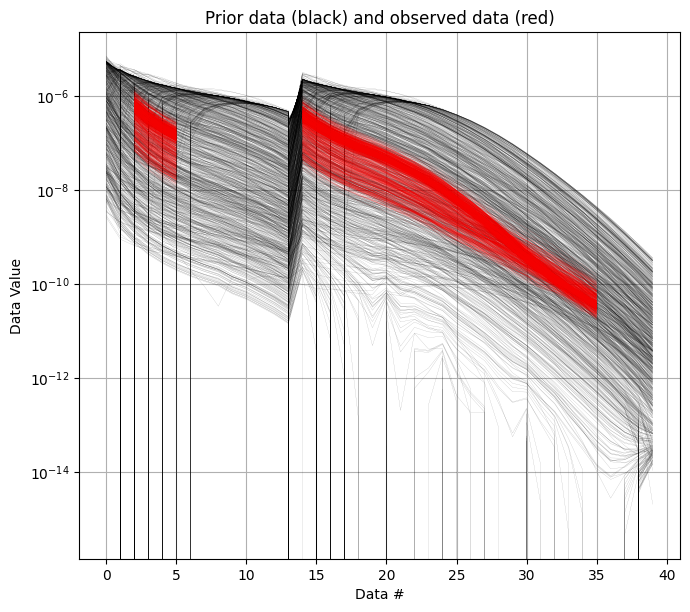

True

In [5]:
# into TWO data sets, LOW and HIGH moment.

ig.plot_data_prior(f_prior_data_h5, f_data_h5)

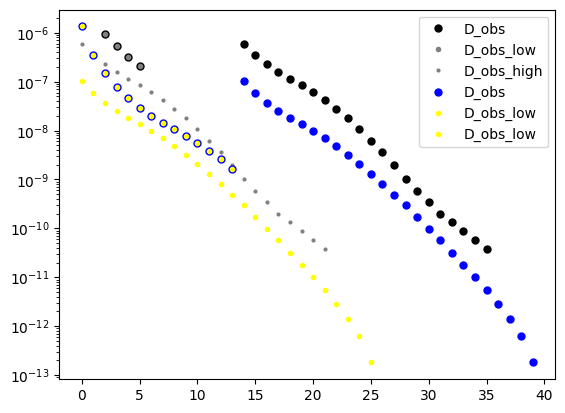

In [6]:
# Read D_obs from f_data_h5
with h5py.File(f_data_h5, 'r') as f:
    D_obs = f['D1/d_obs'][:]
    D_std = f['D1/d_std'][:]
# Alternatively, use the ig.load_data function    
#D_obs = ig.load_data(f_data_h5, id=1, showInfo=1)['d_obs'][0]
#D_std = ig.load_data(f_data_h5, id=1, showInfo=1)['d_std'][0]

with h5py.File(f_prior_data_h5, 'r') as f:
    D = f['/D1'][:]
# Alternatively, use the ig.load_prior_data function    
#D = ig.load_prior_data(f_prior_data_h5)[0][0]
    
# Now splot the into low and high moment data sets
# The low moment data set will be the first 14 columns, and the high moment data set will be the last columns.
nd = D_obs.shape[1]
n_low = 14
n_high = nd - n_low
# set i low to 0:n_low-1
i_low = range(n_low)
i_high = range(n_low, nd)

# Split prior data
D_low = D[:,i_low]
D_high = D[:,i_high]
# Split observed data
D_obs_low = D_obs[:,i_low]
D_std_low = D_std[:,i_low]*2
D_obs_high = D_obs[:,i_high]
D_std_high = D_std[:,i_high]*2


plt.semilogy(D_obs[0],'k.',markersize=10, label='D_obs')
plt.semilogy(D_obs_low[0],'.', color='gray', markersize=6, label='D_obs_low')
plt.semilogy(D_obs_high[0],'.', color='gray',markersize=4, label='D_obs_high')

plt.semilogy(D[0],'b.',markersize=10, label='D_obs')
plt.semilogy(D_low[0],'.', color='yellow', markersize=6, label='D_obs_low')
plt.semilogy(D_high[0],'.', color='yellow', markersize=6, label='D_obs_low')
plt.legend()

In [7]:
f_data_dual_h5 = 'DAUGAARD_AVG_dual.h5'

useOldMethod = False
if useOldMethod:
    ig.copy_hdf5_file(f_data_h5,f_data_dual_h5)
    # Delete D1
    with h5py.File(f_data_dual_h5, 'a') as f:
        # show groups in f['']
        if 'D1' in f.keys():
            del(f['D1'])
    # Update D1 and D2      
    with h5py.File(f_data_dual_h5, 'a') as f:
        # remove 'D1' 
        #del f['D1']
        f.create_dataset('D1/d_obs', data=D_obs_low)
        f.create_dataset('D1/d_std', data=D_std_low)
        f['D1'].attrs['noise_model'] = 'gaussian'
        f.create_dataset('D2/d_obs', data=D_obs_high)
        f.create_dataset('D2/d_std', data=D_std_high)
        f['D2'].attrs['noise_model'] = 'gaussian'
else:
    # Alternatively, use the ig.write_data_gaussian function
    ig.copy_hdf5_file(f_data_h5,f_data_dual_h5)
    ig.write_data_gaussian(D_obs_low, D_std = D_std_low, f_data_h5 = f_data_dual_h5, id=1, showInfo=0)
    ig.write_data_gaussian(D_obs_high, D_std = D_std_high, f_data_h5 = f_data_dual_h5, id=2, showInfo=0)



Removing group DAUGAARD_AVG_dual.h5:D1 
Adding group DAUGAARD_AVG_dual.h5:D1 
Adding group DAUGAARD_AVG_dual.h5:D2 


In [8]:
f_prior_data_dual_h5 = 'PRIOR_dual.h5'
ig.copy_hdf5_file(f_prior_data_h5,f_prior_data_dual_h5)
if useOldMethod:

    with h5py.File(f_prior_data_dual_h5, 'a') as f:
        # show groups in f['']
        if 'D1' in f.keys():
            del(f['D1'])
        f.create_dataset('D1', data=D_low)
        f.create_dataset('D2', data=D_high)
else:
    # Alternatively, use the ig.write_data_gaussian function 
    ig.save_prior_data(f_prior_data_dual_h5, D_low, id=1, force_delete=True)
    ig.save_prior_data(f_prior_data_dual_h5, D_high, id=2, force_delete=False)

Saving new prior data '/D1' to file: PRIOR_dual.h5 
Deleting prior data '/D1' from file: <HDF5 file "PRIOR_dual.h5" (mode r+)> 
New prior data '/D1' saved to file: PRIOR_dual.h5 
Saving new prior data '/D2' to file: PRIOR_dual.h5 
New prior data '/D2' saved to file: PRIOR_dual.h5 


id_data = 1


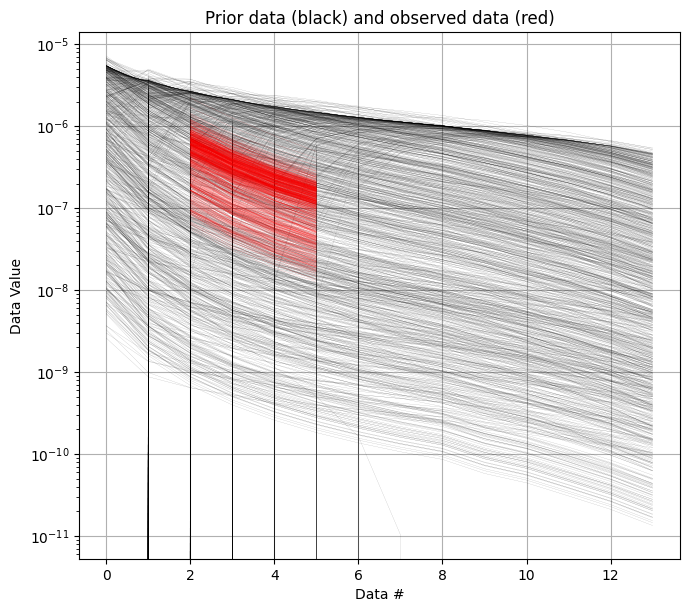

id_data = 2


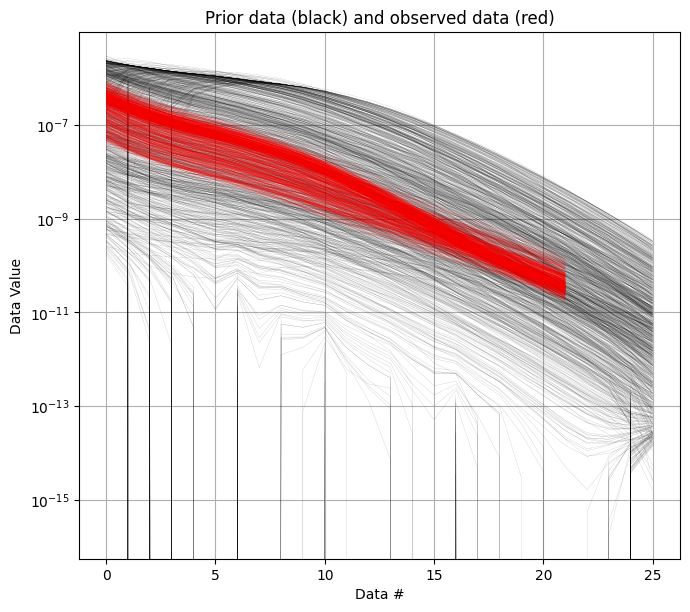

True

In [9]:
ig.plot_data_prior(f_prior_data_dual_h5, f_data_dual_h5, id=1)
ig.plot_data_prior(f_prior_data_dual_h5, f_data_dual_h5, id=2)

## Sample the posterior $\sigma(\mathbf{m})$

The posterior distribution is sampling using the extended rejection sampler.

In [10]:
N_use = 100000 #%N
N_cpu = 8
f_post_arr = []
updatePostStat=False
showInfo = 1

import time
t_inversion = []

for itype in [0,1,2,3]:
    t_start = time.time()
    if itype == 0:
        # LOW AND HIGH MOMENT AS ONE DATA SET - THE ORIGINAL METHOD
        f_post_h5 = ig.integrate_rejection(f_prior_data_h5, 
                                    f_data_h5, 
                                    f_post_h5='POST_type%d.h5' % itype,
                                    N_use = N_use, Ncpu=N_cpu,
                                    showInfo=showInfo, 
                                    updatePostStat=updatePostStat)
    elif itype == 1:
        # LOW MOMENT ONLY
        f_post_h5 = ig.integrate_rejection(f_prior_data_dual_h5, 
                                   f_data_dual_h5, 
                                   f_post_h5='POST_type%d.h5' % itype,
                                   N_use = N_use, Ncpu=N_cpu,
                                   showInfo=showInfo, 
                                   updatePostStat=updatePostStat,
                                   id_use = [1])
    elif itype == 2:
        # HIGH MOMENT ONLY
        f_post_h5 = ig.integrate_rejection(f_prior_data_dual_h5, 
                                   f_data_dual_h5, 
                                #    f_post_h5='POST_type%d.h5' % itype,
                                   N_use = N_use, Ncpu=N_cpu,
                                   showInfo=showInfo, 
                                   updatePostStat=updatePostStat,  
                                   id_use = [2])
    elif itype == 3:
        # JOINT INVERSION USING BOTH LOW AND HIGH MOMENT
        f_post_h5 = ig.integrate_rejection(f_prior_data_dual_h5, 
                                   f_data_dual_h5, 
                                   f_post_h5='POST_type%d.h5' % itype,
                                   N_use = N_use, Ncpu=N_cpu,
                                   showInfo=showInfo, 
                                   updatePostStat=updatePostStat,  
                                   id_use = [1,2])

    t_inversion.append(time.time() - t_start)
    f_post_arr.append(f_post_h5)



File POST_type0.h5 allready exists
Overwriting...
Loading data from DAUGAARD_AVG.h5. Using data types: [1]
  - D1: id_use=1,    gaussian, Using 11693/40 data
Loading prior data from PRIOR_CHI2_NF_3_log-uniform_N100000_TX07_20231016_2x4_RC20-33_Nh280_Nf12.h5. Using prior data ids: [1]
  - /D1:  N,nd = 100000/40
<--INTEGRATE_REJECTION-->
f_prior_h5=PRIOR_CHI2_NF_3_log-uniform_N100000_TX07_20231016_2x4_RC20-33_Nh280_Nf12.h5, f_data_h5=DAUGAARD_AVG.h5
f_post_h5=POST_type0.h5


integrate_rejection: Time=182.8s/11693 soundings, 15.6ms/sounding, 64.0it/sintegrate_rejection: T_av=48.8, EV_av=-67.7
File POST_type1.h5 allready exists
Overwriting...
Loading data from DAUGAARD_AVG_dual.h5. Using data types: [1]
  - D1: id_use=1,    gaussian, Using 11693/14 data
Loading prior data from PRIOR_dual.h5. Using prior data ids: [1]
  - /D1:  N,nd = 100000/14
<--INTEGRATE_REJECTION-->
f_prior_h5=PRIOR_dual.h5, f_data_h5=DAUGAARD_AVG_dual.h5
f_post_h5=POST_type1.h5


integrate_rejection: Time= 66.2s/11693 soundings,  5.7ms/sounding, 176.7it/sintegrate_rejection: T_av=1.0, EV_av=-6.2
Loading data from DAUGAARD_AVG_dual.h5. Using data types: [2]
  - D2: id_use=2,    gaussian, Using 11693/26 data
Loading prior data from PRIOR_dual.h5. Using prior data ids: [2]
  - /D2:  N,nd = 100000/26
<--INTEGRATE_REJECTION-->
f_prior_h5=PRIOR_dual.h5, f_data_h5=DAUGAARD_AVG_dual.h5
f_post_h5=/mnt/d/PROGRAMMING/integrate_module/examples/POST_PRIOR_dual_Nu100000_aT1.h5


integrate_rejection: Time=112.0s/11693 soundings,  9.6ms/sounding, 104.4it/sintegrate_rejection: T_av=9.7, EV_av=-19.5
File POST_type3.h5 allready exists
Overwriting...
Loading data from DAUGAARD_AVG_dual.h5. Using data types: [1, 2]
  - D1: id_use=1,    gaussian, Using 11693/14 data
  - D2: id_use=2,    gaussian, Using 11693/26 data
Loading prior data from PRIOR_dual.h5. Using prior data ids: [1, 2]
  - /D1:  N,nd = 100000/14
  - /D2:  N,nd = 100000/26
<--INTEGRATE_REJECTION-->
f_prior_h5=PRIOR_dual.h5, f_data_h5=DAUGAARD_AVG_dual.h5
f_post_h5=POST_type3.h5


integrate_rejection: Time=175.2s/11693 soundings, 15.0ms/sounding, 66.7it/sintegrate_rejection: T_av=12.2, EV_av=-24.9


rejection:   1%|▊                                                                                                                                                                       | 10/1949 [00:04<16:07,  2.00it/s]

rejection:   1%|▊                                                                                                                                                                       | 10/1949 [00:04<16:04,  2.01it/s]

rejection:   1%|▊                                                                                                                                                                       | 10/1949 [00:04<15:54,  2.03it/s]

rejection:   1%|▊                                                                                                                                                                       | 10/1949 [00:04<16:02,  2.01it/s]

rejection:   1%|▊                                                                                                                                                                       | 10/1949 [00:04<15:58,  2.02it/s]

rejection:   1%|▊                                                                                                                                                                       | 10/1948 [00:04<16:04,  2.01it/s]

rejection:   1%|█▋                                                                                                                                                                      | 20/1949 [00:09<16:01,  2.01it/s]

rejection:   1%|█▋                                                                                                                                                                      | 20/1949 [00:09<15:53,  2.02it/s]

rejection:   1%|█▋                                                                                                                                                                      | 20/1949 [00:09<15:56,  2.02it/s]

rejection:   1%|█▋                                                                                                                                                                      | 20/1949 [00:09<15:50,  2.03it/s]

rejection:   1%|█▋                                                                                                                                                                      | 20/1949 [00:09<16:02,  2.00it/s]

rejection:   1%|█▋                                                                                                                                                                      | 20/1948 [00:10<16:09,  1.99it/s]

rejection:   2%|██▌                                                                                                                                                                     | 30/1949 [00:14<15:49,  2.02it/s]

rejection:   2%|██▌                                                                                                                                                                     | 30/1949 [00:14<15:47,  2.03it/s]

rejection:   2%|██▌                                                                                                                                                                     | 30/1949 [00:14<15:52,  2.02it/s]

rejection:   2%|██▌                                                                                                                                                                     | 30/1949 [00:14<15:55,  2.01it/s]

rejection:   2%|██▌                                                                                                                                                                     | 30/1949 [00:14<15:55,  2.01it/s]

rejection:   2%|██▌                                                                                                                                                                     | 30/1948 [00:15<16:02,  1.99it/s]

rejection:   2%|███▍                                                                                                                                                                    | 40/1949 [00:19<15:50,  2.01it/s]

rejection:   2%|███▍                                                                                                                                                                    | 40/1949 [00:19<15:49,  2.01it/s]

rejection:   2%|███▍                                                                                                                                                                    | 40/1949 [00:19<15:47,  2.02it/s]

rejection:   2%|███▍                                                                                                                                                                    | 40/1949 [00:19<15:50,  2.01it/s]

rejection:   2%|███▍                                                                                                                                                                    | 40/1949 [00:19<15:51,  2.01it/s]

rejection:   2%|███▍                                                                                                                                                                    | 40/1948 [00:19<15:47,  2.01it/s]

rejection:   3%|████▎                                                                                                                                                                   | 50/1948 [00:24<15:29,  2.04it/s]

rejection:   3%|████▎                                                                                                                                                                   | 50/1949 [00:24<15:44,  2.01it/s]

rejection:   3%|████▎                                                                                                                                                                   | 50/1949 [00:24<15:47,  2.00it/s]

rejection:   3%|████▎                                                                                                                                                                   | 50/1949 [00:24<15:45,  2.01it/s]

rejection:   3%|████▎                                                                                                                                                                   | 50/1949 [00:24<15:44,  2.01it/s]

rejection:   3%|████▎                                                                                                                                                                   | 50/1949 [00:24<15:45,  2.01it/s]

rejection:   3%|█████▏                                                                                                                                                                  | 60/1949 [00:29<15:39,  2.01it/s]

rejection:   3%|█████▏                                                                                                                                                                  | 60/1949 [00:29<15:38,  2.01it/s]

rejection:   3%|█████▏                                                                                                                                                                  | 60/1949 [00:29<15:39,  2.01it/s]

rejection:   3%|█████▏                                                                                                                                                                  | 60/1949 [00:29<15:40,  2.01it/s]

rejection:   3%|█████▏                                                                                                                                                                  | 60/1949 [00:29<15:41,  2.01it/s]

rejection:   3%|█████▏                                                                                                                                                                  | 60/1948 [00:29<15:32,  2.02it/s]

rejection:   4%|██████                                                                                                                                                                  | 70/1949 [00:34<15:35,  2.01it/s]

rejection:   4%|██████                                                                                                                                                                  | 70/1949 [00:34<15:35,  2.01it/s]

rejection:   4%|██████                                                                                                                                                                  | 70/1948 [00:34<15:30,  2.02it/s]

rejection:   4%|██████                                                                                                                                                                  | 70/1949 [00:34<15:36,  2.01it/s]

rejection:   4%|██████                                                                                                                                                                  | 70/1949 [00:34<15:37,  2.00it/s]

rejection:   4%|██████                                                                                                                                                                  | 70/1949 [00:34<15:36,  2.01it/s]

rejection:   4%|██████▉                                                                                                                                                                 | 80/1949 [00:39<15:31,  2.01it/s]

rejection:   4%|██████▉                                                                                                                                                                 | 80/1949 [00:39<15:31,  2.01it/s]

rejection:   4%|██████▉                                                                                                                                                                 | 80/1949 [00:39<15:32,  2.00it/s]

rejection:   4%|██████▉                                                                                                                                                                 | 80/1949 [00:39<15:31,  2.01it/s]

rejection:   4%|██████▉                                                                                                                                                                 | 80/1948 [00:39<15:28,  2.01it/s]

rejection:   4%|██████▉                                                                                                                                                                 | 80/1949 [00:39<15:32,  2.00it/s]

rejection:   5%|███████▊                                                                                                                                                                | 90/1948 [00:44<15:19,  2.02it/s]

rejection:   5%|███████▊                                                                                                                                                                | 90/1949 [00:44<15:26,  2.01it/s]

rejection:   5%|███████▊                                                                                                                                                                | 90/1949 [00:44<15:26,  2.01it/s]

rejection:   5%|███████▊                                                                                                                                                                | 90/1949 [00:44<15:26,  2.01it/s]

rejection:   5%|███████▊                                                                                                                                                                | 90/1949 [00:44<15:26,  2.01it/s]

rejection:   5%|███████▊                                                                                                                                                                | 90/1949 [00:44<15:26,  2.01it/s]

rejection:   5%|████████▌                                                                                                                                                              | 100/1948 [00:49<15:11,  2.03it/s]

rejection:   5%|████████▌                                                                                                                                                              | 100/1949 [00:49<15:19,  2.01it/s]

rejection:   5%|████████▌                                                                                                                                                              | 100/1949 [00:49<15:20,  2.01it/s]

rejection:   5%|████████▌                                                                                                                                                              | 100/1949 [00:49<15:21,  2.01it/s]

rejection:   5%|████████▌                                                                                                                                                              | 100/1949 [00:49<15:20,  2.01it/s]

rejection:   5%|████████▌                                                                                                                                                              | 100/1949 [00:49<15:20,  2.01it/s]

rejection:   6%|█████████▍                                                                                                                                                             | 110/1949 [00:54<15:13,  2.01it/s]

rejection:   6%|█████████▍                                                                                                                                                             | 110/1949 [00:54<15:14,  2.01it/s]

rejection:   6%|█████████▍                                                                                                                                                             | 110/1948 [00:54<15:15,  2.01it/s]

rejection:   6%|█████████▍                                                                                                                                                             | 110/1949 [00:54<15:14,  2.01it/s]

rejection:   6%|█████████▍                                                                                                                                                             | 110/1949 [00:54<15:15,  2.01it/s]

rejection:   6%|█████████▍                                                                                                                                                             | 110/1949 [00:54<15:15,  2.01it/s]

rejection:   6%|██████████▎                                                                                                                                                            | 120/1949 [00:59<15:10,  2.01it/s]

rejection:   6%|██████████▎                                                                                                                                                            | 120/1949 [00:59<15:10,  2.01it/s]

rejection:   6%|██████████▎                                                                                                                                                            | 120/1948 [00:59<15:11,  2.01it/s]

rejection:   6%|██████████▎                                                                                                                                                            | 120/1949 [00:59<15:10,  2.01it/s]

rejection:   6%|██████████▎                                                                                                                                                            | 120/1949 [00:59<15:10,  2.01it/s]

rejection:   6%|██████████▎                                                                                                                                                            | 120/1949 [00:59<15:11,  2.01it/s]

rejection:   7%|███████████▏                                                                                                                                                           | 130/1948 [01:04<15:04,  2.01it/s]

rejection:   7%|███████████▏                                                                                                                                                           | 130/1949 [01:04<15:05,  2.01it/s]

rejection:   7%|███████████▏                                                                                                                                                           | 130/1949 [01:04<15:05,  2.01it/s]

rejection:   7%|███████████▏                                                                                                                                                           | 130/1949 [01:04<15:06,  2.01it/s]

rejection:   7%|███████████▏                                                                                                                                                           | 130/1949 [01:04<15:05,  2.01it/s]

rejection:   7%|███████████▏                                                                                                                                                           | 130/1949 [01:04<15:06,  2.01it/s]

rejection:   7%|████████████                                                                                                                                                           | 140/1948 [01:09<14:55,  2.02it/s]

rejection:   7%|███████████▉                                                                                                                                                           | 140/1949 [01:09<15:00,  2.01it/s]

rejection:   7%|███████████▉                                                                                                                                                           | 140/1949 [01:09<15:00,  2.01it/s]

rejection:   7%|███████████▉                                                                                                                                                           | 140/1949 [01:09<15:00,  2.01it/s]

rejection:   7%|███████████▉                                                                                                                                                           | 140/1949 [01:09<15:00,  2.01it/s]

rejection:   7%|███████████▉                                                                                                                                                           | 140/1949 [01:09<15:00,  2.01it/s]

rejection:   8%|████████████▊                                                                                                                                                          | 150/1948 [01:14<14:46,  2.03it/s]

rejection:   8%|████████████▊                                                                                                                                                          | 150/1949 [01:14<14:54,  2.01it/s]

rejection:   8%|████████████▊                                                                                                                                                          | 150/1949 [01:14<14:54,  2.01it/s]

rejection:   8%|████████████▊                                                                                                                                                          | 150/1949 [01:14<14:54,  2.01it/s]

rejection:   8%|████████████▊                                                                                                                                                          | 150/1949 [01:14<14:55,  2.01it/s]

rejection:   8%|████████████▊                                                                                                                                                          | 150/1949 [01:14<14:55,  2.01it/s]

rejection:   8%|█████████████▋                                                                                                                                                         | 160/1948 [01:19<14:46,  2.02it/s]

rejection:   8%|█████████████▋                                                                                                                                                         | 160/1949 [01:19<14:48,  2.01it/s]

rejection:   8%|█████████████▋                                                                                                                                                         | 160/1949 [01:19<14:48,  2.01it/s]

rejection:   8%|█████████████▋                                                                                                                                                         | 160/1949 [01:19<14:50,  2.01it/s]

rejection:   8%|█████████████▋                                                                                                                                                         | 160/1949 [01:19<14:50,  2.01it/s]

rejection:   8%|█████████████▋                                                                                                                                                         | 160/1949 [01:19<14:50,  2.01it/s]

rejection:   9%|██████████████▌                                                                                                                                                        | 170/1948 [01:24<14:45,  2.01it/s]

rejection:   9%|██████████████▌                                                                                                                                                        | 170/1949 [01:24<14:44,  2.01it/s]

rejection:   9%|██████████████▌                                                                                                                                                        | 170/1949 [01:24<14:45,  2.01it/s]

rejection:   9%|██████████████▌                                                                                                                                                        | 170/1949 [01:24<14:45,  2.01it/s]

rejection:   9%|██████████████▌                                                                                                                                                        | 170/1949 [01:24<14:45,  2.01it/s]

rejection:   9%|██████████████▌                                                                                                                                                        | 170/1949 [01:24<14:46,  2.01it/s]

rejection:   9%|███████████████▍                                                                                                                                                       | 180/1948 [01:29<14:44,  2.00it/s]

rejection:   9%|███████████████▍                                                                                                                                                       | 180/1949 [01:29<14:39,  2.01it/s]

rejection:   9%|███████████████▍                                                                                                                                                       | 180/1949 [01:29<14:40,  2.01it/s]

rejection:   9%|███████████████▍                                                                                                                                                       | 180/1949 [01:29<14:40,  2.01it/s]

rejection:   9%|███████████████▍                                                                                                                                                       | 180/1949 [01:29<14:40,  2.01it/s]

rejection:   9%|███████████████▍                                                                                                                                                       | 180/1949 [01:29<14:40,  2.01it/s]

rejection:  10%|████████████████▎                                                                                                                                                      | 190/1948 [01:34<14:41,  1.99it/s]

rejection:  10%|████████████████▎                                                                                                                                                      | 190/1949 [01:34<14:38,  2.00it/s]

rejection:  10%|████████████████▎                                                                                                                                                      | 190/1949 [01:34<14:38,  2.00it/s]

rejection:  10%|████████████████▎                                                                                                                                                      | 190/1949 [01:34<14:38,  2.00it/s]

rejection:  10%|████████████████▎                                                                                                                                                      | 190/1949 [01:34<14:38,  2.00it/s]

rejection:  10%|████████████████▎                                                                                                                                                      | 190/1949 [01:34<14:38,  2.00it/s]

rejection:  10%|█████████████████▏                                                                                                                                                     | 200/1949 [01:39<14:34,  2.00it/s]

rejection:  10%|█████████████████▏                                                                                                                                                     | 200/1949 [01:39<14:33,  2.00it/s]

rejection:  10%|█████████████████▏                                                                                                                                                     | 200/1949 [01:39<14:34,  2.00it/s]

rejection:  10%|█████████████████▏                                                                                                                                                     | 200/1949 [01:39<14:34,  2.00it/s]

rejection:  10%|█████████████████▏                                                                                                                                                     | 200/1949 [01:39<14:34,  2.00it/s]

rejection:  10%|█████████████████▏                                                                                                                                                     | 200/1948 [01:39<14:37,  1.99it/s]

rejection:  11%|█████████████████▉                                                                                                                                                     | 210/1949 [01:44<14:28,  2.00it/s]

rejection:  11%|██████████████████                                                                                                                                                     | 210/1948 [01:44<14:30,  2.00it/s]

rejection:  11%|█████████████████▉                                                                                                                                                     | 210/1949 [01:44<14:29,  2.00it/s]

rejection:  11%|█████████████████▉                                                                                                                                                     | 210/1949 [01:44<14:29,  2.00it/s]

rejection:  11%|█████████████████▉                                                                                                                                                     | 210/1949 [01:44<14:29,  2.00it/s]

rejection:  11%|█████████████████▉                                                                                                                                                     | 210/1949 [01:44<14:29,  2.00it/s]

rejection:  11%|██████████████████▊                                                                                                                                                    | 220/1949 [01:49<14:22,  2.00it/s]

rejection:  11%|██████████████████▊                                                                                                                                                    | 220/1949 [01:49<14:23,  2.00it/s]

rejection:  11%|██████████████████▊                                                                                                                                                    | 220/1949 [01:49<14:23,  2.00it/s]

rejection:  11%|██████████████████▊                                                                                                                                                    | 220/1949 [01:49<14:24,  2.00it/s]

rejection:  11%|██████████████████▊                                                                                                                                                    | 220/1949 [01:49<14:23,  2.00it/s]

rejection:  11%|██████████████████▊                                                                                                                                                    | 220/1948 [01:49<14:25,  2.00it/s]

rejection:  12%|███████████████████▋                                                                                                                                                   | 230/1949 [01:54<14:19,  2.00it/s]

rejection:  12%|███████████████████▋                                                                                                                                                   | 230/1949 [01:54<14:18,  2.00it/s]

rejection:  12%|███████████████████▋                                                                                                                                                   | 230/1949 [01:54<14:19,  2.00it/s]

rejection:  12%|███████████████████▋                                                                                                                                                   | 230/1948 [01:54<14:20,  2.00it/s]

rejection:  12%|███████████████████▋                                                                                                                                                   | 230/1949 [01:54<14:19,  2.00it/s]

rejection:  12%|███████████████████▋                                                                                                                                                   | 230/1949 [01:54<14:20,  2.00it/s]

rejection:  12%|████████████████████▌                                                                                                                                                  | 240/1949 [01:59<14:13,  2.00it/s]

rejection:  12%|████████████████████▌                                                                                                                                                  | 240/1949 [01:59<14:13,  2.00it/s]

rejection:  12%|████████████████████▌                                                                                                                                                  | 240/1949 [01:59<14:13,  2.00it/s]

rejection:  12%|████████████████████▌                                                                                                                                                  | 240/1949 [01:59<14:14,  2.00it/s]

rejection:  12%|████████████████████▌                                                                                                                                                  | 240/1948 [01:59<14:14,  2.00it/s]

rejection:  12%|████████████████████▌                                                                                                                                                  | 240/1949 [01:59<14:14,  2.00it/s]

rejection:  13%|█████████████████████▍                                                                                                                                                 | 250/1949 [02:04<14:09,  2.00it/s]

rejection:  13%|█████████████████████▍                                                                                                                                                 | 250/1949 [02:04<14:08,  2.00it/s]

rejection:  13%|█████████████████████▍                                                                                                                                                 | 250/1949 [02:04<14:09,  2.00it/s]

rejection:  13%|█████████████████████▍                                                                                                                                                 | 250/1949 [02:04<14:09,  2.00it/s]

rejection:  13%|█████████████████████▍                                                                                                                                                 | 250/1948 [02:04<14:09,  2.00it/s]

rejection:  13%|█████████████████████▍                                                                                                                                                 | 250/1949 [02:04<14:09,  2.00it/s]

rejection:  13%|██████████████████████▎                                                                                                                                                | 260/1949 [02:09<14:01,  2.01it/s]

rejection:  13%|██████████████████████▎                                                                                                                                                | 260/1949 [02:09<14:03,  2.00it/s]

rejection:  13%|██████████████████████▎                                                                                                                                                | 260/1949 [02:09<14:03,  2.00it/s]

rejection:  13%|██████████████████████▎                                                                                                                                                | 260/1949 [02:09<14:03,  2.00it/s]

rejection:  13%|██████████████████████▎                                                                                                                                                | 260/1949 [02:09<14:03,  2.00it/s]

rejection:  13%|██████████████████████▎                                                                                                                                                | 260/1948 [02:09<14:03,  2.00it/s]

rejection:  14%|███████████████████████▏                                                                                                                                               | 270/1949 [02:14<13:57,  2.01it/s]

rejection:  14%|███████████████████████▏                                                                                                                                               | 270/1949 [02:14<13:57,  2.00it/s]

rejection:  14%|███████████████████████▏                                                                                                                                               | 270/1949 [02:14<13:58,  2.00it/s]

rejection:  14%|███████████████████████▏                                                                                                                                               | 270/1949 [02:14<13:58,  2.00it/s]

rejection:  14%|███████████████████████▏                                                                                                                                               | 270/1949 [02:14<13:58,  2.00it/s]

rejection:  14%|███████████████████████▏                                                                                                                                               | 270/1948 [02:14<13:57,  2.00it/s]

rejection:  14%|███████████████████████▉                                                                                                                                               | 280/1949 [02:19<13:52,  2.01it/s]

rejection:  14%|███████████████████████▉                                                                                                                                               | 280/1949 [02:19<13:52,  2.00it/s]

rejection:  14%|███████████████████████▉                                                                                                                                               | 280/1949 [02:19<13:52,  2.00it/s]

rejection:  14%|███████████████████████▉                                                                                                                                               | 280/1949 [02:19<13:53,  2.00it/s]

rejection:  14%|███████████████████████▉                                                                                                                                               | 280/1949 [02:19<13:53,  2.00it/s]

rejection:  14%|████████████████████████                                                                                                                                               | 280/1948 [02:19<13:52,  2.00it/s]

rejection:  15%|████████████████████████▊                                                                                                                                              | 290/1949 [02:24<13:38,  2.03it/s]

rejection:  15%|████████████████████████▊                                                                                                                                              | 290/1949 [02:24<13:47,  2.00it/s]

rejection:  15%|████████████████████████▊                                                                                                                                              | 290/1949 [02:24<13:47,  2.00it/s]

rejection:  15%|████████████████████████▊                                                                                                                                              | 290/1949 [02:24<13:47,  2.00it/s]

rejection:  15%|████████████████████████▊                                                                                                                                              | 290/1949 [02:24<13:47,  2.00it/s]

rejection:  15%|████████████████████████▊                                                                                                                                              | 290/1948 [02:24<13:47,  2.00it/s]

rejection:  15%|█████████████████████████▋                                                                                                                                             | 300/1949 [02:29<13:27,  2.04it/s]

rejection:  15%|█████████████████████████▋                                                                                                                                             | 300/1949 [02:29<13:42,  2.00it/s]

rejection:  15%|█████████████████████████▋                                                                                                                                             | 300/1949 [02:29<13:43,  2.00it/s]

rejection:  15%|█████████████████████████▋                                                                                                                                             | 300/1948 [02:29<13:42,  2.00it/s]

rejection:  15%|█████████████████████████▋                                                                                                                                             | 300/1949 [02:29<13:43,  2.00it/s]

rejection:  15%|█████████████████████████▋                                                                                                                                             | 300/1949 [02:29<13:43,  2.00it/s]

rejection:  16%|██████████████████████████▌                                                                                                                                            | 310/1949 [02:34<13:20,  2.05it/s]

rejection:  16%|██████████████████████████▌                                                                                                                                            | 310/1949 [02:34<13:37,  2.01it/s]

rejection:  16%|██████████████████████████▌                                                                                                                                            | 310/1949 [02:34<13:37,  2.01it/s]

rejection:  16%|██████████████████████████▌                                                                                                                                            | 310/1948 [02:34<13:37,  2.00it/s]

rejection:  16%|██████████████████████████▌                                                                                                                                            | 310/1949 [02:34<13:38,  2.00it/s]

rejection:  16%|██████████████████████████▌                                                                                                                                            | 310/1949 [02:34<13:38,  2.00it/s]

rejection:  16%|███████████████████████████▍                                                                                                                                           | 320/1949 [02:39<13:20,  2.04it/s]

rejection:  16%|███████████████████████████▍                                                                                                                                           | 320/1949 [02:39<13:32,  2.01it/s]

rejection:  16%|███████████████████████████▍                                                                                                                                           | 320/1949 [02:39<13:31,  2.01it/s]

rejection:  16%|███████████████████████████▍                                                                                                                                           | 320/1949 [02:39<13:32,  2.01it/s]

rejection:  16%|███████████████████████████▍                                                                                                                                           | 320/1948 [02:39<13:31,  2.01it/s]

rejection:  16%|███████████████████████████▍                                                                                                                                           | 320/1949 [02:39<13:32,  2.01it/s]

rejection:  17%|████████████████████████████▎                                                                                                                                          | 330/1949 [02:44<13:19,  2.03it/s]

rejection:  17%|████████████████████████████▎                                                                                                                                          | 330/1949 [02:44<13:26,  2.01it/s]

rejection:  17%|████████████████████████████▎                                                                                                                                          | 330/1949 [02:44<13:27,  2.01it/s]

rejection:  17%|████████████████████████████▎                                                                                                                                          | 330/1949 [02:44<13:27,  2.00it/s]

rejection:  17%|████████████████████████████▎                                                                                                                                          | 330/1949 [02:44<13:27,  2.01it/s]

rejection:  17%|████████████████████████████▎                                                                                                                                          | 330/1948 [02:44<13:26,  2.01it/s]

rejection:  17%|█████████████████████████████▏                                                                                                                                         | 340/1949 [02:49<13:16,  2.02it/s]

rejection:  17%|█████████████████████████████▏                                                                                                                                         | 340/1948 [02:49<13:21,  2.01it/s]

rejection:  17%|█████████████████████████████▏                                                                                                                                         | 340/1949 [02:49<13:22,  2.01it/s]

rejection:  17%|█████████████████████████████▏                                                                                                                                         | 340/1949 [02:49<13:22,  2.00it/s]

rejection:  17%|█████████████████████████████▏                                                                                                                                         | 340/1949 [02:49<13:22,  2.00it/s]

rejection:  17%|█████████████████████████████▏                                                                                                                                         | 340/1949 [02:49<13:22,  2.00it/s]

rejection:  18%|█████████████████████████████▉                                                                                                                                         | 350/1949 [02:54<13:13,  2.02it/s]

rejection:  18%|█████████████████████████████▉                                                                                                                                         | 350/1949 [02:54<13:16,  2.01it/s]

rejection:  18%|█████████████████████████████▉                                                                                                                                         | 350/1949 [02:54<13:16,  2.01it/s]

rejection:  18%|█████████████████████████████▉                                                                                                                                         | 350/1949 [02:54<13:17,  2.01it/s]

rejection:  18%|██████████████████████████████                                                                                                                                         | 350/1948 [02:54<13:16,  2.01it/s]

rejection:  18%|█████████████████████████████▉                                                                                                                                         | 350/1949 [02:54<13:17,  2.00it/s]

rejection:  18%|██████████████████████████████▊                                                                                                                                        | 360/1949 [02:59<13:09,  2.01it/s]

rejection:  18%|██████████████████████████████▊                                                                                                                                        | 360/1949 [02:59<13:12,  2.01it/s]

rejection:  18%|██████████████████████████████▊                                                                                                                                        | 360/1948 [02:59<13:11,  2.01it/s]

rejection:  18%|██████████████████████████████▊                                                                                                                                        | 360/1949 [02:59<13:12,  2.01it/s]

rejection:  18%|██████████████████████████████▊                                                                                                                                        | 360/1949 [02:59<13:12,  2.01it/s]

rejection:  18%|██████████████████████████████▊                                                                                                                                        | 360/1949 [02:59<13:12,  2.00it/s]

rejection:  19%|███████████████████████████████▋                                                                                                                                       | 370/1949 [03:04<13:06,  2.01it/s]

rejection:  19%|███████████████████████████████▋                                                                                                                                       | 370/1948 [03:04<13:06,  2.01it/s]

rejection:  19%|███████████████████████████████▋                                                                                                                                       | 370/1949 [03:04<13:07,  2.00it/s]

rejection:  19%|███████████████████████████████▋                                                                                                                                       | 370/1949 [03:04<13:07,  2.00it/s]

rejection:  19%|███████████████████████████████▋                                                                                                                                       | 370/1949 [03:04<13:07,  2.00it/s]

rejection:  19%|███████████████████████████████▋                                                                                                                                       | 370/1949 [03:04<13:08,  2.00it/s]

rejection:  19%|████████████████████████████████▌                                                                                                                                      | 380/1949 [03:09<13:01,  2.01it/s]

rejection:  20%|████████████████████████████████▌                                                                                                                                      | 380/1948 [03:09<12:57,  2.02it/s]

rejection:  19%|████████████████████████████████▌                                                                                                                                      | 380/1949 [03:09<13:00,  2.01it/s]

rejection:  19%|████████████████████████████████▌                                                                                                                                      | 380/1949 [03:09<13:02,  2.00it/s]

rejection:  19%|████████████████████████████████▌                                                                                                                                      | 380/1949 [03:09<13:02,  2.00it/s]

rejection:  19%|████████████████████████████████▌                                                                                                                                      | 380/1949 [03:09<13:03,  2.00it/s]

rejection:  20%|█████████████████████████████████▍                                                                                                                                     | 390/1949 [03:13<12:55,  2.01it/s]

rejection:  20%|█████████████████████████████████▍                                                                                                                                     | 390/1948 [03:14<12:48,  2.03it/s]

rejection:  20%|█████████████████████████████████▍                                                                                                                                     | 390/1949 [03:14<12:56,  2.01it/s]

rejection:  20%|█████████████████████████████████▍                                                                                                                                     | 390/1949 [03:14<12:56,  2.01it/s]

rejection:  20%|█████████████████████████████████▍                                                                                                                                     | 390/1949 [03:14<12:56,  2.01it/s]

rejection:  20%|█████████████████████████████████▍                                                                                                                                     | 390/1949 [03:14<12:56,  2.01it/s]

rejection:  21%|██████████████████████████████████▎                                                                                                                                    | 400/1949 [03:18<12:50,  2.01it/s]

rejection:  21%|██████████████████████████████████▎                                                                                                                                    | 400/1948 [03:19<12:46,  2.02it/s]

rejection:  21%|██████████████████████████████████▎                                                                                                                                    | 400/1949 [03:19<12:50,  2.01it/s]

rejection:  21%|██████████████████████████████████▎                                                                                                                                    | 400/1949 [03:19<12:51,  2.01it/s]

rejection:  21%|██████████████████████████████████▎                                                                                                                                    | 400/1949 [03:19<12:51,  2.01it/s]

rejection:  21%|██████████████████████████████████▎                                                                                                                                    | 400/1949 [03:19<12:51,  2.01it/s]

rejection:  21%|███████████████████████████████████▏                                                                                                                                   | 410/1949 [03:23<12:44,  2.01it/s]

rejection:  21%|███████████████████████████████████▏                                                                                                                                   | 410/1948 [03:24<12:47,  2.00it/s]

rejection:  21%|███████████████████████████████████▏                                                                                                                                   | 410/1949 [03:24<12:44,  2.01it/s]

rejection:  21%|███████████████████████████████████▏                                                                                                                                   | 410/1949 [03:24<12:44,  2.01it/s]

rejection:  21%|███████████████████████████████████▏                                                                                                                                   | 410/1949 [03:24<12:44,  2.01it/s]

rejection:  21%|███████████████████████████████████▏                                                                                                                                   | 410/1949 [03:24<12:45,  2.01it/s]

rejection:  22%|███████████████████████████████████▉                                                                                                                                   | 420/1949 [03:28<12:39,  2.01it/s]

rejection:  22%|███████████████████████████████████▉                                                                                                                                   | 420/1949 [03:29<12:39,  2.01it/s]

rejection:  22%|███████████████████████████████████▉                                                                                                                                   | 420/1949 [03:29<12:39,  2.01it/s]

rejection:  22%|███████████████████████████████████▉                                                                                                                                   | 420/1949 [03:29<12:39,  2.01it/s]

rejection:  22%|████████████████████████████████████                                                                                                                                   | 420/1948 [03:29<12:43,  2.00it/s]

rejection:  22%|███████████████████████████████████▉                                                                                                                                   | 420/1949 [03:29<12:40,  2.01it/s]

rejection:  22%|████████████████████████████████████▊                                                                                                                                  | 430/1949 [03:33<12:35,  2.01it/s]

rejection:  22%|████████████████████████████████████▊                                                                                                                                  | 430/1948 [03:34<12:37,  2.01it/s]

rejection:  22%|████████████████████████████████████▊                                                                                                                                  | 430/1949 [03:34<12:35,  2.01it/s]

rejection:  22%|████████████████████████████████████▊                                                                                                                                  | 430/1949 [03:34<12:35,  2.01it/s]

rejection:  22%|████████████████████████████████████▊                                                                                                                                  | 430/1949 [03:34<12:35,  2.01it/s]

rejection:  22%|████████████████████████████████████▊                                                                                                                                  | 430/1949 [03:34<12:35,  2.01it/s]

rejection:  23%|█████████████████████████████████████▋                                                                                                                                 | 440/1949 [03:38<12:30,  2.01it/s]

rejection:  23%|█████████████████████████████████████▋                                                                                                                                 | 440/1948 [03:39<12:32,  2.01it/s]

rejection:  23%|█████████████████████████████████████▋                                                                                                                                 | 440/1949 [03:39<12:30,  2.01it/s]

rejection:  23%|█████████████████████████████████████▋                                                                                                                                 | 440/1949 [03:39<12:30,  2.01it/s]

rejection:  23%|█████████████████████████████████████▋                                                                                                                                 | 440/1949 [03:39<12:31,  2.01it/s]

rejection:  23%|█████████████████████████████████████▋                                                                                                                                 | 440/1949 [03:39<12:31,  2.01it/s]

rejection:  23%|██████████████████████████████████████▌                                                                                                                                | 450/1949 [03:43<12:25,  2.01it/s]

rejection:  23%|██████████████████████████████████████▌                                                                                                                                | 450/1948 [03:44<12:26,  2.01it/s]

rejection:  23%|██████████████████████████████████████▌                                                                                                                                | 450/1949 [03:44<12:25,  2.01it/s]

rejection:  23%|██████████████████████████████████████▌                                                                                                                                | 450/1949 [03:44<12:25,  2.01it/s]

rejection:  23%|██████████████████████████████████████▌                                                                                                                                | 450/1949 [03:44<12:26,  2.01it/s]

rejection:  23%|██████████████████████████████████████▌                                                                                                                                | 450/1949 [03:44<12:26,  2.01it/s]

rejection:  24%|███████████████████████████████████████▍                                                                                                                               | 460/1949 [03:48<12:22,  2.00it/s]

rejection:  24%|███████████████████████████████████████▍                                                                                                                               | 460/1949 [03:49<12:20,  2.01it/s]

rejection:  24%|███████████████████████████████████████▍                                                                                                                               | 460/1948 [03:49<12:22,  2.00it/s]

rejection:  24%|███████████████████████████████████████▍                                                                                                                               | 460/1949 [03:49<12:22,  2.01it/s]

rejection:  24%|███████████████████████████████████████▍                                                                                                                               | 460/1949 [03:49<12:22,  2.01it/s]

rejection:  24%|███████████████████████████████████████▍                                                                                                                               | 460/1949 [03:49<12:22,  2.01it/s]

rejection:  24%|████████████████████████████████████████▎                                                                                                                              | 470/1949 [03:53<12:16,  2.01it/s]

rejection:  24%|████████████████████████████████████████▎                                                                                                                              | 470/1948 [03:54<12:16,  2.01it/s]

rejection:  24%|████████████████████████████████████████▎                                                                                                                              | 470/1949 [03:54<12:16,  2.01it/s]

rejection:  24%|████████████████████████████████████████▎                                                                                                                              | 470/1949 [03:54<12:16,  2.01it/s]

rejection:  24%|████████████████████████████████████████▎                                                                                                                              | 470/1949 [03:54<12:17,  2.01it/s]

rejection:  24%|████████████████████████████████████████▎                                                                                                                              | 470/1949 [03:54<12:17,  2.01it/s]

rejection:  25%|█████████████████████████████████████████▏                                                                                                                             | 480/1949 [03:58<12:12,  2.01it/s]

rejection:  25%|█████████████████████████████████████████▏                                                                                                                             | 480/1949 [03:59<12:12,  2.01it/s]

rejection:  25%|█████████████████████████████████████████▏                                                                                                                             | 480/1948 [03:59<12:12,  2.00it/s]

rejection:  25%|█████████████████████████████████████████▏                                                                                                                             | 480/1949 [03:59<12:12,  2.00it/s]

rejection:  25%|█████████████████████████████████████████▏                                                                                                                             | 480/1949 [03:59<12:12,  2.01it/s]

rejection:  25%|█████████████████████████████████████████▏                                                                                                                             | 480/1949 [03:59<12:12,  2.00it/s]

rejection:  25%|█████████████████████████████████████████▉                                                                                                                             | 490/1949 [04:03<12:06,  2.01it/s]

rejection:  25%|█████████████████████████████████████████▉                                                                                                                             | 490/1949 [04:04<12:06,  2.01it/s]

rejection:  25%|██████████████████████████████████████████                                                                                                                             | 490/1948 [04:04<12:06,  2.01it/s]

rejection:  25%|█████████████████████████████████████████▉                                                                                                                             | 490/1949 [04:04<12:06,  2.01it/s]

rejection:  25%|█████████████████████████████████████████▉                                                                                                                             | 490/1949 [04:04<12:06,  2.01it/s]

rejection:  25%|█████████████████████████████████████████▉                                                                                                                             | 490/1949 [04:04<12:07,  2.01it/s]

rejection:  26%|██████████████████████████████████████████▊                                                                                                                            | 500/1949 [04:08<12:02,  2.01it/s]

rejection:  26%|██████████████████████████████████████████▊                                                                                                                            | 500/1949 [04:09<12:01,  2.01it/s]

rejection:  26%|██████████████████████████████████████████▊                                                                                                                            | 500/1949 [04:09<12:01,  2.01it/s]

rejection:  26%|██████████████████████████████████████████▊                                                                                                                            | 500/1949 [04:09<12:01,  2.01it/s]

rejection:  26%|██████████████████████████████████████████▊                                                                                                                            | 500/1949 [04:09<12:02,  2.01it/s]

rejection:  26%|██████████████████████████████████████████▊                                                                                                                            | 500/1948 [04:09<12:02,  2.00it/s]

rejection:  26%|███████████████████████████████████████████▋                                                                                                                           | 510/1949 [04:13<11:56,  2.01it/s]

rejection:  26%|███████████████████████████████████████████▋                                                                                                                           | 510/1949 [04:14<11:56,  2.01it/s]

rejection:  26%|███████████████████████████████████████████▋                                                                                                                           | 510/1949 [04:14<11:57,  2.01it/s]

rejection:  26%|███████████████████████████████████████████▋                                                                                                                           | 510/1949 [04:14<11:57,  2.01it/s]

rejection:  26%|███████████████████████████████████████████▋                                                                                                                           | 510/1949 [04:14<11:57,  2.01it/s]

rejection:  26%|███████████████████████████████████████████▋                                                                                                                           | 510/1948 [04:14<11:57,  2.01it/s]

rejection:  27%|████████████████████████████████████████████▌                                                                                                                          | 520/1949 [04:18<11:51,  2.01it/s]

rejection:  27%|████████████████████████████████████████████▌                                                                                                                          | 520/1948 [04:19<11:51,  2.01it/s]

rejection:  27%|████████████████████████████████████████████▌                                                                                                                          | 520/1949 [04:19<11:51,  2.01it/s]

rejection:  27%|████████████████████████████████████████████▌                                                                                                                          | 520/1949 [04:19<11:51,  2.01it/s]

rejection:  27%|████████████████████████████████████████████▌                                                                                                                          | 520/1949 [04:19<11:52,  2.01it/s]

rejection:  27%|████████████████████████████████████████████▌                                                                                                                          | 520/1949 [04:19<11:52,  2.01it/s]

rejection:  27%|█████████████████████████████████████████████▍                                                                                                                         | 530/1949 [04:23<11:46,  2.01it/s]

rejection:  27%|█████████████████████████████████████████████▍                                                                                                                         | 530/1949 [04:24<11:46,  2.01it/s]

rejection:  27%|█████████████████████████████████████████████▍                                                                                                                         | 530/1949 [04:24<11:47,  2.01it/s]

rejection:  27%|█████████████████████████████████████████████▍                                                                                                                         | 530/1948 [04:24<11:46,  2.01it/s]

rejection:  27%|█████████████████████████████████████████████▍                                                                                                                         | 530/1949 [04:24<11:47,  2.01it/s]

rejection:  27%|█████████████████████████████████████████████▍                                                                                                                         | 530/1949 [04:24<11:47,  2.01it/s]

rejection:  28%|██████████████████████████████████████████████▎                                                                                                                        | 540/1949 [04:28<11:41,  2.01it/s]

rejection:  28%|██████████████████████████████████████████████▎                                                                                                                        | 540/1949 [04:29<11:41,  2.01it/s]

rejection:  28%|██████████████████████████████████████████████▎                                                                                                                        | 540/1948 [04:28<11:41,  2.01it/s]

rejection:  28%|██████████████████████████████████████████████▎                                                                                                                        | 540/1949 [04:29<11:42,  2.01it/s]

rejection:  28%|██████████████████████████████████████████████▎                                                                                                                        | 540/1949 [04:29<11:42,  2.01it/s]

rejection:  28%|██████████████████████████████████████████████▎                                                                                                                        | 540/1949 [04:29<11:42,  2.01it/s]

rejection:  28%|███████████████████████████████████████████████▏                                                                                                                       | 550/1949 [04:33<11:37,  2.01it/s]

rejection:  28%|███████████████████████████████████████████████▏                                                                                                                       | 550/1949 [04:34<11:36,  2.01it/s]

rejection:  28%|███████████████████████████████████████████████▏                                                                                                                       | 550/1949 [04:34<11:36,  2.01it/s]

rejection:  28%|███████████████████████████████████████████████▏                                                                                                                       | 550/1949 [04:34<11:36,  2.01it/s]

rejection:  28%|███████████████████████████████████████████████▏                                                                                                                       | 550/1949 [04:34<11:37,  2.01it/s]

rejection:  28%|███████████████████████████████████████████████▏                                                                                                                       | 550/1948 [04:34<11:38,  2.00it/s]

rejection:  29%|███████████████████████████████████████████████▉                                                                                                                       | 560/1949 [04:38<11:32,  2.01it/s]

rejection:  29%|███████████████████████████████████████████████▉                                                                                                                       | 560/1949 [04:38<11:32,  2.01it/s]

rejection:  29%|███████████████████████████████████████████████▉                                                                                                                       | 560/1949 [04:39<11:32,  2.01it/s]

rejection:  29%|███████████████████████████████████████████████▉                                                                                                                       | 560/1949 [04:39<11:32,  2.01it/s]

rejection:  29%|███████████████████████████████████████████████▉                                                                                                                       | 560/1949 [04:39<11:32,  2.00it/s]

rejection:  29%|████████████████████████████████████████████████                                                                                                                       | 560/1948 [04:38<11:31,  2.01it/s]

rejection:  29%|████████████████████████████████████████████████▊                                                                                                                      | 570/1949 [04:43<11:27,  2.01it/s]

rejection:  29%|████████████████████████████████████████████████▊                                                                                                                      | 570/1949 [04:44<11:26,  2.01it/s]

rejection:  29%|████████████████████████████████████████████████▊                                                                                                                      | 570/1949 [04:44<11:27,  2.01it/s]

rejection:  29%|████████████████████████████████████████████████▊                                                                                                                      | 570/1948 [04:43<11:26,  2.01it/s]

rejection:  29%|████████████████████████████████████████████████▊                                                                                                                      | 570/1949 [04:43<11:27,  2.00it/s]

rejection:  29%|████████████████████████████████████████████████▊                                                                                                                      | 570/1949 [04:44<11:27,  2.01it/s]

rejection:  30%|█████████████████████████████████████████████████▋                                                                                                                     | 580/1949 [04:48<11:22,  2.01it/s]

rejection:  30%|█████████████████████████████████████████████████▋                                                                                                                     | 580/1949 [04:49<11:21,  2.01it/s]

rejection:  30%|█████████████████████████████████████████████████▋                                                                                                                     | 580/1949 [04:48<11:22,  2.01it/s]

rejection:  30%|█████████████████████████████████████████████████▋                                                                                                                     | 580/1948 [04:48<11:21,  2.01it/s]

rejection:  30%|█████████████████████████████████████████████████▋                                                                                                                     | 580/1949 [04:49<11:22,  2.01it/s]

rejection:  30%|█████████████████████████████████████████████████▋                                                                                                                     | 580/1949 [04:49<11:22,  2.01it/s]

rejection:  30%|██████████████████████████████████████████████████▌                                                                                                                    | 590/1949 [04:53<11:17,  2.01it/s]

rejection:  30%|██████████████████████████████████████████████████▌                                                                                                                    | 590/1948 [04:53<11:16,  2.01it/s]

rejection:  30%|██████████████████████████████████████████████████▌                                                                                                                    | 590/1949 [04:53<11:17,  2.01it/s]

rejection:  30%|██████████████████████████████████████████████████▌                                                                                                                    | 590/1949 [04:53<11:17,  2.01it/s]

rejection:  30%|██████████████████████████████████████████████████▌                                                                                                                    | 590/1949 [04:54<11:17,  2.00it/s]

rejection:  30%|██████████████████████████████████████████████████▌                                                                                                                    | 590/1949 [04:54<11:17,  2.01it/s]

rejection:  31%|███████████████████████████████████████████████████▍                                                                                                                   | 600/1949 [04:58<11:12,  2.01it/s]

rejection:  31%|███████████████████████████████████████████████████▍                                                                                                                   | 600/1948 [04:58<11:11,  2.01it/s]

rejection:  31%|███████████████████████████████████████████████████▍                                                                                                                   | 600/1949 [04:59<11:12,  2.01it/s]

rejection:  31%|███████████████████████████████████████████████████▍                                                                                                                   | 600/1949 [04:59<11:12,  2.01it/s]

rejection:  31%|███████████████████████████████████████████████████▍                                                                                                                   | 600/1949 [04:58<11:12,  2.00it/s]

rejection:  31%|███████████████████████████████████████████████████▍                                                                                                                   | 600/1949 [04:58<11:12,  2.00it/s]

rejection:  31%|████████████████████████████████████████████████████▎                                                                                                                  | 610/1949 [05:03<11:07,  2.01it/s]

rejection:  31%|████████████████████████████████████████████████████▎                                                                                                                  | 610/1949 [05:03<11:03,  2.02it/s]

rejection:  31%|████████████████████████████████████████████████████▎                                                                                                                  | 610/1948 [05:03<11:06,  2.01it/s]

rejection:  31%|████████████████████████████████████████████████████▎                                                                                                                  | 610/1949 [05:04<11:07,  2.01it/s]

rejection:  31%|████████████████████████████████████████████████████▎                                                                                                                  | 610/1949 [05:04<11:07,  2.00it/s]

rejection:  31%|████████████████████████████████████████████████████▎                                                                                                                  | 610/1949 [05:03<11:07,  2.00it/s]

rejection:  32%|█████████████████████████████████████████████████████                                                                                                                  | 620/1949 [05:08<11:03,  2.00it/s]

rejection:  32%|█████████████████████████████████████████████████████                                                                                                                  | 620/1949 [05:08<11:02,  2.01it/s]

rejection:  32%|█████████████████████████████████████████████████████                                                                                                                  | 620/1949 [05:08<11:03,  2.00it/s]

rejection:  32%|█████████████████████████████████████████████████████                                                                                                                  | 620/1949 [05:08<11:02,  2.01it/s]

rejection:  32%|█████████████████████████████████████████████████████▏                                                                                                                 | 620/1948 [05:08<11:02,  2.01it/s]

rejection:  32%|█████████████████████████████████████████████████████                                                                                                                  | 620/1949 [05:09<11:02,  2.01it/s]

rejection:  32%|█████████████████████████████████████████████████████▉                                                                                                                 | 630/1949 [05:13<10:57,  2.01it/s]

rejection:  32%|██████████████████████████████████████████████████████                                                                                                                 | 630/1948 [05:13<10:56,  2.01it/s]

rejection:  32%|█████████████████████████████████████████████████████▉                                                                                                                 | 630/1949 [05:13<10:58,  2.00it/s]

rejection:  32%|█████████████████████████████████████████████████████▉                                                                                                                 | 630/1949 [05:14<10:58,  2.00it/s]

rejection:  32%|█████████████████████████████████████████████████████▉                                                                                                                 | 630/1949 [05:13<10:58,  2.00it/s]

rejection:  32%|█████████████████████████████████████████████████████▉                                                                                                                 | 630/1949 [05:14<10:58,  2.00it/s]

rejection:  33%|██████████████████████████████████████████████████████▊                                                                                                                | 640/1949 [05:18<10:53,  2.00it/s]

rejection:  33%|██████████████████████████████████████████████████████▊                                                                                                                | 640/1948 [05:18<10:52,  2.01it/s]

rejection:  33%|██████████████████████████████████████████████████████▊                                                                                                                | 640/1949 [05:18<10:52,  2.01it/s]

rejection:  33%|██████████████████████████████████████████████████████▊                                                                                                                | 640/1949 [05:19<10:52,  2.00it/s]

rejection:  33%|██████████████████████████████████████████████████████▊                                                                                                                | 640/1949 [05:18<10:53,  2.00it/s]

rejection:  33%|██████████████████████████████████████████████████████▊                                                                                                                | 640/1949 [05:18<10:53,  2.00it/s]

rejection:  33%|███████████████████████████████████████████████████████▋                                                                                                               | 650/1949 [05:23<10:47,  2.01it/s]

rejection:  33%|███████████████████████████████████████████████████████▋                                                                                                               | 650/1948 [05:23<10:47,  2.01it/s]

rejection:  33%|███████████████████████████████████████████████████████▋                                                                                                               | 650/1949 [05:23<10:47,  2.01it/s]

rejection:  33%|███████████████████████████████████████████████████████▋                                                                                                               | 650/1949 [05:23<10:48,  2.00it/s]

rejection:  33%|███████████████████████████████████████████████████████▋                                                                                                               | 650/1949 [05:24<10:48,  2.00it/s]

rejection:  33%|███████████████████████████████████████████████████████▋                                                                                                               | 650/1949 [05:23<10:48,  2.00it/s]

rejection:  34%|████████████████████████████████████████████████████████▌                                                                                                              | 660/1949 [05:28<10:41,  2.01it/s]

rejection:  34%|████████████████████████████████████████████████████████▌                                                                                                              | 660/1949 [05:28<10:42,  2.01it/s]

rejection:  34%|████████████████████████████████████████████████████████▌                                                                                                              | 660/1949 [05:28<10:42,  2.01it/s]

rejection:  34%|████████████████████████████████████████████████████████▌                                                                                                              | 660/1949 [05:28<10:42,  2.01it/s]

rejection:  34%|████████████████████████████████████████████████████████▌                                                                                                              | 660/1949 [05:28<10:42,  2.01it/s]

rejection:  34%|████████████████████████████████████████████████████████▌                                                                                                              | 660/1948 [05:28<10:42,  2.00it/s]

rejection:  34%|█████████████████████████████████████████████████████████▍                                                                                                             | 670/1949 [05:33<10:37,  2.01it/s]

rejection:  34%|█████████████████████████████████████████████████████████▍                                                                                                             | 670/1949 [05:33<10:36,  2.01it/s]

rejection:  34%|█████████████████████████████████████████████████████████▍                                                                                                             | 670/1949 [05:33<10:37,  2.01it/s]

rejection:  34%|█████████████████████████████████████████████████████████▍                                                                                                             | 670/1948 [05:33<10:37,  2.01it/s]

rejection:  34%|█████████████████████████████████████████████████████████▍                                                                                                             | 670/1949 [05:33<10:37,  2.01it/s]

rejection:  34%|█████████████████████████████████████████████████████████▍                                                                                                             | 670/1949 [05:33<10:37,  2.01it/s]

rejection:  35%|██████████████████████████████████████████████████████████▎                                                                                                            | 680/1949 [05:38<10:32,  2.01it/s]

rejection:  35%|██████████████████████████████████████████████████████████▎                                                                                                            | 680/1949 [05:38<10:32,  2.01it/s]

rejection:  35%|██████████████████████████████████████████████████████████▎                                                                                                            | 680/1949 [05:38<10:33,  2.00it/s]

rejection:  35%|██████████████████████████████████████████████████████████▎                                                                                                            | 680/1949 [05:38<10:32,  2.01it/s]

rejection:  35%|██████████████████████████████████████████████████████████▎                                                                                                            | 680/1949 [05:38<10:32,  2.00it/s]

rejection:  35%|██████████████████████████████████████████████████████████▎                                                                                                            | 680/1948 [05:38<10:32,  2.00it/s]

rejection:  35%|███████████████████████████████████████████████████████████                                                                                                            | 690/1949 [05:43<10:27,  2.01it/s]

rejection:  35%|███████████████████████████████████████████████████████████                                                                                                            | 690/1949 [05:43<10:26,  2.01it/s]

rejection:  35%|███████████████████████████████████████████████████████████                                                                                                            | 690/1949 [05:43<10:27,  2.01it/s]

rejection:  35%|███████████████████████████████████████████████████████████                                                                                                            | 690/1949 [05:43<10:27,  2.01it/s]

rejection:  35%|███████████████████████████████████████████████████████████▏                                                                                                           | 690/1948 [05:43<10:27,  2.01it/s]

rejection:  35%|███████████████████████████████████████████████████████████                                                                                                            | 690/1949 [05:43<10:28,  2.00it/s]

rejection:  36%|███████████████████████████████████████████████████████████▉                                                                                                           | 700/1949 [05:48<10:21,  2.01it/s]

rejection:  36%|███████████████████████████████████████████████████████████▉                                                                                                           | 700/1949 [05:48<10:21,  2.01it/s]

rejection:  36%|███████████████████████████████████████████████████████████▉                                                                                                           | 700/1949 [05:48<10:22,  2.01it/s]

rejection:  36%|████████████████████████████████████████████████████████████                                                                                                           | 700/1948 [05:48<10:21,  2.01it/s]

rejection:  36%|███████████████████████████████████████████████████████████▉                                                                                                           | 700/1949 [05:48<10:22,  2.01it/s]

rejection:  36%|███████████████████████████████████████████████████████████▉                                                                                                           | 700/1949 [05:48<10:22,  2.01it/s]

rejection:  36%|████████████████████████████████████████████████████████████▊                                                                                                          | 710/1949 [05:53<10:16,  2.01it/s]

rejection:  36%|████████████████████████████████████████████████████████████▊                                                                                                          | 710/1948 [05:53<10:16,  2.01it/s]

rejection:  36%|████████████████████████████████████████████████████████████▊                                                                                                          | 710/1949 [05:53<10:16,  2.01it/s]

rejection:  36%|████████████████████████████████████████████████████████████▊                                                                                                          | 710/1949 [05:53<10:17,  2.01it/s]

rejection:  36%|████████████████████████████████████████████████████████████▊                                                                                                          | 710/1949 [05:53<10:17,  2.01it/s]

rejection:  36%|████████████████████████████████████████████████████████████▊                                                                                                          | 710/1949 [05:53<10:16,  2.01it/s]

rejection:  37%|█████████████████████████████████████████████████████████████▋                                                                                                         | 720/1949 [05:58<10:12,  2.01it/s]

rejection:  37%|█████████████████████████████████████████████████████████████▋                                                                                                         | 720/1948 [05:58<10:05,  2.03it/s]

rejection:  37%|█████████████████████████████████████████████████████████████▋                                                                                                         | 720/1949 [05:58<10:11,  2.01it/s]

rejection:  37%|█████████████████████████████████████████████████████████████▋                                                                                                         | 720/1949 [05:58<10:11,  2.01it/s]

rejection:  37%|█████████████████████████████████████████████████████████████▋                                                                                                         | 720/1949 [05:58<10:11,  2.01it/s]

rejection:  37%|█████████████████████████████████████████████████████████████▋                                                                                                         | 720/1949 [05:58<10:12,  2.01it/s]

rejection:  37%|██████████████████████████████████████████████████████████████▌                                                                                                        | 730/1949 [06:03<10:05,  2.01it/s]

rejection:  37%|██████████████████████████████████████████████████████████████▌                                                                                                        | 730/1948 [06:03<10:03,  2.02it/s]

rejection:  37%|██████████████████████████████████████████████████████████████▌                                                                                                        | 730/1949 [06:03<10:05,  2.01it/s]

rejection:  37%|██████████████████████████████████████████████████████████████▌                                                                                                        | 730/1949 [06:03<10:05,  2.01it/s]

rejection:  37%|██████████████████████████████████████████████████████████████▌                                                                                                        | 730/1949 [06:03<10:05,  2.01it/s]

rejection:  37%|██████████████████████████████████████████████████████████████▌                                                                                                        | 730/1949 [06:03<10:05,  2.01it/s]

rejection:  38%|███████████████████████████████████████████████████████████████▍                                                                                                       | 740/1949 [06:08<10:00,  2.01it/s]

rejection:  38%|███████████████████████████████████████████████████████████████▍                                                                                                       | 740/1949 [06:08<10:00,  2.01it/s]

rejection:  38%|███████████████████████████████████████████████████████████████▍                                                                                                       | 740/1949 [06:08<10:00,  2.01it/s]

rejection:  38%|███████████████████████████████████████████████████████████████▍                                                                                                       | 740/1948 [06:08<10:01,  2.01it/s]

rejection:  38%|███████████████████████████████████████████████████████████████▍                                                                                                       | 740/1949 [06:08<10:00,  2.01it/s]

rejection:  38%|███████████████████████████████████████████████████████████████▍                                                                                                       | 740/1949 [06:08<10:01,  2.01it/s]

rejection:  38%|████████████████████████████████████████████████████████████████▎                                                                                                      | 750/1949 [06:13<09:56,  2.01it/s]

rejection:  38%|████████████████████████████████████████████████████████████████▎                                                                                                      | 750/1949 [06:13<09:52,  2.02it/s]

rejection:  39%|████████████████████████████████████████████████████████████████▎                                                                                                      | 750/1948 [06:13<09:56,  2.01it/s]

rejection:  38%|████████████████████████████████████████████████████████████████▎                                                                                                      | 750/1949 [06:13<09:55,  2.01it/s]

rejection:  38%|████████████████████████████████████████████████████████████████▎                                                                                                      | 750/1949 [06:13<09:55,  2.01it/s]

rejection:  38%|████████████████████████████████████████████████████████████████▎                                                                                                      | 750/1949 [06:13<09:56,  2.01it/s]

rejection:  39%|█████████████████████████████████████████████████████████████████                                                                                                      | 760/1949 [06:18<09:52,  2.01it/s]

rejection:  39%|█████████████████████████████████████████████████████████████████                                                                                                      | 760/1949 [06:18<09:45,  2.03it/s]

rejection:  39%|█████████████████████████████████████████████████████████████████▏                                                                                                     | 760/1948 [06:18<09:50,  2.01it/s]

rejection:  39%|█████████████████████████████████████████████████████████████████                                                                                                      | 760/1949 [06:18<09:52,  2.01it/s]

rejection:  39%|█████████████████████████████████████████████████████████████████                                                                                                      | 760/1949 [06:18<09:52,  2.01it/s]

rejection:  39%|█████████████████████████████████████████████████████████████████                                                                                                      | 760/1949 [06:18<09:52,  2.01it/s]

rejection:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                     | 770/1949 [06:23<09:49,  2.00it/s]

rejection:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                     | 770/1949 [06:23<09:41,  2.03it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████                                                                                                     | 770/1948 [06:23<09:47,  2.00it/s]

rejection:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                     | 770/1949 [06:23<09:48,  2.00it/s]

rejection:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                     | 770/1949 [06:23<09:48,  2.00it/s]

rejection:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                     | 770/1949 [06:23<09:48,  2.00it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████▊                                                                                                    | 780/1949 [06:28<09:42,  2.01it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████▊                                                                                                    | 780/1949 [06:28<09:41,  2.01it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████▊                                                                                                    | 780/1949 [06:28<09:41,  2.01it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████▊                                                                                                    | 780/1948 [06:28<09:43,  2.00it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████▊                                                                                                    | 780/1949 [06:28<09:42,  2.01it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████▊                                                                                                    | 780/1949 [06:28<09:42,  2.01it/s]

rejection:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                   | 790/1949 [06:33<09:37,  2.01it/s]

rejection:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                   | 790/1949 [06:33<09:38,  2.00it/s]

rejection:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                   | 790/1949 [06:33<09:37,  2.01it/s]

rejection:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                   | 790/1949 [06:33<09:37,  2.01it/s]

rejection:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                   | 790/1949 [06:33<09:37,  2.01it/s]

rejection:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                   | 790/1948 [06:33<09:38,  2.00it/s]

rejection:  41%|████████████████████████████████████████████████████████████████████▌                                                                                                  | 800/1949 [06:38<09:31,  2.01it/s]

rejection:  41%|████████████████████████████████████████████████████████████████████▌                                                                                                  | 800/1949 [06:38<09:35,  2.00it/s]

rejection:  41%|████████████████████████████████████████████████████████████████████▌                                                                                                  | 800/1949 [06:38<09:30,  2.01it/s]

rejection:  41%|████████████████████████████████████████████████████████████████████▌                                                                                                  | 800/1948 [06:38<09:31,  2.01it/s]

rejection:  41%|████████████████████████████████████████████████████████████████████▌                                                                                                  | 800/1949 [06:38<09:32,  2.01it/s]

rejection:  41%|████████████████████████████████████████████████████████████████████▌                                                                                                  | 800/1949 [06:38<09:31,  2.01it/s]

rejection:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                                 | 810/1949 [06:43<09:25,  2.01it/s]

rejection:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                                 | 810/1949 [06:43<09:26,  2.01it/s]

rejection:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                                 | 810/1949 [06:43<09:30,  2.00it/s]

rejection:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                                 | 810/1949 [06:43<09:26,  2.01it/s]

rejection:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                                 | 810/1949 [06:43<09:26,  2.01it/s]

rejection:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                                 | 810/1948 [06:43<09:26,  2.01it/s]

rejection:  42%|██████████████████████████████████████████████████████████████████████▎                                                                                                | 820/1949 [06:48<09:22,  2.01it/s]

rejection:  42%|██████████████████████████████████████████████████████████████████████▎                                                                                                | 820/1949 [06:48<09:22,  2.01it/s]

rejection:  42%|██████████████████████████████████████████████████████████████████████▎                                                                                                | 820/1949 [06:48<09:25,  2.00it/s]

rejection:  42%|██████████████████████████████████████████████████████████████████████▎                                                                                                | 820/1948 [06:48<09:22,  2.01it/s]

rejection:  42%|██████████████████████████████████████████████████████████████████████▎                                                                                                | 820/1949 [06:48<09:22,  2.01it/s]

rejection:  42%|██████████████████████████████████████████████████████████████████████▎                                                                                                | 820/1949 [06:48<09:23,  2.01it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████                                                                                                | 830/1949 [06:53<09:17,  2.01it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                               | 830/1948 [06:53<09:17,  2.01it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████                                                                                                | 830/1949 [06:53<09:17,  2.01it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████                                                                                                | 830/1949 [06:53<09:17,  2.01it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████                                                                                                | 830/1949 [06:53<09:20,  2.00it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████                                                                                                | 830/1949 [06:53<09:18,  2.00it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████▉                                                                                               | 840/1949 [06:58<09:12,  2.01it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████▉                                                                                               | 840/1949 [06:58<09:12,  2.01it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████▉                                                                                               | 840/1949 [06:58<09:12,  2.01it/s]

rejection:  43%|████████████████████████████████████████████████████████████████████████                                                                                               | 840/1948 [06:58<09:12,  2.01it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████▉                                                                                               | 840/1949 [06:58<09:13,  2.01it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████▉                                                                                               | 840/1949 [06:58<09:14,  2.00it/s]

rejection:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                              | 850/1949 [07:03<09:07,  2.01it/s]

rejection:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                              | 850/1949 [07:03<09:08,  2.00it/s]

rejection:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                              | 850/1949 [07:03<09:07,  2.01it/s]

rejection:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                              | 850/1948 [07:03<09:07,  2.01it/s]

rejection:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                              | 850/1949 [07:03<09:07,  2.01it/s]

rejection:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                              | 850/1949 [07:03<09:08,  2.01it/s]

rejection:  44%|█████████████████████████████████████████████████████████████████████████▋                                                                                             | 860/1949 [07:08<09:03,  2.00it/s]

rejection:  44%|█████████████████████████████████████████████████████████████████████████▋                                                                                             | 860/1949 [07:08<09:03,  2.01it/s]

rejection:  44%|█████████████████████████████████████████████████████████████████████████▋                                                                                             | 860/1948 [07:08<09:02,  2.01it/s]

rejection:  44%|█████████████████████████████████████████████████████████████████████████▋                                                                                             | 860/1949 [07:08<09:03,  2.01it/s]

rejection:  44%|█████████████████████████████████████████████████████████████████████████▋                                                                                             | 860/1949 [07:08<09:03,  2.01it/s]

rejection:  44%|█████████████████████████████████████████████████████████████████████████▋                                                                                             | 860/1949 [07:08<09:03,  2.01it/s]

rejection:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                            | 870/1949 [07:13<08:57,  2.01it/s]

rejection:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                            | 870/1949 [07:13<08:58,  2.01it/s]

rejection:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                            | 870/1949 [07:13<08:57,  2.01it/s]

rejection:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                            | 870/1949 [07:13<08:57,  2.01it/s]

rejection:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                            | 870/1949 [07:13<08:57,  2.01it/s]

rejection:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                            | 870/1948 [07:13<08:57,  2.01it/s]

rejection:  45%|███████████████████████████████████████████████████████████████████████████▍                                                                                           | 880/1949 [07:18<08:52,  2.01it/s]

rejection:  45%|███████████████████████████████████████████████████████████████████████████▍                                                                                           | 880/1949 [07:18<08:52,  2.01it/s]

rejection:  45%|███████████████████████████████████████████████████████████████████████████▍                                                                                           | 880/1949 [07:18<08:52,  2.01it/s]

rejection:  45%|███████████████████████████████████████████████████████████████████████████▍                                                                                           | 880/1949 [07:18<08:52,  2.01it/s]

rejection:  45%|███████████████████████████████████████████████████████████████████████████▍                                                                                           | 880/1948 [07:18<08:52,  2.01it/s]

rejection:  45%|███████████████████████████████████████████████████████████████████████████▍                                                                                           | 880/1949 [07:18<08:53,  2.00it/s]

rejection:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                          | 890/1949 [07:23<08:48,  2.00it/s]

rejection:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                          | 890/1949 [07:23<08:47,  2.01it/s]

rejection:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                          | 890/1948 [07:23<08:47,  2.01it/s]

rejection:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                          | 890/1949 [07:23<08:48,  2.00it/s]

rejection:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                          | 890/1949 [07:23<08:48,  2.01it/s]

rejection:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                          | 890/1949 [07:23<08:48,  2.00it/s]

rejection:  46%|█████████████████████████████████████████████████████████████████████████████                                                                                          | 900/1949 [07:28<08:42,  2.01it/s]

rejection:  46%|█████████████████████████████████████████████████████████████████████████████                                                                                          | 900/1949 [07:28<08:41,  2.01it/s]

rejection:  46%|█████████████████████████████████████████████████████████████████████████████▏                                                                                         | 900/1948 [07:28<08:42,  2.01it/s]

rejection:  46%|█████████████████████████████████████████████████████████████████████████████                                                                                          | 900/1949 [07:28<08:43,  2.01it/s]

rejection:  46%|█████████████████████████████████████████████████████████████████████████████                                                                                          | 900/1949 [07:28<08:43,  2.01it/s]

rejection:  46%|█████████████████████████████████████████████████████████████████████████████                                                                                          | 900/1949 [07:28<08:43,  2.00it/s]

rejection:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                         | 910/1949 [07:33<08:38,  2.01it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████                                                                                         | 910/1948 [07:33<08:37,  2.01it/s]

rejection:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                         | 910/1949 [07:33<08:37,  2.01it/s]

rejection:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                         | 910/1949 [07:33<08:37,  2.01it/s]

rejection:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                         | 910/1949 [07:33<08:38,  2.00it/s]

rejection:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                         | 910/1949 [07:33<08:38,  2.00it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████▊                                                                                        | 920/1949 [07:38<08:33,  2.01it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████▊                                                                                        | 920/1949 [07:38<08:32,  2.01it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████▊                                                                                        | 920/1949 [07:38<08:32,  2.01it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████▊                                                                                        | 920/1948 [07:38<08:32,  2.00it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████▊                                                                                        | 920/1949 [07:38<08:33,  2.00it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████▊                                                                                        | 920/1949 [07:38<08:33,  2.00it/s]

rejection:  48%|███████████████████████████████████████████████████████████████████████████████▋                                                                                       | 930/1949 [07:43<08:28,  2.00it/s]

rejection:  48%|███████████████████████████████████████████████████████████████████████████████▋                                                                                       | 930/1949 [07:43<08:27,  2.01it/s]

rejection:  48%|███████████████████████████████████████████████████████████████████████████████▋                                                                                       | 930/1949 [07:43<08:28,  2.00it/s]

rejection:  48%|███████████████████████████████████████████████████████████████████████████████▋                                                                                       | 930/1948 [07:43<08:27,  2.00it/s]

rejection:  48%|███████████████████████████████████████████████████████████████████████████████▋                                                                                       | 930/1949 [07:43<08:28,  2.00it/s]

rejection:  48%|███████████████████████████████████████████████████████████████████████████████▋                                                                                       | 930/1949 [07:43<08:28,  2.00it/s]

rejection:  48%|████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 940/1949 [07:48<08:24,  2.00it/s]

rejection:  48%|████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 940/1949 [07:48<08:22,  2.01it/s]

rejection:  48%|████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 940/1949 [07:48<08:23,  2.00it/s]

rejection:  48%|████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 940/1949 [07:48<08:24,  2.00it/s]

rejection:  48%|████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 940/1949 [07:48<08:24,  2.00it/s]

rejection:  48%|████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 940/1948 [07:48<08:24,  2.00it/s]

rejection:  49%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 950/1949 [07:53<08:18,  2.00it/s]

rejection:  49%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 950/1949 [07:53<08:18,  2.00it/s]

rejection:  49%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 950/1949 [07:53<08:17,  2.01it/s]

rejection:  49%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 950/1948 [07:53<08:17,  2.01it/s]

rejection:  49%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 950/1949 [07:53<08:18,  2.01it/s]

rejection:  49%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 950/1949 [07:53<08:19,  2.00it/s]

rejection:  49%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 960/1949 [07:57<08:13,  2.01it/s]

rejection:  49%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 960/1949 [07:58<08:12,  2.01it/s]

rejection:  49%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 960/1949 [07:58<08:12,  2.01it/s]

rejection:  49%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 960/1949 [07:58<08:13,  2.00it/s]

rejection:  49%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 960/1948 [07:58<08:12,  2.01it/s]

rejection:  49%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 960/1949 [07:58<08:13,  2.00it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████                                                                                    | 970/1949 [08:02<08:07,  2.01it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████                                                                                    | 970/1949 [08:03<08:07,  2.01it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 970/1948 [08:03<08:07,  2.01it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████                                                                                    | 970/1949 [08:03<08:07,  2.01it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████                                                                                    | 970/1949 [08:03<08:07,  2.01it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████                                                                                    | 970/1949 [08:03<08:08,  2.00it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 980/1949 [08:07<08:03,  2.00it/s]

rejection:  50%|████████████████████████████████████████████████████████████████████████████████████                                                                                   | 980/1948 [08:08<08:02,  2.01it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 980/1949 [08:08<08:03,  2.00it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 980/1949 [08:08<08:03,  2.01it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 980/1949 [08:08<08:04,  2.00it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 980/1949 [08:08<08:03,  2.00it/s]

rejection:  51%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 990/1949 [08:12<07:58,  2.01it/s]

rejection:  51%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 990/1949 [08:13<07:58,  2.01it/s]

rejection:  51%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 990/1949 [08:13<07:58,  2.01it/s]

rejection:  51%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 990/1948 [08:13<07:58,  2.00it/s]

rejection:  51%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 990/1949 [08:13<07:58,  2.00it/s]

rejection:  51%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 990/1949 [08:13<07:59,  2.00it/s]

rejection:  51%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 1000/1949 [08:17<07:52,  2.01it/s]

rejection:  51%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 1000/1948 [08:18<07:52,  2.01it/s]

rejection:  51%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 1000/1949 [08:18<07:52,  2.01it/s]

rejection:  51%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 1000/1949 [08:18<07:53,  2.01it/s]

rejection:  51%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 1000/1949 [08:18<07:53,  2.01it/s]

rejection:  51%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 1000/1949 [08:18<07:53,  2.01it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                                | 1010/1949 [08:22<07:47,  2.01it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                                | 1010/1948 [08:23<07:46,  2.01it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                                | 1010/1949 [08:23<07:47,  2.01it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                                | 1010/1949 [08:23<07:47,  2.01it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                                | 1010/1949 [08:23<07:47,  2.01it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                                | 1010/1949 [08:23<07:47,  2.01it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 1020/1949 [08:27<07:42,  2.01it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 1020/1949 [08:28<07:42,  2.01it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 1020/1949 [08:28<07:42,  2.01it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 1020/1949 [08:28<07:42,  2.01it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 1020/1949 [08:28<07:42,  2.01it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 1020/1948 [08:28<07:43,  2.00it/s]

rejection:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 1030/1949 [08:32<07:38,  2.01it/s]

rejection:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 1030/1949 [08:33<07:37,  2.01it/s]

rejection:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 1030/1949 [08:33<07:38,  2.01it/s]

rejection:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 1030/1949 [08:33<07:38,  2.01it/s]

rejection:  53%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 1030/1948 [08:33<07:37,  2.00it/s]

rejection:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 1030/1949 [08:33<07:38,  2.00it/s]

rejection:  53%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 1040/1949 [08:37<07:32,  2.01it/s]

rejection:  53%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 1040/1949 [08:38<07:32,  2.01it/s]

rejection:  53%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 1040/1949 [08:38<07:33,  2.01it/s]

rejection:  53%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 1040/1949 [08:38<07:32,  2.01it/s]

rejection:  53%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 1040/1949 [08:38<07:33,  2.01it/s]

rejection:  53%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 1040/1948 [08:38<07:32,  2.01it/s]

rejection:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 1050/1949 [08:42<07:27,  2.01it/s]

rejection:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 1050/1949 [08:43<07:27,  2.01it/s]

rejection:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 1050/1949 [08:43<07:27,  2.01it/s]

rejection:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 1050/1949 [08:43<07:27,  2.01it/s]

rejection:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 1050/1949 [08:43<07:27,  2.01it/s]

rejection:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 1050/1948 [08:43<07:27,  2.01it/s]

rejection:  54%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 1060/1949 [08:47<07:23,  2.01it/s]

rejection:  54%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 1060/1949 [08:48<07:23,  2.00it/s]

rejection:  54%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 1060/1948 [08:48<07:22,  2.01it/s]

rejection:  54%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 1060/1949 [08:48<07:23,  2.00it/s]

rejection:  54%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 1060/1949 [08:48<07:23,  2.00it/s]

rejection:  54%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 1060/1949 [08:48<07:23,  2.00it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 1070/1949 [08:52<07:19,  2.00it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 1070/1949 [08:53<07:18,  2.01it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 1070/1948 [08:53<07:18,  2.00it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 1070/1949 [08:53<07:18,  2.00it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 1070/1949 [08:53<07:19,  2.00it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 1070/1949 [08:53<07:19,  2.00it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 1080/1949 [08:57<07:13,  2.00it/s]

rejection:  55%|████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 1080/1948 [08:58<07:11,  2.01it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 1080/1949 [08:58<07:13,  2.01it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 1080/1949 [08:58<07:13,  2.00it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 1080/1949 [08:58<07:13,  2.00it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 1080/1949 [08:58<07:13,  2.00it/s]

rejection:  56%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1090/1949 [09:02<07:08,  2.01it/s]

rejection:  56%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 1090/1948 [09:02<07:02,  2.03it/s]

rejection:  56%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1090/1949 [09:03<07:07,  2.01it/s]

rejection:  56%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1090/1949 [09:03<07:08,  2.01it/s]

rejection:  56%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1090/1949 [09:03<07:08,  2.01it/s]

rejection:  56%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1090/1949 [09:03<07:08,  2.00it/s]

rejection:  56%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 1100/1949 [09:07<07:02,  2.01it/s]

rejection:  56%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 1100/1948 [09:07<07:00,  2.02it/s]

rejection:  56%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 1100/1949 [09:08<07:00,  2.02it/s]

rejection:  56%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 1100/1949 [09:08<07:02,  2.01it/s]

rejection:  56%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 1100/1949 [09:08<07:02,  2.01it/s]

rejection:  56%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 1100/1949 [09:08<07:02,  2.01it/s]

rejection:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 1110/1949 [09:12<06:56,  2.01it/s]

rejection:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 1110/1949 [09:13<06:57,  2.01it/s]

rejection:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 1110/1949 [09:13<06:56,  2.02it/s]

rejection:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 1110/1949 [09:13<06:56,  2.01it/s]

rejection:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 1110/1948 [09:13<06:58,  2.00it/s]

rejection:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 1110/1949 [09:13<06:56,  2.01it/s]

rejection:  57%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1120/1949 [09:17<06:51,  2.01it/s]

rejection:  57%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1120/1949 [09:18<06:52,  2.01it/s]

rejection:  57%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1120/1949 [09:18<06:51,  2.01it/s]

rejection:  57%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1120/1949 [09:18<06:51,  2.01it/s]

rejection:  57%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1120/1949 [09:18<06:51,  2.01it/s]

rejection:  57%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1120/1948 [09:18<06:53,  2.00it/s]

rejection:  58%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1130/1949 [09:22<06:46,  2.02it/s]

rejection:  58%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1130/1949 [09:23<06:46,  2.01it/s]

rejection:  58%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1130/1949 [09:23<06:46,  2.01it/s]

rejection:  58%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1130/1949 [09:23<06:47,  2.01it/s]

rejection:  58%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1130/1949 [09:23<06:47,  2.01it/s]

rejection:  58%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 1130/1948 [09:22<06:47,  2.01it/s]

rejection:  58%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 1140/1949 [09:27<06:42,  2.01it/s]

rejection:  58%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 1140/1949 [09:28<06:42,  2.01it/s]

rejection:  58%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 1140/1949 [09:27<06:42,  2.01it/s]

rejection:  58%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 1140/1949 [09:28<06:42,  2.01it/s]

rejection:  58%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 1140/1949 [09:28<06:42,  2.01it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 1140/1948 [09:27<06:43,  2.00it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1150/1949 [09:32<06:37,  2.01it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1150/1949 [09:33<06:38,  2.01it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1150/1949 [09:33<06:38,  2.01it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1150/1949 [09:33<06:38,  2.01it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1150/1948 [09:32<06:38,  2.00it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1150/1949 [09:33<06:38,  2.01it/s]

rejection:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1160/1949 [09:37<06:32,  2.01it/s]

rejection:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1160/1948 [09:37<06:32,  2.01it/s]

rejection:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1160/1949 [09:37<06:33,  2.01it/s]

rejection:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1160/1949 [09:38<06:33,  2.00it/s]

rejection:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1160/1949 [09:38<06:33,  2.01it/s]

rejection:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1160/1949 [09:38<06:33,  2.01it/s]

rejection:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1170/1949 [09:42<06:28,  2.01it/s]

rejection:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1170/1949 [09:43<06:27,  2.01it/s]

rejection:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1170/1948 [09:42<06:27,  2.01it/s]

rejection:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1170/1949 [09:43<06:28,  2.00it/s]

rejection:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1170/1949 [09:42<06:28,  2.00it/s]

rejection:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1170/1949 [09:43<06:28,  2.00it/s]

rejection:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1180/1949 [09:47<06:21,  2.01it/s]

rejection:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1180/1949 [09:48<06:23,  2.01it/s]

rejection:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1180/1949 [09:48<06:23,  2.00it/s]

rejection:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1180/1948 [09:47<06:23,  2.00it/s]

rejection:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1180/1949 [09:47<06:23,  2.01it/s]

rejection:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1180/1949 [09:48<06:23,  2.01it/s]

rejection:  61%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1190/1949 [09:52<06:18,  2.00it/s]

rejection:  61%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1190/1949 [09:53<06:17,  2.01it/s]

rejection:  61%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1190/1949 [09:53<06:18,  2.01it/s]

rejection:  61%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1190/1949 [09:52<06:17,  2.01it/s]

rejection:  61%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1190/1949 [09:52<06:17,  2.01it/s]

rejection:  61%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 1190/1948 [09:52<06:17,  2.01it/s]

rejection:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 1200/1949 [09:57<06:13,  2.00it/s]

rejection:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 1200/1949 [09:57<06:12,  2.01it/s]

rejection:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 1200/1949 [09:57<06:13,  2.01it/s]

rejection:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 1200/1949 [09:58<06:13,  2.00it/s]

rejection:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 1200/1949 [09:57<06:13,  2.01it/s]

rejection:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 1200/1948 [09:57<06:13,  2.00it/s]

rejection:  62%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 1210/1949 [10:02<06:08,  2.01it/s]

rejection:  62%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 1210/1949 [10:02<06:08,  2.01it/s]

rejection:  62%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 1210/1949 [10:02<06:08,  2.01it/s]

rejection:  62%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 1210/1949 [10:03<06:08,  2.01it/s]

rejection:  62%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 1210/1949 [10:02<06:08,  2.01it/s]

rejection:  62%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 1210/1948 [10:02<06:07,  2.01it/s]

rejection:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1220/1949 [10:07<06:03,  2.01it/s]

rejection:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1220/1949 [10:07<06:03,  2.01it/s]

rejection:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1220/1949 [10:07<06:03,  2.01it/s]

rejection:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1220/1948 [10:07<06:02,  2.01it/s]

rejection:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1220/1949 [10:07<06:03,  2.01it/s]

rejection:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1220/1949 [10:08<06:03,  2.01it/s]

rejection:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1230/1949 [10:12<05:58,  2.01it/s]

rejection:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1230/1949 [10:12<05:58,  2.01it/s]

rejection:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1230/1948 [10:12<05:57,  2.01it/s]

rejection:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1230/1949 [10:12<05:58,  2.01it/s]

rejection:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1230/1949 [10:12<05:58,  2.01it/s]

rejection:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1230/1949 [10:12<05:58,  2.00it/s]

rejection:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1240/1949 [10:17<05:53,  2.01it/s]

rejection:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1240/1948 [10:17<05:51,  2.02it/s]

rejection:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1240/1949 [10:17<05:53,  2.01it/s]

rejection:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1240/1949 [10:17<05:53,  2.01it/s]

rejection:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1240/1949 [10:17<05:53,  2.01it/s]

rejection:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1240/1949 [10:17<05:53,  2.00it/s]

rejection:  64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1250/1949 [10:22<05:47,  2.01it/s]

rejection:  64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 1250/1948 [10:22<05:47,  2.01it/s]

rejection:  64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1250/1949 [10:22<05:47,  2.01it/s]

rejection:  64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1250/1949 [10:22<05:47,  2.01it/s]

rejection:  64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1250/1949 [10:22<05:47,  2.01it/s]

rejection:  64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1250/1949 [10:22<05:47,  2.01it/s]

rejection:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1260/1949 [10:27<05:43,  2.01it/s]

rejection:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1260/1949 [10:27<05:43,  2.01it/s]

rejection:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1260/1949 [10:27<05:43,  2.01it/s]

rejection:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1260/1949 [10:27<05:43,  2.01it/s]

rejection:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1260/1949 [10:27<05:43,  2.01it/s]

rejection:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1260/1948 [10:27<05:43,  2.00it/s]

rejection:  65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1270/1949 [10:32<05:38,  2.01it/s]

rejection:  65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1270/1948 [10:32<05:36,  2.02it/s]

rejection:  65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1270/1949 [10:32<05:38,  2.01it/s]

rejection:  65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1270/1949 [10:32<05:38,  2.01it/s]

rejection:  65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1270/1949 [10:32<05:38,  2.01it/s]

rejection:  65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1270/1949 [10:32<05:38,  2.01it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1280/1949 [10:37<05:33,  2.01it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1280/1948 [10:37<05:27,  2.04it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1280/1949 [10:37<05:33,  2.01it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1280/1949 [10:37<05:33,  2.01it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1280/1949 [10:37<05:33,  2.01it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1280/1949 [10:37<05:33,  2.01it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1290/1948 [10:42<05:18,  2.06it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1290/1949 [10:42<05:28,  2.01it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1290/1949 [10:42<05:28,  2.01it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1290/1949 [10:42<05:28,  2.01it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1290/1949 [10:42<05:28,  2.01it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1290/1949 [10:42<05:28,  2.01it/s]

rejection:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 1300/1948 [10:47<05:15,  2.06it/s]

rejection:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1300/1949 [10:47<05:22,  2.01it/s]

rejection:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1300/1949 [10:47<05:22,  2.01it/s]

rejection:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1300/1949 [10:47<05:22,  2.01it/s]

rejection:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1300/1949 [10:47<05:22,  2.01it/s]

rejection:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1300/1949 [10:47<05:22,  2.01it/s]

rejection:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 1310/1948 [10:52<05:13,  2.03it/s]

rejection:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 1310/1949 [10:52<05:18,  2.01it/s]

rejection:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 1310/1949 [10:52<05:17,  2.01it/s]

rejection:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 1310/1949 [10:52<05:17,  2.01it/s]

rejection:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 1310/1949 [10:52<05:17,  2.01it/s]

rejection:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 1310/1949 [10:52<05:17,  2.01it/s]

rejection:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1320/1948 [10:57<05:10,  2.02it/s]

rejection:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1320/1949 [10:57<05:13,  2.01it/s]

rejection:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1320/1949 [10:57<05:13,  2.01it/s]

rejection:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1320/1949 [10:57<05:12,  2.01it/s]

rejection:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1320/1949 [10:57<05:13,  2.01it/s]

rejection:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1320/1949 [10:57<05:13,  2.01it/s]

rejection:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1330/1948 [11:02<05:05,  2.02it/s]

rejection:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1330/1949 [11:02<05:07,  2.01it/s]

rejection:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1330/1949 [11:02<05:08,  2.01it/s]

rejection:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1330/1949 [11:02<05:08,  2.01it/s]

rejection:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1330/1949 [11:02<05:08,  2.01it/s]

rejection:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1330/1949 [11:02<05:08,  2.01it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 1340/1949 [11:07<05:02,  2.01it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 1340/1948 [11:07<05:02,  2.01it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 1340/1949 [11:07<05:03,  2.01it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 1340/1949 [11:07<05:03,  2.01it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 1340/1949 [11:07<05:03,  2.01it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 1340/1949 [11:07<05:03,  2.01it/s]

rejection:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 1350/1948 [11:12<04:57,  2.01it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 1350/1949 [11:12<04:58,  2.01it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 1350/1949 [11:12<04:58,  2.01it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 1350/1949 [11:12<04:58,  2.01it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 1350/1949 [11:12<04:58,  2.00it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 1350/1949 [11:12<04:59,  2.00it/s]

rejection:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 1360/1948 [11:17<04:53,  2.00it/s]

rejection:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 1360/1949 [11:17<04:54,  2.00it/s]

rejection:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 1360/1949 [11:17<04:54,  2.00it/s]

rejection:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 1360/1949 [11:17<04:54,  2.00it/s]

rejection:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 1360/1949 [11:17<04:54,  2.00it/s]

rejection:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 1360/1949 [11:17<04:54,  2.00it/s]

rejection:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 1370/1948 [11:22<04:48,  2.00it/s]

rejection:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 1370/1949 [11:22<04:49,  2.00it/s]

rejection:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 1370/1949 [11:22<04:49,  2.00it/s]

rejection:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 1370/1949 [11:22<04:49,  2.00it/s]

rejection:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 1370/1949 [11:22<04:49,  2.00it/s]

rejection:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 1370/1949 [11:22<04:49,  2.00it/s]

rejection:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 1380/1949 [11:27<04:42,  2.01it/s]

rejection:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 1380/1948 [11:27<04:43,  2.01it/s]

rejection:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 1380/1949 [11:27<04:43,  2.00it/s]

rejection:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 1380/1949 [11:27<04:43,  2.00it/s]

rejection:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 1380/1949 [11:27<04:43,  2.00it/s]

rejection:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 1380/1949 [11:27<04:43,  2.00it/s]

rejection:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 1390/1949 [11:32<04:38,  2.01it/s]

rejection:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 1390/1948 [11:32<04:37,  2.01it/s]

rejection:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 1390/1949 [11:32<04:38,  2.01it/s]

rejection:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 1390/1949 [11:32<04:38,  2.01it/s]

rejection:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 1390/1949 [11:32<04:38,  2.01it/s]

rejection:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 1390/1949 [11:32<04:38,  2.01it/s]

rejection:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 1400/1948 [11:37<04:32,  2.01it/s]

rejection:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 1400/1949 [11:37<04:34,  2.00it/s]

rejection:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 1400/1949 [11:37<04:33,  2.01it/s]

rejection:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 1400/1949 [11:37<04:33,  2.01it/s]

rejection:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 1400/1949 [11:37<04:33,  2.01it/s]

rejection:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 1400/1949 [11:37<04:33,  2.01it/s]

rejection:  72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 1410/1948 [11:42<04:27,  2.01it/s]

rejection:  72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 1410/1949 [11:42<04:28,  2.01it/s]

rejection:  72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 1410/1949 [11:42<04:28,  2.01it/s]

rejection:  72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 1410/1949 [11:42<04:28,  2.01it/s]

rejection:  72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 1410/1949 [11:42<04:28,  2.01it/s]

rejection:  72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 1410/1949 [11:42<04:28,  2.01it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 1420/1948 [11:46<04:23,  2.01it/s]

rejection:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 1420/1949 [11:47<04:23,  2.00it/s]

rejection:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 1420/1949 [11:47<04:23,  2.01it/s]

rejection:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 1420/1949 [11:47<04:23,  2.01it/s]

rejection:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 1420/1949 [11:47<04:23,  2.01it/s]

rejection:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 1420/1949 [11:47<04:23,  2.01it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 1430/1948 [11:51<04:17,  2.01it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 1430/1949 [11:52<04:18,  2.01it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 1430/1949 [11:52<04:18,  2.01it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 1430/1949 [11:52<04:18,  2.01it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 1430/1949 [11:52<04:18,  2.01it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 1430/1949 [11:52<04:18,  2.01it/s]

rejection:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 1440/1948 [11:56<04:13,  2.01it/s]

rejection:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 1440/1949 [11:57<04:14,  2.00it/s]

rejection:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 1440/1949 [11:57<04:11,  2.03it/s]

rejection:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 1440/1949 [11:57<04:13,  2.01it/s]

rejection:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 1440/1949 [11:57<04:13,  2.01it/s]

rejection:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 1440/1949 [11:57<04:13,  2.01it/s]

rejection:  74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 1450/1949 [12:02<04:08,  2.01it/s]

rejection:  74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 1450/1948 [12:01<04:08,  2.01it/s]

rejection:  74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 1450/1949 [12:02<04:07,  2.02it/s]

rejection:  74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 1450/1949 [12:02<04:07,  2.01it/s]

rejection:  74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 1450/1949 [12:02<04:08,  2.01it/s]

rejection:  74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 1450/1949 [12:02<04:08,  2.01it/s]

rejection:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 1460/1948 [12:06<04:02,  2.01it/s]

rejection:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 1460/1949 [12:07<04:03,  2.01it/s]

rejection:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 1460/1949 [12:07<04:02,  2.01it/s]

rejection:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 1460/1949 [12:07<04:02,  2.01it/s]

rejection:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 1460/1949 [12:07<04:02,  2.02it/s]

rejection:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 1460/1949 [12:07<04:02,  2.02it/s]

rejection:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 1470/1948 [12:11<03:57,  2.02it/s]

rejection:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 1470/1949 [12:12<03:57,  2.01it/s]

rejection:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 1470/1949 [12:12<03:58,  2.01it/s]

rejection:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 1470/1949 [12:12<03:57,  2.01it/s]

rejection:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 1470/1949 [12:12<03:58,  2.01it/s]

rejection:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 1470/1949 [12:12<03:58,  2.01it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 1480/1948 [12:16<03:52,  2.01it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 1480/1949 [12:17<03:53,  2.01it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 1480/1949 [12:17<03:53,  2.01it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 1480/1949 [12:17<03:53,  2.01it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 1480/1949 [12:17<03:53,  2.01it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 1480/1949 [12:17<03:53,  2.01it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 1490/1948 [12:21<03:47,  2.01it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 1490/1949 [12:21<03:48,  2.01it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 1490/1949 [12:22<03:48,  2.01it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 1490/1949 [12:22<03:48,  2.01it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 1490/1949 [12:22<03:48,  2.01it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 1490/1949 [12:22<03:48,  2.01it/s]

rejection:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 1500/1949 [12:26<03:43,  2.01it/s]

rejection:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 1500/1948 [12:26<03:42,  2.01it/s]

rejection:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 1500/1949 [12:27<03:43,  2.01it/s]

rejection:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 1500/1949 [12:27<03:43,  2.01it/s]

rejection:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 1500/1949 [12:27<03:43,  2.01it/s]

rejection:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 1500/1949 [12:27<03:43,  2.01it/s]

rejection:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 1510/1948 [12:31<03:38,  2.01it/s]

rejection:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 1510/1949 [12:31<03:38,  2.01it/s]

rejection:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 1510/1949 [12:32<03:38,  2.01it/s]

rejection:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 1510/1949 [12:32<03:38,  2.01it/s]

rejection:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 1510/1949 [12:32<03:38,  2.01it/s]

rejection:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 1510/1949 [12:32<03:38,  2.01it/s]

rejection:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 1520/1949 [12:36<03:34,  2.00it/s]

rejection:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 1520/1948 [12:36<03:33,  2.00it/s]

rejection:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 1520/1949 [12:37<03:34,  2.00it/s]

rejection:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 1520/1949 [12:37<03:34,  2.00it/s]

rejection:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 1520/1949 [12:37<03:34,  2.00it/s]

rejection:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 1520/1949 [12:37<03:34,  2.00it/s]

rejection:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 1530/1949 [12:41<03:29,  2.00it/s]

rejection:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 1530/1948 [12:41<03:28,  2.00it/s]

rejection:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 1530/1949 [12:42<03:29,  2.00it/s]

rejection:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 1530/1949 [12:42<03:29,  2.00it/s]

rejection:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 1530/1949 [12:42<03:29,  2.00it/s]

rejection:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 1530/1949 [12:42<03:29,  2.00it/s]

rejection:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 1540/1949 [12:46<03:24,  2.00it/s]

rejection:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 1540/1948 [12:46<03:23,  2.00it/s]

rejection:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 1540/1949 [12:47<03:24,  2.00it/s]

rejection:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 1540/1949 [12:47<03:24,  2.00it/s]

rejection:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 1540/1949 [12:47<03:24,  2.00it/s]

rejection:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 1540/1949 [12:47<03:24,  2.00it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 1550/1949 [12:51<03:19,  2.00it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 1550/1948 [12:51<03:18,  2.00it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 1550/1949 [12:52<03:19,  2.00it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 1550/1949 [12:52<03:19,  2.00it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 1550/1949 [12:52<03:19,  2.00it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 1550/1949 [12:52<03:19,  2.00it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 1560/1949 [12:56<03:14,  2.00it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 1560/1948 [12:56<03:13,  2.00it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 1560/1949 [12:57<03:14,  2.00it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 1560/1949 [12:57<03:14,  2.00it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 1560/1949 [12:57<03:14,  2.00it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 1560/1949 [12:57<03:14,  2.00it/s]

rejection:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 1570/1948 [13:01<03:08,  2.00it/s]

rejection:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 1570/1949 [13:01<03:09,  2.00it/s]

rejection:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 1570/1949 [13:02<03:09,  2.00it/s]

rejection:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 1570/1949 [13:02<03:09,  2.00it/s]

rejection:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 1570/1949 [13:02<03:09,  2.00it/s]

rejection:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 1570/1949 [13:02<03:09,  2.00it/s]

rejection:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 1580/1948 [13:06<03:03,  2.00it/s]

rejection:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 1580/1949 [13:06<03:04,  2.00it/s]

rejection:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 1580/1949 [13:07<03:04,  2.00it/s]

rejection:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 1580/1949 [13:07<03:04,  2.00it/s]

rejection:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 1580/1949 [13:07<03:04,  2.00it/s]

rejection:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 1580/1949 [13:07<03:04,  2.00it/s]

rejection:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 1590/1949 [13:11<02:59,  2.00it/s]

rejection:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 1590/1948 [13:11<02:58,  2.00it/s]

rejection:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 1590/1949 [13:12<02:59,  2.00it/s]

rejection:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 1590/1949 [13:12<02:59,  2.00it/s]

rejection:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 1590/1949 [13:12<02:59,  2.00it/s]

rejection:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 1590/1949 [13:12<02:59,  2.00it/s]

rejection:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 1600/1949 [13:16<02:54,  2.00it/s]

rejection:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 1600/1948 [13:16<02:53,  2.00it/s]

rejection:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 1600/1949 [13:17<02:54,  2.01it/s]

rejection:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 1600/1949 [13:17<02:54,  2.00it/s]

rejection:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 1600/1949 [13:17<02:54,  2.00it/s]

rejection:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 1600/1949 [13:17<02:54,  2.00it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 1610/1949 [13:21<02:49,  2.00it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 1610/1948 [13:21<02:49,  2.00it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 1610/1949 [13:22<02:49,  2.00it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 1610/1949 [13:22<02:49,  2.00it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 1610/1949 [13:22<02:49,  2.00it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 1610/1949 [13:22<02:49,  2.00it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 1620/1949 [13:26<02:44,  2.00it/s]

rejection:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 1620/1948 [13:26<02:44,  2.00it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 1620/1949 [13:27<02:44,  2.00it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 1620/1949 [13:27<02:44,  2.00it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 1620/1949 [13:27<02:44,  2.00it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 1620/1949 [13:27<02:44,  2.00it/s]

rejection:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 1630/1949 [13:31<02:39,  2.00it/s]

rejection:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 1630/1948 [13:31<02:39,  2.00it/s]

rejection:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 1630/1949 [13:32<02:39,  2.00it/s]

rejection:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 1630/1949 [13:32<02:39,  2.00it/s]

rejection:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 1630/1949 [13:32<02:39,  2.00it/s]

rejection:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 1630/1949 [13:32<02:39,  2.00it/s]

rejection:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 1640/1949 [13:36<02:34,  2.00it/s]

rejection:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 1640/1948 [13:36<02:34,  2.00it/s]

rejection:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 1640/1949 [13:37<02:34,  2.00it/s]

rejection:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 1640/1949 [13:37<02:34,  2.00it/s]

rejection:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 1640/1949 [13:37<02:34,  2.00it/s]

rejection:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 1640/1949 [13:37<02:34,  2.00it/s]

rejection:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 1650/1949 [13:41<02:29,  2.00it/s]

rejection:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 1650/1948 [13:41<02:29,  1.99it/s]

rejection:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 1650/1949 [13:42<02:29,  2.00it/s]

rejection:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 1650/1949 [13:42<02:29,  1.99it/s]

rejection:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 1650/1949 [13:42<02:29,  2.00it/s]

rejection:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 1650/1949 [13:42<02:29,  1.99it/s]

rejection:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 1660/1948 [13:46<02:23,  2.00it/s]

rejection:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 1660/1949 [13:46<02:24,  2.00it/s]

rejection:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 1660/1949 [13:47<02:24,  2.00it/s]

rejection:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 1660/1949 [13:47<02:24,  2.00it/s]

rejection:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 1660/1949 [13:47<02:24,  2.00it/s]

rejection:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 1660/1949 [13:47<02:24,  2.00it/s]

rejection:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 1670/1948 [13:51<02:19,  2.00it/s]

rejection:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 1670/1949 [13:51<02:19,  2.00it/s]

rejection:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 1670/1949 [13:52<02:19,  2.00it/s]

rejection:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 1670/1949 [13:52<02:19,  2.00it/s]

rejection:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 1670/1949 [13:52<02:19,  2.00it/s]

rejection:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 1670/1949 [13:52<02:19,  2.00it/s]

rejection:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 1680/1948 [13:56<02:14,  2.00it/s]

rejection:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 1680/1949 [13:56<02:14,  2.00it/s]

rejection:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 1680/1949 [13:57<02:14,  2.00it/s]

rejection:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 1680/1949 [13:57<02:14,  2.00it/s]

rejection:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 1680/1949 [13:57<02:14,  2.00it/s]

rejection:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 1680/1949 [13:57<02:14,  2.00it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 1690/1948 [14:01<02:08,  2.00it/s]

rejection:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 1690/1949 [14:01<02:09,  2.00it/s]

rejection:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 1690/1949 [14:02<02:09,  2.00it/s]

rejection:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 1690/1949 [14:02<02:09,  2.00it/s]

rejection:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 1690/1949 [14:02<02:09,  2.00it/s]

rejection:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 1690/1949 [14:02<02:09,  2.00it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 1700/1948 [14:06<02:04,  2.00it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 1700/1949 [14:06<02:04,  2.00it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 1700/1949 [14:07<02:04,  2.00it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 1700/1949 [14:07<02:04,  2.00it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 1700/1949 [14:07<02:04,  2.00it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 1700/1949 [14:07<02:04,  2.00it/s]

rejection:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 1710/1949 [14:11<01:59,  2.00it/s]

rejection:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 1710/1948 [14:11<01:59,  1.99it/s]

rejection:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 1710/1949 [14:12<01:59,  2.00it/s]

rejection:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 1710/1949 [14:12<01:59,  2.00it/s]

rejection:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 1710/1949 [14:12<01:59,  2.00it/s]

rejection:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 1710/1949 [14:12<01:59,  2.00it/s]

rejection:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 1720/1949 [14:16<01:54,  2.00it/s]

rejection:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 1720/1948 [14:16<01:54,  2.00it/s]

rejection:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 1720/1949 [14:17<01:54,  2.00it/s]

rejection:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 1720/1949 [14:17<01:54,  2.00it/s]

rejection:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 1720/1949 [14:17<01:54,  2.00it/s]

rejection:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 1720/1949 [14:17<01:54,  2.00it/s]

rejection:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 1730/1949 [14:22<01:49,  2.00it/s]

rejection:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 1730/1948 [14:21<01:49,  1.99it/s]

rejection:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 1730/1949 [14:22<01:49,  2.00it/s]

rejection:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 1730/1949 [14:22<01:49,  2.00it/s]

rejection:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 1730/1949 [14:22<01:49,  2.00it/s]

rejection:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 1730/1949 [14:22<01:49,  2.00it/s]

rejection:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 1740/1948 [14:26<01:44,  2.00it/s]

rejection:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 1740/1949 [14:27<01:44,  2.00it/s]

rejection:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 1740/1949 [14:27<01:44,  2.00it/s]

rejection:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 1740/1949 [14:27<01:44,  2.00it/s]

rejection:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 1740/1949 [14:27<01:44,  2.00it/s]

rejection:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 1740/1949 [14:27<01:44,  2.00it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 1750/1948 [14:31<01:39,  2.00it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 1750/1949 [14:32<01:39,  2.00it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 1750/1949 [14:32<01:39,  2.00it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 1750/1949 [14:32<01:39,  2.00it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 1750/1949 [14:32<01:39,  2.00it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 1750/1949 [14:32<01:39,  2.00it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 1760/1948 [14:36<01:33,  2.00it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 1760/1949 [14:36<01:34,  2.00it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 1760/1949 [14:37<01:34,  2.00it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 1760/1949 [14:37<01:34,  2.00it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 1760/1949 [14:37<01:34,  2.00it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 1760/1949 [14:37<01:34,  2.00it/s]

rejection:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 1770/1948 [14:41<01:28,  2.00it/s]

rejection:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 1770/1949 [14:42<01:29,  2.00it/s]

rejection:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 1770/1949 [14:42<01:29,  2.00it/s]

rejection:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 1770/1949 [14:42<01:29,  2.00it/s]

rejection:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 1770/1949 [14:42<01:29,  2.00it/s]

rejection:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 1770/1949 [14:42<01:29,  2.00it/s]

rejection:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 1780/1948 [14:46<01:23,  2.00it/s]

rejection:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 1780/1949 [14:46<01:24,  2.00it/s]

rejection:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 1780/1949 [14:47<01:24,  2.00it/s]

rejection:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 1780/1949 [14:47<01:24,  2.00it/s]

rejection:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 1780/1949 [14:47<01:24,  2.00it/s]

rejection:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 1780/1949 [14:47<01:24,  2.00it/s]

rejection:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 1790/1948 [14:51<01:19,  2.00it/s]

rejection:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 1790/1949 [14:51<01:19,  2.00it/s]

rejection:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 1790/1949 [14:52<01:19,  2.00it/s]

rejection:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 1790/1949 [14:52<01:19,  2.00it/s]

rejection:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 1790/1949 [14:52<01:19,  2.00it/s]

rejection:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 1790/1949 [14:52<01:19,  2.00it/s]

rejection:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 1800/1949 [14:56<01:14,  2.00it/s]

rejection:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 1800/1948 [14:56<01:13,  2.00it/s]

rejection:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 1800/1949 [14:57<01:14,  2.01it/s]

rejection:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 1800/1949 [14:57<01:14,  2.00it/s]

rejection:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 1800/1949 [14:57<01:14,  2.00it/s]

rejection:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 1800/1949 [14:57<01:14,  2.00it/s]

rejection:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 1810/1948 [15:01<01:08,  2.01it/s]

rejection:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 1810/1949 [15:01<01:09,  2.00it/s]

rejection:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 1810/1949 [15:02<01:09,  2.00it/s]

rejection:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 1810/1949 [15:02<01:09,  2.01it/s]

rejection:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 1810/1949 [15:02<01:09,  2.00it/s]

rejection:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 1810/1949 [15:02<01:09,  2.00it/s]

rejection:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 1820/1949 [15:06<01:04,  2.00it/s]

rejection:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 1820/1948 [15:06<01:03,  2.00it/s]

rejection:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 1820/1949 [15:07<01:04,  2.00it/s]

rejection:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 1820/1949 [15:07<01:04,  2.00it/s]

rejection:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 1820/1949 [15:07<01:04,  2.00it/s]

rejection:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 1820/1949 [15:07<01:04,  2.00it/s]

rejection:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 1830/1949 [15:11<00:59,  2.00it/s]

rejection:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 1830/1948 [15:11<00:58,  2.00it/s]

rejection:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 1830/1949 [15:12<00:59,  2.00it/s]

rejection:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 1830/1949 [15:12<00:59,  2.00it/s]

rejection:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 1830/1949 [15:12<00:59,  2.00it/s]

rejection:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 1830/1949 [15:12<00:59,  2.00it/s]

rejection:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 1840/1949 [15:16<00:54,  2.00it/s]

rejection:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 1840/1948 [15:16<00:53,  2.00it/s]

rejection:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 1840/1949 [15:17<00:54,  2.00it/s]

rejection:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 1840/1949 [15:17<00:54,  2.00it/s]

rejection:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 1840/1949 [15:17<00:54,  2.00it/s]

rejection:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 1840/1949 [15:17<00:54,  2.00it/s]

rejection:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 1850/1949 [15:21<00:49,  2.01it/s]

rejection:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 1850/1948 [15:21<00:48,  2.00it/s]

rejection:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 1850/1949 [15:22<00:49,  2.00it/s]

rejection:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 1850/1949 [15:22<00:49,  2.01it/s]

rejection:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 1850/1949 [15:22<00:49,  2.00it/s]

rejection:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 1850/1949 [15:22<00:49,  2.00it/s]

rejection:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 1860/1948 [15:26<00:43,  2.01it/s]

rejection:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 1860/1949 [15:26<00:44,  2.01it/s]

rejection:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 1860/1949 [15:27<00:44,  2.02it/s]

rejection:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 1860/1949 [15:27<00:44,  2.01it/s]

rejection:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 1860/1949 [15:27<00:44,  2.01it/s]

rejection:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 1860/1949 [15:27<00:44,  2.01it/s]

rejection:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 1870/1949 [15:31<00:39,  2.01it/s]

rejection:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 1870/1948 [15:31<00:38,  2.00it/s]

rejection:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 1870/1949 [15:31<00:38,  2.03it/s]

rejection:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 1870/1949 [15:32<00:39,  2.01it/s]

rejection:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 1870/1949 [15:32<00:39,  2.01it/s]

rejection:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 1870/1949 [15:32<00:39,  2.01it/s]

rejection:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 1880/1949 [15:36<00:34,  2.01it/s]

rejection:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 1880/1948 [15:36<00:33,  2.01it/s]

rejection:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 1880/1949 [15:36<00:33,  2.04it/s]

rejection:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 1880/1949 [15:37<00:34,  2.01it/s]

rejection:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 1880/1949 [15:37<00:34,  2.01it/s]

rejection:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 1880/1949 [15:37<00:34,  2.01it/s]

rejection:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 1890/1949 [15:41<00:29,  2.01it/s]

rejection:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 1890/1948 [15:41<00:28,  2.01it/s]

rejection:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 1890/1949 [15:41<00:29,  2.03it/s]

rejection:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 1890/1949 [15:42<00:29,  2.01it/s]

rejection:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 1890/1949 [15:42<00:29,  2.01it/s]

rejection:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 1890/1949 [15:42<00:29,  2.01it/s]

rejection:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 1900/1949 [15:46<00:24,  2.01it/s]

rejection:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 1900/1948 [15:46<00:23,  2.01it/s]

rejection:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 1900/1949 [15:46<00:24,  2.03it/s]

rejection:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 1900/1949 [15:47<00:24,  2.01it/s]

rejection:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 1900/1949 [15:47<00:24,  2.01it/s]

rejection:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 1900/1949 [15:47<00:24,  2.01it/s]

rejection:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 1910/1949 [15:51<00:19,  2.04it/s]

rejection:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 1910/1949 [15:51<00:19,  2.01it/s]

rejection:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 1910/1948 [15:51<00:18,  2.01it/s]

rejection:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 1910/1949 [15:52<00:19,  2.01it/s]

rejection:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 1910/1949 [15:52<00:19,  2.01it/s]

rejection:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 1910/1949 [15:52<00:19,  2.01it/s]

rejection:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 1920/1949 [15:56<00:14,  2.06it/s]

rejection:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 1920/1949 [15:56<00:14,  2.01it/s]

rejection:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 1920/1948 [15:56<00:13,  2.01it/s]

rejection:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 1920/1949 [15:57<00:14,  2.01it/s]

rejection:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 1920/1949 [15:57<00:14,  2.01it/s]

rejection:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 1920/1949 [15:57<00:14,  2.01it/s]

rejection:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 1930/1949 [16:01<00:09,  2.05it/s]

rejection:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 1930/1949 [16:01<00:09,  2.01it/s]

rejection:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 1930/1948 [16:01<00:08,  2.01it/s]

rejection:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 1930/1949 [16:02<00:09,  2.01it/s]

rejection:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 1930/1949 [16:02<00:09,  2.01it/s]

rejection:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 1930/1949 [16:02<00:09,  2.01it/s]

rejection: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 1940/1949 [16:06<00:04,  2.02it/s]

rejection: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 1940/1949 [16:06<00:04,  2.01it/s]

rejection: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 1940/1948 [16:06<00:03,  2.01it/s]

rejection: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 1940/1949 [16:07<00:04,  2.01it/s]

rejection: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 1940/1949 [16:07<00:04,  2.01it/s]

rejection: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 1940/1949 [16:07<00:04,  2.01it/s]

integrate_rejection: Time=971.7s/11693 soundings, 83.1ms/sounding, 12.0it/s
integrate_rejection: T_av=18.8
integrate_rejection: EV_av=-45.9
File POST_type1.h5 allready exists
Overwriting...
Loaded data from DAUGAARD_AVG_dual.h5
Data type 1: id_use=1,    gaussian, Using 11693/11693 data
Loaded data from DAUGAARD_AVG_dual.h5
Data type 1: id_use=1,    gaussian, Using 11693/11693 data
Data type 1: gaussian, Using 11693/11693 data
Memory size of D: 112000000
<--INTEGRATE_REJECTION-->
f_prior_h5=PRIOR_dual.h5
f_data_h5=DAUGAARD_AVG_dual.h5
f_post_h5=POST_type1.h5


rejection:   0%|                                                                                                                                                                                 | 0/1949 [00:00<?, ?it/s]

rejection:   0%|                                                                                                                                                                                 | 0/1949 [00:00<?, ?it/s]

rejection:   0%|                                                                                                                                                                                 | 0/1949 [00:00<?, ?it/s]

rejection:   0%|                                                                                                                                                                                 | 0/1949 [00:00<?, ?it/s]

rejection:   0%|                                                                                                                                                                                 | 0/1949 [00:00<?, ?it/s]

rejection:   0%|                                                                                                                                                                                 | 0/1948 [00:00<?, ?it/s]

rejection:   1%|▊                                                                                                                                                                       | 10/1949 [00:02<06:42,  4.81it/s]

rejection:   1%|▊                                                                                                                                                                       | 10/1949 [00:02<06:47,  4.76it/s]

rejection:   1%|▊                                                                                                                                                                       | 10/1949 [00:02<06:51,  4.71it/s]

rejection:   1%|▊                                                                                                                                                                       | 10/1949 [00:02<06:49,  4.73it/s]

rejection:   1%|▊                                                                                                                                                                       | 10/1949 [00:02<06:46,  4.77it/s]

rejection:   1%|▊                                                                                                                                                                       | 10/1948 [00:02<06:42,  4.82it/s]

rejection:   1%|█▋                                                                                                                                                                      | 20/1949 [00:04<06:40,  4.82it/s]

rejection:   1%|█▋                                                                                                                                                                      | 20/1949 [00:04<06:44,  4.77it/s]

rejection:   1%|█▋                                                                                                                                                                      | 20/1949 [00:04<06:46,  4.74it/s]

rejection:   1%|█▋                                                                                                                                                                      | 20/1949 [00:04<06:49,  4.71it/s]

rejection:   1%|█▋                                                                                                                                                                      | 20/1949 [00:04<06:46,  4.74it/s]

rejection:   1%|█▋                                                                                                                                                                      | 20/1948 [00:04<06:46,  4.74it/s]

rejection:   2%|██▌                                                                                                                                                                     | 30/1949 [00:06<06:38,  4.82it/s]

rejection:   2%|██▌                                                                                                                                                                     | 30/1949 [00:06<06:41,  4.78it/s]

rejection:   2%|██▌                                                                                                                                                                     | 30/1948 [00:06<06:37,  4.83it/s]

rejection:   2%|██▌                                                                                                                                                                     | 30/1949 [00:06<06:47,  4.71it/s]

rejection:   2%|██▌                                                                                                                                                                     | 30/1949 [00:06<06:46,  4.72it/s]

rejection:   2%|██▌                                                                                                                                                                     | 30/1949 [00:06<06:58,  4.59it/s]

rejection:   2%|███▍                                                                                                                                                                    | 40/1948 [00:08<06:21,  5.00it/s]

rejection:   2%|███▍                                                                                                                                                                    | 40/1949 [00:08<06:35,  4.82it/s]

rejection:   2%|███▍                                                                                                                                                                    | 40/1949 [00:08<06:45,  4.71it/s]

rejection:   2%|███▍                                                                                                                                                                    | 40/1949 [00:08<06:45,  4.71it/s]

rejection:   2%|███▍                                                                                                                                                                    | 40/1949 [00:08<06:45,  4.71it/s]

rejection:   2%|███▍                                                                                                                                                                    | 40/1949 [00:08<06:53,  4.62it/s]

rejection:   3%|████▎                                                                                                                                                                   | 50/1948 [00:10<06:13,  5.08it/s]

rejection:   3%|████▎                                                                                                                                                                   | 50/1949 [00:10<06:37,  4.78it/s]

rejection:   3%|████▎                                                                                                                                                                   | 50/1949 [00:10<06:43,  4.71it/s]

rejection:   3%|████▎                                                                                                                                                                   | 50/1949 [00:10<06:46,  4.68it/s]

rejection:   3%|████▎                                                                                                                                                                   | 50/1949 [00:10<06:41,  4.72it/s]

rejection:   3%|████▎                                                                                                                                                                   | 50/1949 [00:10<06:49,  4.64it/s]

rejection:   3%|█████▏                                                                                                                                                                  | 60/1948 [00:12<06:23,  4.92it/s]

rejection:   3%|█████▏                                                                                                                                                                  | 60/1949 [00:12<06:36,  4.76it/s]

rejection:   3%|█████▏                                                                                                                                                                  | 60/1949 [00:12<06:41,  4.71it/s]

rejection:   3%|█████▏                                                                                                                                                                  | 60/1949 [00:12<06:42,  4.69it/s]

rejection:   3%|█████▏                                                                                                                                                                  | 60/1949 [00:12<06:38,  4.74it/s]

rejection:   3%|█████▏                                                                                                                                                                  | 60/1949 [00:12<06:45,  4.66it/s]

rejection:   4%|██████                                                                                                                                                                  | 70/1948 [00:14<06:28,  4.83it/s]

rejection:   4%|██████                                                                                                                                                                  | 70/1949 [00:14<06:36,  4.74it/s]

rejection:   4%|██████                                                                                                                                                                  | 70/1949 [00:14<06:38,  4.71it/s]

rejection:   4%|██████                                                                                                                                                                  | 70/1949 [00:14<06:36,  4.73it/s]

rejection:   4%|██████                                                                                                                                                                  | 70/1949 [00:14<06:39,  4.70it/s]

rejection:   4%|██████                                                                                                                                                                  | 70/1949 [00:15<06:41,  4.68it/s]

rejection:   4%|██████▉                                                                                                                                                                 | 80/1948 [00:16<06:29,  4.79it/s]

rejection:   4%|██████▉                                                                                                                                                                 | 80/1949 [00:16<06:36,  4.72it/s]

rejection:   4%|██████▉                                                                                                                                                                 | 80/1949 [00:16<06:37,  4.71it/s]

rejection:   4%|██████▉                                                                                                                                                                 | 80/1949 [00:16<06:35,  4.72it/s]

rejection:   4%|██████▉                                                                                                                                                                 | 80/1949 [00:17<06:37,  4.70it/s]

rejection:   4%|██████▉                                                                                                                                                                 | 80/1949 [00:17<06:39,  4.68it/s]

rejection:   5%|███████▊                                                                                                                                                                | 90/1948 [00:18<06:23,  4.85it/s]

rejection:   5%|███████▊                                                                                                                                                                | 90/1949 [00:18<06:33,  4.72it/s]

rejection:   5%|███████▊                                                                                                                                                                | 90/1949 [00:19<06:33,  4.73it/s]

rejection:   5%|███████▊                                                                                                                                                                | 90/1949 [00:19<06:35,  4.70it/s]

rejection:   5%|███████▊                                                                                                                                                                | 90/1949 [00:19<06:35,  4.70it/s]

rejection:   5%|███████▊                                                                                                                                                                | 90/1949 [00:19<06:43,  4.61it/s]

rejection:   5%|████████▌                                                                                                                                                              | 100/1948 [00:20<06:08,  5.01it/s]

rejection:   5%|████████▌                                                                                                                                                              | 100/1949 [00:21<06:31,  4.72it/s]

rejection:   5%|████████▌                                                                                                                                                              | 100/1949 [00:21<06:31,  4.73it/s]

rejection:   5%|████████▌                                                                                                                                                              | 100/1949 [00:21<06:31,  4.73it/s]

rejection:   5%|████████▌                                                                                                                                                              | 100/1949 [00:21<06:30,  4.73it/s]

rejection:   5%|████████▌                                                                                                                                                              | 100/1949 [00:21<06:45,  4.56it/s]

rejection:   6%|█████████▍                                                                                                                                                             | 110/1948 [00:22<06:11,  4.94it/s]

rejection:   6%|█████████▍                                                                                                                                                             | 110/1949 [00:23<06:30,  4.71it/s]

rejection:   6%|█████████▍                                                                                                                                                             | 110/1949 [00:23<06:28,  4.73it/s]

rejection:   6%|█████████▍                                                                                                                                                             | 110/1949 [00:23<06:28,  4.73it/s]

rejection:   6%|█████████▍                                                                                                                                                             | 110/1949 [00:23<06:28,  4.73it/s]

rejection:   6%|█████████▍                                                                                                                                                             | 110/1949 [00:23<06:44,  4.55it/s]

rejection:   6%|██████████▎                                                                                                                                                            | 120/1948 [00:24<06:13,  4.89it/s]

rejection:   6%|██████████▎                                                                                                                                                            | 120/1949 [00:25<06:25,  4.74it/s]

rejection:   6%|██████████▎                                                                                                                                                            | 120/1949 [00:25<06:25,  4.75it/s]

rejection:   6%|██████████▎                                                                                                                                                            | 120/1949 [00:25<06:26,  4.74it/s]

rejection:   6%|██████████▎                                                                                                                                                            | 120/1949 [00:25<06:24,  4.75it/s]

rejection:   6%|██████████▎                                                                                                                                                            | 120/1949 [00:26<06:46,  4.50it/s]

rejection:   7%|███████████▏                                                                                                                                                           | 130/1948 [00:26<06:11,  4.90it/s]

rejection:   7%|███████████▏                                                                                                                                                           | 130/1949 [00:27<06:22,  4.76it/s]

rejection:   7%|███████████▏                                                                                                                                                           | 130/1949 [00:27<06:23,  4.75it/s]

rejection:   7%|███████████▏                                                                                                                                                           | 130/1949 [00:27<06:22,  4.76it/s]

rejection:   7%|███████████▏                                                                                                                                                           | 130/1949 [00:27<06:23,  4.75it/s]

rejection:   7%|███████████▏                                                                                                                                                           | 130/1949 [00:28<06:42,  4.52it/s]

rejection:   7%|████████████                                                                                                                                                           | 140/1948 [00:28<05:58,  5.04it/s]

rejection:   7%|███████████▉                                                                                                                                                           | 140/1949 [00:29<06:21,  4.74it/s]

rejection:   7%|███████████▉                                                                                                                                                           | 140/1949 [00:29<06:20,  4.76it/s]

rejection:   7%|███████████▉                                                                                                                                                           | 140/1949 [00:29<06:22,  4.73it/s]

rejection:   7%|███████████▉                                                                                                                                                           | 140/1949 [00:29<06:26,  4.68it/s]

rejection:   8%|████████████▊                                                                                                                                                          | 150/1948 [00:30<05:52,  5.10it/s]

rejection:   7%|███████████▉                                                                                                                                                           | 140/1949 [00:30<06:40,  4.51it/s]

rejection:   8%|████████████▊                                                                                                                                                          | 150/1949 [00:31<06:24,  4.68it/s]

rejection:   8%|████████████▊                                                                                                                                                          | 150/1949 [00:31<06:15,  4.79it/s]

rejection:   8%|████████████▊                                                                                                                                                          | 150/1949 [00:31<06:17,  4.76it/s]

rejection:   8%|████████████▊                                                                                                                                                          | 150/1949 [00:31<06:24,  4.68it/s]

rejection:   8%|█████████████▋                                                                                                                                                         | 160/1948 [00:32<05:58,  4.99it/s]

rejection:   8%|████████████▊                                                                                                                                                          | 150/1949 [00:32<06:32,  4.58it/s]

rejection:   8%|█████████████▋                                                                                                                                                         | 160/1949 [00:33<06:15,  4.76it/s]

rejection:   8%|█████████████▋                                                                                                                                                         | 160/1949 [00:33<06:24,  4.65it/s]

rejection:   8%|█████████████▋                                                                                                                                                         | 160/1949 [00:33<06:18,  4.72it/s]

rejection:   8%|█████████████▋                                                                                                                                                         | 160/1949 [00:34<06:24,  4.65it/s]

rejection:   9%|██████████████▌                                                                                                                                                        | 170/1948 [00:34<06:03,  4.89it/s]

rejection:   8%|█████████████▋                                                                                                                                                         | 160/1949 [00:34<06:26,  4.62it/s]

rejection:   9%|██████████████▌                                                                                                                                                        | 170/1949 [00:35<06:14,  4.76it/s]

rejection:   9%|██████████████▌                                                                                                                                                        | 170/1949 [00:36<06:23,  4.64it/s]

rejection:   9%|██████████████▌                                                                                                                                                        | 170/1949 [00:35<06:18,  4.70it/s]

rejection:   9%|██████████████▌                                                                                                                                                        | 170/1949 [00:36<06:22,  4.65it/s]

rejection:   9%|███████████████▍                                                                                                                                                       | 180/1948 [00:36<06:02,  4.87it/s]

rejection:   9%|██████████████▌                                                                                                                                                        | 170/1949 [00:36<06:18,  4.70it/s]

rejection:   9%|███████████████▍                                                                                                                                                       | 180/1949 [00:38<06:12,  4.75it/s]

rejection:   9%|███████████████▍                                                                                                                                                       | 180/1949 [00:38<06:24,  4.60it/s]

rejection:   9%|███████████████▍                                                                                                                                                       | 180/1949 [00:38<06:20,  4.65it/s]

rejection:   9%|███████████████▍                                                                                                                                                       | 180/1949 [00:38<06:19,  4.66it/s]

rejection:  10%|████████████████▎                                                                                                                                                      | 190/1948 [00:38<06:01,  4.87it/s]

rejection:   9%|███████████████▍                                                                                                                                                       | 180/1949 [00:38<06:15,  4.71it/s]

rejection:  10%|████████████████▎                                                                                                                                                      | 190/1949 [00:40<06:07,  4.78it/s]

rejection:  10%|████████████████▎                                                                                                                                                      | 190/1949 [00:40<06:20,  4.63it/s]

rejection:  10%|████████████████▎                                                                                                                                                      | 190/1949 [00:40<06:17,  4.66it/s]

rejection:  10%|████████████████▎                                                                                                                                                      | 190/1949 [00:40<06:18,  4.65it/s]

rejection:  10%|█████████████████▏                                                                                                                                                     | 200/1948 [00:40<05:59,  4.86it/s]

rejection:  10%|████████████████▎                                                                                                                                                      | 190/1949 [00:40<06:08,  4.77it/s]

rejection:  10%|█████████████████▏                                                                                                                                                     | 200/1949 [00:42<06:04,  4.80it/s]

rejection:  10%|█████████████████▏                                                                                                                                                     | 200/1949 [00:42<06:21,  4.58it/s]

rejection:  10%|█████████████████▏                                                                                                                                                     | 200/1949 [00:42<06:14,  4.67it/s]

rejection:  10%|█████████████████▏                                                                                                                                                     | 200/1949 [00:42<06:20,  4.59it/s]

rejection:  11%|██████████████████                                                                                                                                                     | 210/1948 [00:42<05:59,  4.84it/s]

rejection:  10%|█████████████████▏                                                                                                                                                     | 200/1949 [00:43<06:06,  4.78it/s]

rejection:  11%|█████████████████▉                                                                                                                                                     | 210/1949 [00:44<06:05,  4.76it/s]

rejection:  11%|█████████████████▉                                                                                                                                                     | 210/1949 [00:44<06:10,  4.70it/s]

rejection:  11%|█████████████████▉                                                                                                                                                     | 210/1949 [00:44<06:17,  4.61it/s]

rejection:  11%|█████████████████▉                                                                                                                                                     | 210/1949 [00:44<06:16,  4.62it/s]

rejection:  11%|██████████████████▊                                                                                                                                                    | 220/1948 [00:44<06:00,  4.79it/s]

rejection:  11%|█████████████████▉                                                                                                                                                     | 210/1949 [00:45<06:04,  4.77it/s]

rejection:  11%|██████████████████▊                                                                                                                                                    | 220/1949 [00:46<06:01,  4.78it/s]

rejection:  11%|██████████████████▊                                                                                                                                                    | 220/1949 [00:46<06:09,  4.69it/s]

rejection:  11%|██████████████████▊                                                                                                                                                    | 220/1949 [00:46<06:05,  4.73it/s]

rejection:  11%|██████████████████▊                                                                                                                                                    | 220/1949 [00:46<06:17,  4.58it/s]

rejection:  12%|███████████████████▋                                                                                                                                                   | 230/1948 [00:47<05:57,  4.80it/s]

rejection:  11%|██████████████████▊                                                                                                                                                    | 220/1949 [00:47<06:07,  4.71it/s]

rejection:  12%|███████████████████▋                                                                                                                                                   | 230/1949 [00:48<05:59,  4.78it/s]

rejection:  12%|███████████████████▋                                                                                                                                                   | 230/1949 [00:48<06:04,  4.71it/s]

rejection:  12%|███████████████████▋                                                                                                                                                   | 230/1949 [00:48<06:02,  4.74it/s]

rejection:  12%|███████████████████▋                                                                                                                                                   | 230/1949 [00:48<06:11,  4.63it/s]

rejection:  12%|████████████████████▌                                                                                                                                                  | 240/1948 [00:49<05:58,  4.76it/s]

rejection:  12%|███████████████████▋                                                                                                                                                   | 230/1949 [00:49<06:06,  4.69it/s]

rejection:  12%|████████████████████▌                                                                                                                                                  | 240/1949 [00:50<06:00,  4.74it/s]

rejection:  12%|████████████████████▌                                                                                                                                                  | 240/1949 [00:50<06:00,  4.74it/s]

rejection:  12%|████████████████████▌                                                                                                                                                  | 240/1949 [00:50<05:58,  4.76it/s]

rejection:  12%|████████████████████▌                                                                                                                                                  | 240/1949 [00:51<06:09,  4.63it/s]

rejection:  13%|█████████████████████▍                                                                                                                                                 | 250/1948 [00:51<05:56,  4.76it/s]

rejection:  12%|████████████████████▌                                                                                                                                                  | 240/1949 [00:51<06:05,  4.68it/s]

rejection:  13%|█████████████████████▍                                                                                                                                                 | 250/1949 [00:52<05:58,  4.74it/s]

rejection:  13%|█████████████████████▍                                                                                                                                                 | 250/1949 [00:53<05:56,  4.76it/s]

rejection:  13%|█████████████████████▍                                                                                                                                                 | 250/1949 [00:53<05:56,  4.77it/s]

rejection:  13%|█████████████████████▍                                                                                                                                                 | 250/1949 [00:53<06:07,  4.62it/s]

rejection:  13%|██████████████████████▎                                                                                                                                                | 260/1948 [00:53<05:54,  4.77it/s]

rejection:  13%|█████████████████████▍                                                                                                                                                 | 250/1949 [00:53<06:03,  4.68it/s]

rejection:  13%|██████████████████████▎                                                                                                                                                | 260/1949 [00:54<05:44,  4.91it/s]

rejection:  13%|██████████████████████▎                                                                                                                                                | 260/1949 [00:54<06:00,  4.68it/s]

rejection:  13%|██████████████████████▎                                                                                                                                                | 260/1949 [00:55<05:54,  4.77it/s]

rejection:  14%|███████████████████████▏                                                                                                                                               | 270/1948 [00:55<05:52,  4.77it/s]

rejection:  13%|██████████████████████▎                                                                                                                                                | 260/1949 [00:55<06:05,  4.62it/s]

rejection:  13%|██████████████████████▎                                                                                                                                                | 260/1949 [00:55<06:01,  4.67it/s]

rejection:  14%|███████████████████████▏                                                                                                                                               | 270/1949 [00:57<05:46,  4.84it/s]

rejection:  14%|███████████████████████▏                                                                                                                                               | 270/1949 [00:57<05:57,  4.69it/s]

rejection:  14%|███████████████████████▏                                                                                                                                               | 270/1949 [00:57<05:53,  4.75it/s]

rejection:  14%|████████████████████████                                                                                                                                               | 280/1948 [00:57<05:51,  4.75it/s]

rejection:  14%|███████████████████████▏                                                                                                                                               | 270/1949 [00:57<06:01,  4.64it/s]

rejection:  14%|███████████████████████▏                                                                                                                                               | 270/1949 [00:58<05:58,  4.68it/s]

rejection:  14%|███████████████████████▉                                                                                                                                               | 280/1949 [00:59<05:45,  4.83it/s]

rejection:  14%|███████████████████████▉                                                                                                                                               | 280/1949 [00:59<05:54,  4.70it/s]

rejection:  14%|███████████████████████▉                                                                                                                                               | 280/1949 [00:59<05:57,  4.67it/s]

rejection:  15%|████████████████████████▊                                                                                                                                              | 290/1948 [00:59<05:48,  4.76it/s]

rejection:  14%|███████████████████████▉                                                                                                                                               | 280/1949 [00:59<05:57,  4.67it/s]

rejection:  14%|███████████████████████▉                                                                                                                                               | 280/1949 [01:00<05:53,  4.72it/s]

rejection:  15%|████████████████████████▊                                                                                                                                              | 290/1949 [01:00<05:29,  5.03it/s]

rejection:  15%|████████████████████████▊                                                                                                                                              | 290/1949 [01:01<05:59,  4.62it/s]

rejection:  15%|████████████████████████▊                                                                                                                                              | 290/1949 [01:01<05:58,  4.62it/s]

rejection:  15%|█████████████████████████▋                                                                                                                                             | 300/1948 [01:01<05:45,  4.77it/s]

rejection:  15%|████████████████████████▊                                                                                                                                              | 290/1949 [01:01<05:55,  4.67it/s]

rejection:  15%|████████████████████████▊                                                                                                                                              | 290/1949 [01:02<05:49,  4.75it/s]

rejection:  15%|█████████████████████████▋                                                                                                                                             | 300/1949 [01:02<05:18,  5.18it/s]

rejection:  15%|█████████████████████████▋                                                                                                                                             | 300/1949 [01:03<05:54,  4.65it/s]

rejection:  15%|█████████████████████████▋                                                                                                                                             | 300/1949 [01:03<05:58,  4.60it/s]

rejection:  16%|██████████████████████████▌                                                                                                                                            | 310/1948 [01:03<05:46,  4.73it/s]

rejection:  15%|█████████████████████████▋                                                                                                                                             | 300/1949 [01:04<05:53,  4.67it/s]

rejection:  15%|█████████████████████████▋                                                                                                                                             | 300/1949 [01:04<05:50,  4.71it/s]

rejection:  16%|██████████████████████████▌                                                                                                                                            | 310/1949 [01:04<05:17,  5.16it/s]

rejection:  16%|██████████████████████████▌                                                                                                                                            | 310/1949 [01:05<05:49,  4.69it/s]

rejection:  16%|██████████████████████████▌                                                                                                                                            | 310/1949 [01:06<05:56,  4.60it/s]

rejection:  16%|███████████████████████████▍                                                                                                                                           | 320/1948 [01:06<05:45,  4.72it/s]

rejection:  16%|██████████████████████████▌                                                                                                                                            | 310/1949 [01:06<05:49,  4.69it/s]

rejection:  16%|██████████████████████████▌                                                                                                                                            | 310/1949 [01:06<05:45,  4.74it/s]

rejection:  16%|███████████████████████████▍                                                                                                                                           | 320/1949 [01:06<05:20,  5.09it/s]

rejection:  16%|███████████████████████████▍                                                                                                                                           | 320/1949 [01:07<05:48,  4.67it/s]

rejection:  16%|███████████████████████████▍                                                                                                                                           | 320/1949 [01:08<05:52,  4.62it/s]

rejection:  17%|████████████████████████████▎                                                                                                                                          | 330/1948 [01:08<05:43,  4.71it/s]

rejection:  16%|███████████████████████████▍                                                                                                                                           | 320/1949 [01:08<05:45,  4.72it/s]

rejection:  16%|███████████████████████████▍                                                                                                                                           | 320/1949 [01:08<05:41,  4.77it/s]

rejection:  17%|████████████████████████████▎                                                                                                                                          | 330/1949 [01:08<05:24,  4.99it/s]

rejection:  17%|████████████████████████████▎                                                                                                                                          | 330/1949 [01:09<05:42,  4.73it/s]

rejection:  17%|████████████████████████████▎                                                                                                                                          | 330/1949 [01:10<05:50,  4.62it/s]

rejection:  17%|█████████████████████████████▏                                                                                                                                         | 340/1948 [01:10<05:41,  4.72it/s]

rejection:  17%|████████████████████████████▎                                                                                                                                          | 330/1949 [01:10<05:44,  4.70it/s]

rejection:  17%|████████████████████████████▎                                                                                                                                          | 330/1949 [01:10<05:46,  4.67it/s]

rejection:  17%|█████████████████████████████▏                                                                                                                                         | 340/1949 [01:10<05:24,  4.95it/s]

rejection:  17%|█████████████████████████████▏                                                                                                                                         | 340/1949 [01:11<05:40,  4.72it/s]

rejection:  17%|█████████████████████████████▏                                                                                                                                         | 340/1949 [01:12<05:46,  4.64it/s]

rejection:  18%|██████████████████████████████                                                                                                                                         | 350/1948 [01:12<05:38,  4.72it/s]

rejection:  17%|█████████████████████████████▏                                                                                                                                         | 340/1949 [01:12<05:39,  4.74it/s]

rejection:  17%|█████████████████████████████▏                                                                                                                                         | 340/1949 [01:12<05:43,  4.69it/s]

rejection:  18%|█████████████████████████████▉                                                                                                                                         | 350/1949 [01:12<05:25,  4.91it/s]

rejection:  18%|█████████████████████████████▉                                                                                                                                         | 350/1949 [01:14<05:44,  4.64it/s]

rejection:  18%|█████████████████████████████▉                                                                                                                                         | 350/1949 [01:14<05:36,  4.76it/s]

rejection:  18%|██████████████████████████████▊                                                                                                                                        | 360/1948 [01:14<05:35,  4.73it/s]

rejection:  18%|█████████████████████████████▉                                                                                                                                         | 350/1949 [01:14<05:44,  4.64it/s]

rejection:  18%|█████████████████████████████▉                                                                                                                                         | 350/1949 [01:14<05:39,  4.71it/s]

rejection:  18%|██████████████████████████████▊                                                                                                                                        | 360/1949 [01:15<05:26,  4.87it/s]

rejection:  18%|██████████████████████████████▊                                                                                                                                        | 360/1949 [01:16<05:39,  4.68it/s]

rejection:  18%|██████████████████████████████▊                                                                                                                                        | 360/1949 [01:16<05:34,  4.75it/s]

rejection:  19%|███████████████████████████████▋                                                                                                                                       | 370/1948 [01:16<05:34,  4.72it/s]

rejection:  18%|██████████████████████████████▊                                                                                                                                        | 360/1949 [01:16<05:42,  4.64it/s]

rejection:  18%|██████████████████████████████▊                                                                                                                                        | 360/1949 [01:17<05:36,  4.73it/s]

rejection:  19%|███████████████████████████████▋                                                                                                                                       | 370/1949 [01:17<05:26,  4.83it/s]

rejection:  19%|███████████████████████████████▋                                                                                                                                       | 370/1949 [01:18<05:35,  4.71it/s]

rejection:  20%|████████████████████████████████▌                                                                                                                                      | 380/1948 [01:18<05:23,  4.85it/s]

rejection:  19%|███████████████████████████████▋                                                                                                                                       | 370/1949 [01:18<05:32,  4.75it/s]

rejection:  19%|███████████████████████████████▋                                                                                                                                       | 370/1949 [01:19<05:45,  4.57it/s]

rejection:  19%|████████████████████████████████▌                                                                                                                                      | 380/1949 [01:19<05:25,  4.81it/s]

rejection:  19%|███████████████████████████████▋                                                                                                                                       | 370/1949 [01:19<05:36,  4.69it/s]

rejection:  19%|████████████████████████████████▌                                                                                                                                      | 380/1949 [01:20<05:32,  4.71it/s]

rejection:  20%|█████████████████████████████████▍                                                                                                                                     | 390/1948 [01:20<05:14,  4.95it/s]

rejection:  19%|████████████████████████████████▌                                                                                                                                      | 380/1949 [01:20<05:31,  4.74it/s]

rejection:  19%|████████████████████████████████▌                                                                                                                                      | 380/1949 [01:21<05:37,  4.65it/s]

rejection:  19%|████████████████████████████████▌                                                                                                                                      | 380/1949 [01:21<05:32,  4.72it/s]

rejection:  20%|█████████████████████████████████▍                                                                                                                                     | 390/1949 [01:21<05:30,  4.72it/s]

rejection:  20%|█████████████████████████████████▍                                                                                                                                     | 390/1949 [01:22<05:29,  4.74it/s]

rejection:  21%|██████████████████████████████████▎                                                                                                                                    | 400/1948 [01:22<05:14,  4.91it/s]

rejection:  20%|█████████████████████████████████▍                                                                                                                                     | 390/1949 [01:22<05:26,  4.78it/s]

rejection:  20%|█████████████████████████████████▍                                                                                                                                     | 390/1949 [01:23<05:37,  4.62it/s]

rejection:  20%|█████████████████████████████████▍                                                                                                                                     | 390/1949 [01:23<05:29,  4.73it/s]

rejection:  21%|██████████████████████████████████▎                                                                                                                                    | 400/1949 [01:23<05:30,  4.68it/s]

rejection:  21%|██████████████████████████████████▎                                                                                                                                    | 400/1949 [01:24<05:25,  4.76it/s]

rejection:  21%|███████████████████████████████████▏                                                                                                                                   | 410/1948 [01:24<05:16,  4.87it/s]

rejection:  21%|██████████████████████████████████▎                                                                                                                                    | 400/1949 [01:25<05:28,  4.72it/s]

rejection:  21%|██████████████████████████████████▎                                                                                                                                    | 400/1949 [01:25<05:36,  4.61it/s]

rejection:  21%|██████████████████████████████████▎                                                                                                                                    | 400/1949 [01:25<05:27,  4.73it/s]

rejection:  21%|███████████████████████████████████▏                                                                                                                                   | 410/1949 [01:25<05:24,  4.74it/s]

rejection:  21%|███████████████████████████████████▏                                                                                                                                   | 410/1949 [01:26<05:27,  4.69it/s]

rejection:  22%|████████████████████████████████████                                                                                                                                   | 420/1948 [01:26<05:17,  4.82it/s]

rejection:  21%|███████████████████████████████████▏                                                                                                                                   | 410/1949 [01:27<05:27,  4.70it/s]

rejection:  21%|███████████████████████████████████▏                                                                                                                                   | 410/1949 [01:27<05:33,  4.61it/s]

rejection:  21%|███████████████████████████████████▏                                                                                                                                   | 410/1949 [01:27<05:25,  4.73it/s]

rejection:  22%|███████████████████████████████████▉                                                                                                                                   | 420/1949 [01:27<05:21,  4.75it/s]

rejection:  22%|███████████████████████████████████▉                                                                                                                                   | 420/1949 [01:28<05:24,  4.72it/s]

rejection:  22%|████████████████████████████████████▊                                                                                                                                  | 430/1948 [01:28<05:16,  4.80it/s]

rejection:  22%|███████████████████████████████████▉                                                                                                                                   | 420/1949 [01:29<05:24,  4.71it/s]

rejection:  22%|████████████████████████████████████▊                                                                                                                                  | 430/1949 [01:29<05:18,  4.76it/s]

rejection:  22%|███████████████████████████████████▉                                                                                                                                   | 420/1949 [01:29<05:24,  4.71it/s]

rejection:  22%|███████████████████████████████████▉                                                                                                                                   | 420/1949 [01:29<05:31,  4.62it/s]

rejection:  22%|████████████████████████████████████▊                                                                                                                                  | 430/1949 [01:31<05:20,  4.74it/s]

rejection:  23%|█████████████████████████████████████▋                                                                                                                                 | 440/1948 [01:31<05:15,  4.77it/s]

rejection:  22%|████████████████████████████████████▊                                                                                                                                  | 430/1949 [01:31<05:21,  4.73it/s]

rejection:  23%|█████████████████████████████████████▋                                                                                                                                 | 440/1949 [01:31<05:15,  4.79it/s]

rejection:  22%|████████████████████████████████████▊                                                                                                                                  | 430/1949 [01:31<05:27,  4.64it/s]

rejection:  22%|████████████████████████████████████▊                                                                                                                                  | 430/1949 [01:31<05:24,  4.68it/s]

rejection:  23%|█████████████████████████████████████▋                                                                                                                                 | 440/1949 [01:33<05:16,  4.77it/s]

rejection:  23%|██████████████████████████████████████▌                                                                                                                                | 450/1948 [01:33<05:12,  4.79it/s]

rejection:  23%|█████████████████████████████████████▋                                                                                                                                 | 440/1949 [01:33<05:15,  4.78it/s]

rejection:  23%|██████████████████████████████████████▌                                                                                                                                | 450/1949 [01:34<05:13,  4.79it/s]

rejection:  23%|█████████████████████████████████████▋                                                                                                                                 | 440/1949 [01:34<05:25,  4.64it/s]

rejection:  23%|█████████████████████████████████████▋                                                                                                                                 | 440/1949 [01:34<05:26,  4.62it/s]

rejection:  23%|██████████████████████████████████████▌                                                                                                                                | 450/1949 [01:35<05:16,  4.73it/s]

rejection:  24%|███████████████████████████████████████▍                                                                                                                               | 460/1948 [01:35<05:11,  4.77it/s]

rejection:  23%|██████████████████████████████████████▌                                                                                                                                | 450/1949 [01:35<05:14,  4.77it/s]

rejection:  24%|███████████████████████████████████████▍                                                                                                                               | 460/1949 [01:36<05:12,  4.77it/s]

rejection:  23%|██████████████████████████████████████▌                                                                                                                                | 450/1949 [01:36<05:23,  4.63it/s]

rejection:  23%|██████████████████████████████████████▌                                                                                                                                | 450/1949 [01:36<05:22,  4.64it/s]

rejection:  24%|███████████████████████████████████████▍                                                                                                                               | 460/1949 [01:37<05:15,  4.72it/s]

rejection:  24%|████████████████████████████████████████▎                                                                                                                              | 470/1948 [01:37<05:10,  4.77it/s]

rejection:  24%|███████████████████████████████████████▍                                                                                                                               | 460/1949 [01:37<05:11,  4.78it/s]

rejection:  24%|████████████████████████████████████████▎                                                                                                                              | 470/1949 [01:38<05:07,  4.81it/s]

rejection:  24%|███████████████████████████████████████▍                                                                                                                               | 460/1949 [01:38<05:17,  4.69it/s]

rejection:  24%|███████████████████████████████████████▍                                                                                                                               | 460/1949 [01:38<05:21,  4.64it/s]

rejection:  24%|████████████████████████████████████████▎                                                                                                                              | 470/1949 [01:39<05:13,  4.72it/s]

rejection:  25%|█████████████████████████████████████████▏                                                                                                                             | 480/1948 [01:39<05:08,  4.76it/s]

rejection:  24%|████████████████████████████████████████▎                                                                                                                              | 470/1949 [01:39<05:09,  4.79it/s]

rejection:  25%|█████████████████████████████████████████▏                                                                                                                             | 480/1949 [01:40<05:09,  4.74it/s]

rejection:  24%|████████████████████████████████████████▎                                                                                                                              | 470/1949 [01:40<05:13,  4.72it/s]

rejection:  24%|████████████████████████████████████████▎                                                                                                                              | 470/1949 [01:40<05:15,  4.68it/s]

rejection:  25%|█████████████████████████████████████████▏                                                                                                                             | 480/1949 [01:41<05:10,  4.73it/s]

rejection:  25%|██████████████████████████████████████████                                                                                                                             | 490/1948 [01:41<05:07,  4.74it/s]

rejection:  25%|█████████████████████████████████████████▏                                                                                                                             | 480/1949 [01:41<05:08,  4.77it/s]

rejection:  25%|█████████████████████████████████████████▉                                                                                                                             | 490/1949 [01:42<05:07,  4.74it/s]

rejection:  25%|█████████████████████████████████████████▏                                                                                                                             | 480/1949 [01:42<05:11,  4.72it/s]

rejection:  25%|█████████████████████████████████████████▏                                                                                                                             | 480/1949 [01:42<05:15,  4.65it/s]

rejection:  25%|█████████████████████████████████████████▉                                                                                                                             | 490/1949 [01:43<05:07,  4.75it/s]

rejection:  26%|██████████████████████████████████████████▊                                                                                                                            | 500/1948 [01:43<05:04,  4.75it/s]

rejection:  25%|█████████████████████████████████████████▉                                                                                                                             | 490/1949 [01:43<05:06,  4.76it/s]

rejection:  26%|██████████████████████████████████████████▊                                                                                                                            | 500/1949 [01:44<05:04,  4.75it/s]

rejection:  25%|█████████████████████████████████████████▉                                                                                                                             | 490/1949 [01:44<05:11,  4.69it/s]

rejection:  25%|█████████████████████████████████████████▉                                                                                                                             | 490/1949 [01:44<05:15,  4.63it/s]

rejection:  26%|██████████████████████████████████████████▊                                                                                                                            | 500/1949 [01:45<05:03,  4.77it/s]

rejection:  26%|███████████████████████████████████████████▋                                                                                                                           | 510/1948 [01:45<05:02,  4.75it/s]

rejection:  26%|██████████████████████████████████████████▊                                                                                                                            | 500/1949 [01:46<05:03,  4.77it/s]

rejection:  26%|███████████████████████████████████████████▋                                                                                                                           | 510/1949 [01:46<05:02,  4.76it/s]

rejection:  26%|██████████████████████████████████████████▊                                                                                                                            | 500/1949 [01:46<05:06,  4.72it/s]

rejection:  26%|██████████████████████████████████████████▊                                                                                                                            | 500/1949 [01:46<05:10,  4.67it/s]

rejection:  27%|████████████████████████████████████████████▌                                                                                                                          | 520/1948 [01:47<04:59,  4.77it/s]

rejection:  26%|███████████████████████████████████████████▋                                                                                                                           | 510/1949 [01:47<05:04,  4.73it/s]

rejection:  26%|███████████████████████████████████████████▋                                                                                                                           | 510/1949 [01:48<05:02,  4.76it/s]

rejection:  27%|████████████████████████████████████████████▌                                                                                                                          | 520/1949 [01:48<04:59,  4.77it/s]

rejection:  26%|███████████████████████████████████████████▋                                                                                                                           | 510/1949 [01:48<05:01,  4.77it/s]

rejection:  26%|███████████████████████████████████████████▋                                                                                                                           | 510/1949 [01:49<05:06,  4.69it/s]

rejection:  27%|█████████████████████████████████████████████▍                                                                                                                         | 530/1948 [01:49<04:56,  4.78it/s]

rejection:  27%|████████████████████████████████████████████▌                                                                                                                          | 520/1949 [01:50<05:02,  4.72it/s]

rejection:  27%|████████████████████████████████████████████▌                                                                                                                          | 520/1949 [01:50<05:01,  4.75it/s]

rejection:  27%|█████████████████████████████████████████████▍                                                                                                                         | 530/1949 [01:50<04:57,  4.77it/s]

rejection:  27%|████████████████████████████████████████████▌                                                                                                                          | 520/1949 [01:51<04:59,  4.77it/s]

rejection:  27%|████████████████████████████████████████████▌                                                                                                                          | 520/1949 [01:51<05:03,  4.71it/s]

rejection:  28%|██████████████████████████████████████████████▎                                                                                                                        | 540/1948 [01:51<04:54,  4.78it/s]

rejection:  27%|█████████████████████████████████████████████▍                                                                                                                         | 530/1949 [01:52<05:00,  4.72it/s]

rejection:  27%|█████████████████████████████████████████████▍                                                                                                                         | 530/1949 [01:52<05:00,  4.72it/s]

rejection:  28%|██████████████████████████████████████████████▎                                                                                                                        | 540/1949 [01:52<04:54,  4.79it/s]

rejection:  27%|█████████████████████████████████████████████▍                                                                                                                         | 530/1949 [01:53<04:55,  4.79it/s]

rejection:  27%|█████████████████████████████████████████████▍                                                                                                                         | 530/1949 [01:53<05:04,  4.66it/s]

rejection:  28%|███████████████████████████████████████████████▏                                                                                                                       | 550/1948 [01:54<04:53,  4.76it/s]

rejection:  28%|██████████████████████████████████████████████▎                                                                                                                        | 540/1949 [01:54<04:55,  4.77it/s]

rejection:  28%|██████████████████████████████████████████████▎                                                                                                                        | 540/1949 [01:54<04:57,  4.74it/s]

rejection:  28%|███████████████████████████████████████████████▏                                                                                                                       | 550/1949 [01:54<04:51,  4.79it/s]

rejection:  28%|██████████████████████████████████████████████▎                                                                                                                        | 540/1949 [01:55<04:55,  4.78it/s]

rejection:  28%|██████████████████████████████████████████████▎                                                                                                                        | 540/1949 [01:55<05:04,  4.62it/s]

rejection:  29%|████████████████████████████████████████████████                                                                                                                       | 560/1948 [01:56<04:50,  4.78it/s]

rejection:  28%|███████████████████████████████████████████████▏                                                                                                                       | 550/1949 [01:56<04:53,  4.76it/s]

rejection:  28%|███████████████████████████████████████████████▏                                                                                                                       | 550/1949 [01:56<04:55,  4.74it/s]

rejection:  29%|███████████████████████████████████████████████▉                                                                                                                       | 560/1949 [01:57<04:49,  4.81it/s]

rejection:  28%|███████████████████████████████████████████████▏                                                                                                                       | 550/1949 [01:57<04:59,  4.68it/s]

rejection:  28%|███████████████████████████████████████████████▏                                                                                                                       | 550/1949 [01:57<05:00,  4.66it/s]

rejection:  29%|████████████████████████████████████████████████▊                                                                                                                      | 570/1948 [01:58<04:47,  4.80it/s]

rejection:  29%|███████████████████████████████████████████████▉                                                                                                                       | 560/1949 [01:58<04:50,  4.79it/s]

rejection:  29%|███████████████████████████████████████████████▉                                                                                                                       | 560/1949 [01:58<04:51,  4.77it/s]

rejection:  29%|████████████████████████████████████████████████▊                                                                                                                      | 570/1949 [01:59<04:47,  4.80it/s]

rejection:  29%|███████████████████████████████████████████████▉                                                                                                                       | 560/1949 [01:59<04:54,  4.71it/s]

rejection:  29%|███████████████████████████████████████████████▉                                                                                                                       | 560/1949 [01:59<04:57,  4.67it/s]

rejection:  30%|█████████████████████████████████████████████████▋                                                                                                                     | 580/1948 [02:00<04:44,  4.80it/s]

rejection:  29%|████████████████████████████████████████████████▊                                                                                                                      | 570/1949 [02:00<04:47,  4.79it/s]

rejection:  29%|████████████████████████████████████████████████▊                                                                                                                      | 570/1949 [02:00<04:48,  4.78it/s]

rejection:  30%|█████████████████████████████████████████████████▋                                                                                                                     | 580/1949 [02:01<04:44,  4.81it/s]

rejection:  29%|████████████████████████████████████████████████▊                                                                                                                      | 570/1949 [02:01<04:50,  4.74it/s]

rejection:  29%|████████████████████████████████████████████████▊                                                                                                                      | 570/1949 [02:02<04:56,  4.65it/s]

rejection:  30%|██████████████████████████████████████████████████▌                                                                                                                    | 590/1948 [02:02<04:41,  4.83it/s]

rejection:  30%|█████████████████████████████████████████████████▋                                                                                                                     | 580/1949 [02:02<04:48,  4.74it/s]

rejection:  30%|█████████████████████████████████████████████████▋                                                                                                                     | 580/1949 [02:02<04:44,  4.82it/s]

rejection:  30%|██████████████████████████████████████████████████▌                                                                                                                    | 590/1949 [02:03<04:46,  4.74it/s]

rejection:  30%|█████████████████████████████████████████████████▋                                                                                                                     | 580/1949 [02:03<04:48,  4.74it/s]

rejection:  30%|█████████████████████████████████████████████████▋                                                                                                                     | 580/1949 [02:04<04:54,  4.64it/s]

rejection:  31%|███████████████████████████████████████████████████▍                                                                                                                   | 600/1948 [02:04<04:38,  4.83it/s]

rejection:  30%|██████████████████████████████████████████████████▌                                                                                                                    | 590/1949 [02:04<04:45,  4.75it/s]

rejection:  30%|██████████████████████████████████████████████████▌                                                                                                                    | 590/1949 [02:04<04:41,  4.83it/s]

rejection:  31%|███████████████████████████████████████████████████▍                                                                                                                   | 600/1949 [02:05<04:47,  4.69it/s]

rejection:  30%|██████████████████████████████████████████████████▌                                                                                                                    | 590/1949 [02:05<04:46,  4.75it/s]

rejection:  30%|██████████████████████████████████████████████████▌                                                                                                                    | 590/1949 [02:06<04:53,  4.63it/s]

rejection:  31%|████████████████████████████████████████████████████▎                                                                                                                  | 610/1948 [02:06<04:37,  4.82it/s]

rejection:  31%|███████████████████████████████████████████████████▍                                                                                                                   | 600/1949 [02:06<04:45,  4.73it/s]

rejection:  31%|███████████████████████████████████████████████████▍                                                                                                                   | 600/1949 [02:06<04:39,  4.83it/s]

rejection:  31%|████████████████████████████████████████████████████▎                                                                                                                  | 610/1949 [02:07<04:47,  4.65it/s]

rejection:  31%|███████████████████████████████████████████████████▍                                                                                                                   | 600/1949 [02:07<04:43,  4.75it/s]

rejection:  31%|███████████████████████████████████████████████████▍                                                                                                                   | 600/1949 [02:08<04:48,  4.67it/s]

rejection:  32%|█████████████████████████████████████████████████████▏                                                                                                                 | 620/1948 [02:08<04:38,  4.78it/s]

rejection:  31%|████████████████████████████████████████████████████▎                                                                                                                  | 610/1949 [02:08<04:31,  4.93it/s]

rejection:  31%|████████████████████████████████████████████████████▎                                                                                                                  | 610/1949 [02:08<04:43,  4.73it/s]

rejection:  32%|█████████████████████████████████████████████████████                                                                                                                  | 620/1949 [02:09<04:45,  4.66it/s]

rejection:  31%|████████████████████████████████████████████████████▎                                                                                                                  | 610/1949 [02:10<04:47,  4.66it/s]

rejection:  31%|████████████████████████████████████████████████████▎                                                                                                                  | 610/1949 [02:10<04:45,  4.69it/s]

rejection:  32%|██████████████████████████████████████████████████████                                                                                                                 | 630/1948 [02:10<04:34,  4.80it/s]

rejection:  32%|█████████████████████████████████████████████████████                                                                                                                  | 620/1949 [02:11<04:39,  4.75it/s]

rejection:  32%|█████████████████████████████████████████████████████                                                                                                                  | 620/1949 [02:11<04:32,  4.87it/s]

rejection:  32%|█████████████████████████████████████████████████████▉                                                                                                                 | 630/1949 [02:12<04:42,  4.67it/s]

rejection:  32%|█████████████████████████████████████████████████████                                                                                                                  | 620/1949 [02:12<04:44,  4.68it/s]

rejection:  32%|█████████████████████████████████████████████████████                                                                                                                  | 620/1949 [02:12<04:43,  4.69it/s]

rejection:  33%|██████████████████████████████████████████████████████▊                                                                                                                | 640/1948 [02:12<04:32,  4.80it/s]

rejection:  32%|█████████████████████████████████████████████████████▉                                                                                                                 | 630/1949 [02:13<04:36,  4.77it/s]

rejection:  32%|█████████████████████████████████████████████████████▉                                                                                                                 | 630/1949 [02:13<04:31,  4.87it/s]

rejection:  33%|██████████████████████████████████████████████████████▊                                                                                                                | 640/1949 [02:14<04:40,  4.66it/s]

rejection:  32%|█████████████████████████████████████████████████████▉                                                                                                                 | 630/1949 [02:14<04:46,  4.61it/s]

rejection:  32%|█████████████████████████████████████████████████████▉                                                                                                                 | 630/1949 [02:14<04:40,  4.70it/s]

rejection:  33%|███████████████████████████████████████████████████████▋                                                                                                               | 650/1948 [02:14<04:31,  4.78it/s]

rejection:  33%|██████████████████████████████████████████████████████▊                                                                                                                | 640/1949 [02:15<04:33,  4.78it/s]

rejection:  33%|██████████████████████████████████████████████████████▊                                                                                                                | 640/1949 [02:15<04:30,  4.85it/s]

rejection:  33%|███████████████████████████████████████████████████████▋                                                                                                               | 650/1949 [02:16<04:38,  4.67it/s]

rejection:  33%|██████████████████████████████████████████████████████▊                                                                                                                | 640/1949 [02:16<04:42,  4.63it/s]

rejection:  33%|██████████████████████████████████████████████████████▊                                                                                                                | 640/1949 [02:16<04:38,  4.69it/s]

rejection:  34%|████████████████████████████████████████████████████████▌                                                                                                              | 660/1948 [02:17<04:30,  4.76it/s]

rejection:  33%|███████████████████████████████████████████████████████▋                                                                                                               | 650/1949 [02:17<04:33,  4.75it/s]

rejection:  33%|███████████████████████████████████████████████████████▋                                                                                                               | 650/1949 [02:17<04:30,  4.80it/s]

rejection:  34%|████████████████████████████████████████████████████████▌                                                                                                              | 660/1949 [02:18<04:32,  4.73it/s]

rejection:  33%|███████████████████████████████████████████████████████▋                                                                                                               | 650/1949 [02:18<04:38,  4.67it/s]

rejection:  33%|███████████████████████████████████████████████████████▋                                                                                                               | 650/1949 [02:19<04:35,  4.71it/s]

rejection:  34%|█████████████████████████████████████████████████████████▍                                                                                                             | 670/1948 [02:19<04:30,  4.72it/s]

rejection:  34%|████████████████████████████████████████████████████████▌                                                                                                              | 660/1949 [02:19<04:30,  4.76it/s]

rejection:  34%|████████████████████████████████████████████████████████▌                                                                                                              | 660/1949 [02:19<04:29,  4.79it/s]

rejection:  34%|█████████████████████████████████████████████████████████▍                                                                                                             | 670/1949 [02:20<04:31,  4.70it/s]

rejection:  34%|████████████████████████████████████████████████████████▌                                                                                                              | 660/1949 [02:20<04:34,  4.69it/s]

rejection:  34%|████████████████████████████████████████████████████████▌                                                                                                              | 660/1949 [02:21<04:33,  4.72it/s]

rejection:  35%|██████████████████████████████████████████████████████████▎                                                                                                            | 680/1948 [02:21<04:29,  4.71it/s]

rejection:  34%|█████████████████████████████████████████████████████████▍                                                                                                             | 670/1949 [02:21<04:26,  4.79it/s]

rejection:  34%|█████████████████████████████████████████████████████████▍                                                                                                             | 670/1949 [02:21<04:29,  4.74it/s]

rejection:  35%|██████████████████████████████████████████████████████████▎                                                                                                            | 680/1949 [02:22<04:34,  4.63it/s]

rejection:  34%|█████████████████████████████████████████████████████████▍                                                                                                             | 670/1949 [02:22<04:29,  4.74it/s]

rejection:  34%|█████████████████████████████████████████████████████████▍                                                                                                             | 670/1949 [02:23<04:29,  4.75it/s]

rejection:  35%|███████████████████████████████████████████████████████████▏                                                                                                           | 690/1948 [02:23<04:29,  4.67it/s]

rejection:  35%|██████████████████████████████████████████████████████████▎                                                                                                            | 680/1949 [02:23<04:24,  4.80it/s]

rejection:  35%|██████████████████████████████████████████████████████████▎                                                                                                            | 680/1949 [02:23<04:26,  4.77it/s]

rejection:  35%|███████████████████████████████████████████████████████████                                                                                                            | 690/1949 [02:24<04:31,  4.64it/s]

rejection:  35%|██████████████████████████████████████████████████████████▎                                                                                                            | 680/1949 [02:25<04:27,  4.74it/s]

rejection:  35%|██████████████████████████████████████████████████████████▎                                                                                                            | 680/1949 [02:25<04:27,  4.74it/s]

rejection:  35%|███████████████████████████████████████████████████████████                                                                                                            | 690/1949 [02:25<04:22,  4.79it/s]

rejection:  35%|███████████████████████████████████████████████████████████                                                                                                            | 690/1949 [02:25<04:24,  4.76it/s]

rejection:  36%|████████████████████████████████████████████████████████████                                                                                                           | 700/1948 [02:25<04:29,  4.63it/s]

rejection:  36%|███████████████████████████████████████████████████████████▉                                                                                                           | 700/1949 [02:26<04:25,  4.71it/s]

rejection:  35%|███████████████████████████████████████████████████████████                                                                                                            | 690/1949 [02:27<04:25,  4.75it/s]

rejection:  35%|███████████████████████████████████████████████████████████                                                                                                            | 690/1949 [02:27<04:25,  4.74it/s]

rejection:  36%|███████████████████████████████████████████████████████████▉                                                                                                           | 700/1949 [02:27<04:21,  4.78it/s]

rejection:  36%|███████████████████████████████████████████████████████████▉                                                                                                           | 700/1949 [02:27<04:22,  4.75it/s]

rejection:  36%|████████████████████████████████████████████████████████████▊                                                                                                          | 710/1948 [02:27<04:24,  4.67it/s]

rejection:  36%|████████████████████████████████████████████████████████████▊                                                                                                          | 710/1949 [02:28<04:17,  4.81it/s]

rejection:  36%|███████████████████████████████████████████████████████████▉                                                                                                           | 700/1949 [02:29<04:22,  4.76it/s]

rejection:  36%|███████████████████████████████████████████████████████████▉                                                                                                           | 700/1949 [02:29<04:27,  4.66it/s]

rejection:  37%|█████████████████████████████████████████████████████████████▋                                                                                                         | 720/1948 [02:29<04:14,  4.82it/s]

rejection:  36%|████████████████████████████████████████████████████████████▊                                                                                                          | 710/1949 [02:29<04:18,  4.80it/s]

rejection:  36%|████████████████████████████████████████████████████████████▊                                                                                                          | 710/1949 [02:30<04:23,  4.71it/s]

rejection:  37%|█████████████████████████████████████████████████████████████▋                                                                                                         | 720/1949 [02:31<04:21,  4.70it/s]

rejection:  36%|████████████████████████████████████████████████████████████▊                                                                                                          | 710/1949 [02:31<04:18,  4.80it/s]

rejection:  36%|████████████████████████████████████████████████████████████▊                                                                                                          | 710/1949 [02:31<04:26,  4.65it/s]

rejection:  37%|██████████████████████████████████████████████████████████████▌                                                                                                        | 730/1948 [02:31<04:15,  4.77it/s]

rejection:  37%|█████████████████████████████████████████████████████████████▋                                                                                                         | 720/1949 [02:31<04:16,  4.79it/s]

rejection:  37%|█████████████████████████████████████████████████████████████▋                                                                                                         | 720/1949 [02:32<04:19,  4.74it/s]

rejection:  37%|█████████████████████████████████████████████████████████████▋                                                                                                         | 720/1949 [02:33<04:14,  4.83it/s]

rejection:  37%|██████████████████████████████████████████████████████████████▌                                                                                                        | 730/1949 [02:33<04:23,  4.63it/s]

rejection:  37%|█████████████████████████████████████████████████████████████▋                                                                                                         | 720/1949 [02:34<04:24,  4.64it/s]

rejection:  37%|██████████████████████████████████████████████████████████████▌                                                                                                        | 730/1949 [02:33<04:12,  4.82it/s]

rejection:  38%|███████████████████████████████████████████████████████████████▍                                                                                                       | 740/1948 [02:33<04:14,  4.75it/s]

rejection:  37%|██████████████████████████████████████████████████████████████▌                                                                                                        | 730/1949 [02:34<04:18,  4.71it/s]

rejection:  37%|██████████████████████████████████████████████████████████████▌                                                                                                        | 730/1949 [02:35<04:12,  4.82it/s]

rejection:  38%|███████████████████████████████████████████████████████████████▍                                                                                                       | 740/1949 [02:35<04:20,  4.64it/s]

rejection:  38%|███████████████████████████████████████████████████████████████▍                                                                                                       | 740/1949 [02:36<04:12,  4.79it/s]

rejection:  37%|██████████████████████████████████████████████████████████████▌                                                                                                        | 730/1949 [02:36<04:22,  4.64it/s]

rejection:  39%|████████████████████████████████████████████████████████████████▎                                                                                                      | 750/1948 [02:36<04:12,  4.75it/s]

rejection:  38%|███████████████████████████████████████████████████████████████▍                                                                                                       | 740/1949 [02:36<04:16,  4.72it/s]

rejection:  38%|███████████████████████████████████████████████████████████████▍                                                                                                       | 740/1949 [02:37<04:09,  4.84it/s]

rejection:  38%|████████████████████████████████████████████████████████████████▎                                                                                                      | 750/1949 [02:37<04:20,  4.61it/s]

rejection:  39%|█████████████████████████████████████████████████████████████████▏                                                                                                     | 760/1948 [02:38<04:07,  4.80it/s]

rejection:  38%|████████████████████████████████████████████████████████████████▎                                                                                                      | 750/1949 [02:38<04:10,  4.78it/s]

rejection:  38%|███████████████████████████████████████████████████████████████▍                                                                                                       | 740/1949 [02:38<04:20,  4.64it/s]

rejection:  38%|████████████████████████████████████████████████████████████████▎                                                                                                      | 750/1949 [02:38<04:17,  4.65it/s]

rejection:  38%|████████████████████████████████████████████████████████████████▎                                                                                                      | 750/1949 [02:39<04:02,  4.95it/s]

rejection:  39%|█████████████████████████████████████████████████████████████████                                                                                                      | 760/1949 [02:39<04:16,  4.63it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████                                                                                                     | 770/1948 [02:40<04:00,  4.90it/s]

rejection:  39%|█████████████████████████████████████████████████████████████████                                                                                                      | 760/1949 [02:40<04:09,  4.76it/s]

rejection:  38%|████████████████████████████████████████████████████████████████▎                                                                                                      | 750/1949 [02:40<04:19,  4.62it/s]

rejection:  39%|█████████████████████████████████████████████████████████████████                                                                                                      | 760/1949 [02:40<04:14,  4.67it/s]

rejection:  39%|█████████████████████████████████████████████████████████████████                                                                                                      | 760/1949 [02:41<03:59,  4.97it/s]

rejection:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                     | 770/1949 [02:41<04:12,  4.67it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████▊                                                                                                    | 780/1948 [02:42<04:02,  4.81it/s]

rejection:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                     | 770/1949 [02:42<04:08,  4.74it/s]

rejection:  39%|█████████████████████████████████████████████████████████████████                                                                                                      | 760/1949 [02:42<04:15,  4.64it/s]

rejection:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                     | 770/1949 [02:42<04:10,  4.71it/s]

rejection:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                     | 770/1949 [02:43<03:54,  5.04it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████▊                                                                                                    | 780/1949 [02:44<04:08,  4.70it/s]

rejection:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                   | 790/1948 [02:44<04:02,  4.77it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████▊                                                                                                    | 780/1949 [02:44<04:06,  4.74it/s]

rejection:  40%|█████████████████████████████████████████████████████████████████▉                                                                                                     | 770/1949 [02:44<04:11,  4.68it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████▊                                                                                                    | 780/1949 [02:44<04:06,  4.74it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████▊                                                                                                    | 780/1949 [02:45<03:57,  4.93it/s]

rejection:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                   | 790/1949 [02:46<04:04,  4.73it/s]

rejection:  41%|████████████████████████████████████████████████████████████████████▌                                                                                                  | 800/1948 [02:46<04:00,  4.76it/s]

rejection:  40%|██████████████████████████████████████████████████████████████████▊                                                                                                    | 780/1949 [02:46<04:08,  4.70it/s]

rejection:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                   | 790/1949 [02:46<04:08,  4.66it/s]

rejection:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                   | 790/1949 [02:46<04:03,  4.76it/s]

rejection:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                   | 790/1949 [02:47<03:57,  4.88it/s]

rejection:  41%|████████████████████████████████████████████████████████████████████▌                                                                                                  | 800/1949 [02:48<04:03,  4.72it/s]

rejection:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                                 | 810/1948 [02:48<03:59,  4.76it/s]

rejection:  41%|████████████████████████████████████████████████████████████████████▌                                                                                                  | 800/1949 [02:48<04:03,  4.73it/s]

rejection:  41%|███████████████████████████████████████████████████████████████████▋                                                                                                   | 790/1949 [02:48<04:05,  4.73it/s]

rejection:  41%|████████████████████████████████████████████████████████████████████▌                                                                                                  | 800/1949 [02:49<04:01,  4.77it/s]

rejection:  41%|████████████████████████████████████████████████████████████████████▌                                                                                                  | 800/1949 [02:49<04:01,  4.75it/s]

rejection:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                                 | 810/1949 [02:50<04:01,  4.72it/s]

rejection:  42%|██████████████████████████████████████████████████████████████████████▎                                                                                                | 820/1948 [02:50<03:57,  4.75it/s]

rejection:  41%|████████████████████████████████████████████████████████████████████▌                                                                                                  | 800/1949 [02:51<04:02,  4.74it/s]

rejection:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                                 | 810/1949 [02:51<04:04,  4.66it/s]

rejection:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                                 | 810/1949 [02:51<03:58,  4.77it/s]

rejection:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                                 | 810/1949 [02:51<04:00,  4.73it/s]

rejection:  42%|██████████████████████████████████████████████████████████████████████▎                                                                                                | 820/1949 [02:52<03:59,  4.72it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████▏                                                                                               | 830/1948 [02:52<03:56,  4.73it/s]

rejection:  42%|█████████████████████████████████████████████████████████████████████▍                                                                                                 | 810/1949 [02:53<04:00,  4.74it/s]

rejection:  42%|██████████████████████████████████████████████████████████████████████▎                                                                                                | 820/1949 [02:53<03:59,  4.71it/s]

rejection:  42%|██████████████████████████████████████████████████████████████████████▎                                                                                                | 820/1949 [02:53<03:55,  4.79it/s]

rejection:  42%|██████████████████████████████████████████████████████████████████████▎                                                                                                | 820/1949 [02:53<03:58,  4.73it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████                                                                                                | 830/1949 [02:54<03:56,  4.74it/s]

rejection:  43%|████████████████████████████████████████████████████████████████████████                                                                                               | 840/1948 [02:54<03:52,  4.76it/s]

rejection:  42%|██████████████████████████████████████████████████████████████████████▎                                                                                                | 820/1949 [02:55<03:57,  4.76it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████                                                                                                | 830/1949 [02:55<03:53,  4.79it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████                                                                                                | 830/1949 [02:55<04:01,  4.64it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████                                                                                                | 830/1949 [02:56<03:56,  4.73it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████▉                                                                                               | 840/1949 [02:56<03:52,  4.76it/s]

rejection:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                              | 850/1948 [02:56<03:48,  4.80it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████                                                                                                | 830/1949 [02:57<03:57,  4.72it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████▉                                                                                               | 840/1949 [02:57<03:52,  4.78it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████▉                                                                                               | 840/1949 [02:57<04:01,  4.59it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████▉                                                                                               | 840/1949 [02:58<03:54,  4.74it/s]

rejection:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                              | 850/1949 [02:58<03:50,  4.76it/s]

rejection:  44%|█████████████████████████████████████████████████████████████████████████▋                                                                                             | 860/1948 [02:59<03:48,  4.76it/s]

rejection:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                              | 850/1949 [02:59<03:51,  4.75it/s]

rejection:  43%|███████████████████████████████████████████████████████████████████████▉                                                                                               | 840/1949 [02:59<03:57,  4.68it/s]

rejection:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                              | 850/1949 [02:59<03:58,  4.61it/s]

rejection:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                              | 850/1949 [03:00<03:52,  4.72it/s]

rejection:  44%|█████████████████████████████████████████████████████████████████████████▋                                                                                             | 860/1949 [03:00<03:47,  4.78it/s]

rejection:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                            | 870/1948 [03:01<03:46,  4.76it/s]

rejection:  44%|████████████████████████████████████████████████████████████████████████▊                                                                                              | 850/1949 [03:01<03:53,  4.70it/s]

rejection:  44%|█████████████████████████████████████████████████████████████████████████▋                                                                                             | 860/1949 [03:01<03:49,  4.75it/s]

rejection:  44%|█████████████████████████████████████████████████████████████████████████▋                                                                                             | 860/1949 [03:01<03:59,  4.55it/s]

rejection:  44%|█████████████████████████████████████████████████████████████████████████▋                                                                                             | 860/1949 [03:02<03:50,  4.73it/s]

rejection:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                            | 870/1949 [03:02<03:45,  4.79it/s]

rejection:  45%|███████████████████████████████████████████████████████████████████████████▍                                                                                           | 880/1948 [03:03<03:43,  4.77it/s]

rejection:  44%|█████████████████████████████████████████████████████████████████████████▋                                                                                             | 860/1949 [03:03<03:50,  4.71it/s]

rejection:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                            | 870/1949 [03:03<03:48,  4.72it/s]

rejection:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                            | 870/1949 [03:04<03:55,  4.57it/s]

rejection:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                            | 870/1949 [03:04<03:47,  4.74it/s]

rejection:  45%|███████████████████████████████████████████████████████████████████████████▍                                                                                           | 880/1949 [03:05<03:44,  4.77it/s]

rejection:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                          | 890/1948 [03:05<03:41,  4.77it/s]

rejection:  45%|██████████████████████████████████████████████████████████████████████████▌                                                                                            | 870/1949 [03:05<03:48,  4.73it/s]

rejection:  45%|███████████████████████████████████████████████████████████████████████████▍                                                                                           | 880/1949 [03:05<03:45,  4.74it/s]

rejection:  45%|███████████████████████████████████████████████████████████████████████████▍                                                                                           | 880/1949 [03:06<03:56,  4.52it/s]

rejection:  45%|███████████████████████████████████████████████████████████████████████████▍                                                                                           | 880/1949 [03:06<03:45,  4.75it/s]

rejection:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                          | 890/1949 [03:07<03:41,  4.78it/s]

rejection:  46%|█████████████████████████████████████████████████████████████████████████████▏                                                                                         | 900/1948 [03:07<03:38,  4.79it/s]

rejection:  45%|███████████████████████████████████████████████████████████████████████████▍                                                                                           | 880/1949 [03:07<03:45,  4.73it/s]

rejection:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                          | 890/1949 [03:08<03:44,  4.73it/s]

rejection:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                          | 890/1949 [03:08<03:50,  4.59it/s]

rejection:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                          | 890/1949 [03:08<03:43,  4.74it/s]

rejection:  46%|█████████████████████████████████████████████████████████████████████████████                                                                                          | 900/1949 [03:09<03:39,  4.77it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████                                                                                         | 910/1948 [03:09<03:37,  4.77it/s]

rejection:  46%|████████████████████████████████████████████████████████████████████████████▎                                                                                          | 890/1949 [03:10<03:45,  4.71it/s]

rejection:  46%|█████████████████████████████████████████████████████████████████████████████                                                                                          | 900/1949 [03:10<03:43,  4.69it/s]

rejection:  46%|█████████████████████████████████████████████████████████████████████████████                                                                                          | 900/1949 [03:10<03:45,  4.65it/s]

rejection:  46%|█████████████████████████████████████████████████████████████████████████████                                                                                          | 900/1949 [03:10<03:38,  4.80it/s]

rejection:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                         | 910/1949 [03:11<03:39,  4.73it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████▊                                                                                        | 920/1948 [03:11<03:35,  4.78it/s]

rejection:  46%|█████████████████████████████████████████████████████████████████████████████                                                                                          | 900/1949 [03:12<03:43,  4.69it/s]

rejection:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                         | 910/1949 [03:12<03:41,  4.68it/s]

rejection:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                         | 910/1949 [03:12<03:41,  4.70it/s]

rejection:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                         | 910/1949 [03:12<03:36,  4.80it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████▊                                                                                        | 920/1949 [03:13<03:37,  4.73it/s]

rejection:  48%|███████████████████████████████████████████████████████████████████████████████▋                                                                                       | 930/1948 [03:13<03:32,  4.80it/s]

rejection:  47%|█████████████████████████████████████████████████████████████████████████████▉                                                                                         | 910/1949 [03:14<03:41,  4.69it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████▊                                                                                        | 920/1949 [03:14<03:39,  4.70it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████▊                                                                                        | 920/1949 [03:14<03:30,  4.89it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████▊                                                                                        | 920/1949 [03:14<03:42,  4.62it/s]

rejection:  48%|███████████████████████████████████████████████████████████████████████████████▋                                                                                       | 930/1949 [03:15<03:35,  4.73it/s]

rejection:  48%|████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 940/1948 [03:15<03:31,  4.78it/s]

rejection:  47%|██████████████████████████████████████████████████████████████████████████████▊                                                                                        | 920/1949 [03:16<03:37,  4.73it/s]

rejection:  48%|███████████████████████████████████████████████████████████████████████████████▋                                                                                       | 930/1949 [03:16<03:36,  4.71it/s]

rejection:  48%|███████████████████████████████████████████████████████████████████████████████▋                                                                                       | 930/1949 [03:16<03:27,  4.91it/s]

rejection:  48%|███████████████████████████████████████████████████████████████████████████████▋                                                                                       | 930/1949 [03:17<03:38,  4.67it/s]

rejection:  48%|████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 940/1949 [03:17<03:37,  4.63it/s]

rejection:  49%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 950/1948 [03:17<03:30,  4.75it/s]

rejection:  48%|███████████████████████████████████████████████████████████████████████████████▋                                                                                       | 930/1949 [03:18<03:33,  4.76it/s]

rejection:  48%|████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 940/1949 [03:18<03:34,  4.71it/s]

rejection:  48%|████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 940/1949 [03:18<03:22,  4.98it/s]

rejection:  48%|████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 940/1949 [03:19<03:34,  4.70it/s]

rejection:  49%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 950/1949 [03:20<03:35,  4.65it/s]

rejection:  49%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 960/1948 [03:20<03:28,  4.73it/s]

rejection:  48%|████████████████████████████████████████████████████████████████████████████████▌                                                                                      | 940/1949 [03:20<03:31,  4.76it/s]

rejection:  49%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 950/1949 [03:20<03:32,  4.70it/s]

rejection:  49%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 950/1949 [03:20<03:22,  4.94it/s]

rejection:  49%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 950/1949 [03:21<03:31,  4.72it/s]

rejection:  49%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 960/1949 [03:22<03:31,  4.68it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████▏                                                                                   | 970/1948 [03:22<03:27,  4.71it/s]

rejection:  49%|█████████████████████████████████████████████████████████████████████████████████▍                                                                                     | 950/1949 [03:22<03:30,  4.75it/s]

rejection:  49%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 960/1949 [03:22<03:30,  4.71it/s]

rejection:  49%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 960/1949 [03:22<03:22,  4.89it/s]

rejection:  49%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 960/1949 [03:23<03:29,  4.73it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████                                                                                    | 970/1949 [03:24<03:28,  4.69it/s]

rejection:  50%|████████████████████████████████████████████████████████████████████████████████████                                                                                   | 980/1948 [03:24<03:25,  4.71it/s]

rejection:  49%|██████████████████████████████████████████████████████████████████████████████████▎                                                                                    | 960/1949 [03:24<03:28,  4.74it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████                                                                                    | 970/1949 [03:25<03:28,  4.69it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████                                                                                    | 970/1949 [03:25<03:22,  4.84it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████                                                                                    | 970/1949 [03:25<03:27,  4.71it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 980/1949 [03:26<03:26,  4.70it/s]

rejection:  51%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 990/1948 [03:26<03:24,  4.67it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████                                                                                    | 970/1949 [03:27<03:27,  4.72it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 980/1949 [03:27<03:21,  4.82it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 980/1949 [03:27<03:25,  4.70it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 980/1949 [03:27<03:25,  4.72it/s]

rejection:  51%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 990/1949 [03:28<03:23,  4.71it/s]

rejection:  51%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 1000/1948 [03:28<03:21,  4.70it/s]

rejection:  50%|███████████████████████████████████████████████████████████████████████████████████▉                                                                                   | 980/1949 [03:29<03:24,  4.73it/s]

rejection:  51%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 990/1949 [03:29<03:21,  4.77it/s]

rejection:  51%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 990/1949 [03:29<03:25,  4.66it/s]

rejection:  51%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 990/1949 [03:29<03:22,  4.73it/s]

rejection:  51%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 1000/1949 [03:30<03:21,  4.71it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                                | 1010/1948 [03:30<03:18,  4.73it/s]

rejection:  51%|████████████████████████████████████████████████████████████████████████████████████▊                                                                                  | 990/1949 [03:31<03:21,  4.75it/s]

rejection:  51%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 1000/1949 [03:31<03:20,  4.74it/s]

rejection:  51%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 1000/1949 [03:31<03:25,  4.62it/s]

rejection:  51%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 1000/1949 [03:31<03:19,  4.76it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                                | 1010/1949 [03:32<03:18,  4.73it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 1020/1948 [03:32<03:14,  4.76it/s]

rejection:  51%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                                | 1000/1949 [03:33<03:23,  4.67it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                                | 1010/1949 [03:33<03:19,  4.71it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                                | 1010/1949 [03:33<03:23,  4.62it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                                | 1010/1949 [03:33<03:16,  4.78it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 1020/1949 [03:34<03:14,  4.77it/s]

rejection:  53%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                              | 1030/1948 [03:34<03:11,  4.79it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████                                                                                | 1010/1949 [03:35<03:21,  4.66it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 1020/1949 [03:35<03:17,  4.70it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 1020/1949 [03:35<03:21,  4.61it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 1020/1949 [03:35<03:14,  4.78it/s]

rejection:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 1030/1949 [03:36<03:12,  4.77it/s]

rejection:  53%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 1040/1948 [03:36<03:09,  4.78it/s]

rejection:  52%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                               | 1020/1949 [03:37<03:17,  4.69it/s]

rejection:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 1030/1949 [03:37<03:15,  4.69it/s]

rejection:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 1030/1949 [03:38<03:17,  4.65it/s]

rejection:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 1030/1949 [03:37<03:12,  4.77it/s]

rejection:  53%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 1040/1949 [03:38<03:10,  4.77it/s]

rejection:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 1050/1948 [03:39<03:07,  4.78it/s]

rejection:  53%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                              | 1030/1949 [03:39<03:15,  4.71it/s]

rejection:  53%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 1040/1949 [03:40<03:13,  4.69it/s]

rejection:  53%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 1040/1949 [03:40<03:09,  4.80it/s]

rejection:  53%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 1040/1949 [03:40<03:14,  4.67it/s]

rejection:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 1050/1949 [03:41<03:08,  4.76it/s]

rejection:  54%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 1060/1948 [03:41<03:06,  4.77it/s]

rejection:  53%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                             | 1040/1949 [03:41<03:13,  4.69it/s]

rejection:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 1050/1949 [03:42<03:10,  4.72it/s]

rejection:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 1050/1949 [03:42<03:05,  4.84it/s]

rejection:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 1050/1949 [03:42<03:11,  4.69it/s]

rejection:  54%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 1060/1949 [03:43<03:07,  4.74it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 1070/1948 [03:43<03:04,  4.77it/s]

rejection:  54%|█████████████████████████████████████████████████████████████████████████████████████████▍                                                                            | 1050/1949 [03:44<03:10,  4.72it/s]

rejection:  54%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 1060/1949 [03:44<03:04,  4.83it/s]

rejection:  54%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 1060/1949 [03:44<03:07,  4.73it/s]

rejection:  54%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 1060/1949 [03:44<03:08,  4.71it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 1070/1949 [03:45<03:04,  4.75it/s]

rejection:  55%|████████████████████████████████████████████████████████████████████████████████████████████                                                                          | 1080/1948 [03:45<02:59,  4.84it/s]

rejection:  54%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 1060/1949 [03:46<03:11,  4.64it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 1070/1949 [03:46<03:01,  4.84it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 1070/1949 [03:46<03:05,  4.74it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 1070/1949 [03:46<03:05,  4.73it/s]

rejection:  56%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                                         | 1090/1948 [03:47<02:50,  5.03it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 1080/1949 [03:47<03:03,  4.74it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 1070/1949 [03:48<03:09,  4.65it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 1080/1949 [03:48<03:01,  4.80it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 1080/1949 [03:48<03:03,  4.74it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 1080/1949 [03:48<03:03,  4.73it/s]

rejection:  56%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 1100/1948 [03:48<02:47,  5.07it/s]

rejection:  56%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1090/1949 [03:49<03:01,  4.73it/s]

rejection:  55%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 1080/1949 [03:50<03:05,  4.69it/s]

rejection:  56%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1090/1949 [03:50<02:59,  4.79it/s]

rejection:  56%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1090/1949 [03:50<03:02,  4.71it/s]

rejection:  56%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1090/1949 [03:50<03:00,  4.75it/s]

rejection:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 1110/1948 [03:51<02:47,  5.00it/s]

rejection:  56%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 1100/1949 [03:51<02:58,  4.76it/s]

rejection:  56%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1090/1949 [03:52<03:03,  4.69it/s]

rejection:  56%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 1100/1949 [03:52<02:57,  4.77it/s]

rejection:  56%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 1100/1949 [03:52<03:01,  4.68it/s]

rejection:  56%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 1100/1949 [03:52<02:59,  4.72it/s]

rejection:  57%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1120/1948 [03:53<02:48,  4.92it/s]

rejection:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 1110/1949 [03:53<02:56,  4.76it/s]

rejection:  56%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                                        | 1100/1949 [03:54<02:56,  4.82it/s]

rejection:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 1110/1949 [03:54<02:56,  4.76it/s]

rejection:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 1110/1949 [03:54<02:57,  4.72it/s]

rejection:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 1110/1949 [03:54<03:01,  4.63it/s]

rejection:  58%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                     | 1130/1948 [03:55<02:48,  4.85it/s]

rejection:  57%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1120/1949 [03:55<02:55,  4.74it/s]

rejection:  57%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                       | 1110/1949 [03:56<02:54,  4.81it/s]

rejection:  57%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1120/1949 [03:56<02:54,  4.76it/s]

rejection:  57%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1120/1949 [03:57<02:55,  4.73it/s]

rejection:  57%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1120/1949 [03:57<02:57,  4.67it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 1140/1948 [03:57<02:48,  4.81it/s]

rejection:  58%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1130/1949 [03:58<02:55,  4.66it/s]

rejection:  57%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1120/1949 [03:58<02:51,  4.83it/s]

rejection:  58%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1130/1949 [03:58<02:51,  4.79it/s]

rejection:  58%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1130/1949 [03:59<02:51,  4.77it/s]

rejection:  58%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1130/1949 [03:59<02:57,  4.61it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1150/1948 [03:59<02:45,  4.81it/s]

rejection:  58%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 1140/1949 [04:00<02:53,  4.66it/s]

rejection:  58%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1130/1949 [04:00<02:47,  4.89it/s]

rejection:  58%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 1140/1949 [04:01<02:50,  4.73it/s]

rejection:  58%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 1140/1949 [04:01<02:49,  4.77it/s]

rejection:  58%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 1140/1949 [04:01<02:57,  4.56it/s]

rejection:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1160/1948 [04:01<02:44,  4.80it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1150/1949 [04:02<02:49,  4.71it/s]

rejection:  58%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                     | 1140/1949 [04:02<02:45,  4.89it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1150/1949 [04:03<02:47,  4.76it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1150/1949 [04:03<02:48,  4.74it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1150/1949 [04:03<02:54,  4.58it/s]

rejection:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1170/1948 [04:03<02:44,  4.73it/s]

rejection:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1160/1949 [04:04<02:46,  4.74it/s]

rejection:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 1150/1949 [04:04<02:43,  4.88it/s]

rejection:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1160/1949 [04:05<02:45,  4.78it/s]

rejection:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1160/1949 [04:05<02:45,  4.76it/s]

rejection:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1160/1949 [04:05<02:50,  4.62it/s]

rejection:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1180/1948 [04:05<02:43,  4.71it/s]

rejection:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1170/1949 [04:06<02:44,  4.74it/s]

rejection:  60%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1160/1949 [04:06<02:42,  4.86it/s]

rejection:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1170/1949 [04:07<02:43,  4.77it/s]

rejection:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1170/1949 [04:07<02:43,  4.76it/s]

rejection:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1170/1949 [04:07<02:47,  4.65it/s]

rejection:  61%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                | 1190/1948 [04:08<02:41,  4.68it/s]

rejection:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1180/1949 [04:08<02:39,  4.81it/s]

rejection:  60%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1170/1949 [04:08<02:41,  4.82it/s]

rejection:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1180/1949 [04:09<02:43,  4.69it/s]

rejection:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1180/1949 [04:09<02:41,  4.75it/s]

rejection:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1180/1949 [04:10<02:44,  4.68it/s]

rejection:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 1200/1948 [04:10<02:39,  4.70it/s]

rejection:  61%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1190/1949 [04:10<02:36,  4.85it/s]

rejection:  61%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1180/1949 [04:11<02:39,  4.81it/s]

rejection:  61%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1190/1949 [04:11<02:39,  4.76it/s]

rejection:  61%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1190/1949 [04:11<02:43,  4.65it/s]

rejection:  61%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1190/1949 [04:12<02:43,  4.65it/s]

rejection:  62%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 1210/1948 [04:12<02:36,  4.71it/s]

rejection:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 1200/1949 [04:12<02:35,  4.81it/s]

rejection:  61%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1190/1949 [04:13<02:39,  4.76it/s]

rejection:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 1200/1949 [04:13<02:39,  4.70it/s]

rejection:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 1200/1949 [04:13<02:37,  4.75it/s]

rejection:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 1200/1949 [04:14<02:39,  4.70it/s]

rejection:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1220/1948 [04:14<02:33,  4.73it/s]

rejection:  62%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 1210/1949 [04:14<02:33,  4.81it/s]

rejection:  62%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 1200/1949 [04:15<02:40,  4.67it/s]

rejection:  62%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 1210/1949 [04:15<02:36,  4.73it/s]

rejection:  62%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 1210/1949 [04:15<02:34,  4.77it/s]

rejection:  62%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 1210/1949 [04:16<02:37,  4.69it/s]

rejection:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1230/1948 [04:16<02:30,  4.76it/s]

rejection:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1220/1949 [04:16<02:31,  4.81it/s]

rejection:  62%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                               | 1210/1949 [04:17<02:39,  4.62it/s]

rejection:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1220/1949 [04:17<02:34,  4.73it/s]

rejection:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1220/1949 [04:17<02:32,  4.77it/s]

rejection:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1240/1948 [04:18<02:25,  4.88it/s]

rejection:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1220/1949 [04:18<02:35,  4.68it/s]

rejection:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1230/1949 [04:18<02:29,  4.80it/s]

rejection:  63%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1220/1949 [04:19<02:39,  4.58it/s]

rejection:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1230/1949 [04:20<02:30,  4.77it/s]

rejection:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1230/1949 [04:20<02:32,  4.73it/s]

rejection:  64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 1250/1948 [04:20<02:23,  4.88it/s]

rejection:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1230/1949 [04:20<02:33,  4.68it/s]

rejection:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1240/1949 [04:20<02:28,  4.78it/s]

rejection:  63%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1230/1949 [04:22<02:35,  4.62it/s]

rejection:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1240/1949 [04:22<02:29,  4.75it/s]

rejection:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1240/1949 [04:22<02:30,  4.72it/s]

rejection:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1260/1948 [04:22<02:22,  4.81it/s]

rejection:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1240/1949 [04:22<02:31,  4.69it/s]

rejection:  64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1250/1949 [04:23<02:26,  4.76it/s]

rejection:  64%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 1240/1949 [04:24<02:32,  4.64it/s]

rejection:  64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1250/1949 [04:24<02:27,  4.74it/s]

rejection:  64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1250/1949 [04:24<02:27,  4.75it/s]

rejection:  65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1270/1948 [04:24<02:17,  4.94it/s]

rejection:  64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1250/1949 [04:24<02:28,  4.70it/s]

rejection:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1260/1949 [04:25<02:24,  4.76it/s]

rejection:  64%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1250/1949 [04:26<02:30,  4.65it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1280/1948 [04:26<02:11,  5.07it/s]

rejection:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1260/1949 [04:26<02:25,  4.75it/s]

rejection:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1260/1949 [04:26<02:25,  4.73it/s]

rejection:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1260/1949 [04:27<02:26,  4.69it/s]

rejection:  65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1270/1949 [04:27<02:23,  4.72it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1290/1948 [04:28<02:06,  5.19it/s]

rejection:  65%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1260/1949 [04:28<02:28,  4.64it/s]

rejection:  65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1270/1949 [04:28<02:23,  4.74it/s]

rejection:  65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1270/1949 [04:28<02:23,  4.73it/s]

rejection:  65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1270/1949 [04:29<02:24,  4.71it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1280/1949 [04:29<02:23,  4.65it/s]

rejection:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 1300/1948 [04:30<02:04,  5.19it/s]

rejection:  65%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1270/1949 [04:30<02:24,  4.68it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1280/1949 [04:30<02:21,  4.74it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1280/1949 [04:30<02:21,  4.73it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1280/1949 [04:31<02:21,  4.72it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1290/1949 [04:31<02:22,  4.64it/s]

rejection:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 1310/1948 [04:32<02:06,  5.04it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1280/1949 [04:32<02:23,  4.68it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1290/1949 [04:32<02:19,  4.73it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1290/1949 [04:32<02:19,  4.72it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1290/1949 [04:33<02:19,  4.74it/s]

rejection:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1300/1949 [04:33<02:19,  4.65it/s]

rejection:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1320/1948 [04:34<02:06,  4.96it/s]

rejection:  66%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                        | 1290/1949 [04:34<02:20,  4.69it/s]

rejection:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1300/1949 [04:34<02:16,  4.74it/s]

rejection:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1300/1949 [04:34<02:19,  4.67it/s]

rejection:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1300/1949 [04:35<02:18,  4.69it/s]

rejection:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 1310/1949 [04:35<02:15,  4.70it/s]

rejection:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1330/1948 [04:36<02:05,  4.92it/s]

rejection:  67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1300/1949 [04:36<02:17,  4.71it/s]

rejection:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 1310/1949 [04:36<02:14,  4.76it/s]

rejection:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 1310/1949 [04:37<02:16,  4.70it/s]

rejection:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 1310/1949 [04:37<02:15,  4.72it/s]

rejection:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1320/1949 [04:38<02:12,  4.76it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 1340/1948 [04:38<02:04,  4.88it/s]

rejection:  67%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 1310/1949 [04:39<02:15,  4.73it/s]

rejection:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1320/1949 [04:39<02:12,  4.76it/s]

rejection:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1320/1949 [04:39<02:15,  4.65it/s]

rejection:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1320/1949 [04:39<02:12,  4.76it/s]

rejection:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1330/1949 [04:40<02:10,  4.75it/s]

rejection:  69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 1350/1948 [04:40<02:03,  4.84it/s]

rejection:  68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1320/1949 [04:41<02:12,  4.76it/s]

rejection:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1330/1949 [04:41<02:08,  4.81it/s]

rejection:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1330/1949 [04:41<02:14,  4.61it/s]

rejection:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1330/1949 [04:41<02:11,  4.71it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 1340/1949 [04:42<02:07,  4.76it/s]

rejection:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 1360/1948 [04:42<02:03,  4.78it/s]

rejection:  68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1330/1949 [04:43<02:10,  4.74it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 1340/1949 [04:43<02:06,  4.80it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 1340/1949 [04:43<02:11,  4.64it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 1340/1949 [04:44<02:09,  4.71it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 1350/1949 [04:44<02:05,  4.75it/s]

rejection:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 1370/1948 [04:44<02:00,  4.78it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                   | 1340/1949 [04:45<02:08,  4.74it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 1350/1949 [04:45<02:07,  4.70it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 1350/1949 [04:45<02:07,  4.69it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 1350/1949 [04:46<02:08,  4.65it/s]

rejection:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 1360/1949 [04:46<02:03,  4.78it/s]

rejection:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 1380/1948 [04:46<02:01,  4.69it/s]

rejection:  69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                   | 1350/1949 [04:47<02:05,  4.77it/s]

rejection:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 1360/1949 [04:47<02:06,  4.67it/s]

rejection:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 1360/1949 [04:47<02:04,  4.72it/s]

rejection:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 1360/1949 [04:48<02:07,  4.63it/s]

rejection:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 1370/1949 [04:48<02:01,  4.76it/s]

rejection:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 1390/1948 [04:49<01:58,  4.69it/s]

rejection:  70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 1360/1949 [04:49<02:04,  4.74it/s]

rejection:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 1370/1949 [04:49<02:03,  4.67it/s]

rejection:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 1370/1949 [04:49<02:02,  4.72it/s]

rejection:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 1380/1949 [04:50<01:57,  4.86it/s]

rejection:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 1370/1949 [04:50<02:04,  4.65it/s]

rejection:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                              | 1400/1948 [04:51<01:57,  4.65it/s]

rejection:  70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 1370/1949 [04:51<02:01,  4.76it/s]

rejection:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 1380/1949 [04:51<02:02,  4.64it/s]

rejection:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 1380/1949 [04:52<02:00,  4.73it/s]

rejection:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 1390/1949 [04:52<01:54,  4.89it/s]

rejection:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 1380/1949 [04:52<02:01,  4.68it/s]

rejection:  72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 1410/1948 [04:53<01:56,  4.60it/s]

rejection:  71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                | 1380/1949 [04:53<01:59,  4.78it/s]

rejection:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 1390/1949 [04:53<01:59,  4.67it/s]

rejection:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 1390/1949 [04:54<01:58,  4.72it/s]

rejection:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 1400/1949 [04:54<01:53,  4.84it/s]

rejection:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 1390/1949 [04:54<01:58,  4.72it/s]

rejection:  71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 1390/1949 [04:55<01:57,  4.76it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 1420/1948 [04:55<01:54,  4.60it/s]

rejection:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 1400/1949 [04:56<01:58,  4.64it/s]

rejection:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 1400/1949 [04:56<01:56,  4.73it/s]

rejection:  72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 1410/1949 [04:56<01:52,  4.80it/s]

rejection:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 1400/1949 [04:56<01:56,  4.73it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 1430/1948 [04:57<01:51,  4.67it/s]

rejection:  72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 1400/1949 [04:57<01:55,  4.76it/s]

rejection:  72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 1410/1949 [04:58<01:55,  4.68it/s]

rejection:  72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 1410/1949 [04:58<01:56,  4.62it/s]

rejection:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 1420/1949 [04:58<01:50,  4.81it/s]

rejection:  72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 1410/1949 [04:58<01:53,  4.75it/s]

rejection:  72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 1410/1949 [05:00<01:53,  4.75it/s]

rejection:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 1440/1948 [04:59<01:48,  4.67it/s]

rejection:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 1420/1949 [05:00<01:52,  4.69it/s]

rejection:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 1420/1949 [05:00<01:53,  4.64it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 1430/1949 [05:00<01:48,  4.78it/s]

rejection:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 1420/1949 [05:01<01:52,  4.69it/s]

rejection:  73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 1420/1949 [05:02<01:51,  4.75it/s]

rejection:  74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 1450/1948 [05:02<01:45,  4.70it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 1430/1949 [05:02<01:49,  4.73it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 1430/1949 [05:02<01:51,  4.64it/s]

rejection:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 1440/1949 [05:02<01:46,  4.78it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 1430/1949 [05:03<01:52,  4.62it/s]

rejection:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                         | 1460/1948 [05:04<01:43,  4.72it/s]

rejection:  73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 1430/1949 [05:04<01:49,  4.74it/s]

rejection:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 1440/1949 [05:04<01:47,  4.73it/s]

rejection:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 1440/1949 [05:04<01:48,  4.68it/s]

rejection:  74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 1450/1949 [05:05<01:44,  4.77it/s]

rejection:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 1440/1949 [05:05<01:48,  4.70it/s]

rejection:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                        | 1470/1948 [05:06<01:40,  4.75it/s]

rejection:  74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                           | 1440/1949 [05:06<01:47,  4.74it/s]

rejection:  74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 1450/1949 [05:06<01:43,  4.81it/s]

rejection:  74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 1450/1949 [05:07<01:46,  4.67it/s]

rejection:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 1460/1949 [05:07<01:42,  4.78it/s]

rejection:  74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 1450/1949 [05:07<01:46,  4.66it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 1480/1948 [05:08<01:38,  4.75it/s]

rejection:  74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 1450/1949 [05:08<01:45,  4.75it/s]

rejection:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 1460/1949 [05:08<01:41,  4.83it/s]

rejection:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 1460/1949 [05:09<01:43,  4.70it/s]

rejection:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 1470/1949 [05:09<01:40,  4.78it/s]

rejection:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 1460/1949 [05:09<01:44,  4.69it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 1490/1948 [05:10<01:36,  4.76it/s]

rejection:  75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 1460/1949 [05:10<01:42,  4.76it/s]

rejection:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 1470/1949 [05:10<01:39,  4.83it/s]

rejection:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 1470/1949 [05:11<01:42,  4.69it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 1480/1949 [05:11<01:38,  4.78it/s]

rejection:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 1470/1949 [05:11<01:41,  4.73it/s]

rejection:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 1500/1948 [05:12<01:34,  4.75it/s]

rejection:  75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 1470/1949 [05:12<01:40,  4.75it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 1480/1949 [05:12<01:37,  4.82it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 1490/1949 [05:13<01:36,  4.76it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 1480/1949 [05:13<01:40,  4.68it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 1480/1949 [05:13<01:39,  4.73it/s]

rejection:  78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 1510/1948 [05:14<01:32,  4.73it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                        | 1480/1949 [05:14<01:39,  4.74it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 1490/1949 [05:14<01:35,  4.79it/s]

rejection:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 1500/1949 [05:15<01:34,  4.74it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 1490/1949 [05:15<01:37,  4.69it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 1490/1949 [05:15<01:37,  4.72it/s]

rejection:  76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 1490/1949 [05:16<01:36,  4.74it/s]

rejection:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 1520/1948 [05:16<01:30,  4.71it/s]

rejection:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 1500/1949 [05:17<01:34,  4.76it/s]

rejection:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 1510/1949 [05:17<01:32,  4.73it/s]

rejection:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 1500/1949 [05:17<01:35,  4.68it/s]

rejection:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 1500/1949 [05:18<01:35,  4.71it/s]

rejection:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 1530/1948 [05:18<01:28,  4.71it/s]

rejection:  77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 1500/1949 [05:19<01:35,  4.73it/s]

rejection:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 1510/1949 [05:19<01:32,  4.73it/s]

rejection:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 1510/1949 [05:19<01:33,  4.69it/s]

rejection:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 1520/1949 [05:19<01:31,  4.71it/s]

rejection:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 1510/1949 [05:20<01:33,  4.70it/s]

rejection:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 1540/1948 [05:21<01:26,  4.71it/s]

rejection:  77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                     | 1510/1949 [05:21<01:33,  4.72it/s]

rejection:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 1520/1949 [05:21<01:32,  4.65it/s]

rejection:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 1530/1949 [05:21<01:28,  4.73it/s]

rejection:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 1520/1949 [05:21<01:31,  4.71it/s]

rejection:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 1520/1949 [05:22<01:31,  4.71it/s]

rejection:  78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 1520/1949 [05:23<01:30,  4.75it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 1550/1948 [05:23<01:25,  4.64it/s]

rejection:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 1530/1949 [05:23<01:30,  4.64it/s]

rejection:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 1540/1949 [05:24<01:26,  4.75it/s]

rejection:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 1530/1949 [05:24<01:28,  4.72it/s]

rejection:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 1530/1949 [05:24<01:28,  4.74it/s]

rejection:  79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 1530/1949 [05:25<01:28,  4.76it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 1560/1948 [05:25<01:23,  4.63it/s]

rejection:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 1540/1949 [05:25<01:27,  4.65it/s]

rejection:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 1540/1949 [05:26<01:26,  4.72it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 1550/1949 [05:26<01:24,  4.71it/s]

rejection:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 1540/1949 [05:26<01:26,  4.74it/s]

rejection:  79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                  | 1540/1949 [05:27<01:25,  4.76it/s]

rejection:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 1570/1948 [05:27<01:21,  4.64it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 1550/1949 [05:27<01:24,  4.70it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 1560/1949 [05:28<01:22,  4.74it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 1550/1949 [05:28<01:25,  4.69it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 1550/1949 [05:28<01:24,  4.74it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 1550/1949 [05:29<01:24,  4.73it/s]

rejection:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 1580/1948 [05:29<01:18,  4.68it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 1560/1949 [05:29<01:22,  4.70it/s]

rejection:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 1570/1949 [05:30<01:20,  4.72it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 1560/1949 [05:30<01:22,  4.69it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 1560/1949 [05:30<01:22,  4.73it/s]

rejection:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 1560/1949 [05:31<01:22,  4.72it/s]

rejection:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 1590/1948 [05:31<01:16,  4.69it/s]

rejection:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 1570/1949 [05:32<01:20,  4.71it/s]

rejection:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 1580/1949 [05:32<01:18,  4.72it/s]

rejection:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 1570/1949 [05:32<01:20,  4.71it/s]

rejection:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 1570/1949 [05:32<01:20,  4.73it/s]

rejection:  81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 1570/1949 [05:33<01:20,  4.73it/s]

rejection:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 1600/1948 [05:33<01:14,  4.70it/s]

rejection:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 1580/1949 [05:34<01:18,  4.69it/s]

rejection:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 1590/1949 [05:34<01:16,  4.72it/s]

rejection:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 1580/1949 [05:34<01:18,  4.73it/s]

rejection:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 1580/1949 [05:35<01:17,  4.74it/s]

rejection:  81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                               | 1580/1949 [05:35<01:17,  4.74it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 1610/1948 [05:36<01:11,  4.72it/s]

rejection:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 1590/1949 [05:36<01:16,  4.68it/s]

rejection:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 1600/1949 [05:36<01:13,  4.73it/s]

rejection:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 1590/1949 [05:36<01:15,  4.75it/s]

rejection:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 1590/1949 [05:37<01:15,  4.74it/s]

rejection:  82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 1590/1949 [05:37<01:15,  4.75it/s]

rejection:  83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 1620/1948 [05:38<01:09,  4.74it/s]

rejection:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 1600/1949 [05:38<01:16,  4.59it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 1610/1949 [05:38<01:11,  4.74it/s]

rejection:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 1600/1949 [05:38<01:13,  4.75it/s]

rejection:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 1600/1949 [05:39<01:13,  4.76it/s]

rejection:  82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                             | 1600/1949 [05:40<01:13,  4.75it/s]

rejection:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 1630/1948 [05:40<01:07,  4.75it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 1610/1949 [05:40<01:13,  4.64it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 1610/1949 [05:40<01:11,  4.77it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 1620/1949 [05:40<01:09,  4.74it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 1610/1949 [05:41<01:11,  4.73it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 1610/1949 [05:42<01:11,  4.75it/s]

rejection:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 1640/1948 [05:42<01:04,  4.74it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 1620/1949 [05:43<01:08,  4.77it/s]

rejection:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 1630/1949 [05:43<01:07,  4.76it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 1620/1949 [05:42<01:12,  4.56it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 1620/1949 [05:43<01:09,  4.75it/s]

rejection:  83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 1620/1949 [05:44<01:09,  4.74it/s]

rejection:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 1650/1948 [05:44<01:03,  4.71it/s]

rejection:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 1630/1949 [05:45<01:07,  4.75it/s]

rejection:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 1640/1949 [05:45<01:05,  4.75it/s]

rejection:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 1630/1949 [05:45<01:09,  4.61it/s]

rejection:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 1630/1949 [05:45<01:07,  4.74it/s]

rejection:  84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 1630/1949 [05:46<01:07,  4.75it/s]

rejection:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 1660/1948 [05:46<01:01,  4.69it/s]

rejection:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 1640/1949 [05:47<01:06,  4.65it/s]

rejection:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 1640/1949 [05:47<01:05,  4.70it/s]

rejection:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 1650/1949 [05:47<01:03,  4.69it/s]

rejection:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 1640/1949 [05:47<01:05,  4.74it/s]

rejection:  84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 1640/1949 [05:48<01:05,  4.74it/s]

rejection:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 1670/1948 [05:48<00:58,  4.72it/s]

rejection:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 1660/1949 [05:49<01:01,  4.73it/s]

rejection:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 1650/1949 [05:49<01:03,  4.72it/s]

rejection:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 1650/1949 [05:49<01:04,  4.63it/s]

rejection:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 1650/1949 [05:49<01:03,  4.71it/s]

rejection:  85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 1650/1949 [05:50<01:03,  4.69it/s]

rejection:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 1680/1948 [05:50<00:56,  4.74it/s]

rejection:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 1670/1949 [05:51<00:59,  4.72it/s]

rejection:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 1660/1949 [05:51<01:01,  4.72it/s]

rejection:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 1660/1949 [05:51<01:02,  4.65it/s]

rejection:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 1660/1949 [05:51<01:01,  4.71it/s]

rejection:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 1660/1949 [05:52<01:01,  4.69it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                      | 1690/1948 [05:52<00:54,  4.74it/s]

rejection:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 1680/1949 [05:53<00:56,  4.73it/s]

rejection:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 1670/1949 [05:53<00:58,  4.73it/s]

rejection:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 1670/1949 [05:53<00:59,  4.69it/s]

rejection:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 1670/1949 [05:54<01:00,  4.64it/s]

rejection:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 1670/1949 [05:54<00:59,  4.73it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 1700/1948 [05:54<00:52,  4.76it/s]

rejection:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 1690/1949 [05:55<00:54,  4.74it/s]

rejection:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 1680/1949 [05:55<00:57,  4.72it/s]

rejection:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 1680/1949 [05:55<00:57,  4.69it/s]

rejection:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 1680/1949 [05:56<00:58,  4.60it/s]

rejection:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 1680/1949 [05:57<00:56,  4.74it/s]

rejection:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 1710/1948 [05:57<00:50,  4.75it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 1700/1949 [05:57<00:52,  4.76it/s]

rejection:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 1690/1949 [05:57<00:54,  4.74it/s]

rejection:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 1690/1949 [05:57<00:55,  4.67it/s]

rejection:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 1690/1949 [05:58<00:55,  4.64it/s]

rejection:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 1690/1949 [05:59<00:54,  4.74it/s]

rejection:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 1720/1948 [05:59<00:47,  4.77it/s]

rejection:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 1710/1949 [05:59<00:50,  4.76it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 1700/1949 [05:59<00:52,  4.75it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 1700/1949 [06:00<00:52,  4.70it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 1700/1949 [06:00<00:53,  4.66it/s]

rejection:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 1700/1949 [06:01<00:52,  4.76it/s]

rejection:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 1730/1948 [06:01<00:45,  4.77it/s]

rejection:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 1720/1949 [06:02<00:47,  4.77it/s]

rejection:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 1710/1949 [06:01<00:50,  4.74it/s]

rejection:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 1710/1949 [06:02<00:50,  4.71it/s]

rejection:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 1710/1949 [06:02<00:51,  4.67it/s]

rejection:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 1710/1949 [06:03<00:50,  4.77it/s]

rejection:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 1740/1948 [06:03<00:43,  4.77it/s]

rejection:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 1730/1949 [06:04<00:45,  4.77it/s]

rejection:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 1720/1949 [06:04<00:48,  4.77it/s]

rejection:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 1720/1949 [06:04<00:48,  4.71it/s]

rejection:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 1720/1949 [06:04<00:48,  4.69it/s]

rejection:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 1720/1949 [06:05<00:47,  4.77it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 1750/1948 [06:05<00:42,  4.70it/s]

rejection:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 1740/1949 [06:06<00:43,  4.79it/s]

rejection:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 1730/1949 [06:06<00:46,  4.69it/s]

rejection:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 1730/1949 [06:06<00:46,  4.71it/s]

rejection:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 1730/1949 [06:06<00:46,  4.74it/s]

rejection:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 1730/1949 [06:07<00:46,  4.71it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 1760/1948 [06:07<00:39,  4.71it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 1750/1949 [06:08<00:41,  4.82it/s]

rejection:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 1740/1949 [06:08<00:44,  4.71it/s]

rejection:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 1740/1949 [06:08<00:44,  4.69it/s]

rejection:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 1740/1949 [06:09<00:43,  4.76it/s]

rejection:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 1740/1949 [06:09<00:44,  4.70it/s]

rejection:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 1770/1948 [06:09<00:38,  4.67it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 1760/1949 [06:10<00:39,  4.82it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 1750/1949 [06:10<00:42,  4.64it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 1750/1949 [06:10<00:42,  4.71it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 1750/1949 [06:11<00:41,  4.78it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 1750/1949 [06:11<00:42,  4.73it/s]

rejection:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 1780/1948 [06:12<00:36,  4.64it/s]

rejection:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 1770/1949 [06:12<00:37,  4.82it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 1760/1949 [06:12<00:40,  4.65it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 1760/1949 [06:12<00:40,  4.72it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 1760/1949 [06:13<00:39,  4.76it/s]

rejection:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 1760/1949 [06:13<00:40,  4.72it/s]

rejection:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 1790/1948 [06:14<00:34,  4.59it/s]

rejection:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 1780/1949 [06:14<00:35,  4.81it/s]

rejection:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 1770/1949 [06:14<00:37,  4.74it/s]

rejection:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 1770/1949 [06:14<00:38,  4.68it/s]

rejection:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 1770/1949 [06:15<00:38,  4.68it/s]

rejection:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 1770/1949 [06:15<00:37,  4.76it/s]

rejection:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 1800/1948 [06:16<00:32,  4.61it/s]

rejection:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 1790/1949 [06:16<00:33,  4.81it/s]

rejection:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 1780/1949 [06:16<00:35,  4.77it/s]

rejection:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 1780/1949 [06:16<00:35,  4.72it/s]

rejection:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 1780/1949 [06:17<00:36,  4.64it/s]

rejection:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 1780/1949 [06:18<00:35,  4.78it/s]

rejection:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 1810/1948 [06:18<00:29,  4.75it/s]

rejection:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 1800/1949 [06:18<00:31,  4.79it/s]

rejection:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 1790/1949 [06:19<00:33,  4.77it/s]

rejection:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 1790/1949 [06:19<00:34,  4.63it/s]

rejection:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 1790/1949 [06:19<00:34,  4.61it/s]

rejection:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 1790/1949 [06:20<00:33,  4.79it/s]

rejection:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 1820/1948 [06:20<00:26,  4.79it/s]

rejection:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 1810/1949 [06:20<00:28,  4.80it/s]

rejection:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 1800/1949 [06:21<00:31,  4.78it/s]

rejection:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 1800/1949 [06:21<00:32,  4.56it/s]

rejection:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 1800/1949 [06:21<00:32,  4.63it/s]

rejection:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 1800/1949 [06:22<00:31,  4.79it/s]

rejection:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 1830/1948 [06:22<00:24,  4.79it/s]

rejection:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 1820/1949 [06:22<00:27,  4.78it/s]

rejection:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 1810/1949 [06:23<00:29,  4.75it/s]

rejection:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 1810/1949 [06:23<00:30,  4.52it/s]

rejection:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 1810/1949 [06:24<00:30,  4.63it/s]

rejection:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 1810/1949 [06:24<00:29,  4.77it/s]

rejection:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 1840/1948 [06:24<00:22,  4.76it/s]

rejection:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 1830/1949 [06:24<00:24,  4.79it/s]

rejection:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 1820/1949 [06:25<00:27,  4.71it/s]

rejection:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 1820/1949 [06:25<00:28,  4.49it/s]

rejection:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 1820/1949 [06:26<00:27,  4.67it/s]

rejection:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████           | 1820/1949 [06:26<00:27,  4.74it/s]

rejection:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 1850/1948 [06:26<00:20,  4.74it/s]

rejection:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 1840/1949 [06:27<00:22,  4.80it/s]

rejection:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 1830/1949 [06:27<00:25,  4.71it/s]

rejection:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 1830/1949 [06:28<00:26,  4.53it/s]

rejection:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 1830/1949 [06:28<00:25,  4.70it/s]

rejection:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 1830/1949 [06:28<00:25,  4.75it/s]

rejection:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 1860/1948 [06:28<00:18,  4.76it/s]

rejection:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 1850/1949 [06:29<00:20,  4.82it/s]

rejection:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 1840/1949 [06:29<00:23,  4.68it/s]

rejection:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 1840/1949 [06:30<00:23,  4.73it/s]

rejection:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 1840/1949 [06:30<00:24,  4.51it/s]

rejection:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 1840/1949 [06:30<00:22,  4.78it/s]

rejection:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 1870/1948 [06:30<00:16,  4.79it/s]

rejection:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 1860/1949 [06:31<00:18,  4.78it/s]

rejection:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 1850/1949 [06:31<00:21,  4.70it/s]

rejection:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 1850/1949 [06:32<00:20,  4.74it/s]

rejection:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 1850/1949 [06:32<00:21,  4.57it/s]

rejection:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 1850/1949 [06:32<00:20,  4.78it/s]

rejection:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 1880/1948 [06:33<00:14,  4.79it/s]

rejection:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 1870/1949 [06:33<00:16,  4.76it/s]

rejection:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 1860/1949 [06:33<00:18,  4.73it/s]

rejection:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 1860/1949 [06:34<00:18,  4.77it/s]

rejection:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 1860/1949 [06:34<00:19,  4.62it/s]

rejection:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 1860/1949 [06:34<00:18,  4.77it/s]

rejection:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 1890/1948 [06:35<00:12,  4.78it/s]

rejection:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 1880/1949 [06:35<00:14,  4.76it/s]

rejection:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 1870/1949 [06:36<00:16,  4.71it/s]

rejection:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 1870/1949 [06:36<00:16,  4.83it/s]

rejection:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 1870/1949 [06:36<00:16,  4.76it/s]

rejection:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 1870/1949 [06:36<00:16,  4.75it/s]

rejection:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 1900/1948 [06:37<00:10,  4.77it/s]

rejection:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 1890/1949 [06:37<00:12,  4.76it/s]

rejection:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 1880/1949 [06:38<00:14,  4.68it/s]

rejection:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 1880/1949 [06:38<00:14,  4.82it/s]

rejection:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 1880/1949 [06:38<00:14,  4.77it/s]

rejection:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 1880/1949 [06:39<00:14,  4.77it/s]

rejection:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 1910/1948 [06:39<00:07,  4.77it/s]

rejection:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 1900/1949 [06:39<00:10,  4.76it/s]

rejection:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 1890/1949 [06:40<00:12,  4.68it/s]

rejection:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 1890/1949 [06:40<00:12,  4.80it/s]

rejection:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 1890/1949 [06:40<00:12,  4.77it/s]

rejection:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 1890/1949 [06:41<00:12,  4.79it/s]

rejection:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 1920/1948 [06:41<00:05,  4.77it/s]

rejection:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 1910/1949 [06:41<00:08,  4.75it/s]

rejection:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 1900/1949 [06:42<00:10,  4.68it/s]

rejection:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 1900/1949 [06:42<00:10,  4.78it/s]

rejection:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 1900/1949 [06:42<00:10,  4.67it/s]

rejection:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 1900/1949 [06:43<00:10,  4.79it/s]

rejection:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 1930/1948 [06:43<00:03,  4.77it/s]

rejection:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 1920/1949 [06:43<00:06,  4.77it/s]

rejection:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 1910/1949 [06:44<00:08,  4.72it/s]

rejection:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 1910/1949 [06:44<00:08,  4.87it/s]

rejection:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 1910/1949 [06:45<00:08,  4.76it/s]

rejection:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 1910/1949 [06:45<00:08,  4.70it/s]

rejection: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 1940/1948 [06:45<00:01,  4.74it/s]

rejection:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 1930/1949 [06:45<00:03,  4.79it/s]

rejection:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 1920/1949 [06:46<00:06,  4.75it/s]

rejection:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 1920/1949 [06:46<00:05,  4.93it/s]

rejection:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 1920/1949 [06:47<00:06,  4.73it/s]

rejection:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 1920/1949 [06:47<00:06,  4.67it/s]

rejection: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 1940/1949 [06:47<00:01,  4.85it/s]

rejection:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 1930/1949 [06:48<00:03,  4.87it/s]

rejection:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 1930/1949 [06:48<00:03,  5.09it/s]

rejection:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 1930/1949 [06:49<00:03,  4.86it/s]

rejection:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 1930/1949 [06:49<00:03,  4.77it/s]

rejection: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 1940/1949 [06:50<00:01,  5.05it/s]

rejection: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 1940/1949 [06:50<00:01,  5.10it/s]

rejection: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 1940/1949 [06:50<00:01,  5.08it/s]

rejection: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 1940/1949 [06:51<00:01,  5.04it/s]

integrate_rejection: Time=412.9s/11693 soundings, 35.3ms/sounding, 28.3it/s
integrate_rejection: T_av=1.0
integrate_rejection: EV_av=-6.2
Loaded data from DAUGAARD_AVG_dual.h5
Data type 1: id_use=1,    gaussian, Using 11693/11693 data
Loaded data from DAUGAARD_AVG_dual.h5
Data type 2: id_use=1,    gaussian, Using 11693/11693 data
Data type 2: gaussian, Using 11693/11693 data
Memory size of D: 112000000
<--INTEGRATE_REJECTION-->
f_prior_h5=PRIOR_dual.h5
f_data_h5=DAUGAARD_AVG_dual.h5
f_post_h5=POST_type2.h5


rejection:   0%|                                                                                                                                                                                 | 0/1949 [00:00<?, ?it/s]

rejection:   0%|                                                                                                                                                                                 | 0/1949 [00:00<?, ?it/s]

rejection:   0%|                                                                                                                                                                                 | 0/1949 [00:00<?, ?it/s]

rejection:   0%|                                                                                                                                                                                 | 0/1949 [00:00<?, ?it/s]

rejection:   0%|                                                                                                                                                                                 | 0/1949 [00:00<?, ?it/s]

rejection:   0%|                                                                                                                                                                                 | 0/1948 [00:00<?, ?it/s]

ValueError: operands could not be broadcast together with shapes (1000000,14) (26,) 

In [11]:
for f_post_h5 in f_post_arr:
    ig.integrate_posterior_stats(f_post_h5)

poststat:  22%|████████████████████████████████████▍                                                                                                                               | 2600/11693 [00:01<00:03, 2599.83it/s]

poststat:  45%|██████████████████████████████████████████████████████████████████████████                                                                                          | 5279/11693 [00:02<00:02, 2646.28it/s]

poststat:  68%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 7926/11693 [00:03<00:01, 2646.32it/s]

poststat:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 10573/11693 [00:04<00:00, 2627.55it/s]

poststat:   0%|                                                                                                                                                                                 | 0/11693 [00:00<?, ?it/s]

poststat:  47%|████████████████████████████████████████████████████████████████████████████▎                                                                                       | 5441/11693 [00:01<00:01, 5440.62it/s]

poststat:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 10882/11693 [00:02<00:00, 5409.12it/s]

poststat:   0%|                                                                                                                                                                                 | 0/11693 [00:00<?, ?it/s]

poststat:   0%|                                                                                                                                                                                 | 0/11693 [00:00<?, ?it/s]

poststat:  20%|████████████████████████████████▎                                                                                                                                   | 2303/11693 [00:01<00:04, 2302.23it/s]

poststat:  39%|████████████████████████████████████████████████████████████████▌                                                                                                   | 4606/11693 [00:02<00:03, 2285.22it/s]

poststat:  59%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                                   | 6916/11693 [00:03<00:02, 2296.36it/s]

poststat:  79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                  | 9243/11693 [00:04<00:01, 2308.33it/s]

poststat:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 11553/11693 [00:05<00:00, 2308.73it/s]

poststat:   0%|                                                                                                                                                                                 | 0/11693 [00:00<?, ?it/s]

poststat:  45%|██████████████████████████████████████████████████████████████████████████▎                                                                                         | 5302/11693 [00:01<00:01, 5301.87it/s]

poststat:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 10604/11693 [00:02<00:00, 5276.19it/s]

poststat:   0%|                                                                                                                                                                                 | 0/11693 [00:00<?, ?it/s]

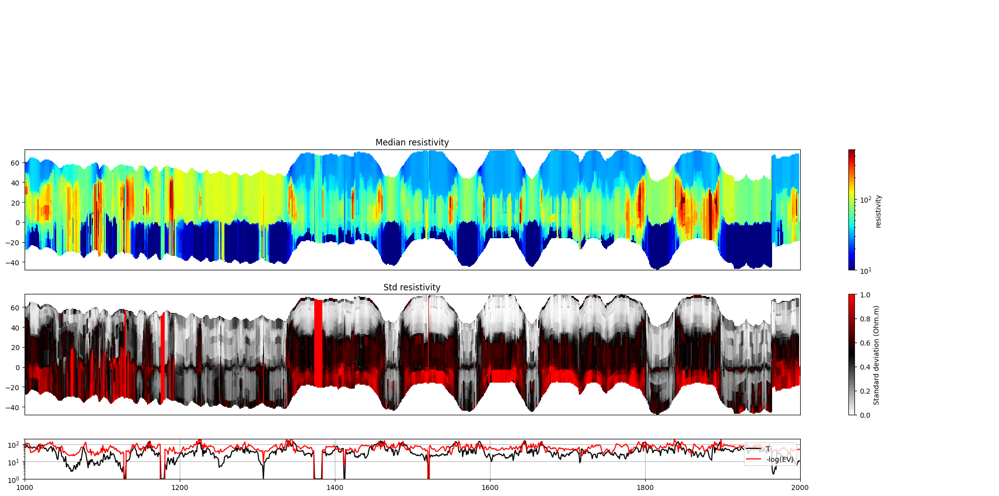

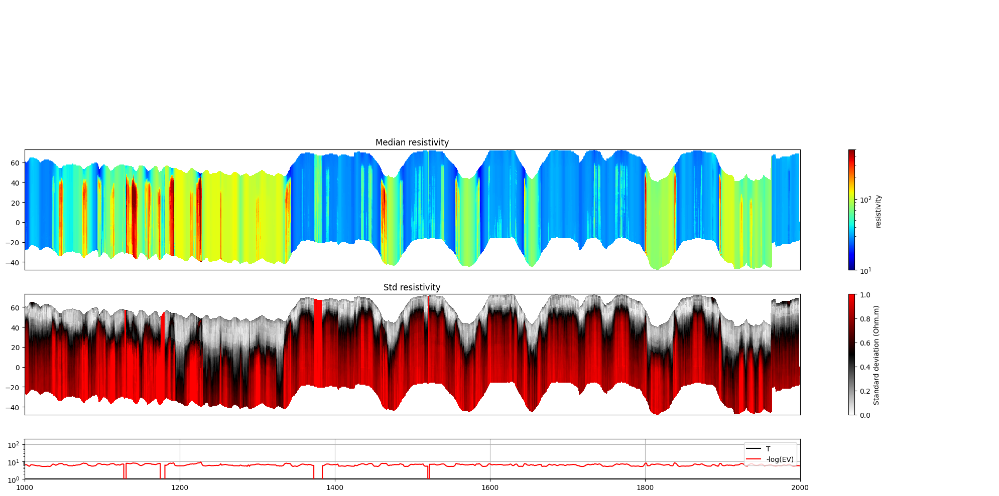

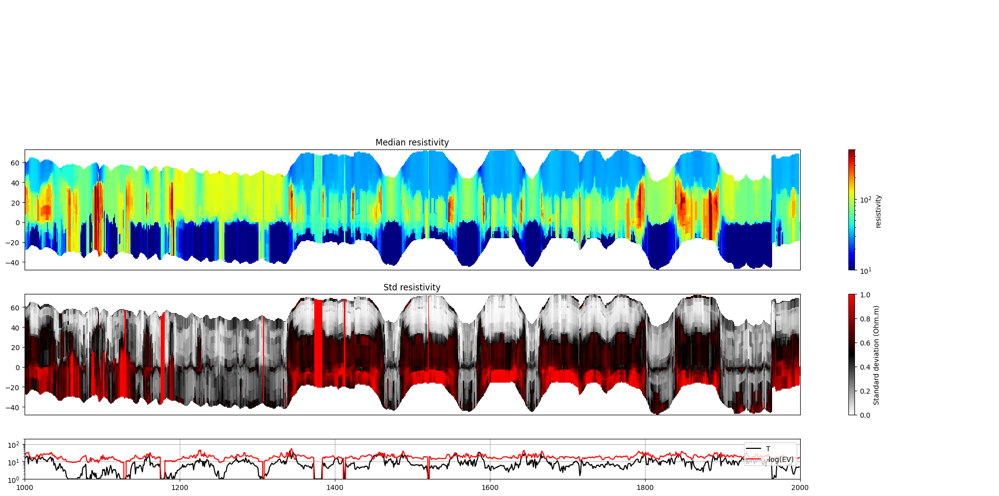

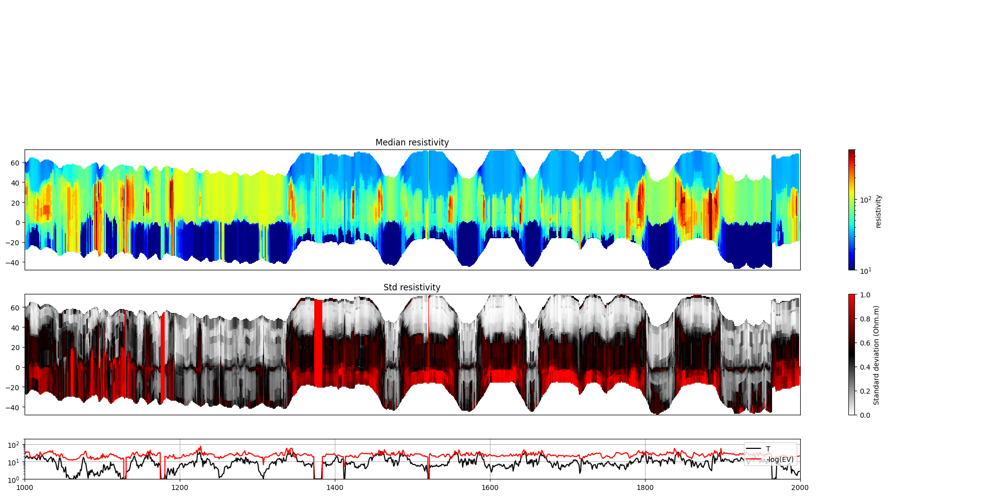

In [12]:
for f_post_h5 in f_post_arr:
    # % Plot Profiles
    ig.plot_profile(f_post_h5, i1=1000, i2=2000, im=1, hardcopy=hardcopy)

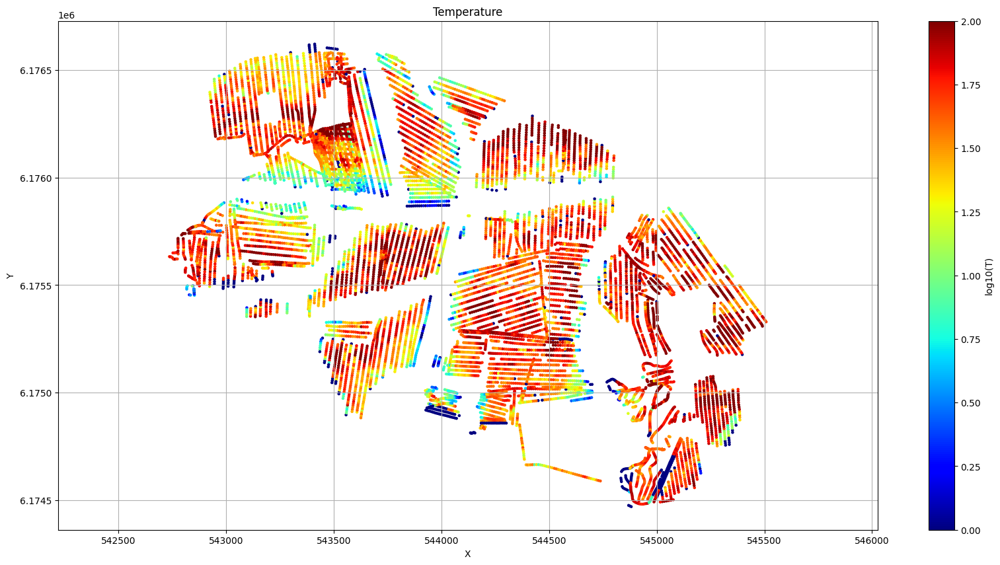

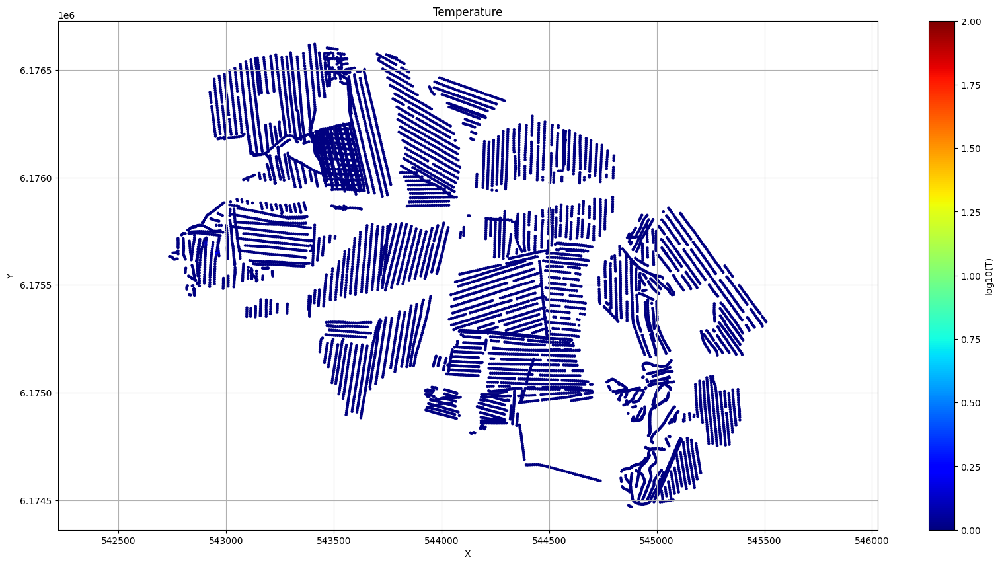

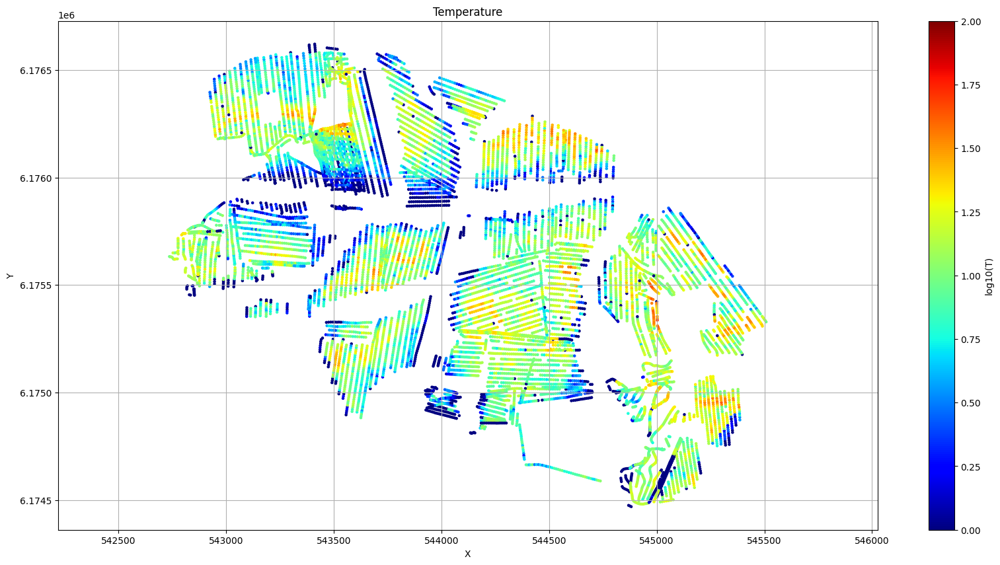

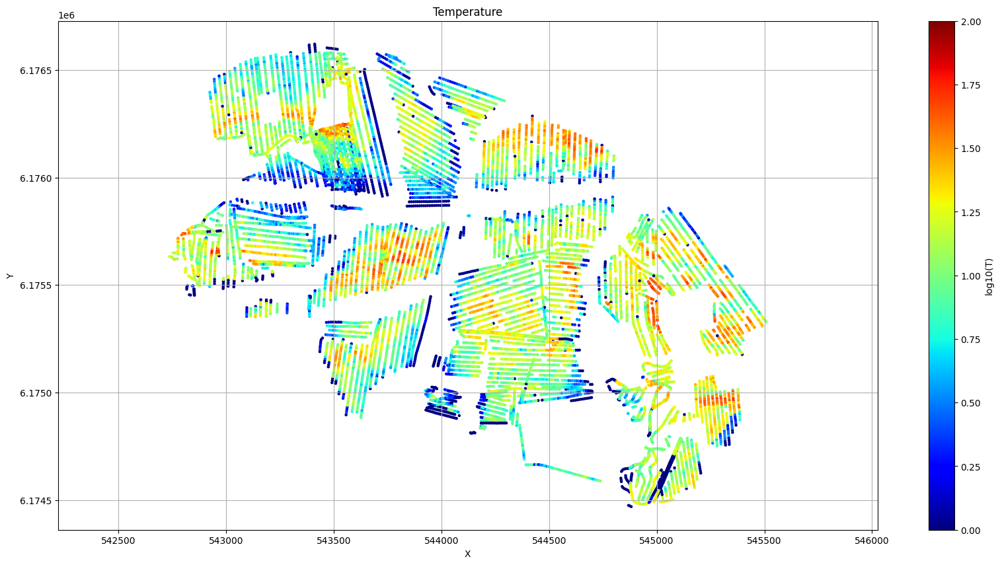

In [13]:
for f_post_h5 in f_post_arr:
    ig.plot_T_EV(f_post_h5, pl='T', hardcopy=hardcopy)
    plt.show()
    #ig.plot_T_EV(f_post_h5, pl='EV', hardcopy=hardcopy)

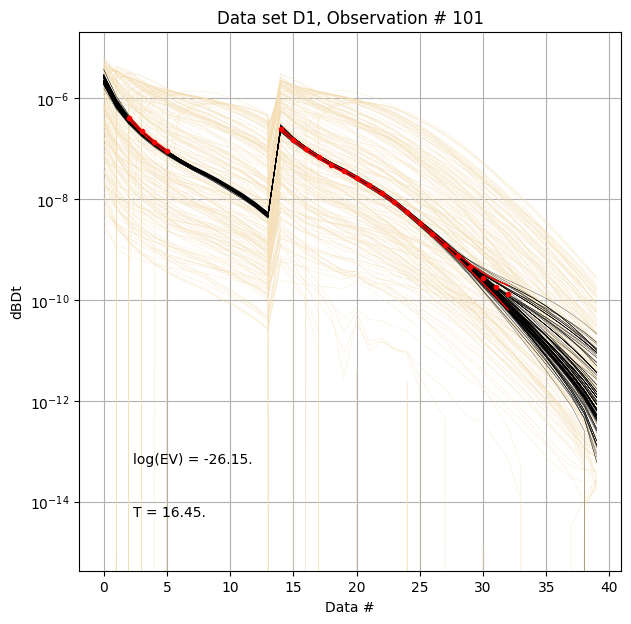

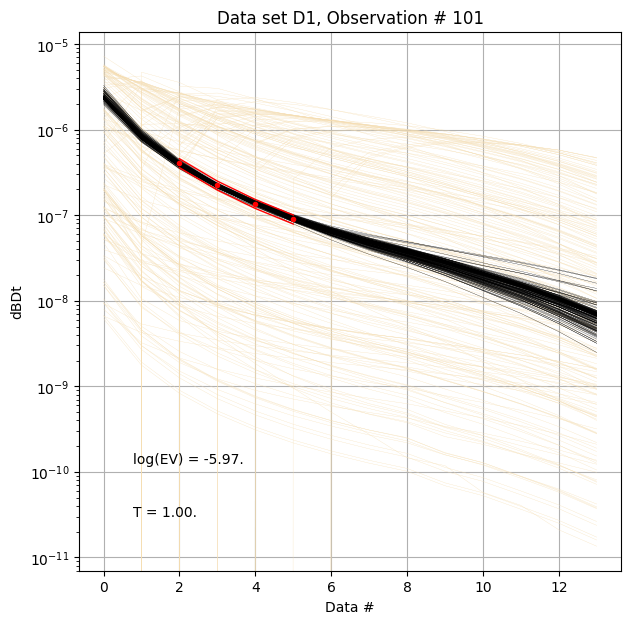

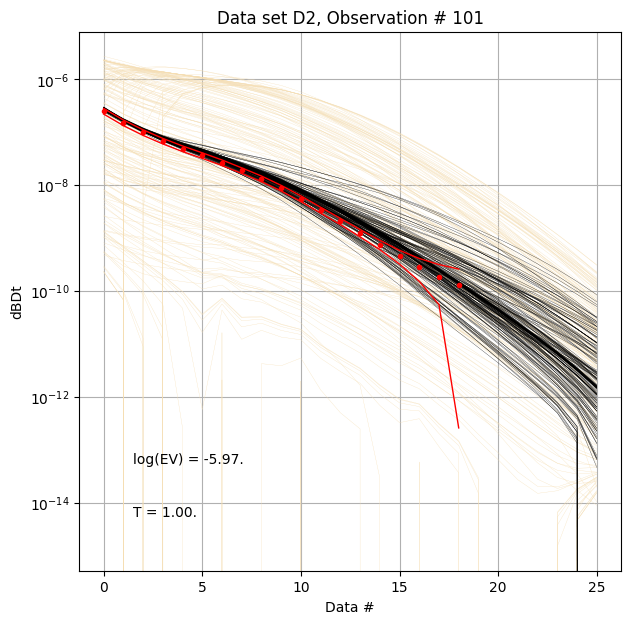

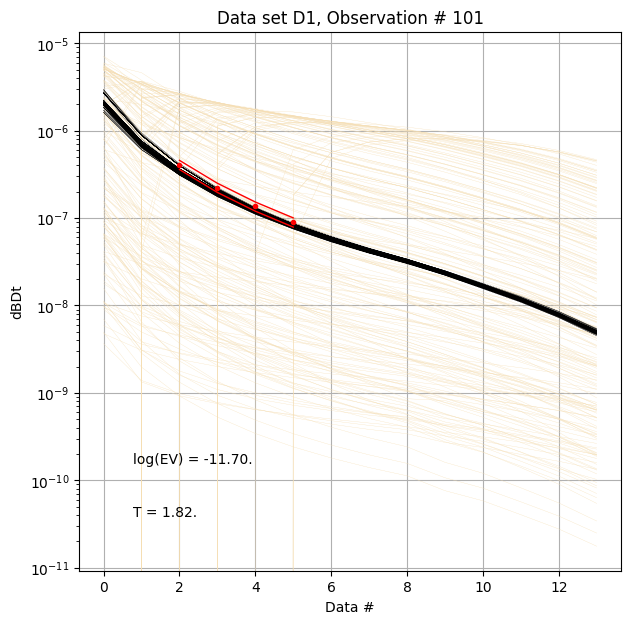

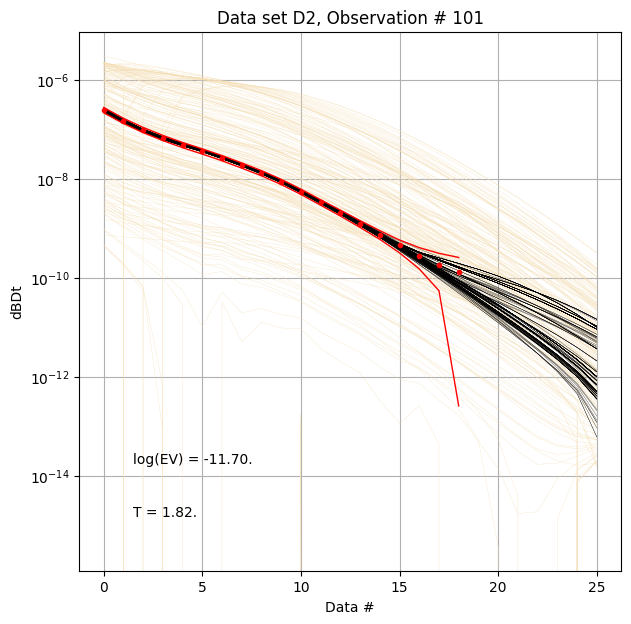

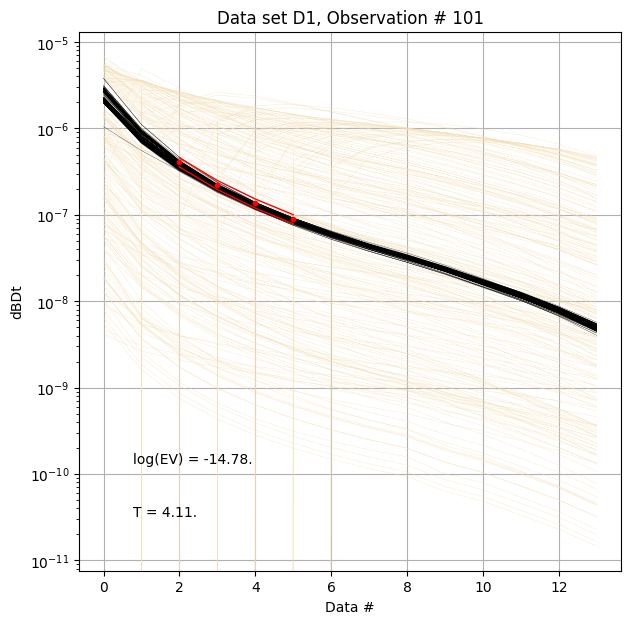

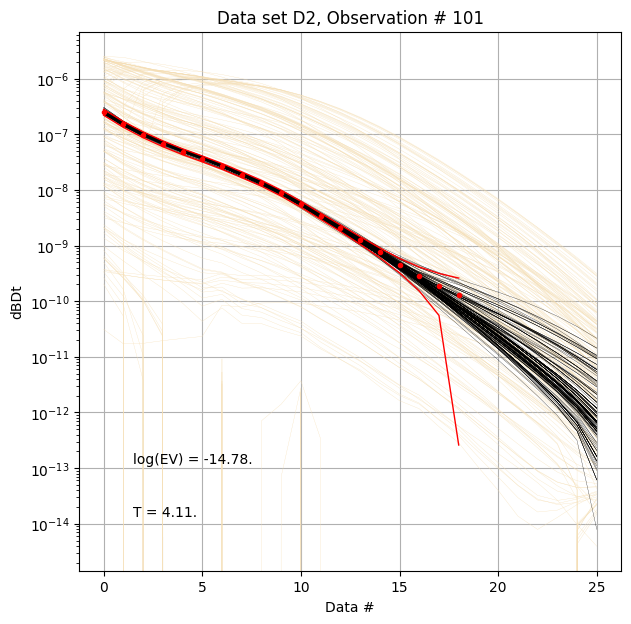

In [14]:
for f_post_h5 in f_post_arr:
    # % Plot prior, posterior, and observed  data
    ig.plot_data_prior_post(f_post_h5, i_plot=100, hardcopy=hardcopy)
    #ig.plot_data_prior_post(f_post_h5, i_plot=0, hardcopy=hardcopy)




Text(0, 0.5, 'N_UNIQUE')

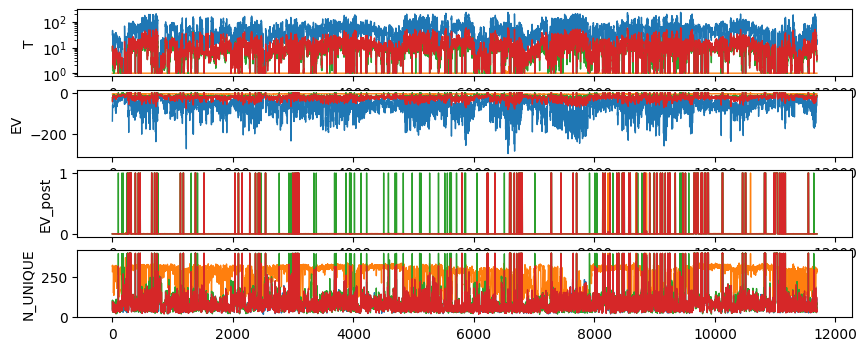

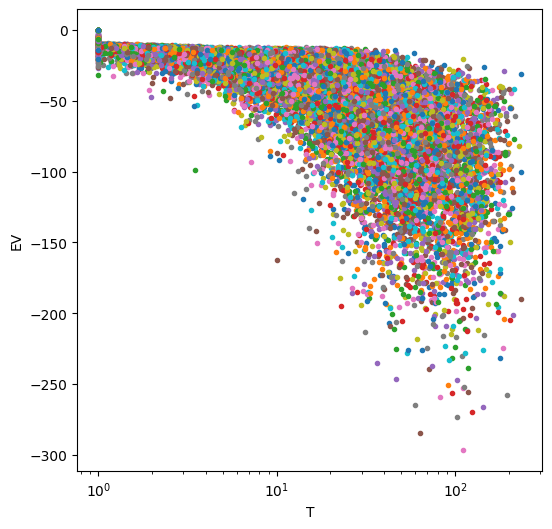

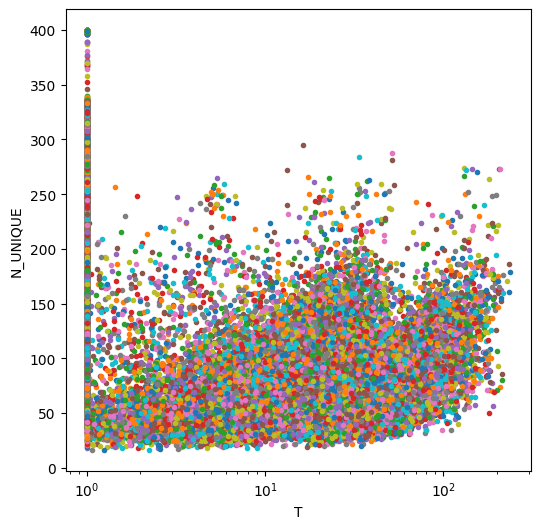

In [15]:
with h5py.File(f_data_h5, 'r') as f:    
    nobs = f['D1/d_obs'].shape[0]
    
ni=len(f_post_arr)

T = np.zeros((ni,nobs))
EV = np.zeros((ni,nobs))
EV_post = np.zeros((ni,nobs))
N_UNIQUE = np.zeros((ni,nobs))

i=-1
for f_post_h5 in f_post_arr:
    with h5py.File(f_post_h5, 'r') as f:
        i=i+1
        T[i] = f['/T'][:]
        EV[i] = f['/EV'][:]
        N_UNIQUE[i] = f['/N_UNIQUE'][:]
        EV_post[i] = f['/EV_post'][:]
    

fig, ax = plt.subplots(4,1,figsize=(10,4))
ax[0].semilogy(T.T,'-', linewidth=1)
ax[0].set_ylabel('T')
ax[1].plot(EV.T,'-', linewidth=1)
ax[1].set_ylabel('EV')
ax[2].plot(EV_post.T,'-', linewidth=1)
ax[2].set_ylabel('EV_post')
ax[3].plot(N_UNIQUE.T,'-', linewidth=1)
ax[3].set_ylabel('N_UNIQUE')

fig=plt.figure(figsize=(6,6))
plt.semilogx(T,EV,'.')
plt.xlabel('T')
plt.ylabel('EV')


fig=plt.figure(figsize=(6,6))
plt.semilogx(T,N_UNIQUE,'.')
plt.xlabel('T')
plt.ylabel('N_UNIQUE')



In [16]:
#ig.post_to_csv(f_post_h5)